In [3]:
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from matplotlib import pyplot as plt
import numpy as np
import scipy as sp
import pickle
from imblearn.over_sampling import RandomOverSampler as ros

In [2]:
def save_object(obj, path):
    with open(path, 'wb') as fp:
        pickle.dump(object, fp)

In [3]:
def scale(attributes):
    scaler = StandardScaler();
    return pd.DataFrame(scaler.fit_transform(attributes)), scaler;

In [5]:
%run ../Classes/BuildMyBulle.py #Load all the Datasets Objects Later

# Same Proportions Times 15

In [6]:
def bulle(self, trainX, trainY):
    import itertools
    #categories: 0-discrete, 1-continuous, 2-category
    ordered=pd.concat([trainX, trainY], axis=1)
    x=pd.DataFrame(trainX[trainY==self.mc_label])
    i=0;
    t00=datetime.datetime.now().replace(microsecond=0);
    bubble_set=pd.DataFrame();

    opt_sizem=np.sum(np.array(self.y))*15;
#     print('op',np.array(self.y))
    curr_bubble=x;
    while(len(bubble_set)<opt_sizem):
        d_ordered = self.deltas_ordered*10;
        step_matrix = np.random.choice([-1,1],(len(curr_bubble), len(d_ordered)))*d_ordered;
        discrete = curr_bubble.iloc[:, 0:self.index_discrete]+step_matrix[:, 0:self.index_discrete]-(d_ordered[0:self.index_discrete]/2);
        continuous = curr_bubble.iloc[:,self.index_discrete:self.index_continuous]+(step_matrix[:,self.index_discrete:self.index_continuous]*2)-(d_ordered[self.index_discrete:self.index_continuous]);
        category = curr_bubble.iloc[:,self.index_continuous:]+step_matrix[:,self.index_continuous:];
        bubble = pd.concat([discrete, continuous, category], axis=1)
        bubble_set=bubble_set.append(bubble)
        curr_bubble=bubble;        
    bubble_y = np.ones(len(bubble_set)).astype(np.int_)

    
    x=pd.DataFrame(trainX[trainY==0])
    i=0;
    t00=datetime.datetime.now().replace(microsecond=0);    
    
    opt_size=self.prop_bubble[1]*15;    
    curr_bubble=x;
    while(len(bubble_set)<opt_size+opt_sizem):
        d_ordered = self.deltas_ordered*10;
        step_matrix = np.random.choice([-1,1],(len(curr_bubble), len(d_ordered)))*d_ordered;
        discrete = curr_bubble.iloc[:, 0:self.index_discrete]+step_matrix[:, 0:self.index_discrete]-(d_ordered[0:self.index_discrete]/2);
        continuous = curr_bubble.iloc[:,self.index_discrete:self.index_continuous]+(step_matrix[:,self.index_discrete:self.index_continuous]*2)-(d_ordered[self.index_discrete:self.index_continuous]);
        category = curr_bubble.iloc[:,self.index_continuous:]+step_matrix[:,self.index_continuous:];
        bubble = pd.concat([discrete, continuous, category], axis=1)
        bubble_set=bubble_set.append(bubble)
        curr_bubble=bubble;

        
    bubble_yM = np.zeros(len(bubble_set)-len(bubble_y)).astype(np.int_)

    bubble_y=np.append(bubble_y,bubble_yM);
    
    return bubble_set, pd.DataFrame(bubble_y);

def bubble_oversample(self):
    from imblearn.under_sampling import RandomUnderSampler as rus;
    xBubbleOversample=[];
    yBubbleOversample=[];

    xBubbleOriginalOversample=[];
    yBubbleOriginalOversample=[];

    xAllOversample=[];
    yAllOversample=[];

    print("Bubble Oversample");
    t00=datetime.datetime.now().replace(microsecond=0)
    for fold in range(0, len(self.original_training_set['xs'])):
        tnoow=datetime.datetime.now().replace(microsecond=0);
        print("aan het bullen",fold, tnoow-t00);
        t00=tnoow;

        maxim = max(self.original_training_set['ys'][fold].value_counts());
        minim = min(self.original_training_set['ys'][fold].value_counts());
        prop_bubble={0:maxim*15, 1:(minim*15)-minim};
        prop_bubble_original={0:maxim*15, 1:minim*15};
        # self.prop_bubble=prop_bubble;
        # self.prop_bubble_original=prop_bubble_original;

        bubblex, bubbley = self.bulle(self.original_training_set['xs'][fold], self.original_training_set['ys'][fold])
        majcX=pd.DataFrame(self.original_training_set['xs'][fold][(self.original_training_set['ys'][fold]==0)])
        majcy=pd.DataFrame(self.original_training_set['ys'][fold][(self.original_training_set['ys'][fold]==0)])
        mincX=pd.DataFrame(self.original_training_set['xs'][fold][(self.original_training_set['ys'][fold]==1)])
        mincy=pd.DataFrame(self.original_training_set['ys'][fold][(self.original_training_set['ys'][fold]==1)])

        majcX = majcX.append(bubblex, ignore_index=True);
        majcy.columns=bubbley.columns
        majcy = pd.concat([majcy,bubbley], ignore_index=True, axis=0);


        randomUnderSampler = rus(random_state=self.rn_state, ratio=self.prop_bubble); 
        x_bubbleO, y_bubbleO = randomUnderSampler.fit_sample(majcX, majcy.values.ravel());
        x_bubbleO=pd.DataFrame(x_bubbleO).append(mincX, ignore_index=0);
        y_bubbleO=pd.DataFrame(y_bubbleO).append(mincy, ignore_index=0);

        xBubbleOversample.append(x_bubbleO)
        yBubbleOversample.append(y_bubbleO)


        randomUnderSampler = rus(random_state=self.rn_state, ratio=self.prop_bubble_original);
        oribubblex = self.original_training_set['xs'][fold].append(bubblex);
        oribubbley = self.original_training_set['ys'][fold].append(bubbley);
        x_bubbleOriO, y_bubbleOriO = randomUnderSampler.fit_sample(oribubblex, oribubbley.values.ravel());

        xBubbleOriginalOversample.append(x_bubbleOriO)
        yBubbleOriginalOversample.append(y_bubbleOriO)

        xAllOversample.append(np.array(oribubblex));
        yAllOversample.append(np.array(oribubbley.values.ravel()));
        
    self.oversample_bubble_tt_set = {'xs':xBubbleOversample, 'ys':yBubbleOversample};
    self.oversample_bubble_original_tt_set = {'xs':xBubbleOriginalOversample, 'ys':yBubbleOriginalOversample};
    self.all_bubbles_tt_set={'xs':xAllOversample, 'ys':yAllOversample};



## Haberman

In [7]:
maBulle0 = BuildMyBulle([1,1,1], 0, 'smoteTimes15', bulle, bubble_oversample);
maBulle0.instantiate_data();
maBulle0.cross_validate();
maBulle0.visualize_scores()
    

youp
setting
props {}
FEATURE VECTOR
Time taken for creating the feature vectors:  0:00:00
ORDER THE DATA
setting
props {}
Time taken for ordering the data:  0:00:00
SPLIT
Time taken for split:  0:00:00
RANDOM OVERSAMPLING
Smote Bubble Oversample


C:\ProgramData\Anaconda3\lib\site-packages\imblearn\utils\validation.py:224: UserWarning: After over-sampling, the number of samples (2355) in class 0 will be larger than the number of samples in the majority class (class #0 -> 157)
  n_samples_majority))
C:\ProgramData\Anaconda3\lib\site-packages\imblearn\utils\validation.py:224: UserWarning: After over-sampling, the number of samples (855) in class 1 will be larger than the number of samples in the majority class (class #0 -> 157)
  n_samples_majority))
C:\ProgramData\Anaconda3\lib\site-packages\imblearn\utils\validation.py:224: UserWarning: After over-sampling, the number of samples (2355) in class 0 will be larger than the number of samples in the majority class (class #0 -> 157)
  n_samples_majority))
C:\ProgramData\Anaconda3\lib\site-packages\imblearn\utils\validation.py:224: UserWarning: After over-sampling, the number of samples (855) in class 1 will be larger than the number of samples in the majority class (class #0 -> 157)
 

Time taken for random oversampling:  0:00:00
BUBBLE OVERSAMPLE
Bubble Oversample
aan het bullen 0 0:00:00
aan het bullen 1 0:00:00
aan het bullen 2 0:00:00
aan het bullen 3 0:00:00
aan het bullen 4 0:00:00
aan het bullen 5 0:00:00
aan het bullen 6 0:00:01
Time taken for random bubble oversampling:  0:00:01
SMOTE OVERSAMPLE
Smote Oversample
Time taken for random SMOTE:  0:00:00
CROSS VALIDATION
   ORIGINAL TRAINING SET
         0
           Average Precision:  0.358242753623 , Precicion 0:  0.416666666667 , Precision 1 0.416666666667 , Recall 1:  0.625 , Recall 0:  0.625 , PR AUC:  0.501887101195 , F1 Score 0:  0.5 , F1 Score1:  0.5 , AUC:  0.658088235294 , AUC Probs 0:  0.344975490196 , AUC Probs 1:  0.655024509804
         1
           Average Precision:  0.312252964427 , Precicion 0:  0.363636363636 , Precision 1 0.363636363636 , Recall 1:  0.5 , Recall 0:  0.5 , PR AUC:  0.381428559079 , F1 Score 0:  0.421052631579 , F1 Score1:  0.421052631579 , AUC:  0.595588235294 , AUC Probs 0:  

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


TypeError: list indices must be integers or slices, not str

## Pulsar

In [7]:
maBulle0 = BuildMyBulle([1,1,1,1,1,1,1,1], 1, 'normCats_realSnowBubblesTimes15_ray10bis_RealSmote', bulle, bubble_oversample);
maBulle0.instantiate_data();
maBulle0.cross_validate();
maBulle0.visualize_scores()    

youp
setting
props {}
FEATURE VECTOR
Time taken for creating the feature vectors:  0:00:00
ORDER THE DATA
setting
props {}
Time taken for ordering the data:  0:00:03
SPLIT
Time taken for split:  0:00:00
RANDOM OVERSAMPLING
Random Oversample
Time taken for random oversampling:  0:00:00
BUBBLE OVERSAMPLE
Bubble Oversample
aan het bullen 0 0:00:00
aan het bullen 1 0:00:00
aan het bullen 2 0:00:01
aan het bullen 3 0:00:00
aan het bullen 4 0:00:01
aan het bullen 5 0:00:00
aan het bullen 6 0:00:01
Time taken for random bubble oversampling:  0:00:03
SMOTE OVERSAMPLE
Smote Oversample
Time taken for random SMOTE:  0:00:01
CROSS VALIDATION
   ORIGINAL TRAINING SET
         0
           Average Precision:  0.779326446146 , Precicion 0:  0.899141630901 , Precision 1 0.899141630901 , Recall 1:  0.85162601626 , Recall 0:  0.85162601626 , PR AUC:  0.920641328188 , F1 Score 0:  0.874739039666 , F1 Score1:  0.874739039666 , AUC:  0.920995459955 , AUC Probs 0:  0.0225327253273 , AUC Probs 1:  0.97746727

           Average Precision:  0.69448573166 , Precicion 0:  0.76116838488 , Precision 1 0.76116838488 , Recall 1:  0.900406504065 , Recall 0:  0.900406504065 , PR AUC:  0.915718270764 , F1 Score 0:  0.824953445065 , F1 Score1:  0.824953445065 , AUC:  0.935955609556 , AUC Probs 0:  0.0219598029314 , AUC Probs 1:  0.978040197069
         1
           Average Precision:  0.712354738871 , Precicion 0:  0.785714285714 , Precision 1 0.785714285714 , Recall 1:  0.894308943089 , Recall 0:  0.894308943089 , PR AUC:  0.916532745158 , F1 Score 0:  0.836501901141 , F1 Score1:  0.836501901141 , AUC:  0.934854348543 , AUC Probs 0:  0.0216777167772 , AUC Probs 1:  0.978322283223
         2
           Average Precision:  0.746426211404 , Precicion 0:  0.818853974122 , Precision 1 0.818853974122 , Recall 1:  0.900406504065 , Recall 0:  0.900406504065 , PR AUC:  0.926586721113 , F1 Score 0:  0.857696030978 , F1 Score1:  0.857696030978 , AUC:  0.940158151582 , AUC Probs 0:  0.0235102351024 , AUC Probs 1

           Average Precision:  0.771582464408 , Precicion 0:  0.93006993007 , Precision 1 0.93006993007 , Recall 1:  0.810975609756 , Recall 0:  0.810975609756 , PR AUC:  0.905370607257 , F1 Score 0:  0.866449511401 , F1 Score1:  0.866449511401 , AUC:  0.902412774128 , AUC Probs 0:  0.0564209808765 , AUC Probs 1:  0.943579019124
         2
           Average Precision:  0.798909162353 , Precicion 0:  0.940366972477 , Precision 1 0.940366972477 , Recall 1:  0.833333333333 , Recall 0:  0.833333333333 , PR AUC:  0.92148221834 , F1 Score 0:  0.883620689655 , F1 Score1:  0.883620689655 , AUC:  0.914001640016 , AUC Probs 0:  0.0483088164215 , AUC Probs 1:  0.951691183579
         3
           Average Precision:  0.779286635549 , Precicion 0:  0.922902494331 , Precision 1 0.922902494331 , Recall 1:  0.827235772358 , Recall 0:  0.827235772358 , PR AUC:  0.909498185965 , F1 Score 0:  0.872454448017 , F1 Score1:  0.872454448017 , AUC:  0.910132851329 , AUC Probs 0:  0.0576593265933 , AUC Probs 1

           Average Precision:  0.634677968304 , Precicion 0:  0.708674304419 , Precision 1 0.708674304419 , Recall 1:  0.880081300813 , Recall 0:  0.880081300813 , PR AUC:  0.838810366668 , F1 Score 0:  0.785131459655 , F1 Score1:  0.785131459655 , AUC:  0.921795467955 , AUC Probs 0:  0.0649656496565 , AUC Probs 1:  0.935034350344
         4
           Average Precision:  0.619580192386 , Precicion 0:  0.686028257457 , Precision 1 0.686028257457 , Recall 1:  0.888211382114 , Recall 0:  0.888211382114 , PR AUC:  0.840631930136 , F1 Score 0:  0.774136403897 , F1 Score1:  0.774136403897 , AUC:  0.923605486055 , AUC Probs 0:  0.0594649696497 , AUC Probs 1:  0.94053503035
         5
           Average Precision:  0.598876625638 , Precicion 0:  0.666666666667 , Precision 1 0.666666666667 , Recall 1:  0.882113821138 , Recall 0:  0.882113821138 , PR AUC:  0.823697965603 , F1 Score 0:  0.759405074366 , F1 Score1:  0.759405074366 , AUC:  0.918814188142 , AUC Probs 0:  0.0655964892982 , AUC Probs

           Average Precision:  0.780410497192 , Precicion 0:  0.958333333333 , Precision 1 0.958333333333 , Recall 1:  0.794715447154 , Recall 0:  0.794715447154 , PR AUC:  0.899173815396 , F1 Score 0:  0.868888888889 , F1 Score1:  0.868888888889 , AUC:  0.895615206152 , AUC Probs 0:  0.0480338136715 , AUC Probs 1:  0.951966186329
         5
           Average Precision:  0.773499933343 , Precicion 0:  0.928240740741 , Precision 1 0.928240740741 , Recall 1:  0.815040650407 , Recall 0:  0.815040650407 , PR AUC:  0.884979369833 , F1 Score 0:  0.867965367965 , F1 Score1:  0.867965367965 , AUC:  0.904342793428 , AUC Probs 0:  0.0484642346423 , AUC Probs 1:  0.951535765358
         6
           Average Precision:  0.808069225447 , Precicion 0:  0.9430523918 , Precision 1 0.9430523918 , Recall 1:  0.841463414634 , Recall 0:  0.841463414634 , PR AUC:  0.925489684939 , F1 Score 0:  0.889366272825 , F1 Score1:  0.889366272825 , AUC:  0.918169181692 , AUC Probs 0:  0.0338682553492 , AUC Probs 1:

           Average Precision:  0.774930555946 , Precicion 0:  0.824057450628 , Precision 1 0.824057450628 , Recall 1:  0.932926829268 , Recall 0:  0.932926829268 , PR AUC:  0.872484336626 , F1 Score 0:  0.875119161106 , F1 Score1:  0.875119161106 , AUC:  0.956418314183 , AUC Probs 0:  0.0251402514025 , AUC Probs 1:  0.974859748597
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE AND ORIGINAL TRAINING SET:  0:02:18
   RANDOM OVERSAMPLE ON THE SMOTE TRAINING SET
         0
           Average Precision:  0.755327293711 , Precicion 0:  0.820512820513 , Precision 1 0.820512820513 , Recall 1:  0.910569105691 , Recall 0:  0.910569105691 , PR AUC:  0.835049270819 , F1 Score 0:  0.863198458574 , F1 Score1:  0.863198458574 , AUC:  0.945239452395 , AUC Probs 0:  0.0251946269463 , AUC Probs 1:  0.974805373054
         1
           Average Precision:  0.769328088527 , Precicion 0:  0.849420849421 , Precision 1 0.849420849421 , Recall 1:  0.894308943089 , Recall 0:  0.894308943089 , PR

           Average Precision:  0.773234122501 , Precicion 0:  0.888185654008 , Precision 1 0.888185654008 , Recall 1:  0.855691056911 , Recall 0:  0.855691056911 , PR AUC:  0.904456913757 , F1 Score 0:  0.871635610766 , F1 Score1:  0.871635610766 , AUC:  0.92241297413 , AUC Probs 0:  0.0448996156628 , AUC Probs 1:  0.955100384337
         1
           Average Precision:  0.793778683785 , Precicion 0:  0.92808988764 , Precision 1 0.92808988764 , Recall 1:  0.839430894309 , Recall 0:  0.839430894309 , PR AUC:  0.906154976428 , F1 Score 0:  0.881536819637 , F1 Score1:  0.881536819637 , AUC:  0.916435414354 , AUC Probs 0:  0.0490592405924 , AUC Probs 1:  0.950940759408
         2
           Average Precision:  0.791290575484 , Precicion 0:  0.909287257019 , Precision 1 0.909287257019 , Recall 1:  0.855691056911 , Recall 0:  0.855691056911 , PR AUC:  0.916246768308 , F1 Score 0:  0.88167539267 , F1 Score1:  0.88167539267 , AUC:  0.923540485405 , AUC Probs 0:  0.0426641766418 , AUC Probs 1: 

           Average Precision:  0.758372708188 , Precicion 0:  0.85628742515 , Precision 1 0.85628742515 , Recall 1:  0.871951219512 , Recall 0:  0.871951219512 , PR AUC:  0.907293248738 , F1 Score 0:  0.864048338369 , F1 Score1:  0.864048338369 , AUC:  0.928595535955 , AUC Probs 0:  0.0407370740374 , AUC Probs 1:  0.959262925963
         3
           Average Precision:  0.749881592658 , Precicion 0:  0.844793713163 , Precision 1 0.844793713163 , Recall 1:  0.873983739837 , Recall 0:  0.873983739837 , PR AUC:  0.902924222306 , F1 Score 0:  0.859140859141 , F1 Score1:  0.859140859141 , AUC:  0.928894288943 , AUC Probs 0:  0.0403620702874 , AUC Probs 1:  0.959637929713
         4
           Average Precision:  0.770217866272 , Precicion 0:  0.871690427699 , Precision 1 0.871690427699 , Recall 1:  0.869918699187 , Recall 0:  0.869918699187 , PR AUC:  0.903053886076 , F1 Score 0:  0.870803662258 , F1 Score1:  0.870803662258 , AUC:  0.928501785018 , AUC Probs 0:  0.0400239419061 , AUC Probs 

           Average Precision:  0.727995094504 , Precicion 0:  0.868534482759 , Precision 1 0.868534482759 , Recall 1:  0.819105691057 , Recall 0:  0.819105691057 , PR AUC:  0.852106865306 , F1 Score 0:  0.84309623431 , F1 Score1:  0.84309623431 , AUC:  0.903300283003 , AUC Probs 0:  0.0966997169972 , AUC Probs 1:  0.903300283003
         5
           Average Precision:  0.677677598155 , Precicion 0:  0.803571428571 , Precision 1 0.803571428571 , Recall 1:  0.823170731707 , Recall 0:  0.823170731707 , PR AUC:  0.821471638799 , F1 Score 0:  0.813253012048 , F1 Score1:  0.813253012048 , AUC:  0.901437764378 , AUC Probs 0:  0.0985622356224 , AUC Probs 1:  0.901437764378
         6
           Average Precision:  0.708246164961 , Precicion 0:  0.813953488372 , Precision 1 0.813953488372 , Recall 1:  0.853658536585 , Recall 0:  0.853658536585 , PR AUC:  0.840509923093 , F1 Score 0:  0.833333333333 , F1 Score1:  0.833333333333 , AUC:  0.916989169892 , AUC Probs 0:  0.0830108301083 , AUC Probs 

,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.690315,0.693550,0.678346,0.672520,0.595026
Precision 0,0.822966,0.826747,0.783468,0.775587,0.666351
Precision 1,0.822966,0.826747,0.783468,0.775587,0.666351
Recall 0,0.818815,0.819106,0.848142,0.849303,0.876016
Recall 1,0.818815,0.819106,0.848142,0.849303,0.876016
PRAUC,0.829191,0.831213,0.822762,0.819349,0.776863
F1 Score 0,0.820608,0.822447,0.814377,0.810639,0.756791
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.900490,0.900826,0.912225,0.912234,0.915853
AUC Probs 0,0.099510,0.099174,0.087775,0.087766,0.084147


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.787816,0.644781,0.615011,0.615009,0.609514
Precision 0,0.929975,0.715034,0.678091,0.678289,0.666817
Precision 1,0.929975,0.715034,0.678091,0.678289,0.666817
Recall 0,0.830430,0.887340,0.892567,0.892276,0.900407
Recall 1,0.830430,0.887340,0.892567,0.892276,0.900407
PRAUC,0.912640,0.859744,0.838735,0.837573,0.864242
F1 Score 0,0.877271,0.791831,0.770517,0.770541,0.766144
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.912052,0.925820,0.924875,0.924759,0.927507
AUC Probs 0,0.052048,0.057742,0.059808,0.060102,0.050073


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.788415,0.793026,0.785570,0.774644,0.751823
Precision 0,0.933958,0.913957,0.891197,0.884496,0.843061
Precision 1,0.933958,0.913957,0.891197,0.884496,0.843061
Recall 0,0.827236,0.853078,0.867886,0.861498,0.878920
Recall 1,0.827236,0.853078,0.867886,0.861498,0.878920
PRAUC,0.913532,0.912052,0.910342,0.908451,0.905697
F1 Score 0,0.877272,0.882259,0.879264,0.872723,0.860267
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.910660,0.922468,0.928584,0.925068,0.931157
AUC Probs 0,0.046334,0.044256,0.040925,0.039037,0.037551


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.792228,0.703897,0.709420,0.706849,0.699595
Precision 0,0.927057,0.769280,0.775995,0.773787,0.764407
Precision 1,0.927057,0.769280,0.775995,0.773787,0.764407
Recall 0,0.838850,0.903891,0.903310,0.902149,0.903891
Recall 1,0.838850,0.903891,0.903310,0.902149,0.903891
PRAUC,0.920592,0.919916,0.918637,0.918179,0.916586
F1 Score 0,0.880330,0.830707,0.833869,0.832601,0.827803
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.916072,0.938181,0.938286,0.937676,0.937771
AUC Probs 0,0.025683,0.024112,0.024737,0.024288,0.024509


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.785948,0.754045,0.753618,0.755153,0.760380
Precision 0,0.941472,0.822872,0.823259,0.825252,0.830815
Precision 1,0.941472,0.822872,0.823259,0.825252,0.830815
Recall 0,0.817073,0.905923,0.904762,0.904472,0.904762
Recall 1,0.817073,0.905923,0.904762,0.904472,0.904762
PRAUC,0.898704,0.862530,0.862963,0.863341,0.865213
F1 Score 0,0.874725,0.862217,0.861941,0.862865,0.866077
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.905959,0.943092,0.942555,0.942542,0.943068
AUC Probs 0,0.046491,0.028198,0.028436,0.028424,0.028022


## Magic

In [8]:
maBulle0 = BuildMyBulle([1,1,1,1,1,1,1,1,1,1,1], 2, 'normCats_realSnowBubblesTimes15_ray10bis_RealSmote', bulle, bubble_oversample);
maBulle0.instantiate_data();
maBulle0.cross_validate();
maBulle0.visualize_scores()
    

youp
setting
props {}
FEATURE VECTOR
Time taken for creating the feature vectors:  0:00:00
ORDER THE DATA
setting
props {}
Time taken for ordering the data:  0:00:05
SPLIT
Time taken for split:  0:00:00
RANDOM OVERSAMPLING
Random Oversample
Time taken for random oversampling:  0:00:00
BUBBLE OVERSAMPLE
Bubble Oversample
aan het bullen 0 0:00:00
aan het bullen 1 0:00:00
aan het bullen 2 0:00:01
aan het bullen 3 0:00:00
aan het bullen 4 0:00:00
aan het bullen 5 0:00:01
aan het bullen 6 0:00:00
Time taken for random bubble oversampling:  0:00:03
SMOTE OVERSAMPLE
Smote Oversample
Time taken for random SMOTE:  0:00:01
CROSS VALIDATION
   ORIGINAL TRAINING SET
         0
           Average Precision:  0.986889533268 , Precicion 0:  0.989114299852 , Precision 1 0.989114299852 , Recall 1:  0.996510468594 , Recall 0:  0.996510468594 , PR AUC:  0.99970337504 , F1 Score 0:  0.992798609387 , F1 Score1:  0.992798609387 , AUC:  0.995282261324 , AUC Probs 0:  0.000149686076904 , AUC Probs 1:  0.99985

           Average Precision:  0.977876986506 , Precicion 0:  0.979441997063 , Precision 1 0.979441997063 , Recall 1:  0.997507477567 , Recall 0:  0.997507477567 , PR AUC:  0.999758785885 , F1 Score 0:  0.988392195604 , F1 Score1:  0.988392195604 , AUC:  0.993078063108 , AUC Probs 0:  0.000131497399693 , AUC Probs 1:  0.9998685026
         5
           Average Precision:  0.982357202213 , Precicion 0:  0.987109568666 , Precision 1 0.987109568666 , Recall 1:  0.992522432702 , Recall 0:  0.992522432702 , PR AUC:  0.999625009361 , F1 Score 0:  0.989808600547 , F1 Score1:  0.989808600547 , AUC:  0.992747702837 , AUC Probs 0:  0.000200749104039 , AUC Probs 1:  0.999799250896
         6
           Average Precision:  0.979470536566 , Precicion 0:  0.981354268891 , Precision 1 0.981354268891 , Recall 1:  0.997008973081 , Recall 0:  0.997008973081 , PR AUC:  0.99974264269 , F1 Score 0:  0.989119683482 , F1 Score1:  0.989119683482 , AUC:  0.993369351405 , AUC Probs 0:  0.000139311794347 , AUC P

           Average Precision:  0.953438014808 , Precicion 0:  0.984020618557 , Precision 1 0.984020618557 , Recall 1:  0.951645064806 , Recall 0:  0.951645064806 , PR AUC:  0.993373406818 , F1 Score 0:  0.967562088191 , F1 Score1:  0.967562088191 , AUC:  0.971633343214 , AUC Probs 0:  0.00573435100105 , AUC Probs 1:  0.994265648999
         6
           Average Precision:  0.951181184163 , Precicion 0:  0.982972136223 , Precision 1 0.982972136223 , Recall 1:  0.949651046859 , Recall 0:  0.949651046859 , PR AUC:  0.992809682793 , F1 Score 0:  0.966024340771 , F1 Score1:  0.966024340771 , AUC:  0.97036606397 , AUC Probs 0:  0.0063916359031 , AUC Probs 1:  0.993608364097
     Time taken TO TRAIN THE ORIGINAL TRAINING SET:  0:00:07
   RANDOM OVERSAMPLE TRAINING SET
         0
           Average Precision:  0.938615171528 , Precicion 0:  0.959841348537 , Precision 1 0.959841348537 , Recall 1:  0.965104685942 , Recall 0:  0.965104685942 , PR AUC:  0.990072239852 , F1 Score 0:  0.962465821526

           Average Precision:  0.948534560916 , Precicion 0:  0.965363681346 , Precision 1 0.965363681346 , Recall 1:  0.97258225324 , Recall 0:  0.97258225324 , PR AUC:  0.991550273181 , F1 Score 0:  0.968959523218 , F1 Score1:  0.968959523218 , AUC:  0.976831667161 , AUC Probs 0:  0.00580986769421 , AUC Probs 1:  0.994190132306
         1
           Average Precision:  0.941804554156 , Precicion 0:  0.957822461991 , Precision 1 0.957822461991 , Recall 1:  0.973579262213 , Recall 0:  0.973579262213 , PR AUC:  0.992163934186 , F1 Score 0:  0.965636588381 , F1 Score1:  0.965636588381 , AUC:  0.975168009485 , AUC Probs 0:  0.00572182102342 , AUC Probs 1:  0.994278178977
         2
           Average Precision:  0.948615472126 , Precicion 0:  0.96356474643 , Precision 1 0.96356474643 , Recall 1:  0.97557328016 , Recall 0:  0.97557328016 , PR AUC:  0.991366184503 , F1 Score 0:  0.969531830567 , F1 Score1:  0.969531830567 , AUC:  0.97778664008 , AUC Probs 0:  0.0059567917868 , AUC Probs 1: 

           Average Precision:  0.978658517795 , Precicion 0:  0.98180029513 , Precision 1 0.98180029513 , Recall 1:  0.995014955135 , Recall 0:  0.995014955135 , PR AUC:  0.999648639364 , F1 Score 0:  0.988363456301 , F1 Score1:  0.988363456301 , AUC:  0.992507477567 , AUC Probs 0:  0.000191183207135 , AUC Probs 1:  0.999808816793
         3
           Average Precision:  0.980266717791 , Precicion 0:  0.982784062961 , Precision 1 0.982784062961 , Recall 1:  0.996011964108 , Recall 0:  0.996011964108 , PR AUC:  0.99960833309 , F1 Score 0:  0.989353800446 , F1 Score1:  0.989353800446 , AUC:  0.993276252324 , AUC Probs 0:  0.000207081458328 , AUC Probs 1:  0.999792918542
         4
           Average Precision:  0.980094965474 , Precicion 0:  0.985148514851 , Precision 1 0.985148514851 , Recall 1:  0.992023928215 , Recall 0:  0.992023928215 , PR AUC:  0.999536135856 , F1 Score 0:  0.988574267263 , F1 Score1:  0.988574267263 , AUC:  0.991957910054 , AUC Probs 0:  0.000246153431597 , AUC P

           Average Precision:  0.980094076449 , Precicion 0:  0.986104218362 , Precision 1 0.986104218362 , Recall 1:  0.990528414756 , Recall 0:  0.990528414756 , PR AUC:  0.999518055709 , F1 Score 0:  0.988311365332 , F1 Score1:  0.988311365332 , AUC:  0.991480423594 , AUC Probs 0:  0.000254102557193 , AUC Probs 1:  0.999745897443
         5
           Average Precision:  0.987865920345 , Precicion 0:  0.990094105993 , Precision 1 0.990094105993 , Recall 1:  0.996510468594 , Recall 0:  0.996510468594 , PR AUC:  0.999662800379 , F1 Score 0:  0.993291925466 , F1 Score1:  0.993291925466 , AUC:  0.995552531594 , AUC Probs 0:  0.000175150225001 , AUC Probs 1:  0.999824849775
         6
           Average Precision:  0.983326705187 , Precicion 0:  0.987128712871 , Precision 1 0.987128712871 , Recall 1:  0.994017946162 , Recall 0:  0.994017946162 , PR AUC:  0.999702019887 , F1 Score 0:  0.990561351217 , F1 Score1:  0.990561351217 , AUC:  0.993495459567 , AUC Probs 0:  0.000162350785481 , AU

           Average Precision:  0.994546355974 , Precicion 0:  0.994546355974 , Precision 1 0.994546355974 , Recall 1:  1.0 , Recall 0:  1.0 , PR AUC:  0.999984332907 , F1 Score 0:  0.997265722098 , F1 Score1:  0.997265722098 , AUC:  0.998513513514 , AUC Probs 0:  8.48804936542e-06 , AUC Probs 1:  0.999991511951
         4
           Average Precision:  0.997017892644 , Precicion 0:  0.997017892644 , Precision 1 0.997017892644 , Recall 1:  1.0 , Recall 0:  1.0 , PR AUC:  0.999702047491 , F1 Score 0:  0.998506719761 , F1 Score1:  0.998506719761 , AUC:  0.999189189189 , AUC Probs 0:  0.000152852254049 , AUC Probs 1:  0.999847147746
         5
           Average Precision:  0.997017892644 , Precicion 0:  0.997017892644 , Precision 1 0.997017892644 , Recall 1:  1.0 , Recall 0:  1.0 , PR AUC:  1.0 , F1 Score 0:  0.998506719761 , F1 Score1:  0.998506719761 , AUC:  0.999189189189 , AUC Probs 0:  0.0 , AUC Probs 1:  1.0
         6
           Average Precision:  0.993561168895 , Precicion 0:  0.

           Average Precision:  1.0 , Precicion 0:  1.0 , Precision 1 1.0 , Recall 1:  1.0 , Recall 0:  1.0 , PR AUC:  1.0 , F1 Score 0:  1.0 , F1 Score1:  1.0 , AUC:  1.0 , AUC Probs 0:  0.0 , AUC Probs 1:  1.0
         6
           Average Precision:  1.0 , Precicion 0:  1.0 , Precision 1 1.0 , Recall 1:  1.0 , Recall 0:  1.0 , PR AUC:  1.0 , F1 Score 0:  1.0 , F1 Score1:  1.0 , AUC:  1.0 , AUC Probs 0:  0.0 , AUC Probs 1:  1.0
     Time taken TO TRAIN THE ORIGINAL TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE TRAINING SET
         0
           Average Precision:  1.0 , Precicion 0:  1.0 , Precision 1 1.0 , Recall 1:  1.0 , Recall 0:  1.0 , PR AUC:  1.0 , F1 Score 0:  1.0 , F1 Score1:  1.0 , AUC:  1.0 , AUC Probs 0:  0.0 , AUC Probs 1:  1.0
         1
           Average Precision:  1.0 , Precicion 0:  1.0 , Precision 1 1.0 , Recall 1:  1.0 , Recall 0:  1.0 , PR AUC:  1.0 , F1 Score 0:  1.0 , F1 Score1:  1.0 , AUC:  1.0 , AUC Probs 0:  0.0 , AUC Probs 1:  1.0
         2
           Averag

           Average Precision:  1.0 , Precicion 0:  1.0 , Precision 1 1.0 , Recall 1:  1.0 , Recall 0:  1.0 , PR AUC:  1.0 , F1 Score 0:  1.0 , F1 Score1:  1.0 , AUC:  1.0 , AUC Probs 0:  0.0 , AUC Probs 1:  1.0
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE SMOTE TRAINING SET:  0:00:01
  Time taken to cross validate everything:  0:00:03
GETTING AVERAGE SCORES
original
           0 _ : Average Precision- 0.999953821376 , Precicion 0- 1.0 , Precision 1- 1.0 , Recall 1- 0.999928785073 , Recall 0- 0.999928785073 , PR Aucs- [1.0, 1.0, 1.0, 1.0, 0.99983837481596571, 1.0, 1.0] , F1 Score 0- 0.999964383659 , F1 Score1- [0, 0, 0, 0, 0] , AUC- 0.999964392537 , AUC Probs 0- 3.56074633243e-05 , AUC Probs 1- [0.99996439253667568, 0, 0, 0, 0]
oversample
           1 _ : Average Precision- 0.999953821376 , Precicion 0- 1.0 , Precision 1- 1.0 , Recall 1- 0.999928785073 , Recall 0- 0.999928785073 , PR Aucs- [1.0, 1.0, 1.0, 1.0, 0.99983837481596571, 1.0, 1.0] , F1 Score 0- 0.999964383659 , F1 S

,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.999954,0.999954,0.991018,0.988300,0.999954
Precision 0,1.000000,1.000000,0.991246,0.988391,1.000000
Precision 1,1.000000,1.000000,0.991246,0.988391,1.000000
Recall 0,0.999929,0.999929,0.999644,0.999858,0.999929
Recall 1,0.999929,0.999929,0.999644,0.999858,0.999929
PRAUC,0.999977,0.999977,0.995508,0.994149,0.999977
F1 Score 0,0.999964,0.999964,0.995427,0.994090,0.999964
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.999964,0.999964,0.997428,0.996743,0.999964
AUC Probs 0,0.000036,0.000036,0.002572,0.003257,0.000036


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.949835,0.942417,0.935849,0.930532,0.946421
Precision 0,0.981460,0.961620,0.955059,0.950277,0.963910
Precision 1,0.981460,0.961620,0.955059,0.950277,0.963910
Recall 0,0.949793,0.968523,0.968167,0.967027,0.971443
Recall 1,0.949793,0.968523,0.968167,0.967027,0.971443
PRAUC,0.992413,0.990512,0.988214,0.987117,0.991410
F1 Score 0,0.965362,0.965055,0.961564,0.958567,0.967655
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.970032,0.973779,0.971728,0.969788,0.975857
AUC Probs 0,0.006320,0.007306,0.008216,0.008891,0.006454


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.999954,0.999929,0.995043,0.990972,9.999538e-01
Precision 0,1.000000,0.999929,0.995043,0.990972,1.000000e+00
Precision 1,1.000000,0.999929,0.995043,0.990972,1.000000e+00
Recall 0,0.999929,1.000000,1.000000,1.000000,9.999288e-01
Recall 1,0.999929,1.000000,1.000000,1.000000,9.999288e-01
PRAUC,1.000000,1.000000,0.999630,0.999606,9.999997e-01
F1 Score 0,0.999964,0.999964,0.997515,0.995464,9.999644e-01
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000e+00
AUROC,0.999964,0.999981,0.998649,0.997529,9.999644e-01
AUC Probs 0,0.000000,0.000000,0.000191,0.000203,1.732255e-07


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.986712,0.984688,0.983085,0.978110,0.985929
Precision 0,0.992098,0.986050,0.984349,0.980530,0.989111
Precision 1,0.992098,0.986050,0.984349,0.980530,0.989111
Recall 0,0.991597,0.997864,0.998006,0.996154,0.995015
Recall 1,0.991597,0.997864,0.998006,0.996154,0.995015
PRAUC,0.999724,0.999789,0.999788,0.999651,0.999762
F1 Score 0,0.991841,0.991906,0.991126,0.988275,0.992048
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.993655,0.995090,0.994698,0.992710,0.994535
AUC Probs 0,0.000147,0.000114,0.000115,0.000190,0.000128


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.983001,0.980679,0.976934,0.975799,0.982453
Precision 0,0.990509,0.983740,0.979348,0.978119,0.986430
Precision 1,0.990509,0.983740,0.979348,0.978119,0.986430
Recall 0,0.988250,0.995157,0.996154,0.996297,0.993733
Recall 1,0.988250,0.995157,0.996154,0.996297,0.993733
PRAUC,0.999565,0.999656,0.999604,0.999574,0.999654
F1 Score 0,0.989376,0.989415,0.987679,0.987123,0.990066
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.991557,0.993119,0.992382,0.992106,0.993160
AUC Probs 0,0.000232,0.000184,0.000211,0.000229,0.000185


## Tic Tac Toe

In [9]:
maBulle0 = BuildMyBulle([1,1,1,1,1,1,1,1,1], 3, 'normCats_realSnowBubblesTimes15_ray10bis_RealSmote', bulle, bubble_oversample);
maBulle0.instantiate_data();
maBulle0.cross_validate();
maBulle0.visualize_scores()
    

youp
setting
props {}
FEATURE VECTOR
Time taken for creating the feature vectors:  0:00:00
ORDER THE DATA
setting
props {}
Time taken for ordering the data:  0:00:00
SPLIT
Time taken for split:  0:00:00
RANDOM OVERSAMPLING
Random Oversample
Time taken for random oversampling:  0:00:00
BUBBLE OVERSAMPLE
Bubble Oversample
aan het bullen 0 0:00:00
aan het bullen 1 0:00:00
aan het bullen 2 0:00:00
aan het bullen 3 0:00:00
aan het bullen 4 0:00:00
aan het bullen 5 0:00:00
aan het bullen 6 0:00:00
Time taken for random bubble oversampling:  0:00:01
SMOTE OVERSAMPLE
Smote Oversample
Time taken for random SMOTE:  0:00:00
CROSS VALIDATION
   ORIGINAL TRAINING SET
         0
           Average Precision:  0.39876566416 , Precicion 0:  0.436090225564 , Precision 1 0.436090225564 , Recall 1:  0.58 , Recall 0:  0.58 , PR AUC:  0.425794895833 , F1 Score 0:  0.497854077253 , F1 Score1:  0.497854077253 , AUC:  0.590531914894 , AUC Probs 0:  0.381329787234 , AUC Probs 1:  0.618670212766
         1
    

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\base.py:340: RuntimeWarning: overflow encountered in exp
  np.exp(prob, prob)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


 0.383111111111 , Precicion 0:  0.4 , Precision 1 0.4 , Recall 1:  0.68 , Recall 0:  0.68 , PR AUC:  0.440187536102 , F1 Score 0:  0.503703703704 , F1 Score1:  0.503703703704 , AUC:  0.568723404255 , AUC Probs 0:  0.400159574468 , AUC Probs 1:  0.599840425532
     Time taken TO TRAIN THE RANDOM OVERSAMPLING TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE TRAINING SET
         0
           Average Precision:  0.344027777778 , Precicion 0:  0.333333333333 , Precision 1 0.333333333333 , Recall 1:  0.23 , Recall 0:  0.23 , PR AUC:  0.408551899631 , F1 Score 0:  0.272189349112 , F1 Score1:  0.272189349112 , AUC:  0.492659574468 , AUC Probs 0:  0.512712765957 , AUC Probs 1:  0.491968085106
         1
           Average Precision:  0.340257936508 , Precicion 0:  0.321428571429 , Precision 1 0.321428571429 , Recall 1:  0.27 , Recall 0:  0.27 , PR AUC:  0.42142004549 , F1 Score 0:  0.29347826087 , F1 Score1:  0.29347826087 , AUC:  0.483404255319 , AUC Probs 0:  0.514308510638 , AUC Pr

           Average Precision:  0.725950577201 , Precicion 0:  0.896103896104 , Precision 1 0.896103896104 , Recall 1:  0.69 , Recall 0:  0.69 , PR AUC:  0.857173105376 , F1 Score 0:  0.779661016949 , F1 Score1:  0.779661016949 , AUC:  0.823723404255 , AUC Probs 0:  0.123776595745 , AUC Probs 1:  0.876223404255
         6
           Average Precision:  0.676202321725 , Precicion 0:  0.89552238806 , Precision 1 0.89552238806 , Recall 1:  0.6 , Recall 0:  0.6 , PR AUC:  0.851272752769 , F1 Score 0:  0.718562874251 , F1 Score1:  0.718562874251 , AUC:  0.781382978723 , AUC Probs 0:  0.135265957447 , AUC Probs 1:  0.864734042553
     Time taken TO TRAIN THE ORIGINAL TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE TRAINING SET
         0
           Average Precision:  0.642700980392 , Precicion 0:  0.788235294118 , Precision 1 0.788235294118 , Recall 1:  0.67 , Recall 0:  0.67 , PR AUC:  0.825134581622 , F1 Score 0:  0.724324324324 , F1 Score1:  0.724324324324 , AUC:  0.787127659574 , AUC Probs 0

           Average Precision:  0.684303201507 , Precicion 0:  0.949152542373 , Precision 1 0.949152542373 , Recall 1:  0.56 , Recall 0:  0.56 , PR AUC:  0.927772753345 , F1 Score 0:  0.704402515723 , F1 Score1:  0.704402515723 , AUC:  0.772021276596 , AUC Probs 0:  0.0403191489362 , AUC Probs 1:  0.959680851064
         2
           Average Precision:  0.739087606838 , Precicion 0:  0.969230769231 , Precision 1 0.969230769231 , Recall 1:  0.63 , Recall 0:  0.63 , PR AUC:  0.910463807985 , F1 Score 0:  0.763636363636 , F1 Score1:  0.763636363636 , AUC:  0.809680851064 , AUC Probs 0:  0.0635106382979 , AUC Probs 1:  0.936489361702
         3
           Average Precision:  0.753424753868 , Precicion 0:  0.911392405063 , Precision 1 0.911392405063 , Recall 1:  0.72 , Recall 0:  0.72 , PR AUC:  0.931722354693 , F1 Score 0:  0.804469273743 , F1 Score1:  0.804469273743 , AUC:  0.841382978723 , AUC Probs 0:  0.0390957446809 , AUC Probs 1:  0.960904255319
         4
           Average Precision

           Average Precision:  0.427491830065 , Precicion 0:  0.882352941176 , Precision 1 0.882352941176 , Recall 1:  0.15 , Recall 0:  0.15 , PR AUC:  0.606238278087 , F1 Score 0:  0.25641025641 , F1 Score1:  0.25641025641 , AUC:  0.569680851064 , AUC Probs 0:  0.299840425532 , AUC Probs 1:  0.700159574468
         6
           Average Precision:  0.360277777778 , Precicion 0:  1.0 , Precision 1 1.0 , Recall 1:  0.02 , Recall 0:  0.02 , PR AUC:  0.634264540911 , F1 Score 0:  0.0392156862745 , F1 Score1:  0.0392156862745 , AUC:  0.51 , AUC Probs 0:  0.298723404255 , AUC Probs 1:  0.701276595745
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE AND ORIGINAL TRAINING SET:  0:00:02
   RANDOM OVERSAMPLE ON THE SMOTE TRAINING SET
         0
           Average Precision:  0.8046875 , Precicion 0:  0.885416666667 , Precision 1 0.885416666667 , Recall 1:  0.85 , Recall 0:  0.85 , PR AUC:  0.954742556433 , F1 Score 0:  0.867346938776 , F1 Score1:  0.867346938776 , AUC:  0.89574468

           Average Precision:  0.817325036075 , Precicion 0:  0.974025974026 , Precision 1 0.974025974026 , Recall 1:  0.75 , Recall 0:  0.75 , PR AUC:  0.943687546194 , F1 Score 0:  0.847457627119 , F1 Score1:  0.847457627119 , AUC:  0.869680851064 , AUC Probs 0:  0.0428191489362 , AUC Probs 1:  0.957180851064
         5
           Average Precision:  0.872620481928 , Precicion 0:  0.987951807229 , Precision 1 0.987951807229 , Recall 1:  0.82 , Recall 0:  0.82 , PR AUC:  0.988249528727 , F1 Score 0:  0.896174863388 , F1 Score1:  0.896174863388 , AUC:  0.907340425532 , AUC Probs 0:  0.00670212765957 , AUC Probs 1:  0.99329787234
         6
           Average Precision:  0.818340108401 , Precicion 0:  0.951219512195 , Precision 1 0.951219512195 , Recall 1:  0.78 , Recall 0:  0.78 , PR AUC:  0.956791342867 , F1 Score 0:  0.857142857143 , F1 Score1:  0.857142857143 , AUC:  0.879361702128 , AUC Probs 0:  0.0268085106383 , AUC Probs 1:  0.973191489362
     Time taken TO TRAIN THE RANDOM OVE

           Average Precision:  0.468683574879 , Precicion 0:  0.483695652174 , Precision 1 0.483695652174 , Recall 1:  0.89 , Recall 0:  0.89 , PR AUC:  0.705945048309 , F1 Score 0:  0.62676056338 , F1 Score1:  0.62676056338 , AUC:  0.692340425532 , AUC Probs 0:  0.307659574468 , AUC Probs 1:  0.692340425532
         5
           Average Precision:  0.522713675214 , Precicion 0:  0.551282051282 , Precision 1 0.551282051282 , Recall 1:  0.86 , Recall 0:  0.86 , PR AUC:  0.729946581197 , F1 Score 0:  0.671875 , F1 Score1:  0.671875 , AUC:  0.743829787234 , AUC Probs 0:  0.256170212766 , AUC Probs 1:  0.743829787234
         6
           Average Precision:  0.558702229299 , Precicion 0:  0.579617834395 , Precision 1 0.579617834395 , Recall 1:  0.91 , Recall 0:  0.91 , PR AUC:  0.760433917197 , F1 Score 0:  0.708171206226 , F1 Score1:  0.708171206226 , AUC:  0.779468085106 , AUC Probs 0:  0.220531914894 , AUC Probs 1:  0.779468085106
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE 

,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.745633,0.735992,0.523656,0.445121,0.764824
Precision 0,0.832185,0.838976,0.543518,0.561995,0.855500
Precision 1,0.832185,0.838976,0.543518,0.561995,0.855500
Recall 0,0.818571,0.785714,0.897143,0.442857,0.814286
Recall 1,0.818571,0.785714,0.897143,0.442857,0.814286
PRAUC,0.856876,0.849548,0.738187,0.599152,0.867135
F1 Score 0,0.824629,0.810810,0.675298,0.490678,0.833471
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.865593,0.852204,0.743784,0.628343,0.870669
AUC Probs 0,0.134407,0.147796,0.256216,0.371657,0.129331


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.689917,0.660852,0.387797,0.421994,0.659028
Precision 0,0.903777,0.810569,0.390665,0.689190,0.806134
Precision 1,0.903777,0.810569,0.390665,0.689190,0.806134
Recall 0,0.615714,0.674286,0.927143,0.214286,0.677143
Recall 1,0.615714,0.674286,0.927143,0.214286,0.677143
PRAUC,0.854748,0.834752,0.649271,0.561891,0.832991
F1 Score 0,0.731739,0.735703,0.549620,0.324318,0.735708
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.790380,0.795350,0.578313,0.581307,0.795258
AUC Probs 0,0.134248,0.142766,0.286470,0.327261,0.141185


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.789181,0.814809,0.488436,0.439301,0.809245
Precision 0,0.953646,0.945806,0.494030,0.675989,0.944188
Precision 1,0.953646,0.945806,0.494030,0.675989,0.944188
Recall 0,0.728571,0.781429,0.961429,0.257143,0.774286
Recall 1,0.728571,0.781429,0.961429,0.257143,0.774286
PRAUC,0.945429,0.954602,0.814683,0.589709,0.950329
F1 Score 0,0.825787,0.854808,0.652035,0.367391,0.850139
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.854787,0.878556,0.716657,0.597796,0.874605
AUC Probs 0,0.034316,0.030057,0.121752,0.288047,0.030942


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.367920,0.365495,0.345988,0.347222,0.366284
Precision 0,0.386857,0.379140,0.329324,0.000000,0.379095
Precision 1,0.386857,0.379140,0.329324,0.000000,0.379095
Recall 0,0.478571,0.558571,0.230000,0.000000,0.455714
Recall 1,0.478571,0.558571,0.230000,0.000000,0.455714
PRAUC,0.397202,0.386371,0.418950,0.673611,0.409261
F1 Score 0,0.423266,0.447575,0.267801,0.000000,0.393819
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.536398,0.536125,0.492660,0.500000,0.534848
AUC Probs 0,0.450448,0.451383,0.508678,0.500000,0.432948


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.749097,0.795300,0.364589,0.386574,0.821914
Precision 0,0.949765,0.866340,0.364629,0.817859,0.904045
Precision 1,0.949765,0.866340,0.364629,0.817859,0.904045
Recall 0,0.667143,0.862857,0.998571,0.087143,0.852857
Recall 1,0.667143,0.862857,0.998571,0.087143,0.852857
PRAUC,0.936150,0.948344,0.841267,0.565168,0.953295
F1 Score 0,0.781709,0.864241,0.534137,0.153331,0.877229
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.824073,0.895714,0.536140,0.537112,0.902112
AUC Probs 0,0.041239,0.032682,0.118875,0.325372,0.027857


## Maxi

youp
setting
props {}
FEATURE VECTOR
Time taken for creating the feature vectors:  0:00:00
ORDER THE DATA
setting
props {}
Time taken for ordering the data:  0:00:01
SPLIT
Time taken for split:  0:00:00
RANDOM OVERSAMPLING
Random Oversample
Time taken for random oversampling:  0:00:00
BUBBLE OVERSAMPLE
Bubble Oversample
aan het bullen 0 0:00:00
aan het bullen 1 0:00:01
aan het bullen 2 0:00:00
aan het bullen 3 0:00:00
aan het bullen 4 0:00:00
aan het bullen 5 0:00:01
aan het bullen 6 0:00:00
Time taken for random bubble oversampling:  0:00:02
SMOTE OVERSAMPLE
Smote Oversample
Time taken for random SMOTE:  0:00:00
setting
props {}
FEATURE VECTOR
Time taken for creating the feature vectors:  0:00:00
ORDER THE DATA
setting
props {}
Time taken for ordering the data:  0:00:01
SPLIT
Time taken for split:  0:00:00
RANDOM OVERSAMPLING
Random Oversample
Time taken for random oversampling:  0:00:00
BUBBLE OVERSAMPLE
Bubble Oversample
aan het bullen 0 0:00:00
aan het bullen 1 0:00:00
aan het bull

           Average Precision:  0.839570438752 , Precicion 0:  0.884848484848 , Precision 1 0.884848484848 , Recall 1:  0.883658372562 , Recall 0:  0.883658372562 , PR AUC:  0.927763778275 , F1 Score 0:  0.884253028264 , F1 Score1:  0.884253028264 , AUC:  0.885318941734 , AUC Probs 0:  0.0493677080634 , AUC Probs 1:  0.950632291937
     Time taken TO TRAIN THE ORIGINAL TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE TRAINING SET
         0
           Average Precision:  0.82668002667 , Precicion 0:  0.861627162076 , Precision 1 0.861627162076 , Recall 1:  0.904505716207 , Recall 0:  0.904505716207 , PR AUC:  0.927702793987 , F1 Score 0:  0.882545931759 , F1 Score1:  0.882545931759 , AUC:  0.88087149657 , AUC Probs 0:  0.0502771097029 , AUC Probs 1:  0.949722890297
         1
           Average Precision:  0.837528663814 , Precicion 0:  0.883423180593 , Precision 1 0.883423180593 , Recall 1:  0.881640887693 , Recall 0:  0.881640887693 , PR AUC:  0.925871256986 , F1 Score 0:  0.882531134298 ,

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


           Average Precision:  0.827140656935 , Precicion 0:  0.895424836601 , Precision 1 0.895424836601 , Recall 1:  0.829186281103 , Recall 0:  0.829186281103 , PR AUC:  0.919622138387 , F1 Score 0:  0.861033519553 , F1 Score1:  0.861033519553 , AUC:  0.867005566196 , AUC Probs 0:  0.0703861756728 , AUC Probs 1:  0.929613824327
         6
           Average Precision:  0.832977665231 , Precicion 0:  0.874504623514 , Precision 1 0.874504623514 , Recall 1:  0.890383322125 , Recall 0:  0.890383322125 , PR AUC:  0.928152639223 , F1 Score 0:  0.882372542486 , F1 Score1:  0.882372542486 , AUC:  0.882402500454 , AUC Probs 0:  0.0507815920396 , AUC Probs 1:  0.94921840796
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.836369276451 , Precicion 0:  0.880347593583 , Precision 1 0.880347593583 , Recall 1:  0.885675857431 , Recall 0:  0.885675857431 , PR

           Average Precision:  0.908592000689 , Precicion 0:  0.93021724819 , Precision 1 0.93021724819 , Recall 1:  0.950235373235 , Recall 0:  0.950235373235 , PR AUC:  0.973435591714 , F1 Score 0:  0.940119760479 , F1 Score1:  0.940119760479 , AUC:  0.940087944383 , AUC Probs 0:  0.0270240298049 , AUC Probs 1:  0.972975970195
         1
           Average Precision:  0.906698786558 , Precicion 0:  0.927308447937 , Precision 1 0.927308447937 , Recall 1:  0.952252858104 , Recall 0:  0.952252858104 , PR AUC:  0.973786869295 , F1 Score 0:  0.939615129396 , F1 Score1:  0.939615129396 , AUC:  0.939444340486 , AUC Probs 0:  0.0267622323632 , AUC Probs 1:  0.973237767637
         2
           Average Precision:  0.906214727947 , Precicion 0:  0.926192031352 , Precision 1 0.926192031352 , Recall 1:  0.953597848016 , Recall 0:  0.953597848016 , PR AUC:  0.976124362541 , F1 Score 0:  0.939695162359 , F1 Score1:  0.939695162359 , AUC:  0.93945589691 , AUC Probs 0:  0.0252032263757 , AUC Probs 1

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);



   RANDOM OVERSAMPLE ON THE BUBBLE TRAINING SET
         0
           Average Precision:  0.908927889664 , Precicion 0:  0.930263157895 , Precision 1 0.930263157895 , Recall 1:  0.950907868191 , Recall 0:  0.950907868191 , PR AUC:  0.973130507799 , F1 Score 0:  0.94047223146 , F1 Score1:  0.94047223146 , AUC:  0.940424191862 , AUC Probs 0:  0.0272991615815 , AUC Probs 1:  0.972700838419
         1
           Average Precision:  0.905543741274 , Precicion 0:  0.926095487247 , Precision 1 0.926095487247 , Recall 1:  0.952252858104 , Recall 0:  0.952252858104 , PR AUC:  0.973786959072 , F1 Score 0:  0.93899204244 , F1 Score1:  0.93899204244 , AUC:  0.938783401953 , AUC Probs 0:  0.0267795669986 , AUC Probs 1:  0.973220433001
         2
           Average Precision:  0.905638217028 , Precicion 0:  0.925587467363 , Precision 1 0.925587467363 , Recall 1:  0.953597848016 , Recall 0:  0.953597848016 , PR AUC:  0.975787376035 , F1 Score 0:  0.939383901954 , F1 Score1:  0.939383901954 , AUC:  0

           Average Precision:  0.909935582372 , Precicion 0:  0.930400525279 , Precision 1 0.930400525279 , Recall 1:  0.95292535306 , Recall 0:  0.95292535306 , PR AUC:  0.980349765873 , F1 Score 0:  0.941528239203 , F1 Score1:  0.941528239203 , AUC:  0.941432934296 , AUC Probs 0:  0.0160860971335 , AUC Probs 1:  0.983913902866
         1
           Average Precision:  0.908838354732 , Precicion 0:  0.93078444298 , Precision 1 0.93078444298 , Recall 1:  0.949562878278 , Recall 0:  0.949562878278 , PR AUC:  0.981567534651 , F1 Score 0:  0.940079893475 , F1 Score1:  0.940079893475 , AUC:  0.940082166172 , AUC Probs 0:  0.0151775844497 , AUC Probs 1:  0.98482241555
         2
           Average Precision:  0.916215225132 , Precicion 0:  0.936058009229 , Precision 1 0.936058009229 , Recall 1:  0.954942837929 , Recall 0:  0.954942837929 , PR AUC:  0.981649140505 , F1 Score 0:  0.945406125166 , F1 Score1:  0.945406125166 , AUC:  0.945415900128 , AUC Probs 0:  0.0142192902489 , AUC Probs 1: 

           Average Precision:  0.914029392229 , Precicion 0:  0.934696569921 , Precision 1 0.934696569921 , Recall 1:  0.95292535306 , Recall 0:  0.95292535306 , PR AUC:  0.981253186982 , F1 Score 0:  0.943722943723 , F1 Score1:  0.943722943723 , AUC:  0.94374621916 , AUC Probs 0:  0.0144606417104 , AUC Probs 1:  0.98553935829
         3
           Average Precision:  0.910765381847 , Precicion 0:  0.931578947368 , Precision 1 0.931578947368 , Recall 1:  0.952252858104 , Recall 0:  0.952252858104 , PR AUC:  0.982811048923 , F1 Score 0:  0.941802460925 , F1 Score1:  0.941802460925 , AUC:  0.941757625351 , AUC Probs 0:  0.0155833927082 , AUC Probs 1:  0.984416607292
         4
           Average Precision:  0.90924528103 , Precicion 0:  0.932450331126 , Precision 1 0.932450331126 , Recall 1:  0.946872898453 , Recall 0:  0.946872898453 , PR AUC:  0.979697050789 , F1 Score 0:  0.93960627294 , F1 Score1:  0.93960627294 , AUC:  0.939728584058 , AUC Probs 0:  0.0156958455991 , AUC Probs 1:  0

           Average Precision:  0.910001156219 , Precicion 0:  0.938596491228 , Precision 1 0.938596491228 , Recall 1:  0.935440484196 , Recall 0:  0.935440484196 , PR AUC:  0.977354406542 , F1 Score 0:  0.937015830246 , F1 Score1:  0.937015830246 , AUC:  0.93764753886 , AUC Probs 0:  0.0226256994414 , AUC Probs 1:  0.977374300559
         4
           Average Precision:  0.906376189603 , Precicion 0:  0.935353535354 , Precision 1 0.935353535354 , Recall 1:  0.934095494284 , Recall 0:  0.934095494284 , PR AUC:  0.974529955791 , F1 Score 0:  0.934724091521 , F1 Score1:  0.934724091521 , AUC:  0.935322697572 , AUC Probs 0:  0.0244242789792 , AUC Probs 1:  0.975575721021
         5
           Average Precision:  0.906546053275 , Precicion 0:  0.934272300469 , Precision 1 0.934272300469 , Recall 1:  0.936785474109 , Recall 0:  0.936785474109 , PR AUC:  0.974059065486 , F1 Score 0:  0.935527199463 , F1 Score1:  0.935527199463 , AUC:  0.936006748951 , AUC Probs 0:  0.0241762603502 , AUC Probs

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.907726288486 , Precicion 0:  0.937753721245 , Precision 1 0.937753721245 , Recall 1:  0.932078009415 , Recall 0:  0.932078009415 , PR AUC:  0.973030920381 , F1 Score 0:  0.934907251265 , F1 Score1:  0.934907251265 , AUC:  0.935635832203 , AUC Probs 0:  0.0247285240536 , AUC Probs 1:  0.975271475946
         1
           Average Precision:  0.905373631681 , Precicion 0:  0.933020763563 , Precision 1 0.933020763563 , Recall 1:  0.936785474109 , Recall 0:  0.936785474109 , PR AUC:  0.976274416838 , F1 Score 0:  0.934899328859 , F1 Score1:  0.934899328859 , AUC:  0.935345810419 , AUC Probs 0:  0.023905351113 , AUC Probs 1:  0.976094648887
         2


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.910930679474 , Precicion 0:  0.939271255061 , Precision 1 0.939271255061 , Recall 1:  0.936112979153 , Recall 0:  0.936112979153 , PR AUC:  0.973858614595 , F1 Score 0:  0.93768945773 , F1 Score1:  0.93768945773 , AUC:  0.938314255604 , AUC Probs 0:  0.0245096187225 , AUC Probs 1:  0.975490381278
         3
           Average Precision:  0.908062846222 , Precicion 0:  0.937795807978 , Precision 1 0.937795807978 , Recall 1:  0.932750504371 , Recall 0:  0.932750504371 , PR AUC:  0.978017840141 , F1 Score 0:  0.935266351989 , F1 Score1:  0.935266351989 , AUC:  0.935972079681 , AUC Probs 0:  0.0227354854654 , AUC Probs 1:  0.977264514535
         4


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.910019600493 , Precicion 0:  0.940856560163 , Precision 1 0.940856560163 , Recall 1:  0.930733019502 , Recall 0:  0.930733019502 , PR AUC:  0.978510990988 , F1 Score 0:  0.935767410412 , F1 Score1:  0.935767410412 , AUC:  0.936615683578 , AUC Probs 0:  0.0222592274709 , AUC Probs 1:  0.977740772529
         5
           Average Precision:  0.901427923707 , Precicion 0:  0.931940700809 , Precision 1 0.931940700809 , Recall 1:  0.930060524546 , Recall 0:  0.930060524546 , PR AUC:  0.975926306295 , F1 Score 0:  0.930999663413 , F1 Score1:  0.930999663413 , AUC:  0.931652866371 , AUC Probs 0:  0.0230659547317 , AUC Probs 1:  0.976934045268
         6


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.904292833095 , Precicion 0:  0.931241655541 , Precision 1 0.931241655541 , Recall 1:  0.938130464022 , Recall 0:  0.938130464022 , PR AUC:  0.972150664061 , F1 Score 0:  0.934673366834 , F1 Score1:  0.934673366834 , AUC:  0.935026897576 , AUC Probs 0:  0.0268117916412 , AUC Probs 1:  0.973188208359
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:02
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.903007698843 , Precicion 0:  0.944677871148 , Precision 1 0.944677871148 , Recall 1:  0.907195696032 , Recall 0:  0.907195696032 , PR AUC:  0.97154461007 , F1 Score 0:  0.925557461407 , F1 Score1:  0.925557461407 , AUC:  0.927490775974 , AUC Probs 0:  0.0265762183915 , AUC Probs 1:  0.973423781608
         1
           Average Precision:  0.905207583662 , Precicion 0:  0.938566552901 , Precision 1 0.938566552901 , Recall 1:  0.924680564896 , Recall 0:  0.924680564896 , PR

           Average Precision:  0.865740329598 , Precicion 0:  0.900596421471 , Precision 1 0.900596421471 , Recall 1:  0.913920645595 , Recall 0:  0.913920645595 , PR AUC:  0.928591866866 , F1 Score 0:  0.907209612817 , F1 Score1:  0.907209612817 , AUC:  0.907389932844 , AUC Probs 0:  0.0926100671562 , AUC Probs 1:  0.907389932844
         3
           Average Precision:  0.861524032846 , Precicion 0:  0.895394736842 , Precision 1 0.895394736842 , Recall 1:  0.915265635508 , Recall 0:  0.915265635508 , PR AUC:  0.926330186175 , F1 Score 0:  0.905221150648 , F1 Score1:  0.905221150648 , AUC:  0.905088204403 , AUC Probs 0:  0.0949117955971 , AUC Probs 1:  0.905088204403
         4
           Average Precision:  0.866911958977 , Precicion 0:  0.904283801874 , Precision 1 0.904283801874 , Recall 1:  0.908540685945 , Recall 0:  0.908540685945 , PR AUC:  0.929078910576 , F1 Score 0:  0.906407245891 , F1 Score1:  0.906407245891 , AUC:  0.907013237883 , AUC Probs 0:  0.0929867621168 , AUC Prob

           Average Precision:  0.860691016945 , Precicion 0:  0.91513437058 , Precision 1 0.91513437058 , Recall 1:  0.870208473436 , Recall 0:  0.870208473436 , PR AUC:  0.924838088675 , F1 Score 0:  0.892106170286 , F1 Score1:  0.892106170286 , AUC:  0.895447924755 , AUC Probs 0:  0.104552075245 , AUC Probs 1:  0.895447924755
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE AND ORIGINAL TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE SMOTE TRAINING SET
         0
           Average Precision:  0.858745173434 , Precicion 0:  0.895294897283 , Precision 1 0.895294897283 , Recall 1:  0.908540685945 , Recall 0:  0.908540685945 , PR AUC:  0.924584458281 , F1 Score 0:  0.901869158879 , F1 Score1:  0.901869158879 , AUC:  0.902056198888 , AUC Probs 0:  0.0979438011122 , AUC Probs 1:  0.902056198888
         1
           Average Precision:  0.863958174936 , Precicion 0:  0.90073284477 , Precision 1 0.90073284477 , Recall 1:  0.909213180901 , Recall 0:  0.909213180901 , PR AUC:

           Average Precision:  0.732876297386 , Precicion 0:  0.775577557756 , Precision 1 0.775577557756 , Recall 1:  0.868440502587 , Recall 0:  0.868440502587 , PR AUC:  0.767158233379 , F1 Score 0:  0.819386331939 , F1 Score1:  0.819386331939 , AUC:  0.831002279223 , AUC Probs 0:  0.114148728836 , AUC Probs 1:  0.885851271164
     Time taken TO TRAIN THE RANDOM OVERSAMPLING TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE TRAINING SET
         0
           Average Precision:  0.65547650451 , Precicion 0:  0.683094555874 , Precision 1 0.683094555874 , Recall 1:  0.881005173688 , Recall 0:  0.881005173688 , PR AUC:  0.754154376826 , F1 Score 0:  0.769528728212 , F1 Score1:  0.769528728212 , AUC:  0.772621591094 , AUC Probs 0:  0.156710379821 , AUC Probs 1:  0.843289620179
         1
           Average Precision:  0.684447204474 , Precicion 0:  0.748414376321 , Precision 1 0.748414376321 , Recall 1:  0.784922394678 , Recall 0:  0.784922394678 , PR AUC:  0.76418028124 , F1 Sco

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


           Average Precision:  0.746361188421 , Precicion 0:  0.798196948682 , Precision 1 0.798196948682 , Recall 1:  0.850702143385 , Recall 0:  0.850702143385 , PR AUC:  0.787789019217 , F1 Score 0:  0.823613595707 , F1 Score1:  0.823613595707 , AUC:  0.837008630891 , AUC Probs 0:  0.107321381212 , AUC Probs 1:  0.892678618788
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.744154397685 , Precicion 0:  0.790006752194 , Precision 1 0.790006752194 , Recall 1:  0.864745011086 , Recall 0:  0.864745011086 , PR AUC:  0.795824365055 , F1 Score 0:  0.825688073394 , F1 Score1:  0.825688073394 , AUC:  0.837958419326 , AUC Probs 0:  0.106006082416 , AUC Probs 1:  0.893993917584
         1
           Average Precision:  0.62135565007 , Precicion 0:  0.690595836324 , Precision 1 0.690595836324 , Recall 1:  0.711012564671 , Recall 0:  0.711012564671 , PR A

           Average Precision:  0.880740737011 , Precicion 0:  0.906316536551 , Precision 1 0.906316536551 , Recall 1:  0.943828529194 , Recall 0:  0.943828529194 , PR AUC:  0.962026172522 , F1 Score 0:  0.924692251991 , F1 Score1:  0.924692251991 , AUC:  0.931841404852 , AUC Probs 0:  0.0331113345907 , AUC Probs 1:  0.966888665409
         1
           Average Precision:  0.882945811323 , Precicion 0:  0.907223796034 , Precision 1 0.907223796034 , Recall 1:  0.946784922395 , Recall 0:  0.946784922395 , PR AUC:  0.96524782252 , F1 Score 0:  0.926582278481 , F1 Score1:  0.926582278481 , AUC:  0.933623183723 , AUC Probs 0:  0.029559220083 , AUC Probs 1:  0.970440779917
         2
           Average Precision:  0.886211379484 , Precicion 0:  0.91103202847 , Precision 1 0.91103202847 , Recall 1:  0.946045824095 , Recall 0:  0.946045824095 , PR AUC:  0.966966778226 , F1 Score 0:  0.928208846991 , F1 Score1:  0.928208846991 , AUC:  0.935075128198 , AUC Probs 0:  0.0273446177085 , AUC Probs 1:

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.869747664366 , Precicion 0:  0.895365168539 , Precision 1 0.895365168539 , Recall 1:  0.942350332594 , Recall 0:  0.942350332594 , PR AUC:  0.959578768853 , F1 Score 0:  0.918257111991 , F1 Score1:  0.918257111991 , AUC:  0.925941407949 , AUC Probs 0:  0.0355826244138 , AUC Probs 1:  0.964417375586
         2
           Average Precision:  0.874317218061 , Precicion 0:  0.900920028309 , Precision 1 0.900920028309 , Recall 1:  0.940872135994 , Recall 0:  0.940872135994 , PR AUC:  0.959703674337 , F1 Score 0:  0.920462762111 , F1 Score1:  0.920462762111 , AUC:  0.927934550086 , AUC Probs 0:  0.0348967034959 , AUC Probs 1:  0.965103296504
         3
           Average Precision:  0.873721775389 , Precicion 0:  0.901348474095 , Precision 1 0.901348474095 , Recall 1:  0.938654841094 , Recall 0:  0.938654841094 , PR AUC:  0.959947019819 , F1 Score 0:  0.91962346126 , F1 Score1:  0.91962346126 , AUC:  0.927129484906 , AUC Probs 0:  0.0360336224657 , AUC Probs 

           Average Precision:  0.886054884794 , Precicion 0:  0.912670007158 , Precision 1 0.912670007158 , Recall 1:  0.942350332594 , Recall 0:  0.942350332594 , PR AUC:  0.961630582691 , F1 Score 0:  0.927272727273 , F1 Score1:  0.927272727273 , AUC:  0.93413812926 , AUC Probs 0:  0.0229802579529 , AUC Probs 1:  0.977019742047
         1
           Average Precision:  0.894131731796 , Precicion 0:  0.916133617626 , Precision 1 0.916133617626 , Recall 1:  0.952697708795 , Recall 0:  0.952697708795 , PR AUC:  0.969498515459 , F1 Score 0:  0.934057971014 , F1 Score1:  0.934057971014 , AUC:  0.940526146444 , AUC Probs 0:  0.0203115162465 , AUC Probs 1:  0.979688483754
         2
           Average Precision:  0.898315045072 , Precicion 0:  0.925308194344 , Precision 1 0.925308194344 , Recall 1:  0.943089430894 , Recall 0:  0.943089430894 , PR AUC:  0.970954693716 , F1 Score 0:  0.93411420205 , F1 Score1:  0.93411420205 , AUC:  0.940275741555 , AUC Probs 0:  0.0173185495723 , AUC Probs 1

           Average Precision:  0.891170394575 , Precicion 0:  0.910175438596 , Precision 1 0.910175438596 , Recall 1:  0.958610495196 , Recall 0:  0.958610495196 , PR AUC:  0.971917416742 , F1 Score 0:  0.933765298776 , F1 Score1:  0.933765298776 , AUC:  0.940446716936 , AUC Probs 0:  0.0167322521048 , AUC Probs 1:  0.983267747895
         3
           Average Precision:  0.88329039394 , Precicion 0:  0.903000697837 , Precision 1 0.903000697837 , Recall 1:  0.956393200296 , Recall 0:  0.956393200296 , PR AUC:  0.969405508652 , F1 Score 0:  0.928930366116 , F1 Score1:  0.928930366116 , AUC:  0.935998664507 , AUC Probs 0:  0.0209442597821 , AUC Probs 1:  0.979055740218
         4
           Average Precision:  0.886162175926 , Precicion 0:  0.908833922261 , Precision 1 0.908833922261 , Recall 1:  0.950480413895 , Recall 0:  0.950480413895 , PR AUC:  0.965520840775 , F1 Score 0:  0.929190751445 , F1 Score1:  0.929190751445 , AUC:  0.936078094015 , AUC Probs 0:  0.021537512941 , AUC Probs 

           Average Precision:  0.878149733067 , Precicion 0:  0.91483113069 , Precision 1 0.91483113069 , Recall 1:  0.920916481892 , Recall 0:  0.920916481892 , PR AUC:  0.960147519435 , F1 Score 0:  0.917863720074 , F1 Score1:  0.917863720074 , AUC:  0.925242697534 , AUC Probs 0:  0.0317852656917 , AUC Probs 1:  0.968214734308
         5
           Average Precision:  0.89034292196 , Precicion 0:  0.92540620384 , Precision 1 0.92540620384 , Recall 1:  0.926090169993 , Recall 0:  0.926090169993 , PR AUC:  0.962034194882 , F1 Score 0:  0.925748060584 , F1 Score1:  0.925748060584 , AUC:  0.932383275646 , AUC Probs 0:  0.0295603419687 , AUC Probs 1:  0.970439658031
         6
           Average Precision:  0.892462835575 , Precicion 0:  0.923920994879 , Precision 1 0.923920994879 , Recall 1:  0.933481152993 , Recall 0:  0.933481152993 , PR AUC:  0.968649904745 , F1 Score 0:  0.928676470588 , F1 Score1:  0.928676470588 , AUC:  0.935168020334 , AUC Probs 0:  0.0248183554861 , AUC Probs 1: 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.872127569419 , Precicion 0:  0.901067615658 , Precision 1 0.901067615658 , Recall 1:  0.935698447894 , Recall 0:  0.935698447894 , PR AUC:  0.958386182807 , F1 Score 0:  0.918056562727 , F1 Score1:  0.918056562727 , AUC:  0.925651288306 , AUC Probs 0:  0.032985459015 , AUC Probs 1:  0.967014540985
         1
           Average Precision:  0.880053879303 , Precicion 0:  0.911722141823 , Precision 1 0.911722141823 , Recall 1:  0.931263858093 , Recall 0:  0.931263858093 , PR AUC:  0.961652924228 , F1 Score 0:  0.921389396709 , F1 Score1:  0.921389396709 , AUC:  0.92859489201 , AUC Probs 0:  0.0298915226278 , AUC Probs 1:  0.970108477372
         2


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.885940056137 , Precicion 0:  0.915462427746 , Precision 1 0.915462427746 , Recall 1:  0.936437546194 , Recall 0:  0.936437546194 , PR AUC:  0.96550144937 , F1 Score 0:  0.925831202046 , F1 Score1:  0.925831202046 , AUC:  0.932699647414 , AUC Probs 0:  0.0266346884366 , AUC Probs 1:  0.973365311563
         3
           Average Precision:  0.881068785344 , Precicion 0:  0.912445730825 , Precision 1 0.912445730825 , Recall 1:  0.932002956393 , Recall 0:  0.932002956393 , PR AUC:  0.96307823253 , F1 Score 0:  0.922120658135 , F1 Score1:  0.922120658135 , AUC:  0.92926802343 , AUC Probs 0:  0.0301434981563 , AUC Probs 1:  0.969856501844
         4


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.873941801167 , Precicion 0:  0.904080171797 , Precision 1 0.904080171797 , Recall 1:  0.933481152993 , Recall 0:  0.933481152993 , PR AUC:  0.961814264771 , F1 Score 0:  0.918545454545 , F1 Score1:  0.918545454545 , AUC:  0.92606055221 , AUC Probs 0:  0.0314430905528 , AUC Probs 1:  0.968556909447
         5
           Average Precision:  0.888672130508 , Precicion 0:  0.913633119201 , Precision 1 0.913633119201 , Recall 1:  0.946045824095 , Recall 0:  0.946045824095 , PR AUC:  0.961736209293 , F1 Score 0:  0.929557007988 , F1 Score1:  0.929557007988 , AUC:  0.936289457281 , AUC Probs 0:  0.0298850156907 , AUC Probs 1:  0.970114984309
         6


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.882546412597 , Precicion 0:  0.90715804394 , Precision 1 0.90715804394 , Recall 1:  0.946045824095 , Recall 0:  0.946045824095 , PR AUC:  0.961608040475 , F1 Score 0:  0.926193921852 , F1 Score1:  0.926193921852 , AUC:  0.933253634573 , AUC Probs 0:  0.0300894232655 , AUC Probs 1:  0.969910576735
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.883136863615 , Precicion 0:  0.915032679739 , Precision 1 0.915032679739 , Recall 1:  0.931263858093 , Recall 0:  0.931263858093 , PR AUC:  0.9585065265 , F1 Score 0:  0.923076923077 , F1 Score1:  0.923076923077 , AUC:  0.930112803364 , AUC Probs 0:  0.0326132173393 , AUC Probs 1:  0.967386782661
         1
           Average Precision:  0.886340542877 , Precicion 0:  0.915523465704 , Precision 1 0.915523465704 , Recall 1:  0.937176644494 , Recall 0:  0.937176644494 , PR AU

           Average Precision:  0.827119792414 , Precicion 0:  0.871223021583 , Precision 1 0.871223021583 , Recall 1:  0.89504804139 , Recall 0:  0.89504804139 , PR AUC:  0.906802198153 , F1 Score 0:  0.88297484506 , F1 Score1:  0.88297484506 , AUC:  0.893182794222 , AUC Probs 0:  0.106817205778 , AUC Probs 1:  0.893182794222
         2
           Average Precision:  0.839559190369 , Precicion 0:  0.889465875371 , Precision 1 0.889465875371 , Recall 1:  0.886178861789 , Recall 0:  0.886178861789 , PR AUC:  0.913489035246 , F1 Score 0:  0.887819326175 , F1 Score1:  0.887819326175 , AUC:  0.897855672546 , AUC Probs 0:  0.102144327454 , AUC Probs 1:  0.897855672546
         3
           Average Precision:  0.839936529933 , Precicion 0:  0.890625 , Precision 1 0.890625 , Recall 1:  0.884700665188 , Recall 0:  0.884700665188 , PR AUC:  0.913662832594 , F1 Score 0:  0.88765294772 , F1 Score1:  0.88765294772 , AUC:  0.897723738787 , AUC Probs 0:  0.102276261213 , AUC Probs 1:  0.897723738787


           Average Precision:  0.82860360055 , Precicion 0:  0.877103145574 , Precision 1 0.877103145574 , Recall 1:  0.886178861789 , Recall 0:  0.886178861789 , PR AUC:  0.907307670348 , F1 Score 0:  0.881617647059 , F1 Score1:  0.881617647059 , AUC:  0.892087609401 , AUC Probs 0:  0.107912390599 , AUC Probs 1:  0.892087609401
         5
           Average Precision:  0.834269425748 , Precicion 0:  0.8856718634 , Precision 1 0.8856718634 , Recall 1:  0.881744271988 , Recall 0:  0.881744271988 , PR AUC:  0.910374734361 , F1 Score 0:  0.883703703704 , F1 Score1:  0.883703703704 , AUC:  0.894120466292 , AUC Probs 0:  0.105879533708 , AUC Probs 1:  0.894120466292
         6
           Average Precision:  0.819448774084 , Precicion 0:  0.86642599278 , Precision 1 0.86642599278 , Recall 1:  0.886917960089 , Recall 0:  0.886917960089 , PR AUC:  0.902171976434 , F1 Score 0:  0.876552227904 , F1 Score1:  0.876552227904 , AUC:  0.887296259947 , AUC Probs 0:  0.112703740053 , AUC Probs 1:  0.88

           Average Precision:  0.647441024175 , Precicion 0:  0.688458972648 , Precision 1 0.688458972648 , Recall 1:  0.857142857143 , Recall 0:  0.857142857143 , PR AUC:  0.700572698049 , F1 Score 0:  0.76359600444 , F1 Score1:  0.76359600444 , AUC:  0.798560292714 , AUC Probs 0:  0.14710106993 , AUC Probs 1:  0.85289893007
         4
           Average Precision:  0.623272739046 , Precicion 0:  0.691154422789 , Precision 1 0.691154422789 , Recall 1:  0.765780730897 , Recall 0:  0.765780730897 , PR AUC:  0.734871779136 , F1 Score 0:  0.726556343578 , F1 Score1:  0.726556343578 , AUC:  0.7681910336 , AUC Probs 0:  0.153050984469 , AUC Probs 1:  0.846949015531
         5
           Average Precision:  0.627204865313 , Precicion 0:  0.690949227373 , Precision 1 0.690949227373 , Recall 1:  0.779900332226 , Recall 0:  0.779900332226 , PR AUC:  0.731498200293 , F1 Score 0:  0.732735076083 , F1 Score1:  0.732735076083 , AUC:  0.773023662772 , AUC Probs 0:  0.152697208266 , AUC Probs 1:  0.8

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


, AUC Probs 1:  0.864849166476
         1
           Average Precision:  0.647379702068 , Precicion 0:  0.729032258065 , Precision 1 0.729032258065 , Recall 1:  0.750830564784 , Recall 0:  0.750830564784 , PR AUC:  0.717593747811 , F1 Score 0:  0.73977086743 , F1 Score1:  0.73977086743 , AUC:  0.781874079719 , AUC Probs 0:  0.144195942996 , AUC Probs 1:  0.855804057004
         2
           Average Precision:  0.650193347756 , Precicion 0:  0.738372093023 , Precision 1 0.738372093023 , Recall 1:  0.738372093023 , Recall 0:  0.738372093023 , PR AUC:  0.728694932181 , F1 Score 0:  0.738372093023 , F1 Score1:  0.738372093023 , AUC:  0.781491169006 , AUC Probs 0:  0.141150692939 , AUC Probs 1:  0.858849307061
         3
           Average Precision:  0.634802968173 , Precicion 0:  0.694143167028 , Precision 1 0.694143167028 , Recall 1:  0.797342192691 , Recall 0:  0.797342192691 , PR AUC:  0.682861986268 , F1 Score 0:  0.742172400464 , F1 Score1:  0.742172400464 , AUC:  0.780909403695 , AU

           Average Precision:  0.861488372093 , Precicion 0:  0.896 , Precision 1 0.896 , Recall 1:  0.93023255814 , Recall 0:  0.93023255814 , PR AUC:  0.955346886753 , F1 Score 0:  0.912795436023 , F1 Score1:  0.912795436023 , AUC:  0.928924742321 , AUC Probs 0:  0.0325101832052 , AUC Probs 1:  0.967489816795
         2
           Average Precision:  0.868511706308 , Precicion 0:  0.902654867257 , Precision 1 0.902654867257 , Recall 1:  0.931893687708 , Recall 0:  0.931893687708 , PR AUC:  0.959081310525 , F1 Score 0:  0.917041275031 , F1 Score1:  0.917041275031 , AUC:  0.932260875034 , AUC Probs 0:  0.0303889133475 , AUC Probs 1:  0.969611086653
         3
           Average Precision:  0.862774726123 , Precicion 0:  0.89561752988 , Precision 1 0.89561752988 , Recall 1:  0.933554817276 , Recall 0:  0.933554817276 , PR AUC:  0.954224885779 , F1 Score 0:  0.914192761285 , F1 Score1:  0.914192761285 , AUC:  0.930307475453 , AUC Probs 0:  0.0320759402585 , AUC Probs 1:  0.967924059741
 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


 Average Precision:  0.843958126225 , Precicion 0:  0.872110939908 , Precision 1 0.872110939908 , Recall 1:  0.940199335548 , Recall 0:  0.940199335548 , PR AUC:  0.945330277752 , F1 Score 0:  0.904876099121 , F1 Score1:  0.904876099121 , AUC:  0.923885859311 , AUC Probs 0:  0.0410602372197 , AUC Probs 1:  0.95893976278
         2
           Average Precision:  0.849025727872 , Precicion 0:  0.879189399844 , Precision 1 0.879189399844 , Recall 1:  0.936877076412 , Recall 0:  0.936877076412 , PR AUC:  0.953485302877 , F1 Score 0:  0.907117008444 , F1 Score1:  0.907117008444 , AUC:  0.925287090545 , AUC Probs 0:  0.0359214644577 , AUC Probs 1:  0.964078535542
         3
           Average Precision:  0.841393057034 , Precicion 0:  0.871042471042 , Precision 1 0.871042471042 , Recall 1:  0.936877076412 , Recall 0:  0.936877076412 , PR AUC:  0.946058393477 , F1 Score 0:  0.902761104442 , F1 Score1:  0.902761104442 , AUC:  0.921946333306 , AUC Probs 0:  0.0392606031121 , AUC Probs 1:  0.960

CROSS VALIDATION
   ORIGINAL TRAINING SET
         0
           Average Precision:  0.889305552817 , Precicion 0:  0.915797914996 , Precision 1 0.915797914996 , Recall 1:  0.948504983389 , Recall 0:  0.948504983389 , PR AUC:  0.967889821388 , F1 Score 0:  0.931864545084 , F1 Score1:  0.931864545084 , AUC:  0.945020865859 , AUC Probs 0:  0.0192666982368 , AUC Probs 1:  0.980733301763
         1
           Average Precision:  0.858137042751 , Precicion 0:  0.890649762282 , Precision 1 0.890649762282 , Recall 1:  0.933554817276 , Recall 0:  0.933554817276 , PR AUC:  0.962049257197 , F1 Score 0:  0.911597729116 , F1 Score1:  0.911597729116 , AUC:  0.928358700397 , AUC Probs 0:  0.0220386388357 , AUC Probs 1:  0.977961361164
         2
           Average Precision:  0.87269690404 , Precicion 0:  0.905797101449 , Precision 1 0.905797101449 , Recall 1:  0.93438538206 , Recall 0:  0.93438538206 , PR AUC:  0.970644024633 , F1 Score 0:  0.919869174162 , F1 Score1:  0.919869174162 , AUC:  0.93462

           Average Precision:  0.867007928409 , Precicion 0:  0.887605850654 , Precision 1 0.887605850654 , Recall 1:  0.957641196013 , Recall 0:  0.957641196013 , PR AUC:  0.971330989654 , F1 Score 0:  0.921294446664 , F1 Score1:  0.921294446664 , AUC:  0.938174718274 , AUC Probs 0:  0.0179528705355 , AUC Probs 1:  0.982047129465
         3
           Average Precision:  0.854936977523 , Precicion 0:  0.873771730915 , Precision 1 0.873771730915 , Recall 1:  0.960132890365 , Recall 0:  0.960132890365 , PR AUC:  0.957700539021 , F1 Score 0:  0.914918876138 , F1 Score1:  0.914918876138 , AUC:  0.933574240283 , AUC Probs 0:  0.0236877446374 , AUC Probs 1:  0.976312255363
         4
           Average Precision:  0.874445189613 , Precicion 0:  0.895800933126 , Precision 1 0.895800933126 , Recall 1:  0.956810631229 , Recall 0:  0.956810631229 , PR AUC:  0.968607723913 , F1 Score 0:  0.925301204819 , F1 Score1:  0.925301204819 , AUC:  0.94110019312 , AUC Probs 0:  0.0179741433529 , AUC Probs

           Average Precision:  0.861504568106 , Precicion 0:  0.909166666667 , Precision 1 0.909166666667 , Recall 1:  0.906146179402 , Recall 0:  0.906146179402 , PR AUC:  0.95343973409 , F1 Score 0:  0.90765391015 , F1 Score1:  0.90765391015 , AUC:  0.92272787812 , AUC Probs 0:  0.0309066289799 , AUC Probs 1:  0.96909337102
         4
           Average Precision:  0.857097903793 , Precicion 0:  0.911789652248 , Precision 1 0.911789652248 , Recall 1:  0.892857142857 , Recall 0:  0.892857142857 , PR AUC:  0.955414340845 , F1 Score 0:  0.902224087285 , F1 Score1:  0.902224087285 , AUC:  0.91747534203 , AUC Probs 0:  0.0289920754131 , AUC Probs 1:  0.971007924587
         5
           Average Precision:  0.854999496046 , Precicion 0:  0.901071723001 , Precision 1 0.901071723001 , Recall 1:  0.90780730897 , Recall 0:  0.90780730897 , PR AUC:  0.952659540723 , F1 Score 0:  0.90442697559 , F1 Score1:  0.90442697559 , AUC:  0.920496082102 , AUC Probs 0:  0.0304703049967 , AUC Probs 1:  0.96

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.862382442936 , Precicion 0:  0.892575039494 , Precision 1 0.892575039494 , Recall 1:  0.93853820598 , Recall 0:  0.93853820598 , PR AUC:  0.951131444838 , F1 Score 0:  0.914979757085 , F1 Score1:  0.914979757085 , AUC:  0.931407187623 , AUC Probs 0:  0.0327827989848 , AUC Probs 1:  0.967217201015
         2
           Average Precision:  0.868588072122 , Precicion 0:  0.904530744337 , Precision 1 0.904530744337 , Recall 1:  0.928571428571 , Recall 0:  0.928571428571 , PR AUC:  0.957440210724 , F1 Score 0:  0.916393442623 , F1 Score1:  0.916393442623 , AUC:  0.931434934776 , AUC Probs 0:  0.0285703186853 , AUC Probs 1:  0.971429681315
         3


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.850311026736 , Precicion 0:  0.885714285714 , Precision 1 0.885714285714 , Recall 1:  0.926910299003 , Recall 0:  0.926910299003 , PR AUC:  0.947890887882 , F1 Score 0:  0.905844155844 , F1 Score1:  0.905844155844 , AUC:  0.923366062642 , AUC Probs 0:  0.0344302862026 , AUC Probs 1:  0.965569713797
         4
           Average Precision:  0.864371008204 , Precicion 0:  0.904489795918 , Precision 1 0.904489795918 , Recall 1:  0.920265780731 , Recall 0:  0.920265780731 , PR AUC:  0.954513472134 , F1 Score 0:  0.912309592425 , F1 Score1:  0.912309592425 , AUC:  0.927560507292 , AUC Probs 0:  0.0292885074991 , AUC Probs 1:  0.970711492501
         5


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.854680193503 , Precicion 0:  0.884796238245 , Precision 1 0.884796238245 , Recall 1:  0.937707641196 , Recall 0:  0.937707641196 , PR AUC:  0.95034541579 , F1 Score 0:  0.910483870968 , F1 Score1:  0.910483870968 , AUC:  0.927929544429 , AUC Probs 0:  0.0323101724763 , AUC Probs 1:  0.967689827524
         6
           Average Precision:  0.849517625174 , Precicion 0:  0.887910328263 , Precision 1 0.887910328263 , Recall 1:  0.921096345515 , Recall 0:  0.921096345515 , PR AUC:  0.943198703987 , F1 Score 0:  0.904198940073 , F1 Score1:  0.904198940073 , AUC:  0.921572671644 , AUC Probs 0:  0.0355410972334 , AUC Probs 1:  0.964458902767
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.868173857609 , Precicion 0:  0.909539473684 , Precision 1 0.909539473684 , Recall 1:  0.918604651163 , Recall 0:  0.918604651163 , PR AUC:  0.956998854802 , F1 Score 0:  0.914049586777 , F1 Score1:  0.914049586777 , AUC:  0.928678717564 , AUC Probs 0:  0.0270712787368 , AUC Probs 1:  0.972928721263
         1
           Average Precision:  0.856097452935 , Precicion 0:  0.9 , Precision 1 0.9 , Recall 1:  0.91196013289 , Recall 0:  0.91196013289 , PR AUC:  0.95573038891 , F1 Score 0:  0.905940594059 , F1 Score1:  0.905940594059 , AUC:  0.922015701189 , AUC Probs 0:  0.0309875581765 , AUC Probs 1:  0.969012441823
         2
           Average Precision:  0.859099307113 , Precicion 0:  0.90237899918 , Precision 1 0.90237899918 , Recall 1:  0.913621262458 , Recall 0:  0.913621262458 , PR AUC:  0.954259803558 , F1 Score 0:  0.907965332233 , F1 Score1:  0.907965332233 , AUC:  0.923681455283 , AUC Probs 0:  0.0309926451546 , AUC Probs 1:  0.969007354845
      

           Average Precision:  0.786339372582 , Precicion 0:  0.845344129555 , Precision 1 0.845344129555 , Recall 1:  0.867109634551 , Recall 0:  0.867109634551 , PR AUC:  0.88289354872 , F1 Score 0:  0.856088560886 , F1 Score1:  0.856088560886 , AUC:  0.880381097899 , AUC Probs 0:  0.119618902101 , AUC Probs 1:  0.880381097899
         4
           Average Precision:  0.802503594422 , Precicion 0:  0.871186440678 , Precision 1 0.871186440678 , Recall 1:  0.853820598007 , Recall 0:  0.853820598007 , PR AUC:  0.891836852676 , F1 Score 0:  0.862416107383 , F1 Score1:  0.862416107383 , AUC:  0.884594040651 , AUC Probs 0:  0.115405959349 , AUC Probs 1:  0.884594040651
         5
           Average Precision:  0.800384906144 , Precicion 0:  0.861983471074 , Precision 1 0.861983471074 , Recall 1:  0.866279069767 , Recall 0:  0.866279069767 , PR AUC:  0.890964603754 , F1 Score 0:  0.864125932063 , F1 Score1:  0.864125932063 , AUC:  0.886647329984 , AUC Probs 0:  0.113352670016 , AUC Probs 1:

           Average Precision:  0.794339497525 , Precicion 0:  0.848995983936 , Precision 1 0.848995983936 , Recall 1:  0.877906976744 , Recall 0:  0.877906976744 , PR AUC:  0.88795148034 , F1 Score 0:  0.863209473254 , F1 Score1:  0.863209473254 , AUC:  0.886614958305 , AUC Probs 0:  0.113385041695 , AUC Probs 1:  0.886614958305
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE AND ORIGINAL TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE SMOTE TRAINING SET
         0
           Average Precision:  0.815231761607 , Precicion 0:  0.874584717608 , Precision 1 0.874584717608 , Recall 1:  0.874584717608 , Recall 0:  0.874584717608 , PR AUC:  0.899751384275 , F1 Score 0:  0.874584717608 , F1 Score1:  0.874584717608 , AUC:  0.895254496889 , AUC Probs 0:  0.104745503111 , AUC Probs 1:  0.895254496889
         1
           Average Precision:  0.826657383504 , Precicion 0:  0.883527454243 , Precision 1 0.883527454243 , Recall 1:  0.882059800664 , Recall 0:  0.882059800664 , PR AU

           Average Precision:  0.550277135092 , Precicion 0:  0.602305475504 , Precision 1 0.602305475504 , Recall 1:  0.792417061611 , Recall 0:  0.792417061611 , PR AUC:  0.663776357478 , F1 Score 0:  0.684404420794 , F1 Score1:  0.684404420794 , AUC:  0.754306217181 , AUC Probs 0:  0.175646389454 , AUC Probs 1:  0.824353610546
         1
           Average Precision:  0.549228053501 , Precicion 0:  0.590141796084 , Precision 1 0.590141796084 , Recall 1:  0.828436018957 , Recall 0:  0.828436018957 , PR AUC:  0.640590790225 , F1 Score 0:  0.68927444795 , F1 Score1:  0.68927444795 , AUC:  0.758176878373 , AUC Probs 0:  0.174465575848 , AUC Probs 1:  0.825534424152
         2
           Average Precision:  0.568383301153 , Precicion 0:  0.631172839506 , Precision 1 0.631172839506 , Recall 1:  0.775355450237 , Recall 0:  0.775355450237 , PR AUC:  0.636353465879 , F1 Score 0:  0.695874096129 , F1 Score1:  0.695874096129 , AUC:  0.764798547741 , AUC Probs 0:  0.167846586825 , AUC Probs 1: 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


           Average Precision:  0.574606566175 , Precicion 0:  0.635042081102 , Precision 1 0.635042081102 , Recall 1:  0.78672985782 , Recall 0:  0.78672985782 , PR AUC:  0.615666561418 , F1 Score 0:  0.702794242168 , F1 Score1:  0.702794242168 , AUC:  0.770742820941 , AUC Probs 0:  0.167830992093 , AUC Probs 1:  0.832169007907
         5
           Average Precision:  0.550550939012 , Precicion 0:  0.609118086697 , Precision 1 0.609118086697 , Recall 1:  0.772511848341 , Recall 0:  0.772511848341 , PR AUC:  0.631824976152 , F1 Score 0:  0.681153363978 , F1 Score1:  0.681153363978 , AUC:  0.751808623399 , AUC Probs 0:  0.180071394632 , AUC Probs 1:  0.819928605368
         6
           Average Precision:  0.557182464455 , Precicion 0:  0.635833333333 , Precision 1 0.635833333333 , Recall 1:  0.723222748815 , Recall 0:  0.723222748815 , PR AUC:  0.660968990269 , F1 Score 0:  0.676718403548 , F1 Score1:  0.676718403548 , AUC:  0.749272042788 , AUC Probs 0:  0.174773571803 , AUC Probs 1: 

           Average Precision:  0.845934526944 , Precicion 0:  0.892592592593 , Precision 1 0.892592592593 , Recall 1:  0.913744075829 , Recall 0:  0.913744075829 , PR AUC:  0.947011702886 , F1 Score 0:  0.903044496487 , F1 Score1:  0.903044496487 , AUC:  0.927051986501 , AUC Probs 0:  0.0345666979374 , AUC Probs 1:  0.965433302063
         2
           Average Precision:  0.850332458289 , Precicion 0:  0.896840148699 , Precision 1 0.896840148699 , Recall 1:  0.914691943128 , Recall 0:  0.914691943128 , PR AUC:  0.952947359945 , F1 Score 0:  0.905678085406 , F1 Score1:  0.905678085406 , AUC:  0.928811267194 , AUC Probs 0:  0.0301677652018 , AUC Probs 1:  0.969832234798
         3
           Average Precision:  0.837968798298 , Precicion 0:  0.878952122855 , Precision 1 0.878952122855 , Recall 1:  0.922274881517 , Recall 0:  0.922274881517 , PR AUC:  0.947236033255 , F1 Score 0:  0.900092506938 , F1 Score1:  0.900092506938 , AUC:  0.926690139987 , AUC Probs 0:  0.0350547643124 , AUC Prob

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.810192055001 , Precicion 0:  0.843776824034 , Precision 1 0.843776824034 , Recall 1:  0.931753554502 , Recall 0:  0.931753554502 , PR AUC:  0.935355419305 , F1 Score 0:  0.885585585586 , F1 Score1:  0.885585585586 , AUC:  0.91909014486 , AUC Probs 0:  0.0416620572863 , AUC Probs 1:  0.958337942714
         2
           Average Precision:  0.819279910683 , Precicion 0:  0.850990525409 , Precision 1 0.850990525409 , Recall 1:  0.936492890995 , Recall 0:  0.936492890995 , PR AUC:  0.943209939538 , F1 Score 0:  0.891696750903 , F1 Score1:  0.891696750903 , AUC:  0.923773437786 , AUC Probs 0:  0.0369624386262 , AUC Probs 1:  0.963037561374
         3
           Average Precision:  0.810374923429 , Precicion 0:  0.840986394558 , Precision 1 0.840986394558 , Recall 1:  0.937440758294 , Recall 0:  0.937440758294 , PR AUC:  0.931202820846 , F1 Score 0:  0.886597938144 , F1 Score1:  0.886597938144 , AUC:  0.920648399712 , AUC Probs 0:  0.0446645305133 , AUC Probs

           Average Precision:  0.838835016141 , Precicion 0:  0.880434782609 , Precision 1 0.880434782609 , Recall 1:  0.921327014218 , Recall 0:  0.921327014218 , PR AUC:  0.955168254536 , F1 Score 0:  0.900416859657 , F1 Score1:  0.900416859657 , AUC:  0.926730345155 , AUC Probs 0:  0.0256323785621 , AUC Probs 1:  0.974367621438
         1
           Average Precision:  0.838174945343 , Precicion 0:  0.882998171846 , Precision 1 0.882998171846 , Recall 1:  0.915639810427 , Recall 0:  0.915639810427 , PR AUC:  0.951656491183 , F1 Score 0:  0.899022801303 , F1 Score1:  0.899022801303 , AUC:  0.924915020895 , AUC Probs 0:  0.0258336480708 , AUC Probs 1:  0.974166351929
         2
           Average Precision:  0.852145882839 , Precicion 0:  0.897126969416 , Precision 1 0.897126969416 , Recall 1:  0.917535545024 , Recall 0:  0.917535545024 , PR AUC:  0.955772958576 , F1 Score 0:  0.907216494845 , F1 Score1:  0.907216494845 , AUC:  0.930233068142 , AUC Probs 0:  0.0217921758306 , AUC Prob

           Average Precision:  0.831253508275 , Precicion 0:  0.85411365564 , Precision 1 0.85411365564 , Recall 1:  0.954502369668 , Recall 0:  0.954502369668 , PR AUC:  0.953998957569 , F1 Score 0:  0.901521933751 , F1 Score1:  0.901521933751 , AUC:  0.933035246531 , AUC Probs 0:  0.0219298480732 , AUC Probs 1:  0.978070151927
         3
           Average Precision:  0.823125452243 , Precicion 0:  0.846089150547 , Precision 1 0.846089150547 , Recall 1:  0.95355450237 , Recall 0:  0.95355450237 , PR AUC:  0.942839479863 , F1 Score 0:  0.896613190731 , F1 Score1:  0.896613190731 , AUC:  0.929733549385 , AUC Probs 0:  0.0288507413589 , AUC Probs 1:  0.971149258641
         4
           Average Precision:  0.842205495423 , Precicion 0:  0.870742358079 , Precision 1 0.870742358079 , Recall 1:  0.945023696682 , Recall 0:  0.945023696682 , PR AUC:  0.961292722134 , F1 Score 0:  0.906363636364 , F1 Score1:  0.906363636364 , AUC:  0.934465575848 , AUC Probs 0:  0.0225767857796 , AUC Probs 1:

           Average Precision:  0.846026545782 , Precicion 0:  0.927328556807 , Precision 1 0.927328556807 , Recall 1:  0.858767772512 , Recall 0:  0.858767772512 , PR AUC:  0.951097949234 , F1 Score 0:  0.891732283465 , F1 Score1:  0.891732283465 , AUC:  0.911131958235 , AUC Probs 0:  0.0310734779907 , AUC Probs 1:  0.968926522009
         5
           Average Precision:  0.830256259645 , Precicion 0:  0.895752895753 , Precision 1 0.895752895753 , Recall 1:  0.879620853081 , Recall 0:  0.879620853081 , PR AUC:  0.941551039617 , F1 Score 0:  0.887613582018 , F1 Score1:  0.887613582018 , AUC:  0.912046930396 , AUC Probs 0:  0.0338868650934 , AUC Probs 1:  0.966113134907
         6
           Average Precision:  0.821807388504 , Precicion 0:  0.888461538462 , Precision 1 0.888461538462 , Recall 1:  0.875829383886 , Recall 0:  0.875829383886 , PR AUC:  0.940635099469 , F1 Score 0:  0.882100238663 , F1 Score1:  0.882100238663 , AUC:  0.908094640529 , AUC Probs 0:  0.0342572399761 , AUC Prob

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.825323666456 , Precicion 0:  0.870036101083 , Precision 1 0.870036101083 , Recall 1:  0.913744075829 , Recall 0:  0.913744075829 , PR AUC:  0.941251253008 , F1 Score 0:  0.891354600092 , F1 Score1:  0.891354600092 , AUC:  0.919854043056 , AUC Probs 0:  0.0343191315684 , AUC Probs 1:  0.965680868432
         1
           Average Precision:  0.831190194087 , Precicion 0:  0.870535714286 , Precision 1 0.870535714286 , Recall 1:  0.924170616114 , Recall 0:  0.924170616114 , PR AUC:  0.939515197736 , F1 Score 0:  0.896551724138 , F1 Score1:  0.896551724138 , AUC:  0.92481024379 , AUC Probs 0:  0.0372560581878 , AUC Probs 1:  0.962743941812
         2


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.841410905314 , Precicion 0:  0.8904363974 , Precision 1 0.8904363974 , Recall 1:  0.909004739336 , Recall 0:  0.909004739336 , PR AUC:  0.945078842487 , F1 Score 0:  0.899624765478 , F1 Score1:  0.899624765478 , AUC:  0.924168179437 , AUC Probs 0:  0.0320042885513 , AUC Probs 1:  0.967995711449
         3
           Average Precision:  0.830233529317 , Precicion 0:  0.871633752244 , Precision 1 0.871633752244 , Recall 1:  0.920379146919 , Recall 0:  0.920379146919 , PR AUC:  0.93484171628

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


 , F1 Score 0:  0.895343476256 , F1 Score1:  0.895343476256 , AUC:  0.92342864801 , AUC Probs 0:  0.0359124745672 , AUC Probs 1:  0.964087525433
         4
           Average Precision:  0.833866672628 , Precicion 0:  0.890566037736 , Precision 1 0.890566037736 , Recall 1:  0.894786729858 , Recall 0:  0.894786729858 , PR AUC:  0.941269098136 , F1 Score 0:  0.892671394799 , F1 Score1:  0.892671394799 , AUC:  0.917573313515 , AUC Probs 0:  0.035658085503 , AUC Probs 1:  0.964341914497
         5
           Average Precision:  0.833895924516 , Precicion 0:  0.878870673953 , Precision 1 0.878870673953 , Recall 1:  0.914691943128 , Recall 0:  0.914691943128 , PR AUC:  0.943016397938 , F1 Score 0:  0.896423594984 , F1 Score1:  0.896423594984 , AUC:  0.923155740202 , AUC Probs 0:  0.0318722206655 , AUC Probs 1:  0.968127779335
         6


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.83230555675 , Precicion 0:  0.876588021779 , Precision 1 0.876588021779 , Recall 1:  0.915639810427 , Recall 0:  0.915639810427 , PR AUC:  0.939879705574 , F1 Score 0:  0.895688456189 , F1 Score1:  0.895688456189 , AUC:  0.922858465625 , AUC Probs 0:  0.0324548301027 , AUC Probs 1:  0.967545169897
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:02
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.828021357562 , Precicion 0:  0.878453038674 , Precision 1 0.878453038674 , Recall 1:  0.904265402844 , Recall 0:  0.904265402844 , PR AUC:  0.942380842006 , F1 Score 0:  0.891172349369 , F1 Score1:  0.891172349369 , AUC:  0.918199539468 , AUC Probs 0:  0.0342311675337 , AUC Probs 1:  0.965768832466
         1
           Average Precision:  0.817088570965 , Precicion 0:  0.875700934579 , Precision 1 0.875700934579 , Recall 1:  0.888151658768 , Recall 0:  0.888151658768 , PR

           Average Precision:  0.782097996674 , Precicion 0:  0.851782363977 , Precision 1 0.851782363977 , Recall 1:  0.860663507109 , Recall 0:  0.860663507109 , PR AUC:  0.880722935543 , F1 Score 0:  0.856199905705 , F1 Score1:  0.856199905705 , AUC:  0.889714786974 , AUC Probs 0:  0.110285213026 , AUC Probs 1:  0.889714786974
         1
           Average Precision:  0.762853575723 , Precicion 0:  0.835820895522 , Precision 1 0.835820895522 , Recall 1:  0.849289099526 , Recall 0:  0.849289099526 , PR AUC:  0.869054997524 , F1 Score 0:  0.842501175364 , F1 Score1:  0.842501175364 , AUC:  0.879400333825 , AUC Probs 0:  0.120599666175 , AUC Probs 1:  0.879400333825
         2
           Average Precision:  0.757821719613 , Precicion 0:  0.850495049505 , Precision 1 0.850495049505 , Recall 1:  0.814218009479 , Recall 0:  0.814218009479 , PR AUC:  0.865023196158 , F1 Score 0:  0.83196125908 , F1 Score1:  0.83196125908 , AUC:  0.86829152402 , AUC Probs 0:  0.13170847598 , AUC Probs 1:  0

           Average Precision:  0.773346411614 , Precicion 0:  0.842154131848 , Precision 1 0.842154131848 , Recall 1:  0.85971563981 , Recall 0:  0.85971563981 , PR AUC:  0.875601552496 , F1 Score 0:  0.850844277674 , F1 Score1:  0.850844277674 , AUC:  0.886156020419 , AUC Probs 0:  0.113843979581 , AUC Probs 1:  0.886156020419
         3
           Average Precision:  0.750894550863 , Precicion 0:  0.825441039926 , Precision 1 0.825441039926 , Recall 1:  0.842654028436 , Recall 0:  0.842654028436 , PR AUC:  0.861714200848 , F1 Score 0:  0.833958724203 , F1 Score1:  0.833958724203 , AUC:  0.872997965375 , AUC Probs 0:  0.127002034625 , AUC Probs 1:  0.872997965375
         4
           Average Precision:  0.775255562389 , Precicion 0:  0.852099236641 , Precision 1 0.852099236641 , Recall 1:  0.84644549763 , Recall 0:  0.84644549763 , PR AUC:  0.876272367136 , F1 Score 0:  0.84926295768 , F1 Score1:  0.84926295768 , AUC:  0.88337699046 , AUC Probs 0:  0.11662300954 , AUC Probs 1:  0.883

           Average Precision:  0.385165395575 , Precicion 0:  0.516986706056 , Precision 1 0.516986706056 , Recall 1:  0.385887541345 , Recall 0:  0.385887541345 , PR AUC:  0.481313095241 , F1 Score 0:  0.441919191919 , F1 Score1:  0.441919191919 , AUC:  0.614826236033 , AUC Probs 0:  0.253643820347 , AUC Probs 1:  0.746356179653
     Time taken TO TRAIN THE ORIGINAL TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE TRAINING SET
         0
           Average Precision:  0.463108543069 , Precicion 0:  0.548656163114 , Precision 1 0.548656163114 , Recall 1:  0.652701212789 , Recall 0:  0.652701212789 , PR AUC:  0.575836627062 , F1 Score 0:  0.596173212487 , F1 Score1:  0.596173212487 , AUC:  0.710010424837 , AUC Probs 0:  0.203523479062 , AUC Probs 1:  0.796476520938
         1
           Average Precision:  0.496895315389 , Precicion 0:  0.540481400438 , Precision 1 0.540481400438 , Recall 1:  0.816979051819 , Recall 0:  0.816979051819 , PR AUC:  0.569014239263 , F1 Score 0:  0.650570676032 ,

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


           Average Precision:  0.468023269563 , Precicion 0:  0.569261880688 , Precision 1 0.569261880688 , Recall 1:  0.620727673649 , Recall 0:  0.620727673649 , PR AUC:  0.576227522196 , F1 Score 0:  0.59388185654 , F1 Score1:  0.59388185654 , AUC:  0.708596039405 , AUC Probs 0:  0.207792447234 , AUC Probs 1:  0.792207552766
         5
           Average Precision:  0.495444211436 , Precicion 0:  0.545937737282 , Precision 1 0.545937737282 , Recall 1:  0.792723263506 , Recall 0:  0.792723263506 , PR AUC:  0.550746994257 , F1 Score 0:  0.646582733813 , F1 Score1:  0.646582733813 , AUC:  0.753504488896 , AUC Probs 0:  0.181784612013 , AUC Probs 1:  0.818215387987
         6
           Average Precision:  0.498767074349 , Precicion 0:  0.571059431525 , Precision 1 0.571059431525 , Recall 1:  0.730981256891 , Recall 0:  0.730981256891 , PR AUC:  0.581029722334 , F1 Score 0:  0.641199226306 , F1 Score1:  0.641199226306 , AUC:  0.746522639912 , AUC Probs 0:  0.180846956121 , AUC Probs 1: 

           Average Precision:  0.80664207702 , Precicion 0:  0.857440166493 , Precision 1 0.857440166493 , Recall 1:  0.90848952591 , Recall 0:  0.90848952591 , PR AUC:  0.937589708803 , F1 Score 0:  0.882226980728 , F1 Score1:  0.882226980728 , AUC:  0.921516621531 , AUC Probs 0:  0.0317533480373 , AUC Probs 1:  0.968246651963
         1
           Average Precision:  0.808403608385 , Precicion 0:  0.868308351178 , Precision 1 0.868308351178 , Recall 1:  0.894156560088 , Recall 0:  0.894156560088 , PR AUC:  0.923032249159 , F1 Score 0:  0.881042911461 , F1 Score1:  0.881042911461 , AUC:  0.917694620226 , AUC Probs 0:  0.0404727576723 , AUC Probs 1:  0.959527242328
         2
           Average Precision:  0.812584762676 , Precicion 0:  0.866033755274 , Precision 1 0.866033755274 , Recall 1:  0.905181918412 , Recall 0:  0.905181918412 , PR AUC:  0.928420109123 , F1 Score 0:  0.885175202156 , F1 Score1:  0.885175202156 , AUC:  0.922251733215 , AUC Probs 0:  0.0384344096534 , AUC Probs 1

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.75241890995 , Precicion 0:  0.783733826248 , Precision 1 0.783733826248 , Recall 1:  0.934950385888 , Recall 0:  0.934950385888 , PR AUC:  0.909637092171 , F1 Score 0:  0.852689793866 , F1 Score1:  0.852689793866 , AUC:  0.911574571826 , AUC Probs 0:  0.0476985025425 , AUC Probs 1:  0.952301497458
         1
           Average Precision:  0.748073227268 , Precicion 0:  0.783054003724 , Precision 1 0.783054003724 , Recall 1:  0.927232635061 , Recall 0:  0.927232635061 , PR AUC:  0.909008587614 , F1 Score 0:  0.849066128218 , F1 Score1:  0.849066128218 , AUC:  0.907954587956 , AUC Probs 0:  0.0496051573181 , AUC Probs 1:  0.950394842682
         2
           Average Precision:  0.762644185743 , Precicion 0:  0.796418473139 , Precision 1 0.796418473139 , Recall 1:  0.93164277839 , Recall 0:  0.93164277839 , PR AUC:  0.912989338035 , F1 Score 0:  0.858739837398 , F1 Score1:  0.858739837398 , AUC:  0.914220815855 , AUC Probs 0:  0.0479934954073 , AUC Probs 1

           Average Precision:  0.822262836445 , Precicion 0:  0.873940677966 , Precision 1 0.873940677966 , Recall 1:  0.909592061742 , Recall 0:  0.909592061742 , PR AUC:  0.936977149727 , F1 Score 0:  0.891410048622 , F1 Score1:  0.891410048622 , AUC:  0.926367937226 , AUC Probs 0:  0.026596767405 , AUC Probs 1:  0.973403232595
         1
           Average Precision:  0.805895305035 , Precicion 0:  0.857291666667 , Precision 1 0.857291666667 , Recall 1:  0.907386990077 , Recall 0:  0.907386990077 , PR AUC:  0.937975242442 , F1 Score 0:  0.881628280664 , F1 Score1:  0.881628280664 , AUC:  0.920965353615 , AUC Probs 0:  0.0256733343834 , AUC Probs 1:  0.974326665617
         2
           Average Precision:  0.813514499259 , Precicion 0:  0.874730021598 , Precision 1 0.874730021598 , Recall 1:  0.893054024256 , Recall 0:  0.893054024256 , PR AUC:  0.93570175473 , F1 Score 0:  0.88379705401 , F1 Score1:  0.88379705401 , AUC:  0.918815593112 , AUC Probs 0:  0.0292445917536 , AUC Probs 1:

           Average Precision:  0.789322884301 , Precicion 0:  0.815340909091 , Precision 1 0.815340909091 , Recall 1:  0.949283351709 , Recall 0:  0.949283351709 , PR AUC:  0.934937426821 , F1 Score 0:  0.877228731533 , F1 Score1:  0.877228731533 , AUC:  0.928057824923 , AUC Probs 0:  0.0285808578076 , AUC Probs 1:  0.971419142192
         3
           Average Precision:  0.791516360826 , Precicion 0:  0.813495782568 , Precision 1 0.813495782568 , Recall 1:  0.957001102536 , Recall 0:  0.957001102536 , PR AUC:  0.952386630632 , F1 Score 0:  0.879432624113 , F1 Score1:  0.879432624113 , AUC:  0.930961134163 , AUC Probs 0:  0.0204624961348 , AUC Probs 1:  0.979537503865
         4
           Average Precision:  0.787155982569 , Precicion 0:  0.809523809524 , Precision 1 0.809523809524 , Recall 1:  0.955898566703 , Recall 0:  0.955898566703 , PR AUC:  0.937009712795 , F1 Score 0:  0.876643073812 , F1 Score1:  0.876643073812 , AUC:  0.929215408531 , AUC Probs 0:  0.0249153080753 , AUC Prob

           Average Precision:  0.814992941236 , Precicion 0:  0.897701149425 , Precision 1 0.897701149425 , Recall 1:  0.861080485116 , Recall 0:  0.861080485116 , PR AUC:  0.938033256848 , F1 Score 0:  0.879009566685 , F1 Score1:  0.879009566685 , AUC:  0.90927889521 , AUC Probs 0:  0.0298635499968 , AUC Probs 1:  0.970136450003
         4
           Average Precision:  0.795269531772 , Precicion 0:  0.876265466817 , Precision 1 0.876265466817 , Recall 1:  0.858875413451 , Recall 0:  0.858875413451 , PR AUC:  0.920001740719 , F1 Score 0:  0.867483296214 , F1 Score1:  0.867483296214 , AUC:  0.903159636969 , AUC Probs 0:  0.0385800623805 , AUC Probs 1:  0.96141993762
         5
           Average Precision:  0.794298999821 , Precicion 0:  0.892561983471 , Precision 1 0.892561983471 , Recall 1:  0.833517089305 , Recall 0:  0.833517089305 , PR AUC:  0.919198442783 , F1 Score 0:  0.862029646522 , F1 Score1:  0.862029646522 , AUC:  0.895019414218 , AUC Probs 0:  0.0381394167886 , AUC Probs 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


 , Precicion 0:  0.856399583767 , Precision 1 0.856399583767 , Recall 1:  0.907386990077 , Recall 0:  0.907386990077 , PR AUC:  0.919214263992 , F1 Score 0:  0.881156316916 , F1 Score1:  0.881156316916 , AUC:  0.920726462072 , AUC Probs 0:  0.034058506567 , AUC Probs 1:  0.965941493433
         1
           Average Precision:  0.782547429794 , Precicion 0:  0.836755646817 , Precision 1 0.836755646817 , Recall 1:  0.898566703418 , Recall 0:  0.898566703418 , PR AUC:  0.916150058328 , F1 Score 0:  0.866560340245 , F1 Score1:  0.866560340245 , AUC:  0.911299596334 , AUC Probs 0:  0.0383480188859 , AUC Probs 1:  0.961651981114
         2


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.796594312753 , Precicion 0:  0.851041666667 , Precision 1 0.851041666667 , Recall 1:  0.900771775083 , Recall 0:  0.900771775083 , PR AUC:  0.914037173793 , F1 Score 0:  0.87520085699 , F1 Score1:  0.87520085699 , AUC:  0.916224396858 , AUC Probs 0:  0.0410134901291 , AUC Probs 1:  0.958986509871
         3
           Average Precision:  0.806159002962 , Precicion 0:  0.860294117647 , Precision 1 0.860294117647 , Recall 1:  0.902976846748 , Recall 0:  0.902976846748 , PR AUC:  0.932017270242 , F1 Score 0:  0.881118881119 , F1 Score1:  0.881118881119 , AUC:  0.919715848123 , AUC Probs 0:  0.0320825811454 , AUC Probs 1:  0.967917418855
         4


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.785647969023 , Precicion 0:  0.840206185567 , Precision 1 0.840206185567 , Recall 1:  0.898566703418 , Recall 0:  0.898566703418 , PR AUC:  0.923688272299 , F1 Score 0:  0.868407032499 , F1 Score1:  0.868407032499 , AUC:  0.912255162507 , AUC Probs 0:  0.0358642843183 , AUC Probs 1:  0.964135715682
         5
           Average Precision:  0.801274893038 , Precicion 0:  0.863101604278 , Precision 1 0.863101604278 , Recall 1:  0.889746416759 , Recall 0:  0.889746416759 , PR AUC:  0.919292800746 , F1 Score 0:  0.876221498371 , F1 Score1:  0.876221498371 , AUC:  0.914295090845 , AUC Probs 0:  0.039193226121 , AUC Probs 1:  0.960806773879
         6


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.783751632646 , Precicion 0:  0.845425867508 , Precision 1 0.845425867508 , Recall 1:  0.886438809261 , Recall 0:  0.886438809261 , PR AUC:  0.924827240017 , F1 Score 0:  0.8654467169 , F1 Score1:  0.8654467169 , AUC:  0.908102347774 , AUC Probs 0:  0.0362188025291 , AUC Probs 1:  0.963781197471
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:02
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.792126803178 , Precicion 0:  0.850104821803 , Precision 1 0.850104821803 , Recall 1:  0.894156560088 , Recall 0:  0.894156560088 , PR AUC:  0.919372662839 , F1 Score 0:  0.871574422354 , F1 Score1:  0.871574422354 , AUC:  0.912916789361 , AUC Probs 0:  0.0350483129832 , AUC Probs 1:  0.964951687017
         1
           Average Precision:  0.787092935998 , Precicion 0:  0.839835728953 , Precision 1 0.839835728953 , Recall 1:  0.901874310915 , Recall 0:  0.901874310915 , PR AU

           Average Precision:  0.700296126316 , Precicion 0:  0.784889821616 , Precision 1 0.784889821616 , Recall 1:  0.824696802646 , Recall 0:  0.824696802646 , PR AUC:  0.831293312131 , F1 Score 0:  0.804301075269 , F1 Score1:  0.804301075269 , AUC:  0.863375634959 , AUC Probs 0:  0.136624365041 , AUC Probs 1:  0.863375634959
         2
           Average Precision:  0.72281856218 , Precicion 0:  0.820512820513 , Precision 1 0.820512820513 , Recall 1:  0.811466372657 , Recall 0:  0.811466372657 , PR AUC:  0.844489596585 , F1 Score 0:  0.815964523282 , F1 Score1:  0.815964523282 , AUC:  0.867271647867 , AUC Probs 0:  0.132728352133 , AUC Probs 1:  0.867271647867
         3
           Average Precision:  0.718401764218 , Precicion 0:  0.81161007667 , Precision 1 0.81161007667 , Recall 1:  0.816979051819 , Recall 0:  0.816979051819 , PR AUC:  0.841961230911 , F1 Score 0:  0.814285714286 , F1 Score1:  0.814285714286 , AUC:  0.867400180472 , AUC Probs 0:  0.132599819528 , AUC Probs 1:  

           Average Precision:  0.698530228617 , Precicion 0:  0.778925619835 , Precision 1 0.778925619835 , Recall 1:  0.831312017641 , Recall 0:  0.831312017641 , PR AUC:  0.830618818738 , F1 Score 0:  0.804266666667 , F1 Score1:  0.804266666667 , AUC:  0.864533218567 , AUC Probs 0:  0.135466781433 , AUC Probs 1:  0.864533218567
         5
           Average Precision:  0.700605683394 , Precicion 0:  0.79247311828 , Precision 1 0.79247311828 , Recall 1:  0.81256890849 , Recall 0:  0.81256890849 , PR AUC:  0.830854346718 , F1 Score 0:  0.802395209581 , F1 Score1:  0.802395209581 , AUC:  0.8601783864 , AUC Probs 0:  0.1398216136 , AUC Probs 1:  0.8601783864
         6
           Average Precision:  0.717109735708 , Precicion 0:  0.801275239107 , Precision 1 0.801275239107 , Recall 1:  0.831312017641 , Recall 0:  0.831312017641 , PR AUC:  0.841793628374 , F1 Score 0:  0.816017316017 , F1 Score1:  0.816017316017 , AUC:  0.870983290235 , AUC Probs 0:  0.129016709765 , AUC Probs 1:  0.87098

           Average Precision:  0.438551755787 , Precicion 0:  0.481626270524 , Precision 1 0.481626270524 , Recall 1:  0.811594202899 , Recall 0:  0.811594202899 , PR AUC:  0.521281554038 , F1 Score 0:  0.604514229637 , F1 Score1:  0.604514229637 , AUC:  0.757872067982 , AUC Probs 0:  0.185987692536 , AUC Probs 1:  0.814012307464
         4
           Average Precision:  0.424090685361 , Precicion 0:  0.464150943396 , Precision 1 0.464150943396 , Recall 1:  0.810276679842 , Recall 0:  0.810276679842 , PR AUC:  0.483518684694 , F1 Score 0:  0.590211132438 , F1 Score1:  0.590211132438 , AUC:  0.746726916449 , AUC Probs 0:  0.195066314151 , AUC Probs 1:  0.804933685849
         5
           Average Precision:  0.418686119076 , Precicion 0:  0.490723562152 , Precision 1 0.490723562152 , Recall 1:  0.69696969697 , Recall 0:  0.69696969697 , PR AUC:  0.497936955778 , F1 Score 0:  0.575939031029 , F1 Score1:  0.575939031029 , AUC:  0.725994888645 , AUC Probs 0:  0.194531309251 , AUC Probs 1: 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


 Average Precision:  0.400125677777 , Precicion 0:  0.480430528376 , Precision 1 0.480430528376 , Recall 1:  0.646903820817 , Recall 0:  0.646903820817 , PR AUC:  0.504017463119 , F1 Score 0:  0.551375631668 , F1 Score1:  0.551375631668 , AUC:  0.704978014826 , AUC Probs 0:  0.208887666021 , AUC Probs 1:  0.791112333979
         3
           Average Precision:  0.424874961809 , Precicion 0:  0.475996745321 , Precision 1 0.475996745321 , Recall 1:  0.770750988142 , Recall 0:  0.770750988142 , PR AUC:  0.444014678364 , F1 Score 0:  0.588531187123 , F1 Score1:  0.588531187123 , AUC:  0.741689639542 , AUC Probs 0:  0.204927453923 , AUC Probs 1:  0.795072546077
         4
           Average Precision:  0.423091257847 , Precicion 0:  0.459558823529 , Precision 1 0.459558823529 , Recall 1:  0.823451910408 , Recall 0:  0.823451910408 , PR AUC:  0.498024522687 , F1 Score 0:  0.589900896649 , F1 Score1:  0.589900896649 , AUC:  0.747736664709 , AUC Probs 0:  0.188309966553 , AUC Probs 1:  0.81169

           Average Precision:  0.763029801117 , Precicion 0:  0.853174603175 , Precision 1 0.853174603175 , Recall 1:  0.849802371542 , Recall 0:  0.849802371542 , PR AUC:  0.903824063138 , F1 Score 0:  0.851485148515 , F1 Score1:  0.851485148515 , AUC:  0.900135456186 , AUC Probs 0:  0.0463778698457 , AUC Probs 1:  0.953622130154
         1
           Average Precision:  0.785989662511 , Precicion 0:  0.857692307692 , Precision 1 0.857692307692 , Recall 1:  0.881422924901 , Recall 0:  0.881422924901 , PR AUC:  0.92680782049 , F1 Score 0:  0.869395711501 , F1 Score1:  0.869395711501 , AUC:  0.915945732866 , AUC Probs 0:  0.0309129946811 , AUC Probs 1:  0.969087005319
         2
           Average Precision:  0.777577252762 , Precicion 0:  0.866488651535 , Precision 1 0.866488651535 , Recall 1:  0.855072463768 , Recall 0:  0.855072463768 , PR AUC:  0.914769654067 , F1 Score 0:  0.86074270557 , F1 Score1:  0.86074270557 , AUC:  0.905224763789 , AUC Probs 0:  0.0402117913904 , AUC Probs 1

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


 , F1 Score 0:  0.834128878282 , F1 Score1:  0.834128878282 , AUC:  0.911835307854 , AUC Probs 0:  0.0501055605822 , AUC Probs 1:  0.949894439418
     Time taken TO TRAIN THE RANDOM OVERSAMPLING TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE TRAINING SET
         0
           Average Precision:  0.691199613225 , Precicion 0:  0.737124463519 , Precision 1 0.737124463519 , Recall 1:  0.905138339921 , Recall 0:  0.905138339921 , PR AUC:  0.875172378585 , F1 Score 0:  0.812536960378 , F1 Score1:  0.812536960378 , AUC:  0.897906073129 , AUC Probs 0:  0.0614779422183 , AUC Probs 1:  0.938522057782
         1
           Average Precision:  0.702826770117 , Precicion 0:  0.740740740741 , Precision 1 0.740740740741 , Recall 1:  0.922266139657 , Recall 0:  0.922266139657 , PR AUC:  0.896944015197 , F1 Score 0:  0.821596244131 , F1 Score1:  0.821596244131 , AUC:  0.906469972997 , AUC Probs 0:  0.0468052858484 , AUC Probs 1:  0.953194714152
         2
           Average Precision:  0.69

CROSS VALIDATION
   ORIGINAL TRAINING SET
         0
           Average Precision:  0.780298386292 , Precicion 0:  0.860313315927 , Precision 1 0.860313315927 , Recall 1:  0.868247694335 , Recall 0:  0.868247694335 , PR AUC:  0.912869158407 , F1 Score 0:  0.864262295082 , F1 Score1:  0.864262295082 , AUC:  0.910250576306 , AUC Probs 0:  0.0328881034311 , AUC Probs 1:  0.967111896569
         1
           Average Precision:  0.800728520005 , Precicion 0:  0.872561768531 , Precision 1 0.872561768531 , Recall 1:  0.884057971014 , Recall 0:  0.884057971014 , PR AUC:  0.942051911146 , F1 Score 0:  0.878272251309 , F1 Score1:  0.878272251309 , AUC:  0.920163746775 , AUC Probs 0:  0.0208657790289 , AUC Probs 1:  0.979134220971
         2
           Average Precision:  0.77184152918 , Precicion 0:  0.866396761134 , Precision 1 0.866396761134 , Recall 1:  0.845849802372 , Recall 0:  0.845849802372 , PR AUC:  0.922979319883 , F1 Score 0:  0.856 , F1 Score1:  0.856 , AUC:  0.900836547772 , AUC Pr

           Average Precision:  0.766436028136 , Precicion 0:  0.791256830601 , Precision 1 0.791256830601 , Recall 1:  0.953886693017 , Recall 0:  0.953886693017 , PR AUC:  0.928669554541 , F1 Score 0:  0.864994026284 , F1 Score1:  0.864994026284 , AUC:  0.934328442448 , AUC Probs 0:  0.0244350260065 , AUC Probs 1:  0.975564973993
         3
           Average Precision:  0.745314858482 , Precicion 0:  0.770544290288 , Precision 1 0.770544290288 , Recall 1:  0.951251646904 , Recall 0:  0.951251646904 , PR AUC:  0.927459515041 , F1 Score 0:  0.85141509434 , F1 Score1:  0.85141509434 , AUC:  0.927656167049 , AUC Probs 0:  0.028127147736 , AUC Probs 1:  0.971872852264
         4
           Average Precision:  0.745212176804 , Precicion 0:  0.766877637131 , Precision 1 0.766877637131 , Recall 1:  0.957839262187 , Recall 0:  0.957839262187 , PR AUC:  0.936441142986 , F1 Score 0:  0.851786760398 , F1 Score1:  0.851786760398 , AUC:  0.929611286604 , AUC Probs 0:  0.024078748018 , AUC Probs 1:

           Average Precision:  0.756479078642 , Precicion 0:  0.863448275862 , Precision 1 0.863448275862 , Recall 1:  0.824769433465 , Recall 0:  0.824769433465 , PR AUC:  0.903585810891 , F1 Score 0:  0.843665768194 , F1 Score1:  0.843665768194 , AUC:  0.890296363319 , AUC Probs 0:  0.0416956950919 , AUC Probs 1:  0.958304304908
         4
           Average Precision:  0.769651897718 , Precicion 0:  0.882436260623 , Precision 1 0.882436260623 , Recall 1:  0.820816864295 , Recall 0:  0.820816864295 , PR AUC:  0.920758255674 , F1 Score 0:  0.850511945392 , F1 Score1:  0.850511945392 , AUC:  0.891889913629 , AUC Probs 0:  0.0362101311115 , AUC Probs 1:  0.963789868889
         5
           Average Precision:  0.754693948448 , Precicion 0:  0.868162692847 , Precision 1 0.868162692847 , Recall 1:  0.815546772069 , Recall 0:  0.815546772069 , PR AUC:  0.917420110683 , F1 Score 0:  0.841032608696 , F1 Score1:  0.841032608696 , AUC:  0.886800606025 , AUC Probs 0:  0.03472622741 , AUC Probs 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.759834691521 , Precicion 0:  0.827160493827 , Precision 1 0.827160493827 , Recall 1:  0.882740447958 , Recall 0:  0.882740447958 , PR AUC:  0.895768871243 , F1 Score 0:  0.854047163799 , F1 Score1:  0.854047163799 , AUC:  0.910134168646 , AUC Probs 0:  0.0448154791616 , AUC Probs 1:  0.955184520838
         1


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.767063168461 , Precicion 0:  0.83709273183 , Precision 1 0.83709273183 , Recall 1:  0.880105401845 , Recall 0:  0.880105401845 , PR AUC:  0.922967688556 , F1 Score 0:  0.858060372511 , F1 Score1:  0.858060372511 , AUC:  0.911047792399 , AUC Probs 0:  0.0287729750799 , AUC Probs 1:  0.97122702492
         2


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.760392957514 , Precicion 0:  0.836501901141 , Precision 1 0.836501901141 , Recall 1:  0.869565217391 , Recall 0:  0.869565217391 , PR AUC:  0.909550374815 , F1 Score 0:  0.852713178295 , F1 Score1:  0.852713178295 , AUC:  0.906000814854 , AUC Probs 0:  0.036442652472 , AUC Probs 1:  0.963557347528
         3
          

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


 Average Precision:  0.752581992341 , Precicion 0:  0.820638820639 , Precision 1 0.820638820639 , Recall 1:  0.880105401845 , Recall 0:  0.880105401845 , PR AUC:  0.902175856198 , F1 Score 0:  0.849332485696 , F1 Score1:  0.849332485696 , AUC:  0.907477957504 , AUC Probs 0:  0.0402026786696 , AUC Probs 1:  0.95979732133
         4
           Average Precision:  0.760119727904 , Precicion 0:  0.822384428224 , Precision 1 0.822384428224 , Recall 1:  0.890645586298 , Recall 0:  0.890645586298 , PR AUC:  0.913599002703 , F1 Score 0:  0.855154965212 , F1 Score1:  0.855154965212 , AUC:  0.912748049731 , AUC Probs 0:  0.0355557789642 , AUC Probs 1:  0.964444221036
         5
           Average Precision:  0.757859772285 , Precicion 0:  0.828358208955 , Precision 1 0.828358208955 , Recall 1:  0.877470355731 , Recall 0:  0.877470355731 , PR AUC:  0.907845851232 , F1 Score 0:  0.852207293666 , F1 Score1:  0.852207293666 , AUC:  0.907945351895 , AUC Probs 0:  0.0335412797435 , AUC Probs 1:  0.966

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.753723489071 , Precicion 0:  0.835897435897 , Precision 1 0.835897435897 , Recall 1:  0.859025032938 , Recall 0:  0.859025032938 , PR AUC:  0.905440787431 , F1 Score 0:  0.847303443795 , F1 Score1:  0.847303443795 , AUC:  0.900953837308 , AUC Probs 0:  0.0411362916165 , AUC Probs 1:  0.958863708384
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.75498236267 , Precicion 0:  0.828535669587 , Precision 1 0.828535669587 , Recall 1:  0.872200263505 , Recall 0:  0.872200263505 , PR AUC:  0.900043286219 , F1 Score 0:  0.849807445443 , F1 Score1:  0.849807445443 , AUC:  0.905533420463 , AUC Probs 0:  0.0413355956398 , AUC Probs 1:  0.95866440436
         1
           Average Precision:  0.77271541502 , Precicion 0:  0.84 , Precision 1 0.84 , Recall 1:  0.885375494071 , Recall 0:  0.885375494071 , PR AUC:  0.924227512769 

           Average Precision:  0.679704629986 , Precicion 0:  0.778761061947 , Precision 1 0.778761061947 , Recall 1:  0.811594202899 , Recall 0:  0.811594202899 , PR AUC:  0.819010965756 , F1 Score 0:  0.794838709677 , F1 Score1:  0.794838709677 , AUC:  0.866752032284 , AUC Probs 0:  0.133247967716 , AUC Probs 1:  0.866752032284
         2
           Average Precision:  0.668134408746 , Precicion 0:  0.791610284168 , Precision 1 0.791610284168 , Recall 1:  0.770750988142 , Recall 0:  0.770750988142 , PR AUC:  0.810180636155 , F1 Score 0:  0.781041388518 , F1 Score1:  0.781041388518 , AUC:  0.851015833205 , AUC Probs 0:  0.148984166795 , AUC Probs 1:  0.851015833205
         3
           Average Precision:  0.665551751279 , Precicion 0:  0.776623376623 , Precision 1 0.776623376623 , Recall 1:  0.787878787879 , Recall 0:  0.787878787879 , PR AUC:  0.809084415584 , F1 Score 0:  0.78221059516 , F1 Score1:  0.78221059516 , AUC:  0.855563668817 , AUC Probs 0:  0.144436331183 , AUC Probs 1: 

           Average Precision:  0.675443817053 , Precicion 0:  0.757142857143 , Precision 1 0.757142857143 , Recall 1:  0.837944664032 , Recall 0:  0.837944664032 , PR AUC:  0.818043760587 , F1 Score 0:  0.795497185741 , F1 Score1:  0.795497185741 , AUC:  0.873456937103 , AUC Probs 0:  0.126543062897 , AUC Probs 1:  0.873456937103
         6
           Average Precision:  0.661141106221 , Precicion 0:  0.764186633039 , Precision 1 0.764186633039 , Recall 1:  0.798418972332 , Recall 0:  0.798418972332 , PR AUC:  0.806802802686 , F1 Score 0:  0.780927835052 , F1 Score1:  0.780927835052 , AUC:  0.857487040829 , AUC Probs 0:  0.142512959171 , AUC Probs 1:  0.857487040829
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE AND ORIGINAL TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE SMOTE TRAINING SET
         0
           Average Precision:  0.67320746896 , Precicion 0:  0.762484774665 , Precision 1 0.762484774665 , Recall 1:  0.824769433465 , Recall 0:  0.824769433465 , PR AU

           Average Precision:  0.348224070649 , Precicion 0:  0.381025248661 , Precision 1 0.381025248661 , Recall 1:  0.815057283142 , Recall 0:  0.815057283142 , PR AUC:  0.419426885406 , F1 Score 0:  0.51929092805 , F1 Score1:  0.51929092805 , AUC:  0.738210935418 , AUC Probs 0:  0.205840462184 , AUC Probs 1:  0.794159537816
         4
           Average Precision:  0.354246360582 , Precicion 0:  0.418128654971 , Precision 1 0.418128654971 , Recall 1:  0.702127659574 , Recall 0:  0.702127659574 , PR AUC:  0.431744771452 , F1 Score 0:  0.524129505192 , F1 Score1:  0.524129505192 , AUC:  0.726116152935 , AUC Probs 0:  0.200105639665 , AUC Probs 1:  0.799894360335
         5
           Average Precision:  0.356343629876 , Precicion 0:  0.417624521073 , Precision 1 0.417624521073 , Recall 1:  0.713584288052 , Recall 0:  0.713584288052 , PR AUC:  0.462932513031 , F1 Score 0:  0.526888217523 , F1 Score1:  0.526888217523 , AUC:  0.729542248672 , AUC Probs 0:  0.194890794483 , AUC Probs 1: 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


           Average Precision:  0.350365014025 , Precicion 0:  0.394781144781 , Precision 1 0.394781144781 , Recall 1:  0.76759410802 , Recall 0:  0.76759410802 , PR AUC:  0.467091192141 , F1 Score 0:  0.52140077821 , F1 Score1:  0.52140077821 , AUC:  0.73331568105 , AUC Probs 0:  0.196715168198 , AUC Probs 1:  0.803284831802
         1
           Average Precision:  0.361296672287 , Precicion 0:  0.390317700454 , Precision 1 0.390317700454 , Recall 1:  0.844517184943 , Recall 0:  0.844517184943 , PR AUC:  0.424037915952 , F1 Score 0:  0.533885152613 , F1 Score1:  0.533885152613 , AUC:  0.753568764091 , AUC Probs 0:  0.189883529187 , AUC Probs 1:  0.810116470813
         2
           Average Precision:  0.350050696086 , Precicion 0:  0.449382716049 , Precision 1 0.449382716049 , Recall 1:  0.595744680851 , Recall 0:  0.595744680851 , PR AUC:  0.436007957811 , F1 Score 0:  0.512315270936 , F1 Score1:  0.512315270936 , AUC:  0.704527844821 , AUC Probs 0:  0.189362866767 , AUC Probs 1:  0.

           Average Precision:  0.723629209567 , Precicion 0:  0.83779264214 , Precision 1 0.83779264214 , Recall 1:  0.819967266776 , Recall 0:  0.819967266776 , PR AUC:  0.8892880153 , F1 Score 0:  0.828784119107 , F1 Score1:  0.828784119107 , AUC:  0.889682252057 , AUC Probs 0:  0.0468647558813 , AUC Probs 1:  0.953135244119
         1
           Average Precision:  0.723213520447 , Precicion 0:  0.829787234043 , Precision 1 0.829787234043 , Recall 1:  0.829787234043 , Recall 0:  0.829787234043 , PR AUC:  0.882101194845 , F1 Score 0:  0.829787234043 , F1 Score1:  0.829787234043 , AUC:  0.893127187553 , AUC Probs 0:  0.046805838818 , AUC Probs 1:  0.953194161182
         2
           Average Precision:  0.714368250644 , Precicion 0:  0.840480274443 , Precision 1 0.840480274443 , Recall 1:  0.801963993453 , Recall 0:  0.801963993453 , PR AUC:  0.899912472322 , F1 Score 0:  0.820770519263 , F1 Score1:  0.820770519263 , AUC:  0.88151778576 , AUC Probs 0:  0.0438360077798 , AUC Probs 1:  

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.64445349121 , Precicion 0:  0.684596577017 , Precision 1 0.684596577017 , Recall 1:  0.916530278232 , Recall 0:  0.916530278232 , PR AUC:  0.849173573688 , F1 Score 0:  0.783764870539 , F1 Score1:  0.783764870539 , AUC:  0.904267650627 , AUC Probs 0:  0.0619975350745 , AUC Probs 1:  0.938002464926
         2
           Average Precision:  0.641020185488 , Precicion 0:  0.68 , Precision 1 0.68 , Recall 1:  0.918166939444 , Recall 0:  0.918166939444 , PR AUC:  0.841108631235 , F1 Score 0:  0.781337047354 , F1 Score1:  0.781337047354 , AUC:  0.903830225687 , AUC Probs 0:  0.0647981508263 , AUC Probs 1:  0.935201849174
         3
           Average Precision:  0.643707675686 , Precicion 0:  0.685503685504 , Precision 1 0.685503685504 , Recall 1:  0.91325695581 , Recall 0:  0.91325695581 , PR AUC:  0.852498912425 , F1 Score 0:  0.783157894737 , F1 Score1:  0.783157894737 , AUC:  0.903049574598 , AUC Probs 0:  0.0620903637033 , AUC Probs 1:  0.937909636297
  

           Average Precision:  0.703712957308 , Precicion 0:  0.820895522388 , Precision 1 0.820895522388 , Recall 1:  0.810147299509 , Recall 0:  0.810147299509 , PR AUC:  0.88054253357 , F1 Score 0:  0.815485996705 , F1 Score1:  0.815485996705 , AUC:  0.882470049922 , AUC Probs 0:  0.036174391767 , AUC Probs 1:  0.963825608233
         1
           Average Precision:  0.737295726195 , Precicion 0:  0.842975206612 , Precision 1 0.842975206612 , Recall 1:  0.834697217676 , Recall 0:  0.834697217676 , PR AUC:  0.898947789837 , F1 Score 0:  0.838815789474 , F1 Score1:  0.838815789474 , AUC:  0.897465812689 , AUC Probs 0:  0.03477374135 , AUC Probs 1:  0.96522625865
         2
           Average Precision:  0.716891896429 , Precicion 0:  0.841025641026 , Precision 1 0.841025641026 , Recall 1:  0.805237315876 , Recall 0:  0.805237315876 , PR AUC:  0.907055614751 , F1 Score 0:  0.822742474916 , F1 Score1:  0.822742474916 , AUC:  0.883154446971 , AUC Probs 0:  0.0322879208374 , AUC Probs 1: 

           Average Precision:  0.691052870575 , Precicion 0:  0.714460784314 , Precision 1 0.714460784314 , Recall 1:  0.954173486088 , Recall 0:  0.954173486088 , PR AUC:  0.908709051434 , F1 Score 0:  0.81709880869 , F1 Score1:  0.81709880869 , AUC:  0.928321569331 , AUC Probs 0:  0.0310859442384 , AUC Probs 1:  0.968914055762
         3
           Average Precision:  0.659274058528 , Precicion 0:  0.687799043062 , Precision 1 0.687799043062 , Recall 1:  0.941080196399 , Recall 0:  0.941080196399 , PR AUC:  0.90564395509 , F1 Score 0:  0.794747753974 , F1 Score1:  0.794747753974 , AUC:  0.915914731938 , AUC Probs 0:  0.0328174893247 , AUC Probs 1:  0.967182510675
         4
           Average Precision:  0.687227687774 , Precicion 0:  0.718397997497 , Precision 1 0.718397997497 , Recall 1:  0.939443535188 , Recall 0:  0.939443535188 , PR AUC:  0.907387641186 , F1 Score 0:  0.814184397163 , F1 Score1:  0.814184397163 , AUC:  0.92263093461 , AUC Probs 0:  0.0327729589862 , AUC Probs 1:

           Average Precision:  0.685245269906 , Precicion 0:  0.851782363977 , Precision 1 0.851782363977 , Recall 1:  0.743044189853 , Recall 0:  0.743044189853 , PR AUC:  0.883920781474 , F1 Score 0:  0.793706293706 , F1 Score1:  0.793706293706 , AUC:  0.854987980234 , AUC Probs 0:  0.0498003328129 , AUC Probs 1:  0.950199667187
         5
           Average Precision:  0.706385019996 , Precicion 0:  0.843585237258 , Precision 1 0.843585237258 , Recall 1:  0.785597381342 , Recall 0:  0.785597381342 , PR AUC:  0.868378180977 , F1 Score 0:  0.813559322034 , F1 Score1:  0.813559322034 , AUC:  0.874171650068 , AUC Probs 0:  0.049100521416 , AUC Probs 1:  0.950899478584
         6
           Average Precision:  0.698868000515 , Precicion 0:  0.861423220974 , Precision 1 0.861423220974 , Recall 1:  0.752864157119 , Recall 0:  0.752864157119 , PR AUC:  0.887354086266 , F1 Score 0:  0.803493449782 , F1 Score1:  0.803493449782 , AUC:  0.860944426823 , AUC Probs 0:  0.0469151094179 , AUC Probs

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


, PR AUC:  0.867375381932 , F1 Score 0:  0.807238394965 , F1 Score1:  0.807238394965 , AUC:  0.889037589771 , AUC Probs 0:  0.0461378837402 , AUC Probs 1:  0.95386211626
         1
           Average Precision:  0.695159643594 , Precicion 0:  0.784522003035 , Precision 1 0.784522003035 , Recall 1:  0.846153846154 , Recall 0:  0.846153846154 , PR AUC:  0.867138970909 , F1 Score 0:  0.814173228346 , F1 Score1:  0.814173228346 , AUC:  0.893357375149 , AUC Probs 0:  0.0482917819603 , AUC Probs 1:  0.95170821804
         2


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.709095896967 , Precicion 0:  0.79754601227 , Precision 1 0.79754601227 , Recall 1:  0.851063829787 , Recall 0:  0.851063829787 , PR AUC:  0.888685571349 , F1 Score 0:  0.823436262866 , F1 Score1:  0.823436262866 , AUC:  0.897905292876 , AUC Probs 0:  0.0414872036934 , AUC Probs 1:  0.958512796307
         3


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.698195434647 , Precicion 0:  0.788109756098 , Precision 1 0.788109756098 , Recall 1:  0.846153846154 , Recall 0:  0.846153846154 , PR AUC:  0.887982992997 , F1 Score 0:  0.816101026046 , F1 Score1:  0.816101026046 , AUC:  0.893985252922 , AUC Probs 0:  0.0393583109711 , AUC Probs 1:  0.960641689029
         4


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.729039136302 , Precicion 0:  0.824561403509 , Precision 1 0.824561403509 , Recall 1:  0.846153846154 , Recall 0:  0.846153846154 , PR AUC:  0.8747185185 , F1 Score 0:  0.8352180937 , F1 Score1:  0.8352180937 , AUC:  0.900054738062 , AUC Probs 0:  0.0438507370456 , AUC Probs 1:  0.956149262954
         5


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.690030500046 , Precicion 0:  0.784073506891 , Precision 1 0.784073506891 , Recall 1:  0.837970540098 , Recall 0:  0.837970540098 , PR AUC:  0.876831739459 , F1 Score 0:  0.810126582278 , F1 Score1:  0.810126582278 , AUC:  0.889475014712 , AUC Probs 0:  0.0466455295993 , AUC Probs 1:  0.953354470401
         6


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.730657247212 , Precicion 0:  0.80664652568 , Precision 1 0.80664652568 , Recall 1:  0.873977086743 , Recall 0:  0.873977086743 , PR AUC:  0.886448978431 , F1 Score 0:  0.83896307934 , F1 Score1:  0.83896307934 , AUC:  0.910199091718 , AUC Probs 0:  0.040674696286 , AUC Probs 1:  0.959325303714
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.688946802996 , Precicion 0:  0.788491446345 , Precision 1 0.788491446345 , Recall 1:  0.829787234043 , Recall 0:  0.829787234043 , PR AUC:  0.863543131165 , F1 Score 0:  0.808612440191 , F1 Score1:  0.808612440191 , AUC:  0.88642982464 , AUC Probs 0:  0.0475289430073 , AUC Probs 1:  0.952471056993
         1
           Average Precision:  0.694506909651 , Precicion 0:  0.787136294028 , Precision 1 0.787136294028 , Recall 1:  0.84124386252 , Recall 0:  0.84124386252 , PR AUC:  

           Average Precision:  0.592527916559 , Precicion 0:  0.735197368421 , Precision 1 0.735197368421 , Recall 1:  0.731587561375 , Recall 0:  0.731587561375 , PR AUC:  0.760725798231 , F1 Score 0:  0.73338802297 , F1 Score1:  0.73338802297 , AUC:  0.83209767353 , AUC Probs 0:  0.16790232647 , AUC Probs 1:  0.83209767353
         2
           Average Precision:  0.602905437352 , Precicion 0:  0.755555555556 , Precision 1 0.755555555556 , Recall 1:  0.723404255319 , Recall 0:  0.723404255319 , PR AUC:  0.767646572104 , F1 Score 0:  0.739130434783 , F1 Score1:  0.739130434783 , AUC:  0.831773287141 , AUC Probs 0:  0.168226712859 , AUC Probs 1:  0.831773287141
         3
           Average Precision:  0.598776602398 , Precicion 0:  0.736585365854 , Precision 1 0.736585365854 , Recall 1:  0.741407528642 , Recall 0:  0.741407528642 , PR AUC:  0.765329780581 , F1 Score 0:  0.73898858075 , F1 Score1:  0.73898858075 , AUC:  0.836798364572 , AUC Probs 0:  0.163201635428 , AUC Probs 1:  0.83

           Average Precision:  0.588764684488 , Precicion 0:  0.712962962963 , Precision 1 0.712962962963 , Recall 1:  0.756137479542 , Recall 0:  0.756137479542 , PR AUC:  0.759383554586 , F1 Score 0:  0.733915806195 , F1 Score1:  0.733915806195 , AUC:  0.839140317837 , AUC Probs 0:  0.160859682163 , AUC Probs 1:  0.839140317837
         5
           Average Precision:  0.591624307192 , Precicion 0:  0.710166919575 , Precision 1 0.710166919575 , Recall 1:  0.765957446809 , Recall 0:  0.765957446809 , PR AUC:  0.761895516525 , F1 Score 0:  0.737007874016 , F1 Score1:  0.737007874016 , AUC:  0.843003838515 , AUC Probs 0:  0.156996161485 , AUC Probs 1:  0.843003838515
         6
           Average Precision:  0.60535996084 , Precicion 0:  0.721461187215 , Precision 1 0.721461187215 , Recall 1:  0.775777414075 , Recall 0:  0.775777414075 , PR AUC:  0.771452633978 , F1 Score 0:  0.747634069401 , F1 Score1:  0.747634069401 , AUC:  0.849588162877 , AUC Probs 0:  0.150411837123 , AUC Probs 1:

           Average Precision:  0.265549571838 , Precicion 0:  0.290199081164 , Precision 1 0.290199081164 , Recall 1:  0.818574514039 , Recall 0:  0.818574514039 , PR AUC:  0.351074528456 , F1 Score 0:  0.428490672696 , F1 Score1:  0.428490672696 , AUC:  0.726591159266 , AUC Probs 0:  0.206855599759 , AUC Probs 1:  0.793144400241
         3
           Average Precision:  0.250196259484 , Precicion 0:  0.323095823096 , Precision 1 0.323095823096 , Recall 1:  0.568034557235 , Recall 0:  0.568034557235 , PR AUC:  0.318975197328 , F1 Score 0:  0.411902897416 , F1 Score1:  0.411902897416 , AUC:  0.675424452445 , AUC Probs 0:  0.233405214063 , AUC Probs 1:  0.766594785937
         4
           Average Precision:  0.275977019262 , Precicion 0:  0.329243353783 , Precision 1 0.329243353783 , Recall 1:  0.695464362851 , Recall 0:  0.695464362851 , PR AUC:  0.360098599876 , F1 Score 0:  0.446911866759 , F1 Score1:  0.446911866759 , AUC:  0.718445622498 , AUC Probs 0:  0.203111445211 , AUC Probs 1

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


           Average Precision:  0.286997721859 , Precicion 0:  0.314708299096 , Precision 1 0.314708299096 , Recall 1:  0.827213822894 , Recall 0:  0.827213822894 , PR AUC:  0.320708657809 , F1 Score 0:  0.455952380952 , F1 Score1:  0.455952380952 , AUC:  0.74923954842 , AUC Probs 0:  0.203266387487 , AUC Probs 1:  0.796733612513
         1
           Average Precision:  0.282347640154 , Precicion 0:  0.30553390491 , Precision 1 0.30553390491 , Recall 1:  0.846652267819 , Recall 0:  0.846652267819 , PR AUC:  0.339155850433 , F1 Score 0:  0.449026345934 , F1 Score1:  0.449026345934 , AUC:  0.747725030244 , AUC Probs 0:  0.196041139728 , AUC Probs 1:  0.803958860272
         2
           Average Precision:  0.274062484553 , Precicion 0:  0.324378109453 , Precision 1 0.324378109453 , Recall 1:  0.704103671706 , Recall 0:  0.704103671706 , PR AUC:  0.348962010399 , F1 Score 0:  0.444141689373 , F1 Score1:  0.444141689373 , AUC:  0.718232364036 , AUC Probs 0:  0.209371283407 , AUC Probs 1:  

CROSS VALIDATION
   ORIGINAL TRAINING SET
         0
           Average Precision:  0.66548421173 , Precicion 0:  0.82476635514 , Precision 1 0.82476635514 , Recall 1:  0.762419006479 , Recall 0:  0.762419006479 , PR AUC:  0.86186931419 , F1 Score 0:  0.792368125701 , F1 Score1:  0.792368125701 , AUC:  0.866428265557 , AUC Probs 0:  0.0517290110682 , AUC Probs 1:  0.948270988932
         1
           Average Precision:  0.677812889452 , Precicion 0:  0.827586206897 , Precision 1 0.827586206897 , Recall 1:  0.777537796976 , Recall 0:  0.777537796976 , PR AUC:  0.867369543019 , F1 Score 0:  0.801781737194 , F1 Score1:  0.801781737194 , AUC:  0.873987660806 , AUC Probs 0:  0.054386441359 , AUC Probs 1:  0.945613558641
         2
           Average Precision:  0.638311066789 , Precicion 0:  0.813397129187 , Precision 1 0.813397129187 , Recall 1:  0.7343412527 , Recall 0:  0.7343412527 , PR AUC:  0.84849295355 , F1 Score 0:  0.771850170261 , F1 Score1:  0.771850170261 , AUC:  0.85179813916 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


0.868250539957 , PR AUC:  0.785716875123 , F1 Score 0:  0.708370044053 , F1 Score1:  0.708370044053 , AUC:  0.880912814322 , AUC Probs 0:  0.072206080037 , AUC Probs 1:  0.927793919963
         1
           Average Precision:  0.559127681047 , Precicion 0:  0.607038123167 , Precision 1 0.607038123167 , Recall 1:  0.894168466523 , Recall 0:  0.894168466523 , PR AUC:  0.809921402848 , F1 Score 0:  0.723144104803 , F1 Score1:  0.723144104803 , AUC:  0.894265943943 , AUC Probs 0:  0.0676318775854 , AUC Probs 1:  0.932368122415
         2
           Average Precision:  0.546282639239 , Precicion 0:  0.599118942731 , Precision 1 0.599118942731 , Recall 1:  0.88120950324 , Recall 0:  0.88120950324 , PR AUC:  0.783671970997 , F1 Score 0:  0.713286713287 , F1 Score1:  0.713286713287 , AUC:  0.886801046456 , AUC Probs 0:  0.0787468575238 , AUC Probs 1:  0.921253142476
         3
           Average Precision:  0.592296744956 , Precicion 0:  0.653784219002 , Precision 1 0.653784219002 , Recall 1: 

           Average Precision:  0.635024892554 , Precicion 0:  0.830808080808 , Precision 1 0.830808080808 , Recall 1:  0.710583153348 , Recall 0:  0.710583153348 , PR AUC:  0.87716645331 , F1 Score 0:  0.766006984866 , F1 Score1:  0.766006984866 , AUC:  0.842087004344 , AUC Probs 0:  0.0346291729062 , AUC Probs 1:  0.965370827094
         1
           Average Precision:  0.632058268303 , Precicion 0:  0.826633165829 , Precision 1 0.826633165829 , Recall 1:  0.710583153348 , Recall 0:  0.710583153348 , PR AUC:  0.868529884141 , F1 Score 0:  0.764227642276 , F1 Score1:  0.764227642276 , AUC:  0.841692838006 , AUC Probs 0:  0.036439528669 , AUC Probs 1:  0.963560471331
         2
           Average Precision:  0.621881384624 , Precicion 0:  0.845945945946 , Precision 1 0.845945945946 , Recall 1:  0.676025917927 , Recall 0:  0.676025917927 , PR AUC:  0.851940353104 , F1 Score 0:  0.75150060024 , F1 Score1:  0.75150060024 , AUC:  0.826779218325 , AUC Probs 0:  0.0411473901166 , AUC Probs 1:

           Average Precision:  0.580812932559 , Precicion 0:  0.614613180516 , Precision 1 0.614613180516 , Recall 1:  0.92656587473 , Recall 0:  0.92656587473 , PR AUC:  0.848575982486 , F1 Score 0:  0.739018087855 , F1 Score1:  0.739018087855 , AUC:  0.910267564878 , AUC Probs 0:  0.0382758500329 , AUC Probs 1:  0.961724149967
         3
           Average Precision:  0.599817420069 , Precicion 0:  0.632892804699 , Precision 1 0.632892804699 , Recall 1:  0.930885529158 , Recall 0:  0.930885529158 , PR AUC:  0.861032617025 , F1 Score 0:  0.753496503497 , F1 Score1:  0.753496503497 , AUC:  0.916171972304 , AUC Probs 0:  0.0424158735807 , AUC Probs 1:  0.957584126419
         4
           Average Precision:  0.598905910975 , Precicion 0:  0.626436781609 , Precision 1 0.626436781609 , Recall 1:  0.941684665227 , Recall 0:  0.941684665227 , PR AUC:  0.881740864017 , F1 Score 0:  0.752372735116 , F1 Score1:  0.752372735116 , AUC:  0.919600708648 , AUC Probs 0:  0.0379659654819 , AUC Probs 

           Average Precision:  0.643070454111 , Precicion 0:  0.837974683544 , Precision 1 0.837974683544 , Recall 1:  0.714902807775 , Recall 0:  0.714902807775 , PR AUC:  0.852624201376 , F1 Score 0:  0.771561771562 , F1 Score1:  0.771561771562 , AUC:  0.844838081065 , AUC Probs 0:  0.0493814653283 , AUC Probs 1:  0.950618534672
         5
           Average Precision:  0.65290951581 , Precicion 0:  0.862433862434 , Precision 1 0.862433862434 , Recall 1:  0.704103671706 , Recall 0:  0.704103671706 , PR AUC:  0.862912565194 , F1 Score 0:  0.775267538644 , F1 Score1:  0.775267538644 , AUC:  0.84180351106 , AUC Probs 0:  0.0445024863127 , AUC Probs 1:  0.955497513687
         6
           Average Precision:  0.625307568122 , Precicion 0:  0.823232323232 , Precision 1 0.823232323232 , Recall 1:  0.704103671706 , Recall 0:  0.704103671706 , PR AUC:  0.842151839641 , F1 Score 0:  0.759022118743 , F1 Score1:  0.759022118743 , AUC:  0.838256014016 , AUC Probs 0:  0.0620216050828 , AUC Probs 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.65386846315 , Precicion 0:  0.767820773931 , Precision 1 0.767820773931 , Recall 1:  0.814254859611 , Recall 0:  0.814254859611 , PR AUC:  0.853049001457 , F1 Score 0:  0.79035639413 , F1 Score1:  0.79035639413 , AUC:  0.884659948529 , AUC Probs 0:  0.0430952358656 , AUC Probs 1:  0.956904764134
         1
           Average Precision:  0.645409807864 , Precicion 0:  0.760649087221 , Precision 1 0.760649087221 , Recall 1:  0.809935205184 , Recall 0:  0.809935205184 , PR AUC:  0.828289334067 , F1 Score 0:  0.784518828452 , F1 Score1:  0.784518828452 , AUC:  0.881711788638 , AUC Probs 0:  0.0508334106626 , AUC Probs 1:  0.949166589337
         2


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.631036422004 , Precicion 0:  0.754098360656 , Precision 1 0.754098360656 , Recall 1:  0.794816414687 , Recall 0:  0.794816414687 , PR AUC:  0.814559152856 , F1 Score 0:  0.773922187171 , F1 Score1:  0.773922187171 , AUC:  0.873758227052 , AUC Probs 0:  0.0489208951577 , AUC Probs 1:  0.951079104842
         3
           Average Precision:  0.625597403242 , Precicion 0:  0.76724137931 , Precision 1 0.76724137931 , Recall 1:  0.768898488121 , Recall 0:  0.768898488121 , PR AUC:  0.829172062241 , F1 Score 0:  0.768069039914 , F1 Score1:  0.768069039914 , AUC:  0.863164261798 , AUC Probs 0:  0.0525845989081 , AUC Probs 1:  0.947415401092
         4
          

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


 Average Precision:  0.664631790282 , Precicion 0:  0.779381443299 , Precision 1 0.779381443299 , Recall 1:  0.816414686825 , Recall 0:  0.816414686825 , PR AUC:  0.855580619631 , F1 Score 0:  0.79746835443 , F1 Score1:  0.79746835443 , AUC:  0.887119444319 , AUC Probs 0:  0.0445024863127 , AUC Probs 1:  0.955497513687
         5
           Average Precision:  0.658165014376 , Precicion 0:  0.776397515528 , Precision 1 0.776397515528 , Recall 1:  0.809935205184 , Recall 0:  0.809935205184 , PR AUC:  0.85120911183 , F1 Score 0:  0.792811839323 , F1 Score1:  0.792811839323 , AUC:  0.883682620329 , AUC Probs 0:  0.0417914221573 , AUC Probs 1:  0.958208577843
         6


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.618501950812 , Precicion 0:  0.739919354839 , Precision 1 0.739919354839 , Recall 1:  0.792656587473 , Recall 0:  0.792656587473 , PR AUC:  0.831443879396 , F1 Score 0:  0.765380604797 , F1 Score1:  0.765380604797 , AUC:  0.870904564923 , AUC Probs 0:  0.0552880010829 , AUC Probs 1:  0.944711998917
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.631228863035 , Precicion 0:  0.762605042017 , Precision 1 0.762605042017 , Recall 1:  0.784017278618 , Recall 0:  0.784017278618 , PR AUC:  0.83241427584 , F1 Score 0:  0.773162939297 , F1 Score1:  0.773162939297 , AUC:  0.869738241201 , AUC Probs 0:  0.048522046498 , AUC Probs 1:  0.951477953502
         1
           Average Precision:  0.63393699379 , Precicion 0:  0.740234375 , Precision 1 0.740234375 , Recall 1:  0.818574514039 , Recall 0:  0.818574514039 , PR AUC:  0

           Average Precision:  0.552390453838 , Precicion 0:  0.706131078224 , Precision 1 0.706131078224 , Recall 1:  0.721382289417 , Recall 0:  0.721382289417 , PR AUC:  0.73525668382 , F1 Score 0:  0.713675213675 , F1 Score1:  0.713675213675 , AUC:  0.833296584204 , AUC Probs 0:  0.166703415796 , AUC Probs 1:  0.833296584204
         1
           Average Precision:  0.511205866289 , Precicion 0:  0.678879310345 , Precision 1 0.678879310345 , Recall 1:  0.680345572354 , Recall 0:  0.680345572354 , PR AUC:  0.704279108016 , F1 Score 0:  0.679611650485 , F1 Score1:  0.679611650485 , AUC:  0.810807393982 , AUC Probs 0:  0.189192606018 , AUC Probs 1:  0.810807393982
         2
           Average Precision:  0.542994008937 , Precicion 0:  0.711453744493 , Precision 1 0.711453744493 , Recall 1:  0.697624190065 , Recall 0:  0.697624190065 , PR AUC:  0.727872300612 , F1 Score 0:  0.704471101418 , F1 Score1:  0.704471101418 , AUC:  0.822994199881 , AUC Probs 0:  0.177005800119 , AUC Probs 1:

           Average Precision:  0.513865906837 , Precicion 0:  0.654223968566 , Precision 1 0.654223968566 , Recall 1:  0.719222462203 , Recall 0:  0.719222462203 , PR AUC:  0.708389882051 , F1 Score 0:  0.685185185185 , F1 Score1:  0.685185185185 , AUC:  0.82492459334 , AUC Probs 0:  0.17507540666 , AUC Probs 1:  0.82492459334
         4
           Average Precision:  0.562042060699 , Precicion 0:  0.695219123506 , Precision 1 0.695219123506 , Recall 1:  0.753779697624 , Recall 0:  0.753779697624 , PR AUC:  0.743499410565 , F1 Score 0:  0.723316062176 , F1 Score1:  0.723316062176 , AUC:  0.84673612394 , AUC Probs 0:  0.15326387606 , AUC Probs 1:  0.84673612394
         5
           Average Precision:  0.536630758708 , Precicion 0:  0.654343807763 , Precision 1 0.654343807763 , Recall 1:  0.764578833693 , Recall 0:  0.764578833693 , PR AUC:  0.727627987395 , F1 Score 0:  0.705179282869 , F1 Score1:  0.705179282869 , AUC:  0.845434864225 , AUC Probs 0:  0.154565135775 , AUC Probs 1:  0.8

           Average Precision:  0.180935194869 , Precicion 0:  0.224215246637 , Precision 1 0.224215246637 , Recall 1:  0.638977635783 , Recall 0:  0.638977635783 , PR AUC:  0.236517918844 , F1 Score 0:  0.331950207469 , F1 Score1:  0.331950207469 , AUC:  0.690720674981 , AUC Probs 0:  0.2435046984 , AUC Probs 1:  0.7564953016
         3
           Average Precision:  0.201354635622 , Precicion 0:  0.229819563153 , Precision 1 0.229819563153 , Recall 1:  0.773162939297 , Recall 0:  0.773162939297 , PR AUC:  0.206671176893 , F1 Score 0:  0.354319180088 , F1 Score1:  0.354319180088 , AUC:  0.735669672105 , AUC Probs 0:  0.220287956092 , AUC Probs 1:  0.779712043908
         4
           Average Precision:  0.191246662625 , Precicion 0:  0.230277185501 , Precision 1 0.230277185501 , Recall 1:  0.690095846645 , Recall 0:  0.690095846645 , PR AUC:  0.250018817447 , F1 Score 0:  0.345323741007 , F1 Score1:  0.345323741007 , AUC:  0.710697346471 , AUC Probs 0:  0.209352568455 , AUC Probs 1:  0

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


           Average Precision:  0.18071277932 , Precicion 0:  0.222100656455 , Precision 1 0.222100656455 , Recall 1:  0.648562300319 , Recall 0:  0.648562300319 , PR AUC:  0.236425499428 , F1 Score 0:  0.330888345558 , F1 Score1:  0.330888345558 , AUC:  0.691977465753 , AUC Probs 0:  0.236370597517 , AUC Probs 1:  0.763629402483
         4
           Average Precision:  0.194361137495 , Precicion 0:  0.21981981982 , Precision 1 0.21981981982 , Recall 1:  0.779552715655 , Recall 0:  0.779552715655 , PR AUC:  0.249274452244 , F1 Score 0:  0.342937456079 , F1 Score1:  0.342937456079 , AUC:  0.728630098058 , AUC Probs 0:  0.208283642339 , AUC Probs 1:  0.791716357661
         5
           Average Precision:  0.205383466122 , Precicion 0:  0.240663900415 , Precision 1 0.240663900415 , Recall 1:  0.741214057508 , Recall 0:  0.741214057508 , PR AUC:  0.259275383198 , F1 Score 0:  0.363351605325 , F1 Score1:  0.363351605325 , AUC:  0.734395640589 , AUC Probs 0:  0.205408599683 , AUC Probs 1:  

           Average Precision:  0.578578426898 , Precicion 0:  0.821428571429 , Precision 1 0.821428571429 , Recall 1:  0.661341853035 , Recall 0:  0.661341853035 , PR AUC:  0.7880092339 , F1 Score 0:  0.732743362832 , F1 Score1:  0.732743362832 , AUC:  0.822297275606 , AUC Probs 0:  0.081755607106 , AUC Probs 1:  0.918244392894
         1
           Average Precision:  0.546235223642 , Precicion 0:  0.7890625 , Precision 1 0.7890625 , Recall 1:  0.645367412141 , Recall 0:  0.645367412141 , PR AUC:  0.783033570343 , F1 Score 0:  0.710017574692 , F1 Score1:  0.710017574692 , AUC:  0.812635324976 , AUC Probs 0:  0.0919329965245 , AUC Probs 1:  0.908067003475
         2
           Average Precision:  0.542774664581 , Precicion 0:  0.811715481172 , Precision 1 0.811715481172 , Recall 1:  0.619808306709 , Recall 0:  0.619808306709 , PR AUC:  0.776538094662 , F1 Score 0:  0.702898550725 , F1 Score1:  0.702898550725 , AUC:  0.801530502443 , AUC Probs 0:  0.0940024802891 , AUC Probs 1:  0.90599

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.446177894625 , Precicion 0:  0.512720156556 , Precision 1 0.512720156556 , Recall 1:  0.837060702875 , Recall 0:  0.837060702875 , PR AUC:  0.707868282844 , F1 Score 0:  0.635922330097 , F1 Score1:  0.635922330097 , AUC:  0.872196149726 , AUC Probs 0:  0.0982490538399 , AUC Probs 1:  0.90175094616
         1
           Average Precision:  0.440286779248 , Precicion 0:  0.511904761905 , Precision 1 0.511904761905 , Recall 1:  0.82428115016 , Recall 0:  0.82428115016 , PR AUC:  0.705553885829 , F1 Score 0:  0.631578947368 , F1 Score1:  0.631578947368 , AUC:  0.866364616762 , AUC Probs 0:  0.102353539881 , AUC Probs 1:  0.897646460119
         2
           Average Precision:  0.464230636387 , Precicion 0:  0.558558558559 , Precision 1 0.558558558559 , Recall 1:  0.792332268371 , Recall 0:  0.792332268371 , PR AUC:  0.691318661766 , F1 Score 0:  0.655217965654 , F1 Score1:  0.655217965654 , AUC:  0.859694232436 , AUC Probs 0:  0.111918585641 , AUC Probs 1: 

           Average Precision:  0.490696709826 , Precicion 0:  0.894736842105 , Precision 1 0.894736842105 , Recall 1:  0.488817891374 , Recall 0:  0.488817891374 , PR AUC:  0.816673621537 , F1 Score 0:  0.632231404959 , F1 Score1:  0.632231404959 , AUC:  0.741059485322 , AUC Probs 0:  0.0518399440686 , AUC Probs 1:  0.948160055931
         1
           Average Precision:  0.449417110401 , Precicion 0:  0.87037037037 , Precision 1 0.87037037037 , Recall 1:  0.450479233227 , Recall 0:  0.450479233227 , PR AUC:  0.784734861196 , F1 Score 0:  0.593684210526 , F1 Score1:  0.593684210526 , AUC:  0.721331912855 , AUC Probs 0:  0.0519249587708 , AUC Probs 1:  0.948075041229
         2
           Average Precision:  0.490440018653 , Precicion 0:  0.899408284024 , Precision 1 0.899408284024 , Recall 1:  0.485623003195 , Recall 0:  0.485623003195 , PR AUC:  0.782238309055 , F1 Score 0:  0.630705394191 , F1 Score1:  0.630705394191 , AUC:  0.739648122364 , AUC Probs 0:  0.0594318164253 , AUC Probs 

           Average Precision:  0.460535546808 , Precicion 0:  0.508287292818 , Precision 1 0.508287292818 , Recall 1:  0.88178913738 , Recall 0:  0.88178913738 , PR AUC:  0.783377458488 , F1 Score 0:  0.644859813084 , F1 Score1:  0.644859813084 , AUC:  0.891210906613 , AUC Probs 0:  0.0586649005804 , AUC Probs 1:  0.94133509942
         3
           Average Precision:  0.455985299482 , Precicion 0:  0.490533562823 , Precision 1 0.490533562823 , Recall 1:  0.91054313099 , Recall 0:  0.91054313099 , PR AUC:  0.794857996357 , F1 Score 0:  0.637583892617 , F1 Score1:  0.637583892617 , AUC:  0.900191550609 , AUC Probs 0:  0.0486058183349 , AUC Probs 1:  0.951394181665
         4
           Average Precision:  0.443552797575 , Precicion 0:  0.467948717949 , Precision 1 0.467948717949 , Recall 1:  0.932907348243 , Recall 0:  0.932907348243 , PR AUC:  0.763489372572 , F1 Score 0:  0.623265741729 , F1 Score1:  0.623265741729 , AUC:  0.904674738505 , AUC Probs 0:  0.0519754919854 , AUC Probs 1: 

           Average Precision:  0.487815636972 , Precicion 0:  0.774891774892 , Precision 1 0.774891774892 , Recall 1:  0.571884984026 , Recall 0:  0.571884984026 , PR AUC:  0.757404240795 , F1 Score 0:  0.658088235294 , F1 Score1:  0.658088235294 , AUC:  0.776266273181 , AUC Probs 0:  0.0725395377816 , AUC Probs 1:  0.927460462218
         5
           Average Precision:  0.52225021019 , Precicion 0:  0.811403508772 , Precision 1 0.811403508772 , Recall 1:  0.591054313099 , Recall 0:  0.591054313099 , PR AUC:  0.774113842997 , F1 Score 0:  0.683918669131 , F1 Score1:  0.683918669131 , AUC:  0.7875256679 , AUC Probs 0:  0.0746625273028 , AUC Probs 1:  0.925337472697
         6
           Average Precision:  0.514458193719 , Precicion 0:  0.776422764228 , Precision 1 0.776422764228 , Recall 1:  0.610223642173 , Recall 0:  0.610223642173 , PR AUC:  0.760094408668 , F1 Score 0:  0.683363148479 , F1 Score1:  0.683363148479 , AUC:  0.794877358861 , AUC Probs 0:  0.0755435887619 , AUC Probs 1

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.532537034257 , Precicion 0:  0.724832214765 , Precision 1 0.724832214765 , Recall 1:  0.690095846645 , Recall 0:  0.690095846645 , PR AUC:  0.763075503731 , F1 Score 0:  0.707037643208 , F1 Score1:  0.707037643208 , AUC:  0.82978927055 , AUC Probs 0:  0.0642098804919 , AUC Probs 1:  0.935790119508
         1
           Average Precision:  0.528700241018 , Precicion 0:  0.736842105263 , Precision 1 0.736842105263 , Recall 1:  0.670926517572 , Recall 0:  0.670926517572 , PR AUC:  0.740378814979 , F1 Score 0:  0.702341137124 , F1 Score1:  0.702341137124 , AUC:  0.821507173933

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


 , AUC Probs 0:  0.0696900589871 , AUC Probs 1:  0.930309941013
         2
           Average Precision:  0.541148328621 , Precicion 0:  0.755395683453 , Precision 1 0.755395683453 , Recall 1:  0.670926517572 , Recall 0:  0.670926517572 , PR AUC:  0.746397872241 , F1 Score 0:  0.710659898477 , F1 Score1:  0.710659898477 , AUC:  0.822809741853 , AUC Probs 0:  0.0784293325692 , AUC Probs 1:  0.921570667431
         3
           Average Precision:  0.533726880707 , Precicion 0:  0.718032786885 , Precision 1 0.718032786885 , Recall 1:  0.699680511182 , Recall 0:  0.699680511182 , PR AUC:  

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


0.755581767423 , F1 Score 0:  0.708737864078 , F1 Score1:  0.708737864078 , AUC:  0.833837278293 , AUC Probs 0:  0.069425502746 , AUC Probs 1:  0.930574497254
         4
           Average Precision:  0.544956811271 , Precicion 0:  0.698795180723 , Precision 1 0.698795180723 , Recall 1:  0.741214057508 , Recall 0:  0.741214057508 , PR AUC:  0.762524557086 , F1 Score 0:  0.719379844961 , F1 Score1:  0.719379844961 , AUC:  0.851998915617 , AUC Probs 0:  0.0605411691127 , AUC Probs 1:  0.939458830887
         5
           Average Precision:  0.558021627989 , Precicion 0:  0.729903536977 , Precision 1 0.729903536977 , Recall 1:  0.725239616613 , Recall 0:  0.725239616613 , PR AUC:  0.771443233493 , F1 Score 0:  0.727564102564 , F1 Score1:  0.727564102564 , AUC:  0.846988993271 , AUC Probs 0:  0.0587421866733 , AUC Probs 1:  0.941257813327
         6
          

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


 Average Precision:  0.528534611289 , Precicion 0:  0.694444444444 , Precision 1 0.694444444444 , Recall 1:  0.718849840256 , Recall 0:  0.718849840256 , PR AUC:  0.7314089245 , F1 Score 0:  0.706436420722 , F1 Score1:  0.706436420722 , AUC:  0.841002888122 , AUC Probs 0:  0.0662098067729 , AUC Probs 1:  0.933790193227
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.55709743892 , Precicion 0:  0.731391585761 , Precision 1 0.731391585761 , Recall 1:  0.722044728435 , Recall 0:  0.722044728435 , PR AUC:  0.758072628111 , F1 Score 0:  0.726688102894 , F1 Score1:  0.726688102894 , AUC:  0.845577630313 , AUC Probs 0:  0.0630321593378 , AUC Probs 1:  0.936967840662
         1
           Average Precision:  0.515676363433 , Precicion 0:  0.726315789474 , Precision 1 0.726315789474 , Recall 1:  0.661341853035 , Recall 0:  0.661341853035 , PR AUC:  0.737

CROSS VALIDATION
   ORIGINAL TRAINING SET
         0
           Average Precision:  0.433451302312 , Precicion 0:  0.624605678233 , Precision 1 0.624605678233 , Recall 1:  0.632587859425 , Recall 0:  0.632587859425 , PR AUC:  0.647763435496 , F1 Score 0:  0.628571428571 , F1 Score1:  0.628571428571 , AUC:  0.794150275079 , AUC Probs 0:  0.205849724921 , AUC Probs 1:  0.794150275079
         1
           Average Precision:  0.415465789801 , Precicion 0:  0.616883116883 , Precision 1 0.616883116883 , Recall 1:  0.607028753994 , Recall 0:  0.607028753994 , PR AUC:  0.632455935438 , F1 Score 0:  0.61191626409 , F1 Score1:  0.61191626409 , AUC:  0.781556803495 , AUC Probs 0:  0.218443196505 , AUC Probs 1:  0.781556803495
         2
           Average Precision:  0.421861847038 , Precicion 0:  0.653429602888 , Precision 1 0.653429602888 , Recall 1:  0.578274760383 , Recall 0:  0.578274760383 , PR AUC:  0.637852181636 , F1 Score 0:  0.613559322034 , F1 Score1:  0.613559322034 , AUC:  0.771273

           Average Precision:  0.432094370644 , Precicion 0:  0.602339181287 , Precision 1 0.602339181287 , Recall 1:  0.658146964856 , Recall 0:  0.658146964856 , PR AUC:  0.648076406405 , F1 Score 0:  0.629007633588 , F1 Score1:  0.629007633588 , AUC:  0.803766448561 , AUC Probs 0:  0.196233551439 , AUC Probs 1:  0.803766448561
         4
           Average Precision:  0.421525769039 , Precicion 0:  0.563968668407 , Precision 1 0.563968668407 , Recall 1:  0.690095846645 , Recall 0:  0.690095846645 , PR AUC:  0.643198924193 , F1 Score 0:  0.620689655172 , F1 Score1:  0.620689655172 , AUC:  0.813972374383 , AUC Probs 0:  0.186027625617 , AUC Probs 1:  0.813972374383
         5
           Average Precision:  0.420350179969 , Precicion 0:  0.596439169139 , Precision 1 0.596439169139 , Recall 1:  0.642172523962 , Recall 0:  0.642172523962 , PR AUC:  0.637972513217 , F1 Score 0:  0.618461538462 , F1 Score1:  0.618461538462 , AUC:  0.795779228114 , AUC Probs 0:  0.204220771886 , AUC Probs 1

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


 Average Precision:  0.055 , Precicion 0:  0.0 , Precision 1 0.0 , Recall 1:  0.0 , Recall 0:  0.0 , PR AUC:  0.127375109766 , F1 Score 0:  0.0 , F1 Score1:  0.0 , AUC:  0.5 , AUC Probs 0:  0.265050505051 , AUC Probs 1:  0.734949494949
     Time taken TO TRAIN THE ORIGINAL TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE TRAINING SET
         0
           Average Precision:  0.113320103118 , Precicion 0:  0.119582664526 , Precision 1 0.119582664526 , Recall 1:  0.90303030303 , Recall 0:  0.90303030303 , PR AUC:  0.110942370077 , F1 Score 0:  0.211197732105 , F1 Score1:  0.211197732105 , AUC:  0.758040724707 , AUC Probs 0:  0.222671156004 , AUC Probs 1:  0.777328843996
         1
           Average Precision:  0.104568726781 , Precicion 0:  0.122593718338 , Precision 1 0.122593718338 , Recall 1:  0.733333333333 , Recall 0:  0.733333333333 , PR AUC:  0.141381977957 , F1 Score 0:  0.210069444444 , F1 Score1:  0.210069444444 , AUC:  0.7139329806 , AUC Probs 0:  0.230394954839 , AUC Probs 1:  0.

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


           Average Precision:  0.112007637349 , Precicion 0:  0.12906504065 , Precision 1 0.12906504065 , Recall 1:  0.769696969697 , Recall 0:  0.769696969697 , PR AUC:  0.146453834203 , F1 Score 0:  0.221061792863 , F1 Score1:  0.221061792863 , AUC:  0.733702100369 , AUC Probs 0:  0.210419539308 , AUC Probs 1:  0.789580460692
         1
           Average Precision:  0.0939917355372 , Precicion 0:  0.106060606061 , Precision 1 0.106060606061 , Recall 1:  0.763636363636 , Recall 0:  0.763636363636 , PR AUC:  0.111355710927 , F1 Score 0:  0.186252771619 , F1 Score1:  0.186252771619 , AUC:  0.694516594517 , AUC Probs 0:  0.263261183261 , AUC Probs 1:  0.736738816739
         2
           Average Precision:  0.0879946857507 , Precicion 0:  0.0982073265783 , Precision 1 0.0982073265783 , Recall 1:  0.763636363636 , Recall 0:  0.763636363636 , PR AUC:  0.120718851683 , F1 Score 0:  0.174033149171 , F1 Score1:  0.174033149171 , AUC:  0.677761744428 , AUC Probs 0:  0.250265619155 , AUC Probs

           Average Precision:  0.408521948457 , Precicion 0:  0.766355140187 , Precision 1 0.766355140187 , Recall 1:  0.49696969697 , Recall 0:  0.49696969697 , PR AUC:  0.700865621441 , F1 Score 0:  0.602941176471 , F1 Score1:  0.602941176471 , AUC:  0.744075677409 , AUC Probs 0:  0.106985195874 , AUC Probs 1:  0.893014804126
         2
           Average Precision:  0.426816586922 , Precicion 0:  0.831578947368 , Precision 1 0.831578947368 , Recall 1:  0.478787878788 , Recall 0:  0.478787878788 , PR AUC:  0.698058903547 , F1 Score 0:  0.607692307692 , F1 Score1:  0.607692307692 , AUC:  0.736572069905 , AUC Probs 0:  0.117110790444 , AUC Probs 1:  0.882889209556
         3
           Average Precision:  0.470393939394 , Precicion 0:  0.8 , Precision 1 0.8 , Recall 1:  0.557575757576 , Recall 0:  0.557575757576 , PR AUC:  0.692678689193 , F1 Score 0:  0.657142857143 , F1 Score1:  0.657142857143 , AUC:  0.774731441398 , AUC Probs 0:  0.122636951526 , AUC Probs 1:  0.877363048474
      

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.314372505543 , Precicion 0:  0.414634146341 , Precision 1 0.414634146341 , Recall 1:  0.721212121212 , Recall 0:  0.721212121212 , PR AUC:  0.584415585856 , F1 Score 0:  0.526548672566 , F1 Score1:  0.526548672566 , AUC:  0.830976430976 , AUC Probs 0:  0.117884666774 , AUC Probs 1:  0.882115333226
         1
           Average Precision:  0.324836523126 , Precicion 0:  0.411184210526 , Precision 1 0.411184210526 , Recall 1:  0.757575757576 , Recall 0:  0.757575757576 , PR AUC:  0.594275834947 , F1 Score 0:  0.533049040512 , F1 Score1:  0.533049040512 , AUC:  0.847218213885 , AUC Probs 0:  0.116056864946 , AUC Probs 1:  0.883943135054
         2
           Average Precision:  0.335317722681 , Precicion 0:  0.44696969697 , Precision 1 0.44696969697 , Recall 1:  0.715151515152 , Recall 0:  0.715151515152 , PR AUC:  0.615364450025 , F1 Score 0:  0.550116550117 , F1 Score1:  0.550116550117 , AUC:  0.831826198493 , AUC Probs 0:  0.123846934958 , AUC Probs 1: 

           Average Precision:  0.303239669421 , Precicion 0:  0.890909090909 , Precision 1 0.890909090909 , Recall 1:  0.29696969697 , Recall 0:  0.29696969697 , PR AUC:  0.692095976556 , F1 Score 0:  0.445454545455 , F1 Score1:  0.445454545455 , AUC:  0.647426647427 , AUC Probs 0:  0.0701384212495 , AUC Probs 1:  0.92986157875
         1
           Average Precision:  0.303239669421 , Precicion 0:  0.890909090909 , Precision 1 0.890909090909 , Recall 1:  0.29696969697 , Recall 0:  0.29696969697 , PR AUC:  0.664462969424 , F1 Score 0:  0.445454545455 , F1 Score1:  0.445454545455 , AUC:  0.647426647427 , AUC Probs 0:  0.0817038105927 , AUC Probs 1:  0.918296189407
         2
           Average Precision:  0.271560891938 , Precicion 0:  0.849056603774 , Precision 1 0.849056603774 , Recall 1:  0.272727272727 , Recall 0:  0.272727272727 , PR AUC:  0.647755127343 , F1 Score 0:  0.412844036697 , F1 Score1:  0.412844036697 , AUC:  0.634952701619 , AUC Probs 0:  0.0748500881834 , AUC Probs 1: 

           Average Precision:  0.283526848622 , Precicion 0:  0.320541760722 , Precision 1 0.320541760722 , Recall 1:  0.860606060606 , Recall 0:  0.860606060606 , PR AUC:  0.616776745609 , F1 Score 0:  0.467105263158 , F1 Score1:  0.467105263158 , AUC:  0.87721661055 , AUC Probs 0:  0.0682336593448 , AUC Probs 1:  0.931766340655
         3
           Average Precision:  0.258088922007 , Precicion 0:  0.290983606557 , Precision 1 0.290983606557 , Recall 1:  0.860606060606 , Recall 0:  0.860606060606 , PR AUC:  0.634347488475 , F1 Score 0:  0.434915773354 , F1 Score1:  0.434915773354 , AUC:  0.869280102613 , AUC Probs 0:  0.0719726364171 , AUC Probs 1:  0.928027363583
         4
           Average Precision:  0.269939894816 , Precicion 0:  0.29958677686 , Precision 1 0.29958677686 , Recall 1:  0.878787878788 , Recall 0:  0.878787878788 , PR AUC:  0.661100744014 , F1 Score 0:  0.446841294299 , F1 Score1:  0.446841294299 , AUC:  0.879605579606 , AUC Probs 0:  0.0653220030998 , AUC Probs 1

           Average Precision:  0.329629213483 , Precicion 0:  0.741573033708 , Precision 1 0.741573033708 , Recall 1:  0.4 , Recall 0:  0.4 , PR AUC:  0.612419096588 , F1 Score 0:  0.51968503937 , F1 Score1:  0.51968503937 , AUC:  0.69594356261 , AUC Probs 0:  0.126374859708 , AUC Probs 1:  0.873625140292
         5
           Average Precision:  0.354727272727 , Precicion 0:  0.84 , Precision 1 0.84 , Recall 1:  0.381818181818 , Recall 0:  0.381818181818 , PR AUC:  0.626810047195 , F1 Score 0:  0.525 , F1 Score1:  0.525 , AUC:  0.688792688793 , AUC Probs 0:  0.10227887339 , AUC Probs 1:  0.89772112661
         6
           Average Precision:  0.365564432201 , Precicion 0:  0.747474747475 , Precision 1 0.747474747475 , Recall 1:  0.448484848485 , Recall 0:  0.448484848485 , PR AUC:  0.626295556682 , F1 Score 0:  0.560606060606 , F1 Score1:  0.560606060606 , AUC:  0.719833253167 , AUC Probs 0:  0.101996686441 , AUC Probs 1:  0.898003313559
     Time taken TO TRAIN THE ORIGINAL TRAINING 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.371588897828 , Precicion 0:  0.70796460177 , Precision 1 0.70796460177 , Recall 1:  0.484848484848 , Recall 0:  0.484848484848 , PR AUC:  0.633632907913 , F1 Score 0:  0.575539568345 , F1 Score1:  0.575539568345 , AUC:  0.736604136604 , AUC Probs 0:  0.0918764363209 , AUC Probs 1:  0.908123563679
         1
           Average Precision:  0.397473338031 , Precicion 0:  0.68992248062 , Precision 1 0.68992248062 , Recall 1:  0.539393939394 , Recall 0:  0.539393939394 , PR AUC:  0.663707549735 , F1 Score 0:  0.605442176871 , F1 Score1:  0.605442176871 , AUC:  0.762642295976 , AUC Probs 0:  0.0945422478756 , AUC Probs 1:  0.905457752124
         2


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.367281901585 , Precicion 0:  0.715596330275 , Precision 1 0.715596330275 , Recall 1:  0.472727272727 , Recall 0:  0.472727272727 , PR AUC:  0.615519429858 , F1 Score 0:  0.569343065693 , F1 Score1:  0.569343065693 , AUC:  0.73089626423 , AUC Probs 0:  0.114265405377 , AUC Probs 1:  0.885734594623
         3
           Average Precision:  0.391565656566 , Precicion 0:  0.708333333333 , Precision 1 0.708333333333 , Recall 1:  0.515151515152 , Recall 0:  0.515151515152 , PR AUC:  0.612793602516 , F1 Score 0:  0.59649122807 , F1 Score1:  0.59649122807 , AUC:  0.75140291807 , AUC Probs 0:  0.11367110256 , AUC Probs 1:  0.88632889744
         4


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.410374756742 , Precicion 0:  0.761467889908 , Precision 1 0.761467889908 , Recall 1:  0.50303030303 , Recall 0:  0.50303030303 , PR AUC:  0.64343582605 , F1 Score 0:  0.605839416058 , F1 Score1:  0.605839416058 , AUC:  0.746929613596 , AUC Probs 0:  0.0966853722409 , AUC Probs 1:  0.903314627759
         5
           Average Precision:  0.391519480519 , Precicion 0:  0.732142857143 , Precision 1 0.732142857143 , Recall 1:  0.49696969697 , Recall 0:  0.49696969697 , PR AUC:  0.568249368072 , F1 Score 0:  0.592057761733 , F1 Score1:  0.592057761733 , AUC:  0.743193843194 , AUC Probs 0:  0.111352680242 , AUC Probs 1:  0.888647319758
         6


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.353678787879 , Precicion 0:  0.656 , Precision 1 0.656 , Recall 1:  0.49696969697 , Recall 0:  0.49696969697 , PR AUC:  0.594698748698 , F1 Score 0:  0.565517241379 , F1 Score1:  0.565517241379 , AUC:  0.740901074234 , AUC Probs 0:  0.094911014911 , AUC Probs 1:  0.905088985089
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.398134986226 , Precicion 0:  0.745454545455 , Precision 1 0.745454545455 , Recall 1:  0.49696969697 , Recall 0:  0.49696969697 , PR AUC:  0.672529130975 , F1 Score 0:  0.596363636364 , F1 Score1:  0.596363636364 , AUC:  0.74354657688 , AUC Probs 0:  0.0866313932981 , AUC Probs 1:  0.913368606702
         1
           Average Precision:  0.401516934046 , Precicion 0:  0.676470588235 , Precision 1 0.676470588235 , Recall 1:  0.557575757576 , Recall 0:  0.557575757576 , PR AUC:  0.655472877362 ,

           Average Precision:  0.321830578512 , Precicion 0:  0.528409090909 , Precision 1 0.528409090909 , Recall 1:  0.563636363636 , Recall 0:  0.563636363636 , PR AUC:  0.558022727273 , F1 Score 0:  0.545454545455 , F1 Score1:  0.545454545455 , AUC:  0.767179733846 , AUC Probs 0:  0.232820266154 , AUC Probs 1:  0.767179733846
         1
           Average Precision:  0.275308300395 , Precicion 0:  0.472826086957 , Precision 1 0.472826086957 , Recall 1:  0.527272727273 , Recall 0:  0.527272727273 , PR AUC:  0.513049407115 , F1 Score 0:  0.498567335244 , F1 Score1:  0.498567335244 , AUC:  0.746528779862 , AUC Probs 0:  0.253471220138 , AUC Probs 1:  0.746528779862
         2
           Average Precision:  0.260104895105 , Precicion 0:  0.538461538462 , Precision 1 0.538461538462 , Recall 1:  0.424242424242 , Recall 0:  0.424242424242 , PR AUC:  0.497185314685 , F1 Score 0:  0.474576271186 , F1 Score1:  0.474576271186 , AUC:  0.701539201539 , AUC Probs 0:  0.298460798461 , AUC Probs 1

           Average Precision:  0.252816399287 , Precicion 0:  0.490196078431 , Precision 1 0.490196078431 , Recall 1:  0.454545454545 , Recall 0:  0.454545454545 , PR AUC:  0.487370766488 , F1 Score 0:  0.471698113208 , F1 Score1:  0.471698113208 , AUC:  0.713516113516 , AUC Probs 0:  0.286483886484 , AUC Probs 1:  0.713516113516
         5
           Average Precision:  0.260343980344 , Precicion 0:  0.506756756757 , Precision 1 0.506756756757 , Recall 1:  0.454545454545 , Recall 0:  0.454545454545 , PR AUC:  0.495651105651 , F1 Score 0:  0.479233226837 , F1 Score1:  0.479233226837 , AUC:  0.714397947731 , AUC Probs 0:  0.285602052269 , AUC Probs 1:  0.714397947731
         6
           Average Precision:  0.259302291205 , Precicion 0:  0.481707317073 , Precision 1 0.481707317073 , Recall 1:  0.478787878788 , Recall 0:  0.478787878788 , PR AUC:  0.494580931264 , F1 Score 0:  0.480243161094 , F1 Score1:  0.480243161094 , AUC:  0.724402757736 , AUC Probs 0:  0.275597242264 , AUC Probs 1

,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.866372,0.866567,0.866077,0.865106,0.864251
Precision 0,0.902011,0.902179,0.901723,0.914771,0.902509
Precision 1,0.902011,0.902179,0.901723,0.914771,0.902509
Recall 0,0.912287,0.912384,0.912191,0.881449,0.905947
Recall 1,0.912287,0.912384,0.912191,0.881449,0.905947
PRAUC,0.928887,0.928996,0.928719,0.927491,0.927538
F1 Score 0,0.907110,0.907244,0.906923,0.897772,0.904210
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.907423,0.907566,0.907233,0.900360,0.904867
AUC Probs 0,0.092577,0.092434,0.092767,0.099640,0.095133


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.908052,0.907325,0.907152,0.902473,0.907629
Precision 0,0.928334,0.927484,0.927304,0.924171,0.927673
Precision 1,0.928334,0.927484,0.927304,0.924171,0.927673
Recall 0,0.953117,0.953310,0.953310,0.949371,0.953598
Recall 1,0.953117,0.953310,0.953310,0.949371,0.953598
PRAUC,0.975528,0.975387,0.975450,0.973444,0.975331
F1 Score 0,0.940559,0.940216,0.940124,0.936594,0.940454
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.940396,0.940020,0.939926,0.936398,0.940258
AUC Probs 0,0.025379,0.025534,0.025466,0.028107,0.025573


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.909166,0.906128,0.906833,0.907263,0.906348
Precision 0,0.938030,0.936221,0.935983,0.944760,0.936237
Precision 1,0.938030,0.936221,0.935983,0.944760,0.936237
Recall 0,0.934768,0.931694,0.933807,0.916515,0.932174
Recall 1,0.934768,0.931694,0.933807,0.916515,0.932174
PRAUC,0.975345,0.975108,0.975396,0.974750,0.975374
F1 Score 0,0.936387,0.933935,0.934886,0.930405,0.934189
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.937028,0.934641,0.935509,0.931914,0.934881
AUC Probs 0,0.023836,0.024404,0.024002,0.025031,0.023952


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.829962,0.837032,0.833878,0.831396,0.832293
Precision 0,0.874513,0.881473,0.883365,0.872524,0.881620
Precision 1,0.874513,0.881473,0.883365,0.872524,0.881620
Recall 0,0.882890,0.885196,0.872898,0.891056,0.872898
Recall 1,0.882890,0.885196,0.872898,0.891056,0.872898
PRAUC,0.925118,0.925869,0.925288,0.925979,0.925381
F1 Score 0,0.878411,0.883160,0.877775,0.881556,0.876904
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.878939,0.883916,0.879609,0.881417,0.878570
AUC Probs 0,0.052526,0.049465,0.054147,0.050910,0.051466


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.910780,0.910438,0.910354,0.910068,0.909936
Precision 0,0.932120,0.931540,0.931452,0.931418,0.931011
Precision 1,0.932120,0.931540,0.931452,0.931418,0.931011
Recall 0,0.951100,0.951580,0.951580,0.951004,0.951580
Recall 1,0.951100,0.951580,0.951580,0.951004,0.951580
PRAUC,0.980189,0.980205,0.980162,0.980547,0.980204
F1 Score 0,0.941512,0.941451,0.941407,0.941105,0.941182
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.941512,0.941421,0.941374,0.941086,0.941138
AUC Probs 0,0.015807,0.015787,0.015783,0.015841,0.015768


SIZE Fifty5
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.837589,0.837220,0.827449,0.824625,0.834413
Precision 0,0.884468,0.886058,0.865453,0.874735,0.880323
Precision 1,0.884468,0.886058,0.865453,0.874735,0.880323
Recall 0,0.891880,0.887657,0.908246,0.881744,0.893042
Recall 1,0.891880,0.887657,0.908246,0.881744,0.893042
PRAUC,0.912555,0.912191,0.907540,0.904906,0.910801
F1 Score 0,0.888117,0.886837,0.886280,0.878177,0.886622
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.898061,0.896947,0.896052,0.888960,0.896647
AUC Probs 0,0.101939,0.103053,0.103948,0.111040,0.103353


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.885118,0.882250,0.872032,0.869844,0.880945
Precision 0,0.910233,0.903815,0.896833,0.895350,0.902995
Precision 1,0.910233,0.903815,0.896833,0.895350,0.902995
Recall 0,0.945307,0.952381,0.944356,0.942562,0.951220
Recall 1,0.945307,0.952381,0.944356,0.942562,0.951220
PRAUC,0.964921,0.963549,0.959112,0.956311,0.963964
F1 Score 0,0.927431,0.927457,0.919971,0.918337,0.926469
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.934359,0.934556,0.927552,0.926004,0.933629
AUC Probs 0,0.030053,0.031361,0.035854,0.038744,0.031006


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.884284,0.886353,0.880622,0.886634,0.885481
Precision 0,0.920671,0.920701,0.909367,0.919275,0.917999
Precision 1,0.920671,0.920701,0.909367,0.919275,0.917999
Recall 0,0.922500,0.926829,0.937282,0.930314,0.930419
Recall 1,0.922500,0.926829,0.937282,0.930314,0.930419
PRAUC,0.962911,0.964123,0.961968,0.960740,0.962082
F1 Score 0,0.921575,0.923745,0.923099,0.924749,0.924134
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.928593,0.930628,0.930260,0.931589,0.931035
AUC Probs 0,0.029235,0.028194,0.030153,0.030736,0.029892


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.737021,0.725547,0.718720,0.730139,0.726423
Precision 0,0.806916,0.765423,0.764076,0.779155,0.777112
Precision 1,0.806916,0.765423,0.764076,0.779155,0.777112
Recall 0,0.804350,0.874564,0.855981,0.844473,0.845317
Recall 1,0.804350,0.874564,0.855981,0.844473,0.845317
PRAUC,0.791012,0.788829,0.778295,0.783596,0.787635
F1 Score 0,0.804988,0.815725,0.806249,0.810260,0.809232
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.822767,0.826301,0.817747,0.824049,0.822563
AUC Probs 0,0.110045,0.111362,0.119388,0.117673,0.113715


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.891925,0.887836,0.886507,0.885935,0.888286
Precision 0,0.916865,0.907963,0.906830,0.906417,0.909194
Precision 1,0.916865,0.907963,0.906830,0.906417,0.909194
Recall 0,0.946468,0.955971,0.955443,0.955021,0.954387
Recall 1,0.946468,0.955971,0.955443,0.955021,0.954387
PRAUC,0.967871,0.968008,0.967818,0.967634,0.967881
F1 Score 0,0.931422,0.931338,0.930487,0.930079,0.931232
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.937975,0.938173,0.937388,0.937004,0.938031
AUC Probs 0,0.020179,0.020019,0.020156,0.020389,0.020076


SIZE Sixty
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.802832,0.803233,0.799936,0.800046,0.808433
Precision 0,0.864064,0.864821,0.847444,0.857637,0.865965
Precision 1,0.864064,0.864821,0.847444,0.857637,0.865965
Recall 0,0.867703,0.867228,0.893569,0.873754,0.876127
Recall 1,0.867703,0.867228,0.893569,0.873754,0.876127
PRAUC,0.892431,0.892668,0.891864,0.891029,0.895903
F1 Score 0,0.865817,0.865947,0.869836,0.865593,0.870988
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.888035,0.888116,0.892815,0.888237,0.892566
AUC Probs 0,0.111965,0.111884,0.107185,0.111763,0.107434


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.867799,0.855963,0.848758,0.841826,0.859432
Precision 0,0.900936,0.881198,0.878804,0.872806,0.884187
Precision 1,0.900936,0.881198,0.878804,0.872806,0.884187
Recall 0,0.933673,0.947437,0.937114,0.934267,0.948742
Recall 1,0.933673,0.947437,0.937114,0.934267,0.948742
PRAUC,0.955904,0.952422,0.948172,0.946167,0.953240
F1 Score 0,0.916991,0.913096,0.906991,0.902469,0.915306
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.932395,0.930885,0.925207,0.921476,0.932691
AUC Probs 0,0.031637,0.034417,0.038270,0.040620,0.033667


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.863087,0.865075,0.861444,0.858251,0.864412
Precision 0,0.912003,0.907892,0.896273,0.900739,0.905467
Precision 1,0.912003,0.907892,0.896273,0.900739,0.905467
Recall 0,0.904248,0.915401,0.929639,0.914926,0.918605
Recall 1,0.904248,0.915401,0.929639,0.914926,0.918605
PRAUC,0.955983,0.954799,0.951968,0.951349,0.954863
F1 Score 0,0.908075,0.911619,0.912605,0.907765,0.911950
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.922852,0.926560,0.928708,0.923658,0.927128
AUC Probs 0,0.029235,0.029485,0.031273,0.031985,0.029193


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.626168,0.639668,0.642185,0.646255,0.640587
Precision 0,0.732217,0.695367,0.702821,0.702375,0.696684
Precision 1,0.732217,0.695367,0.702821,0.702375,0.696684
Recall 0,0.681775,0.810750,0.801376,0.816445,0.813123
Recall 1,0.681775,0.810750,0.801376,0.816445,0.813123
PRAUC,0.715213,0.720952,0.692612,0.705167,0.710973
F1 Score 0,0.703784,0.747931,0.747454,0.753699,0.748675
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.756653,0.786062,0.785671,0.791296,0.786652
AUC Probs 0,0.147556,0.146844,0.152290,0.143460,0.145659


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.869043,0.863859,0.863074,0.862829,0.864172
Precision 0,0.899576,0.883640,0.883237,0.883337,0.884089
Precision 1,0.899576,0.883640,0.883237,0.883337,0.884089
Recall 0,0.938657,0.958946,0.958116,0.957404,0.958709
Recall 1,0.938657,0.958946,0.958116,0.957404,0.958709
PRAUC,0.963913,0.963900,0.963593,0.963216,0.963755
F1 Score 0,0.918678,0.919733,0.919116,0.918850,0.919870
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.934171,0.937117,0.936543,0.936266,0.937197
AUC Probs 0,0.020983,0.020704,0.020841,0.021006,0.020599


SIZE Sixty5
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.771458,0.767848,0.761353,0.764003,0.773331
Precision 0,0.850680,0.849114,0.823690,0.833416,0.841311
Precision 1,0.850680,0.849114,0.823690,0.833416,0.841311
Recall 0,0.841300,0.836831,0.867840,0.855924,0.861205
Recall 1,0.841300,0.836831,0.867840,0.855924,0.861205
PRAUC,0.873895,0.871663,0.869003,0.870003,0.875663
F1 Score 0,0.845841,0.842772,0.845121,0.844450,0.851108
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.880547,0.878019,0.883461,0.881506,0.886534
AUC Probs 0,0.119453,0.121981,0.116539,0.118494,0.113466


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.843220,0.819987,0.814958,0.808695,0.829616
Precision 0,0.890967,0.851932,0.849156,0.845466,0.861687
Precision 1,0.890967,0.851932,0.849156,0.845466,0.861687
Recall 0,0.911578,0.936222,0.931347,0.925660,0.937170
Recall 1,0.911578,0.936222,0.931347,0.925660,0.937170
PRAUC,0.947219,0.940405,0.935449,0.933406,0.942964
F1 Score 0,0.901076,0.892036,0.888289,0.883657,0.897804
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.925491,0.923932,0.920760,0.916888,0.927748
AUC Probs 0,0.034029,0.038284,0.042130,0.043693,0.036595


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.837774,0.841133,0.832604,0.835599,0.837663
Precision 0,0.904868,0.895704,0.878381,0.888092,0.888998
Precision 1,0.904868,0.895704,0.878381,0.888092,0.888998
Recall 0,0.878808,0.899797,0.913202,0.902099,0.904536
Recall 1,0.878808,0.899797,0.913202,0.902099,0.904536
PRAUC,0.942881,0.943191,0.940693,0.940246,0.942194
F1 Score 0,0.891543,0.897678,0.895380,0.895014,0.896643
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.914285,0.921437,0.922264,0.920201,0.921603
AUC Probs 0,0.033532,0.032924,0.034211,0.034808,0.033212


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.525580,0.562552,0.564492,0.553484,0.560628
Precision 0,0.657335,0.613786,0.618523,0.616448,0.615073
Precision 1,0.657335,0.613786,0.618523,0.616448,0.615073
Recall 0,0.570616,0.806500,0.799052,0.765877,0.793636
Recall 1,0.570616,0.806500,0.799052,0.765877,0.793636
PRAUC,0.640401,0.626068,0.631016,0.625065,0.613228
F1 Score 0,0.609588,0.696228,0.696413,0.680169,0.691461
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.704111,0.764946,0.765262,0.752421,0.761856
AUC Probs 0,0.184677,0.173307,0.171985,0.180958,0.177766


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.844880,0.833462,0.829997,0.831502,0.832947
Precision 0,0.889950,0.858613,0.855181,0.856833,0.858527
Precision 1,0.889950,0.858613,0.855181,0.856833,0.858527
Recall 0,0.916452,0.950440,0.950034,0.949898,0.949628
Recall 1,0.916452,0.950440,0.950034,0.949898,0.949628
PRAUC,0.954244,0.954324,0.953157,0.952911,0.954027
F1 Score 0,0.902891,0.902151,0.900080,0.900936,0.901722
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.927415,0.932730,0.931352,0.931872,0.932324
AUC Probs 0,0.024415,0.023876,0.024232,0.024286,0.023935


SIZE Seventy
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.718510,0.717430,0.709120,0.710282,0.731820
Precision 0,0.812124,0.813746,0.781121,0.788769,0.807516
Precision 1,0.812124,0.813746,0.781121,0.788769,0.807516
Recall 0,0.816507,0.811781,0.849583,0.838872,0.850055
Recall 1,0.816507,0.811781,0.849583,0.838872,0.850055
PRAUC,0.842053,0.841216,0.838090,0.838178,0.851452
F1 Score 0,0.814190,0.812615,0.813831,0.812863,0.828174
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.867232,0.865552,0.873157,0.870668,0.881072
AUC Probs 0,0.132768,0.134448,0.126843,0.129332,0.118928


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.810201,0.768711,0.758967,0.757293,0.781588
Precision 0,0.868961,0.802104,0.795045,0.793935,0.815674
Precision 1,0.868961,0.802104,0.795045,0.793935,0.815674
Recall 0,0.896362,0.933218,0.926918,0.925500,0.933690
Recall 1,0.896362,0.933218,0.926918,0.925500,0.933690
PRAUC,0.931918,0.919126,0.912304,0.910782,0.921614
F1 Score 0,0.882381,0.862656,0.855840,0.854641,0.870624
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.918865,0.916681,0.911619,0.910672,0.921080
AUC Probs 0,0.036213,0.042663,0.047364,0.048801,0.041048


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.799311,0.803024,0.794437,0.794843,0.795886
Precision 0,0.886769,0.870813,0.850461,0.854654,0.854719
Precision 1,0.886769,0.870813,0.850461,0.854654,0.854719
Recall 0,0.850370,0.880769,0.897779,0.891794,0.893527
Recall 1,0.850370,0.880769,0.897779,0.891794,0.893527
PRAUC,0.924144,0.925111,0.921318,0.919754,0.923433
F1 Score 0,0.868138,0.875715,0.873445,0.872747,0.873648
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.901637,0.912059,0.914660,0.912998,0.913830
AUC Probs 0,0.036700,0.035826,0.036683,0.037293,0.035331


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.439117,0.485691,0.488023,0.484910,0.479332
Precision 0,0.593368,0.544779,0.551302,0.535496,0.541101
Precision 1,0.593368,0.544779,0.551302,0.535496,0.541101
Recall 0,0.470153,0.759017,0.749094,0.785636,0.744684
Recall 1,0.470153,0.759017,0.749094,0.785636,0.744684
PRAUC,0.554385,0.559177,0.567867,0.543067,0.552758
F1 Score 0,0.520663,0.632600,0.633311,0.635692,0.624786
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.664501,0.741259,0.741587,0.744295,0.734331
AUC Probs 0,0.212277,0.190072,0.188382,0.194309,0.195644


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.819786,0.788138,0.788827,0.786141,0.790247
Precision 0,0.873789,0.810904,0.811991,0.809107,0.812976
Precision 1,0.873789,0.810904,0.811991,0.809107,0.812976
Recall 0,0.905497,0.955269,0.954639,0.954796,0.955584
Recall 1,0.905497,0.955269,0.954639,0.954796,0.955584
PRAUC,0.940424,0.940712,0.941299,0.941061,0.940233
F1 Score 0,0.889329,0.877153,0.877488,0.875856,0.878467
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.924389,0.929344,0.929370,0.928528,0.930116
AUC Probs 0,0.026077,0.025174,0.025110,0.025173,0.025316


SIZE Seventy5
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.675640,0.672323,0.663449,0.659752,0.677301
Precision 0,0.789026,0.793762,0.752734,0.752275,0.764368
Precision 1,0.789026,0.793762,0.752734,0.752275,0.764368
Recall 0,0.788632,0.775456,0.821382,0.814794,0.829663
Recall 1,0.788632,0.775456,0.821382,0.814794,0.829663
PRAUC,0.815567,0.813014,0.809653,0.806963,0.818563
F1 Score 0,0.788688,0.784411,0.785442,0.782140,0.795616
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.858554,0.853560,0.864952,0.861913,0.871484
AUC Probs 0,0.141446,0.146440,0.135048,0.138087,0.128516


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.775794,0.721562,0.704227,0.703746,0.745625
Precision 0,0.859085,0.756762,0.744356,0.747716,0.783544
Precision 1,0.859085,0.756762,0.744356,0.747716,0.783544
Recall 0,0.862601,0.930171,0.918314,0.911161,0.928477
Recall 1,0.862601,0.930171,0.918314,0.911161,0.928477
PRAUC,0.917820,0.897554,0.888251,0.884216,0.906059
F1 Score 0,0.860780,0.834509,0.822199,0.821331,0.849849
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.907332,0.914439,0.905737,0.903499,0.920795
AUC Probs 0,0.039508,0.047448,0.054142,0.056061,0.043249


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.754329,0.764851,0.758797,0.761184,0.762281
Precision 0,0.872459,0.852924,0.829719,0.834788,0.835618
Precision 1,0.872459,0.852924,0.829719,0.834788,0.835618
Recall 0,0.809336,0.853190,0.877094,0.873518,0.874082
Recall 1,0.809336,0.853190,0.877094,0.873518,0.874082
PRAUC,0.910656,0.911126,0.908193,0.908536,0.911129
F1 Score 0,0.839612,0.852982,0.852688,0.853638,0.854360
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.884619,0.901670,0.908044,0.907467,0.907909
AUC Probs 0,0.039096,0.036705,0.037210,0.037249,0.035749


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.368841,0.417230,0.420657,0.426002,0.415129
Precision 0,0.547466,0.476799,0.468829,0.476275,0.468175
Precision 1,0.547466,0.476799,0.468829,0.476275,0.468175
Recall 0,0.394692,0.735178,0.778468,0.777150,0.753059
Recall 1,0.394692,0.735178,0.778468,0.777150,0.753059
PRAUC,0.499064,0.484293,0.482214,0.475700,0.486962
F1 Score 0,0.449701,0.577216,0.584033,0.589725,0.577076
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.641185,0.730660,0.739524,0.742849,0.731409
AUC Probs 0,0.198952,0.201576,0.199745,0.198953,0.203338


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.784739,0.751275,0.752861,0.752228,0.756545
Precision 0,0.862264,0.774222,0.776268,0.776041,0.780761
Precision 1,0.862264,0.774222,0.776268,0.776041,0.780761
Recall 0,0.872765,0.955957,0.955204,0.954451,0.954075
Recall 1,0.872765,0.955957,0.955204,0.954451,0.954075
PRAUC,0.927122,0.929702,0.930994,0.929768,0.929539
F1 Score 0,0.867421,0.855500,0.856474,0.856024,0.858729
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.912764,0.930742,0.930971,0.930563,0.931650
AUC Probs 0,0.027189,0.025848,0.025598,0.025843,0.025752


SIZE Eighty
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.603572,0.613455,0.596236,0.587801,0.611750
Precision 0,0.744860,0.757832,0.704706,0.703352,0.720091
Precision 1,0.744860,0.757832,0.704706,0.703352,0.720091
Recall 0,0.738836,0.739537,0.783727,0.768763,0.790274
Recall 1,0.738836,0.739537,0.783727,0.768763,0.790274
PRAUC,0.768443,0.775208,0.766240,0.759605,0.776539
F1 Score 0,0.741789,0.748465,0.741851,0.734522,0.753344
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.837037,0.839511,0.849736,0.842882,0.855730
AUC Probs 0,0.162963,0.160489,0.150264,0.157118,0.144270


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.722063,0.654534,0.639702,0.639440,0.684370
Precision 0,0.837741,0.695455,0.683801,0.686757,0.734120
Precision 1,0.837741,0.695455,0.683801,0.686757,0.734120
Recall 0,0.817629,0.916764,0.908113,0.902034,0.906243
Recall 1,0.817629,0.916764,0.908113,0.902034,0.906243
PRAUC,0.893051,0.864606,0.849868,0.846171,0.873487
F1 Score 0,0.827496,0.790880,0.780113,0.779726,0.811075
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.888543,0.907016,0.900328,0.898335,0.911113
AUC Probs 0,0.046578,0.055030,0.062174,0.063702,0.050166


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.700500,0.712265,0.705350,0.704793,0.708044
Precision 0,0.853417,0.828323,0.794676,0.800271,0.798384
Precision 1,0.853417,0.828323,0.794676,0.800271,0.798384
Recall 0,0.764788,0.814122,0.848726,0.839841,0.848024
Recall 1,0.764788,0.814122,0.848726,0.839841,0.848024
PRAUC,0.879474,0.882400,0.878455,0.877144,0.876892
F1 Score 0,0.806518,0.821075,0.820751,0.819533,0.822415
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.865561,0.885444,0.896288,0.893101,0.896595
AUC Probs 0,0.047352,0.043797,0.043778,0.045211,0.044265


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.272996,0.348773,0.355450,0.360233,0.358217
Precision 0,0.548386,0.401654,0.412333,0.406700,0.411630
Precision 1,0.548386,0.401654,0.412333,0.406700,0.411630
Recall 0,0.201777,0.734627,0.732289,0.772504,0.744915
Recall 1,0.201777,0.734627,0.732289,0.772504,0.744915
PRAUC,0.451665,0.428013,0.420912,0.425011,0.422506
F1 Score 0,0.289237,0.518526,0.525299,0.532145,0.529280
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.578105,0.726818,0.731390,0.741810,0.735610
AUC Probs 0,0.213033,0.205240,0.198518,0.195860,0.200349


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.718652,0.674128,0.671901,0.674077,0.680719
Precision 0,0.833496,0.703315,0.700461,0.703012,0.711075
Precision 1,0.833496,0.703315,0.700461,0.703012,0.711075
Recall 0,0.817629,0.941548,0.942483,0.942015,0.940145
Recall 1,0.817629,0.941548,0.942483,0.942015,0.940145
PRAUC,0.899725,0.900683,0.899692,0.899947,0.900823
F1 Score 0,0.825437,0.805137,0.803567,0.805084,0.809677
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.887915,0.919946,0.919636,0.920060,0.921188
AUC Probs 0,0.034338,0.032835,0.033239,0.033242,0.032744


SIZE Eighty5
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.536040,0.519787,0.519766,0.528916,0.542022
Precision 0,0.699052,0.688720,0.656012,0.659490,0.649579
Precision 1,0.699052,0.688720,0.656012,0.659490,0.649579
Recall 0,0.700710,0.683740,0.728170,0.741129,0.782783
Recall 1,0.700710,0.683740,0.728170,0.741129,0.782783
PRAUC,0.722976,0.710635,0.713067,0.720286,0.732943
F1 Score 0,0.699736,0.686047,0.690014,0.697827,0.709747
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.822791,0.813631,0.829230,0.835596,0.852791
AUC Probs 0,0.177209,0.186369,0.170770,0.164404,0.147209


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.661094,0.579308,0.559265,0.558078,0.600200
Precision 0,0.821908,0.629158,0.613704,0.613956,0.653874
Precision 1,0.821908,0.629158,0.613704,0.613956,0.653874
Recall 0,0.759025,0.895094,0.881518,0.878433,0.892626
Recall 1,0.759025,0.895094,0.881518,0.878433,0.892626
PRAUC,0.857225,0.801376,0.791537,0.791409,0.821179
F1 Score 0,0.789147,0.738826,0.723463,0.722628,0.754727
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.864506,0.899346,0.890024,0.888735,0.903152
AUC Probs 0,0.057724,0.069896,0.076236,0.076154,0.060950


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.632470,0.642361,0.642459,0.638898,0.634350
Precision 0,0.840554,0.797782,0.763644,0.763575,0.739290
Precision 1,0.840554,0.797782,0.763644,0.763575,0.739290
Recall 0,0.696699,0.758408,0.800987,0.795434,0.820426
Recall 1,0.696699,0.758408,0.800987,0.795434,0.820426
PRAUC,0.844957,0.839632,0.837615,0.840142,0.833306
F1 Score 0,0.761806,0.777359,0.781790,0.779017,0.777735
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.836271,0.861635,0.877857,0.875193,0.883804
AUC Probs 0,0.054274,0.049151,0.048145,0.048371,0.049902


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.223572,0.272525,0.278238,0.285238,0.281890
Precision 0,0.480109,0.317530,0.314172,0.317697,0.323508
Precision 1,0.480109,0.317530,0.314172,0.317697,0.323508
Recall 0,0.199938,0.731256,0.779389,0.803764,0.753163
Recall 1,0.199938,0.731256,0.779389,0.803764,0.753163
PRAUC,0.396816,0.343538,0.322389,0.338568,0.332461
F1 Score 0,0.266188,0.440122,0.446469,0.454684,0.451944
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.580373,0.720406,0.733436,0.743709,0.732626
AUC Probs 0,0.222326,0.205800,0.209198,0.198564,0.205330


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.631072,0.592222,0.594788,0.591944,0.599558
Precision 0,0.832254,0.621038,0.623874,0.620566,0.629911
Precision 1,0.832254,0.621038,0.623874,0.620566,0.629911
Recall 0,0.703178,0.938291,0.937982,0.938599,0.936131
Recall 1,0.703178,0.938291,0.937982,0.938599,0.936131
PRAUC,0.863420,0.866528,0.866421,0.867288,0.863553
F1 Score 0,0.762176,0.747315,0.749300,0.747101,0.753020
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.838638,0.916862,0.917355,0.916904,0.917837
AUC Probs 0,0.038698,0.036586,0.036829,0.036696,0.037193


SIZE Ninety
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.427215,0.409988,0.420600,0.414926,0.410957
Precision 0,0.627788,0.619970,0.584650,0.582464,0.530095
Precision 1,0.627788,0.619970,0.584650,0.582464,0.530095
Recall 0,0.617070,0.592880,0.659060,0.649475,0.720219
Recall 1,0.617070,0.592880,0.659060,0.649475,0.720219
PRAUC,0.642405,0.627663,0.639640,0.634255,0.639752
F1 Score 0,0.622043,0.605440,0.619008,0.613318,0.610403
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.787189,0.775227,0.802176,0.797463,0.822840
AUC Probs 0,0.212811,0.224773,0.197824,0.202537,0.177160


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.558139,0.463162,0.446183,0.446221,0.469791
Precision 0,0.794712,0.535125,0.520680,0.520514,0.537471
Precision 1,0.794712,0.535125,0.520680,0.520514,0.537471
Recall 0,0.657691,0.833409,0.821543,0.821999,0.844363
Recall 1,0.657691,0.833409,0.821543,0.821999,0.844363
PRAUC,0.789317,0.716482,0.703329,0.703966,0.738060
F1 Score 0,0.719237,0.651268,0.636845,0.636852,0.656222
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.818877,0.874305,0.866457,0.866632,0.879569
AUC Probs 0,0.083875,0.095046,0.099113,0.098996,0.082979


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.507336,0.529966,0.538232,0.535816,0.530063
Precision 0,0.799808,0.758189,0.722607,0.718058,0.661830
Precision 1,0.799808,0.758189,0.722607,0.718058,0.661830
Recall 0,0.579644,0.651301,0.702419,0.703332,0.763578
Recall 1,0.579644,0.651301,0.702419,0.703332,0.763578
PRAUC,0.759217,0.755285,0.752973,0.747049,0.755066
F1 Score 0,0.671675,0.699871,0.711737,0.710095,0.708785
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.781342,0.813475,0.835419,0.835503,0.858981
AUC Probs 0,0.078919,0.071071,0.066750,0.069155,0.066127


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.143832,0.192783,0.194069,0.195843,0.192600
Precision 0,0.440927,0.225337,0.224750,0.225543,0.221440
Precision 1,0.440927,0.225337,0.224750,0.225543,0.221440
Recall 0,0.099498,0.730717,0.745778,0.756732,0.755363
Recall 1,0.099498,0.730717,0.745778,0.756732,0.755363
PRAUC,0.290208,0.229852,0.237430,0.223539,0.232299
F1 Score 0,0.155162,0.343926,0.344966,0.346911,0.341838
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.542465,0.718992,0.722642,0.726444,0.722437
AUC Probs 0,0.252086,0.222411,0.216184,0.217640,0.218682


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.477630,0.465002,0.457619,0.461687,0.469539
Precision 0,0.870068,0.499271,0.491293,0.495135,0.505104
Precision 1,0.870068,0.499271,0.491293,0.495135,0.505104
Recall 0,0.487905,0.913282,0.913282,0.914651,0.911456
Recall 1,0.487905,0.913282,0.913282,0.914651,0.911456
PRAUC,0.785381,0.789660,0.788962,0.788190,0.790393
F1 Score 0,0.624074,0.645459,0.638640,0.642239,0.649817
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.739646,0.903209,0.901428,0.902883,0.903625
AUC Probs 0,0.054174,0.049958,0.050317,0.050101,0.051324


SIZE Ninety5
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.269788,0.265541,0.271512,0.270188,0.253195
Precision 0,0.487309,0.497141,0.510463,0.506120,0.358310
Precision 1,0.487309,0.497141,0.510463,0.506120,0.358310
Recall 0,0.496970,0.475325,0.475325,0.477056,0.653680
Recall 1,0.496970,0.475325,0.475325,0.477056,0.653680
PRAUC,0.505973,0.500661,0.507322,0.505969,0.515519
F1 Score 0,0.490548,0.485038,0.491668,0.490726,0.462530
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.733116,0.723578,0.724334,0.724923,0.792650
AUC Probs 0,0.266884,0.276422,0.275666,0.275077,0.207350


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.422655,0.313043,0.313043,0.313043,0.280838
Precision 0,0.783941,0.414509,0.414509,0.414509,0.350454
Precision 1,0.783941,0.414509,0.414509,0.414509,0.350454
Recall 0,0.503896,0.717749,0.717749,0.717749,0.764502
Recall 1,0.503896,0.717749,0.717749,0.717749,0.764502
PRAUC,0.681356,0.583338,0.583338,0.582873,0.579197
F1 Score 0,0.612585,0.525129,0.525129,0.525129,0.480292
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.747892,0.829270,0.829270,0.829270,0.840880
AUC Probs 0,0.116863,0.125073,0.125073,0.125111,0.114554


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.378562,0.383718,0.383355,0.375736,0.370674
Precision 0,0.801694,0.719499,0.710204,0.709005,0.514231
Precision 1,0.801694,0.719499,0.710204,0.709005,0.514231
Recall 0,0.432900,0.495238,0.501299,0.490909,0.687446
Recall 1,0.432900,0.495238,0.501299,0.490909,0.687446
PRAUC,0.638261,0.613347,0.618862,0.626536,0.602441
F1 Score 0,0.560748,0.585488,0.587176,0.578998,0.587833
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.713301,0.741925,0.744653,0.739534,0.824726
AUC Probs 0,0.110737,0.104050,0.102472,0.103111,0.095068


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.080842,0.099985,0.097807,0.098969,0.098730
Precision 0,0.261395,0.117142,0.114913,0.119910,0.115436
Precision 1,0.261395,0.117142,0.114913,0.119910,0.115436
Recall 0,0.057143,0.726407,0.718615,0.683983,0.726407
Recall 1,0.057143,0.726407,0.718615,0.683983,0.726407
PRAUC,0.170238,0.120203,0.125209,0.117268,0.121303
F1 Score 0,0.083400,0.201212,0.197639,0.203165,0.198925
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.526052,0.702962,0.696294,0.693768,0.700215
AUC Probs 0,0.295096,0.241001,0.243151,0.246461,0.244438


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.297650,0.271630,0.271350,0.271994,0.278810
Precision 0,0.880142,0.302965,0.302351,0.303128,0.310236
Precision 1,0.880142,0.302965,0.302351,0.303128,0.310236
Recall 0,0.294372,0.873593,0.874459,0.874459,0.877056
Recall 1,0.294372,0.873593,0.874459,0.874459,0.877056
PRAUC,0.649997,0.644114,0.644890,0.642022,0.641305
F1 Score 0,0.440398,0.449752,0.449201,0.450007,0.458111
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.646002,0.878167,0.878373,0.878550,0.881587
AUC Probs 0,0.077735,0.068424,0.068423,0.069049,0.073836


Total_Maxi_AccuracySGD


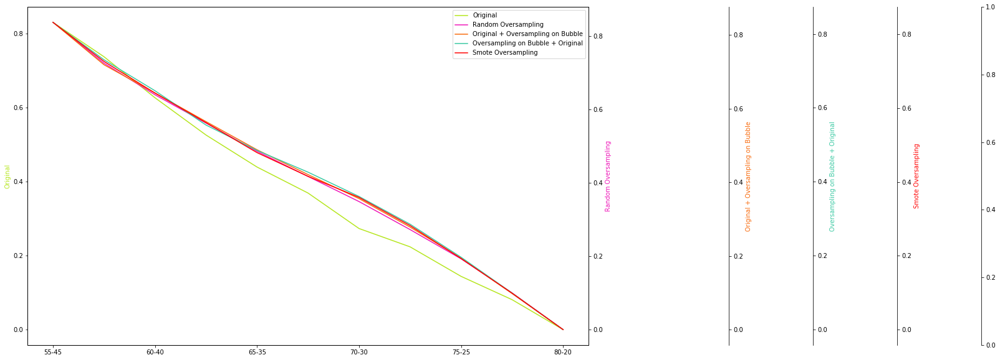

Total_Maxi_AccuracyKNN


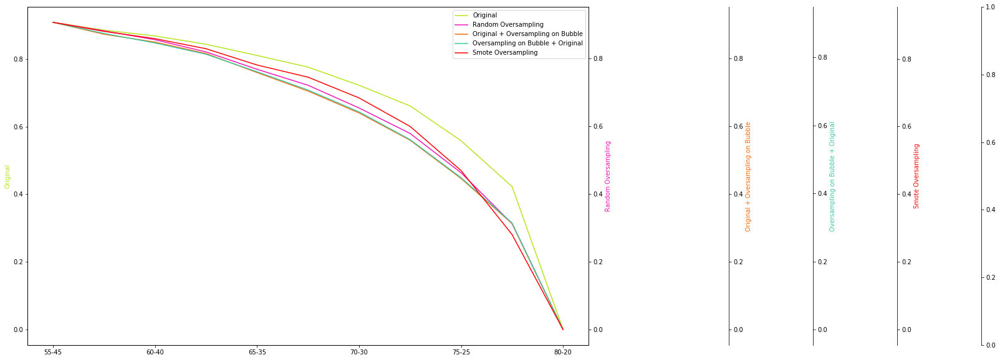

Total_Maxi_AccuracySVC


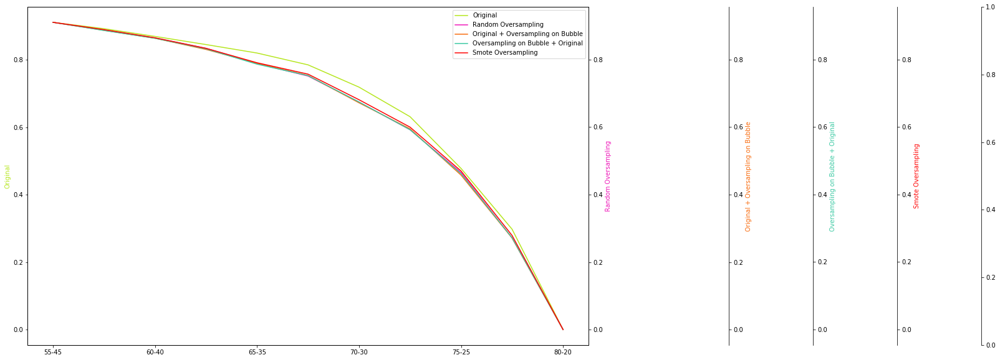

Total_Maxi_AccuracyRF


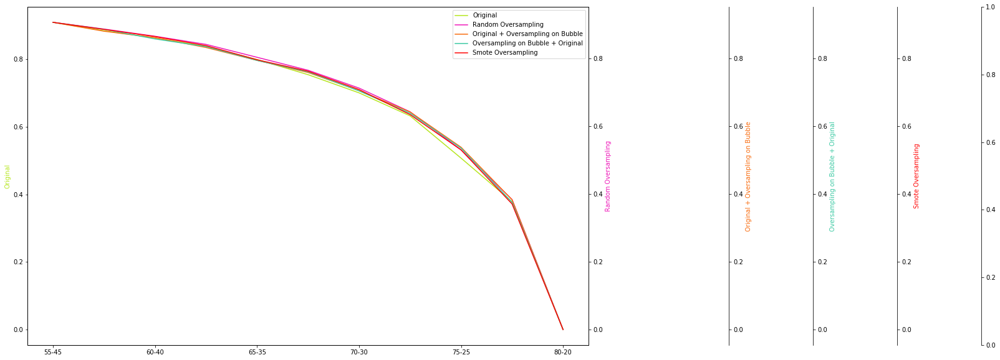

Total_Maxi_AccuracyDT


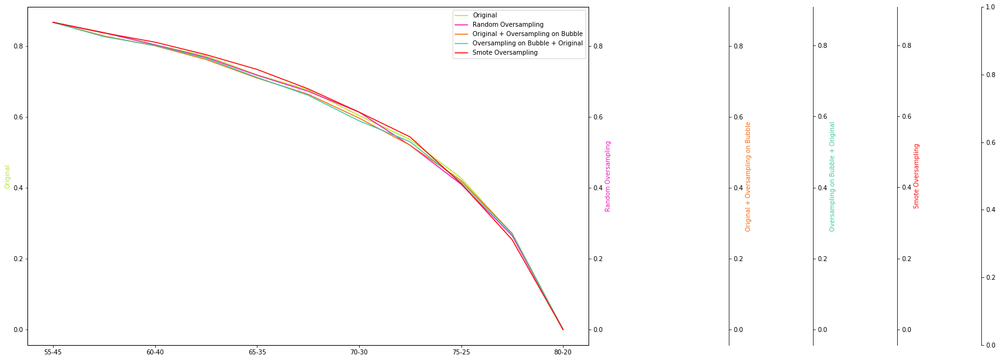

Total_Maxi_Precision 0SGD


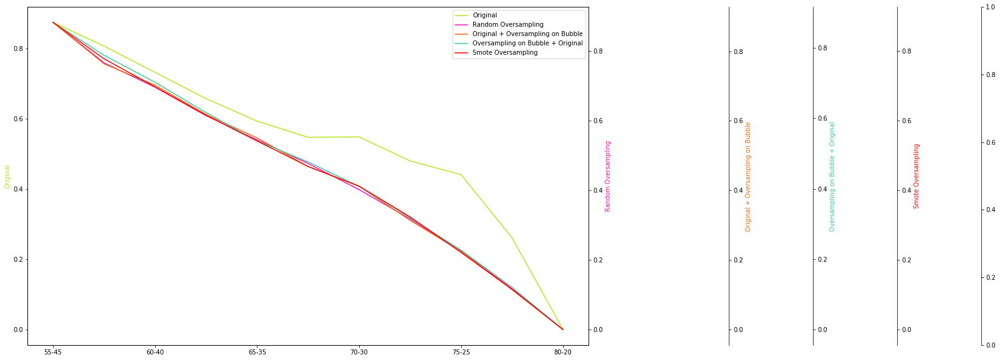

Total_Maxi_Precision 0KNN


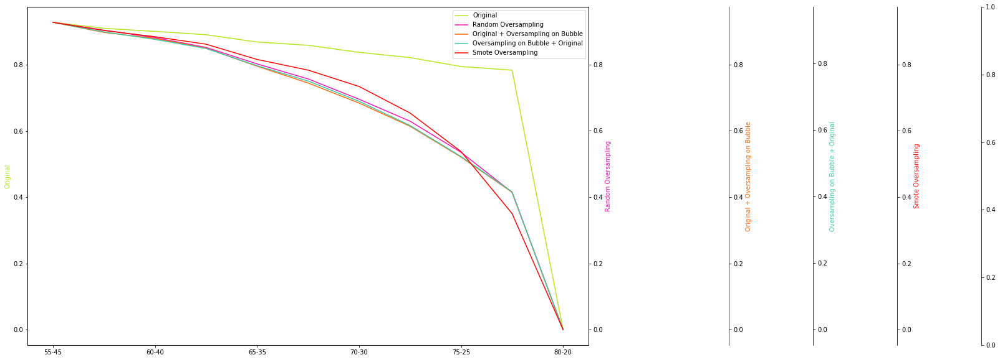

Total_Maxi_Precision 0SVC


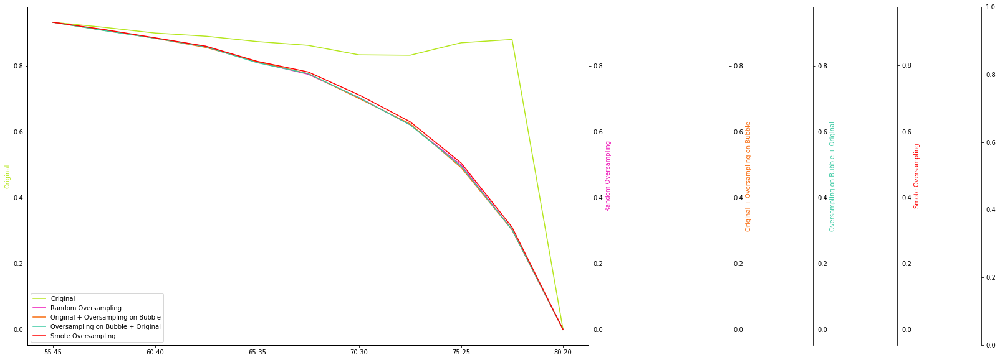

Total_Maxi_Precision 0RF


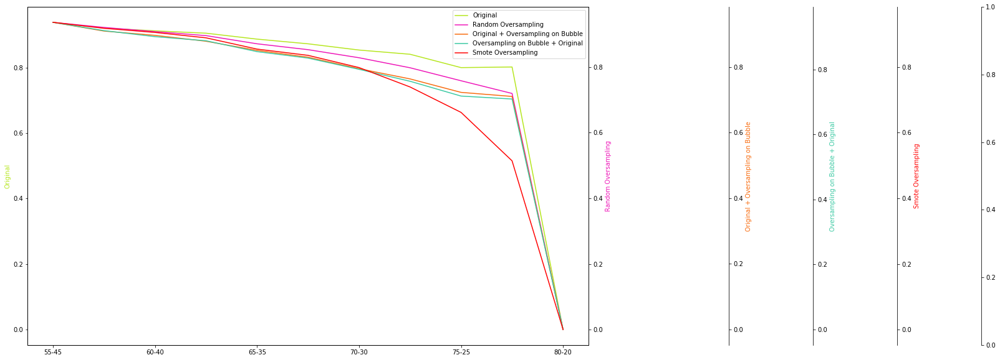

Total_Maxi_Precision 0DT


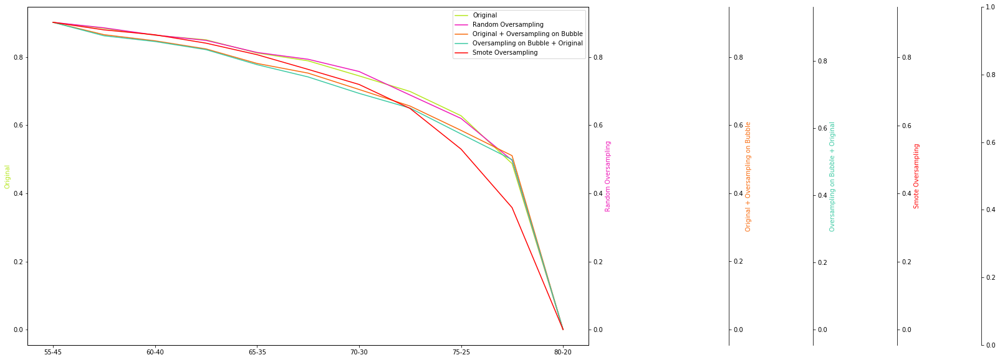

Total_Maxi_Precision 1SGD


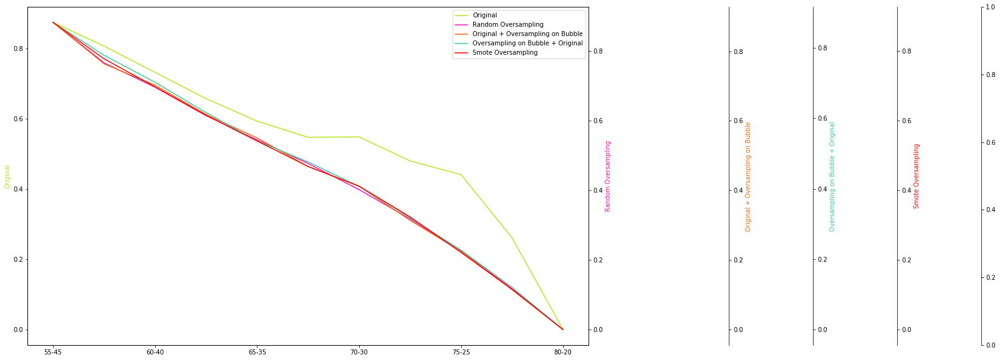

Total_Maxi_Precision 1KNN


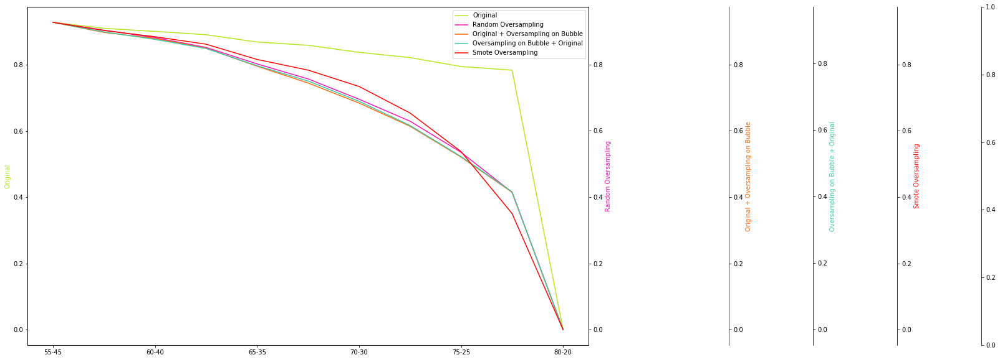

Total_Maxi_Precision 1SVC


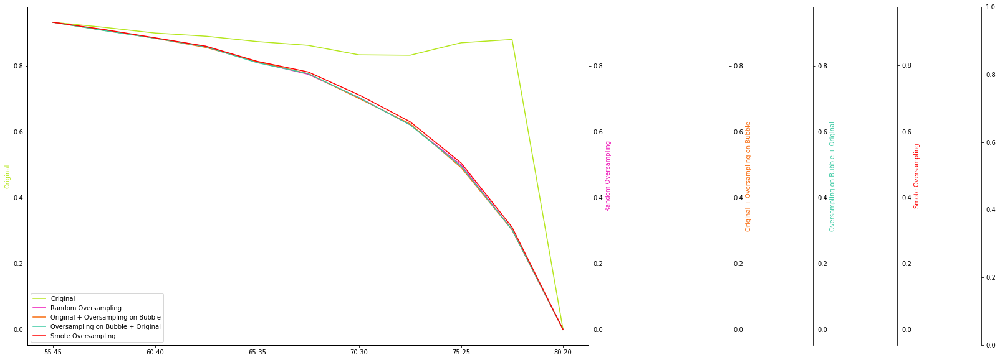

Total_Maxi_Precision 1RF


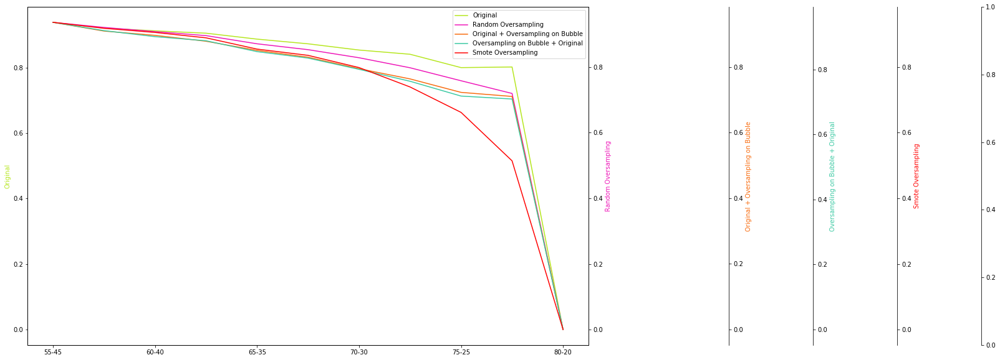

Total_Maxi_Precision 1DT


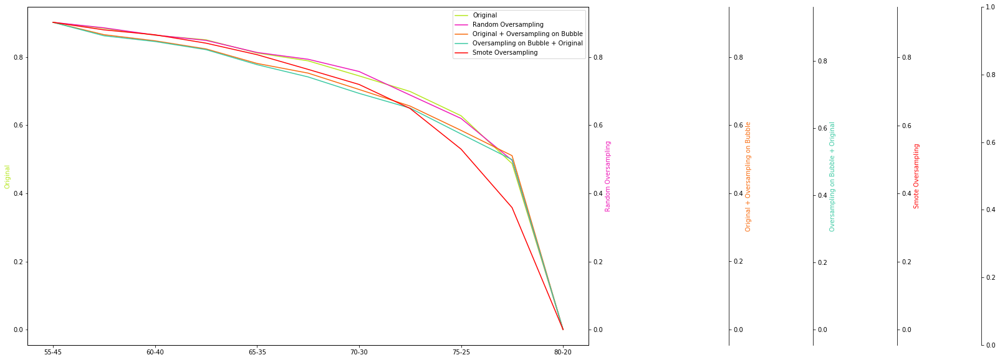

Total_Maxi_Recall 0SGD


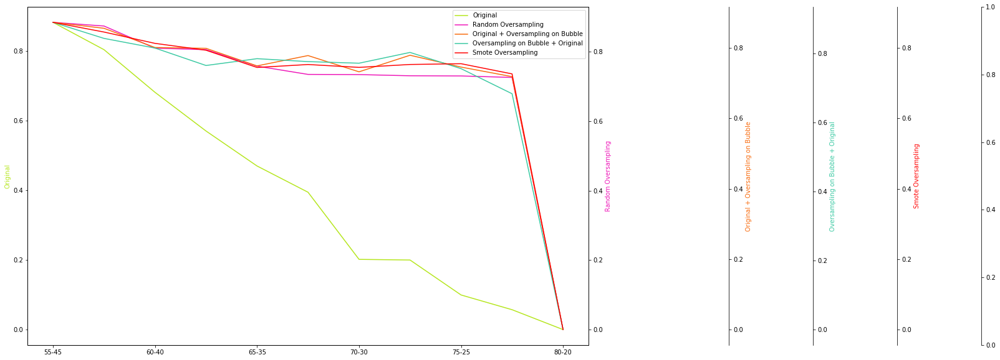

Total_Maxi_Recall 0KNN


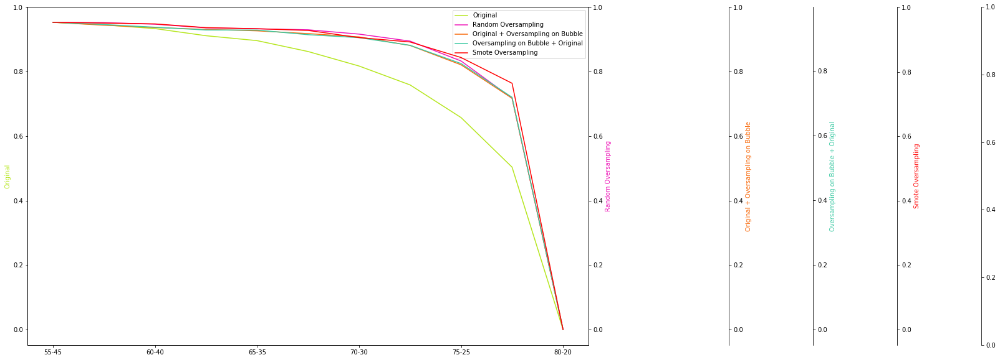

Total_Maxi_Recall 0SVC


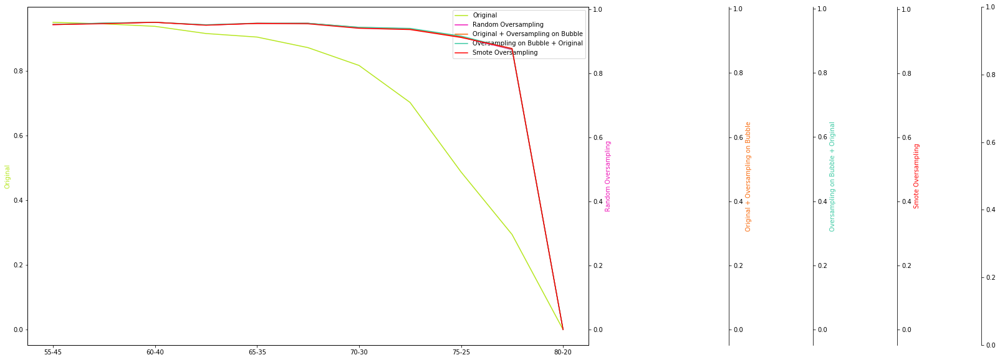

Total_Maxi_Recall 0RF


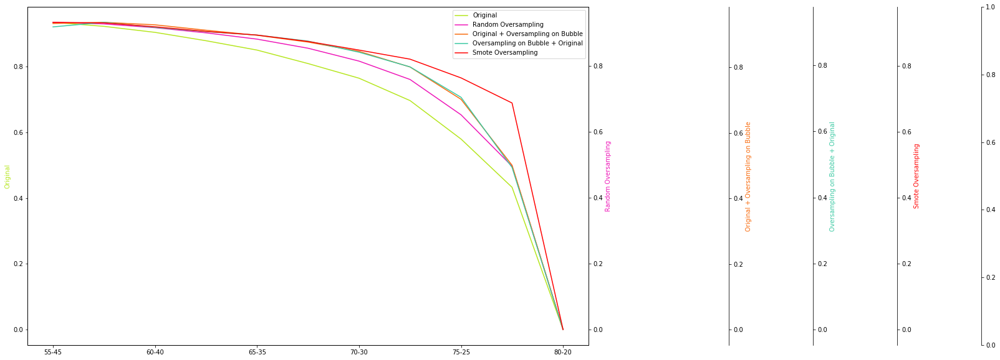

Total_Maxi_Recall 0DT


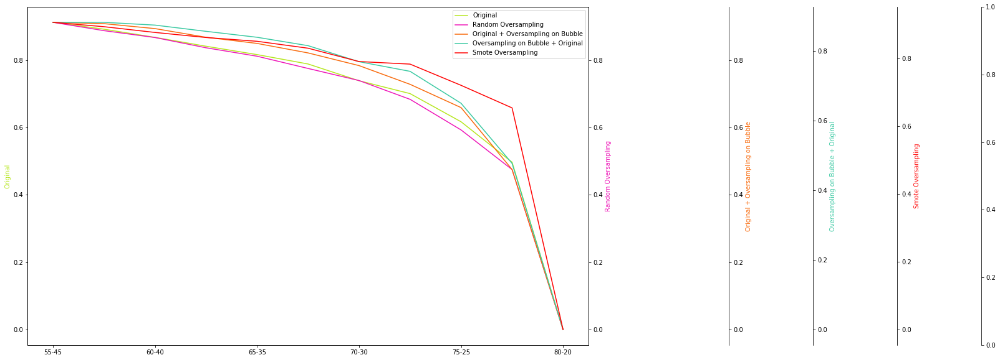

Total_Maxi_Recall1SGD


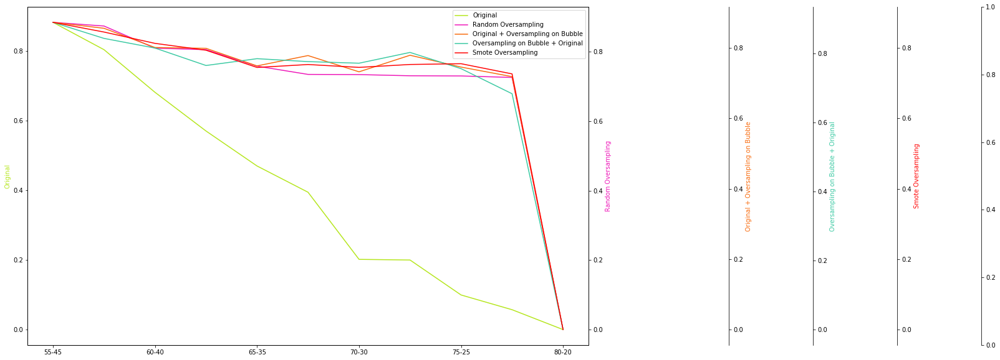

Total_Maxi_Recall1KNN


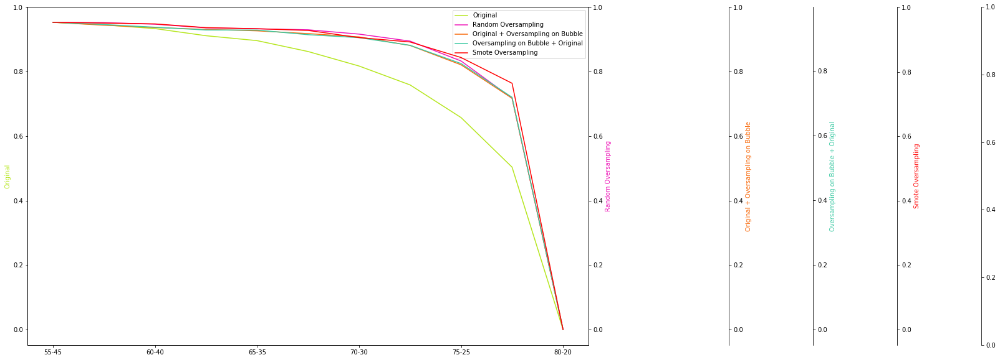

Total_Maxi_Recall1SVC


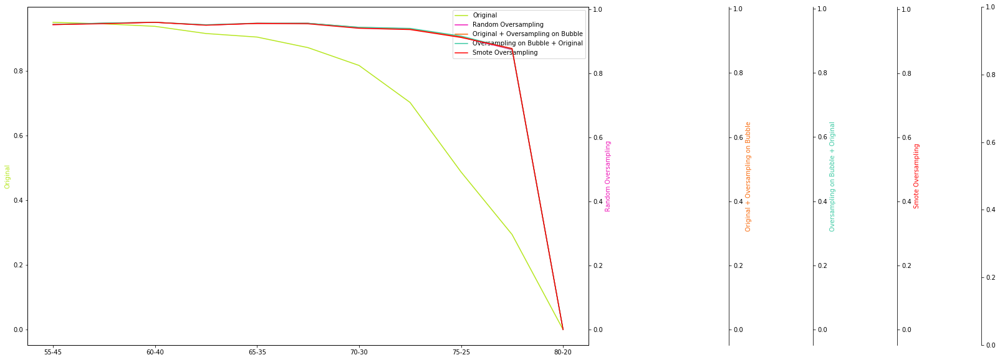

Total_Maxi_Recall1RF


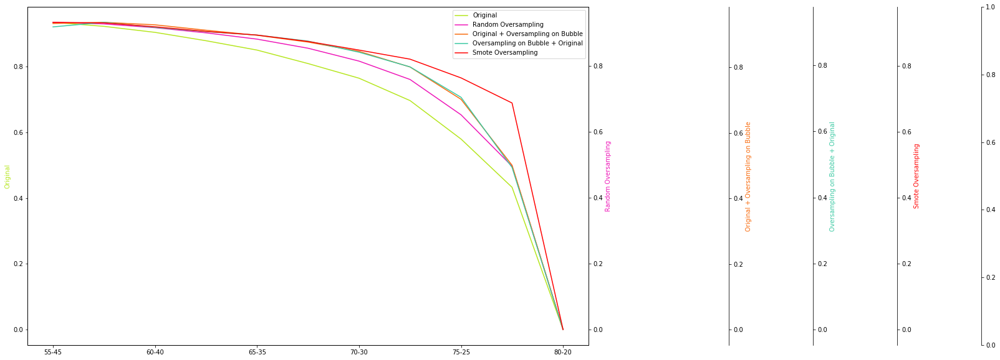

Total_Maxi_Recall1DT


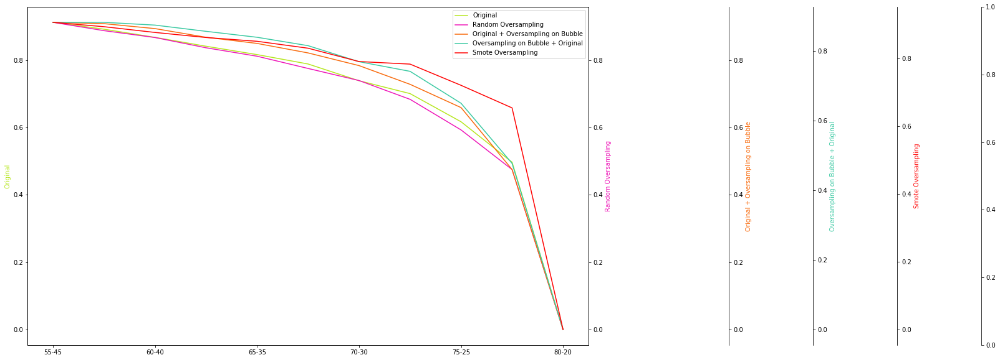

Total_Maxi_Balanced_AccuracySGD


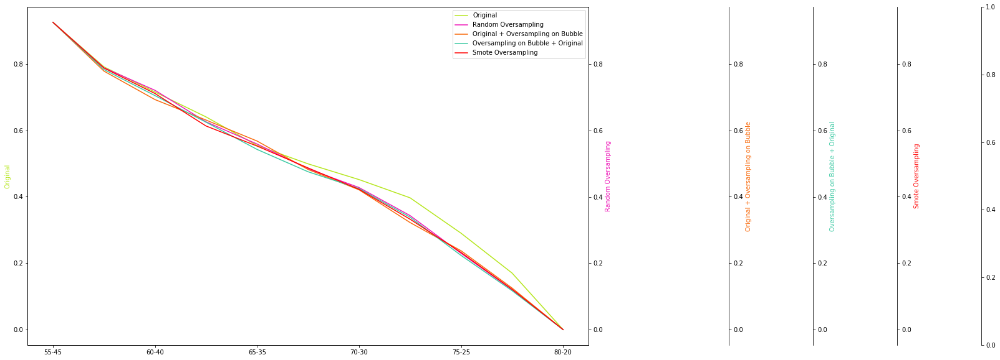

Total_Maxi_Balanced_AccuracyKNN


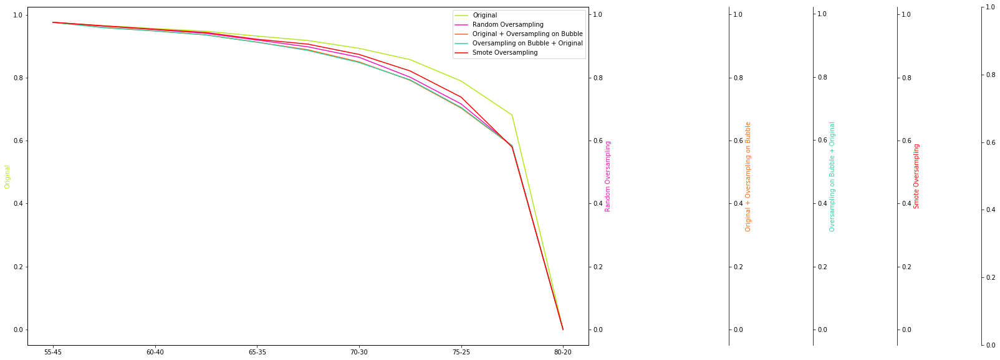

Total_Maxi_Balanced_AccuracySVC


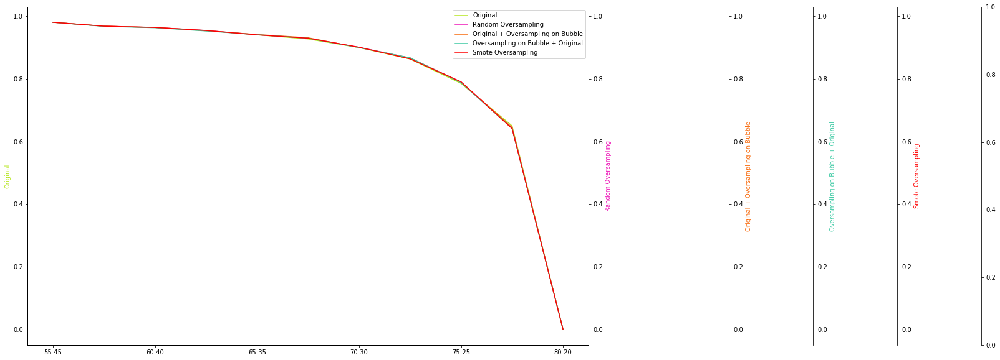

Total_Maxi_Balanced_AccuracyRF


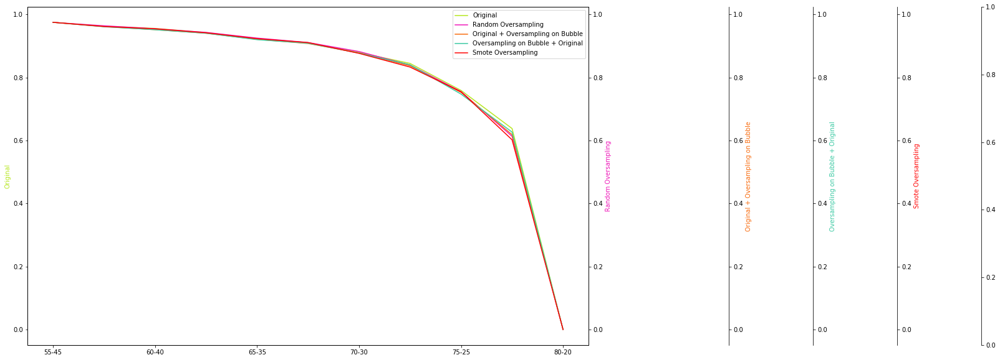

Total_Maxi_Balanced_AccuracyDT


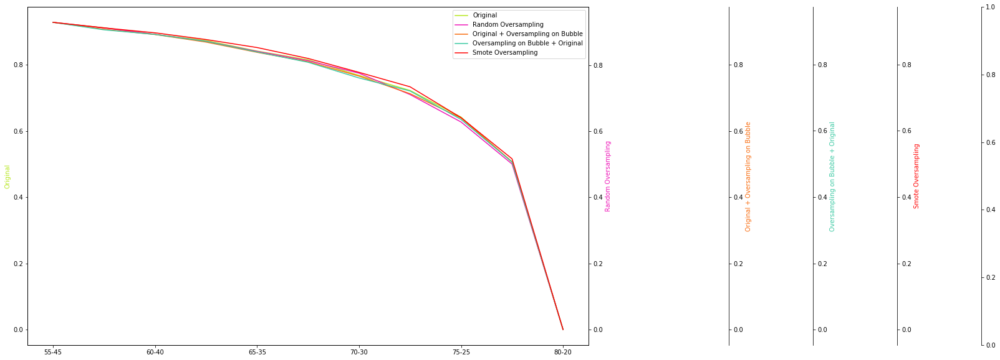

Total_Maxi_F1 Score 0SGD


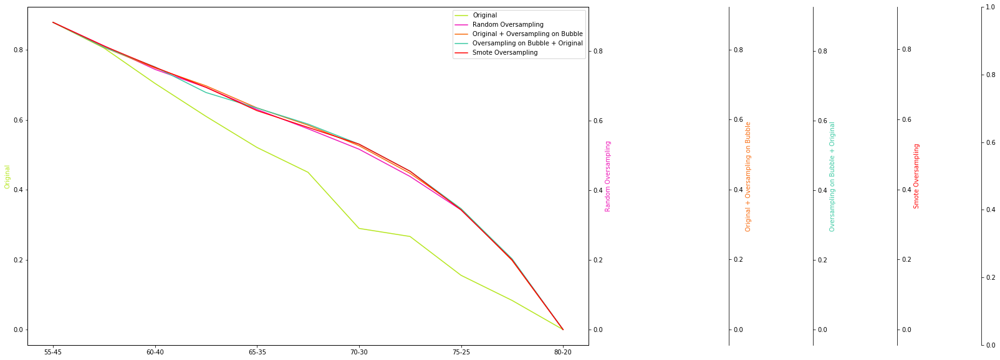

Total_Maxi_F1 Score 0KNN


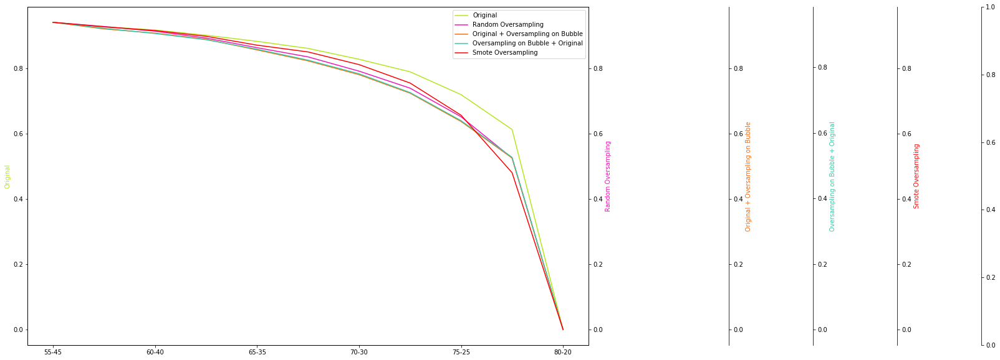

Total_Maxi_F1 Score 0SVC


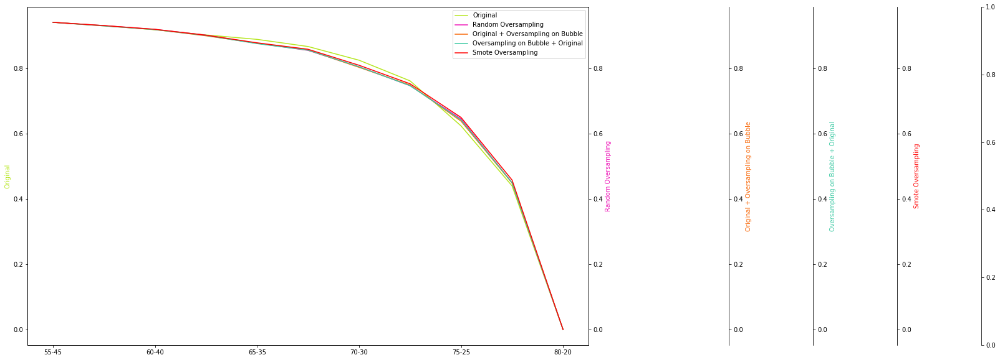

Total_Maxi_F1 Score 0RF


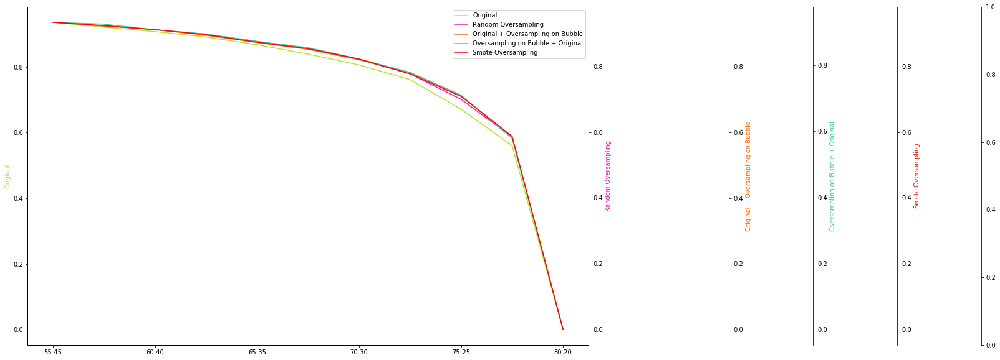

Total_Maxi_F1 Score 0DT


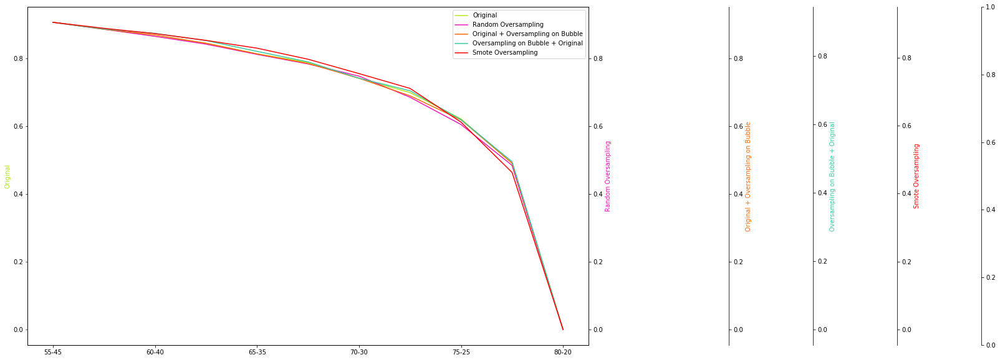

Total_Maxi_F1 Score 1SGD


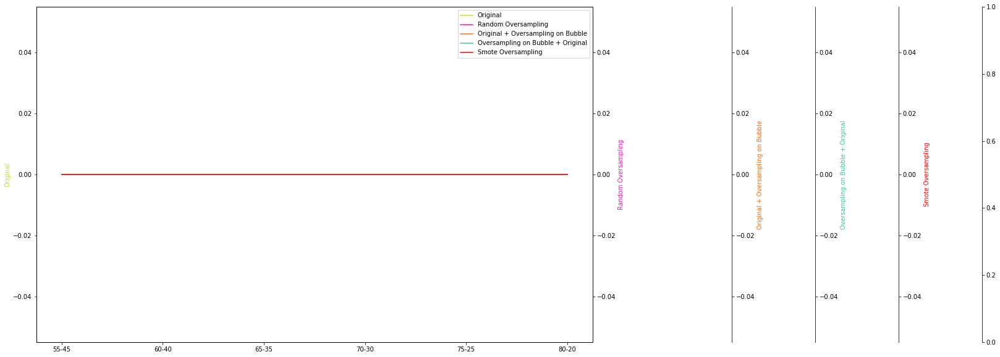

Total_Maxi_F1 Score 1KNN


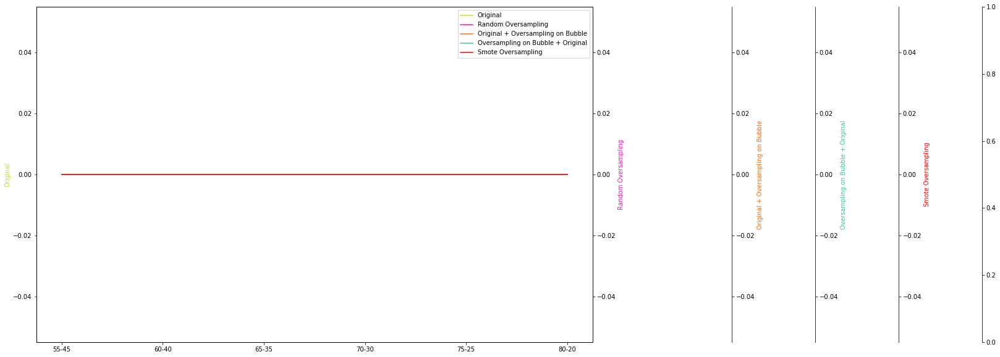

Total_Maxi_F1 Score 1SVC


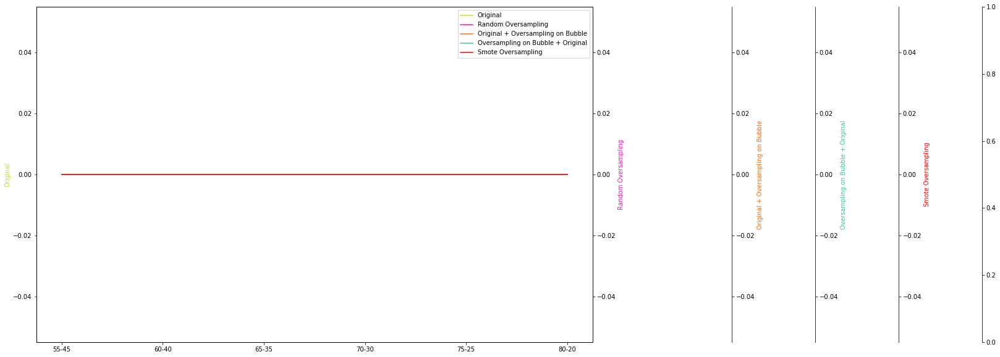

Total_Maxi_F1 Score 1RF


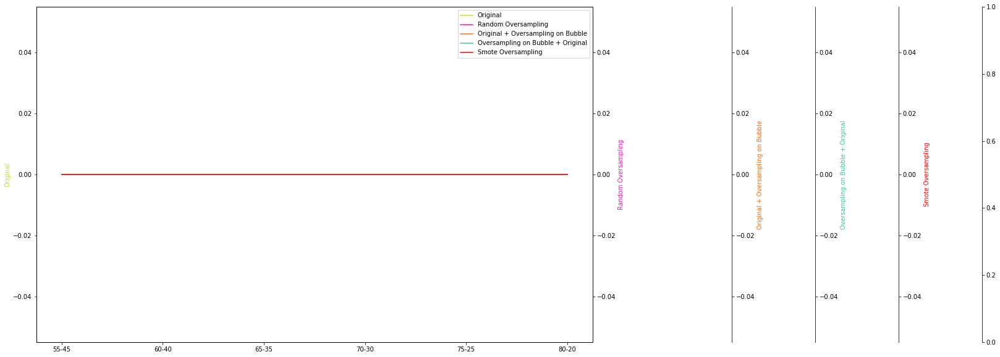

Total_Maxi_F1 Score 1DT


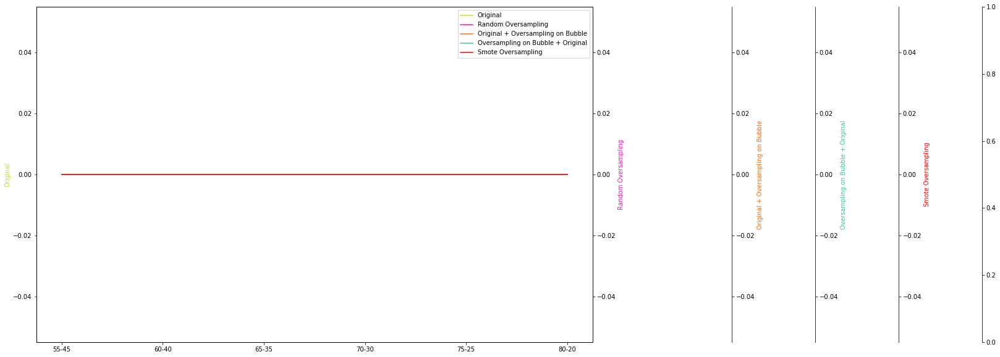

Total_Maxi_AUCSGD


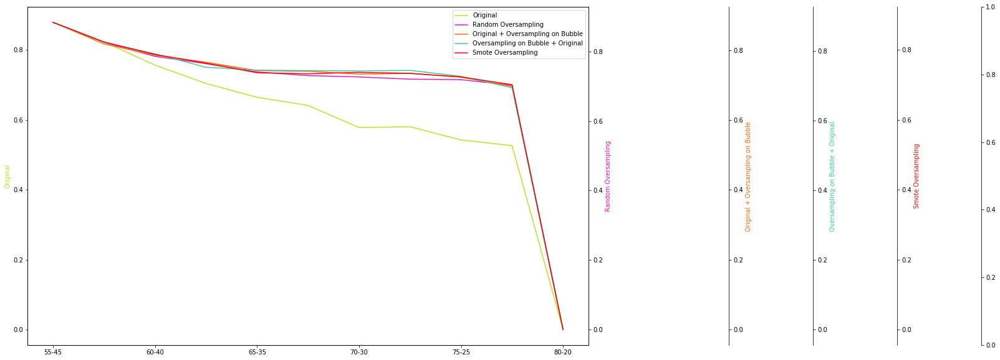

Total_Maxi_AUCKNN


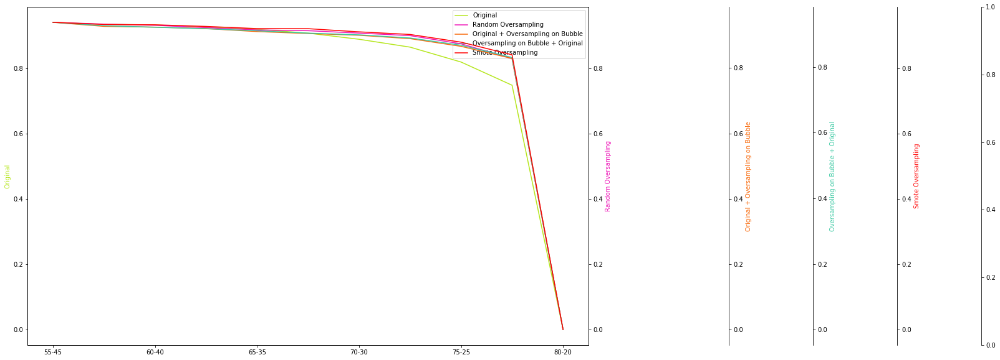

Total_Maxi_AUCSVC


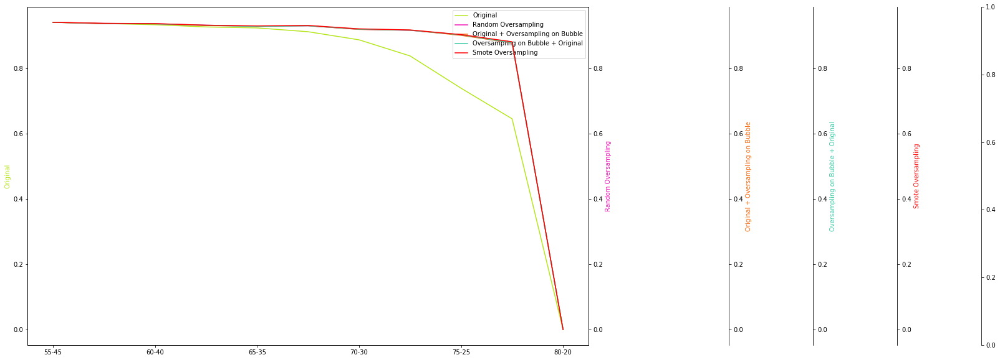

Total_Maxi_AUCRF


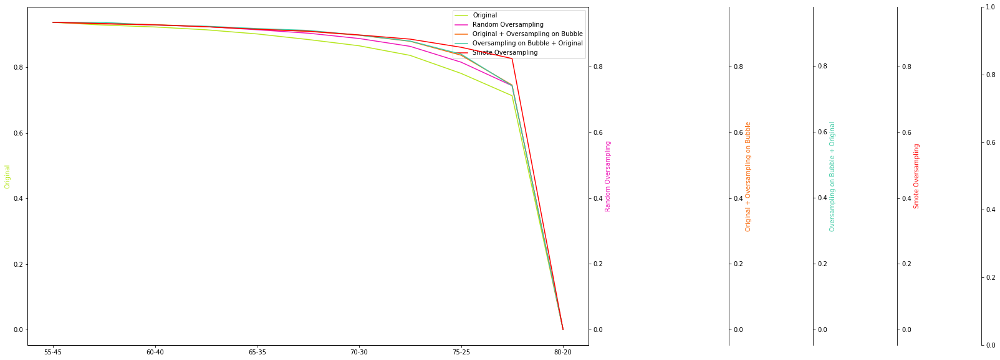

Total_Maxi_AUCDT


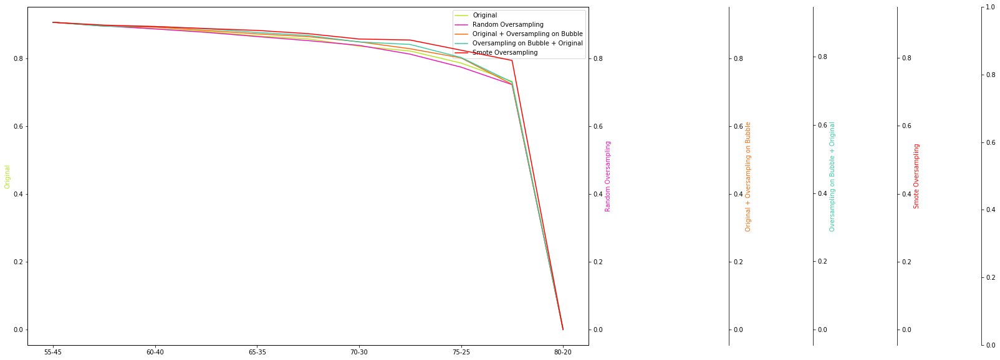

Total_Maxi_AUC Probs 0SGD


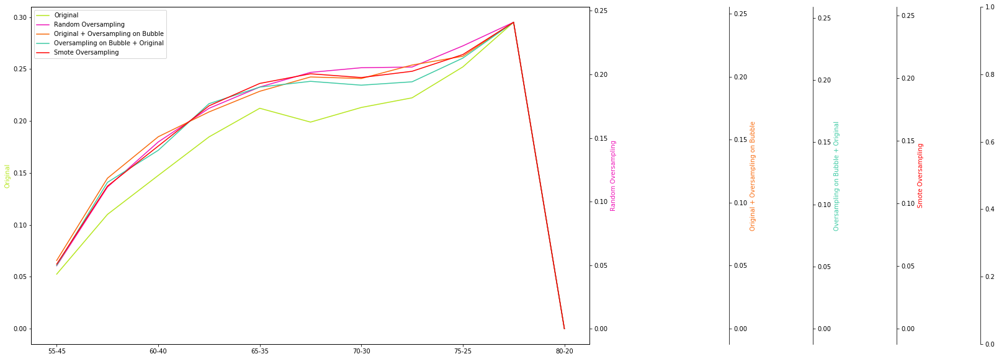

Total_Maxi_AUC Probs 0KNN


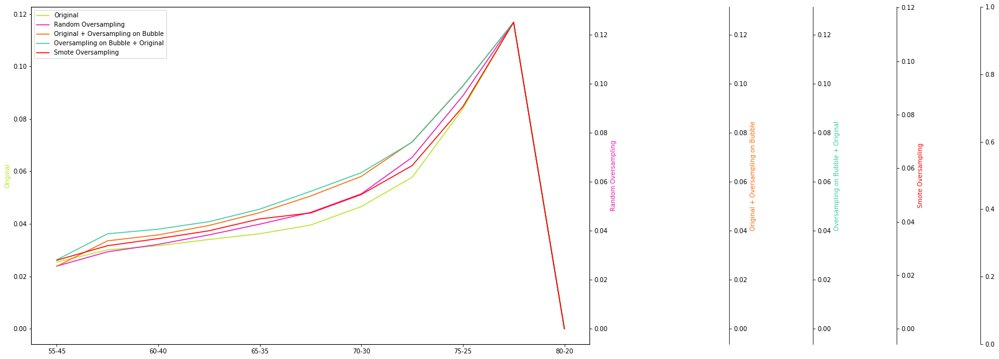

Total_Maxi_AUC Probs 0SVC


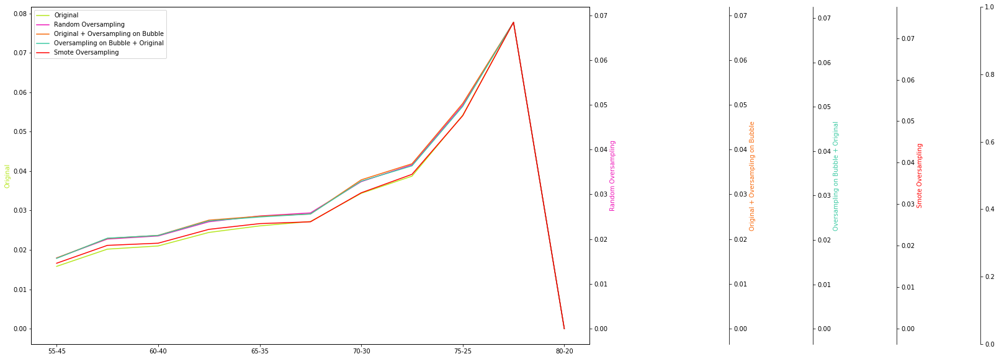

Total_Maxi_AUC Probs 0RF


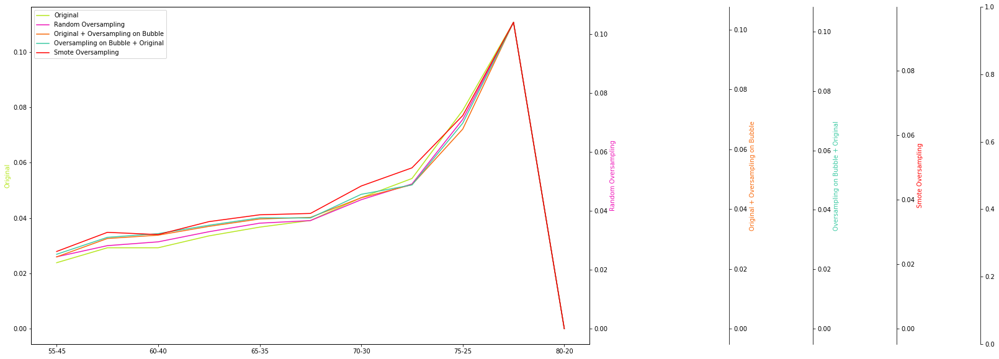

Total_Maxi_AUC Probs 0DT


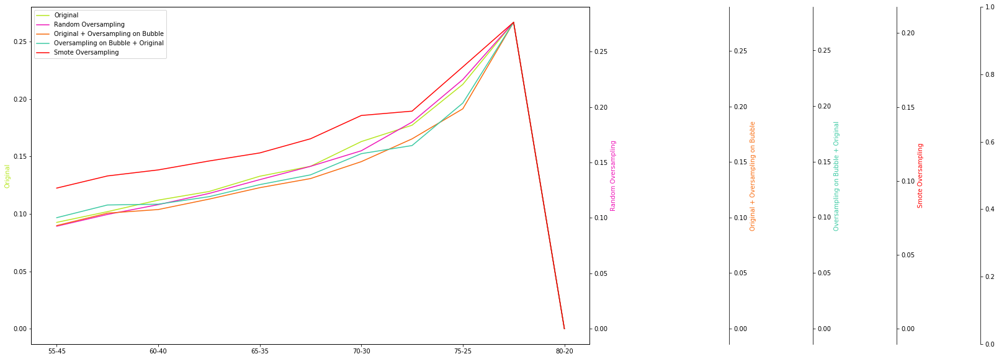

Total_Maxi_AUC Probs 1SGD


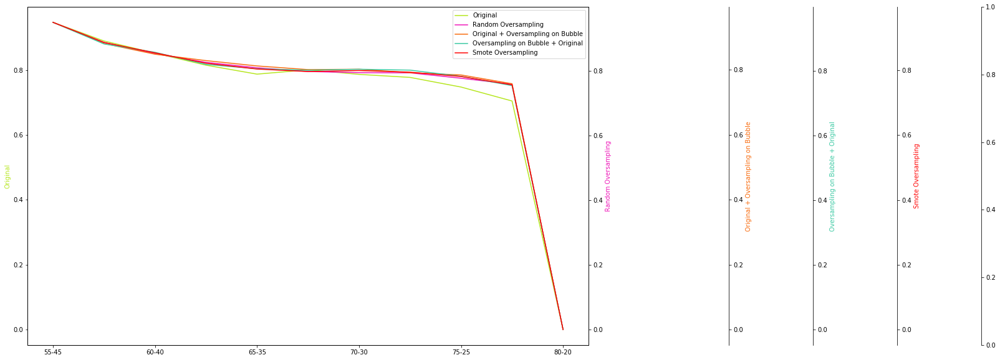

Total_Maxi_AUC Probs 1KNN


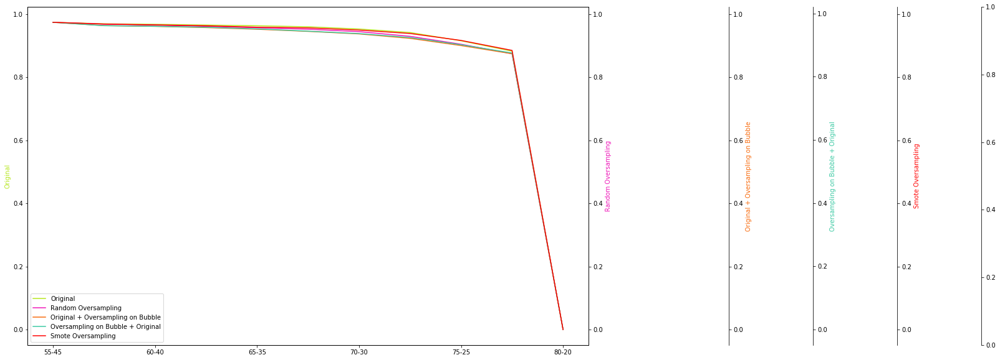

Total_Maxi_AUC Probs 1SVC


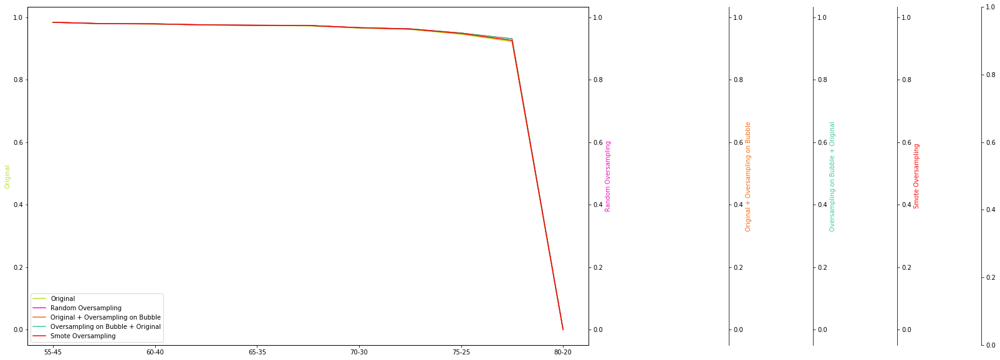

Total_Maxi_AUC Probs 1RF


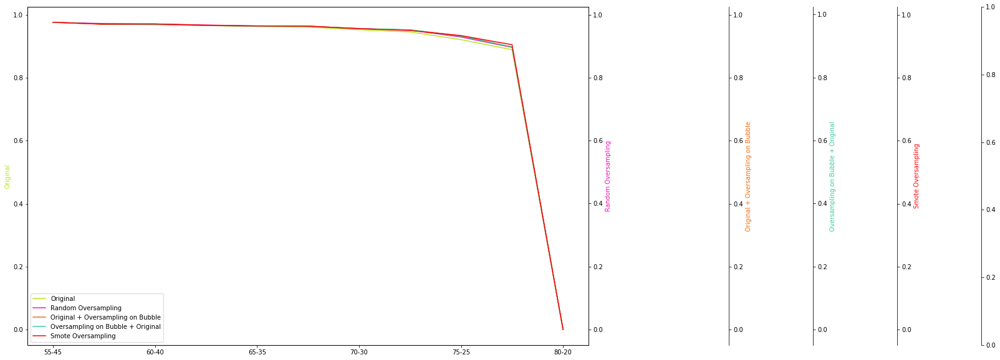

Total_Maxi_AUC Probs 1DT


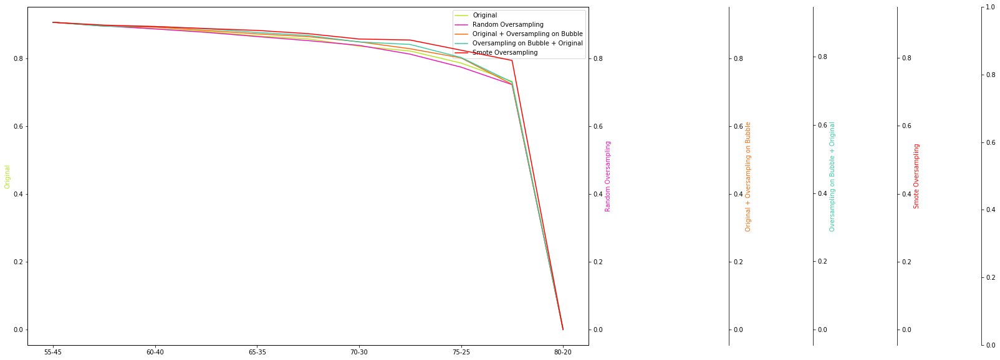

In [10]:
maBulle0 = BuildMyBulle([1,1,1,1,1,1,1], 4, 'normCats_realSnowBubblesTimes15_ray10bis_RealSmote', bulle, bubble_oversample);
maBulle0.instantiate_data();
maBulle0.cross_validate();
maBulle0.visualize_scores()
    

## Midi

youp
setting
props {}
FEATURE VECTOR
Time taken for creating the feature vectors:  0:00:00
ORDER THE DATA
setting
props {}
Time taken for ordering the data:  0:00:01
SPLIT
Time taken for split:  0:00:00
RANDOM OVERSAMPLING
Random Oversample
Time taken for random oversampling:  0:00:00
BUBBLE OVERSAMPLE
Bubble Oversample
aan het bullen 0 0:00:00
aan het bullen 1 0:00:00
aan het bullen 2 0:00:00
aan het bullen 3 0:00:00
aan het bullen 4 0:00:00
aan het bullen 5 0:00:01
aan het bullen 6 0:00:00
Time taken for random bubble oversampling:  0:00:01
SMOTE OVERSAMPLE
Smote Oversample
Time taken for random SMOTE:  0:00:00
setting
props {}
FEATURE VECTOR
Time taken for creating the feature vectors:  0:00:00
ORDER THE DATA
setting
props {}
Time taken for ordering the data:  0:00:00
SPLIT
Time taken for split:  0:00:00
RANDOM OVERSAMPLING
Random Oversample
Time taken for random oversampling:  0:00:00
BUBBLE OVERSAMPLE
Bubble Oversample
aan het bullen 0 0:00:00
aan het bullen 1 0:00:01
aan het bull

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


           Average Precision:  0.589298901941 , Precicion 0:  0.629854368932 , Precision 1 0.629854368932 , Recall 1:  0.698519515478 , Recall 0:  0.698519515478 , PR AUC:  0.603350317237 , F1 Score 0:  0.662412252712 , F1 Score1:  0.662412252712 , AUC:  0.64780665338 , AUC Probs 0:  0.314614073048 , AUC Probs 1:  0.685385926952
         2
           Average Precision:  0.737591656715 , Precicion 0:  0.862676056338 , Precision 1 0.862676056338 , Recall 1:  0.659488559892 , Recall 0:  0.659488559892 , PR AUC:  0.879541088541 , F1 Score 0:  0.747520976354 , F1 Score1:  0.747520976354 , AUC:  0.778225125389 , AUC Probs 0:  0.147571966269 , AUC Probs 1:  0.852428033731
         3
           Average Precision:  0.697601224289 , Precicion 0:  0.773638968481 , Precision 1 0.773638968481 , Recall 1:  0.726783310902 , Recall 0:  0.726783310902 , PR AUC:  0.847535512789 , F1 Score 0:  0.749479528105 , F1 Score1:  0.749479528105 , AUC:  0.759032342373 , AUC Probs 0:  0.160060165241 , AUC Probs 1:

           Average Precision:  0.945470279272 , Precicion 0:  0.981455064194 , Precision 1 0.981455064194 , Recall 1:  0.92597577389 , Recall 0:  0.92597577389 , PR AUC:  0.985593733221 , F1 Score 0:  0.952908587258 , F1 Score1:  0.952908587258 , AUC:  0.954401361185 , AUC Probs 0:  0.0203751082317 , AUC Probs 1:  0.979624891768
         3
           Average Precision:  0.926493159811 , Precicion 0:  0.968526466381 , Precision 1 0.968526466381 , Recall 1:  0.911170928668 , Recall 0:  0.911170928668 , PR AUC:  0.98206691505 , F1 Score 0:  0.938973647712 , F1 Score1:  0.938973647712 , AUC:  0.941054420741 , AUC Probs 0:  0.0249017247725 , AUC Probs 1:  0.975098275228
         4
           Average Precision:  0.925306415433 , Precicion 0:  0.958333333333 , Precision 1 0.958333333333 , Recall 1:  0.92866756393 , Recall 0:  0.92866756393 , PR AUC:  0.984388202595 , F1 Score 0:  0.943267259057 , F1 Score1:  0.943267259057 , AUC:  0.94451872252 , AUC Probs 0:  0.0196879372603 , AUC Probs 1:  

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


0.973277074543 , Recall 1:  0.93135935397 , Recall 0:  0.93135935397 , PR AUC:  0.987543426965 , F1 Score 0:  0.951856946355 , F1 Score1:  0.951856946355 , AUC:  0.953130139337 , AUC Probs 0:  0.016613891699 , AUC Probs 1:  0.983386108301
     Time taken TO TRAIN THE RANDOM OVERSAMPLING TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE TRAINING SET
         0
           Average Precision:  0.937928012549 , Precicion 0:  0.970546984572 , Precision 1 0.970546984572 , Recall 1:  0.93135935397 , Recall 0:  0.93135935397 , PR AUC:  0.986220818828 , F1 Score 0:  0.950549450549 , F1 Score1:  0.950549450549 , AUC:  0.951809135374 , AUC Probs 0:  0.0173748468756 , AUC Probs 1:  0.982625153124
         1
           Average Precision:  0.95293677822 , Precicion 0:  0.981741573034 , Precision 1 0.981741573034 , Recall 1:  0.940780619112 , Recall 0:  0.940780619112 , PR AUC:  0.989207443734 , F1 Score 0:  0.960824742268 , F1 Score1:  0.960824742268 , AUC:  0.961803783796 , AUC Probs 0:  0.0

           Average Precision:  0.930560598685 , Precicion 0:  0.968794326241 , Precision 1 0.968794326241 , Recall 1:  0.919246298789 , Recall 0:  0.919246298789 , PR AUC:  0.987586648631 , F1 Score 0:  0.943370165746 , F1 Score1:  0.943370165746 , AUC:  0.945092105801 , AUC Probs 0:  0.0124561961842 , AUC Probs 1:  0.987543803816
         1
           Average Precision:  0.949327788375 , Precicion 0:  0.987050359712 , Precision 1 0.987050359712 , Recall 1:  0.923283983849 , Recall 0:  0.923283983849 , PR AUC:  0.988541016489 , F1 Score 0:  0.954102920723 , F1 Score1:  0.954102920723 , AUC:  0.955697474091 , AUC Probs 0:  0.0118321418221 , AUC Probs 1:  0.988167858178
         2
           Average Precision:  0.941228944722 , Precicion 0:  0.985422740525 , Precision 1 0.985422740525 , Recall 1:  0.909825033647 , Recall 0:  0.909825033647 , PR AUC:  0.988348295552 , F1 Score 0:  0.94611616515 , F1 Score1:  0.94611616515 , AUC:  0.948307497009 , AUC Probs 0:  0.0116383471627 , AUC Probs 

           Average Precision:  0.940782241137 , Precicion 0:  0.979913916786 , Precision 1 0.979913916786 , Recall 1:  0.919246298789 , Recall 0:  0.919246298789 , PR AUC:  0.987708262192 , F1 Score 0:  0.948611111111 , F1 Score1:  0.948611111111 , AUC:  0.950376121653 , AUC Probs 0:  0.012279291885 , AUC Probs 1:  0.987720708115
         3
           Average Precision:  0.921848570788 , Precicion 0:  0.977678571429 , Precision 1 0.977678571429 , Recall 1:  0.884253028264 , Recall 0:  0.884253028264 , PR AUC:  0.986009348911 , F1 Score 0:  0.928621908127 , F1 Score1:  0.928621908127 , AUC:  0.932218984409 , AUC Probs 0:  0.0146661664749 , AUC Probs 1:  0.985333833525
         4
           Average Precision:  0.933181667868 , Precicion 0:  0.970254957507 , Precision 1 0.970254957507 , Recall 1:  0.921938088829 , Recall 0:  0.921938088829 , PR AUC:  0.985001889147 , F1 Score 0:  0.945479641132 , F1 Score1:  0.945479641132 , AUC:  0.947098502803 , AUC Probs 0:  0.0125077562312 , AUC Probs

           Average Precision:  0.927898298124 , Precicion 0:  0.959778085992 , Precision 1 0.959778085992 , Recall 1:  0.93135935397 , Recall 0:  0.93135935397 , PR AUC:  0.9834410073 , F1 Score 0:  0.945355191257 , F1 Score1:  0.945355191257 , AUC:  0.946525119522 , AUC Probs 0:  0.0199030671116 , AUC Probs 1:  0.980096932888
         6
           Average Precision:  0.931960711714 , Precicion 0:  0.960110041265 , Precision 1 0.960110041265 , Recall 1:  0.939434724092 , Recall 0:  0.939434724092 , PR AUC:  0.983782142035 , F1 Score 0:  0.949659863946 , F1 Score1:  0.949659863946 , AUC:  0.950562804582 , AUC Probs 0:  0.0176157567504 , AUC Probs 1:  0.98238424325
     Time taken TO TRAIN THE ORIGINAL TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE TRAINING SET
         0
           Average Precision:  0.922841116037 , Precicion 0:  0.95567867036 , Precision 1 0.95567867036 , Recall 1:  0.92866756393 , Recall 0:  0.92866756393 , PR AUC:  0.983493218594 , F1 Score 0:  0.941979522184 , F1 Sco

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: 

           Average Precision:  0.912544208965 , Precicion 0:  0.949860724234 , Precision 1 0.949860724234 , Recall 1:  0.917900403769 , Recall 0:  0.917900403769 , PR AUC:  0.981559060096 , F1 Score 0:  0.933607118412 , F1 Score1:  0.933607118412 , AUC:  0.93517213055 , AUC Probs 0:  0.020750252022 , AUC Probs 1:  0.979249747978
         4
           Average Precision:  0.918904423092 , Precicion 0:  0.948158253752 , Precision 1 0.948158253752 , Recall 1:  0.935397039031 , Recall 0:  0.935397039031 , PR AUC:  0.982222629965 , F1 Score 0:  0.941734417344 , F1 Score1:  0.941734417344 , AUC:  0.942599444218 , AUC Probs 0:  0.0178797797497 , AUC Probs 1:  0.98212022025
         5
           Average Precision:  0.913790196263 , Precicion 0:  0.945280437756 , Precision 1 0.945280437756 , Recall 1:  0.93001345895 , Recall 0:  0.93001345895 , PR AUC:  0.983639181588 , F1 Score 0:  0.937584803256 , F1 Score1:  0.937584803256 , AUC:  0.938586650215 , AUC Probs 0:  0.0181873620991 , AUC Probs 1: 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


, Precision 1 0.959722222222 , Recall 1:  0.93001345895 , Recall 0:  0.93001345895 , PR AUC:  0.985484639581 , F1 Score 0:  0.944634313055 , F1 Score1:  0.944634313055 , AUC:  0.945852172011 , AUC Probs 0:  0.0161560740402 , AUC Probs 1:  0.98384392596
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.922598900727 , Precicion 0:  0.958100558659 , Precision 1 0.958100558659 , Recall 1:  0.923283983849 , Recall 0:  0.923283983849 , PR AUC:  0.983792779822 , F1 Score 0:  0.940370116518 , F1 Score1:  0.940370116518 , AUC:  0.941826932479 , AUC Probs 0:  0.0179828998437 , AUC Probs 1:  0.982017100156
         1
           Average Precision:  0.932416061781 , Precicion 0:  0.97150997151 , Precision 1 0.97150997151 , Recall 1:  0.917900403769 , Recall 0:  0.917900403769 , PR AUC:  0.987028029399 , F1 Score 0:  0.943944636678 , F1 Score1:  0.943944636678 

           Average Precision:  0.875134982282 , Precicion 0:  0.913396481732 , Precision 1 0.913396481732 , Recall 1:  0.908479138627 , Recall 0:  0.908479138627 , PR AUC:  0.933604476846 , F1 Score 0:  0.910931174089 , F1 Score1:  0.910931174089 , AUC:  0.911967442497 , AUC Probs 0:  0.0880325575028 , AUC Probs 1:  0.911967442497
         4
           Average Precision:  0.87089372481 , Precicion 0:  0.907506702413 , Precision 1 0.907506702413 , Recall 1:  0.911170928668 , Recall 0:  0.911170928668 , PR AUC:  0.93133881554 , F1 Score 0:  0.909335124244 , F1 Score1:  0.909335124244 , AUC:  0.91001082761 , AUC Probs 0:  0.0899891723901 , AUC Probs 1:  0.91001082761
         5
           Average Precision:  0.897712052012 , Precicion 0:  0.93306010929 , Precision 1 0.93306010929 , Recall 1:  0.919246298789 , Recall 0:  0.919246298789 , PR AUC:  0.946153204039 , F1 Score 0:  0.926101694915 , F1 Score1:  0.926101694915 , AUC:  0.927258552301 , AUC Probs 0:  0.0727414476994 , AUC Probs 1:  

           Average Precision:  0.867348639732 , Precicion 0:  0.904825737265 , Precision 1 0.904825737265 , Recall 1:  0.908479138627 , Recall 0:  0.908479138627 , PR AUC:  0.929319104613 , F1 Score 0:  0.906648757555 , F1 Score1:  0.906648757555 , AUC:  0.907343928627 , AUC Probs 0:  0.0926560713733 , AUC Probs 1:  0.907343928627
         4
           Average Precision:  0.881615579186 , Precicion 0:  0.915549597855 , Precision 1 0.915549597855 , Recall 1:  0.919246298789 , Recall 0:  0.919246298789 , PR AUC:  0.937397948322 , F1 Score 0:  0.917394224312 , F1 Score1:  0.917394224312 , AUC:  0.918011524559 , AUC Probs 0:  0.0819884754405 , AUC Probs 1:  0.918011524559
         5
           Average Precision:  0.889205256029 , Precicion 0:  0.926330150068 , Precision 1 0.926330150068 , Recall 1:  0.913862718708 , Recall 0:  0.913862718708 , PR AUC:  0.941429767721 , F1 Score 0:  0.920054200542 , F1 Score1:  0.920054200542 , AUC:  0.921264252353 , AUC Probs 0:  0.0787357476474 , AUC Prob

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


 Average Precision:  0.683118038962 , Precicion 0:  0.793760831889 , Precision 1 0.793760831889 , Recall 1:  0.677514792899 , Recall 0:  0.677514792899 , PR AUC:  0.827593153269 , F1 Score 0:  0.731045490822 , F1 Score1:  0.731045490822 , AUC:  0.766548658586 , AUC Probs 0:  0.164034224737 , AUC Probs 1:  0.835965775263
         1
           Average Precision:  0.679797101449 , Precicion 0:  0.847826086957 , Precision 1 0.847826086957 , Recall 1:  0.576923076923 , Recall 0:  0.576923076923 , PR AUC:  0.830486648655 , F1 Score 0:  0.68661971831 , F1 Score1:  0.68661971831 , AUC:  0.745985810306 , AUC Probs 0:  0.17548795025 , AUC Probs 1:  0.82451204975
         2
           Average Precision:  0.65830165439 , Precicion 0:  0.717006802721 , Precision 1 0.717006802721 , Recall 1:  0.779585798817 , Recall 0:  0.779585798817 , PR AUC:  0.724181446674 , F1 Score 0:  0.746987951807 , F1 Score1:  0.746987951807 , AUC:  0.763579307175 , AUC Probs 0:  0.163894194864 , AUC Probs 1:  0.8361058051

           Average Precision:  0.919754672969 , Precicion 0:  0.961300309598 , Precision 1 0.961300309598 , Recall 1:  0.918639053254 , Recall 0:  0.918639053254 , PR AUC:  0.979627999956 , F1 Score 0:  0.939485627837 , F1 Score1:  0.939485627837 , AUC:  0.944149623715 , AUC Probs 0:  0.022110357902 , AUC Probs 1:  0.977889642098
         2
           Average Precision:  0.910543721236 , Precicion 0:  0.953703703704 , Precision 1 0.953703703704 , Recall 1:  0.914201183432 , Recall 0:  0.914201183432 , PR AUC:  0.97327633469 , F1 Score 0:  0.933534743202 , F1 Score1:  0.933534743202 , AUC:  0.938896708221 , AUC Probs 0:  0.0297321120813 , AUC Probs 1:  0.970267887919
         3
           Average Precision:  0.911839781421 , Precicion 0:  0.948562783661 , Precision 1 0.948562783661 , Recall 1:  0.926144756278 , Recall 0:  0.926144756278 , PR AUC:  0.974251255504 , F1 Score 0:  0.937219730942 , F1 Score1:  0.937219730942 , AUC:  0.942416242051 , AUC Probs 0:  0.0274134870623 , AUC Probs 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.899911745587 , Precicion 0:  0.939577039275 , Precision 1 0.939577039275 , Recall 1:  0.918759231905 , Recall 0:  0.918759231905 , PR AUC:  0.97389130235 , F1 Score 0:  0.929051530993 , F1 Score1:  0.929051530993 , AUC:  0.935078279379 , AUC Probs 0:  0.0307966495026 , AUC Probs 1:  0.969203350497
         5
           Average Precision:  0.902450272313 , Precicion 0:  0.946319018405 , Precision 1 0.946319018405 , Recall 1:  0.911373707533 , Recall 0:  0.911373707533 , PR AUC:  0.970807734789 , F1 Score 0:  0.928517682468 , F1 Score1:  0.928517682468 , AUC:  0.934423184265 , AUC Probs 0:  0.0336333010871 , AUC Probs 1:  0.966366698913
         6
           Average Precision:  0.909271441685 , Precicion 0:  0.941877794337 , Precision 1 0.941877794337 , Recall 1:  0.93353028065 , Recall 0:  0.93353028065 , PR AUC:  0.978786865006 , F1 Score 0:  0.937685459941 , F1 Score1:  0.937685459941 , AUC:  0.943071337166 , AUC Probs 0:  0.023069219324 , AUC Probs 1:

           Average Precision:  0.897367311151 , Precicion 0:  0.962479608483 , Precision 1 0.962479608483 , Recall 1:  0.872781065089 , Recall 0:  0.872781065089 , PR AUC:  0.977470939617 , F1 Score 0:  0.915438324282 , F1 Score1:  0.915438324282 , AUC:  0.922434221865 , AUC Probs 0:  0.0203384414316 , AUC Probs 1:  0.979661558568
         1
           Average Precision:  0.924788377805 , Precicion 0:  0.970125786164 , Precision 1 0.970125786164 , Recall 1:  0.912721893491 , Recall 0:  0.912721893491 , PR AUC:  0.98055093819 , F1 Score 0:  0.940548780488 , F1 Score1:  0.940548780488 , AUC:  0.944831820532 , AUC Probs 0:  0.0174103808813 , AUC Probs 1:  0.982589619119
         2
           Average Precision:  0.906764556399 , Precicion 0:  0.956112852665 , Precision 1 0.956112852665 , Recall 1:  0.902366863905 , Recall 0:  0.902366863905 , PR AUC:  0.977436866109 , F1 Score 0:  0.928462709285 , F1 Score1:  0.928462709285 , AUC:  0.934193140691 , AUC Probs 0:  0.0169543861665 , AUC Probs

           Average Precision:  0.898724800166 , Precicion 0:  0.936842105263 , Precision 1 0.936842105263 , Recall 1:  0.921597633136 , Recall 0:  0.921597633136 , PR AUC:  0.975082896137 , F1 Score 0:  0.929157345265 , F1 Score1:  0.929157345265 , AUC:  0.935313379675 , AUC Probs 0:  0.0183259608204 , AUC Probs 1:  0.98167403918
         3
           Average Precision:  0.900997066819 , Precicion 0:  0.932253313697 , Precision 1 0.932253313697 , Recall 1:  0.935007385524 , Recall 0:  0.935007385524 , PR AUC:  0.974433408951 , F1 Score 0:  0.933628318584 , F1 Score1:  0.933628318584 , AUC:  0.939557155703 , AUC Probs 0:  0.019179031213 , AUC Probs 1:  0.980820968787
         4
           Average Precision:  0.888333197584 , Precicion 0:  0.92697466468 , Precision 1 0.92697466468 , Recall 1:  0.918759231905 , Recall 0:  0.918759231905 , PR AUC:  0.977908217073 , F1 Score 0:  0.922848664688 , F1 Score1:  0.922848664688 , AUC:  0.92961047865 , AUC Probs 0:  0.0188371254067 , AUC Probs 1: 

           Average Precision:  0.894978809928 , Precicion 0:  0.942901234568 , Precision 1 0.942901234568 , Recall 1:  0.902511078287 , Recall 0:  0.902511078287 , PR AUC:  0.972441953845 , F1 Score 0:  0.922264150943 , F1 Score1:  0.922264150943 , AUC:  0.928776802813 , AUC Probs 0:  0.0247957987763 , AUC Probs 1:  0.975204201224
         6
           Average Precision:  0.916113099937 , Precicion 0:  0.955589586524 , Precision 1 0.955589586524 , Recall 1:  0.921713441654 , Recall 0:  0.921713441654 , PR AUC:  0.979951547203 , F1 Score 0:  0.938345864662 , F1 Score1:  0.938345864662 , AUC:  0.943238251811 , AUC Probs 0:  0.0181344685922 , AUC Probs 1:  0.981865531408
     Time taken TO TRAIN THE ORIGINAL TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE TRAINING SET
         0
           Average Precision:  0.890836595357 , Precicion 0:  0.938461538462 , Precision 1 0.938461538462 , Recall 1:  0.902366863905 , Recall 0:  0.902366863905 , PR AUC:  0.971009916172 , F1 Score 0:  0.920060331825

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.900336088873 , Precicion 0:  0.930882352941 , Precision 1 0.930882352941 , Recall 1:  0.936390532544 , Recall 0:  0.936390532544 , PR AUC:  0.975236821787 , F1 Score 0:  0.933628318584 , F1 Score1:  0.933628318584 , AUC:  0.939675848796 , AUC Probs 0:  0.0208464985351 , AUC Probs 1:  0.979153501465
         2
           Average Precision:  0.903565451782 , Precicion 0:  0.93740685544 , Precision 1 0.93740685544 , Recall 1:  0.930473372781 , Recall 0:  0.930473372781 , PR AUC:  0.969611531413 , F1 Score 0:  0.933927245731 , F1 Score1:  0.933927245731 , AUC:  0.939751249497 , AUC Probs 0:  0.0251551100132 , AUC Probs 1:  0.974844889987
         3
           Average Precision:  0.895309228694 , Precicion 0:  0.923188405797 , Precision 1 0.923188405797 , Recall 1:  0.940915805022 , Recall 0:  0.940915805022 , PR AUC:  0.967068662385 , F1 Score 0:  0.931967812729 , F1 Score1:  0.931967812729 , AUC:  0.938258631551 , AUC Probs 0:  0.0283880532189 , AUC Probs 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: 

           Average Precision:  0.872699391573 , Precicion 0:  0.915178571429 , Precision 1 0.915178571429 , Recall 1:  0.908419497784 , Recall 0:  0.908419497784 , PR AUC:  0.968087099488 , F1 Score 0:  0.911786508525 , F1 Score1:  0.911786508525 , AUC:  0.919580344275 , AUC Probs 0:  0.0286608599514 , AUC Probs 1:  0.971339140049
         5
           Average Precision:  0.888550950691 , Precicion 0:  0.923416789396 , Precision 1 0.923416789396 , Recall 1:  0.926144756278 , Recall 0:  0.926144756278 , PR AUC:  0.968068052728 , F1 Score 0:  0.924778761062 , F1 Score1:  0.924778761062 , AUC:  0.931480640593 , AUC Probs 0:  0.0276593720779 , AUC Probs 1:  0.972340627922
         6
           Average Precision:  0.906789086342 , Precicion 0:  0.935389133627 , Precision 1 0.935389133627 , Recall 1:  0.940915805022 , Recall 0:  0.940915805022 , PR AUC:  0.975871810276 , F1 Score 0:  0.938144329897 , F1 Score1:  0.938144329897 , AUC:  0.94372643228 , AUC Probs 0:  0.0213013599057 , AUC Probs

           Average Precision:  0.860296428246 , Precicion 0:  0.906110283159 , Precision 1 0.906110283159 , Recall 1:  0.899408284024 , Recall 0:  0.899408284024 , PR AUC:  0.925425950258 , F1 Score 0:  0.90274684484 , F1 Score1:  0.90274684484 , AUC:  0.911475986672 , AUC Probs 0:  0.088524013328 , AUC Probs 1:  0.911475986672
         3
           Average Precision:  0.853468735314 , Precicion 0:  0.887624466572 , Precision 1 0.887624466572 , Recall 1:  0.921713441654 , Recall 0:  0.921713441654 , PR AUC:  0.92233562078 , F1 Score 0:  0.904347826087 , F1 Score1:  0.904347826087 , AUC:  0.912861581094 , AUC Probs 0:  0.0871384189055 , AUC Probs 1:  0.912861581094
         4
           Average Precision:  0.857341004914 , Precicion 0:  0.903417533432 , Precision 1 0.903417533432 , Recall 1:  0.898079763663 , Recall 0:  0.898079763663 , PR AUC:  0.923748648548 , F1 Score 0:  0.900740740741 , F1 Score1:  0.900740740741 , AUC:  0.9095502099 , AUC Probs 0:  0.0904497901003 , AUC Probs 1:  

           Average Precision:  0.837784594201 , Precicion 0:  0.880230880231 , Precision 1 0.880230880231 , Recall 1:  0.901033973412 , Recall 0:  0.901033973412 , PR AUC:  0.912965760155 , F1 Score 0:  0.890510948905 , F1 Score1:  0.890510948905 , AUC:  0.900091713316 , AUC Probs 0:  0.099908286684 , AUC Probs 1:  0.900091713316
         5
           Average Precision:  0.826150371938 , Precicion 0:  0.882882882883 , Precision 1 0.882882882883 , Recall 1:  0.868537666174 , Recall 0:  0.868537666174 , PR AUC:  0.905376941195 , F1 Score 0:  0.875651526433 , F1 Score1:  0.875651526433 , AUC:  0.886881226769 , AUC Probs 0:  0.113118773231 , AUC Probs 1:  0.886881226769
         6
           Average Precision:  0.843843135541 , Precicion 0:  0.89201183432 , Precision 1 0.89201183432 , Recall 1:  0.890694239291 , Recall 0:  0.890694239291 , PR AUC:  0.916019703472 , F1 Score 0:  0.891352549889 , F1 Score1:  0.891352549889 , AUC:  0.900997180399 , AUC Probs 0:  0.0990028196012 , AUC Probs 1:

           Average Precision:  0.60476663786 , Precicion 0:  0.645994832041 , Precision 1 0.645994832041 , Recall 1:  0.831946755408 , Recall 0:  0.831946755408 , PR AUC:  0.582490510878 , F1 Score 0:  0.727272727273 , F1 Score1:  0.727272727273 , AUC:  0.763581831541 , AUC Probs 0:  0.207714617277 , AUC Probs 1:  0.792285382723
         1
           Average Precision:  0.598733502221 , Precicion 0:  0.668168168168 , Precision 1 0.668168168168 , Recall 1:  0.740432612313 , Recall 0:  0.740432612313 , PR AUC:  0.72907732315 , F1 Score 0:  0.702446724546 , F1 Score1:  0.702446724546 , AUC:  0.747301956879 , AUC Probs 0:  0.16906194533 , AUC Probs 1:  0.83093805467
         2
           Average Precision:  0.620724470879 , Precicion 0:  0.732965009208 , Precision 1 0.732965009208 , Recall 1:  0.662229617304 , Recall 0:  0.662229617304 , PR AUC:  0.794063328073 , F1 Score 0:  0.695804195804 , F1 Score1:  0.695804195804 , AUC:  0.750469647362 , AUC Probs 0:  0.175178928704 , AUC Probs 1:  0

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


           Average Precision:  0.635225153844 , Precicion 0:  0.765873015873 , Precision 1 0.765873015873 , Recall 1:  0.642262895175 , Recall 0:  0.642262895175 , PR AUC:  0.793826075187 , F1 Score 0:  0.698642533937 , F1 Score1:  0.698642533937 , AUC:  0.755502971503 , AUC Probs 0:  0.156694719035 , AUC Probs 1:  0.843305280965
         1
           Average Precision:  0.578863587143 , Precicion 0:  0.65873015873 , Precision 1 0.65873015873 , Recall 1:  0.690515806988 , Recall 0:  0.690515806988 , PR AUC:  0.745014037577 , F1 Score 0:  0.674248578392 , F1 Score1:  0.674248578392 , AUC:  0.725680595374 , AUC Probs 0:  0.201995561717 , AUC Probs 1:  0.798004438283
         2
           Average Precision:  0.551724274293 , Precicion 0:  0.644714038128 , Precision 1 0.644714038128 , Recall 1:  0.618968386023 , Recall 0:  0.618968386023 , PR AUC:  0.741407631315 , F1 Score 0:  0.631578947368 , F1 Score1:  0.631578947368 , AUC:  0.695468620153 , AUC Probs 0:  0.248053392659 , AUC Probs 1: 

           Average Precision:  0.873520980517 , Precicion 0:  0.930675909879 , Precision 1 0.930675909879 , Recall 1:  0.892026578073 , Recall 0:  0.892026578073 , PR AUC:  0.967218239688 , F1 Score 0:  0.910941475827 , F1 Score1:  0.910941475827 , AUC:  0.923741574114 , AUC Probs 0:  0.0273771911002 , AUC Probs 1:  0.9726228089
         4
           Average Precision:  0.888401064013 , Precicion 0:  0.929648241206 , Precision 1 0.929648241206 , Recall 1:  0.921926910299 , Recall 0:  0.921926910299 , PR AUC:  0.974697617315 , F1 Score 0:  0.92577147623 , F1 Score1:  0.92577147623 , AUC:  0.937578154481 , AUC Probs 0:  0.0236026533678 , AUC Probs 1:  0.976397346632
         5
           Average Precision:  0.886347504552 , Precicion 0:  0.932203389831 , Precision 1 0.932203389831 , Recall 1:  0.913621262458 , Recall 0:  0.913621262458 , PR AUC:  0.969366387688 , F1 Score 0:  0.922818791946 , F1 Score1:  0.922818791946 , AUC:  0.934538916307 , AUC Probs 0:  0.0262192099091 , AUC Probs 1:

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.882341289261 , Precicion 0:  0.926050420168 , Precision 1 0.926050420168 , Recall 1:  0.916805324459 , Recall 0:  0.916805324459 , PR AUC:  0.963219140645 , F1 Score 0:  0.921404682274 , F1 Score1:  0.921404682274 , AUC:  0.933931027079 , AUC Probs 0:  0.0346650650843 , AUC Probs 1:  0.965334934916
         1
           Average Precision:  0.867651293428 , Precicion 0:  0.921367521368 , Precision 1 0.921367521368 , Recall 1:  0.896838602329 , Recall 0:  0.896838602329 , PR AUC:  0.96441809797 , F1 Score 0:  0.908937605396 , F1 Score1:  0.908937605396 , AUC:  0.922835318962 , AUC Probs 0:  0.0295808431998 , AUC Probs 1:  0.9704191568
         2
           Average Precision:  0.866372982698 , Precicion 0:  0.90406504065 , Precision 1 0.90406504065 , Recall 1:  0.925124792013 , Recall 0:  0.925124792013 , PR AUC:  0.966475682661 , F1 Score 0:  0.914473684211 , F1 Score1:  0.914473684211 , AUC:  0.929748157964 , AUC Probs 0:  0.0306311875462 , AUC Probs 1: 

           Average Precision:  0.880469090285 , Precicion 0:  0.947841726619 , Precision 1 0.947841726619 , Recall 1:  0.8768718802 , Recall 0:  0.8768718802 , PR AUC:  0.968609794323 , F1 Score 0:  0.910976663786 , F1 Score1:  0.910976663786 , AUC:  0.922306907842 , AUC Probs 0:  0.0204386830255 , AUC Probs 1:  0.979561316974
         1
           Average Precision:  0.87714365984 , Precicion 0:  0.958878504673 , Precision 1 0.958878504673 , Recall 1:  0.853577371048 , Recall 0:  0.853577371048 , PR AUC:  0.972814682858 , F1 Score 0:  0.903169014085 , F1 Score1:  0.903169014085 , AUC:  0.914552867949 , AUC Probs 0:  0.0203331858841 , AUC Probs 1:  0.979666814116
         2
           Average Precision:  0.891416227995 , Precicion 0:  0.951957295374 , Precision 1 0.951957295374 , Recall 1:  0.890183028286 , Recall 0:  0.890183028286 , PR AUC:  0.969047370507 , F1 Score 0:  0.920034393809 , F1 Score1:  0.920034393809 , AUC:  0.930074828937 , AUC Probs 0:  0.0222978387893 , AUC Probs 1: 

           Average Precision:  0.830967075077 , Precicion 0:  0.857575757576 , Precision 1 0.857575757576 , Recall 1:  0.941763727121 , Recall 0:  0.941763727121 , PR AUC:  0.96882530881 , F1 Score 0:  0.897700237906 , F1 Score1:  0.897700237906 , AUC:  0.918601552104 , AUC Probs 0:  0.022396858036 , AUC Probs 1:  0.977603141964
         3
           Average Precision:  0.85419161298 , Precicion 0:  0.882995319813 , Precision 1 0.882995319813 , Recall 1:  0.940199335548 , Recall 0:  0.940199335548 , PR AUC:  0.970761607655 , F1 Score 0:  0.910699919549 , F1 Score1:  0.910699919549 , AUC:  0.928340202295 , AUC Probs 0:  0.0186840080208 , AUC Probs 1:  0.981315991979
         4
           Average Precision:  0.859698525886 , Precicion 0:  0.882896764253 , Precision 1 0.882896764253 , Recall 1:  0.951827242525 , Recall 0:  0.951827242525 , PR AUC:  0.978287375565 , F1 Score 0:  0.916067146283 , F1 Score1:  0.916067146283 , AUC:  0.933597362911 , AUC Probs 0:  0.0162163612013 , AUC Probs 1

           Average Precision:  0.874281332042 , Precicion 0:  0.914332784185 , Precision 1 0.914332784185 , Recall 1:  0.921926910299 , Recall 0:  0.921926910299 , PR AUC:  0.959110804872 , F1 Score 0:  0.918114143921 , F1 Score1:  0.918114143921 , AUC:  0.932010225751 , AUC Probs 0:  0.0280089012867 , AUC Probs 1:  0.971991098713
         6
           Average Precision:  0.883268162547 , Precicion 0:  0.937608318891 , Precision 1 0.937608318891 , Recall 1:  0.898671096346 , Recall 0:  0.898671096346 , PR AUC:  0.97370957777 , F1 Score 0:  0.917726887193 , F1 Score1:  0.917726887193 , AUC:  0.929291004743 , AUC Probs 0:  0.0204570511066 , AUC Probs 1:  0.979542948893
     Time taken TO TRAIN THE ORIGINAL TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE TRAINING SET
         0
           Average Precision:  0.881697804435 , Precicion 0:  0.930153321976 , Precision 1 0.930153321976 , Recall 1:  0.908485856905 , Recall 0:  0.908485856905 , PR AUC:  0.963353040762 , F1 Score 0:  0.919191919192 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.859877684607 , Precicion 0:  0.904290429043 , Precision 1 0.904290429043 , Recall 1:  0.911813643927 , Recall 0:  0.911813643927 , PR AUC:  0.964200986306 , F1 Score 0:  0.908036454018 , F1 Score1:  0.908036454018 , AUC:  0.923648757447 , AUC Probs 0:  0.025476634234 , AUC Probs 1:  0.974523365766
         1
           Average Precision:  0.862607963916 , Precicion 0:  0.907284768212 , Precision 1 0.907284768212 , Recall 1:  0.911813643927 , Recall 0:  0.911813643927 , PR AUC:  0.960298935102 , F1 Score 0:  0.909543568465 , F1 Score1:  0.909543568465 , AUC:  0.9247611045 , AUC Probs 0:  0.028073344574 , AUC Probs 1:  0.971926655426
         2


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.858292084315 , Precicion 0:  0.895330112721 , Precision 1 0.895330112721 , Recall 1:  0.925124792013 , Recall 0:  0.925124792013 , PR AUC:  0.967185527234 , F1 Score 0:  0.909983633388 , F1 Score1:  0.909983633388 , AUC:  0.926411116808 , AUC Probs 0:  0.0248529055208 , AUC Probs 1:  0.975147094479
         3
           Average Precision:  0.867193010302 , Precicion 0:  0.909390444811 , Precision 1 0.909390444811 , Recall 1:  0.916943521595 , Recall 0:  0.916943521595 , PR AUC:  0.959763117157 , F1 Score 0:  0.913151364764 , F1 Score1:  0.913151364764 , AUC:  0.92784815278 , AUC Probs 0:  0.0262969019379 , AUC Probs 1:  0.973703098062
         4
           Average Precision:  0.861132948651 , Precicion 0:  0.894736842105 , Precision 1 0.894736842105 , Recall 1:  0.931893687708 , Recall 0:  0.931893687708 , PR AUC:  0.964468773017 , F1 Score 0:  0.912937347437 , F1 Score1:  0.912937347437 , AUC:  0.929198514232 , AUC Probs 0:  0.0232706124352 , AUC Probs

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.87838371035 , Precicion 0:  0.906050955414 , Precision 1 0.906050955414 , Recall 1:  0.945182724252 , Recall 0:  0.945182724252 , PR AUC:  0.966742436541 , F1 Score 0:  0.925203252033 , F1 Score1:  0.925203252033 , AUC:  0.939740582616 , AUC Probs 0:  0.0251731422356 , AUC Probs 1:  0.974826857764
         6
           Average Precision:  0.882145549765 , Precicion 0:  0.92474916388 , Precision 1 0.92474916388 , Recall 1:  0.918604651163 , Recall 0:  0.918604651163 , PR AUC:  0.972980226263 , F1 Score 0:  0.921666666667 , F1 Score1:  0.921666666667 , AUC:  0.934246646294 , AUC Probs 0:  0.0226278033874 , AUC Probs 1:  0.977372196613
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.865822019989 , Precicion 0:  0.918367346939 , Precision 1 0.918367346939 , Recall 1:  0.89850249584 , Recall 0:  0.89850249584 , PR AUC

           Average Precision:  0.839267488659 , Precicion 0:  0.900854700855 , Precision 1 0.900854700855 , Recall 1:  0.8768718802 , Recall 0:  0.8768718802 , PR AUC:  0.913529957194 , F1 Score 0:  0.888701517707 , F1 Score1:  0.888701517707 , AUC:  0.906177875584 , AUC Probs 0:  0.0938221244163 , AUC Probs 1:  0.906177875584
         2
           Average Precision:  0.813745949393 , Precicion 0:  0.873544093178 , Precision 1 0.873544093178 , Recall 1:  0.873544093178 , Recall 0:  0.873544093178 , PR AUC:  0.898877426511 , F1 Score 0:  0.873544093178 , F1 Score1:  0.873544093178 , AUC:  0.894502858602 , AUC Probs 0:  0.105497141398 , AUC Probs 1:  0.894502858602
         3
           Average Precision:  0.8198557446 , Precicion 0:  0.882154882155 , Precision 1 0.882154882155 , Recall 1:  0.870431893688 , Recall 0:  0.870431893688 , PR AUC:  0.902293387921 , F1 Score 0:  0.876254180602 , F1 Score1:  0.876254180602 , AUC:  0.89624044573 , AUC Probs 0:  0.10375955427 , AUC Probs 1:  0.89

           Average Precision:  0.810039297892 , Precicion 0:  0.868204283361 , Precision 1 0.868204283361 , Recall 1:  0.875415282392 , Recall 0:  0.875415282392 , PR AUC:  0.896809782876 , F1 Score 0:  0.871794871795 , F1 Score1:  0.871794871795 , AUC:  0.893164211352 , AUC Probs 0:  0.106835788648 , AUC Probs 1:  0.893164211352
         6
           Average Precision:  0.825061546258 , Precicion 0:  0.88813559322 , Precision 1 0.88813559322 , Recall 1:  0.870431893688 , Recall 0:  0.870431893688 , PR AUC:  0.905283743454 , F1 Score 0:  0.879194630872 , F1 Score1:  0.879194630872 , AUC:  0.898467617222 , AUC Probs 0:  0.101532382778 , AUC Probs 1:  0.898467617222
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE AND ORIGINAL TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE SMOTE TRAINING SET
         0
           Average Precision:  0.813075465083 , Precicion 0:  0.874581939799 , Precision 1 0.874581939799 , Recall 1:  0.870216306156 , Recall 0:  0.870216306156 , PR AUC

           Average Precision:  0.573063588665 , Precicion 0:  0.658031088083 , Precision 1 0.658031088083 , Recall 1:  0.722960151803 , Recall 0:  0.722960151803 , PR AUC:  0.690832342101 , F1 Score 0:  0.68896925859 , F1 Score1:  0.68896925859 , AUC:  0.759732902212 , AUC Probs 0:  0.162741262669 , AUC Probs 1:  0.837258737331
         6
           Average Precision:  0.580722902651 , Precicion 0:  0.609090909091 , Precision 1 0.609090909091 , Recall 1:  0.889943074004 , Recall 0:  0.889943074004 , PR AUC:  0.610540043487 , F1 Score 0:  0.723207401696 , F1 Score1:  0.723207401696 , AUC:  0.790295278009 , AUC Probs 0:  0.165824510356 , AUC Probs 1:  0.834175489644
     Time taken TO TRAIN THE RANDOM OVERSAMPLING TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE TRAINING SET
         0
           Average Precision:  0.525966390556 , Precicion 0:  0.623616236162 , Precision 1 0.623616236162 , Recall 1:  0.641366223909 , Recall 0:  0.641366223909 , PR AUC:  0.739562791077 , F1 Sco

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


 Average Precision:  0.585674563172 , Precicion 0:  0.697265625 , Precision 1 0.697265625 , Recall 1:  0.677419354839 , Recall 0:  0.677419354839 , PR AUC:  0.740959897819 , F1 Score 0:  0.687199230029 , F1 Score1:  0.687199230029 , AUC:  0.759059112157 , AUC Probs 0:  0.147073449942 , AUC Probs 1:  0.852926550058
         2
           Average Precision:  0.553955866763 , Precicion 0:  0.601408450704 , Precision 1 0.601408450704 , Recall 1:  0.810246679317 , Recall 0:  0.810246679317 , PR AUC:  0.647584843597 , F1 Score 0:  0.690379951496 , F1 Score1:  0.690379951496 , AUC:  0.759696823728 , AUC Probs 0:  0.176962035685 , AUC Probs 1:  0.823037964315
         3
           Average Precision:  0.489747608749 , Precicion 0:  0.545851528384 , Precision 1 0.545851528384 , Recall 1:  0.711574952562 , Recall 0:  0.711574952562 , PR AUC:  0.541373142848 , F1 Score 0:  0.617792421746 , F1 Score1:  0.617792421746 , AUC:  0.695458596527 , AUC Probs 0:  0.240971115761 , AUC Probs 1:  0.75902888423

           Average Precision:  0.848199590811 , Precicion 0:  0.895716945996 , Precision 1 0.895716945996 , Recall 1:  0.912713472486 , Recall 0:  0.912713472486 , PR AUC:  0.958130399947 , F1 Score 0:  0.904135338346 , F1 Score1:  0.904135338346 , AUC:  0.927579757826 , AUC Probs 0:  0.0260213623625 , AUC Probs 1:  0.973978637637
         1
           Average Precision:  0.838244289831 , Precicion 0:  0.887037037037 , Precision 1 0.887037037037 , Recall 1:  0.908918406072 , Recall 0:  0.908918406072 , PR AUC:  0.96120302768 , F1 Score 0:  0.897844423618 , F1 Score1:  0.897844423618 , AUC:  0.923112851546 , AUC Probs 0:  0.0293103549148 , AUC Probs 1:  0.970689645085
         2
           Average Precision:  0.831381083827 , Precicion 0:  0.881700554529 , Precision 1 0.881700554529 , Recall 1:  0.905123339658 , Recall 0:  0.905123339658 , PR AUC:  0.947485368824 , F1 Score 0:  0.893258426966 , F1 Score1:  0.893258426966 , AUC:  0.919673694495 , AUC Probs 0:  0.0393860027186 , AUC Probs

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


 Average Precision:  0.805701621592 , Precicion 0:  0.860805860806 , Precision 1 0.860805860806 , Recall 1:  0.891840607211 , Recall 0:  0.891840607211 , PR AUC:  0.93804230239 , F1 Score 0:  0.876048462255 , F1 Score1:  0.876048462255 , AUC:  0.906865832896 , AUC Probs 0:  0.0435038252943 , AUC Probs 1:  0.956496174706
         3
           Average Precision:  0.829582952972 , Precicion 0:  0.872072072072 , Precision 1 0.872072072072 , Recall 1:  0.918406072106 , Recall 0:  0.918406072106 , PR AUC:  0.951769783788 , F1 Score 0:  0.894639556377 , F1 Score1:  0.894639556377 , AUC:  0.922717938417 , AUC Probs 0:  0.0342102029951 , AUC Probs 1:  0.965789797005
         4
           Average Precision:  0.812826473667 , Precicion 0:  0.854867256637 , Precision 1 0.854867256637 , Recall 1:  0.916508538899 , Recall 0:  0.916508538899 , PR AUC:  0.93612484724 , F1 Score 0:  0.884615384615 , F1 Score1:  0.884615384615 , AUC:  0.916116551053 , AUC Probs 0:  0.0445774039484 , AUC Probs 1:  0.9554

           Average Precision:  0.848092758129 , Precicion 0:  0.921686746988 , Precision 1 0.921686746988 , Recall 1:  0.870967741935 , Recall 0:  0.870967741935 , PR AUC:  0.968048404044 , F1 Score 0:  0.895609756098 , F1 Score1:  0.895609756098 , AUC:  0.915442760999 , AUC Probs 0:  0.0180411918771 , AUC Probs 1:  0.981958808123
         1
           Average Precision:  0.853859969368 , Precicion 0:  0.935950413223 , Precision 1 0.935950413223 , Recall 1:  0.859582542694 , Recall 0:  0.859582542694 , PR AUC:  0.962495284177 , F1 Score 0:  0.896142433234 , F1 Score1:  0.896142433234 , AUC:  0.913861158295 , AUC Probs 0:  0.0225363758871 , AUC Probs 1:  0.977463624113
         2
           Average Precision:  0.844823357619 , Precicion 0:  0.927983539095 , Precision 1 0.927983539095 , Recall 1:  0.855787476281 , Recall 0:  0.855787476281 , PR AUC:  0.955063932512 , F1 Score 0:  0.890424481737 , F1 Score1:  0.890424481737 , AUC:  0.90990812663 , AUC Probs 0:  0.0251145248074 , AUC Probs

           Average Precision:  0.795689934268 , Precicion 0:  0.830220713073 , Precision 1 0.830220713073 , Recall 1:  0.92789373814 , Recall 0:  0.92789373814 , PR AUC:  0.950047578065 , F1 Score 0:  0.876344086022 , F1 Score1:  0.876344086022 , AUC:  0.912559407611 , AUC Probs 0:  0.0283693890645 , AUC Probs 1:  0.971630610935
         3
           Average Precision:  0.800262880105 , Precicion 0:  0.83025210084 , Precision 1 0.83025210084 , Recall 1:  0.937381404175 , Recall 0:  0.937381404175 , PR AUC:  0.958557228448 , F1 Score 0:  0.880570409982 , F1 Score1:  0.880570409982 , AUC:  0.916789366013 , AUC Probs 0:  0.0207929075552 , AUC Probs 1:  0.979207092445
         4
           Average Precision:  0.818200005271 , Precicion 0:  0.852430555556 , Precision 1 0.852430555556 , Recall 1:  0.931688804554 , Recall 0:  0.931688804554 , PR AUC:  0.954328847095 , F1 Score 0:  0.890299184044 , F1 Score1:  0.890299184044 , AUC:  0.922165060037 , AUC Probs 0:  0.0243422502443 , AUC Probs 1:

           Average Precision:  0.827337390128 , Precicion 0:  0.890804597701 , Precision 1 0.890804597701 , Recall 1:  0.882352941176 , Recall 0:  0.882352941176 , PR AUC:  0.949914312127 , F1 Score 0:  0.886558627264 , F1 Score1:  0.886558627264 , AUC:  0.911885617556 , AUC Probs 0:  0.0309241357253 , AUC Probs 1:  0.969075864275
         6
           Average Precision:  0.839128790186 , Precicion 0:  0.923868312757 , Precision 1 0.923868312757 , Recall 1:  0.851992409867 , Recall 0:  0.851992409867 , PR AUC:  0.958064464172 , F1 Score 0:  0.886475814413 , F1 Score1:  0.886475814413 , AUC:  0.906982844194 , AUC Probs 0:  0.0289222674449 , AUC Probs 1:  0.971077732555
     Time taken TO TRAIN THE ORIGINAL TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE TRAINING SET
         0
           Average Precision:  0.84981685744 , Precicion 0:  0.903225806452 , Precision 1 0.903225806452 , Recall 1:  0.903225806452 , Recall 0:  0.903225806452 , PR AUC:  0.957241077192 , F1 Score 0:  0.903225806452 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.858468748203 , Precicion 0:  0.894545454545 , Precision 1 0.894545454545 , Recall 1:  0.933586337761 , Recall 0:  0.933586337761 , PR AUC:  0.961572071632 , F1 Score 0:  0.91364902507 , F1 Score1:  0.91364902507 , AUC:  0.936988441234 , AUC Probs 0:  0.0196422964637 , AUC Probs 1:  0.980357703536
         1
           Average Precision:  0.831653958944 , Precicion 0:  0.883116883117 , Precision 1 0.883116883117 , Recall 1:  0.903225806452 , Recall 0:  0.903225806452 , PR AUC:  0.949762016214 , F1 Score 0:  0.893058161351 , F1 Score1:  0.893058161351 , AUC:  0.919238802506 , AUC Probs 0:  0.0278077348368 , AUC Probs 1:  0.972192265163
         2
           Average Precision:  0.815430679242 , Precicion 0:  0.870609981516 , Precision 1 0.870609981516 , Recall 1:  0.893738140417 , Recall 0:  0.893738140417 , PR AUC:  0.939842688452 , F1 Score 0:  0.88202247191 , F1 Score1:  0.88202247191 , AUC:  0.910897847187 , AUC Probs 0:  0.0350936382908 , AUC Probs 1:

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.831982800695 , Precicion 0:  0.872531418312 , Precision 1 0.872531418312 , Recall 1:  0.92220113852 , Recall 0:  0.92220113852 , PR AUC:  0.946928094406 , F1 Score 0:  0.89667896679 , F1 Score1:  0.89667896679 , AUC:  0.924615471624 , AUC Probs 0:  0.0292411232304 , AUC Probs 1:  0.97075887677
         4
           Average Precision:  0.8257445934 , Precicion 0:  0.870036101083 , Precision 1 0.870036101083 , Recall 1:  0.914611005693 , Recall 0:  0.914611005693 , PR AUC:  0.955190181495 , F1 Score 0:  0.891766882516 , F1 Score1:  0.891766882516 , AUC:  0.920306530596 , AUC Probs 0:  0.0252334862931 , AUC Probs 1:  0.974766513707
         5
           Average Precision:  0.810881853125 , Precicion 0:  0.84965034965 , Precision 1 0.84965034965 , Recall 1:  0.92220113852 , Recall 0:  0.92220113852 , PR AUC:  0.940538229295 , F1 Score 0:  0.884440400364 , F1 Score1:  0.884440400364 , AUC:  0.916907352405 , AUC Probs 0:  0.0353910420051 , AUC Probs 1:  0.964

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.84981685744 , Precicion 0:  0.903225806452 , Precision 1 0.903225806452 , Recall 1:  0.903225806452 , Recall 0:  0.903225806452 , PR AUC:  0.951666196244 , F1 Score 0:  0.903225806452 , F1 Score1:  0.903225806452 , AUC:  0.925405297882 , AUC Probs 0:  0.0279998283834 , AUC Probs 1:  0.972000171617
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.852518259123 , Precicion 0:  0.882770870337 , Precision 1 0.882770870337 , Recall 1:  0.943074003795 , Recall 0:  0.943074003795 , PR AUC:  0.957310573359 , F1 Score 0:  0.911926605505 , F1 Score1:  0.911926605505 , AUC:  0.937621277334 , AUC Probs 0:  0.0216626915329 , AUC Probs 1:  0.978337308467
         1
           Average Precision:  0.830416229417 , Precicion 0:  0.900195694716 , Precision 1 0.900195694716 , Recall 1:  0.872865275142 , Recall 0:  0.872865275142 , PR

           Average Precision:  0.809514043624 , Precicion 0:  0.889108910891 , Precision 1 0.889108910891 , Recall 1:  0.851992409867 , Recall 0:  0.851992409867 , PR AUC:  0.896550660379 , F1 Score 0:  0.87015503876 , F1 Score1:  0.87015503876 , AUC:  0.897219226516 , AUC Probs 0:  0.102780773484 , AUC Probs 1:  0.897219226516
     Time taken TO TRAIN THE ORIGINAL TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE TRAINING SET
         0
           Average Precision:  0.786816083031 , Precicion 0:  0.857954545455 , Precision 1 0.857954545455 , Recall 1:  0.859582542694 , Recall 0:  0.859582542694 , PR AUC:  0.883435210741 , F1 Score 0:  0.858767772512 , F1 Score1:  0.858767772512 , AUC:  0.891250675253 , AUC Probs 0:  0.108749324747 , AUC Probs 1:  0.891250675253
         1
           Average Precision:  0.767563606741 , Precicion 0:  0.852140077821 , Precision 1 0.852140077821 , Recall 1:  0.831119544592 , Recall 0:  0.831119544592 , PR AUC:  0.871296477873 , F1 Score 0:  0.841498559078 , F

           Average Precision:  0.785122853111 , Precicion 0:  0.846153846154 , Precision 1 0.846153846154 , Recall 1:  0.876660341556 , Recall 0:  0.876660341556 , PR AUC:  0.883073760522 , F1 Score 0:  0.861136999068 , F1 Score1:  0.861136999068 , AUC:  0.895164703152 , AUC Probs 0:  0.104835296848 , AUC Probs 1:  0.895164703152
         3
           Average Precision:  0.793976942832 , Precicion 0:  0.851919561243 , Precision 1 0.851919561243 , Recall 1:  0.884250474383 , Recall 0:  0.884250474383 , PR AUC:  0.888418351147 , F1 Score 0:  0.867783985102 , F1 Score1:  0.867783985102 , AUC:  0.90050139341 , AUC Probs 0:  0.0994986065905 , AUC Probs 1:  0.90050139341
         4
           Average Precision:  0.787218166849 , Precicion 0:  0.852886405959 , Precision 1 0.852886405959 , Recall 1:  0.869070208729 , Recall 0:  0.869070208729 , PR AUC:  0.883978307344 , F1 Score 0:  0.860902255639 , F1 Score1:  0.860902255639 , AUC:  0.893939009811 , AUC Probs 0:  0.106060990189 , AUC Probs 1:

           Average Precision:  0.503264403559 , Precicion 0:  0.539215686275 , Precision 1 0.539215686275 , Recall 1:  0.848017621145 , Recall 0:  0.848017621145 , PR AUC:  0.591135926596 , F1 Score 0:  0.659246575342 , F1 Score1:  0.659246575342 , AUC:  0.766743036194 , AUC Probs 0:  0.17248212195 , AUC Probs 1:  0.82751787805
         5
           Average Precision:  0.512354115334 , Precicion 0:  0.54802259887 , Precision 1 0.54802259887 , Recall 1:  0.854625550661 , Recall 0:  0.854625550661 , PR AUC:  0.658340648481 , F1 Score 0:  0.667814113597 , F1 Score1:  0.667814113597 , AUC:  0.774349104202 , AUC Probs 0:  0.157206812611 , AUC Probs 1:  0.842793187389
         6
           Average Precision:  0.510961307221 , Precicion 0:  0.55152394775 , Precision 1 0.55152394775 , Recall 1:  0.837004405286 , Recall 0:  0.837004405286 , PR AUC:  0.583615961229 , F1 Score 0:  0.664916885389 , F1 Score1:  0.664916885389 , AUC:  0.77079665771 , AUC Probs 0:  0.166954456246 , AUC Probs 1:  0.83

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


0.56780923994 , Precision 1 0.56780923994 , Recall 1:  0.839207048458 , Recall 0:  0.839207048458 , PR AUC:  0.602840689936 , F1 Score 0:  0.677333333333 , F1 Score1:  0.677333333333 , AUC:  0.780980197269 , AUC Probs 0:  0.165758374677 , AUC Probs 1:  0.834241625323
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.520596547087 , Precicion 0:  0.611854684512 , Precision 1 0.611854684512 , Recall 1:  0.704845814978 , Recall 0:  0.704845814978 , PR AUC:  0.701965612299 , F1 Score 0:  0.655066530194 , F1 Score1:  0.655066530194 , AUC:  0.755386578617 , AUC Probs 0:  0.153197412421 , AUC Probs 1:  0.846802587579
         1
           Average Precision:  0.496449197772 , Precicion 0:  0.535410764873 , Precision 1 0.535410764873 , Recall 1:  0.832599118943 , Recall 0:  0.832599118943 , PR AUC:  0.565255502632 , F1 Score 0:  0.651724137931 , F1 Score1: 

           Average Precision:  0.835034443549 , Precicion 0:  0.923990498812 , Precision 1 0.923990498812 , Recall 1:  0.856828193833 , Recall 0:  0.856828193833 , PR AUC:  0.95304125263 , F1 Score 0:  0.889142857143 , F1 Score1:  0.889142857143 , AUC:  0.913117729803 , AUC Probs 0:  0.03208573041 , AUC Probs 1:  0.96791426959
         2
           Average Precision:  0.817598246398 , Precicion 0:  0.917874396135 , Precision 1 0.917874396135 , Recall 1:  0.837004405286 , Recall 0:  0.837004405286 , PR AUC:  0.940241311102 , F1 Score 0:  0.875576036866 , F1 Score1:  0.875576036866 , AUC:  0.902249812586 , AUC Probs 0:  0.0467429940786 , AUC Probs 1:  0.953257005921
         3
           Average Precision:  0.808472834068 , Precicion 0:  0.916666666667 , Precision 1 0.916666666667 , Recall 1:  0.823788546256 , Recall 0:  0.823788546256 , PR AUC:  0.948412150392 , F1 Score 0:  0.867749419954 , F1 Score1:  0.867749419954 , AUC:  0.89564188307 , AUC Probs 0:  0.0376144490023 , AUC Probs 1: 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.756692243047 , Precicion 0:  0.816700610998 , Precision 1 0.816700610998 , Recall 1:  0.883259911894 , Recall 0:  0.883259911894 , PR AUC:  0.9253999981 , F1 Score 0:  0.848677248677 , F1 Score1:  0.848677248677 , AUC:  0.898608923442 , AUC Probs 0:  0.0490151279049 , AUC Probs 1:  0.950984872095
         4
           Average Precision:  0.790697503671 , Precicion 0:  0.834 , Precision 1 0.834 , Recall 1:  0.918502202643 , Recall 0:  0.918502202643 , PR AUC:  0.936089497438 , F1 Score 0:  0.874213836478 , F1 Score1:  0.874213836478 , AUC:  0.919576149123 , AUC Probs 0:  0.0420860673343 , AUC Probs 1:  0.957913932666
         5
           Average Precision:  0.78167772961 , Precicion 0:  0.826693227092 , Precision 1 0.826693227092 , Recall 1:  0.9140969163 , Recall 0:  0.9140969163 , PR AUC:  0.929179301309 , F1 Score 0:  0.86820083682 , F1 Score1:  0.86820083682 , AUC:  0.915461460062 , AUC Probs 0:  0.0435095728641 , AUC Probs 1:  0.956490427136
      

           Average Precision:  0.806104105026 , Precicion 0:  0.92039800995 , Precision 1 0.92039800995 , Recall 1:  0.814977973568 , Recall 0:  0.814977973568 , PR AUC:  0.954367529268 , F1 Score 0:  0.864485981308 , F1 Score1:  0.864485981308 , AUC:  0.892192619671 , AUC Probs 0:  0.0212873038468 , AUC Probs 1:  0.978712696153
         1
           Average Precision:  0.824542943731 , Precicion 0:  0.914893617021 , Precision 1 0.914893617021 , Recall 1:  0.852422907489 , Recall 0:  0.852422907489 , PR AUC:  0.943657658347 , F1 Score 0:  0.882554161916 , F1 Score1:  0.882554161916 , AUC:  0.909003040743 , AUC Probs 0:  0.0252735404857 , AUC Probs 1:  0.974726459514
         2
           Average Precision:  0.801883968235 , Precicion 0:  0.921914357683 , Precision 1 0.921914357683 , Recall 1:  0.806167400881 , Recall 0:  0.806167400881 , PR AUC:  0.942225058089 , F1 Score 0:  0.860164512338 , F1 Score1:  0.860164512338 , AUC:  0.8882653448 , AUC Probs 0:  0.0286596305624 , AUC Probs 1:

           Average Precision:  0.782994511213 , Precicion 0:  0.819417475728 , Precision 1 0.819417475728 , Recall 1:  0.929515418502 , Recall 0:  0.929515418502 , PR AUC:  0.940790143625 , F1 Score 0:  0.871001031992 , F1 Score1:  0.871001031992 , AUC:  0.920302642329 , AUC Probs 0:  0.0272908752453 , AUC Probs 1:  0.972709124755
         3
           Average Precision:  0.780072438785 , Precicion 0:  0.809073724008 , Precision 1 0.809073724008 , Recall 1:  0.942731277533 , Recall 0:  0.942731277533 , PR AUC:  0.942632293714 , F1 Score 0:  0.870803662258 , F1 Score1:  0.870803662258 , AUC:  0.923086480067 , AUC Probs 0:  0.0269213113097 , AUC Probs 1:  0.97307868869
         4
           Average Precision:  0.774452439526 , Precicion 0:  0.799628942486 , Precision 1 0.799628942486 , Recall 1:  0.949339207048 , Recall 0:  0.949339207048 , PR AUC:  0.946051582252 , F1 Score 0:  0.86807653575 , F1 Score1:  0.86807653575 , AUC:  0.923044364518 , AUC Probs 0:  0.0255894070973 , AUC Probs 1

           Average Precision:  0.790959877849 , Precicion 0:  0.887587822014 , Precision 1 0.887587822014 , Recall 1:  0.834801762115 , Recall 0:  0.834801762115 , PR AUC:  0.938905255013 , F1 Score 0:  0.860385925085 , F1 Score1:  0.860385925085 , AUC:  0.894456330388 , AUC Probs 0:  0.0331459893363 , AUC Probs 1:  0.966854010664
         5
           Average Precision:  0.80965521849 , Precicion 0:  0.905213270142 , Precision 1 0.905213270142 , Recall 1:  0.84140969163 , Recall 0:  0.84140969163 , PR AUC:  0.939123656817 , F1 Score 0:  0.872146118721 , F1 Score1:  0.872146118721 , AUC:  0.901584386924 , AUC Probs 0:  0.0311360247976 , AUC Probs 1:  0.968863975202
         6
           Average Precision:  0.770554147441 , Precicion 0:  0.876777251185 , Precision 1 0.876777251185 , Recall 1:  0.814977973568 , Recall 0:  0.814977973568 , PR AUC:  0.929538729093 , F1 Score 0:  0.844748858447 , F1 Score1:  0.844748858447 , AUC:  0.882632390226 , AUC Probs 0:  0.0365562958533 , AUC Probs 1

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.803235525488 , Precicion 0:  0.879464285714 , Precision 1 0.879464285714 , Recall 1:  0.867841409692 , Recall 0:  0.867841409692 , PR AUC:  0.937433066916 , F1 Score 0:  0.873614190687 , F1 Score1:  0.873614190687 , AUC:  0.908108085343 , AUC Probs 0:  0.0362151599127 , AUC Probs 1:  0.963784840087
         3
           Average Precision:  0.796368189195 , Precicion 0:  0.854736842105 , Precision 1 0.854736842105 , Recall 1:  0.894273127753 , Recall 0:  0.894273127753 , PR AUC:  0.932350874281 , F1 Score 0:  0.874058127018 , F1 Score1:  0.874058127018 , AUC:  0.91415377229 , AUC Probs 0:  0.0323110485929 , AUC Probs 1:  0.967688951407
         4
           Average Precision:  0.810047173275 , Precicion 0:  0.860416666667 , Precision 1 0.860416666667 , Recall 1:  0.909691629956 , Recall 0:  0.909691629956 , PR AUC:  0.943224771045 , F1 Score 0:  0.884368308351 , F1 Score1:  0.884368308351 , AUC:  0.922819046336 , AUC Probs 0:  0.0273824765627 , AUC Probs

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.774633382281 , Precicion 0:  0.857777777778 , Precision 1 0.857777777778 , Recall 1:  0.850220264317 , Recall 0:  0.850220264317 , PR AUC:  0.917940183148 , F1 Score 0:  0.853982300885 , F1 Score1:  0.853982300885 , AUC:  0.894517397933 , AUC Probs 0:  0.0379218925043 , AUC Probs 1:  0.962078107496
         6
           Average Precision:  0.80692804699 , Precicion 0:  0.858333333333 , Precision 1 0.858333333333 , Recall 1:  0.907488986784 , Recall 0:  0.907488986784 , PR AUC:  0.934474811608 , F1 Score 0:  0.882226980728 , F1 Score1:  0.882226980728 , AUC:  0.921239713277 , AUC Probs 0:  0.033761929229 , AUC Probs 1:  0.966238070771
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.805482330762 , Precicion 0:  0.873362445415 , Precision 1 0.873362445415 , Recall 1:  0.881057268722 , Recall 0:  0.881057268722 , PR 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.800163327175 , Precicion 0:  0.864516129032 , Precision 1 0.864516129032 , Recall 1:  0.885462555066 , Recall 0:  0.885462555066 , PR AUC:  0.931934266481 , F1 Score 0:  0.87486398259 , F1 Score1:  0.87486398259 , AUC:  0.91261655478 , AUC Probs 0:  0.0363025496753 , AUC Probs 1:  0.963697450325
         2
           Average Precision:  0.804080363102 , Precicion 0:  0.886363636364 , Precision 1 0.886363636364 , Recall 1:  0.859030837004 , Recall 0:  0.859030837004 , PR AUC:  0.930207930189 , F1 Score 0:  0.872483221477 , F1 Score1:  0.872483221477 , AUC:  0.905614844888 , AUC Probs 0:  0.037815550745 , AUC Probs 1:  0.962184449255
         3
           Average Precision:  0.810964129313 , Precicion 0:  0.882483370288 , Precision 1 0.882483370288 , Recall 1:  0.876651982379 , Recall 0:  0.876651982379 , PR AUC:  0.94501989858 , F1 Score 0:  0.87955801105 , F1 Score1:  0.87955801105 , AUC:  0.912991383159 , AUC Probs 0:  0.0266296611383 , AUC Probs 1:  0

           Average Precision:  0.758643779432 , Precicion 0:  0.836206896552 , Precision 1 0.836206896552 , Recall 1:  0.854625550661 , Recall 0:  0.854625550661 , PR AUC:  0.867416223606 , F1 Score 0:  0.845315904139 , F1 Score1:  0.845315904139 , AUC:  0.890983903437 , AUC Probs 0:  0.109016096563 , AUC Probs 1:  0.890983903437
         5
           Average Precision:  0.741322386864 , Precicion 0:  0.840909090909 , Precision 1 0.840909090909 , Recall 1:  0.814977973568 , Recall 0:  0.814977973568 , PR AUC:  0.855943532239 , F1 Score 0:  0.82774049217 , F1 Score1:  0.82774049217 , AUC:  0.874028183725 , AUC Probs 0:  0.125971816275 , AUC Probs 1:  0.874028183725
         6
           Average Precision:  0.721716702829 , Precicion 0:  0.805970149254 , Precision 1 0.805970149254 , Recall 1:  0.832599118943 , Recall 0:  0.832599118943 , PR AUC:  0.844617967432 , F1 Score 0:  0.819068255688 , F1 Score1:  0.819068255688 , AUC:  0.872800515494 , AUC Probs 0:  0.127199484506 , AUC Probs 1: 

           Average Precision:  0.752373853366 , Precicion 0:  0.822175732218 , Precision 1 0.822175732218 , Recall 1:  0.86563876652 , Recall 0:  0.86563876652 , PR AUC:  0.864240582702 , F1 Score 0:  0.843347639485 , F1 Score1:  0.843347639485 , AUC:  0.892188408117 , AUC Probs 0:  0.107811591883 , AUC Probs 1:  0.892188408117
         2
           Average Precision:  0.761101129331 , Precicion 0:  0.853273137698 , Precision 1 0.853273137698 , Recall 1:  0.832599118943 , Recall 0:  0.832599118943 , PR AUC:  0.868269461653 , F1 Score 0:  0.842809364548 , F1 Score1:  0.842809364548 , AUC:  0.885228813773 , AUC Probs 0:  0.114771186227 , AUC Probs 1:  0.885228813773
         3
           Average Precision:  0.734808225659 , Precicion 0:  0.809623430962 , Precision 1 0.809623430962 , Recall 1:  0.852422907489 , Recall 0:  0.852422907489 , PR AUC:  0.853356502559 , F1 Score 0:  0.830472103004 , F1 Score1:  0.830472103004 , AUC:  0.882712409767 , AUC Probs 0:  0.117287590233 , AUC Probs 1: 

           Average Precision:  0.456376875925 , Precicion 0:  0.54016064257 , Precision 1 0.54016064257 , Recall 1:  0.707894736842 , Recall 0:  0.707894736842 , PR AUC:  0.484147315935 , F1 Score 0:  0.612756264237 , F1 Score1:  0.612756264237 , AUC:  0.751715225564 , AUC Probs 0:  0.167055921053 , AUC Probs 1:  0.832944078947
         5
           Average Precision:  0.45819584676 , Precicion 0:  0.544897959184 , Precision 1 0.544897959184 , Recall 1:  0.702631578947 , Recall 0:  0.702631578947 , PR AUC:  0.626168165035 , F1 Score 0:  0.613793103448 , F1 Score1:  0.613793103448 , AUC:  0.751762218045 , AUC Probs 0:  0.163902725564 , AUC Probs 1:  0.836097274436
         6
           Average Precision:  0.429232872327 , Precicion 0:  0.498175182482 , Precision 1 0.498175182482 , Recall 1:  0.718421052632 , Recall 0:  0.718421052632 , PR AUC:  0.521434377502 , F1 Score 0:  0.588362068966 , F1 Score1:  0.588362068966 , AUC:  0.736442669173 , AUC Probs 0:  0.1825 , AUC Probs 1:  0.8175
 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


           Average Precision:  0.434768554225 , Precicion 0:  0.492307692308 , Precision 1 0.492307692308 , Recall 1:  0.759894459103 , Recall 0:  0.759894459103 , PR AUC:  0.5458845068 , F1 Score 0:  0.597510373444 , F1 Score1:  0.597510373444 , AUC:  0.747476221523 , AUC Probs 0:  0.177103462561 , AUC Probs 1:  0.822896537439
         2
           Average Precision:  0.442213164215 , Precicion 0:  0.547085201794 , Precision 1 0.547085201794 , Recall 1:  0.643799472296 , Recall 0:  0.643799472296 , PR AUC:  0.652076069672 , F1 Score 0:  0.591515151515 , F1 Score1:  0.591515151515 , AUC:  0.731801609475 , AUC Probs 0:  0.197048903283 , AUC Probs 1:  0.802951096717
         3
           Average Precision:  0.446769666101 , Precicion 0:  0.493548387097 , Precision 1 0.493548387097 , Recall 1:  0.805263157895 , Recall 0:  0.805263157895 , PR AUC:  0.605746852486 , F1 Score 0:  0.612 , F1 Score1:  0.612 , AUC:  0.762453007519 , AUC Probs 0:  0.157417763158 , AUC Probs 1:  0.842582236842
  

           Average Precision:  0.797675991781 , Precicion 0:  0.924924924925 , Precision 1 0.924924924925 , Recall 1:  0.810526315789 , Recall 0:  0.810526315789 , PR AUC:  0.936213844285 , F1 Score 0:  0.863955119215 , F1 Score1:  0.863955119215 , AUC:  0.894102443609 , AUC Probs 0:  0.0421675281955 , AUC Probs 1:  0.957832471805
         4
           Average Precision:  0.787636363636 , Precicion 0:  0.921212121212 , Precision 1 0.921212121212 , Recall 1:  0.8 , Recall 0:  0.8 , PR AUC:  0.930291646366 , F1 Score 0:  0.856338028169 , F1 Score1:  0.856338028169 , AUC:  0.888392857143 , AUC Probs 0:  0.0484492481203 , AUC Probs 1:  0.95155075188
         5
           Average Precision:  0.776008849102 , Precicion 0:  0.900293255132 , Precision 1 0.900293255132 , Recall 1:  0.807894736842 , Recall 0:  0.807894736842 , PR AUC:  0.929382568554 , F1 Score 0:  0.851595006935 , F1 Score1:  0.851595006935 , AUC:  0.888768796992 , AUC Probs 0:  0.0416905545113 , AUC Probs 1:  0.958309445489
  

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.757201023892 , Precicion 0:  0.818401937046 , Precision 1 0.818401937046 , Recall 1:  0.891820580475 , Recall 0:  0.891820580475 , PR AUC:  0.907654230386 , F1 Score 0:  0.853535353535 , F1 Score1:  0.853535353535 , AUC:  0.912458015483 , AUC Probs 0:  0.057576748992 , AUC Probs 1:  0.942423251008
         1
           Average Precision:  0.729557556004 , Precicion 0:  0.790588235294 , Precision 1 0.790588235294 , Recall 1:  0.88654353562 , Recall 0:  0.88654353562 , PR AUC:  0.90626141593 , F1 Score 0:  0.835820895522 , F1 Score1:  0.835820895522 , AUC:  0.903575068434 , AUC Probs 0:  0.0487761822157 , AUC Probs 1:  0.951223817784
         2
           Average Precision:  0.710101831126 , Precicion 0:  0.779620853081 , Precision 1 0.779620853081 , Recall 1:  0.868073878628 , Recall 0:  0.868073878628 , PR AUC:  0.900325306627 , F1 Score 0:  0.821473158552 , F1 Score1:  0.821473158552 , AUC:  0.892556118618 , AUC Probs 0:  0.0591525659101 , AUC Probs 1:

           Average Precision:  0.756667628116 , Precicion 0:  0.906832298137 , Precision 1 0.906832298137 , Recall 1:  0.770448548813 , Recall 0:  0.770448548813 , PR AUC:  0.933338166613 , F1 Score 0:  0.833095577746 , F1 Score1:  0.833095577746 , AUC:  0.871843364504 , AUC Probs 0:  0.0333687176216 , AUC Probs 1:  0.966631282378
         1
           Average Precision:  0.740875477328 , Precicion 0:  0.901898734177 , Precision 1 0.901898734177 , Recall 1:  0.751978891821 , Recall 0:  0.751978891821 , PR AUC:  0.931453862794 , F1 Score 0:  0.820143884892 , F1 Score1:  0.820143884892 , AUC:  0.862162505678 , AUC Probs 0:  0.033747666873 , AUC Probs 1:  0.966252333127
         2
           Average Precision:  0.738381476093 , Precicion 0:  0.894080996885 , Precision 1 0.894080996885 , Recall 1:  0.757255936675 , Recall 0:  0.757255936675 , PR AUC:  0.920648192645 , F1 Score 0:  0.82 , F1 Score1:  0.82 , AUC:  0.863462937116 , AUC Probs 0:  0.0402815993071 , AUC Probs 1:  0.959718400693


           Average Precision:  0.700878538527 , Precicion 0:  0.739406779661 , Precision 1 0.739406779661 , Recall 1:  0.920844327177 , Recall 0:  0.920844327177 , PR AUC:  0.916810052465 , F1 Score 0:  0.820211515864 , F1 Score1:  0.820211515864 , AUC:  0.905560432991 , AUC Probs 0:  0.0389305628456 , AUC Probs 1:  0.961069437154
         3
           Average Precision:  0.704021801365 , Precicion 0:  0.738493723849 , Precision 1 0.738493723849 , Recall 1:  0.928947368421 , Recall 0:  0.928947368421 , PR AUC:  0.933850151808 , F1 Score 0:  0.822843822844 , F1 Score1:  0.822843822844 , AUC:  0.908670112782 , AUC Probs 0:  0.0266635338346 , AUC Probs 1:  0.973336466165
         4
           Average Precision:  0.769964265502 , Precicion 0:  0.811059907834 , Precision 1 0.811059907834 , Recall 1:  0.926315789474 , Recall 0:  0.926315789474 , PR AUC:  0.939166737263 , F1 Score 0:  0.864864864865 , F1 Score1:  0.864864864865 , AUC:  0.92655075188 , AUC Probs 0:  0.0270653195489 , AUC Probs

           Average Precision:  0.764197407465 , Precicion 0:  0.896142433234 , Precision 1 0.896142433234 , Recall 1:  0.794736842105 , Recall 0:  0.794736842105 , PR AUC:  0.933693116198 , F1 Score 0:  0.84239888424 , F1 Score1:  0.84239888424 , AUC:  0.881743421053 , AUC Probs 0:  0.0335303101504 , AUC Probs 1:  0.96646968985
         6
           Average Precision:  0.789584989664 , Precicion 0:  0.921450151057 , Precision 1 0.921450151057 , Recall 1:  0.802631578947 , Recall 0:  0.802631578947 , PR AUC:  0.931129793663 , F1 Score 0:  0.857946554149 , F1 Score1:  0.857946554149 , AUC:  0.889708646617 , AUC Probs 0:  0.0354158834586 , AUC Probs 1:  0.964584116541
     Time taken TO TRAIN THE ORIGINAL TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE TRAINING SET
         0
           Average Precision:  0.784175480323 , Precicion 0:  0.89014084507 , Precision 1 0.89014084507 , Recall 1:  0.833773087071 , Recall 0:  0.833773087071 , PR AUC:  0.928459935283 , F1 Score 0:  0.861035422343 , F1

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


 0.834605597964 , Precision 1 0.834605597964 , Recall 1:  0.865435356201 , Recall 0:  0.865435356201 , PR AUC:  0.914854065876 , F1 Score 0:  0.849740932642 , F1 Score1:  0.849740932642 , AUC:  0.903725706646 , AUC Probs 0:  0.0355682708852 , AUC Probs 1:  0.964431729115
         2
           Average Precision:  0.726573972457 , Precicion 0:  0.817480719794 , Precision 1 0.817480719794 , Recall 1:  0.839050131926 , Recall 0:  0.839050131926 , PR AUC:  0.905482608933 , F1 Score 0:  0.828125 , F1 Score1:  0.828125 , AUC:  0.887856912529 , AUC Probs 0:  0.0426670966132 , AUC Probs 1:  0.957332903387
         3
           Average Precision:  0.758619577665 , Precicion 0:  0.845953002611 , Precision 1 0.845953002611 , Recall 1:  0.852631578947 , Recall 0:  0.852631578947 , PR AUC:  0.923517882177 , F1 Score 0:  0.849279161206 , F1 Score1:  0.849279161206 , AUC:  0.899976503759 , AUC Probs 0:  0.0356308740602 , AUC Probs 1:  0.96436912594
         4
          

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


 Average Precision:  0.779605581311 , Precicion 0:  0.857512953368 , Precision 1 0.857512953368 , Recall 1:  0.871052631579 , Recall 0:  0.871052631579 , PR AUC:  0.925755826855 , F1 Score 0:  0.864229765013 , F1 Score1:  0.864229765013 , AUC:  0.910972744361 , AUC Probs 0:  0.0338851033835 , AUC Probs 1:  0.966114896617
         5
           Average Precision:  0.779632675439 , Precicion 0:  0.859375 , Precision 1 0.859375 , Recall 1:  0.868421052632 , Recall 0:  0.868421052632 , PR AUC:  0.929566405515 , F1 Score 0:  0.86387434555 , F1 Score1:  0.86387434555 , AUC:  0.910103383459 , AUC Probs 0:  0.0300822368421 , AUC Probs 1:  0.969917763158
         6
           Average Precision:  0.7420594343 , Precicion 0:  0.826530612245 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


, Precision 1 0.826530612245 , Recall 1:  0.852631578947 , Recall 0:  0.852631578947 , PR AUC:  0.912596463518 , F1 Score 0:  0.839378238342 , F1 Score1:  0.839378238342 , AUC:  0.895958646617 , AUC Probs 0:  0.0425693139098 , AUC Probs 1:  0.95743068609
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.748387826252 , Precicion 0:  0.858725761773 , Precision 1 0.858725761773 , Recall 1:  0.817941952507 , Recall 0:  0.817941952507 , PR AUC:  0.913351596552 , F1 Score 0:  0.837837837838 , F1 Score1:  0.837837837838 , AUC:  0.88622342942 , AUC Probs 0:  0.0401274305122 , AUC Probs 1:  0.959872569488
         1
           Average Precision:  0.75599648197 , Precicion 0:  0.850666666667 , Precision 1 0.850666666667 , Recall 1:  0.841688654354 , Recall 0:  0.841688654354 , PR AUC:  0.913264762905 , F1 Score 0:  0.846153846154 , F1 Score1:  0.84615384615

           Average Precision:  0.720751661169 , Precicion 0:  0.83378746594 , Precision 1 0.83378746594 , Recall 1:  0.805263157895 , Recall 0:  0.805263157895 , PR AUC:  0.844191978584 , F1 Score 0:  0.819277108434 , F1 Score1:  0.819277108434 , AUC:  0.87539943609 , AUC Probs 0:  0.12460056391 , AUC Probs 1:  0.87539943609
         5
           Average Precision:  0.71935700362 , Precicion 0:  0.822751322751 , Precision 1 0.822751322751 , Recall 1:  0.818421052632 , Recall 0:  0.818421052632 , PR AUC:  0.843586187691 , F1 Score 0:  0.820580474934 , F1 Score1:  0.820580474934 , AUC:  0.87929981203 , AUC Probs 0:  0.12070018797 , AUC Probs 1:  0.87929981203
         6
           Average Precision:  0.68256493948 , Precicion 0:  0.78811369509 , Precision 1 0.78811369509 , Recall 1:  0.802631578947 , Recall 0:  0.802631578947 , PR AUC:  0.820372637019 , F1 Score 0:  0.795306388527 , F1 Score1:  0.795306388527 , AUC:  0.864708646617 , AUC Probs 0:  0.135291353383 , AUC Probs 1:  0.8647086

           Average Precision:  0.679471962617 , Precicion 0:  0.754672897196 , Precision 1 0.754672897196 , Recall 1:  0.85 , Recall 0:  0.85 , PR AUC:  0.821336448598 , F1 Score 0:  0.799504950495 , F1 Score1:  0.799504950495 , AUC:  0.878125 , AUC Probs 0:  0.121875 , AUC Probs 1:  0.878125
         4
           Average Precision:  0.692233945713 , Precicion 0:  0.766509433962 , Precision 1 0.766509433962 , Recall 1:  0.855263157895 , Recall 0:  0.855263157895 , PR AUC:  0.829219629262 , F1 Score 0:  0.808457711443 , F1 Score1:  0.808457711443 , AUC:  0.883435150376 , AUC Probs 0:  0.116564849624 , AUC Probs 1:  0.883435150376
         5
           Average Precision:  0.695506990827 , Precicion 0:  0.791878172589 , Precision 1 0.791878172589 , Recall 1:  0.821052631579 , Recall 0:  0.821052631579 , PR AUC:  0.829132068751 , F1 Score 0:  0.806201550388 , F1 Score1:  0.806201550388 , AUC:  0.873919172932 , AUC Probs 0:  0.126080827068 , AUC Probs 1:  0.873919172932
         6
         

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


 0.382862854858 , Precicion 0:  0.426829268293 , Precision 1 0.426829268293 , Recall 1:  0.803278688525 , Recall 0:  0.803278688525 , PR AUC:  0.416162367025 , F1 Score 0:  0.557451649602 , F1 Score1:  0.557451649602 , AUC:  0.763982440497 , AUC Probs 0:  0.179828520475 , AUC Probs 1:  0.820171479525
         1
           Average Precision:  0.414599299863 , Precicion 0:  0.470703125 , Precision 1 0.470703125 , Recall 1:  0.790163934426 , Recall 0:  0.790163934426 , PR AUC:  0.465156113373 , F1 Score 0:  0.589963280294 , F1 Score1:  0.589963280294 , AUC:  0.781692845874 , AUC Probs 0:  0.154353522189 , AUC Probs 1:  0.845646477811
         2
           Average Precision:  0.36930604487 , Precicion 0:  0.44099378882 , Precision 1 0.44099378882 , Recall 1:  0.698360655738 , Recall 0:  0.698360655738 , PR AUC:  0.517823364837 , F1 Score 0:  0.540609137056 , F1 Score1:  0.540609137056 , AUC:  0.736209616572 , AUC Probs 0:  0.177331778586 , AUC Probs 1:  0.822668221414
         3
          

           3 _ : Average Precision- 0.379442332275 , Precicion 0- 0.442518065229 , Precision 1- 0.442518065229 , Recall 1- 0.742388758782 , Recall 0- 0.742388758782 , PR Aucs- [0.53343457763715374, 0.54721543171412035, 0.60707977480396835, 0.44152545824798817, 0.38444385214123206, 0.42562258880813603, 0.50389973496811213] , F1 Score 0- 0.551675407756 , F1 Score1- [0, 0, 0, 0, 0] , AUC- 0.75009455871 , AUC Probs 0- 0.178658148217 , AUC Probs 1- [0.78997344517064672, 0.81834105807766544, 0.82713335227773821, 0.82134185178289709, 0]
smote
           4 _ : Average Precision- 0.384819970174 , Precicion 0- 0.44132119612 , Precision 1- 0.44132119612 , Recall 1- 0.779859484778 , Recall 0- 0.779859484778 , PR Aucs- [0.54471678204160645, 0.61617387895722753, 0.49084114633925224, 0.39441444018780059, 0.47818297456528885, 0.40502247282891135, 0.38000591231520486] , F1 Score 0- 0.556140231407 , F1 Score1- [0, 0, 0, 0, 0] , AUC- 0.759445582197 , AUC Probs 0- 0.180865236691 , AUC Probs 1- [0.78997344

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.679968751502 , Precicion 0:  0.762463343109 , Precision 1 0.762463343109 , Recall 1:  0.852459016393 , Recall 0:  0.852459016393 , PR AUC:  0.873999079657 , F1 Score 0:  0.804953560372 , F1 Score1:  0.804953560372 , AUC:  0.892338294808 , AUC Probs 0:  0.0714246518966 , AUC Probs 1:  0.928575348103
         2
           Average Precision:  0.664773770492 , Precicion 0:  0.722666666667 , Precision 1 0.722666666667 , Recall 1:  0.888524590164 , Recall 0:  0.888524590164 , PR AUC:  0.851356944093 , F1 Score 0:  0.797058823529 , F1 Score1:  0.797058823529 , AUC:  0.900747650731 , AUC Probs 0:  0.0702997462103 , AUC Probs 1:  0.92970025379
         3
           Average Precision:  0.664701232685 , Precicion 0:  0.713178294574 , Precision 1 0.713178294574 , Recall 1:  0.904918032787 , Recall 0:  0.904918032787 , PR AUC:  0.870513127336 , F1 Score 0:  0.797687861272 , F1 Score1:  0.797687861272 , AUC:  0.906015501749 , AUC Probs 0:  0.058017696687 , AUC Probs 

           Average Precision:  0.694131284725 , Precicion 0:  0.899581589958 , Precision 1 0.899581589958 , Recall 1:  0.704918032787 , Recall 0:  0.704918032787 , PR AUC:  0.906394600139 , F1 Score 0:  0.790441176471 , F1 Score1:  0.790441176471 , AUC:  0.842417175389 , AUC Probs 0:  0.0424034570272 , AUC Probs 1:  0.957596542973
         1
           Average Precision:  0.72623850038 , Precicion 0:  0.928270042194 , Precision 1 0.928270042194 , Recall 1:  0.72131147541 , Recall 0:  0.72131147541 , PR AUC:  0.91355033063 , F1 Score 0:  0.811808118081 , F1 Score1:  0.811808118081 , AUC:  0.853542766994 , AUC Probs 0:  0.0414212223061 , AUC Probs 1:  0.958578777694
         2
           Average Precision:  0.696710382514 , Precicion 0:  0.9 , Precision 1 0.9 , Recall 1:  0.708196721311 , Recall 0:  0.708196721311 , PR AUC:  0.915922745177 , F1 Score 0:  0.792660550459 , F1 Score1:  0.792660550459 , AUC:  0.844056519652 , AUC Probs 0:  0.030257219288 , AUC Probs 1:  0.969742780712
      

           Average Precision:  0.658082045651 , Precicion 0:  0.686602870813 , Precision 1 0.686602870813 , Recall 1:  0.940983606557 , Recall 0:  0.940983606557 , PR AUC:  0.907045751658 , F1 Score 0:  0.793914246196 , F1 Score1:  0.793914246196 , AUC:  0.915680087798 , AUC Probs 0:  0.0298113725221 , AUC Probs 1:  0.970188627478
         3
           Average Precision:  0.656540083728 , Precicion 0:  0.684964200477 , Precision 1 0.684964200477 , Recall 1:  0.940983606557 , Recall 0:  0.940983606557 , PR AUC:  0.917778826478 , F1 Score 0:  0.792817679558 , F1 Score1:  0.792817679558 , AUC:  0.915261677756 , AUC Probs 0:  0.0313080458193 , AUC Probs 1:  0.968691954181
         4
           Average Precision:  0.6527190432 , Precicion 0:  0.679245283019 , Precision 1 0.679245283019 , Recall 1:  0.944262295082 , Recall 0:  0.944262295082 , PR AUC:  0.914719082141 , F1 Score 0:  0.79012345679 , F1 Score1:  0.79012345679 , AUC:  0.915227381851 , AUC Probs 0:  0.0285108718019 , AUC Probs 1:

           Average Precision:  0.689086517403 , Precicion 0:  0.867704280156 , Precision 1 0.867704280156 , Recall 1:  0.731147540984 , Recall 0:  0.731147540984 , PR AUC:  0.894041593225 , F1 Score 0:  0.79359430605 , F1 Score1:  0.79359430605 , AUC:  0.851347829069 , AUC Probs 0:  0.0523245764456 , AUC Probs 1:  0.947675423554
     Time taken TO TRAIN THE ORIGINAL TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE TRAINING SET
         0
           Average Precision:  0.700332997968 , Precicion 0:  0.848375451264 , Precision 1 0.848375451264 , Recall 1:  0.770491803279 , Recall 0:  0.770491803279 , PR AUC:  0.871349964355 , F1 Score 0:  0.807560137457 , F1 Score1:  0.807560137457 , AUC:  0.867672679882 , AUC Probs 0:  0.0496975101173 , AUC Probs 1:  0.950302489883
         1
           Average Precision:  0.732511232544 , Precicion 0:  0.881481481481 , Precision 1 0.881481481481 , Recall 1:  0.780327868852 , Recall 0:  0.780327868852 , PR AUC:  0.907894926933 , F1 Score 0:  0.827826086957 ,

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.701355838617 , Precicion 0:  0.836236933798 , Precision 1 0.836236933798 , Recall 1:  0.786885245902 , Recall 0:  0.786885245902 , PR AUC:  0.904322980502 , F1 Score 0:  0.810810810811 , F1 Score1:  0.810810810811 , AUC:  0.873777350984 , AUC Probs 0:  0.0435695177996 , AUC Probs 1:  0.9564304822
         2
           Average Precision:  0.720465246923 , Precicion 0:  0.809968847352 , Precision 1 0.809968847352 , Recall 1:  0.852459016393 , Recall 0:  0.852459016393 , PR AUC:  0.898021014894 , F1 Score 0:  0.830670926518 , F1 Score1:  0.830670926518 , AUC:  0.900706495644 , AUC Probs 0:  0.037807805748 , AUC Probs 1:  0.962192194252
         3
           Average Precision:  0.709875289148 , Precicion 0:  0.79754601227 , Precision 1 0.79754601227 , Recall 1:  0.852459016393 , Recall 0:  0.852459016393 , PR AUC:  0.887405041665 , F1 Score 0:  0.824088748019 , F1 Score1:  0.824088748019 , AUC:  0.898614445435 , AUC Probs 0:  0.039607654846 , AUC Probs 1:  

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.688690631378 , Precicion 0:  0.777108433735 , Precision 1 0.777108433735 , Recall 1:  0.845901639344 , Recall 0:  0.845901639344 , PR AUC:  0.887429552458 , F1 Score 0:  0.810047095761 , F1 Score1:  0.810047095761 , AUC:  0.891988476576 , AUC Probs 0:  0.035703409013 , AUC Probs 1:  0.964296590987
         5
           Average Precision:  0.684854981084 , Precicion 0:  0.781538461538 , Precision 1 0.781538461538 , Recall 1:  0.832786885246 , Recall 0:  0.832786885246 , PR AUC:  0.877949304447 , F1 Score 0:  0.806349206349 , F1 Score1:  0.806349206349 , AUC:  0.886686329652 , AUC Probs 0:  0.0445311749777 , AUC Probs 1:  0.955468825022
         6
           Average Precision:  0.699573087432 , Precicion 0:  0.796875 , Precision 1 0.796875 , Recall 1:  0.83606557377 , Recall 0:  0.83606557377 , PR AUC:  0.856237119381 , F1 Score 0:  0.816 , F1 Score1:  0.816 , AUC:  0.890836134166 , AUC Probs 0:  0.0511269634406 , AUC Probs 1:  0.948873036559
     Time ta

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.690973099292 , Precicion 0:  0.800643086817 , Precision 1 0.800643086817 , Recall 1:  0.816393442623 , Recall 0:  0.816393442623 , PR AUC:  0.86584082526 , F1 Score 0:  0.808441558442 , F1 Score1:  0.808441558442 , AUC:  0.882255298717 , AUC Probs 0:  0.0493929624803 , AUC Probs 1:  0.95060703752
         1
           Average Precision:  0.711683545012 , Precicion 0:  0.836177474403 , Precision 1 0.836177474403 , Recall 1:  0.803278688525 , Recall 0:  0.803278688525 , PR AUC:  0.900899654441 , F1 Score 0:  0.819397993311 , F1 Score1:  0.819397993311 , AUC:  0.881555662254 , AUC Probs 0:  0.0482035804925 , AUC Probs 1:  0.951796419508
         2
           Average Precision:  0.731684091143 , Precicion 0:  0.820754716981 , Precision 1 0.820754716981 , Recall 1:  0.855737704918 , Recall 0:  0.855737704918 , PR AUC:  0.899168035325 , F1 Score 0:  0.837881219904 , F1 Score1:  0.837881219904 , AUC:  0.904019480074 , AUC Probs 0:  0.0312778654229 , AUC Probs 

           Average Precision:  0.632120974909 , Precicion 0:  0.782006920415 , Precision 1 0.782006920415 , Recall 1:  0.740983606557 , Recall 0:  0.740983606557 , PR AUC:  0.78782859682 , F1 Score 0:  0.760942760943 , F1 Score1:  0.760942760943 , AUC:  0.844131970643 , AUC Probs 0:  0.155868029357 , AUC Probs 1:  0.844131970643
         2
           Average Precision:  0.646877846791 , Precicion 0:  0.757763975155 , Precision 1 0.757763975155 , Recall 1:  0.8 , Recall 0:  0.8 , PR AUC:  0.799215320911 , F1 Score 0:  0.778309409888 , F1 Score1:  0.778309409888 , AUC:  0.867364016736 , AUC Probs 0:  0.132635983264 , AUC Probs 1:  0.867364016736
         3
           Average Precision:  0.658469104666 , Precicion 0:  0.763076923077 , Precision 1 0.763076923077 , Recall 1:  0.813114754098 , Recall 0:  0.813114754098 , PR AUC:  0.807095838588 , F1 Score 0:  0.787301587302 , F1 Score1:  0.787301587302 , AUC:  0.874339803827 , AUC Probs 0:  0.125660196173 , AUC Probs 1:  0.874339803827
     

           Average Precision:  0.615120580778 , Precicion 0:  0.71181556196 , Precision 1 0.71181556196 , Recall 1:  0.809836065574 , Recall 0:  0.809836065574 , PR AUC:  0.7801591471 , F1 Score 0:  0.757668711656 , F1 Score1:  0.757668711656 , AUC:  0.863077028603 , AUC Probs 0:  0.136922971397 , AUC Probs 1:  0.863077028603
         6
           Average Precision:  0.623820331929 , Precicion 0:  0.739938080495 , Precision 1 0.739938080495 , Recall 1:  0.783606557377 , Recall 0:  0.783606557377 , PR AUC:  0.783772318936 , F1 Score 0:  0.761146496815 , F1 Score1:  0.761146496815 , AUC:  0.856656835174 , AUC Probs 0:  0.143343164826 , AUC Probs 1:  0.856656835174
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE AND ORIGINAL TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE SMOTE TRAINING SET
         0
           Average Precision:  0.607739391286 , Precicion 0:  0.715133531157 , Precision 1 0.715133531157 , Recall 1:  0.790163934426 , Recall 0:  0.790163934426 , PR AUC: 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


 0.350100603622 , Recall 1:  0.753246753247 , Recall 0:  0.753246753247 , PR AUC:  0.317754466434 , F1 Score 0:  0.478021978022 , F1 Score1:  0.478021978022 , AUC:  0.749357813188 , AUC Probs 0:  0.187010257932 , AUC Probs 1:  0.812989742068
         6
           Average Precision:  0.30525109431 , Precicion 0:  0.398328690808 , Precision 1 0.398328690808 , Recall 1:  0.619047619048 , Recall 0:  0.619047619048 , PR AUC:  0.509993710334 , F1 Score 0:  0.484745762712 , F1 Score1:  0.484745762712 , AUC:  0.724417426545 , AUC Probs 0:  0.197254544772 , AUC Probs 1:  0.802745455228
     Time taken TO TRAIN THE RANDOM OVERSAMPLING TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE TRAINING SET
         0
           Average Precision:  0.319051151641 , Precicion 0:  0.351548269581 , Precision 1 0.351548269581 , Recall 1:  0.835497835498 , Recall 0:  0.835497835498 , PR AUC:  0.359792549184 , F1 Score 0:  0.494871794872 , F1 Score1:  0.494871794872 , AUC:  0.777480990247 , AUC Probs 0: 

           Average Precision:  0.735089570224 , Precicion 0:  0.912371134021 , Precision 1 0.912371134021 , Recall 1:  0.766233766234 , Recall 0:  0.766233766234 , PR AUC:  0.907289930971 , F1 Score 0:  0.832941176471 , F1 Score1:  0.832941176471 , AUC:  0.876418695568 , AUC Probs 0:  0.0591988783478 , AUC Probs 1:  0.940801121652
         5
           Average Precision:  0.673449213687 , Precicion 0:  0.90395480226 , Precision 1 0.90395480226 , Recall 1:  0.692640692641 , Recall 0:  0.692640692641 , PR AUC:  0.879462891731 , F1 Score 0:  0.78431372549 , F1 Score1:  0.78431372549 , AUC:  0.839622158771 , AUC Probs 0:  0.0690065122689 , AUC Probs 1:  0.930993487731
         6
           Average Precision:  0.695144435675 , Precicion 0:  0.911602209945 , Precision 1 0.911602209945 , Recall 1:  0.714285714286 , Recall 0:  0.714285714286 , PR AUC:  0.892215042159 , F1 Score 0:  0.800970873786 , F1 Score1:  0.800970873786 , AUC:  0.850838680626 , AUC Probs 0:  0.0563947478841 , AUC Probs 1:

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.578243736062 , Precicion 0:  0.656565656566 , Precision 1 0.656565656566 , Recall 1:  0.844155844156 , Recall 0:  0.844155844156 , PR AUC:  0.821057327132 , F1 Score 0:  0.738636363636 , F1 Score1:  0.738636363636 , AUC:  0.881888796782 , AUC Probs 0:  0.0721944197122 , AUC Probs 1:  0.927805580288
         2
           Average Precision:  0.576993961453 , Precicion 0:  0.640127388535 , Precision 1 0.640127388535 , Recall 1:  0.87012987013 , Recall 0:  0.87012987013 , PR AUC:  0.81798438439 , F1 Score 0:  0.737614678899 , F1 Score1:  0.737614678899 , AUC:  0.890541688414 , AUC Probs 0:  0.068378823698 , AUC Probs 1:  0.931621176302
         3
           Average Precision:  0.563278236915 , Precicion 0:  0.636363636364 , Precision 1 0.636363636364 , Recall 1:  0.848484848485 , Recall 0:  0.848484848485 , PR AUC:  0.799606228447 , F1 Score 0:  0.727272727273 , F1 Score1:  0.727272727273 , AUC:  0.880113188624 , AUC Probs 0:  0.0727129450534 , AUC Probs 1:

           Average Precision:  0.656131465026 , Precicion 0:  0.953947368421 , Precision 1 0.953947368421 , Recall 1:  0.627705627706 , Recall 0:  0.627705627706 , PR AUC:  0.880454558266 , F1 Score 0:  0.757180156658 , F1 Score1:  0.757180156658 , AUC:  0.811094736627 , AUC Probs 0:  0.0467900893433 , AUC Probs 1:  0.953209910657
         1
           Average Precision:  0.662627331516 , Precicion 0:  0.932098765432 , Precision 1 0.932098765432 , Recall 1:  0.65367965368 , Recall 0:  0.65367965368 , PR AUC:  0.90064096225 , F1 Score 0:  0.76844783715 , F1 Score1:  0.76844783715 , AUC:  0.822505705484 , AUC Probs 0:  0.0431552949283 , AUC Probs 1:  0.956844705072
         2
           Average Precision:  0.647927315483 , Precicion 0:  0.91975308642 , Precision 1 0.91975308642 , Recall 1:  0.645021645022 , Recall 0:  0.645021645022 , PR AUC:  0.91057473292 , F1 Score 0:  0.758269720102 , F1 Score1:  0.758269720102 , AUC:  0.817388679091 , AUC Probs 0:  0.03179720201 , AUC Probs 1:  0.96

           Average Precision:  0.584042669842 , Precicion 0:  0.616045845272 , Precision 1 0.616045845272 , Recall 1:  0.930735930736 , Recall 0:  0.930735930736 , PR AUC:  0.90827044376 , F1 Score 0:  0.741379310345 , F1 Score1:  0.741379310345 , AUC:  0.912570487039 , AUC Probs 0:  0.0250495498722 , AUC Probs 1:  0.974950450128
         3
           Average Precision:  0.589014138078 , Precicion 0:  0.621387283237 , Precision 1 0.621387283237 , Recall 1:  0.930735930736 , Recall 0:  0.930735930736 , PR AUC:  0.893206155809 , F1 Score 0:  0.745233968804 , F1 Score1:  0.745233968804 , AUC:  0.913752520135 , AUC Probs 0:  0.0280242478824 , AUC Probs 1:  0.971975752118
         4
           Average Precision:  0.598490803994 , Precicion 0:  0.627167630058 , Precision 1 0.627167630058 , Recall 1:  0.939393939394 , Recall 0:  0.939393939394 , PR AUC:  0.91028788056 , F1 Score 0:  0.752166377816 , F1 Score1:  0.752166377816 , AUC:  0.918869546529 , AUC Probs 0:  0.0225353842375 , AUC Probs 

           Average Precision:  0.713382091593 , Precicion 0:  0.905263157895 , Precision 1 0.905263157895 , Recall 1:  0.744588744589 , Recall 0:  0.744588744589 , PR AUC:  0.8993268564 , F1 Score 0:  0.817102137767 , F1 Score1:  0.817102137767 , AUC:  0.865202173713 , AUC Probs 0:  0.0350192229625 , AUC Probs 1:  0.964980777038
         5
           Average Precision:  0.655342998087 , Precicion 0:  0.901162790698 , Precision 1 0.901162790698 , Recall 1:  0.670995670996 , Recall 0:  0.670995670996 , PR AUC:  0.873961933392 , F1 Score 0:  0.769230769231 , F1 Score1:  0.769230769231 , AUC:  0.828799647949 , AUC Probs 0:  0.0413199881285 , AUC Probs 1:  0.958680011872
         6
           Average Precision:  0.652920824167 , Precicion 0:  0.874316939891 , Precision 1 0.874316939891 , Recall 1:  0.692640692641 , Recall 0:  0.692640692641 , PR AUC:  0.861615510569 , F1 Score 0:  0.772946859903 , F1 Score1:  0.772946859903 , AUC:  0.837258092577 , AUC Probs 0:  0.0592381088835 , AUC Probs 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.615416178593 , Precicion 0:  0.803921568627 , Precision 1 0.803921568627 , Recall 1:  0.709956709957 , Recall 0:  0.709956709957 , PR AUC:  0.835755573934 , F1 Score 0:  0.754022988506 , F1 Score1:  0.754022988506 , AUC:  0.839217913686 , AUC Probs 0:  0.0482996121294 , AUC Probs 1:  0.951700387871
         1
           Average Precision:  0.681837438424 , Precicion 0:  0.806034482759 , Precision 1 0.806034482759 , Recall 1:  0.809523809524 , Recall 0:  0.809523809524 , PR AUC:  0.879867431988 , F1 Score 0:  0.80777537797 , F1 Score1:  0.80777537797 , AUC:  0.887031408308 , AUC Probs 0:  0.0341527398265 , AUC Probs 1:  0.965847260174
         2


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.699615221987 , Precicion 0:  0.846511627907 , Precision 1 0.846511627907 , Recall 1:  0.787878787879 , Recall 0:  0.787878787879 , PR AUC:  0.887557373586 , F1 Score 0:  0.816143497758 , F1 Score1:  0.816143497758 , AUC:  0.880937029873 , AUC Probs 0:  0.0352716629312 , AUC Probs 1:  0.964728337069
         3
           Average Precision:  0.633749704841 , Precicion 0:  0.790909090909 , Precision 1 0.790909090909 , Recall 1:  0.753246753247 , Recall 0:  0.753246753247 , PR AUC:  0.841603046932 , F1 Score 0:  0.771618625277 , F1 Score1:  0.771618625277 , AUC:  0.858498869137 , AUC Probs 0:  0.048969942587 , AUC Probs 1:  0.951030057413
         4


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.665387755102 , Precicion 0:  0.785714285714 , Precision 1 0.785714285714 , Recall 1:  0.809523809524 , Recall 0:  0.809523809524 , PR AUC:  0.861802085184 , F1 Score 0:  0.797441364606 , F1 Score1:  0.797441364606 , AUC:  0.884667342114 , AUC Probs 0:  0.0470817598477 , AUC Probs 1:  0.952918240152
         5
           Average Precision:  0.651782437746 , Precicion 0:  0.807339449541 , Precision 1 0.807339449541 , Recall 1:  0.761904761905 , Recall 0:  0.761904761905 , PR AUC:  0.866166260974 , F1 Score 0:  0.783964365256 , F1 Score1:  0.783964365256 , AUC:  0.864403917595 , AUC Probs 0:  0.0393192308086 , AUC Probs 1:  0.960680769191
         6


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.633459808914 , Precicion 0:  0.779735682819 , Precision 1 0.779735682819 , Recall 1:  0.766233766234 , Recall 0:  0.766233766234 , PR AUC:  0.858897283689 , F1 Score 0:  0.772925764192 , F1 Score1:  0.772925764192 , AUC:  0.863416331501 , AUC Probs 0:  0.0496743865538 , AUC Probs 1:  0.950325613446
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.638631365414 , Precicion 0:  0.816425120773 , Precision 1 0.816425120773 , Recall 1:  0.731601731602 , Recall 0:  0.731601731602 , PR AUC:  0.852758148022 , F1 Score 0:  0.771689497717 , F1 Score1:  0.771689497717 , AUC:  0.850828446573 , AUC Probs 0:  0.046609287744 , AUC Probs 1:  0.953390712256
         1
           Average Precision:  0.669973063973 , Precicion 0:  0.808888888889 , Precision 1 0.808888888889 , Recall 1:  0.787878787879 , Recall 0:  0.787878787879 , PR

           Average Precision:  0.55546363054 , Precicion 0:  0.726457399103 , Precision 1 0.726457399103 , Recall 1:  0.701298701299 , Recall 0:  0.701298701299 , PR AUC:  0.736878050201 , F1 Score 0:  0.713656387665 , F1 Score1:  0.713656387665 , AUC:  0.826614677679 , AUC Probs 0:  0.173385322321 , AUC Probs 1:  0.826614677679
         5
           Average Precision:  0.60290164989 , Precicion 0:  0.726907630522 , Precision 1 0.726907630522 , Recall 1:  0.78354978355 , Recall 0:  0.78354978355 , PR AUC:  0.771895373703 , F1 Score 0:  0.754166666667 , F1 Score1:  0.754166666667 , AUC:  0.864982141578 , AUC Probs 0:  0.135017858422 , AUC Probs 1:  0.864982141578
         6
           Average Precision:  0.558688311688 , Precicion 0:  0.765 , Precision 1 0.765 , Recall 1:  0.662337662338 , Recall 0:  0.662337662338 , PR AUC:  0.739668831169 , F1 Score 0:  0.709976798144 , F1 Score1:  0.709976798144 , AUC:  0.81265031265 , AUC Probs 0:  0.18734968735 , AUC Probs 1:  0.81265031265
     Ti

           Average Precision:  0.561085935341 , Precicion 0:  0.659574468085 , Precision 1 0.659574468085 , Recall 1:  0.805194805195 , Recall 0:  0.805194805195 , PR AUC:  0.74738463664 , F1 Score 0:  0.72514619883 , F1 Score1:  0.72514619883 , AUC:  0.864772343496 , AUC Probs 0:  0.135227656504 , AUC Probs 1:  0.864772343496
         2
           Average Precision:  0.553974025974 , Precicion 0:  0.642857142857 , Precision 1 0.642857142857 , Recall 1:  0.818181818182 , Recall 0:  0.818181818182 , PR AUC:  0.744519480519 , F1 Score 0:  0.72 , F1 Score1:  0.72 , AUC:  0.867719750698 , AUC Probs 0:  0.132280249302 , AUC Probs 1:  0.867719750698
         3
           Average Precision:  0.467720620843 , Precicion 0:  0.585365853659 , Precision 1 0.585365853659 , Recall 1:  0.727272727273 , Recall 0:  0.727272727273 , PR AUC:  0.677319290466 , F1 Score 0:  0.648648648649 , F1 Score1:  0.648648648649 , AUC:  0.816749050792 , AUC Probs 0:  0.183250949208 , AUC Probs 1:  0.816749050792
     

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


           Average Precision:  0.212077540847 , Precicion 0:  0.246376811594 , Precision 1 0.246376811594 , Recall 1:  0.757961783439 , Recall 0:  0.757961783439 , PR AUC:  0.217720427236 , F1 Score 0:  0.371875 , F1 Score1:  0.371875 , AUC:  0.743463393581 , AUC Probs 0:  0.207796026578 , AUC Probs 1:  0.792203973422
         3
           Average Precision:  0.215168255883 , Precicion 0:  0.244575936884 , Precision 1 0.244575936884 , Recall 1:  0.789808917197 , Recall 0:  0.789808917197 , PR AUC:  0.41367415932 , F1 Score 0:  0.373493975904 , F1 Score1:  0.373493975904 , AUC:  0.752313244898 , AUC Probs 0:  0.172837691071 , AUC Probs 1:  0.827162308929
         4
           Average Precision:  0.246008492569 , Precicion 0:  0.392857142857 , Precision 1 0.392857142857 , Recall 1:  0.490445859873 , Recall 0:  0.490445859873 , PR AUC:  0.444868124693 , F1 Score 0:  0.436260623229 , F1 Score1:  0.436260623229 , AUC:  0.700919132468 , AUC Probs 0:  0.205121151903 , AUC Probs 1:  0.79487884

           3 _ : Average Precision- 0.220367987871 , Precicion 0- 0.261675025432 , Precision 1- 0.261675025432 , Recall 1- 0.759781619654 , Recall 0- 0.759781619654 , PR Aucs- [0.43499111199912388, 0.26149920932825915, 0.31732345778509397, 0.27442802022971652, 0.34246298452712542, 0.25846553441393189, 0.25547107621531923] , F1 Score 0- 0.382405216728 , F1 Score1- [0, 0, 0, 0, 0] , AUC- 0.749957823975 , AUC Probs 0- 0.182577812226 , AUC Probs 1- [0.7885243269282235, 0.82631065810182813, 0.80840295482862978, 0.81742218777376308, 0]
smote
           4 _ : Average Precision- 0.224945591372 , Precicion 0- 0.255215741305 , Precision 1- 0.255215741305 , Recall 1- 0.808007279345 , Recall 0- 0.808007279345 , PR Aucs- [0.33069786645791044, 0.24372100875296446, 0.29286208488046328, 0.26799267701100127, 0.24431265734440299, 0.26756896179996997, 0.25820857868628255] , F1 Score 0- 0.385601399302 , F1 Score1- [0, 0, 0, 0, 0] , AUC- 0.763646230886 , AUC Probs 0- 0.173413588607 , AUC Probs 1- [0.788524

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.455346485542 , Precicion 0:  0.548672566372 , Precision 1 0.548672566372 , Recall 1:  0.789808917197 , Recall 0:  0.789808917197 , PR AUC:  0.723586653718 , F1 Score 0:  0.647519582245 , F1 Score1:  0.647519582245 , AUC:  0.856929775054 , AUC Probs 0:  0.109956794134 , AUC Probs 1:  0.890043205866
         5
           Average Precision:  0.474774037003 , Precicion 0:  0.580952380952 , Precision 1 0.580952380952 , Recall 1:  0.777070063694 , Recall 0:  0.777070063694 , PR AUC:  0.733665204258 , F1 Score 0:  0.66485013624 , F1 Score1:  0.66485013624 , AUC:  0.85577255977 , AUC Probs 0:  0.114502658275 , AUC Probs 1:  0.885497341725
         6
           Average Precision:  0.436435484714 , Precicion 0:  0.56157635468 , Precision 1 0.56157635468 , Recall 1:  0.726114649682 , Recall 0:  0.726114649682 , PR AUC:  0.705655904345 , F1 Score 0:  0.633333333333 , F1 Score1:  0.633333333333 , AUC:  0.829922551944 , AUC Probs 0:  0.119565475146 , AUC Probs 1:  0.

CROSS VALIDATION
   ORIGINAL TRAINING SET
         0
           Average Precision:  0.59405378627 , Precicion 0:  0.977777777778 , Precision 1 0.977777777778 , Recall 1:  0.56050955414 , Recall 0:  0.56050955414 , PR AUC:  0.837113108236 , F1 Score 0:  0.712550607287 , F1 Score1:  0.712550607287 , AUC:  0.779510175432 , AUC Probs 0:  0.0660371541989 , AUC Probs 1:  0.933962845801
         1
           Average Precision:  0.565556637942 , Precicion 0:  0.976470588235 , Precision 1 0.976470588235 , Recall 1:  0.528662420382 , Recall 0:  0.528662420382 , PR AUC:  0.816529690829 , F1 Score 0:  0.685950413223 , F1 Score1:  0.685950413223 , AUC:  0.763586608553 , AUC Probs 0:  0.0703482554031 , AUC Probs 1:  0.929651744597
         2
           Average Precision:  0.576374631875 , Precicion 0:  0.94623655914 , Precision 1 0.94623655914 , Recall 1:  0.56050955414 , Recall 0:  0.56050955414 , PR AUC:  0.799205219478 , F1 Score 0:  0.704 , F1 Score1:  0.704 , AUC:  0.778393272975 , AUC Probs 0:

           Average Precision:  0.474645467171 , Precicion 0:  0.522556390977 , Precision 1 0.522556390977 , Recall 1:  0.885350318471 , Recall 0:  0.885350318471 , PR AUC:  0.814712390282 , F1 Score 0:  0.657210401891 , F1 Score1:  0.657210401891 , AUC:  0.895392955215 , AUC Probs 0:  0.0442871980688 , AUC Probs 1:  0.955712801931
         4
           Average Precision:  0.473657476603 , Precicion 0:  0.512635379061 , Precision 1 0.512635379061 , Recall 1:  0.904458598726 , Recall 0:  0.904458598726 , PR AUC:  0.815162620453 , F1 Score 0:  0.654377880184 , F1 Score1:  0.654377880184 , AUC:  0.90196868879 , AUC Probs 0:  0.0433623743781 , AUC Probs 1:  0.956637625622
         5
           Average Precision:  0.446847350405 , Precicion 0:  0.482993197279 , Precision 1 0.482993197279 , Recall 1:  0.904458598726 , Recall 0:  0.904458598726 , PR AUC:  0.805091651746 , F1 Score 0:  0.629711751663 , F1 Score1:  0.629711751663 , AUC:  0.895639574866 , AUC Probs 0:  0.0557384124334 , AUC Probs

           Average Precision:  0.561110028725 , Precicion 0:  0.892156862745 , Precision 1 0.892156862745 , Recall 1:  0.579617834395 , Recall 0:  0.579617834395 , PR AUC:  0.807316061813 , F1 Score 0:  0.702702702703 , F1 Score1:  0.702702702703 , AUC:  0.785713608188 , AUC Probs 0:  0.0692953792014 , AUC Probs 1:  0.930704620799
         5
           Average Precision:  0.525866949752 , Precicion 0:  0.911111111111 , Precision 1 0.911111111111 , Recall 1:  0.522292993631 , Recall 0:  0.522292993631 , PR AUC:  0.789862254743 , F1 Score 0:  0.663967611336 , F1 Score1:  0.663967611336 , AUC:  0.758168090263 , AUC Probs 0:  0.0860180886029 , AUC Probs 1:  0.913981911397
         6
           Average Precision:  0.55364054486 , Precicion 0:  0.943820224719 , Precision 1 0.943820224719 , Recall 1:  0.535031847134 , Recall 0:  0.535031847134 , PR AUC:  0.797832023766 , F1 Score 0:  0.682926829268 , F1 Score1:  0.682926829268 , AUC:  0.765654419472 , AUC Probs 0:  0.092299775671 , AUC Probs 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.558458130632 , Precicion 0:  0.803149606299 , Precision 1 0.803149606299 , Recall 1:  0.649681528662 , Recall 0:  0.649681528662 , PR AUC:  0.791030846487 , F1 Score 0:  0.718309859155 , F1 Score1:  0.718309859155 , AUC:  0.815533243855 , AUC Probs 0:  0.0665944197561 , AUC Probs 1:  0.933405580244
         2
           Average Precision:  0.527417045799 , Precicion 0:  0.742857142857 , Precision 1 0.742857142857 , Recall 1:  0.662420382166 , Recall 0:  0.662420382166 , PR AUC:  0.776799573915 , F1 Score 0:  0.700336700337 , F1 Score1:  0.700336700337 , AUC:  0.817807361597 , AUC Probs 0:  0.0734594571522 , AUC Probs 1:  0.926540542848
         3


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.533159994938 , Precicion 0:  0.721854304636 , Precision 1 0.721854304636 , Recall 1:  0.694267515924 , Recall 0:  0.694267515924 , PR AUC:  0.780399546468 , F1 Score 0:  0.707792207792 , F1 Score1:  0.707792207792 , AUC:  0.831497123561 , AUC Probs 0:  0.069451887826 , AUC Probs 1:  0.930548112174
         4
           Average Precision:  0.564125029488 , Precicion 0:  0.785185185185 , Precision 1 0.785185185185 , Recall 1:  0.675159235669 , Recall 0:  0.675159235669 , PR AUC:  0.77520847215 , F1 Score 0:  0.72602739726 , F1 Score1:  0.72602739726 , AUC:  0.826782894082 , AUC Probs 0:  0.0718137452514 , AUC Probs 1:  0.928186254749
         5


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.47643967434 , Precicion 0:  0.732283464567 , Precision 1 0.732283464567 , Recall 1:  0.592356687898 , Recall 0:  0.592356687898 , PR AUC:  0.760656215487 , F1 Score 0:  0.654929577465 , F1 Score1:  0.654929577465 , AUC:  0.783520116101 , AUC Probs 0:  0.073053957534 , AUC Probs 1:  0.926946042466
         6
           Average Precision:  0.517239384289 , Precicion 0:  0.765625 , Precision 1 0.765625 , Recall 1:  0.624203821656 , Recall 0:  0.624203821656 , PR AUC:  0.75063217876 , F1 Score 0:  0.687719298246 , F1 Score1:  0.687719298246 , AUC:  0.800932886256 , AUC Probs 0:  0.0959065880646 , AUC Probs 1:  0.904093411935
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.590238231203 , Precicion 0:  0.779310344828 , Precision 1 0.779310344828 , Recall 1:  0.71974522293 , Recall 0:  0.71974522293 , PR AUC:  0.8176266

           Average Precision:  0.414562101911 , Precicion 0:  0.60625 , Precision 1 0.60625 , Recall 1:  0.617834394904 , Recall 0:  0.617834394904 , PR AUC:  0.632042197452 , F1 Score 0:  0.611987381703 , F1 Score1:  0.611987381703 , AUC:  0.785462245851 , AUC Probs 0:  0.214537754149 , AUC Probs 1:  0.785462245851
         4
           Average Precision:  0.514007383667 , Precicion 0:  0.694267515924 , Precision 1 0.694267515924 , Recall 1:  0.694267515924 , Recall 0:  0.694267515924 , PR AUC:  0.710267515924 , F1 Score 0:  0.694267515924 , F1 Score1:  0.694267515924 , AUC:  0.829263318647 , AUC Probs 0:  0.170736681353 , AUC Probs 1:  0.829263318647
         5
           Average Precision:  0.450301973478 , Precicion 0:  0.72131147541 , Precision 1 0.72131147541 , Recall 1:  0.56050955414 , Recall 0:  0.56050955414 , PR AUC:  0.663910514775 , F1 Score 0:  0.63082437276 , F1 Score1:  0.63082437276 , AUC:  0.767596549222 , AUC Probs 0:  0.232403450778 , AUC Probs 1:  0.767596549222
  

           Average Precision:  0.431497935538 , Precicion 0:  0.562814070352 , Precision 1 0.562814070352 , Recall 1:  0.713375796178 , Recall 0:  0.713375796178 , PR AUC:  0.653094933265 , F1 Score 0:  0.629213483146 , F1 Score1:  0.629213483146 , AUC:  0.824297726831 , AUC Probs 0:  0.175702273169 , AUC Probs 1:  0.824297726831
         2
           Average Precision:  0.368334041047 , Precicion 0:  0.484444444444 , Precision 1 0.484444444444 , Recall 1:  0.694267515924 , Recall 0:  0.694267515924 , PR AUC:  0.605355980184 , F1 Score 0:  0.570680628272 , F1 Score1:  0.570680628272 , AUC:  0.803946862951 , AUC Probs 0:  0.196053137049 , AUC Probs 1:  0.803946862951
         3
           Average Precision:  0.403223544783 , Precicion 0:  0.515837104072 , Precision 1 0.515837104072 , Recall 1:  0.726114649682 , Recall 0:  0.726114649682 , PR AUC:  0.63530921021 , F1 Score 0:  0.603174603175 , F1 Score1:  0.603174603175 , AUC:  0.823221137201 , AUC Probs 0:  0.176778862799 , AUC Probs 1:

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


 Average Precision:  0.0996836013775 , Precicion 0:  0.157205240175 , Precision 1 0.157205240175 , Recall 1:  0.439024390244 , Recall 0:  0.439024390244 , PR AUC:  0.291120752577 , F1 Score 0:  0.231511254019 , F1 Score1:  0.231511254019 , AUC:  0.651458598507 , AUC Probs 0:  0.358044652379 , AUC Probs 1:  0.641955347621
     Time taken TO TRAIN THE RANDOM OVERSAMPLING TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE TRAINING SET
         0
           Average Precision:  0.127933667151 , Precicion 0:  0.145695364238 , Precision 1 0.145695364238 , Recall 1:  0.80487804878 , Recall 0:  0.80487804878 , PR AUC:  0.152564486082 , F1 Score 0:  0.246728971963 , F1 Score1:  0.246728971963 , AUC:  0.765979221851 , AUC Probs 0:  0.176760466476 , AUC Probs 1:  0.823239533524
         1
           Average Precision:  0.117625428543 , Precicion 0:  0.142168674699 , Precision 1 0.142168674699 , Recall 1:  0.719512195122 , Recall 0:  0.719512195122 , PR AUC:  0.248527545401 , F1 Score 0:  0.

           Average Precision:  0.505761286975 , Precicion 0:  0.914893617021 , Precision 1 0.914893617021 , Recall 1:  0.524390243902 , Recall 0:  0.524390243902 , PR AUC:  0.717725730544 , F1 Score 0:  0.666666666667 , F1 Score1:  0.666666666667 , AUC:  0.760784684716 , AUC Probs 0:  0.148414118133 , AUC Probs 1:  0.851585881867
         4
           Average Precision:  0.518569105691 , Precicion 0:  0.9 , Precision 1 0.9 , Recall 1:  0.548780487805 , Recall 0:  0.548780487805 , PR AUC:  0.720688353958 , F1 Score 0:  0.681818181818 , F1 Score1:  0.681818181818 , AUC:  0.772627197358 , AUC Probs 0:  0.133368020916 , AUC Probs 1:  0.866631979084
         5
           Average Precision:  0.469577235772 , Precicion 0:  0.95 , Precision 1 0.95 , Recall 1:  0.463414634146 , Recall 0:  0.463414634146 , PR AUC:  0.685114603046 , F1 Score 0:  0.622950819672 , F1 Score1:  0.622950819672 , AUC:  0.731002098455 , AUC Probs 0:  0.158312979463 , AUC Probs 1:  0.841687020537
         6
           Av

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.332133478947 , Precicion 0:  0.440298507463 , Precision 1 0.440298507463 , Recall 1:  0.719512195122 , Recall 0:  0.719512195122 , PR AUC:  0.619735508026 , F1 Score 0:  0.546296296296 , F1 Score1:  0.546296296296 , AUC:  0.833310399395 , AUC Probs 0:  0.13770683546 , AUC Probs 1:  0.86229316454
         2
           Average Precision:  0.34229680864 , Precicion 0:  0.44776119403 , Precision 1 0.44776119403 , Recall 1:  0.731707317073 , Recall 0:  0.731707317073 , PR AUC:  0.621268991589 , F1 Score 0:  0.555555555556 , F1 Score1:  0.555555555556 , AUC:  0.839760569679 , AUC Probs 0:  0.126092228835 , AUC Probs 1:  0.873907771165
         3
           Average Precision:  0.328623095746 , Precicion 0:  0.495145631068 , Precision 1 0.495145631068 , Recall 1:  0.621951219512 , Recall 0:  0.621951219512 , PR AUC:  0.614042649244 , F1 Score 0:  0.551351351351 , F1 Score1:  0.551351351351 , AUC:  0.792639925694 , AUC Probs 0:  0.153668856858 , AUC Probs 1:  0.

           Average Precision:  0.412109175377 , Precicion 0:  0.942857142857 , Precision 1 0.942857142857 , Recall 1:  0.40243902439 , Recall 0:  0.40243902439 , PR AUC:  0.674071654684 , F1 Score 0:  0.564102564103 , F1 Score1:  0.564102564103 , AUC:  0.700514293577 , AUC Probs 0:  0.137104819567 , AUC Probs 1:  0.862895180433
         1
           Average Precision:  0.515804878049 , Precicion 0:  1.0 , Precision 1 1.0 , Recall 1:  0.487804878049 , Recall 0:  0.487804878049 , PR AUC:  0.734347535669 , F1 Score 0:  0.655737704918 , F1 Score1:  0.655737704918 , AUC:  0.743902439024 , AUC Probs 0:  0.12009357047 , AUC Probs 1:  0.87990642953
         2
           Average Precision:  0.504276422764 , Precicion 0:  1.0 , Precision 1 1.0 , Recall 1:  0.475609756098 , Recall 0:  0.475609756098 , PR AUC:  0.721882566393 , F1 Score 0:  0.644628099174 , F1 Score1:  0.644628099174 , AUC:  0.737804878049 , AUC Probs 0:  0.130792252915 , AUC Probs 1:  0.869207747085
         3
           Average 

           Average Precision:  0.262276048106 , Precicion 0:  0.308755760369 , Precision 1 0.308755760369 , Recall 1:  0.817073170732 , Recall 0:  0.817073170732 , PR AUC:  0.678902557177 , F1 Score 0:  0.448160535117 , F1 Score1:  0.448160535117 , AUC:  0.855645189033 , AUC Probs 0:  0.0987392067151 , AUC Probs 1:  0.901260793285
         4
           Average Precision:  0.262208044875 , Precicion 0:  0.301310043668 , Precision 1 0.301310043668 , Recall 1:  0.841463414634 , Recall 0:  0.841463414634 , PR AUC:  0.664756695257 , F1 Score 0:  0.443729903537 , F1 Score1:  0.443729903537 , AUC:  0.864314217895 , AUC Probs 0:  0.0826782827067 , AUC Probs 1:  0.917321717293
         5
           Average Precision:  0.264492808005 , Precicion 0:  0.307692307692 , Precision 1 0.307692307692 , Recall 1:  0.829268292683 , Recall 0:  0.829268292683 , PR AUC:  0.700260561446 , F1 Score 0:  0.448844884488 , F1 Score1:  0.448844884488 , AUC:  0.860684922082 , AUC Probs 0:  0.0613454195191 , AUC Prob

           Average Precision:  0.434504065041 , Precicion 0:  0.833333333333 , Precision 1 0.833333333333 , Recall 1:  0.487804878049 , Recall 0:  0.487804878049 , PR AUC:  0.660707204806 , F1 Score 0:  0.615384615385 , F1 Score1:  0.615384615385 , AUC:  0.741081564553 , AUC Probs 0:  0.150013760363 , AUC Probs 1:  0.849986239637
         6
           Average Precision:  0.435090749286 , Precicion 0:  0.945945945946 , Precision 1 0.945945945946 , Recall 1:  0.426829268293 , Recall 0:  0.426829268293 , PR AUC:  0.665281780568 , F1 Score 0:  0.588235294118 , F1 Score1:  0.588235294118 , AUC:  0.712709415529 , AUC Probs 0:  0.106857821046 , AUC Probs 1:  0.893142178954
     Time taken TO TRAIN THE ORIGINAL TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE TRAINING SET
         0
           Average Precision:  0.33781300813 , Precicion 0:  0.65 , Precision 1 0.65 , Recall 1:  0.475609756098 , Recall 0:  0.475609756098 , PR AUC:  0.588750802483 , F1 Score 0:  0.549295774648 , F1 Score1:  0.549295

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.393404761905 , Precicion 0:  0.732142857143 , Precision 1 0.732142857143 , Recall 1:  0.5 , Recall 0:  0.5 , PR AUC:  0.649424851774 , F1 Score 0:  0.594202898551 , F1 Score1:  0.594202898551 , AUC:  0.744710860367 , AUC Probs 0:  0.0953894182806 , AUC Probs 1:  0.904610581719
         1
           Average Precision:  0.410592061215 , Precicion 0:  0.78431372549 , Precision 1 0.78431372549 , Recall 1:  0.487804878049 , Recall 0:  0.487804878049 , PR AUC:  0.63882187359 , F1 Score 0:  0.601503759398 , F1 Score1:  0.601503759398 , AUC:  0.740023736627 , AUC Probs 0:  0.110697822423 , AUC Probs 1:  0.889302177577
         2


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.412154118063 , Precicion 0:  0.826086956522 , Precision 1 0.826086956522 , Recall 1:  0.463414634146 , Recall 0:  0.463414634146 , PR AUC:  0.660403323136 , F1 Score 0:  0.59375 , F1 Score1:  0.59375 , AUC:  0.728886442602 , AUC Probs 0:  0.102119095944 , AUC Probs 1:  0.897880904056
         3
           Average Precision:  0.396203252033 , Precicion 0:  0.791666666667 , Precision 1 0.791666666667 , Recall 1:  0.463414634146 , Recall 0:  0.463414634146 , PR AUC:  0.648006016056 , F1 Score 0:  0.584615384615 , F1 Score1:  0.584615384615 , AUC:  0.728181223984 , AUC Probs 0:  0.124299081496 , AUC Probs 1:  0.875700918504
         4
           Average Precision:  0.355439927733 , Precicion 0:  0.703703703704 , Precision 1 0.703703703704 , Recall 1:  0.463414634146

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


 , Recall 0:  0.463414634146 , PR AUC:  0.61797412017 , F1 Score 0:  0.558823529412 , F1 Score1:  0.558823529412 , AUC:  0.726065568131 , AUC Probs 0:  0.122699439265 , AUC Probs 1:  0.877300560735
         5
           Average Precision:  0.376432055749 , Precicion 0:  0.714285714286 , Precision 1 0.714285714286 , Recall 1:  0.487804878049 , Recall 0:  0.487804878049 , PR AUC:  0.598966327195 , F1 Score 0:  0.579710144928 , F1 Score1:  0.579710144928 , AUC:  0.738260690082 , AUC Probs 0:  0.151191991469 , AUC Probs 1:  0.848808008531
         6
           Average Precision:  0.375842950625 , Precicion 0:  0.829268292683 , Precision 1 0.829268292683 , Recall 1:  0.414634146341 , Recall 0:  0.414634146341 , PR AUC:  0.630662799986 , F1 Score 0:  0.552845528455 , F1 Score1:  0.552845528455 , AUC:  0.704848808009 , AUC Probs 0:  0.133634627954 , AUC Probs 1:  0.866365372046
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE BU

           Average Precision:  0.289917096072 , Precicion 0:  0.549295774648 , Precision 1 0.549295774648 , Recall 1:  0.475609756098 , Recall 0:  0.475609756098 , PR AUC:  0.526786098706 , F1 Score 0:  0.509803921569 , F1 Score1:  0.509803921569 , AUC:  0.726521380164 , AUC Probs 0:  0.273478619836 , AUC Probs 1:  0.726521380164
         3
           Average Precision:  0.305514136634 , Precicion 0:  0.582089552239 , Precision 1 0.582089552239 , Recall 1:  0.475609756098 , Recall 0:  0.475609756098 , PR AUC:  0.543182987502 , F1 Score 0:  0.523489932886 , F1 Score1:  0.523489932886 , AUC:  0.7279318174 , AUC Probs 0:  0.2720681826 , AUC Probs 1:  0.7279318174
         4
           Average Precision:  0.285260694476 , Precicion 0:  0.448598130841 , Precision 1 0.448598130841 , Recall 1:  0.585365853659 , Recall 0:  0.585365853659 , PR AUC:  0.528315325583 , F1 Score 0:  0.507936507937 , F1 Score1:  0.507936507937 , AUC:  0.771878977605 , AUC Probs 0:  0.228121022395 , AUC Probs 1:  0.7

           Average Precision:  0.255854909318 , Precicion 0:  0.384615384615 , Precision 1 0.384615384615 , Recall 1:  0.609756097561 , Recall 0:  0.609756097561 , PR AUC:  0.507852407755 , F1 Score 0:  0.471698113208 , F1 Score1:  0.471698113208 , AUC:  0.77666930407 , AUC Probs 0:  0.22333069593 , AUC Probs 1:  0.77666930407
         3
           Average Precision:  0.292212632896 , Precicion 0:  0.415384615385 , Precision 1 0.415384615385 , Recall 1:  0.658536585366 , Recall 0:  0.658536585366 , PR AUC:  0.546293933709 , F1 Score 0:  0.509433962264 , F1 Score1:  0.509433962264 , AUC:  0.802469985208 , AUC Probs 0:  0.197530014792 , AUC Probs 1:  0.802469985208
         4
           Average Precision:  0.236832161205 , Precicion 0:  0.331288343558 , Precision 1 0.331288343558 , Recall 1:  0.658536585366 , Recall 0:  0.658536585366 , PR AUC:  0.504245797795 , F1 Score 0:  0.440816326531 , F1 Score1:  0.440816326531 , AUC:  0.790833878014 , AUC Probs 0:  0.209166121986 , AUC Probs 1:  

,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.886079,0.885897,0.888152,0.893275,0.887538
Precision 0,0.921258,0.922412,0.923253,0.936745,0.921937
Precision 1,0.921258,0.922412,0.923253,0.936745,0.921937
Recall 0,0.917324,0.914440,0.917900,0.901557,0.919246
Recall 1,0.917324,0.914440,0.917900,0.901557,0.919246
PRAUC,0.939767,0.939616,0.940910,0.943532,0.940592
F1 Score 0,0.919275,0.918402,0.920560,0.918766,0.920582
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.920164,0.919477,0.921490,0.920867,0.921408
AUC Probs 0,0.079836,0.080523,0.078510,0.079133,0.078592


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.935165,0.935456,0.935386,0.926491,0.935195
Precision 0,0.969699,0.969718,0.969350,0.962228,0.969335
Precision 1,0.969699,0.969718,0.969350,0.962228,0.969335
Recall 0,0.927129,0.927706,0.928283,0.923476,0.927898
Recall 1,0.927129,0.927706,0.928283,0.923476,0.927898
PRAUC,0.985725,0.985671,0.985749,0.982618,0.985617
F1 Score 0,0.947911,0.948224,0.948343,0.942397,0.948136
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.949317,0.949605,0.949705,0.943905,0.949513
AUC Probs 0,0.019105,0.019144,0.019081,0.024396,0.019201


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.926652,0.922575,0.925293,0.923100,0.920672
Precision 0,0.960250,0.955881,0.957540,0.963924,0.953587
Precision 1,0.960250,0.955881,0.957540,0.963924,0.953587
Recall 0,0.927706,0.927706,0.930206,0.912901,0.928091
Recall 1,0.927706,0.927706,0.930206,0.912901,0.928091
PRAUC,0.982343,0.983381,0.984757,0.982997,0.983087
F1 Score 0,0.943670,0.941556,0.943648,0.937690,0.940657
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.944982,0.942811,0.944816,0.939655,0.941871
AUC Probs 0,0.019001,0.017934,0.016559,0.018338,0.018401


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.711780,0.690137,0.696534,0.708205,0.698346
Precision 0,0.801675,0.745612,0.758615,0.765430,0.750151
Precision 1,0.801675,0.745612,0.758615,0.765430,0.750151
Recall 0,0.711017,0.769467,0.769660,0.791194,0.801384
Recall 1,0.711017,0.769467,0.769660,0.791194,0.801384
PRAUC,0.843892,0.789997,0.787491,0.808250,0.800541
F1 Score 0,0.751305,0.752203,0.759330,0.776280,0.772616
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.766813,0.754804,0.759712,0.775669,0.767648
AUC Probs 0,0.160929,0.189997,0.178734,0.156780,0.165544


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.935599,0.935279,0.935461,0.934242,0.935464
Precision 0,0.977809,0.976653,0.976848,0.973662,0.976840
Precision 1,0.977809,0.976653,0.976848,0.973662,0.976840
Recall 0,0.912517,0.914055,0.914055,0.917708,0.914055
Recall 1,0.912517,0.914055,0.914055,0.917708,0.914055
PRAUC,0.987310,0.987261,0.987305,0.987086,0.987287
F1 Score 0,0.943987,0.944261,0.944355,0.944722,0.944357
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.946068,0.946271,0.946365,0.946588,0.946365
AUC Probs 0,0.012491,0.012520,0.012511,0.012924,0.012527


SIZE Fifty5
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.858898,0.863823,0.842720,0.841800,0.863542
Precision 0,0.905098,0.910027,0.880436,0.890818,0.907850
Precision 1,0.905098,0.910027,0.880436,0.890818,0.907850
Recall 0,0.898434,0.899276,0.912367,0.888513,0.902869
Recall 1,0.898434,0.899276,0.912367,0.888513,0.902869
PRAUC,0.924671,0.927366,0.916163,0.914808,0.927264
F1 Score 0,0.901647,0.904524,0.895943,0.889607,0.905330
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.910441,0.913031,0.905090,0.899495,0.913787
AUC Probs 0,0.089559,0.086969,0.094910,0.100505,0.086213


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.913450,0.906891,0.901662,0.896569,0.909470
Precision 0,0.956938,0.945667,0.940894,0.936641,0.948327
Precision 1,0.956938,0.945667,0.940894,0.936641,0.948327
Recall 0,0.914059,0.921662,0.919973,0.917649,0.921872
Recall 1,0.914059,0.921662,0.919973,0.917649,0.921872
PRAUC,0.976055,0.975128,0.972813,0.969975,0.975339
F1 Score 0,0.934957,0.933464,0.930272,0.926925,0.934863
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.940114,0.939057,0.936218,0.933234,0.940290
AUC Probs 0,0.026917,0.027676,0.030130,0.033901,0.027413


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.903456,0.899537,0.893740,0.892022,0.898659
Precision 0,0.946813,0.939843,0.927491,0.936301,0.938367
Precision 1,0.946813,0.939843,0.927491,0.936301,0.938367
Recall 0,0.912582,0.917440,0.929054,0.908781,0.918493
Recall 1,0.912582,0.917440,0.929054,0.908781,0.918493
PRAUC,0.973281,0.972297,0.970903,0.972290,0.971626
F1 Score 0,0.929321,0.928478,0.928252,0.922282,0.928261
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.935212,0.934604,0.934686,0.928974,0.934437
AUC Probs 0,0.023126,0.024035,0.025059,0.024622,0.024964


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.671946,0.667076,0.670107,0.656949,0.671046
Precision 0,0.742333,0.748184,0.748171,0.725943,0.729972
Precision 1,0.742333,0.748184,0.748171,0.725943,0.729972
Recall 0,0.763500,0.739658,0.750798,0.752098,0.795580
Recall 1,0.763500,0.739658,0.750798,0.752098,0.795580
PRAUC,0.781378,0.784154,0.787784,0.770872,0.760697
F1 Score 0,0.750087,0.737951,0.743371,0.737098,0.758139
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.771145,0.763479,0.767213,0.757640,0.774515
AUC Probs 0,0.161563,0.170189,0.157550,0.176391,0.161843


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.910394,0.900190,0.900721,0.905850,0.897653
Precision 0,0.960913,0.936107,0.939207,0.945347,0.933067
Precision 1,0.960913,0.936107,0.939207,0.945347,0.933067
Recall 0,0.900968,0.926306,0.921448,0.920180,0.926937
Recall 1,0.900968,0.926306,0.921448,0.920180,0.926937
PRAUC,0.978776,0.978666,0.978148,0.977801,0.978308
F1 Score 0,0.929854,0.930962,0.930055,0.932471,0.929736
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.935390,0.937042,0.936088,0.938142,0.935970
AUC Probs 0,0.018014,0.018204,0.018505,0.018581,0.018416


SIZE Sixty
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.827055,0.823763,0.811396,0.812639,0.821785
Precision 0,0.886774,0.886005,0.857397,0.869168,0.877617
Precision 1,0.886774,0.886005,0.857397,0.869168,0.877617
Recall 0,0.876987,0.871523,0.899077,0.879132,0.882921
Recall 1,0.876987,0.871523,0.899077,0.879132,0.882921
PRAUC,0.906547,0.904526,0.898475,0.898388,0.903745
F1 Score 0,0.881829,0.878653,0.877711,0.874062,0.880189
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.900967,0.898158,0.899451,0.895202,0.900197
AUC Probs 0,0.099033,0.101842,0.100549,0.104798,0.099803


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.888362,0.880361,0.871713,0.867968,0.880245
Precision 0,0.940982,0.922159,0.915634,0.911221,0.922958
Precision 1,0.940982,0.922159,0.915634,0.911221,0.922958
Recall 0,0.902630,0.919966,0.914746,0.915455,0.918305
Recall 1,0.902630,0.919966,0.914746,0.915455,0.918305
PRAUC,0.970727,0.966166,0.963987,0.961812,0.967626
F1 Score 0,0.921305,0.920947,0.915098,0.913182,0.920498
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.932312,0.933905,0.929069,0.927754,0.933392
AUC Probs 0,0.026502,0.029264,0.031047,0.034233,0.028372


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.872470,0.873830,0.867090,0.870843,0.875279
Precision 0,0.926596,0.922900,0.905976,0.915734,0.924101
Precision 1,0.926596,0.922900,0.905976,0.915734,0.924101
Recall 0,0.897167,0.905962,0.923054,0.912843,0.906671
Recall 1,0.897167,0.905962,0.923054,0.912843,0.906671
PRAUC,0.967197,0.964485,0.965091,0.962474,0.964388
F1 Score 0,0.911534,0.914304,0.914360,0.914207,0.915251
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.924732,0.927618,0.929408,0.928277,0.928371
AUC Probs 0,0.023483,0.024143,0.025110,0.025986,0.024917


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.609016,0.612645,0.615742,0.607580,0.606477
Precision 0,0.754023,0.700692,0.670635,0.699604,0.673690
Precision 1,0.754023,0.700692,0.670635,0.699604,0.673690
Recall 0,0.619067,0.716003,0.800317,0.701223,0.758504
Recall 1,0.619067,0.716003,0.800317,0.701223,0.758504
PRAUC,0.748404,0.735085,0.718899,0.763681,0.710820
F1 Score 0,0.661597,0.703293,0.727291,0.694547,0.709158
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.733205,0.752585,0.766843,0.746061,0.754362
AUC Probs 0,0.185313,0.187223,0.164932,0.183531,0.169559


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.882842,0.859414,0.859427,0.856093,0.859260
Precision 0,0.949590,0.893566,0.891369,0.886649,0.891738
Precision 1,0.949590,0.893566,0.891369,0.886649,0.891738
Recall 0,0.878410,0.930890,0.935164,0.937303,0.933976
Recall 1,0.878410,0.930890,0.935164,0.937303,0.933976
PRAUC,0.972412,0.972438,0.972029,0.972274,0.971807
F1 Score 0,0.912517,0.911683,0.912505,0.911097,0.912237
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.923542,0.928157,0.929182,0.928344,0.928905
AUC Probs 0,0.019579,0.019447,0.019711,0.019682,0.019724


SIZE Sixty5
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.785312,0.795900,0.771803,0.766742,0.793901
Precision 0,0.856562,0.867316,0.827252,0.834343,0.855042
Precision 1,0.856562,0.867316,0.827252,0.834343,0.855042
Recall 0,0.859040,0.861480,0.883437,0.860125,0.878829
Recall 1,0.859040,0.861480,0.883437,0.860125,0.878829
PRAUC,0.882563,0.888731,0.875821,0.871805,0.888221
F1 Score 0,0.857648,0.864293,0.854306,0.846895,0.866629
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.890466,0.894989,0.891726,0.883740,0.898965
AUC Probs 0,0.109534,0.105011,0.108274,0.116260,0.101035


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.855704,0.837553,0.823773,0.818466,0.839267
Precision 0,0.922076,0.883873,0.868598,0.863956,0.885738
Precision 1,0.922076,0.883873,0.868598,0.863956,0.885738
Recall 0,0.883708,0.912985,0.913256,0.911358,0.912985
Recall 1,0.883708,0.912985,0.913256,0.911358,0.912985
PRAUC,0.960144,0.953394,0.946352,0.945071,0.955323
F1 Score 0,0.902419,0.898151,0.890266,0.886861,0.899095
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.921593,0.923971,0.919115,0.916698,0.924559
AUC Probs 0,0.029582,0.033083,0.037735,0.039363,0.031739


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.842760,0.837483,0.831997,0.832129,0.834660
Precision 0,0.915587,0.899046,0.877674,0.884747,0.888607
Precision 1,0.915587,0.899046,0.877674,0.884747,0.888607
Recall 0,0.870968,0.887774,0.913256,0.901599,0.899702
Recall 1,0.870968,0.887774,0.913256,0.901599,0.899702
PRAUC,0.955187,0.952801,0.949357,0.949430,0.950805
F1 Score 0,0.892573,0.893239,0.894977,0.892817,0.894026
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.913681,0.916799,0.922051,0.918866,0.919239
AUC Probs 0,0.027405,0.027586,0.028630,0.028371,0.027914


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.548373,0.564778,0.557835,0.553696,0.575498
Precision 0,0.688278,0.622087,0.612489,0.619249,0.653616
Precision 1,0.688278,0.622087,0.612489,0.619249,0.653616
Recall 0,0.592030,0.792085,0.794795,0.761724,0.754134
Recall 1,0.592030,0.792085,0.794795,0.761724,0.754134
PRAUC,0.701256,0.639064,0.670511,0.692824,0.721097
F1 Score 0,0.631872,0.693999,0.689015,0.679433,0.694274
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.720329,0.764711,0.759679,0.750485,0.765263
AUC Probs 0,0.197774,0.170266,0.174868,0.173721,0.161741


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.847173,0.816917,0.812553,0.811331,0.813995
Precision 0,0.925600,0.845039,0.841593,0.842057,0.842123
Precision 1,0.925600,0.845039,0.841593,0.842057,0.842123
Recall 0,0.863649,0.943074,0.940905,0.937652,0.942803
Recall 1,0.863649,0.943074,0.940905,0.937652,0.942803
PRAUC,0.960521,0.959733,0.959636,0.958991,0.959571
F1 Score 0,0.893390,0.891286,0.888359,0.887048,0.889477
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.912958,0.924628,0.922369,0.920962,0.923391
AUC Probs 0,0.022721,0.022495,0.022442,0.022959,0.022780


SIZE Seventy
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.741342,0.747108,0.741814,0.741438,0.749006
Precision 0,0.829118,0.839292,0.808741,0.816162,0.820918
Precision 1,0.829118,0.839292,0.808741,0.816162,0.820918
Recall 0,0.833228,0.828194,0.867841,0.854626,0.861548
Recall 1,0.833228,0.828194,0.867841,0.854626,0.861548
PRAUC,0.856411,0.859743,0.858291,0.857394,0.862186
F1 Score 0,0.831051,0.833508,0.837005,0.834716,0.840500
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.879261,0.879612,0.889192,0.885384,0.889870
AUC Probs 0,0.120739,0.120388,0.110808,0.114616,0.110130


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.826119,0.794777,0.784690,0.784697,0.804856
Precision 0,0.917884,0.850660,0.836469,0.837568,0.862354
Precision 1,0.917884,0.850660,0.836469,0.837568,0.862354
Recall 0,0.850850,0.898049,0.903084,0.901196,0.897420
Recall 1,0.850850,0.898049,0.903084,0.901196,0.897420
PRAUC,0.948691,0.938035,0.932641,0.928796,0.940473
F1 Score 0,0.883028,0.873599,0.868346,0.868099,0.879424
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.908899,0.914744,0.913164,0.912630,0.917571
AUC Probs 0,0.036724,0.041138,0.044788,0.047380,0.038665


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.801241,0.808318,0.798818,0.803227,0.808702
Precision 0,0.899956,0.884068,0.862631,0.871339,0.869793
Precision 1,0.899956,0.884068,0.862631,0.871339,0.869793
Recall 0,0.834802,0.869729,0.886092,0.880428,0.892385
Recall 1,0.834802,0.869729,0.886092,0.880428,0.892385
PRAUC,0.938756,0.940311,0.933599,0.936227,0.936713
F1 Score 0,0.865990,0.876757,0.874047,0.875696,0.880839
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.897188,0.910076,0.912385,0.911943,0.917170
AUC Probs 0,0.032449,0.031024,0.032832,0.032419,0.031198


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.502409,0.511709,0.504673,0.515129,0.510925
Precision 0,0.695431,0.565064,0.560354,0.578566,0.561467
Precision 1,0.695431,0.565064,0.560354,0.578566,0.561467
Recall 0,0.551290,0.798301,0.803335,0.781309,0.805853
Recall 1,0.551290,0.798301,0.803335,0.781309,0.805853
PRAUC,0.638493,0.619631,0.579370,0.637741,0.616419
F1 Score 0,0.585632,0.660201,0.646502,0.659878,0.659520
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.711318,0.764966,0.760723,0.763913,0.765532
AUC Probs 0,0.205407,0.168305,0.175401,0.168525,0.173460


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.805046,0.778084,0.779601,0.777664,0.777607
Precision 0,0.917776,0.809187,0.811653,0.808079,0.808655
Precision 1,0.917776,0.809187,0.811653,0.808079,0.808655
Recall 0,0.816866,0.938641,0.937067,0.939899,0.938641
Recall 1,0.816866,0.938641,0.937067,0.939899,0.938641
PRAUC,0.946653,0.944274,0.943343,0.943560,0.943799
F1 Score 0,0.864176,0.869057,0.869792,0.868965,0.868795
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.892522,0.921246,0.921279,0.921466,0.921109
AUC Probs 0,0.025635,0.025587,0.025917,0.025902,0.025941


SIZE Seventy5
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.703666,0.691679,0.674780,0.673214,0.699242
Precision 0,0.813711,0.807015,0.767778,0.767998,0.786030
Precision 1,0.813711,0.807015,0.767778,0.767998,0.786030
Recall 0,0.803526,0.791870,0.819340,0.815584,0.837402
Recall 1,0.803526,0.791870,0.819340,0.815584,0.837402
PRAUC,0.833476,0.825776,0.816416,0.815124,0.832287
F1 Score 0,0.808468,0.799204,0.792387,0.790978,0.810630
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.870526,0.863740,0.867402,0.865972,0.879938
AUC Probs 0,0.129474,0.136260,0.132598,0.134028,0.120062


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.783037,0.742661,0.732080,0.733062,0.761556
Precision 0,0.913286,0.801713,0.794325,0.795672,0.825819
Precision 1,0.913286,0.801713,0.794325,0.795672,0.825819
Recall 0,0.802779,0.892353,0.884829,0.884450,0.887836
Recall 1,0.802779,0.892353,0.884829,0.884450,0.887836
PRAUC,0.928729,0.914206,0.903774,0.903300,0.915984
F1 Score 0,0.854404,0.844541,0.837060,0.837662,0.855640
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.888448,0.908754,0.903526,0.903719,0.912170
AUC Probs 0,0.047610,0.052064,0.055277,0.056413,0.049420


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.767137,0.763548,0.758885,0.750872,0.767205
Precision 0,0.897285,0.867546,0.842389,0.842996,0.851780
Precision 1,0.897285,0.867546,0.842389,0.842996,0.851780
Recall 0,0.797882,0.830619,0.858106,0.843790,0.858468
Recall 1,0.797882,0.830619,0.858106,0.843790,0.858468
PRAUC,0.924856,0.924655,0.918709,0.915428,0.920438
F1 Score 0,0.844616,0.848503,0.850145,0.843269,0.855041
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.883450,0.893762,0.901832,0.895247,0.903925
AUC Probs 0,0.038292,0.036112,0.037060,0.038547,0.038086


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.419700,0.450145,0.443100,0.446587,0.454703
Precision 0,0.637578,0.511657,0.497500,0.494547,0.501805
Precision 1,0.637578,0.511657,0.497500,0.494547,0.501805
Recall 0,0.447841,0.765212,0.787381,0.810239,0.813675
Recall 1,0.447841,0.765212,0.787381,0.810239,0.813675
PRAUC,0.600557,0.566313,0.533602,0.540728,0.517461
F1 Score 0,0.514476,0.611464,0.604640,0.610552,0.619407
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.676677,0.757977,0.756630,0.762499,0.768682
AUC Probs 0,0.183528,0.165801,0.179173,0.175716,0.172034


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.750612,0.719916,0.718434,0.723640,0.722185
Precision 0,0.907256,0.758039,0.755035,0.763394,0.759700
Precision 1,0.907256,0.758039,0.755035,0.763394,0.759700
Recall 0,0.760631,0.924345,0.926979,0.922087,0.925846
Recall 1,0.760631,0.924345,0.926979,0.922087,0.925846
PRAUC,0.933557,0.933154,0.932165,0.930230,0.932387
F1 Score 0,0.827413,0.832915,0.832160,0.835083,0.834521
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.867120,0.912128,0.912489,0.912466,0.913260
AUC Probs 0,0.032405,0.029996,0.030388,0.030903,0.030406


SIZE Eighty
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.634082,0.641147,0.607739,0.625131,0.623623
Precision 0,0.760056,0.775533,0.720224,0.734168,0.729937
Precision 1,0.760056,0.775533,0.720224,0.734168,0.729937
Recall 0,0.773770,0.765808,0.783138,0.795316,0.798595
Recall 1,0.773770,0.765808,0.783138,0.795316,0.798595
PRAUC,0.789913,0.794480,0.773729,0.785551,0.784742
F1 Score 0,0.766587,0.769812,0.749729,0.763002,0.762139
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.855684,0.854392,0.852537,0.860718,0.861461
AUC Probs 0,0.144316,0.145608,0.147463,0.139282,0.138539


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.735564,0.680253,0.669660,0.669098,0.701635
Precision 0,0.893335,0.741124,0.731307,0.730701,0.770513
Precision 1,0.893335,0.741124,0.731307,0.730701,0.770513
Recall 0,0.771429,0.887119,0.883841,0.883841,0.878689
Recall 1,0.771429,0.887119,0.883841,0.883841,0.878689
PRAUC,0.909723,0.877596,0.864260,0.861004,0.882515
F1 Score 0,0.827595,0.807280,0.799971,0.799499,0.820863
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.873939,0.903871,0.900318,0.900139,0.905871
AUC Probs 0,0.053715,0.061099,0.066283,0.067316,0.056599


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.714351,0.720511,0.699314,0.709870,0.706124
Precision 0,0.879378,0.848897,0.802715,0.810310,0.801122
Precision 1,0.879378,0.848897,0.802715,0.810310,0.801122
Recall 0,0.755972,0.801405,0.828103,0.834660,0.841218
Recall 1,0.755972,0.801405,0.828103,0.834660,0.841218
PRAUC,0.898990,0.896879,0.882436,0.890523,0.888242
F1 Score 0,0.812806,0.824144,0.814663,0.822048,0.820467
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.864716,0.882412,0.887931,0.892345,0.893890
AUC Probs 0,0.044031,0.040800,0.043809,0.041792,0.042851


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.352864,0.384757,0.381460,0.379442,0.384820
Precision 0,0.712458,0.459268,0.427593,0.442518,0.441321
Precision 1,0.712458,0.459268,0.427593,0.442518,0.441321
Recall 0,0.317564,0.731148,0.797658,0.742389,0.779859
Recall 1,0.317564,0.731148,0.797658,0.742389,0.779859
PRAUC,0.552688,0.519448,0.450035,0.491889,0.472765
F1 Score 0,0.416838,0.554140,0.555111,0.551675,0.556140
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.635770,0.748837,0.761172,0.750095,0.759446
AUC Probs 0,0.210027,0.181659,0.172867,0.178658,0.180865


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.716461,0.659908,0.656896,0.660241,0.653303
Precision 0,0.907034,0.692829,0.693051,0.695617,0.685747
Precision 1,0.907034,0.692829,0.693051,0.695617,0.685747
Recall 0,0.729274,0.933021,0.926932,0.928806,0.933021
Recall 1,0.729274,0.933021,0.926932,0.928806,0.933021
PRAUC,0.915686,0.910687,0.910672,0.910490,0.908679
F1 Score 0,0.808210,0.794911,0.792544,0.794998,0.790270
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.855073,0.913552,0.910746,0.912281,0.911818
AUC Probs 0,0.036293,0.033434,0.033456,0.033516,0.034275


SIZE Eighty5
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.565081,0.560255,0.549487,0.539176,0.530953
Precision 0,0.725504,0.731848,0.686100,0.674364,0.640444
Precision 1,0.725504,0.731848,0.686100,0.674364,0.640444
Recall 0,0.719852,0.702536,0.742733,0.739641,0.773036
Recall 1,0.719852,0.702536,0.742733,0.739641,0.773036
PRAUC,0.744249,0.740097,0.734226,0.727050,0.724216
F1 Score 0,0.721859,0.716696,0.713039,0.705190,0.700334
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.834991,0.827852,0.840352,0.837287,0.846948
AUC Probs 0,0.165009,0.172148,0.159648,0.162713,0.153052


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.691621,0.593310,0.584084,0.585350,0.610717
Precision 0,0.905865,0.669303,0.660218,0.661662,0.688367
Precision 1,0.905865,0.669303,0.660218,0.661662,0.688367
Recall 0,0.714904,0.852195,0.849722,0.849722,0.854669
Recall 1,0.714904,0.852195,0.849722,0.849722,0.854669
PRAUC,0.886953,0.823738,0.815547,0.812765,0.843057
F1 Score 0,0.798961,0.749687,0.742870,0.743834,0.762394
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.850698,0.887710,0.884953,0.885235,0.892042
AUC Probs 0,0.063182,0.073734,0.077395,0.078061,0.061648


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.660511,0.659710,0.654464,0.659491,0.637862
Precision 0,0.890793,0.825424,0.802881,0.809635,0.751998
Precision 1,0.890793,0.825424,0.802881,0.809635,0.751998
Recall 0,0.687075,0.753247,0.771181,0.771181,0.808905
Recall 1,0.687075,0.753247,0.771181,0.771181,0.808905
PRAUC,0.878290,0.870304,0.861664,0.869713,0.855860
F1 Score 0,0.775520,0.787406,0.786270,0.789640,0.779198
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.835882,0.862101,0.868310,0.869042,0.880137
AUC Probs 0,0.044473,0.044615,0.043253,0.042174,0.041660


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.269531,0.312087,0.311160,0.315477,0.319202
Precision 0,0.607809,0.365919,0.376404,0.359175,0.355615
Precision 1,0.607809,0.365919,0.376404,0.359175,0.355615
Recall 0,0.207792,0.756339,0.752628,0.789734,0.820037
Recall 1,0.207792,0.756339,0.752628,0.789734,0.820037
PRAUC,0.459401,0.393030,0.394344,0.394723,0.400918
F1 Score 0,0.305165,0.489098,0.481882,0.492341,0.495658
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.594440,0.756476,0.753326,0.765857,0.774254
AUC Probs 0,0.233831,0.173238,0.180209,0.170975,0.160849


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.647687,0.598116,0.592485,0.595445,0.599559
Precision 0,0.931047,0.631434,0.626347,0.630802,0.633001
Precision 1,0.931047,0.631434,0.626347,0.630802,0.633001
Recall 0,0.635127,0.930118,0.928262,0.925788,0.930118
Recall 1,0.635127,0.930118,0.928262,0.925788,0.930118
PRAUC,0.893892,0.893957,0.893266,0.894972,0.888299
F1 Score 0,0.754915,0.752120,0.747850,0.750194,0.753155
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.813286,0.915582,0.913641,0.913474,0.915864
AUC Probs 0,0.041729,0.028087,0.028472,0.028452,0.029563


SIZE Ninety
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.463219,0.433542,0.415548,0.403678,0.403532
Precision 0,0.668794,0.660215,0.585719,0.582024,0.528080
Precision 1,0.668794,0.660215,0.585719,0.582024,0.528080
Recall 0,0.636033,0.592357,0.645132,0.625114,0.705187
Recall 1,0.636033,0.592357,0.645132,0.625114,0.705187
PRAUC,0.671461,0.647619,0.633997,0.623188,0.632062
F1 Score 0,0.650695,0.623318,0.613347,0.602278,0.603592
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.799401,0.778255,0.795760,0.786283,0.815629
AUC Probs 0,0.200599,0.221745,0.204240,0.213717,0.184371


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.612795,0.498787,0.469225,0.468964,0.485947
Precision 0,0.925787,0.608798,0.572505,0.572171,0.583603
Precision 1,0.925787,0.608798,0.572505,0.572171,0.583603
Recall 0,0.619654,0.781620,0.778890,0.778890,0.796178
Recall 1,0.619654,0.781620,0.778890,0.778890,0.796178
PRAUC,0.821711,0.754954,0.728526,0.727631,0.762845
F1 Score 0,0.740918,0.683985,0.659665,0.659429,0.673165
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.806849,0.861239,0.855353,0.855300,0.864742
AUC Probs 0,0.098497,0.105251,0.112930,0.113039,0.095445


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.565228,0.567232,0.538710,0.547032,0.523356
Precision 0,0.899778,0.826622,0.762240,0.768104,0.671869
Precision 1,0.899778,0.826622,0.762240,0.768104,0.671869
Recall 0,0.579618,0.639672,0.659691,0.666970,0.737944
Recall 1,0.579618,0.639672,0.659691,0.666970,0.737944
PRAUC,0.806722,0.804018,0.779822,0.787038,0.780644
F1 Score 0,0.703879,0.720672,0.706564,0.713040,0.703194
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.785980,0.811965,0.817772,0.821571,0.847857
AUC Probs 0,0.077872,0.072602,0.070435,0.071415,0.064990


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.179530,0.231003,0.218322,0.220368,0.224946
Precision 0,0.693385,0.275404,0.265623,0.261675,0.255216
Precision 1,0.693385,0.275404,0.265623,0.261675,0.255216
Recall 0,0.146497,0.761601,0.745223,0.759782,0.808007
Recall 1,0.146497,0.761601,0.745223,0.759782,0.808007
PRAUC,0.376610,0.292935,0.306400,0.306377,0.272195
F1 Score 0,0.220612,0.397594,0.380755,0.382405,0.385601
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.566494,0.757941,0.742678,0.749958,0.763646
AUC Probs 0,0.211476,0.173689,0.191597,0.182578,0.173414


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.563800,0.450482,0.455780,0.455481,0.446566
Precision 0,0.970396,0.493044,0.499258,0.499098,0.488893
Precision 1,0.970396,0.493044,0.499258,0.499098,0.488893
Recall 0,0.530482,0.889900,0.888990,0.888990,0.889900
Recall 1,0.530482,0.889900,0.888990,0.888990,0.889900
PRAUC,0.821147,0.812302,0.810853,0.807909,0.796648
F1 Score 0,0.684920,0.634490,0.639350,0.639149,0.630859
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.764284,0.891445,0.892320,0.892267,0.890488
AUC Probs 0,0.070478,0.050455,0.051047,0.052007,0.052251


SIZE Ninety5
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.280954,0.313268,0.282518,0.277241,0.264723
Precision 0,0.511260,0.570786,0.540883,0.523119,0.376641
Precision 1,0.511260,0.570786,0.540883,0.523119,0.376641
Recall 0,0.496516,0.500000,0.470383,0.472125,0.651568
Recall 1,0.496516,0.500000,0.470383,0.472125,0.651568
PRAUC,0.517650,0.549060,0.520110,0.512051,0.523628
F1 Score 0,0.501353,0.531237,0.500767,0.495513,0.476426
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.734254,0.738767,0.723354,0.723570,0.794351
AUC Probs 0,0.265746,0.261233,0.276646,0.276430,0.205649


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.460600,0.323252,0.323252,0.323252,0.294416
Precision 0,0.897222,0.454169,0.454169,0.454169,0.375906
Precision 1,0.897222,0.454169,0.454169,0.454169,0.375906
Recall 0,0.480836,0.674216,0.674216,0.674216,0.747387
Recall 1,0.480836,0.674216,0.674216,0.674216,0.747387
PRAUC,0.703646,0.606011,0.606011,0.606011,0.603720
F1 Score 0,0.625204,0.540909,0.540909,0.540909,0.498815
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.738806,0.813382,0.813382,0.813382,0.837274
AUC Probs 0,0.145480,0.150753,0.150753,0.150753,0.126902


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.430166,0.378992,0.388581,0.421533,0.340495
Precision 0,0.882142,0.755493,0.768781,0.796341,0.483783
Precision 1,0.882142,0.755493,0.768781,0.796341,0.483783
Recall 0,0.454704,0.463415,0.468641,0.494774,0.667247
Recall 1,0.454704,0.463415,0.468641,0.494774,0.667247
PRAUC,0.674072,0.632365,0.634894,0.647663,0.592157
F1 Score 0,0.598578,0.573071,0.580779,0.608802,0.558763
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.725538,0.727224,0.730140,0.743609,0.812669
AUC Probs 0,0.119283,0.121070,0.120004,0.111792,0.096237


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.146749,0.117644,0.116829,0.123230,0.125427
Precision 0,0.677160,0.144714,0.144391,0.140598,0.163298
Precision 1,0.677160,0.144714,0.144391,0.140598,0.163298
Recall 0,0.158537,0.709059,0.686411,0.799652,0.674216
Recall 1,0.158537,0.709059,0.686411,0.799652,0.674216
PRAUC,0.315312,0.179358,0.210238,0.171514,0.228259
F1 Score 0,0.241353,0.238229,0.238147,0.238872,0.258370
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.575893,0.731318,0.725031,0.757976,0.732383
AUC Probs 0,0.241052,0.211589,0.196658,0.184008,0.190694


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.481172,0.261942,0.266308,0.265620,0.261651
Precision 0,0.988590,0.301576,0.307814,0.307110,0.297907
Precision 1,0.988590,0.301576,0.307814,0.307110,0.297907
Recall 0,0.456446,0.839721,0.836237,0.836237,0.851916
Recall 1,0.456446,0.839721,0.836237,0.836237,0.851916
PRAUC,0.706984,0.693174,0.696787,0.692182,0.665668
F1 Score 0,0.622446,0.443449,0.449633,0.448932,0.441009
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.728072,0.863393,0.863464,0.863363,0.867627
AUC Probs 0,0.134714,0.075661,0.074835,0.075425,0.079047


Total_Midi_AccuracySGD


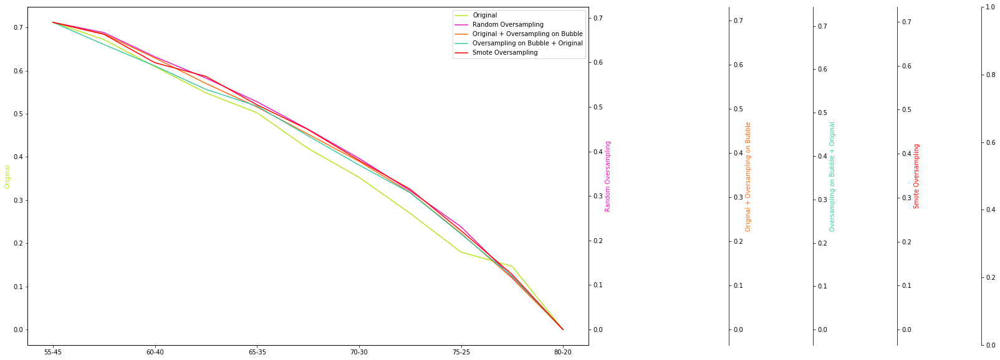

Total_Midi_AccuracyKNN


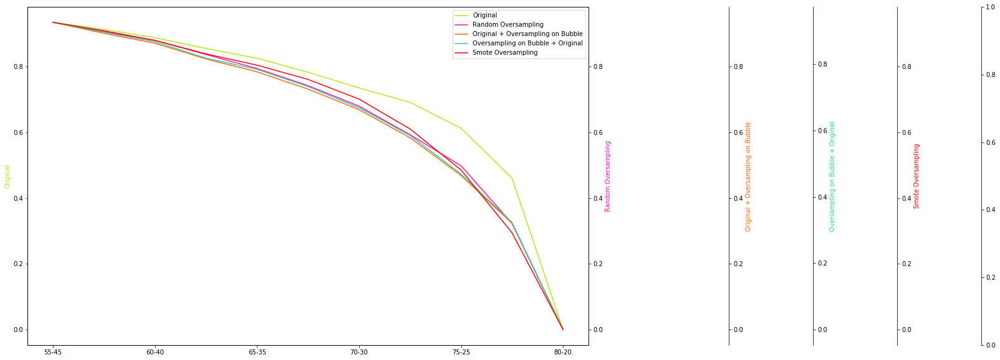

Total_Midi_AccuracySVC


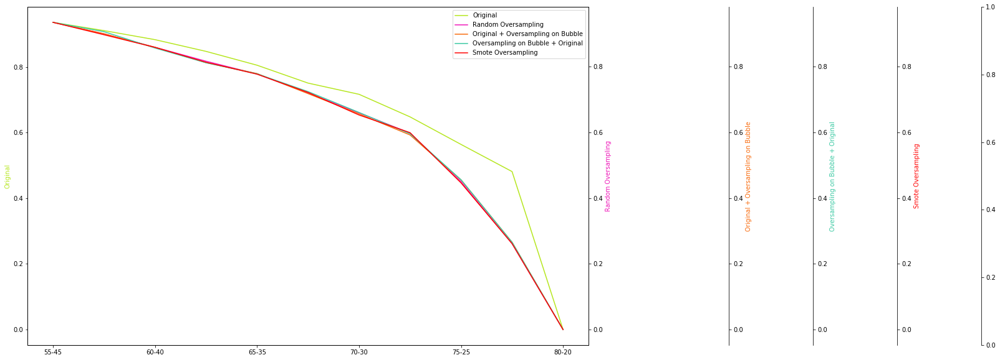

Total_Midi_AccuracyRF


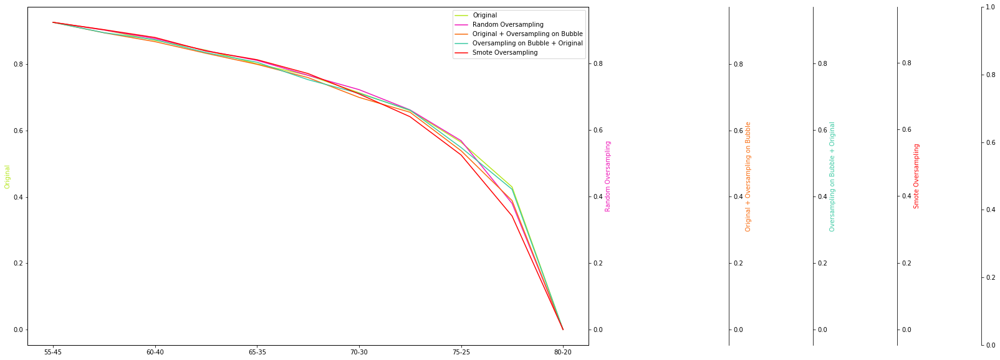

Total_Midi_AccuracyDT


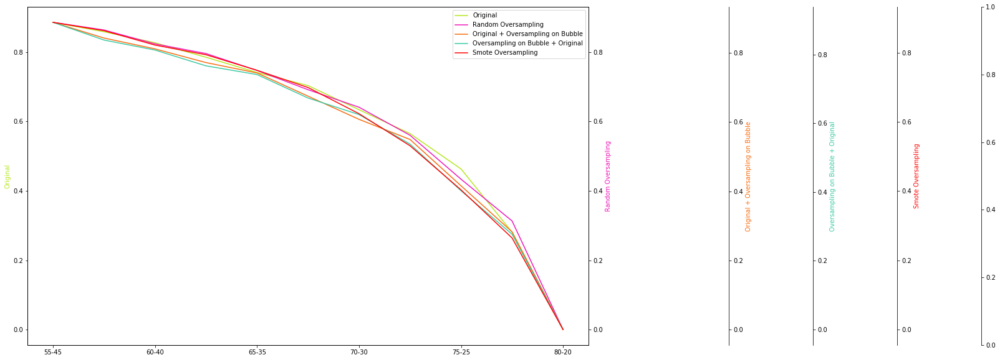

Total_Midi_Precision 0SGD


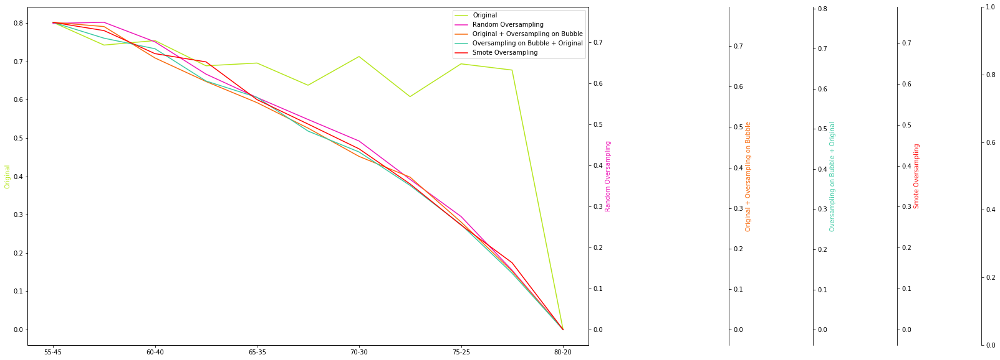

Total_Midi_Precision 0KNN


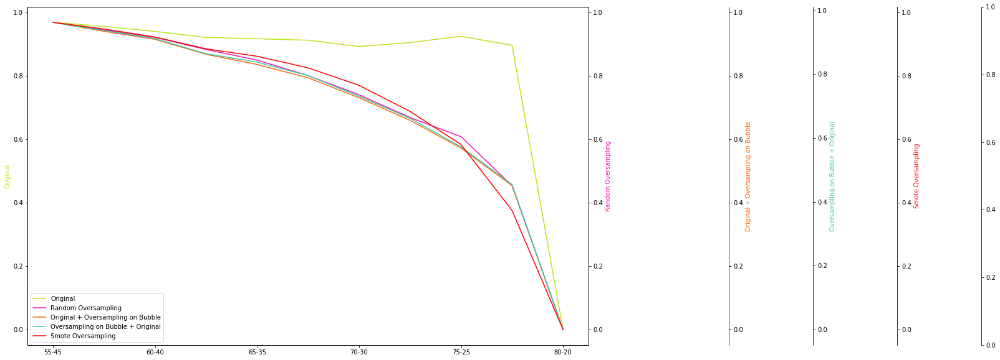

Total_Midi_Precision 0SVC


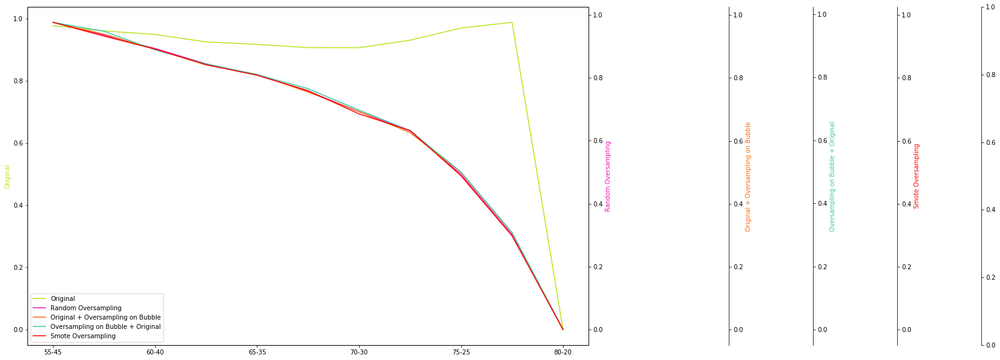

Total_Midi_Precision 0RF


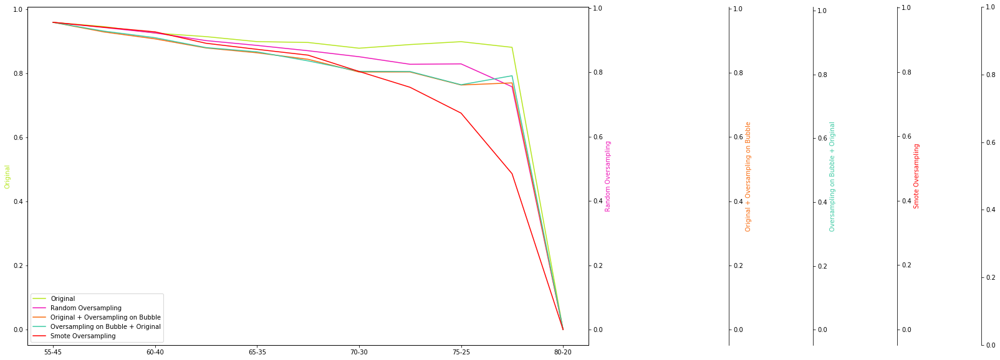

Total_Midi_Precision 0DT


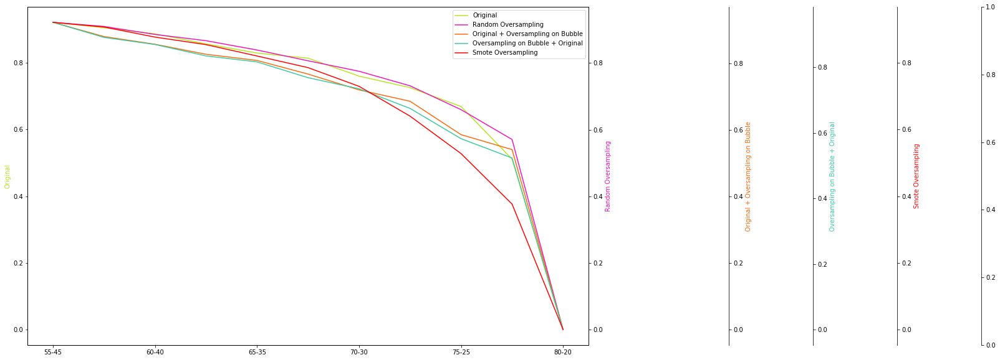

Total_Midi_Precision 1SGD


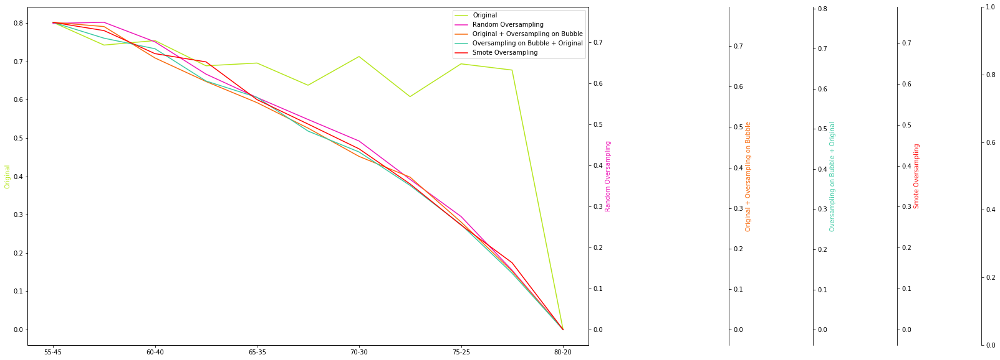

Total_Midi_Precision 1KNN


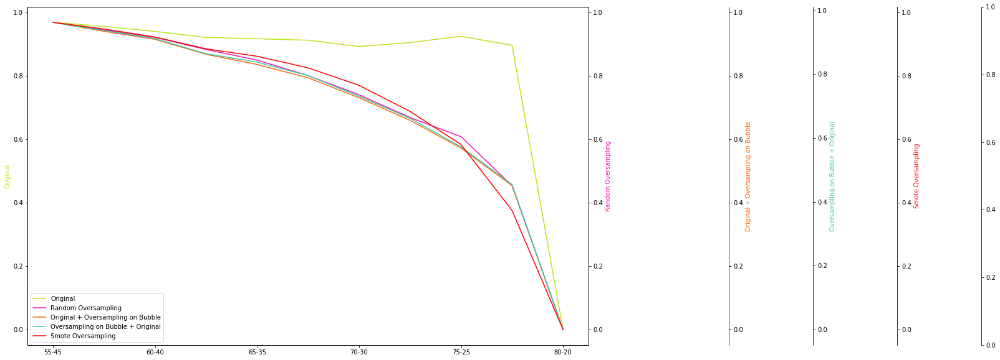

Total_Midi_Precision 1SVC


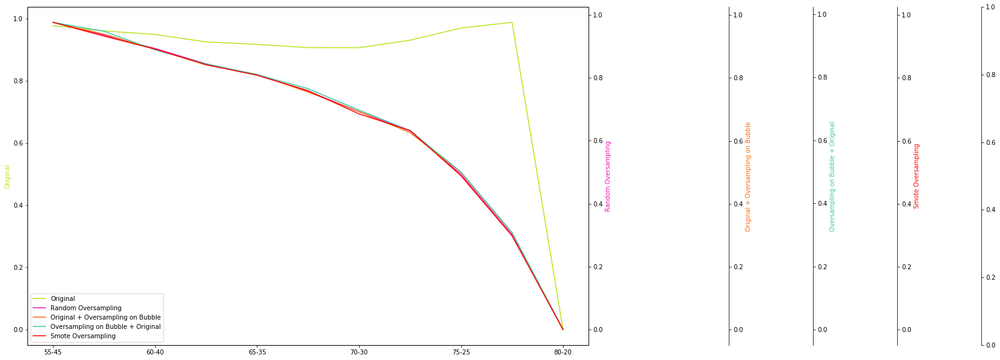

Total_Midi_Precision 1RF


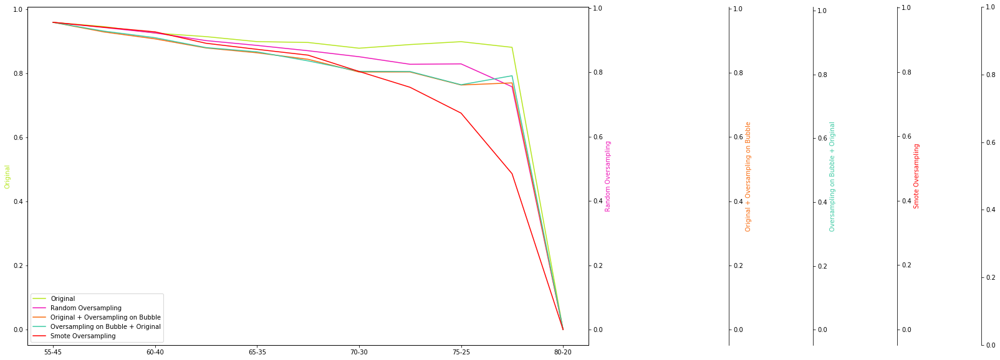

Total_Midi_Precision 1DT


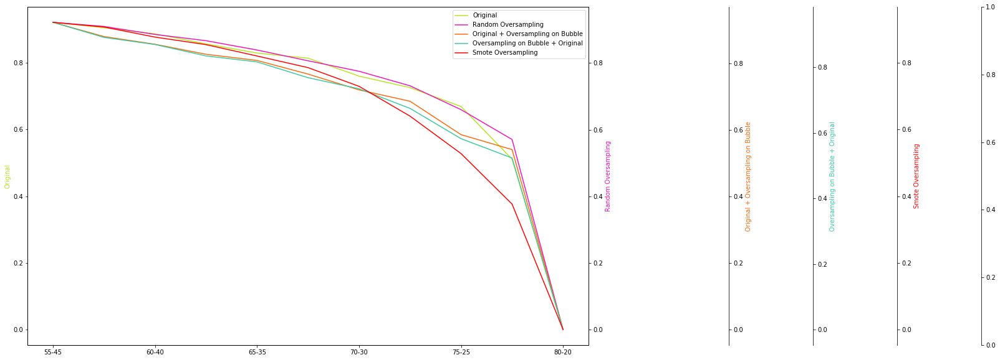

Total_Midi_Recall 0SGD


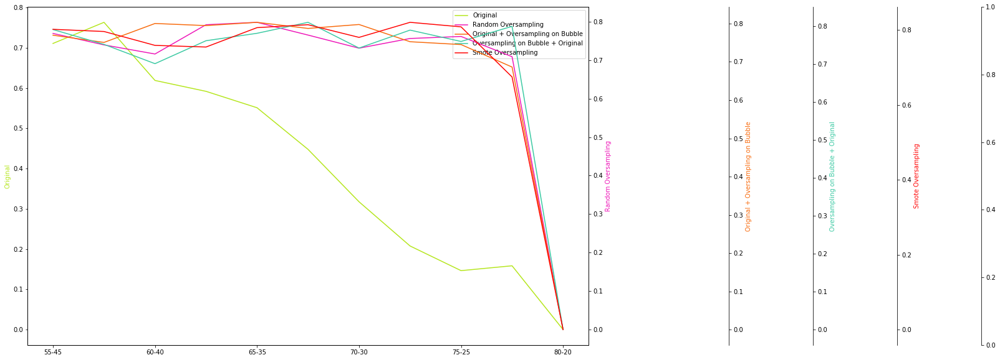

Total_Midi_Recall 0KNN


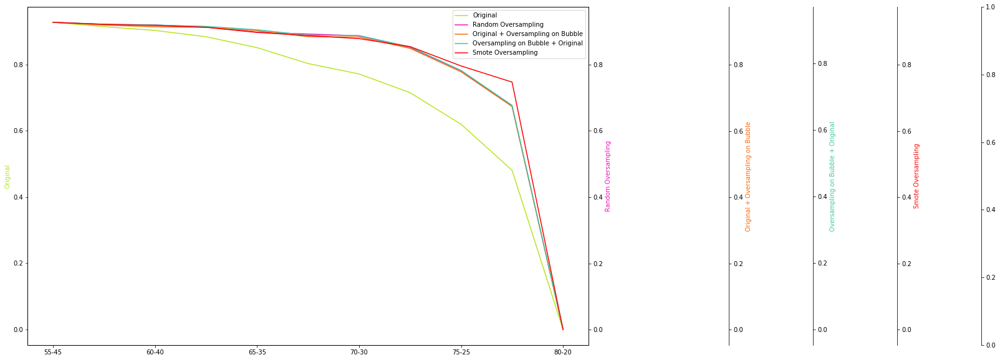

Total_Midi_Recall 0SVC


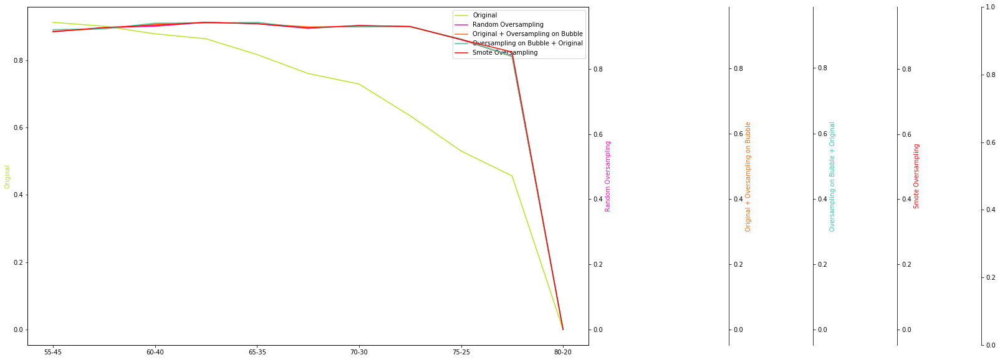

Total_Midi_Recall 0RF


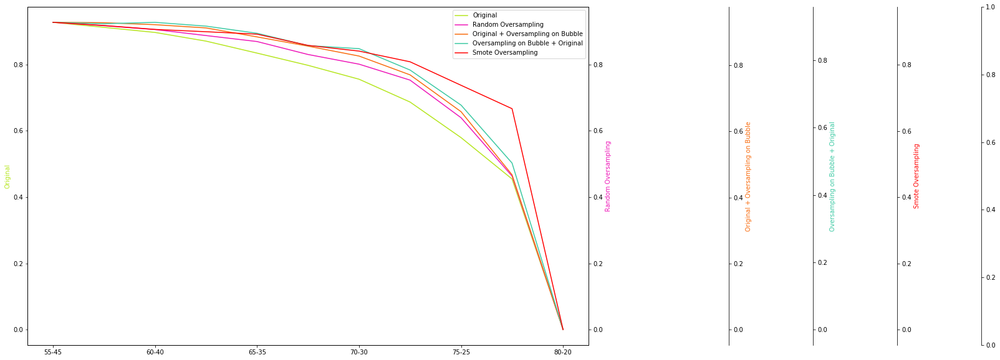

Total_Midi_Recall 0DT


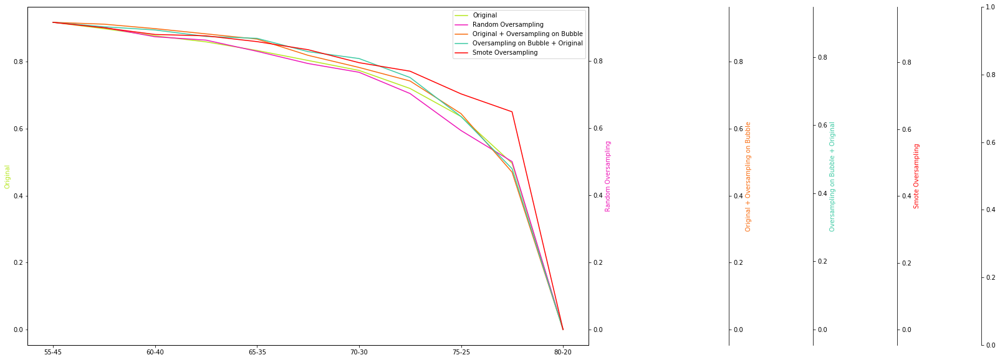

Total_Midi_Recall1SGD


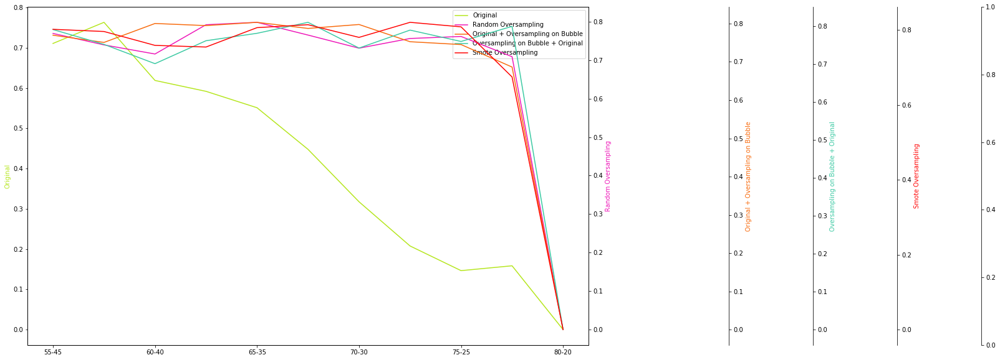

Total_Midi_Recall1KNN


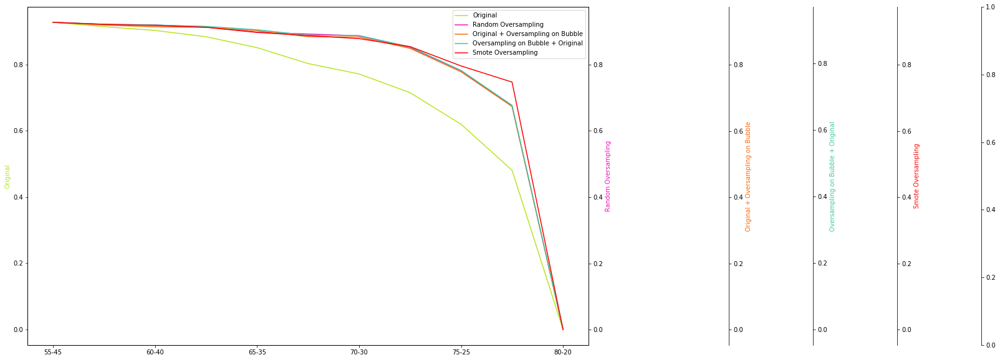

Total_Midi_Recall1SVC


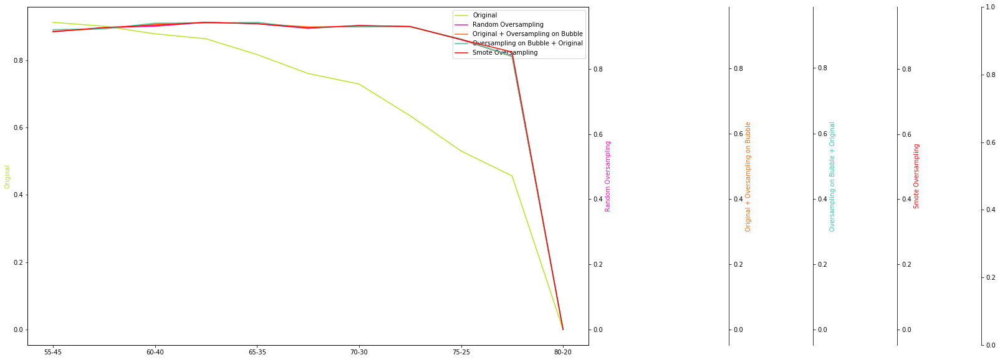

Total_Midi_Recall1RF


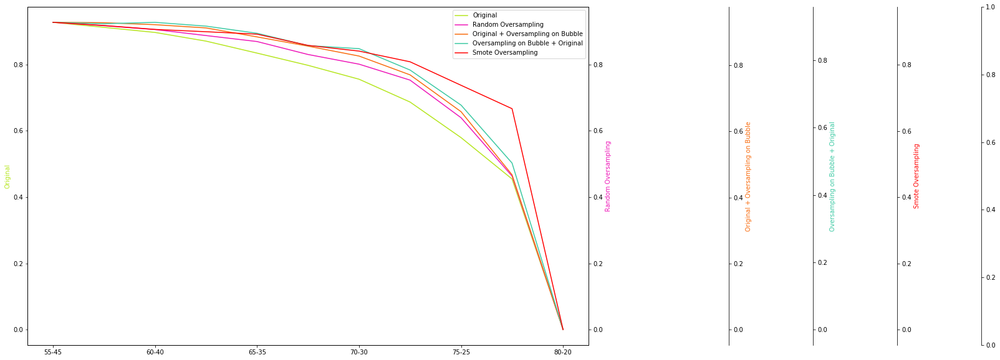

Total_Midi_Recall1DT


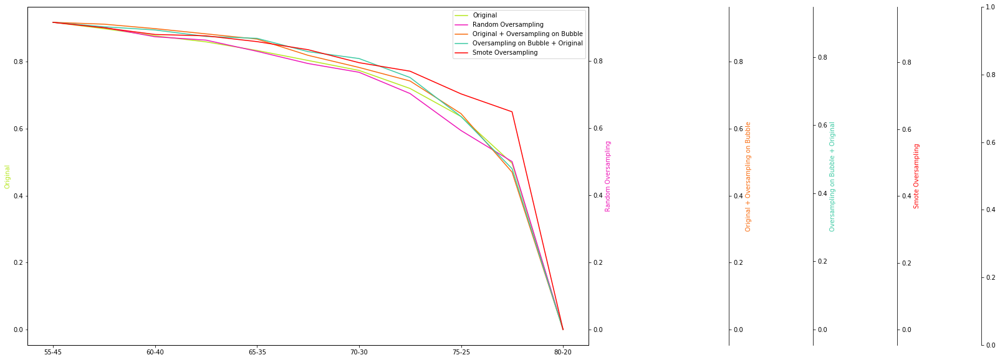

Total_Midi_Balanced_AccuracySGD


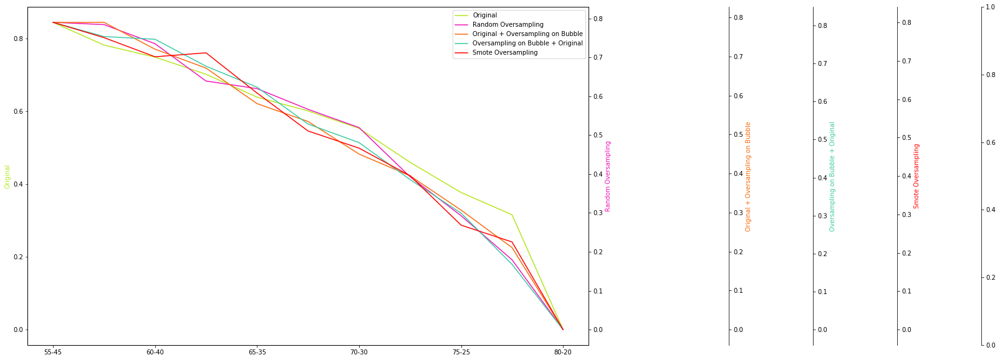

Total_Midi_Balanced_AccuracyKNN


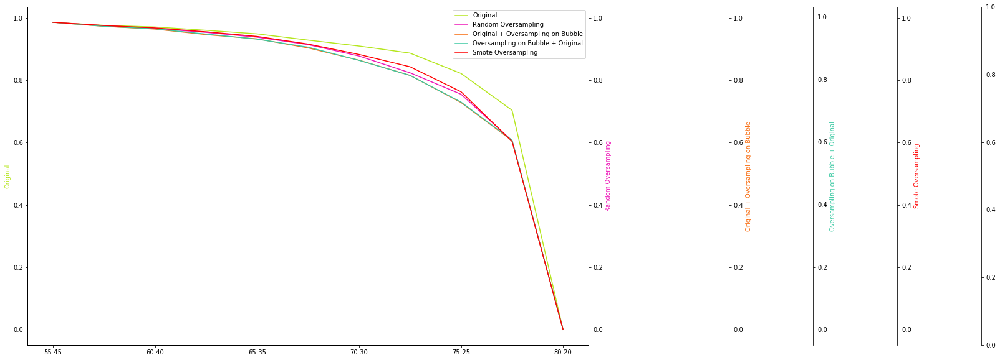

Total_Midi_Balanced_AccuracySVC


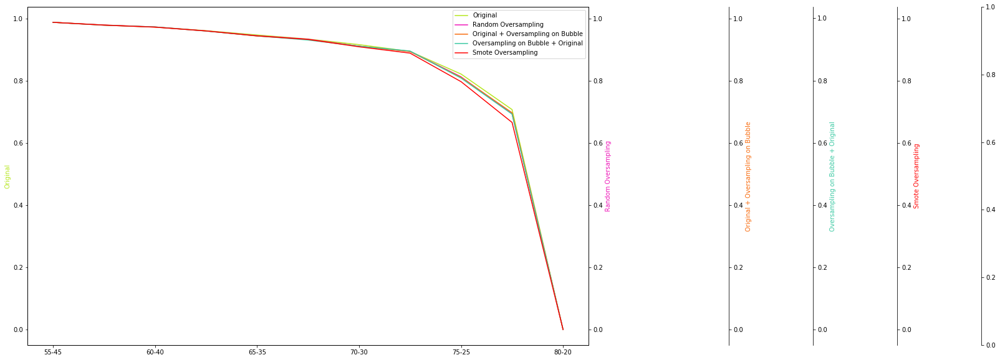

Total_Midi_Balanced_AccuracyRF


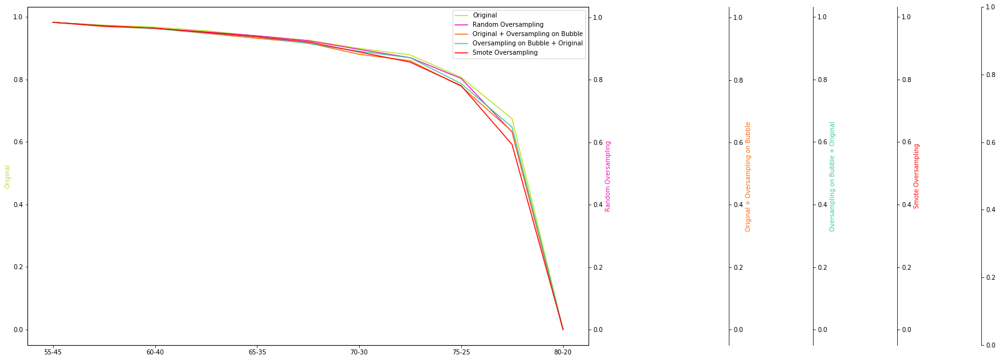

Total_Midi_Balanced_AccuracyDT


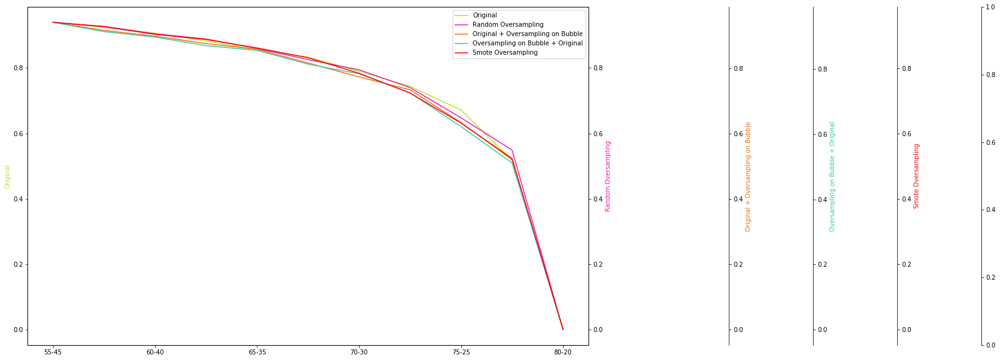

Total_Midi_F1 Score 0SGD


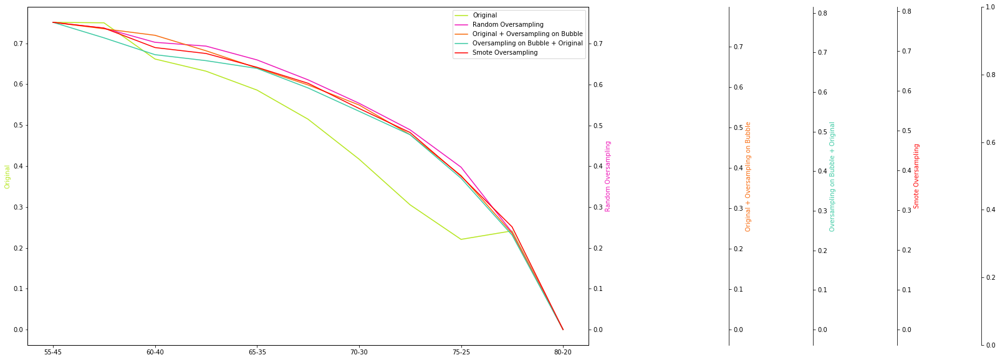

Total_Midi_F1 Score 0KNN


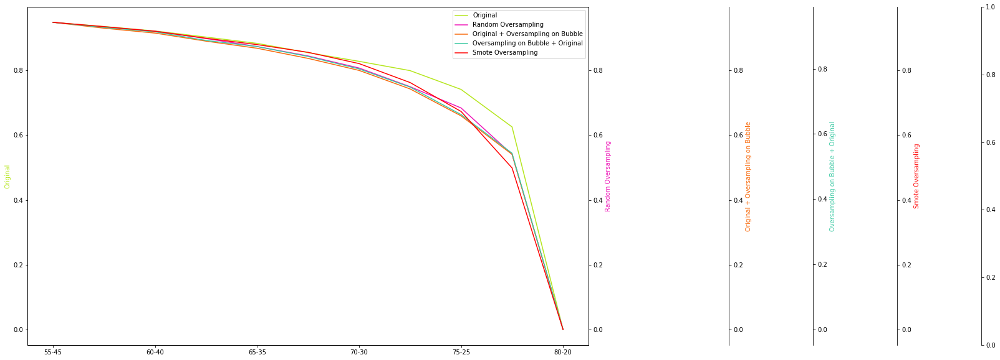

Total_Midi_F1 Score 0SVC


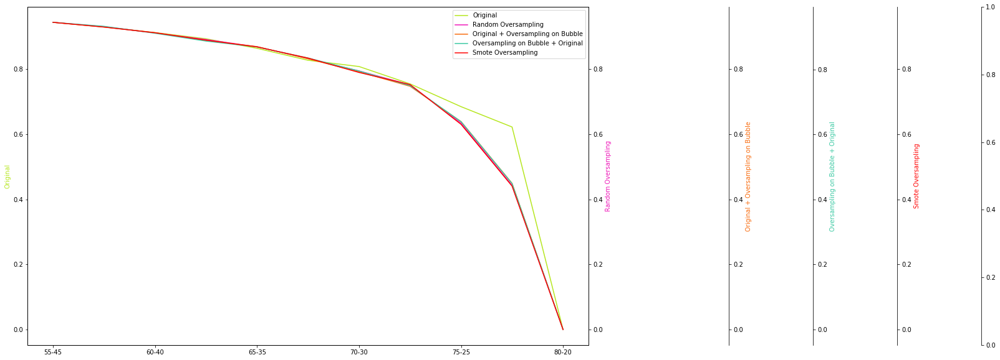

Total_Midi_F1 Score 0RF


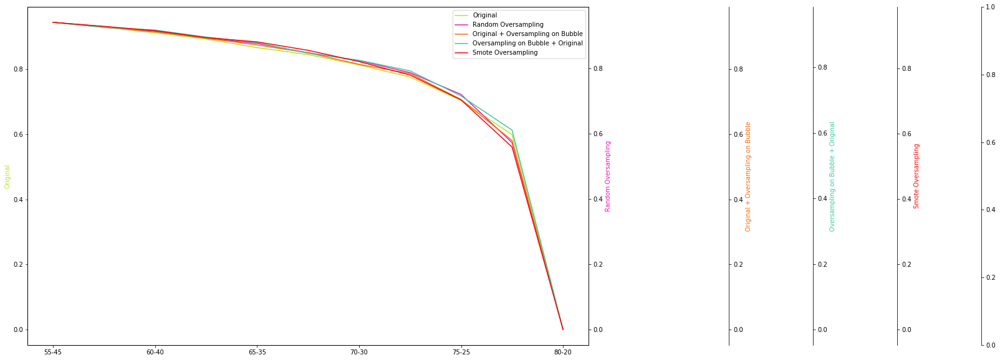

Total_Midi_F1 Score 0DT


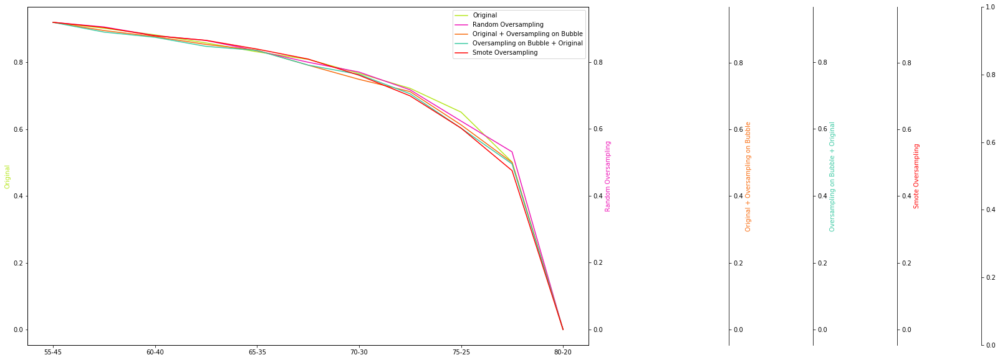

Total_Midi_F1 Score 1SGD


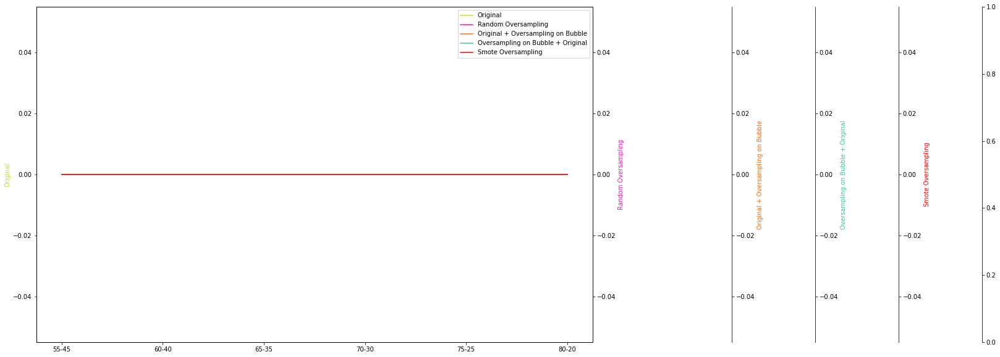

Total_Midi_F1 Score 1KNN


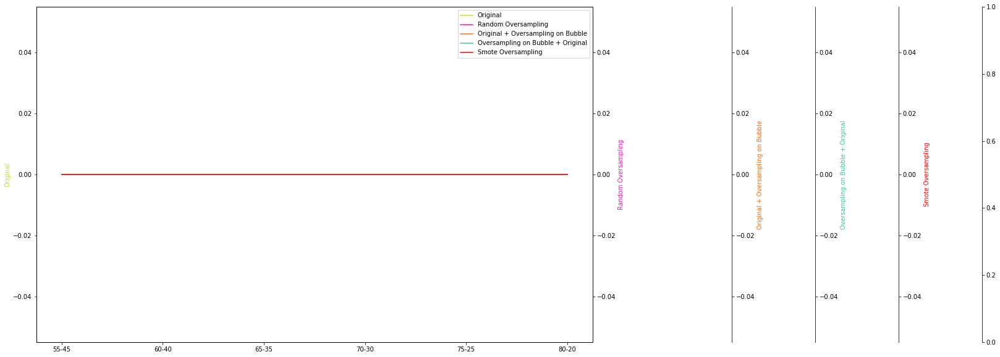

Total_Midi_F1 Score 1SVC


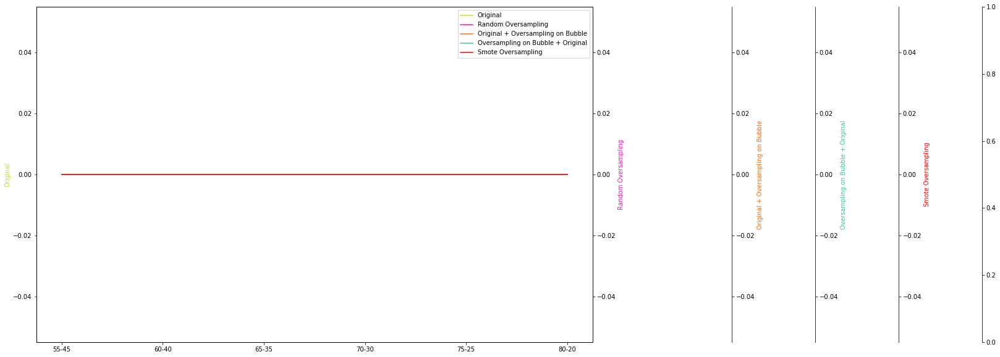

Total_Midi_F1 Score 1RF


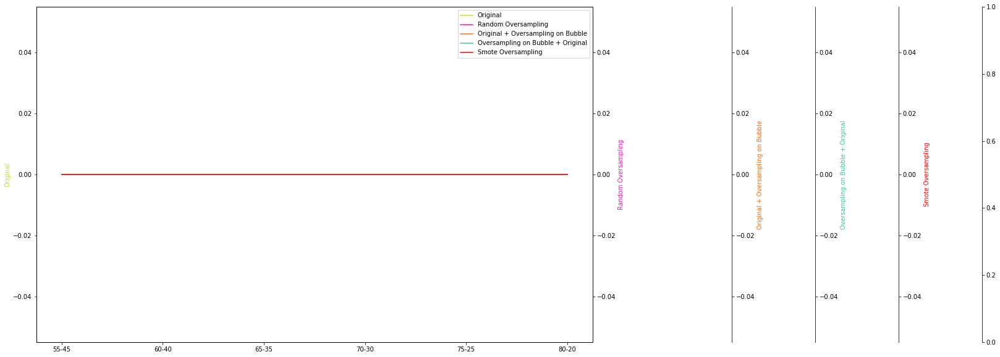

Total_Midi_F1 Score 1DT


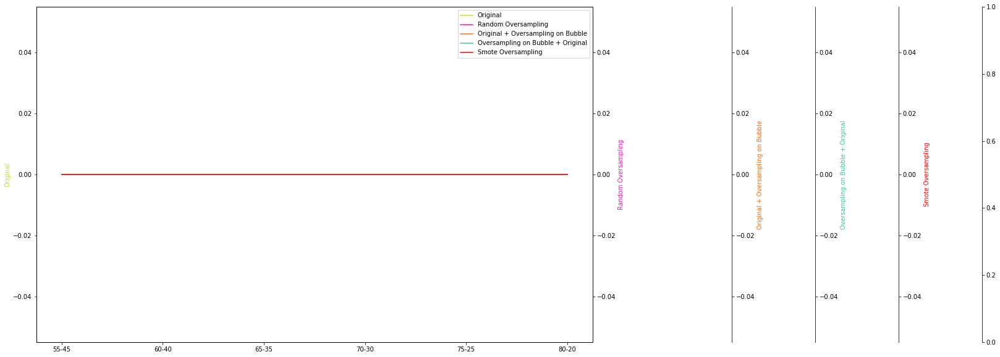

Total_Midi_AUCSGD


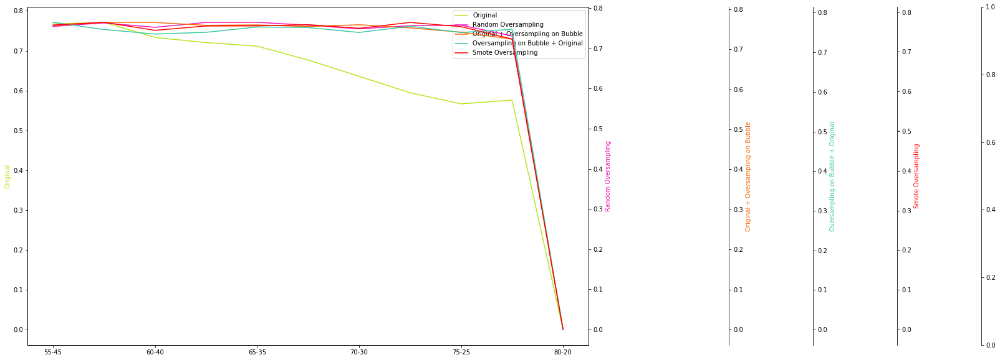

Total_Midi_AUCKNN


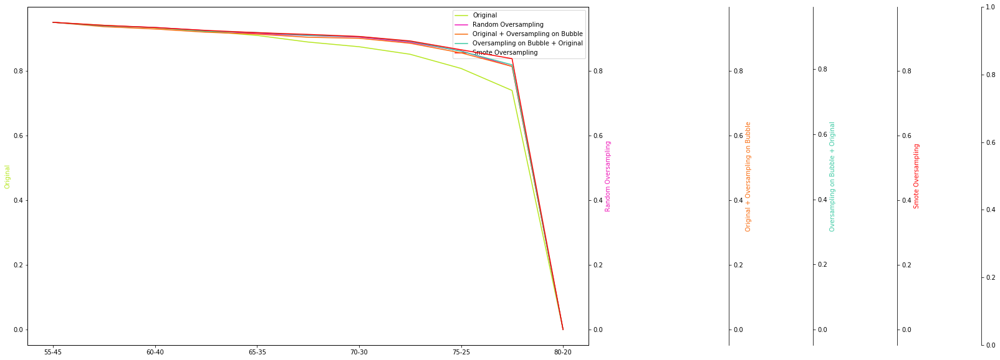

Total_Midi_AUCSVC


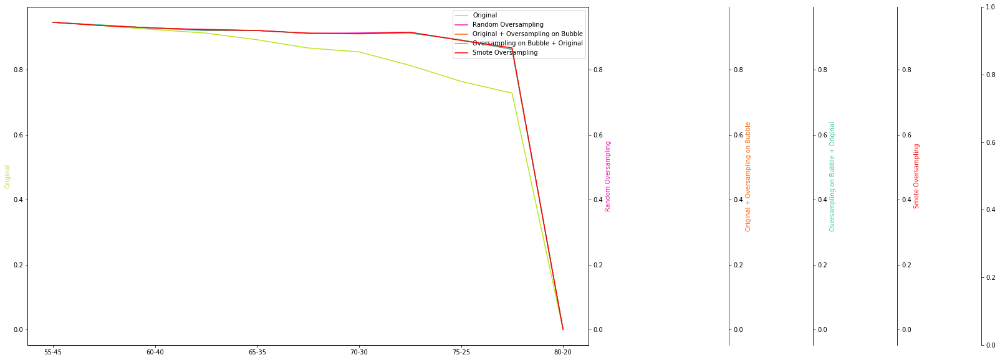

Total_Midi_AUCRF


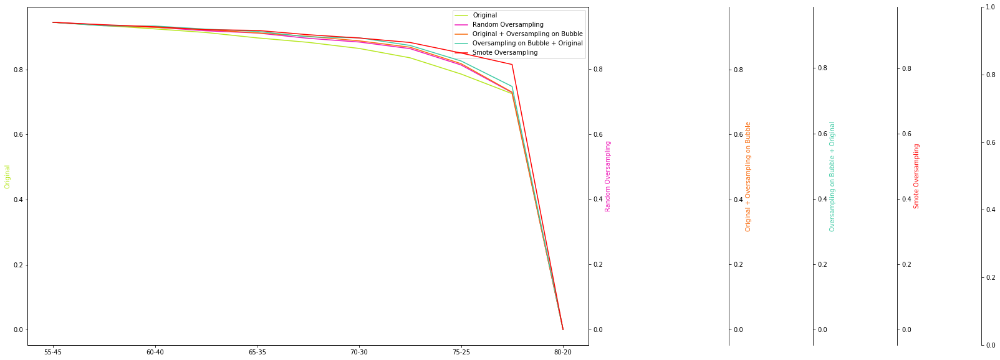

Total_Midi_AUCDT


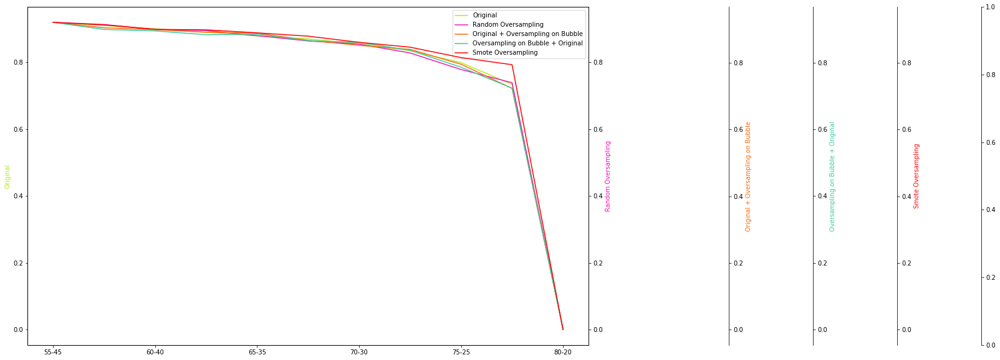

Total_Midi_AUC Probs 0SGD


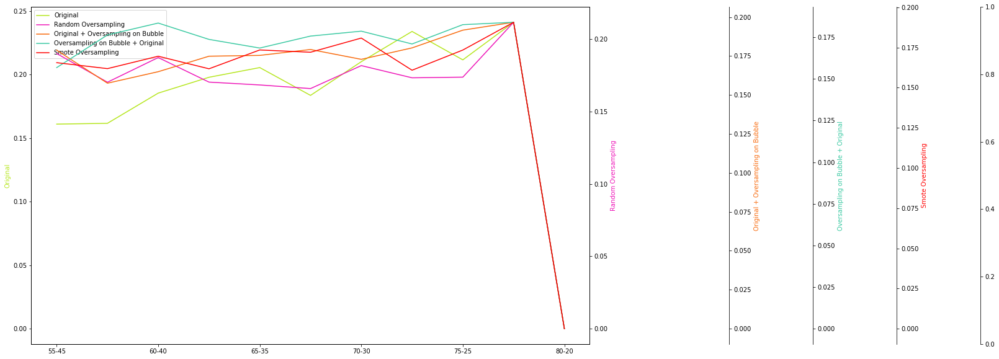

Total_Midi_AUC Probs 0KNN


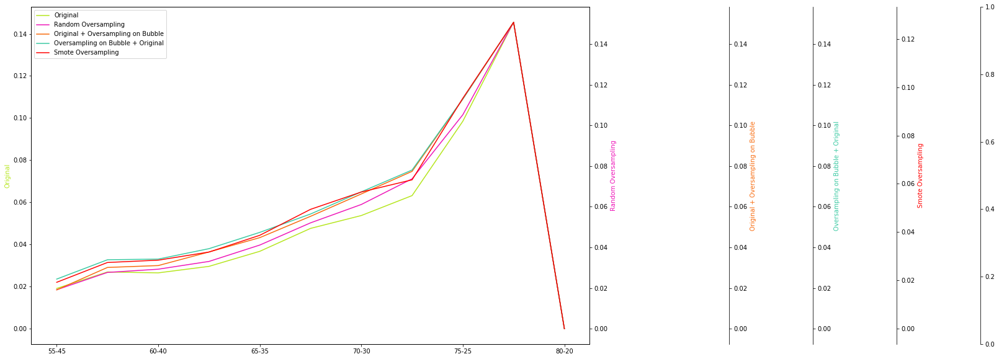

Total_Midi_AUC Probs 0SVC


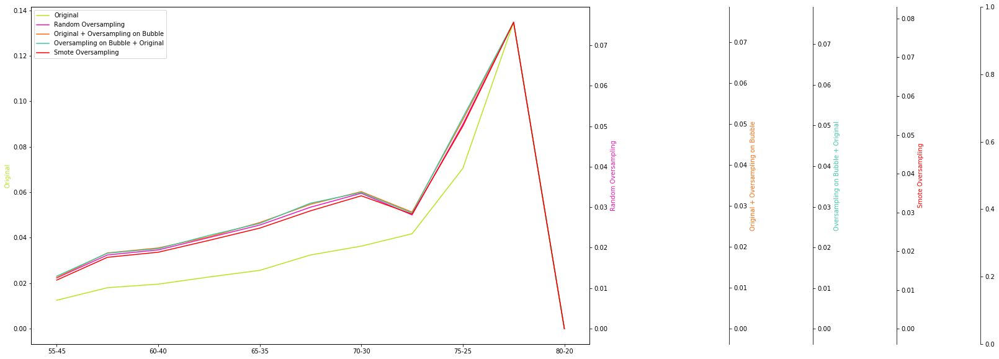

Total_Midi_AUC Probs 0RF


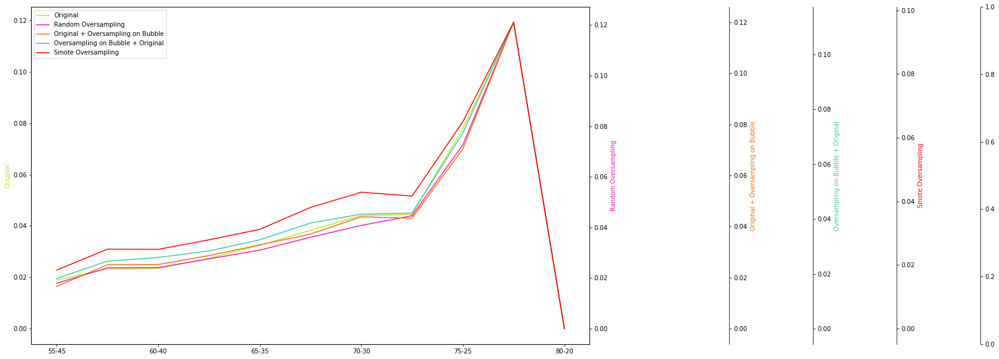

Total_Midi_AUC Probs 0DT


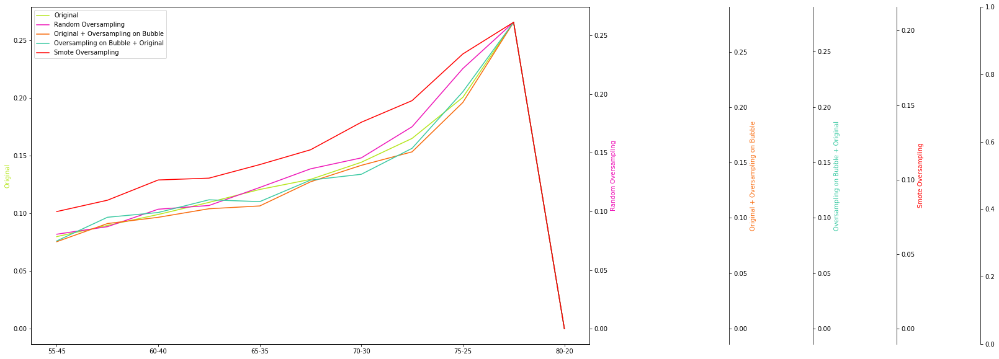

Total_Midi_AUC Probs 1SGD


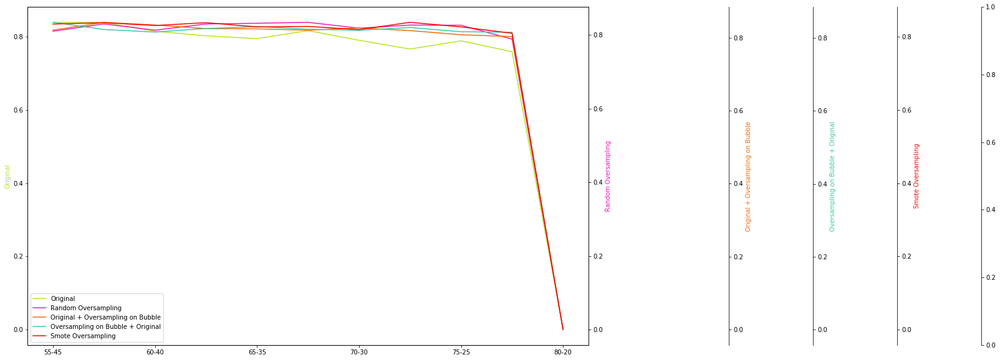

Total_Midi_AUC Probs 1KNN


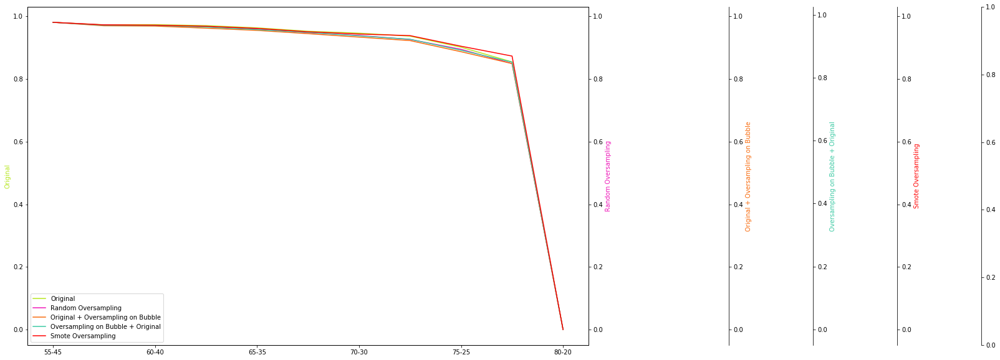

Total_Midi_AUC Probs 1SVC


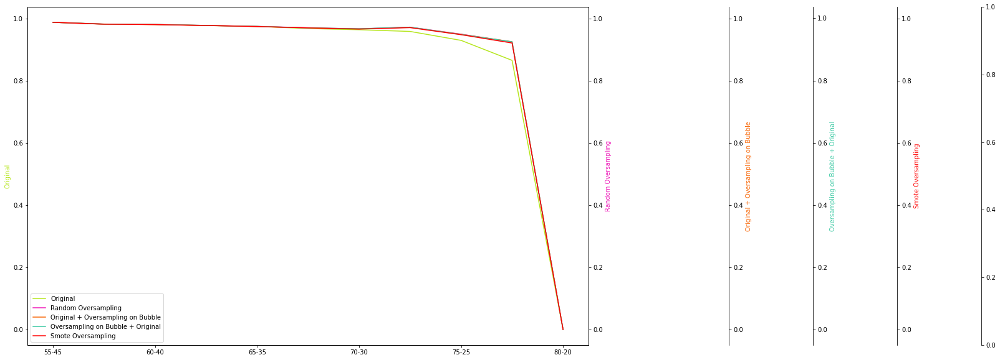

Total_Midi_AUC Probs 1RF


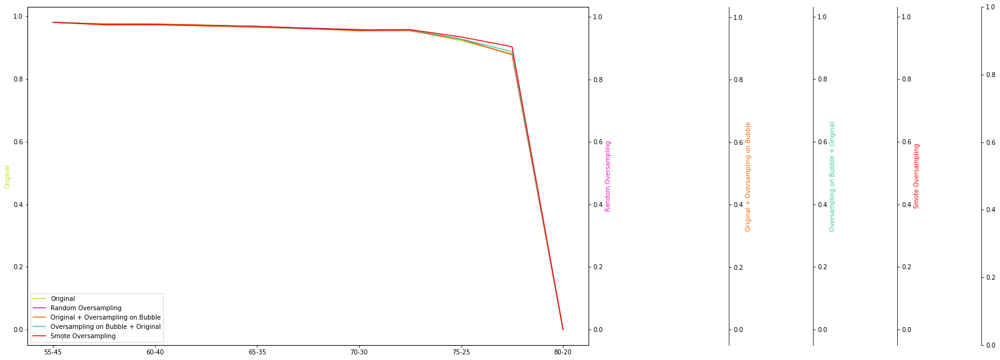

Total_Midi_AUC Probs 1DT


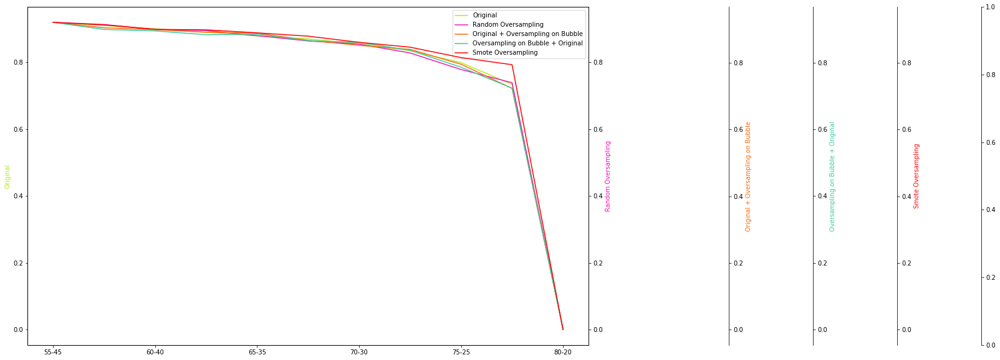

In [11]:
maBulle0 = BuildMyBulle([1,1,1,1,1,1,1], 5, 'normCats_realSnowBubblesTimes15_ray10bis_RealSmote', bulle, bubble_oversample);
maBulle0.instantiate_data();

maBulle0.cross_validate();
maBulle0.visualize_scores()
    

## Mini

youp
setting
props {}
FEATURE VECTOR
Time taken for creating the feature vectors:  0:00:00
ORDER THE DATA
setting
props {}
Time taken for ordering the data:  0:00:00
SPLIT
Time taken for split:  0:00:00
RANDOM OVERSAMPLING
Random Oversample
Time taken for random oversampling:  0:00:00
BUBBLE OVERSAMPLE
Bubble Oversample
aan het bullen 0 0:00:00
aan het bullen 1 0:00:00
aan het bullen 2 0:00:00
aan het bullen 3 0:00:00
aan het bullen 4 0:00:00
aan het bullen 5 0:00:00
aan het bullen 6 0:00:00
Time taken for random bubble oversampling:  0:00:01
SMOTE OVERSAMPLE
Smote Oversample
Time taken for random SMOTE:  0:00:00
setting
props {}
FEATURE VECTOR
Time taken for creating the feature vectors:  0:00:00
ORDER THE DATA
setting
props {}
Time taken for ordering the data:  0:00:00
SPLIT
Time taken for split:  0:00:00
RANDOM OVERSAMPLING
Random Oversample
Time taken for random oversampling:  0:00:00
BUBBLE OVERSAMPLE
Bubble Oversample
aan het bullen 0 0:00:00
aan het bullen 1 0:00:01
aan het bull

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


           Average Precision:  0.751064523643 , Precicion 0:  0.795597484277 , Precision 1 0.795597484277 , Recall 1:  0.851851851852 , Recall 0:  0.851851851852 , PR AUC:  0.864445071637 , F1 Score 0:  0.822764227642 , F1 Score1:  0.822764227642 , AUC:  0.818665199853 , AUC Probs 0:  0.11482259337 , AUC Probs 1:  0.88517740663
         5
           Average Precision:  0.751491019587 , Precicion 0:  0.792569659443 , Precision 1 0.792569659443 , Recall 1:  0.861952861953 , Recall 0:  0.861952861953 , PR AUC:  0.897957461155 , F1 Score 0:  0.825806451613 , F1 Score1:  0.825806451613 , AUC:  0.820415374871 , AUC Probs 0:  0.0965096509651 , AUC Probs 1:  0.903490349035
         6
           Average Precision:  0.742282502444 , Precicion 0:  0.793548387097 , Precision 1 0.793548387097 , Recall 1:  0.828282828283 , Recall 0:  0.828282828283 , PR AUC:  0.889065449186 , F1 Score 0:  0.810543657331 , F1 Score1:  0.810543657331 , AUC:  0.808530853085 , AUC Probs 0:  0.105855029947 , AUC Probs 1:

           Average Precision:  0.808752319676 , Precicion 0:  0.854785478548 , Precision 1 0.854785478548 , Recall 1:  0.872053872054 , Recall 0:  0.872053872054 , PR AUC:  0.918894681192 , F1 Score 0:  0.863333333333 , F1 Score1:  0.863333333333 , AUC:  0.863419675301 , AUC Probs 0:  0.0826027047149 , AUC Probs 1:  0.917397295285
         4
           Average Precision:  0.833224048394 , Precicion 0:  0.881355932203 , Precision 1 0.881355932203 , Recall 1:  0.875420875421 , Recall 0:  0.875420875421 , PR AUC:  0.942315684019 , F1 Score 0:  0.878378378378 , F1 Score1:  0.878378378378 , AUC:  0.879954662133 , AUC Probs 0:  0.0596226289296 , AUC Probs 1:  0.94037737107
         5
           Average Precision:  0.831862512087 , Precicion 0:  0.885813148789 , Precision 1 0.885813148789 , Recall 1:  0.861952861953 , Recall 0:  0.861952861953 , PR AUC:  0.931825057174 , F1 Score 0:  0.873720136519 , F1 Score1:  0.873720136519 , AUC:  0.876520985432 , AUC Probs 0:  0.0688624417997 , AUC Probs

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


 Average Precision:  0.789271544272 , Precicion 0:  0.844594594595 , Precision 1 0.844594594595 , Recall 1:  0.841750841751 , Recall 0:  0.841750841751 , PR AUC:  0.901962996285 , F1 Score 0:  0.843170320405 , F1 Score1:  0.843170320405 , AUC:  0.844967830116 , AUC Probs 0:  0.0991599159916 , AUC Probs 1:  0.900840084008
         1
           Average Precision:  0.8299188127 , Precicion 0:  0.880546075085 , Precision 1 0.880546075085 , Recall 1:  0.868686868687 , Recall 0:  0.868686868687 , PR AUC:  0.925758824388 , F1 Score 0:  0.874576271186 , F1 Score1:  0.874576271186 , AUC:  0.876587658766 , AUC Probs 0:  0.0762965185407 , AUC Probs 1:  0.923703481459
         2
           Average Precision:  0.807378312744 , Precicion 0:  0.867595818815 , Precision 1 0.867595818815 , Recall 1:  0.838383838384 , Recall 0:  0.838383838384 , PR AUC:  0.92461026265 , F1 Score 0:  0.852739726027 , F1 Score1:  0.852739726027 , AUC:  0.856485648565 , AUC Probs 0:  0.0861419475281 , AUC Probs 1:  0.91385

           Average Precision:  0.851977179199 , Precicion 0:  0.902777777778 , Precision 1 0.902777777778 , Recall 1:  0.875420875421 , Recall 0:  0.875420875421 , PR AUC:  0.950918292165 , F1 Score 0:  0.888888888889 , F1 Score1:  0.888888888889 , AUC:  0.891505817248 , AUC Probs 0:  0.0482937182607 , AUC Probs 1:  0.951706281739
         2
           Average Precision:  0.886342519269 , Precicion 0:  0.93031358885 , Precision 1 0.93031358885 , Recall 1:  0.89898989899 , Recall 0:  0.89898989899 , PR AUC:  0.965055849952 , F1 Score 0:  0.914383561644 , F1 Score1:  0.914383561644 , AUC:  0.916491649165 , AUC Probs 0:  0.0352257447967 , AUC Probs 1:  0.964774255203
         3
           Average Precision:  0.826038599503 , Precicion 0:  0.866013071895 , Precision 1 0.866013071895 , Recall 1:  0.892255892256 , Recall 0:  0.892255892256 , PR AUC:  0.945761538881 , F1 Score 0:  0.878938640133 , F1 Score1:  0.878938640133 , AUC:  0.878471180451 , AUC Probs 0:  0.0537720438711 , AUC Probs 1:

           Average Precision:  0.865868767862 , Precicion 0:  0.910652920962 , Precision 1 0.910652920962 , Recall 1:  0.892255892256 , Recall 0:  0.892255892256 , PR AUC:  0.956643896664 , F1 Score 0:  0.901360544218 , F1 Score1:  0.901360544218 , AUC:  0.903223655699 , AUC Probs 0:  0.0421153226434 , AUC Probs 1:  0.957884677357
         5
           Average Precision:  0.85257587328 , Precicion 0:  0.900343642612 , Precision 1 0.900343642612 , Recall 1:  0.882154882155 , Recall 0:  0.882154882155 , PR AUC:  0.950829015585 , F1 Score 0:  0.891156462585 , F1 Score1:  0.891156462585 , AUC:  0.893222655599 , AUC Probs 0:  0.0472158326944 , AUC Probs 1:  0.952784167306
         6
           Average Precision:  0.810363287677 , Precicion 0:  0.851132686084 , Precision 1 0.851132686084 , Recall 1:  0.885521885522 , Recall 0:  0.885521885522 , PR AUC:  0.935084999277 , F1 Score 0:  0.86798679868 , F1 Score1:  0.86798679868 , AUC:  0.866853352002 , AUC Probs 0:  0.0600837861564 , AUC Probs 1

           Average Precision:  0.79105495783 , Precicion 0:  0.837133550489 , Precision 1 0.837133550489 , Recall 1:  0.86531986532 , Recall 0:  0.86531986532 , PR AUC:  0.90439103182 , F1 Score 0:  0.850993377483 , F1 Score1:  0.850993377483 , AUC:  0.850151681835 , AUC Probs 0:  0.0925759242591 , AUC Probs 1:  0.907424075741
     Time taken TO TRAIN THE ORIGINAL TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE TRAINING SET
         0
           Average Precision:  0.783547378547 , Precicion 0:  0.853571428571 , Precision 1 0.853571428571 , Recall 1:  0.804713804714 , Recall 0:  0.804713804714 , PR AUC:  0.900079621175 , F1 Score 0:  0.82842287695 , F1 Score1:  0.82842287695 , AUC:  0.83470013668 , AUC Probs 0:  0.0934926826016 , AUC Probs 1:  0.906507317398
         1
           Average Precision:  0.805737208919 , Precicion 0:  0.867132867133 , Precision 1 0.867132867133 , Recall 1:  0.835016835017 , Recall 0:  0.835016835017 , PR AUC:  0.907811464675 , F1 Score 0:  0.85077186964 , F1 Sc

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: 

 Average Precision:  0.81200810755 , Precicion 0:  0.880866425993 , Precision 1 0.880866425993 , Recall 1:  0.821548821549 , Recall 0:  0.821548821549 , PR AUC:  0.916800093442 , F1 Score 0:  0.850174216028 , F1 Score1:  0.850174216028 , AUC:  0.85631896523 , AUC Probs 0:  0.0793301552377 , AUC Probs 1:  0.920669844762
         4
           Average Precision:  0.826573771286 , Precicion 0:  0.892086330935 , Precision 1 0.892086330935 , Recall 1:  0.835016835017 , Recall 0:  0.835016835017 , PR AUC:  0.937278634291 , F1 Score 0:  0.862608695652 , F1 Score1:  0.862608695652 , AUC:  0.868003467013 , AUC Probs 0:  0.0644675578669 , AUC Probs 1:  0.935532442133
         5
           Average Precision:  0.838036259101 , Precicion 0:  0.902527075812 , Precision 1 0.902527075812 , Recall 1:  0.841750841751 , Recall 0:  0.841750841751 , PR AUC:  0.932213999964 , F1 Score 0:  0.871080139373 , F1 Score1:  0.871080139373 , AUC:  0.87632096543 , AUC Probs 0:  0.0640564056406 , AUC Probs 1:  0.93594

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.827280271596 , Precicion 0:  0.933609958506 , Precision 1 0.933609958506 , Recall 1:  0.757575757576 , Recall 0:  0.757575757576 , PR AUC:  0.923241867463 , F1 Score 0:  0.836431226766 , F1 Score1:  0.836431226766 , AUC:  0.852385238524 , AUC Probs 0:  0.0718405173851 , AUC Probs 1:  0.928159482615
         3
           Average Precision:  0.789235125144 , Precicion 0:  0.853146853147 , Precision 1 0.853146853147 , Recall 1:  0.821548821549 , Recall 0:  0.821548821549 , PR AUC:  0.910389343245 , F1 Score 0:  0.83704974271 , F1 Score1:  0.83704974271 , AUC:  0.841467480081 , AUC Probs 0:  0.0876143169873 , AUC Probs 1:  0.912385683013
         4
           Average Precision:  0.826985855881 , Precicion 0:  0.923694779116 , Precision 1 0.923694779116 , Recall 1:  0.774410774411 , Recall 0:  0.774410774411 , PR AUC:  0.935574784808 , F1 Score 0:  0.842490842491 , F1 Score1:  0.842490842491 , AUC:  0.855852251892 , AUC Probs 0:  0.0673900723406 , AUC Probs 

           Average Precision:  0.742442855397 , Precicion 0:  0.798679867987 , Precision 1 0.798679867987 , Recall 1:  0.814814814815 , Recall 0:  0.814814814815 , PR AUC:  0.852580674734 , F1 Score 0:  0.806666666667 , F1 Score1:  0.806666666667 , AUC:  0.806747341401 , AUC Probs 0:  0.193252658599 , AUC Probs 1:  0.806747341401
         1
           Average Precision:  0.748473705884 , Precicion 0:  0.823741007194 , Precision 1 0.823741007194 , Recall 1:  0.771043771044 , Recall 0:  0.771043771044 , PR AUC:  0.854059055786 , F1 Score 0:  0.79652173913 , F1 Score1:  0.79652173913 , AUC:  0.804663799713 , AUC Probs 0:  0.195336200287 , AUC Probs 1:  0.804663799713
         2
           Average Precision:  0.782748058199 , Precicion 0:  0.85559566787 , Precision 1 0.85559566787 , Recall 1:  0.79797979798 , Recall 0:  0.79797979798 , PR AUC:  0.876787732925 , F1 Score 0:  0.825783972125 , F1 Score1:  0.825783972125 , AUC:  0.83298329833 , AUC Probs 0:  0.16701670167 , AUC Probs 1:  0.832

           Average Precision:  0.728788869083 , Precicion 0:  0.78431372549 , Precision 1 0.78431372549 , Recall 1:  0.808080808081 , Recall 0:  0.808080808081 , PR AUC:  0.843697266786 , F1 Score 0:  0.796019900498 , F1 Score1:  0.796019900498 , AUC:  0.795129512951 , AUC Probs 0:  0.204870487049 , AUC Probs 1:  0.795129512951
         4
           Average Precision:  0.759176006642 , Precicion 0:  0.821917808219 , Precision 1 0.821917808219 , Recall 1:  0.808080808081 , Recall 0:  0.808080808081 , PR AUC:  0.86249930815 , F1 Score 0:  0.81494057725 , F1 Score1:  0.81494057725 , AUC:  0.818231823182 , AUC Probs 0:  0.181768176818 , AUC Probs 1:  0.818231823182
         5
           Average Precision:  0.787607655502 , Precicion 0:  0.852631578947 , Precision 1 0.852631578947 , Recall 1:  0.818181818182 , Recall 0:  0.818181818182 , PR AUC:  0.880406698565 , F1 Score 0:  0.835051546392 , F1 Score1:  0.835051546392 , AUC:  0.839783978398 , AUC Probs 0:  0.160216021602 , AUC Probs 1:  0.

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


 Average Precision:  0.61400462963 , Precicion 0:  0.677083333333 , Precision 1 0.677083333333 , Recall 1:  0.722222222222 , Recall 0:  0.722222222222 , PR AUC:  0.69059402545 , F1 Score 0:  0.698924731183 , F1 Score1:  0.698924731183 , AUC:  0.720202020202 , AUC Probs 0:  0.219225589226 , AUC Probs 1:  0.780774410774
         6
           Average Precision:  0.672564102564 , Precicion 0:  0.807692307692 , Precision 1 0.807692307692 , Recall 1:  0.622222222222 , Recall 0:  0.622222222222 , PR AUC:  0.828939983343 , F1 Score 0:  0.702928870293 , F1 Score1:  0.702928870293 , AUC:  0.750505050505 , AUC Probs 0:  0.121582491582 , AUC Probs 1:  0.878417508418
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE AND ORIGINAL TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE SMOTE TRAINING SET
         0
           Average Precision:  0.64103346973 , Precicion 0:  0.668555240793 , Precision 1 0.668555240793 , Recall 1:  0.874074074074 , Recall 0:  0.874074074074 , PR AUC:  0.758565

           Average Precision:  0.771578947368 , Precicion 0:  0.821052631579 , Precision 1 0.821052631579 , Recall 1:  0.866666666667 , Recall 0:  0.866666666667 , PR AUC:  0.899123935216 , F1 Score 0:  0.843243243243 , F1 Score1:  0.843243243243 , AUC:  0.856060606061 , AUC Probs 0:  0.0863187429854 , AUC Probs 1:  0.913681257015
         4
           Average Precision:  0.74037037037 , Precicion 0:  0.8 , Precision 1 0.8 , Recall 1:  0.82962962963 , Recall 0:  0.82962962963 , PR AUC:  0.875350057981 , F1 Score 0:  0.814545454545 , F1 Score1:  0.814545454545 , AUC:  0.829966329966 , AUC Probs 0:  0.111812570146 , AUC Probs 1:  0.888187429854
         5
           Average Precision:  0.772676399027 , Precicion 0:  0.832116788321 , Precision 1 0.832116788321 , Recall 1:  0.844444444444 , Recall 0:  0.844444444444 , PR AUC:  0.91434267444 , F1 Score 0:  0.838235294118 , F1 Score1:  0.838235294118 , AUC:  0.852525252525 , AUC Probs 0:  0.0825645342312 , AUC Probs 1:  0.917435465769
      

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.730027213594 , Precicion 0:  0.792114695341 , Precision 1 0.792114695341 , Recall 1:  0.818518518519 , Recall 0:  0.818518518519 , PR AUC:  0.875025024268 , F1 Score 0:  0.805100182149 , F1 Score1:  0.805100182149 , AUC:  0.82138047138 , AUC Probs 0:  0.11854657688 , AUC Probs 1:  0.88145342312
         5
           Average Precision:  0.756258858136 , Precicion 0:  0.815884476534 , Precision 1 0.815884476534 , Recall 1:  0.837037037037 , Recall 0:  0.837037037037 , PR AUC:  0.908610327557 , F1 Score 0:  0.826325411335 , F1 Score1:  0.826325411335 , AUC:  0.841245791246 , AUC Probs 0:  0.0888383838384 , AUC Probs 1:  0.911161616162
         6
           Average Precision:  0.738965102286 , Precicion 0:  0.801444043321 , Precision 1 0.801444043321 , Recall 1:  0.822222222222 , Recall 0:  0.822222222222 , PR AUC:  0.884861253387 , F1 Score 0:  0.811700182815 , F1 Score1:  0.811700182815 , AUC:  0.827777777778 , AUC Probs 0:  0.104539842873 , AUC Probs 1: 

           Average Precision:  0.791098626717 , Precicion 0:  0.85393258427 , Precision 1 0.85393258427 , Recall 1:  0.844444444444 , Recall 0:  0.844444444444 , PR AUC:  0.927483464323 , F1 Score 0:  0.849162011173 , F1 Score1:  0.849162011173 , AUC:  0.863131313131 , AUC Probs 0:  0.0633108866442 , AUC Probs 1:  0.936689113356
         2
           Average Precision:  0.786453738383 , Precicion 0:  0.850187265918 , Precision 1 0.850187265918 , Recall 1:  0.840740740741 , Recall 0:  0.840740740741 , PR AUC:  0.930175448024 , F1 Score 0:  0.845437616387 , F1 Score1:  0.845437616387 , AUC:  0.859764309764 , AUC Probs 0:  0.060785634119 , AUC Probs 1:  0.939214365881
         3
           Average Precision:  0.796026815346 , Precicion 0:  0.845878136201 , Precision 1 0.845878136201 , Recall 1:  0.874074074074 , Recall 0:  0.874074074074 , PR AUC:  0.931029938756 , F1 Score 0:  0.859744990893 , F1 Score1:  0.859744990893 , AUC:  0.871885521886 , AUC Probs 0:  0.0501346801347 , AUC Probs 1

           Average Precision:  0.748084175084 , Precicion 0:  0.810909090909 , Precision 1 0.810909090909 , Recall 1:  0.825925925926 , Recall 0:  0.825925925926 , PR AUC:  0.921324287728 , F1 Score 0:  0.818348623853 , F1 Score1:  0.818348623853 , AUC:  0.834175084175 , AUC Probs 0:  0.0751290684624 , AUC Probs 1:  0.924870931538
         5
           Average Precision:  0.771578947368 , Precicion 0:  0.821052631579 , Precision 1 0.821052631579 , Recall 1:  0.866666666667 , Recall 0:  0.866666666667 , PR AUC:  0.932335790212 , F1 Score 0:  0.843243243243 , F1 Score1:  0.843243243243 , AUC:  0.856060606061 , AUC Probs 0:  0.058608305275 , AUC Probs 1:  0.941391694725
         6
           Average Precision:  0.786873866874 , Precicion 0:  0.832167832168 , Precision 1 0.832167832168 , Recall 1:  0.881481481481 , Recall 0:  0.881481481481 , PR AUC:  0.928267181133 , F1 Score 0:  0.856115107914 , F1 Score1:  0.856115107914 , AUC:  0.868013468013 , AUC Probs 0:  0.0581481481481 , AUC Probs

           Average Precision:  0.789887766554 , Precicion 0:  0.856060606061 , Precision 1 0.856060606061 , Recall 1:  0.837037037037 , Recall 0:  0.837037037037 , PR AUC:  0.891365202867 , F1 Score 0:  0.846441947566 , F1 Score1:  0.846441947566 , AUC:  0.860942760943 , AUC Probs 0:  0.0832603815937 , AUC Probs 1:  0.916739618406
     Time taken TO TRAIN THE ORIGINAL TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE TRAINING SET
         0
           Average Precision:  0.795500135172 , Precicion 0:  0.850364963504 , Precision 1 0.850364963504 , Recall 1:  0.862962962963 , Recall 0:  0.862962962963 , PR AUC:  0.889541977108 , F1 Score 0:  0.856617647059 , F1 Score1:  0.856617647059 , AUC:  0.86936026936 , AUC Probs 0:  0.0816161616162 , AUC Probs 1:  0.918383838384
         1
           Average Precision:  0.759116809117 , Precicion 0:  0.834615384615 , Precision 1 0.834615384615 , Recall 1:  0.803703703704 , Recall 0:  0.803703703704 , PR AUC:  0.894050553001 , F1 Score 0:  0.818867924528 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: 

 , Precision 1 0.790035587189 , Recall 1:  0.822222222222 , Recall 0:  0.822222222222 , PR AUC:  0.886500076748 , F1 Score 0:  0.805807622505 , F1 Score1:  0.805807622505 , AUC:  0.821717171717 , AUC Probs 0:  0.0925476992144 , AUC Probs 1:  0.907452300786
         4
           Average Precision:  0.724843200865 , Precicion 0:  0.79197080292 , Precision 1 0.79197080292 , Recall 1:  0.803703703704 , Recall 0:  0.803703703704 , PR AUC:  0.875392760151 , F1 Score 0:  0.797794117647 , F1 Score1:  0.797794117647 , AUC:  0.815488215488 , AUC Probs 0:  0.107469135802 , AUC Probs 1:  0.892530864198
         5
           Average Precision:  0.745115917444 , Precicion 0:  0.820610687023 , Precision 1 0.820610687023 , Recall 1:  0.796296296296 , Recall 0:  0.796296296296 , PR AUC:  0.888237618053 , F1 Score 0:  0.808270676692 , F1 Score1:  0.808270676692 , AUC:  0.826936026936 , AUC Probs 0:  0.0961840628507 , AUC Probs 1:  0.903815937149
         6
           Average Precision:  0.736205305652 ,

           Average Precision:  0.695440980549 , Precicion 0:  0.762589928058 , Precision 1 0.762589928058 , Recall 1:  0.785185185185 , Recall 0:  0.785185185185 , PR AUC:  0.822220889955 , F1 Score 0:  0.773722627737 , F1 Score1:  0.773722627737 , AUC:  0.792592592593 , AUC Probs 0:  0.207407407407 , AUC Probs 1:  0.792592592593
         1
           Average Precision:  0.700131116518 , Precicion 0:  0.770072992701 , Precision 1 0.770072992701 , Recall 1:  0.781481481481 , Recall 0:  0.781481481481 , PR AUC:  0.824943903758 , F1 Score 0:  0.775735294118 , F1 Score1:  0.775735294118 , AUC:  0.795286195286 , AUC Probs 0:  0.204713804714 , AUC Probs 1:  0.795286195286
         2
           Average Precision:  0.720569531796 , Precicion 0:  0.796226415094 , Precision 1 0.796226415094 , Recall 1:  0.781481481481 , Recall 0:  0.781481481481 , PR AUC:  0.838020614955 , F1 Score 0:  0.788785046729 , F1 Score1:  0.788785046729 , AUC:  0.808922558923 , AUC Probs 0:  0.191077441077 , AUC Probs 1

           Average Precision:  0.692110029738 , Precicion 0:  0.762773722628 , Precision 1 0.762773722628 , Recall 1:  0.774074074074 , Recall 0:  0.774074074074 , PR AUC:  0.819257231684 , F1 Score 0:  0.768382352941 , F1 Score1:  0.768382352941 , AUC:  0.788552188552 , AUC Probs 0:  0.211447811448 , AUC Probs 1:  0.788552188552
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE AND ORIGINAL TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE SMOTE TRAINING SET
         0
           Average Precision:  0.690568596766 , Precicion 0:  0.753521126761 , Precision 1 0.753521126761 , Recall 1:  0.792592592593 , Recall 0:  0.792592592593 , PR AUC:  0.819723526343 , F1 Score 0:  0.772563176895 , F1 Score1:  0.772563176895 , AUC:  0.790235690236 , AUC Probs 0:  0.209764309764 , AUC Probs 1:  0.790235690236
         1
           Average Precision:  0.706407543074 , Precicion 0:  0.776556776557 , Precision 1 0.776556776557 , Recall 1:  0.785185185185 , Recall 0:  0.785185185185 , PR A

           Average Precision:  0.622933333333 , Precicion 0:  0.704 , Precision 1 0.704 , Recall 1:  0.733333333333 , Recall 0:  0.733333333333 , PR AUC:  0.768333035455 , F1 Score 0:  0.718367346939 , F1 Score1:  0.718367346939 , AUC:  0.763888888889 , AUC Probs 0:  0.161458333333 , AUC Probs 1:  0.838541666667
         1
           Average Precision:  0.549335585586 , Precicion 0:  0.601351351351 , Precision 1 0.601351351351 , Recall 1:  0.741666666667 , Recall 0:  0.741666666667 , PR AUC:  0.696093588261 , F1 Score 0:  0.664179104478 , F1 Score1:  0.664179104478 , AUC:  0.706944444444 , AUC Probs 0:  0.239780092593 , AUC Probs 1:  0.760219907407
         2
           Average Precision:  0.618885448916 , Precicion 0:  0.650154798762 , Precision 1 0.650154798762 , Recall 1:  0.875 , Recall 0:  0.875 , PR AUC:  0.760956411692 , F1 Score 0:  0.746003552398 , F1 Score1:  0.746003552398 , AUC:  0.780555555556 , AUC Probs 0:  0.146909722222 , AUC Probs 1:  0.853090277778
         3
       

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


 Average Precision:  0.59724137931 , Precicion 0:  0.758620689655 , Precision 1 0.758620689655 , Recall 1:  0.55 , Recall 0:  0.55 , PR AUC:  0.782642150143 , F1 Score 0:  0.63768115942 , F1 Score1:  0.63768115942 , AUC:  0.716666666667 , AUC Probs 0:  0.16625 , AUC Probs 1:  0.83375
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE AND ORIGINAL TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE SMOTE TRAINING SET
         0
           Average Precision:  0.552369614512 , Precicion 0:  0.605442176871 , Precision 1 0.605442176871 , Recall 1:  0.741666666667 , Recall 0:  0.741666666667 , PR AUC:  0.754905584811 , F1 Score 0:  0.666666666667 , F1 Score1:  0.666666666667 , AUC:  0.709722222222 , AUC Probs 0:  0.183055555556 , AUC Probs 1:  0.816944444444
         1
           Average Precision:  0.612119829684 , Precicion 0:  0.675182481752 , Precision 1 0.675182481752 , Recall 1:  0.770833333333 , Recall 0:  0.770833333333 , PR AUC:  0.744619456743 , F1 Score 0:  0.7198443579

           Average Precision:  0.737115912209 , Precicion 0:  0.810699588477 , Precision 1 0.810699588477 , Recall 1:  0.820833333333 , Recall 0:  0.820833333333 , PR AUC:  0.877896502811 , F1 Score 0:  0.815734989648 , F1 Score1:  0.815734989648 , AUC:  0.846527777778 , AUC Probs 0:  0.107303240741 , AUC Probs 1:  0.892696759259
         4
           Average Precision:  0.689852150538 , Precicion 0:  0.766129032258 , Precision 1 0.766129032258 , Recall 1:  0.791666666667 , Recall 0:  0.791666666667 , PR AUC:  0.861386093002 , F1 Score 0:  0.77868852459 , F1 Score1:  0.77868852459 , AUC:  0.815277777778 , AUC Probs 0:  0.114253472222 , AUC Probs 1:  0.885746527778
         5
           Average Precision:  0.722568359375 , Precicion 0:  0.78515625 , Precision 1 0.78515625 , Recall 1:  0.8375 , Recall 0:  0.8375 , PR AUC:  0.877108169801 , F1 Score 0:  0.810483870968 , F1 Score1:  0.810483870968 , AUC:  0.842361111111 , AUC Probs 0:  0.0990856481481 , AUC Probs 1:  0.900914351852
       

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.675432942708 , Precicion 0:  0.74609375 , Precision 1 0.74609375 , Recall 1:  0.795833333333 , Recall 0:  0.795833333333 , PR AUC:  0.854095998746 , F1 Score 0:  0.770161290323 , F1 Score1:  0.770161290323 , AUC:  0.807638888889 , AUC Probs 0:  0.123454861111 , AUC Probs 1:  0.876545138889
         5
           Average Precision:  0.691488326848 , Precicion 0:  0.758754863813 , Precision 1 0.758754863813 , Recall 1:  0.8125 , Recall 0:  0.8125 , PR AUC:  0.873116064443 , F1 Score 0:  0.784708249497 , F1 Score1:  0.784708249497 , AUC:  0.820138888889 , AUC Probs 0:  0.102847222222 , AUC Probs 1:  0.897152777778
         6
           Average Precision:  0.721080990629 , Precicion 0:  0.791164658635 , Precision 1 0.791164658635 , Recall 1:  0.820833333333 , Recall 0:  0.820833333333 , PR AUC:  0.867556359929 , F1 Score 0:  0.80572597137 , F1 Score1:  0.80572597137 , AUC:  0.838194444444 , AUC Probs 0:  0.103859953704 , AUC Probs 1:  0.896140046296
     Tim

           Average Precision:  0.799324116743 , Precicion 0:  0.89400921659 , Precision 1 0.89400921659 , Recall 1:  0.808333333333 , Recall 0:  0.808333333333 , PR AUC:  0.913934055525 , F1 Score 0:  0.849015317287 , F1 Score1:  0.849015317287 , AUC:  0.872222222222 , AUC Probs 0:  0.0716435185185 , AUC Probs 1:  0.928356481481
         2
           Average Precision:  0.791304347826 , Precicion 0:  0.869565217391 , Precision 1 0.869565217391 , Recall 1:  0.833333333333 , Recall 0:  0.833333333333 , PR AUC:  0.911056163382 , F1 Score 0:  0.851063829787 , F1 Score1:  0.851063829787 , AUC:  0.875 , AUC Probs 0:  0.059525462963 , AUC Probs 1:  0.940474537037
         3
           Average Precision:  0.773983253589 , Precicion 0:  0.885167464115 , Precision 1 0.885167464115 , Recall 1:  0.770833333333 , Recall 0:  0.770833333333 , PR AUC:  0.901204192957 , F1 Score 0:  0.824053452116 , F1 Score1:  0.824053452116 , AUC:  0.852083333333 , AUC Probs 0:  0.0780902777778 , AUC Probs 1:  0.9219

           Average Precision:  0.734024390244 , Precicion 0:  0.80487804878 , Precision 1 0.80487804878 , Recall 1:  0.825 , Recall 0:  0.825 , PR AUC:  0.88962753716 , F1 Score 0:  0.814814814815 , F1 Score1:  0.814814814815 , AUC:  0.845833333333 , AUC Probs 0:  0.0826736111111 , AUC Probs 1:  0.917326388889
         5
           Average Precision:  0.736161616162 , Precicion 0:  0.787878787879 , Precision 1 0.787878787879 , Recall 1:  0.866666666667 , Recall 0:  0.866666666667 , PR AUC:  0.901370737792 , F1 Score 0:  0.825396825397 , F1 Score1:  0.825396825397 , AUC:  0.855555555556 , AUC Probs 0:  0.0727662037037 , AUC Probs 1:  0.927233796296
         6
           Average Precision:  0.741430499325 , Precicion 0:  0.80971659919 , Precision 1 0.80971659919 , Recall 1:  0.833333333333 , Recall 0:  0.833333333333 , PR AUC:  0.90110517182 , F1 Score 0:  0.82135523614 , F1 Score1:  0.82135523614 , AUC:  0.851388888889 , AUC Probs 0:  0.0704861111111 , AUC Probs 1:  0.929513888889
     

           Average Precision:  0.741819727891 , Precicion 0:  0.812244897959 , Precision 1 0.812244897959 , Recall 1:  0.829166666667 , Recall 0:  0.829166666667 , PR AUC:  0.881962499107 , F1 Score 0:  0.820618556701 , F1 Score1:  0.820618556701 , AUC:  0.850694444444 , AUC Probs 0:  0.0823321759259 , AUC Probs 1:  0.917667824074
         3
           Average Precision:  0.738289085546 , Precicion 0:  0.83185840708 , Precision 1 0.83185840708 , Recall 1:  0.783333333333 , Recall 0:  0.783333333333 , PR AUC:  0.864965008387 , F1 Score 0:  0.80686695279 , F1 Score1:  0.80686695279 , AUC:  0.838888888889 , AUC Probs 0:  0.100063657407 , AUC Probs 1:  0.899936342593
         4
           Average Precision:  0.705381165919 , Precicion 0:  0.807174887892 , Precision 1 0.807174887892 , Recall 1:  0.75 , Recall 0:  0.75 , PR AUC:  0.823514321808 , F1 Score 0:  0.777537796976 , F1 Score1:  0.777537796976 , AUC:  0.815277777778 , AUC Probs 0:  0.129502314815 , AUC Probs 1:  0.870497685185
     

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: 

           Average Precision:  0.695434027778 , Precicion 0:  0.779166666667 , Precision 1 0.779166666667 , Recall 1:  0.779166666667 , Recall 0:  0.779166666667 , PR AUC:  0.866738195721 , F1 Score 0:  0.779166666667 , F1 Score1:  0.779166666667 , AUC:  0.815972222222 , AUC Probs 0:  0.107638888889 , AUC Probs 1:  0.892361111111
         1
           Average Precision:  0.702331961591 , Precicion 0:  0.781893004115 , Precision 1 0.781893004115 , Recall 1:  0.791666666667 , Recall 0:  0.791666666667 , PR AUC:  0.854778474382 , F1 Score 0:  0.786749482402 , F1 Score1:  0.786749482402 , AUC:  0.822222222222 , AUC Probs 0:  0.103721064815 , AUC Probs 1:  0.896278935185
         2
           Average Precision:  0.719103773585 , Precicion 0:  0.77358490566 , Precision 1 0.77358490566 , Recall 1:  0.854166666667 , Recall 0:  0.854166666667 , PR AUC:  0.87800559741 , F1 Score 0:  0.811881188119 , F1 Score1:  0.811881188119 , AUC:  0.84375 , AUC Probs 0:  0.0874537037037 , AUC Probs 1:  0.9125

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.745961820852 , Precicion 0:  0.837004405286 , Precision 1 0.837004405286 , Recall 1:  0.791666666667 , Recall 0:  0.791666666667 , PR AUC:  0.863459309617 , F1 Score 0:  0.813704496788 , F1 Score1:  0.813704496788 , AUC:  0.844444444444 , AUC Probs 0:  0.0940509259259 , AUC Probs 1:  0.905949074074
         4
           Average Precision:  0.653976608187 , Precicion 0:  0.754385964912 , Precision 1 0.754385964912 , Recall 1:  0.716666666667 , Recall 0:  0.716666666667 , PR AUC:  0.84060434322 , F1 Score 0:  0.735042735043 , F1 Score1:  0.735042735043 , AUC:  0.780555555556 , AUC Probs 0:  0.118900462963 , AUC Probs 1:  0.881099537037
         5
           Average Precision:  0.702582987552 , Precicion 0:  0.784232365145 , Precision 1 0.784232365145 , Recall 1:  0.7875 , Recall 0:  0.7875 , PR AUC:  0.855090158742 , F1 Score 0:  0.785862785863 , F1 Score1:  0.785862785863 , AUC:  0.821527777778 , AUC Probs 0:  0.112748842593 , AUC Probs 1:  0.88725115740

           Average Precision:  0.659628252788 , Precicion 0:  0.721189591078 , Precision 1 0.721189591078 , Recall 1:  0.808333333333 , Recall 0:  0.808333333333 , PR AUC:  0.803094795539 , F1 Score 0:  0.762278978389 , F1 Score1:  0.762278978389 , AUC:  0.8 , AUC Probs 0:  0.2 , AUC Probs 1:  0.8
         2
           Average Precision:  0.620241545894 , Precicion 0:  0.68115942029 , Precision 1 0.68115942029 , Recall 1:  0.783333333333 , Recall 0:  0.783333333333 , PR AUC:  0.775579710145 , F1 Score 0:  0.728682170543 , F1 Score1:  0.728682170543 , AUC:  0.769444444444 , AUC Probs 0:  0.230555555556 , AUC Probs 1:  0.769444444444
         3
           Average Precision:  0.635714285714 , Precicion 0:  0.714285714286 , Precision 1 0.714285714286 , Recall 1:  0.75 , Recall 0:  0.75 , PR AUC:  0.782142857143 , F1 Score 0:  0.731707317073 , F1 Score1:  0.731707317073 , AUC:  0.775 , AUC Probs 0:  0.225 , AUC Probs 1:  0.775
         4
           Average Precision:  0.619701492537 , Preci

           Average Precision:  0.524846938776 , Precicion 0:  0.616071428571 , Precision 1 0.616071428571 , Recall 1:  0.657142857143 , Recall 0:  0.657142857143 , PR AUC:  0.708820790259 , F1 Score 0:  0.635944700461 , F1 Score1:  0.635944700461 , AUC:  0.718315018315 , AUC Probs 0:  0.192637362637 , AUC Probs 1:  0.807362637363
         6
           Average Precision:  0.570480061943 , Precicion 0:  0.813008130081 , Precision 1 0.813008130081 , Recall 1:  0.47619047619 , Recall 0:  0.47619047619 , PR AUC:  0.765507601356 , F1 Score 0:  0.600600600601 , F1 Score1:  0.600600600601 , AUC:  0.708608058608 , AUC Probs 0:  0.140866910867 , AUC Probs 1:  0.859133089133
     Time taken TO TRAIN THE ORIGINAL TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE TRAINING SET
         0
           Average Precision:  0.607499430394 , Precicion 0:  0.712918660287 , Precision 1 0.712918660287 , Recall 1:  0.709523809524 , Recall 0:  0.709523809524 , PR AUC:  0.788838239875 , F1 Score 0:  0.711217183771 , F

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


 Average Precision:  0.541528779862 , Precicion 0:  0.582491582492 , Precision 1 0.582491582492 , Recall 1:  0.82380952381 , Recall 0:  0.82380952381 , PR AUC:  0.723343760937 , F1 Score 0:  0.682445759369 , F1 Score1:  0.682445759369 , AUC:  0.75293040293 , AUC Probs 0:  0.154188034188 , AUC Probs 1:  0.845811965812
         4
           Average Precision:  0.523711484594 , Precicion 0:  0.580882352941 , Precision 1 0.580882352941 , Recall 1:  0.752380952381 , Recall 0:  0.752380952381 , PR AUC:  0.738888643121 , F1 Score 0:  0.655601659751 , F1 Score1:  0.655601659751 , AUC:  0.730036630037 , AUC Probs 0:  0.174334554335 , AUC Probs 1:  0.825665445665
         5
           Average Precision:  0.516050420168 , Precicion 0:  0.573529411765 , Precision 1 0.573529411765 , Recall 1:  0.742857142857 , Recall 0:  0.742857142857 , PR AUC:  0.670343737451 , F1 Score 0:  0.647302904564 , F1 Score1:  0.647302904564 , AUC:  0.722710622711 , AUC Probs 0:  0.197973137973 , AUC Probs 1:  0.80202686

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


 , AUC:  0.842490842491 , AUC Probs 0:  0.0804273504274 , AUC Probs 1:  0.919572649573
     Time taken TO TRAIN THE RANDOM OVERSAMPLING TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE TRAINING SET
         0
           Average Precision:  0.662240590559 , Precicion 0:  0.737991266376 , Precision 1 0.737991266376 , Recall 1:  0.804761904762 , Recall 0:  0.804761904762 , PR AUC:  0.834235317455 , F1 Score 0:  0.76993166287 , F1 Score1:  0.76993166287 , AUC:  0.825457875458 , AUC Probs 0:  0.113064713065 , AUC Probs 1:  0.886935286935
         1
           Average Precision:  0.67269058296 , Precicion 0:  0.7533632287 , Precision 1 0.7533632287 , Recall 1:  0.8 , Recall 0:  0.8 , PR AUC:  0.846070322218 , F1 Score 0:  0.775981524249 , F1 Score1:  0.775981524249 , AUC:  0.829487179487 , AUC Probs 0:  0.115598290598 , AUC Probs 1:  0.884401709402
         2
           Average Precision:  0.652044757817 , Precicion 0:  0.725321888412 , Precision 1 0.725321888412 , Recall 1:  0.8047

           Average Precision:  0.767694235589 , Precicion 0:  0.912280701754 , Precision 1 0.912280701754 , Recall 1:  0.742857142857 , Recall 0:  0.742857142857 , PR AUC:  0.902195532324 , F1 Score 0:  0.818897637795 , F1 Score1:  0.818897637795 , AUC:  0.852197802198 , AUC Probs 0:  0.0780586080586 , AUC Probs 1:  0.921941391941
         2
           Average Precision:  0.767407407407 , Precicion 0:  0.894444444444 , Precision 1 0.894444444444 , Recall 1:  0.766666666667 , Recall 0:  0.766666666667 , PR AUC:  0.891026197062 , F1 Score 0:  0.825641025641 , F1 Score1:  0.825641025641 , AUC:  0.858974358974 , AUC Probs 0:  0.065231990232 , AUC Probs 1:  0.934768009768
         3
           Average Precision:  0.804426229508 , Precicion 0:  0.918032786885 , Precision 1 0.918032786885 , Recall 1:  0.8 , Recall 0:  0.8 , PR AUC:  0.915146826751 , F1 Score 0:  0.854961832061 , F1 Score1:  0.854961832061 , AUC:  0.880769230769 , AUC Probs 0:  0.0617765567766 , AUC Probs 1:  0.938223443223
  

           Average Precision:  0.742818270165 , Precicion 0:  0.84693877551 , Precision 1 0.84693877551 , Recall 1:  0.790476190476 , Recall 0:  0.790476190476 , PR AUC:  0.893271000826 , F1 Score 0:  0.817733990148 , F1 Score1:  0.817733990148 , AUC:  0.856776556777 , AUC Probs 0:  0.0745726495726 , AUC Probs 1:  0.925427350427
         5
           Average Precision:  0.730770176615 , Precicion 0:  0.81220657277 , Precision 1 0.81220657277 , Recall 1:  0.82380952381 , Recall 0:  0.82380952381 , PR AUC:  0.873831377947 , F1 Score 0:  0.817966903073 , F1 Score1:  0.817966903073 , AUC:  0.860622710623 , AUC Probs 0:  0.0749206349206 , AUC Probs 1:  0.925079365079
         6
           Average Precision:  0.783293650794 , Precicion 0:  0.847222222222 , Precision 1 0.847222222222 , Recall 1:  0.871428571429 , Recall 0:  0.871428571429 , PR AUC:  0.929175159946 , F1 Score 0:  0.859154929577 , F1 Score1:  0.859154929577 , AUC:  0.893406593407 , AUC Probs 0:  0.0443833943834 , AUC Probs 1:  

           Average Precision:  0.718609022556 , Precicion 0:  0.836842105263 , Precision 1 0.836842105263 , Recall 1:  0.757142857143 , Recall 0:  0.757142857143 , PR AUC:  0.861115452028 , F1 Score 0:  0.795 , F1 Score1:  0.795 , AUC:  0.838827838828 , AUC Probs 0:  0.0833333333333 , AUC Probs 1:  0.916666666667
         3
           Average Precision:  0.704857142857 , Precicion 0:  0.81 , Precision 1 0.81 , Recall 1:  0.771428571429 , Recall 0:  0.771428571429 , PR AUC:  0.857107377251 , F1 Score 0:  0.790243902439 , F1 Score1:  0.790243902439 , AUC:  0.836996336996 , AUC Probs 0:  0.0940842490842 , AUC Probs 1:  0.905915750916
         4
           Average Precision:  0.708766233766 , Precicion 0:  0.852272727273 , Precision 1 0.852272727273 , Recall 1:  0.714285714286 , Recall 0:  0.714285714286 , PR AUC:  0.842665170548 , F1 Score 0:  0.777202072539 , F1 Score1:  0.777202072539 , AUC:  0.82380952381 , AUC Probs 0:  0.10311965812 , AUC Probs 1:  0.89688034188
         5
          

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: 

 , F1 Score 0:  0.793503480278 , F1 Score1:  0.793503480278 , AUC:  0.84304029304 , AUC Probs 0:  0.0961660561661 , AUC Probs 1:  0.903833943834
         1
           Average Precision:  0.695622800844 , Precicion 0:  0.79802955665 , Precision 1 0.79802955665 , Recall 1:  0.771428571429 , Recall 0:  0.771428571429 , PR AUC:  0.8665182324 , F1 Score 0:  0.784503631961 , F1 Score1:  0.784503631961 , AUC:  0.83315018315 , AUC Probs 0:  0.0945421245421 , AUC Probs 1:  0.905457875458
         2
           Average Precision:  0.695116425425 , Precicion 0:  0.766519823789 , Precision 1 0.766519823789 , Recall 1:  0.828571428571 , Recall 0:  0.828571428571 , PR AUC:  0.845150955737 , F1 Score 0:  0.796338672769 , F1 Score1:  0.796338672769 , AUC:  0.846336996337 , AUC Probs 0:  0.0966178266178 , AUC Probs 1:  0.903382173382
         3
           Average Precision:  0.703791887125 , Precicion 0:  0.787037037037 , Precision 1 0.787037037037 , Recall 1:  0.809523809524 , Recall 0:  0.809523809524

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


 , Precicion 0:  0.822335025381 , Precision 1 0.822335025381 , Recall 1:  0.771428571429 , Recall 0:  0.771428571429 , PR AUC:  0.886866398439 , F1 Score 0:  0.796068796069 , F1 Score1:  0.796068796069 , AUC:  0.840842490842 , AUC Probs 0:  0.0724969474969 , AUC Probs 1:  0.927503052503
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.719494773519 , Precicion 0:  0.814634146341 , Precision 1 0.814634146341 , Recall 1:  0.795238095238 , Recall 0:  0.795238095238 , PR AUC:  0.866882166189 , F1 Score 0:  0.804819277108 , F1 Score1:  0.804819277108 , AUC:  0.848901098901 , AUC Probs 0:  0.0857692307692 , AUC Probs 1:  0.914230769231
         1
           Average Precision:  0.693008658009 , Precicion 0:  0.80303030303 , Precision 1 0.80303030303 , Recall 1:  0.757142857143 , Recall 0:  0.757142857143 , PR AUC:  0.865681319842 , F1 Score 0:  0.7794117

           Average Precision:  0.621861471861 , Precicion 0:  0.713636363636 , Precision 1 0.713636363636 , Recall 1:  0.747619047619 , Recall 0:  0.747619047619 , PR AUC:  0.774794372294 , F1 Score 0:  0.73023255814 , F1 Score1:  0.73023255814 , AUC:  0.79304029304 , AUC Probs 0:  0.20695970696 , AUC Probs 1:  0.79304029304
         3
           Average Precision:  0.661008202324 , Precicion 0:  0.760765550239 , Precision 1 0.760765550239 , Recall 1:  0.757142857143 , Recall 0:  0.757142857143 , PR AUC:  0.801454203691 , F1 Score 0:  0.758949880668 , F1 Score1:  0.758949880668 , AUC:  0.814468864469 , AUC Probs 0:  0.185531135531 , AUC Probs 1:  0.814468864469
         4
           Average Precision:  0.666564967696 , Precicion 0:  0.778894472362 , Precision 1 0.778894472362 , Recall 1:  0.738095238095 , Recall 0:  0.738095238095 , PR AUC:  0.804328188562 , F1 Score 0:  0.757946210269 , F1 Score1:  0.757946210269 , AUC:  0.812637362637 , AUC Probs 0:  0.187362637363 , AUC Probs 1:  0.

           Average Precision:  0.627277992278 , Precicion 0:  0.716216216216 , Precision 1 0.716216216216 , Recall 1:  0.757142857143 , Recall 0:  0.757142857143 , PR AUC:  0.77917953668 , F1 Score 0:  0.736111111111 , F1 Score1:  0.736111111111 , AUC:  0.797802197802 , AUC Probs 0:  0.202197802198 , AUC Probs 1:  0.797802197802
         2
           Average Precision:  0.586925376211 , Precicion 0:  0.670995670996 , Precision 1 0.670995670996 , Recall 1:  0.738095238095 , Recall 0:  0.738095238095 , PR AUC:  0.750378787879 , F1 Score 0:  0.702947845805 , F1 Score1:  0.702947845805 , AUC:  0.771611721612 , AUC Probs 0:  0.228388278388 , AUC Probs 1:  0.771611721612
         3
           Average Precision:  0.656196940315 , Precicion 0:  0.742081447964 , Precision 1 0.742081447964 , Recall 1:  0.780952380952 , Recall 0:  0.780952380952 , PR AUC:  0.799850247791 , F1 Score 0:  0.761020881671 , F1 Score1:  0.761020881671 , AUC:  0.817399267399 , AUC Probs 0:  0.182600732601 , AUC Probs 1:

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


           Average Precision:  0.496215469613 , Precicion 0:  0.533333333333 , Precision 1 0.533333333333 , Recall 1:  0.839779005525 , Recall 0:  0.839779005525 , PR AUC:  0.676919577417 , F1 Score 0:  0.652360515021 , F1 Score1:  0.652360515021 , AUC:  0.761178285579 , AUC Probs 0:  0.165389839001 , AUC Probs 1:  0.834610160999
         2
           Average Precision:  0.421902601916 , Precicion 0:  0.47859922179 , Precision 1 0.47859922179 , Recall 1:  0.67955801105 , Recall 0:  0.67955801105 , PR AUC:  0.456669335354 , F1 Score 0:  0.561643835616 , F1 Score1:  0.561643835616 , AUC:  0.679874470919 , AUC Probs 0:  0.264323105526 , AUC Probs 1:  0.735676894474
         3
           Average Precision:  0.425937903361 , Precicion 0:  0.448680351906 , Precision 1 0.448680351906 , Recall 1:  0.845303867403 , Recall 0:  0.845303867403 , PR AUC:  0.63125299178 , F1 Score 0:  0.586206896552 , F1 Score1:  0.586206896552 , AUC:  0.698308258284 , AUC Probs 0:  0.205949445536 , AUC Probs 1:  0.

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.596564030005 , Precicion 0:  0.682926829268 , Precision 1 0.682926829268 , Recall 1:  0.773480662983 , Recall 0:  0.773480662983 , PR AUC:  0.793418737766 , F1 Score 0:  0.725388601036 , F1 Score1:  0.725388601036 , AUC:  0.809174699033 , AUC Probs 0:  0.129860625799 , AUC Probs 1:  0.870139374201
         4
           Average Precision:  0.621816375444 , Precicion 0:  0.698564593301 , Precision 1 0.698564593301 , Recall 1:  0.806629834254 , Recall 0:  0.806629834254 , PR AUC:  0.815886299255 , F1 Score 0:  0.748717948718 , F1 Score1:  0.748717948718 , AUC:  0.828135919514 , AUC Probs 0:  0.108123788552 , AUC Probs 1:  0.891876211448
         5
           Average Precision:  0.622480601887 , Precicion 0:  0.696682464455 , Precision 1 0.696682464455 , Recall 1:  0.812154696133 , Recall 0:  0.812154696133 , PR AUC:  0.810102117857 , F1 Score 0:  0.75 , F1 Score1:  0.75 , AUC:  0.82970503303 , AUC Probs 0:  0.121316209338 , AUC Probs 1:  0.878683790662
   

           Average Precision:  0.720730297835 , Precicion 0:  0.889655172414 , Precision 1 0.889655172414 , Recall 1:  0.71270718232 , Recall 0:  0.71270718232 , PR AUC:  0.885761670152 , F1 Score 0:  0.791411042945 , F1 Score1:  0.791411042945 , AUC:  0.837260512401 , AUC Probs 0:  0.0773612521262 , AUC Probs 1:  0.922638747874
         1
           Average Precision:  0.740441585676 , Precicion 0:  0.92700729927 , Precision 1 0.92700729927 , Recall 1:  0.701657458564 , Recall 0:  0.701657458564 , PR AUC:  0.899161770713 , F1 Score 0:  0.798742138365 , F1 Score1:  0.798742138365 , AUC:  0.838895555057 , AUC Probs 0:  0.0638194069015 , AUC Probs 1:  0.936180593099
         2
           Average Precision:  0.730993990501 , Precicion 0:  0.881578947368 , Precision 1 0.881578947368 , Recall 1:  0.740331491713 , Recall 0:  0.740331491713 , PR AUC:  0.888522548282 , F1 Score 0:  0.804804804805 , F1 Score1:  0.804804804805 , AUC:  0.848686032253 , AUC Probs 0:  0.063555690344 , AUC Probs 1: 

           Average Precision:  0.705626745084 , Precicion 0:  0.795698924731 , Precision 1 0.795698924731 , Recall 1:  0.817679558011 , Recall 0:  0.817679558011 , PR AUC:  0.887238001307 , F1 Score 0:  0.806539509537 , F1 Score1:  0.806539509537 , AUC:  0.863493716953 , AUC Probs 0:  0.0629293635201 , AUC Probs 1:  0.93707063648
         3
           Average Precision:  0.684091028677 , Precicion 0:  0.785714285714 , Precision 1 0.785714285714 , Recall 1:  0.790055248619 , Recall 0:  0.790055248619 , PR AUC:  0.862958813919 , F1 Score 0:  0.787878787879 , F1 Score1:  0.787878787879 , AUC:  0.848488244834 , AUC Probs 0:  0.0725747966086 , AUC Probs 1:  0.927425203391
         4
           Average Precision:  0.685898259856 , Precicion 0:  0.765306122449 , Precision 1 0.765306122449 , Recall 1:  0.828729281768 , Recall 0:  0.828729281768 , PR AUC:  0.888101528033 , F1 Score 0:  0.79575596817 , F1 Score1:  0.79575596817 , AUC:  0.859472039452 , AUC Probs 0:  0.0639117076966 , AUC Probs 1

           Average Precision:  0.664906433791 , Precicion 0:  0.81935483871 , Precision 1 0.81935483871 , Recall 1:  0.701657458564 , Recall 0:  0.701657458564 , PR AUC:  0.819550441066 , F1 Score 0:  0.755952380952 , F1 Score1:  0.755952380952 , AUC:  0.817415841454 , AUC Probs 0:  0.104194411846 , AUC Probs 1:  0.895805588154
         5
           Average Precision:  0.631905320518 , Precicion 0:  0.808219178082 , Precision 1 0.808219178082 , Recall 1:  0.651933701657 , Recall 0:  0.651933701657 , PR AUC:  0.805712132413 , F1 Score 0:  0.721712538226 , F1 Score1:  0.721712538226 , AUC:  0.792553963001 , AUC Probs 0:  0.123122667757 , AUC Probs 1:  0.876877332243
         6
           Average Precision:  0.687576643917 , Precicion 0:  0.843137254902 , Precision 1 0.843137254902 , Recall 1:  0.71270718232 , Recall 0:  0.71270718232 , PR AUC:  0.8302440538 , F1 Score 0:  0.77245508982 , F1 Score1:  0.77245508982 , AUC:  0.827713973022 , AUC Probs 0:  0.110596131278 , AUC Probs 1:  0.889

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: 

           Average Precision:  0.708985022842 , Precicion 0:  0.806629834254 , Precision 1 0.806629834254 , Recall 1:  0.806629834254 , Recall 0:  0.806629834254 , PR AUC:  0.834568283457 , F1 Score 0:  0.806629834254 , F1 Score1:  0.806629834254 , AUC:  0.861548807342 , AUC Probs 0:  0.091727211593 , AUC Probs 1:  0.908272788407
         3
           Average Precision:  0.648473677526 , Precicion 0:  0.770114942529 , Precision 1 0.770114942529 , Recall 1:  0.740331491713 , Recall 0:  0.740331491713 , PR AUC:  0.798883182699 , F1 Score 0:  0.754929577465 , F1 Score1:  0.754929577465 , AUC:  0.822433048959 , AUC Probs 0:  0.106323923048 , AUC Probs 1:  0.893676076952
         4
           Average Precision:  0.661100002923 , Precicion 0:  0.756613756614 , Precision 1 0.756613756614 , Recall 1:  0.790055248619 , Recall 0:  0.790055248619 , PR AUC:  0.822396274094 , F1 Score 0:  0.772972972973 , F1 Score1:  0.772972972973 , AUC:  0.840135022877 , AUC Probs 0:  0.0990387531481 , AUC Probs 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.660395201832 , Precicion 0:  0.762162162162 , Precision 1 0.762162162162 , Recall 1:  0.779005524862 , Recall 0:  0.779005524862 , PR AUC:  0.813234301464 , F1 Score 0:  0.770491803279 , F1 Score1:  0.770491803279 , AUC:  0.836996795844 , AUC Probs 0:  0.118362583895 , AUC Probs 1:  0.881637416105
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.656515694251 , Precicion 0:  0.763736263736 , Precision 1 0.763736263736 , Recall 1:  0.767955801105 , Recall 0:  0.767955801105 , PR AUC:  0.811075887653 , F1 Score 0:  0.765840220386 , F1 Score1:  0.765840220386 , AUC:  0.832665251388 , AUC Probs 0:  0.118863645354 , AUC Probs 1:  0.881136354646
         1
           Average Precision:  0.686961810604 , Precicion 0:  0.80701754386 , Precision 1 0.80701754386 , Recall 1:  0.762430939227 , Recall 0:  0.762430939227 , PR AU

           Average Precision:  0.584913476522 , Precicion 0:  0.721893491124 , Precision 1 0.721893491124 , Recall 1:  0.674033149171 , Recall 0:  0.674033149171 , PR AUC:  0.747129986814 , F1 Score 0:  0.697142857143 , F1 Score1:  0.697142857143 , AUC:  0.780930655731 , AUC Probs 0:  0.219069344269 , AUC Probs 1:  0.780930655731
         5
           Average Precision:  0.540177100634 , Precicion 0:  0.687116564417 , Precision 1 0.687116564417 , Recall 1:  0.618784530387 , Recall 0:  0.618784530387 , PR AUC:  0.710450547402 , F1 Score 0:  0.651162790698 , F1 Score1:  0.651162790698 , AUC:  0.748533076649 , AUC Probs 0:  0.251466923351 , AUC Probs 1:  0.748533076649
         6
           Average Precision:  0.558223619764 , Precicion 0:  0.670212765957 , Precision 1 0.670212765957 , Recall 1:  0.696132596685 , Recall 0:  0.696132596685 , PR AUC:  0.729006014655 , F1 Score 0:  0.682926829268 , F1 Score1:  0.682926829268 , AUC:  0.774080618152 , AUC Probs 0:  0.225919381848 , AUC Probs 1

           Average Precision:  0.583047882136 , Precicion 0:  0.6875 , Precision 1 0.6875 , Recall 1:  0.729281767956 , Recall 0:  0.729281767956 , PR AUC:  0.749224217311 , F1 Score 0:  0.707774798928 , F1 Score1:  0.707774798928 , AUC:  0.793041838632 , AUC Probs 0:  0.206958161368 , AUC Probs 1:  0.793041838632
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE SMOTE TRAINING SET:  0:00:00
  Time taken to cross validate everything:  0:00:01
GETTING AVERAGE SCORES
original
           0 _ : Average Precision- 0.580964202737 , Precicion 0- 0.69889437243 , Precision 1- 0.69889437243 , Recall 1- 0.701657458564 , Recall 0- 0.701657458564 , PR Aucs- [0.76190855645275535, 0.78683234380583267, 0.75952338057490587, 0.72632618099276203, 0.74309412957559962, 0.70604457805221532, 0.73320223902297177] , F1 Score 0- 0.699589971531 , F1 Score1- [0, 0, 0, 0, 0] , AUC- 0.7857076928 , AUC Probs 0- 0.2142923072 , AUC Probs 1- [0.78570769280034969, 0, 0, 0, 0]
oversample
           1 _ : Average Pr

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


           Average Precision:  0.461279349789 , Precicion 0:  0.568181818182 , Precision 1 0.568181818182 , Recall 1:  0.662251655629 , Recall 0:  0.662251655629 , PR AUC:  0.636010040889 , F1 Score 0:  0.611620795107 , F1 Score1:  0.611620795107 , AUC:  0.746493311111 , AUC Probs 0:  0.184678240092 , AUC Probs 1:  0.815321759908
         1
           Average Precision:  0.468617536076 , Precicion 0:  0.546798029557 , Precision 1 0.546798029557 , Recall 1:  0.735099337748 , Recall 0:  0.735099337748 , PR AUC:  0.705004575024 , F1 Score 0:  0.627118644068 , F1 Score1:  0.627118644068 , AUC:  0.765099780233 , AUC Probs 0:  0.15507603357 , AUC Probs 1:  0.84492396643
         2
           Average Precision:  0.477683817286 , Precicion 0:  0.538461538462 , Precision 1 0.538461538462 , Recall 1:  0.788079470199 , Recall 0:  0.788079470199 , PR AUC:  0.63607672703 , F1 Score 0:  0.639784946237 , F1 Score1:  0.639784946237 , AUC:  0.780453988997 , AUC Probs 0:  0.140282305049 , AUC Probs 1:  

           Average Precision:  0.587420815041 , Precicion 0:  0.674157303371 , Precision 1 0.674157303371 , Recall 1:  0.794701986755 , Recall 0:  0.794701986755 , PR AUC:  0.793480587012 , F1 Score 0:  0.729483282675 , F1 Score1:  0.729483282675 , AUC:  0.832763020104 , AUC Probs 0:  0.114242097966 , AUC Probs 1:  0.885757902034
         2
           Average Precision:  0.60574989292 , Precicion 0:  0.65671641791 , Precision 1 0.65671641791 , Recall 1:  0.87417218543 , Recall 0:  0.87417218543 , PR AUC:  0.843442730412 , F1 Score 0:  0.75 , F1 Score1:  0.75 , AUC:  0.860248676234 , AUC Probs 0:  0.0839909143203 , AUC Probs 1:  0.91600908568
         3
           Average Precision:  0.646619079721 , Precicion 0:  0.736526946108 , Precision 1 0.736526946108 , Recall 1:  0.814569536424 , Recall 0:  0.814569536424 , PR AUC:  0.82569565172 , F1 Score 0:  0.77358490566 , F1 Score1:  0.77358490566 , AUC:  0.858286995383 , AUC Probs 0:  0.0955618814437 , AUC Probs 1:  0.904438118556
         

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.581141638327 , Precicion 0:  0.659459459459 , Precision 1 0.659459459459 , Recall 1:  0.807947019868 , Recall 0:  0.807947019868 , PR AUC:  0.807161648528 , F1 Score 0:  0.72619047619 , F1 Score1:  0.72619047619 , AUC:  0.833817607929 , AUC Probs 0:  0.108157937433 , AUC Probs 1:  0.891842062567
         4
           Average Precision:  0.586964679912 , Precicion 0:  0.666666666667 , Precision 1 0.666666666667 , Recall 1:  0.807947019868 , Recall 0:  0.807947019868 , PR AUC:  0.799107378007 , F1 Score 0:  0.730538922156 , F1 Score1:  0.730538922156 , AUC:  0.836044779422 , AUC Probs 0:  0.104249325211 , AUC Probs 1:  0.895750674789
         5
           Average Precision:  0.535408388521 , Precicion 0:  0.6 , Precision 1 0.6 , Recall 1:  0.814569536424 , Recall 0:  0.814569536424 , PR AUC:  0.767139429671 , F1 Score 0:  0.691011235955 , F1 Score1:  0.691011235955 , AUC:  0.815970737032 , AUC Probs 0:  0.121992949749 , AUC Probs 1:  0.878007050251
      

           Average Precision:  0.661330171231 , Precicion 0:  0.882882882883 , Precision 1 0.882882882883 , Recall 1:  0.649006622517 , Recall 0:  0.649006622517 , PR AUC:  0.847240906896 , F1 Score 0:  0.748091603053 , F1 Score1:  0.748091603053 , AUC:  0.810026696559 , AUC Probs 0:  0.0819923597693 , AUC Probs 1:  0.918007640231
         2
           Average Precision:  0.768224184449 , Precicion 0:  0.896296296296 , Precision 1 0.896296296296 , Recall 1:  0.801324503311 , Recall 0:  0.801324503311 , PR AUC:  0.890880962519 , F1 Score 0:  0.846153846154 , F1 Score1:  0.846153846154 , AUC:  0.88507205121 , AUC Probs 0:  0.0561143969675 , AUC Probs 1:  0.943885603032
         3
           Average Precision:  0.67593238062 , Precicion 0:  0.885964912281 , Precision 1 0.885964912281 , Recall 1:  0.668874172185 , Recall 0:  0.668874172185 , PR AUC:  0.83690156568 , F1 Score 0:  0.762264150943 , F1 Score1:  0.762264150943 , AUC:  0.819960471393 , AUC Probs 0:  0.0945736662783 , AUC Probs 1

           Average Precision:  0.675550096133 , Precicion 0:  0.78064516129 , Precision 1 0.78064516129 , Recall 1:  0.801324503311 , Recall 0:  0.801324503311 , PR AUC:  0.83974530597 , F1 Score 0:  0.790849673203 , F1 Score1:  0.790849673203 , AUC:  0.862800336288 , AUC Probs 0:  0.0877004085606 , AUC Probs 1:  0.912299591439
         4
           Average Precision:  0.635826854785 , Precicion 0:  0.739130434783 , Precision 1 0.739130434783 , Recall 1:  0.788079470199 , Recall 0:  0.788079470199 , PR AUC:  0.832767022944 , F1 Score 0:  0.762820512821 , F1 Score1:  0.762820512821 , AUC:  0.847269133763 , AUC Probs 0:  0.0721249575952 , AUC Probs 1:  0.927875042405
         5
           Average Precision:  0.690673289183 , Precicion 0:  0.777777777778 , Precision 1 0.777777777778 , Recall 1:  0.834437086093 , Recall 0:  0.834437086093 , PR AUC:  0.861727412137 , F1 Score 0:  0.805111821086 , F1 Score1:  0.805111821086 , AUC:  0.877129456187 , AUC Probs 0:  0.0608342305934 , AUC Probs 1

           Average Precision:  0.672065426706 , Precicion 0:  0.808510638298 , Precision 1 0.808510638298 , Recall 1:  0.754966887417 , Recall 0:  0.754966887417 , PR AUC:  0.835029342546 , F1 Score 0:  0.780821917808 , F1 Score1:  0.780821917808 , AUC:  0.847416628564 , AUC Probs 0:  0.0812548857653 , AUC Probs 1:  0.918745114235
         3
           Average Precision:  0.627338833389 , Precicion 0:  0.830508474576 , Precision 1 0.830508474576 , Recall 1:  0.649006622517 , Recall 0:  0.649006622517 , PR AUC:  0.803495950118 , F1 Score 0:  0.728624535316 , F1 Score1:  0.728624535316 , AUC:  0.802231596336 , AUC Probs 0:  0.105576778419 , AUC Probs 1:  0.894423221581
         4
           Average Precision:  0.620970921824 , Precicion 0:  0.758620689655 , Precision 1 0.758620689655 , Recall 1:  0.728476821192 , Recall 0:  0.728476821192 , PR AUC:  0.798310650193 , F1 Score 0:  0.743243243243 , F1 Score1:  0.743243243243 , AUC:  0.825262909482 , AUC Probs 0:  0.0862254605525 , AUC Probs

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: 

           Average Precision:  0.599011812347 , Precicion 0:  0.728476821192 , Precision 1 0.728476821192 , Recall 1:  0.728476821192 , Recall 0:  0.728476821192 , PR AUC:  0.788208470496 , F1 Score 0:  0.728476821192 , F1 Score1:  0.728476821192 , AUC:  0.818581395006 , AUC Probs 0:  0.0917491408428 , AUC Probs 1:  0.908250859157
         1
           Average Precision:  0.620224609827 , Precicion 0:  0.762237762238 , Precision 1 0.762237762238 , Recall 1:  0.721854304636 , Recall 0:  0.721854304636 , PR AUC:  0.786724697015 , F1 Score 0:  0.741496598639 , F1 Score1:  0.741496598639 , AUC:  0.82306523695 , AUC Probs 0:  0.0951341465213 , AUC Probs 1:  0.904865853479
         2
           Average Precision:  0.701516686145 , Precicion 0:  0.803921568627 , Precision 1 0.803921568627 , Recall 1:  0.814569536424 , Recall 0:  0.814569536424 , PR AUC:  0.859681979279 , F1 Score 0:  0.809210526316 , F1 Score1:  0.809210526316 , AUC:  0.873877195829 , AUC Probs 0:  0.0722724523961 , AUC Probs

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.635056764428 , Precicion 0:  0.72619047619 , Precision 1 0.72619047619 , Recall 1:  0.807947019868 , Recall 0:  0.807947019868 , PR AUC:  0.808146098545 , F1 Score 0:  0.764890282132 , F1 Score1:  0.764890282132 , AUC:  0.852748565613 , AUC Probs 0:  0.080473163321 , AUC Probs 1:  0.919526836679
         6
           Average Precision:  0.632646363834 , Precicion 0:  0.774647887324 , Precision 1 0.774647887324 , Recall 1:  0.728476821192 , Recall 0:  0.728476821192 , PR AUC:  0.80390319692 , F1 Score 0:  0.750853242321 , F1 Score1:  0.750853242321 , AUC:  0.828603666721 , AUC Probs 0:  0.105539904718 , AUC Probs 1:  0.894460095282
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.582002886738 , Precicion 0:  0.705128205128 , Precision 1 0.705128205128 , Recall 1:  0.728476821192 , Recall 0:  0.728476821192 , PR AUC

           Average Precision:  0.546047657927 , Precicion 0:  0.691780821918 , Precision 1 0.691780821918 , Recall 1:  0.668874172185 , Recall 0:  0.668874172185 , PR AUC:  0.721994163718 , F1 Score 0:  0.680134680135 , F1 Score1:  0.680134680135 , AUC:  0.784325727518 , AUC Probs 0:  0.215674272482 , AUC Probs 1:  0.784325727518
     Time taken TO TRAIN THE ORIGINAL TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE TRAINING SET
         0
           Average Precision:  0.565878271839 , Precicion 0:  0.721428571429 , Precision 1 0.721428571429 , Recall 1:  0.668874172185 , Recall 0:  0.668874172185 , PR AUC:  0.736818038474 , F1 Score 0:  0.694158075601 , F1 Score1:  0.694158075601 , AUC:  0.791007241995 , AUC Probs 0:  0.208992758005 , AUC Probs 1:  0.791007241995
         1
           Average Precision:  0.508390360559 , Precicion 0:  0.659722222222 , Precision 1 0.659722222222 , Recall 1:  0.629139072848 , Recall 0:  0.629139072848 , PR AUC:  0.691097314202 , F1 Score 0:  0.64406779661 , 

           Average Precision:  0.55444812362 , Precicion 0:  0.675 , Precision 1 0.675 , Recall 1:  0.715231788079 , Recall 0:  0.715231788079 , PR AUC:  0.730949227373 , F1 Score 0:  0.694533762058 , F1 Score1:  0.694533762058 , AUC:  0.799709435242 , AUC Probs 0:  0.200290564758 , AUC Probs 1:  0.799709435242
         2
           Average Precision:  0.565438841459 , Precicion 0:  0.674698795181 , Precision 1 0.674698795181 , Recall 1:  0.741721854305 , Recall 0:  0.741721854305 , PR AUC:  0.740710324743 , F1 Score 0:  0.706624605678 , F1 Score1:  0.706624605678 , AUC:  0.810727296863 , AUC Probs 0:  0.189272703137 , AUC Probs 1:  0.810727296863
         3
           Average Precision:  0.526233049511 , Precicion 0:  0.628571428571 , Precision 1 0.628571428571 , Recall 1:  0.728476821192 , Recall 0:  0.728476821192 , PR AUC:  0.712690791548 , F1 Score 0:  0.674846625767 , F1 Score1:  0.674846625767 , AUC:  0.791855337099 , AUC Probs 0:  0.208144662901 , AUC Probs 1:  0.791855337099
 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


 Average Precision:  0.328081386521 , Precicion 0:  0.366141732283 , Precision 1 0.366141732283 , Recall 1:  0.768595041322 , Recall 0:  0.768595041322 , PR AUC:  0.539174198386 , F1 Score 0:  0.496 , F1 Score1:  0.496 , AUC:  0.716239065546 , AUC Probs 0:  0.193602374092 , AUC Probs 1:  0.806397625908
         3
           Average Precision:  0.372820098215 , Precicion 0:  0.417391304348 , Precision 1 0.417391304348 , Recall 1:  0.793388429752 , Recall 0:  0.793388429752 , PR AUC:  0.532828654607 , F1 Score 0:  0.547008547009 , F1 Score1:  0.547008547009 , AUC:  0.756819475836 , AUC Probs 0:  0.175779430287 , AUC Probs 1:  0.824220569713
         4
           Average Precision:  0.381690279418 , Precicion 0:  0.428571428571 , Precision 1 0.428571428571 , Recall 1:  0.793388429752 , Recall 0:  0.793388429752 , PR AUC:  0.475066303456 , F1 Score 0:  0.55652173913 , F1 Score1:  0.55652173913 , AUC:  0.763082523853 , AUC Probs 0:  0.187718904743 , AUC Probs 1:  0.812281095257
         5
 

           Average Precision:  0.522192061245 , Precicion 0:  0.574585635359 , Precision 1 0.574585635359 , Recall 1:  0.859504132231 , Recall 0:  0.859504132231 , PR AUC:  0.772860170436 , F1 Score 0:  0.688741721854 , F1 Score1:  0.688741721854 , AUC:  0.849376283235 , AUC Probs 0:  0.0978191480184 , AUC Probs 1:  0.902180851982
         4
           Average Precision:  0.559797886097 , Precicion 0:  0.65306122449 , Precision 1 0.65306122449 , Recall 1:  0.793388429752 , Recall 0:  0.793388429752 , PR AUC:  0.786055591524 , F1 Score 0:  0.716417910448 , F1 Score1:  0.716417910448 , AUC:  0.843458306734 , AUC Probs 0:  0.111363205024 , AUC Probs 1:  0.888636794976
         5
           Average Precision:  0.506089162131 , Precicion 0:  0.585365853659 , Precision 1 0.585365853659 , Recall 1:  0.793388429752 , Recall 0:  0.793388429752 , PR AUC:  0.768412121981 , F1 Score 0:  0.673684210526 , F1 Score1:  0.673684210526 , AUC:  0.82571300402 , AUC Probs 0:  0.105453855312 , AUC Probs 1: 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.505226867607 , Precicion 0:  0.576470588235 , Precision 1 0.576470588235 , Recall 1:  0.809917355372 , Recall 0:  0.809917355372 , PR AUC:  0.765765041577 , F1 Score 0:  0.6735395189 , F1 Score1:  0.6735395189 , AUC:  0.829802101486 , AUC Probs 0:  0.124294760089 , AUC Probs 1:  0.875705239911
         6
           Average Precision:  0.460063291139 , Precicion 0:  0.556962025316 , Precision 1 0.556962025316 , Recall 1:  0.727272727273 , Recall 0:  0.727272727273 , PR AUC:  0.725201646642 , F1 Score 0:  0.63082437276 , F1 Score1:  0.63082437276 , AUC:  0.790567470108 , AUC Probs 0:  0.143679152504 , AUC Probs 1:  0.856320847496
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.464704840614 , Precicion 0:  0.547619047619 , Precision 1 0.547619047619 , Recall 1:  0.760330578512 , Recall 0:  0.760330578512 , PR AUC:  

           Average Precision:  0.630064385931 , Precicion 0:  0.883720930233 , Precision 1 0.883720930233 , Recall 1:  0.628099173554 , Recall 0:  0.628099173554 , PR AUC:  0.844943841237 , F1 Score 0:  0.734299516908 , F1 Score1:  0.734299516908 , AUC:  0.803611173416 , AUC Probs 0:  0.0810572991252 , AUC Probs 1:  0.918942700875
         2
           Average Precision:  0.604141974064 , Precicion 0:  0.878048780488 , Precision 1 0.878048780488 , Recall 1:  0.595041322314 , Recall 0:  0.595041322314 , PR AUC:  0.818614082608 , F1 Score 0:  0.709359605911 , F1 Score1:  0.709359605911 , AUC:  0.787082247796 , AUC Probs 0:  0.0895546852085 , AUC Probs 1:  0.910445314791
         3
           Average Precision:  0.67549876758 , Precicion 0:  0.884210526316 , Precision 1 0.884210526316 , Recall 1:  0.694214876033 , Recall 0:  0.694214876033 , PR AUC:  0.830795258196 , F1 Score 0:  0.777777777778 , F1 Score1:  0.777777777778 , AUC:  0.835625183319 , AUC Probs 0:  0.070446350006 , AUC Probs 

           Average Precision:  0.647182430364 , Precicion 0:  0.740740740741 , Precision 1 0.740740740741 , Recall 1:  0.826446280992 , Recall 0:  0.826446280992 , PR AUC:  0.830667155217 , F1 Score 0:  0.78125 , F1 Score1:  0.78125 , AUC:  0.876688693732 , AUC Probs 0:  0.0526579133525 , AUC Probs 1:  0.947342086647
         4
           Average Precision:  0.612698042185 , Precicion 0:  0.725190839695 , Precision 1 0.725190839695 , Recall 1:  0.785123966942 , Recall 0:  0.785123966942 , PR AUC:  0.821325004763 , F1 Score 0:  0.753968253968 , F1 Score1:  0.753968253968 , AUC:  0.854983695371 , AUC Probs 0:  0.0835590676168 , AUC Probs 1:  0.916440932383
         5
           Average Precision:  0.652286067547 , Precicion 0:  0.763779527559 , Precision 1 0.763779527559 , Recall 1:  0.801652892562 , Recall 0:  0.801652892562 , PR AUC:  0.79623050258 , F1 Score 0:  0.782258064516 , F1 Score1:  0.782258064516 , AUC:  0.869511206197 , AUC Probs 0:  0.063596680412 , AUC Probs 1:  0.93640331

           Average Precision:  0.55677210561 , Precicion 0:  0.725663716814 , Precision 1 0.725663716814 , Recall 1:  0.677685950413 , Recall 0:  0.677685950413 , PR AUC:  0.750437529736 , F1 Score 0:  0.700854700855 , F1 Score1:  0.700854700855 , AUC:  0.806483893787 , AUC Probs 0:  0.120749150261 , AUC Probs 1:  0.879250849739
         3
           Average Precision:  0.585662547072 , Precicion 0:  0.761467889908 , Precision 1 0.761467889908 , Recall 1:  0.685950413223 , Recall 0:  0.685950413223 , PR AUC:  0.794465626872 , F1 Score 0:  0.721739130435 , F1 Score1:  0.721739130435 , AUC:  0.815835331873 , AUC Probs 0:  0.0739833330458 , AUC Probs 1:  0.926016666954
         4
           Average Precision:  0.66352112484 , Precicion 0:  0.851485148515 , Precision 1 0.851485148515 , Recall 1:  0.710743801653 , Recall 0:  0.710743801653 , PR AUC:  0.767116036237 , F1 Score 0:  0.774774774775 , F1 Score1:  0.774774774775 , AUC:  0.839714280785 , AUC Probs 0:  0.112847012543 , AUC Probs 1:

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: 

           Average Precision:  0.555137741047 , Precicion 0:  0.75 , Precision 1 0.75 , Recall 1:  0.644628099174 , Recall 0:  0.644628099174 , PR AUC:  0.73279261281 , F1 Score 0:  0.693333333333 , F1 Score1:  0.693333333333 , AUC:  0.795174174848 , AUC Probs 0:  0.10455666937 , AUC Probs 1:  0.89544333063
         2
           Average Precision:  0.562753371031 , Precicion 0:  0.728070175439 , Precision 1 0.728070175439 , Recall 1:  0.685950413223 , Recall 0:  0.685950413223 , PR AUC:  0.739392073115 , F1 Score 0:  0.706382978723 , F1 Score1:  0.706382978723 , AUC:  0.810616125192 , AUC Probs 0:  0.120093514381 , AUC Probs 1:  0.879906485619
         3
           Average Precision:  0.58592439547 , Precicion 0:  0.696296296296 , Precision 1 0.696296296296 , Recall 1:  0.776859504132 , Recall 0:  0.776859504132 , PR AUC:  0.776458677431 , F1 Score 0:  0.734375 , F1 Score1:  0.734375 , AUC:  0.845632257285 , AUC Probs 0:  0.0956538242551 , AUC Probs 1:  0.904346175745
         4
      

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.562753371031 , Precicion 0:  0.728070175439 , Precision 1 0.728070175439 , Recall 1:  0.685950413223 , Recall 0:  0.685950413223 , PR AUC:  0.757721932701 , F1 Score 0:  0.706382978723 , F1 Score1:  0.706382978723 , AUC:  0.810616125192 , AUC Probs 0:  0.11997273935 , AUC Probs 1:  0.88002726065
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.574747791394 , Precicion 0:  0.73275862069 , Precision 1 0.73275862069 , Recall 1:  0.702479338843 , Recall 0:  0.702479338843 , PR AUC:  0.74926284309 , F1 Score 0:  0.717299578059 , F1 Score1:  0.717299578059 , AUC:  0.818880588002 , AUC Probs 0:  0.104108076399 , AUC Probs 1:  0.895891923601
         1
           Average Precision:  0.538172236196 , Precicion 0:  0.704347826087 , Precision 1 0.704347826087 , Recall 1:  0.669421487603 , Recall 0:  0.669421487603 , PR AUC: 

           Average Precision:  0.555853527572 , Precicion 0:  0.71186440678 , Precision 1 0.71186440678 , Recall 1:  0.694214876033 , Recall 0:  0.694214876033 , PR AUC:  0.73387297474 , F1 Score 0:  0.702928870293 , F1 Score1:  0.702928870293 , AUC:  0.811616832589 , AUC Probs 0:  0.188383167411 , AUC Probs 1:  0.811616832589
         4
           Average Precision:  0.428115264798 , Precicion 0:  0.616822429907 , Precision 1 0.616822429907 , Recall 1:  0.545454545455 , Recall 0:  0.545454545455 , PR AUC:  0.626971821014 , F1 Score 0:  0.578947368421 , F1 Score1:  0.578947368421 , AUC:  0.729929777946 , AUC Probs 0:  0.270070222054 , AUC Probs 1:  0.729929777946
         5
           Average Precision:  0.465333333333 , Precicion 0:  0.616 , Precision 1 0.616 , Recall 1:  0.636363636364 , Recall 0:  0.636363636364 , PR AUC:  0.662848484848 , F1 Score 0:  0.626016260163 , F1 Score1:  0.626016260163 , AUC:  0.768077434048 , AUC Probs 0:  0.231922565952 , AUC Probs 1:  0.768077434048
   

           Average Precision:  0.473300653595 , Precicion 0:  0.575163398693 , Precision 1 0.575163398693 , Recall 1:  0.727272727273 , Recall 0:  0.727272727273 , PR AUC:  0.678718062983 , F1 Score 0:  0.642335766423 , F1 Score1:  0.642335766423 , AUC:  0.795786676789 , AUC Probs 0:  0.204213323211 , AUC Probs 1:  0.795786676789
         6
           Average Precision:  0.484810199345 , Precicion 0:  0.629921259843 , Precision 1 0.629921259843 , Recall 1:  0.661157024793 , Recall 0:  0.661157024793 , PR AUC:  0.679705808985 , F1 Score 0:  0.645161290323 , F1 Score1:  0.645161290323 , AUC:  0.781517969599 , AUC Probs 0:  0.218482030401 , AUC Probs 1:  0.781517969599
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE SMOTE TRAINING SET:  0:00:00
  Time taken to cross validate everything:  0:00:00
GETTING AVERAGE SCORES
original
           0 _ : Average Precision- 0.460200207228 , Precicion 0- 0.61156237206 , Precision 1- 0.61156237206 , Recall 1- 0.629279811098 , Recall 0- 0.629279

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


 , AUC Probs 1:  0.769748915132
     Time taken TO TRAIN THE RANDOM OVERSAMPLING TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE TRAINING SET
         0
           Average Precision:  0.263219819396 , Precicion 0:  0.320855614973 , Precision 1 0.320855614973 , Recall 1:  0.659340659341 , Recall 0:  0.659340659341 , PR AUC:  0.406328727736 , F1 Score 0:  0.431654676259 , F1 Score1:  0.431654676259 , AUC:  0.704915909238 , AUC Probs 0:  0.21978021978 , AUC Probs 1:  0.78021978022
         1
           Average Precision:  0.255335942596 , Precicion 0:  0.296803652968 , Precision 1 0.296803652968 , Recall 1:  0.714285714286 , Recall 0:  0.714285714286 , PR AUC:  0.40182459508 , F1 Score 0:  0.41935483871 , F1 Score1:  0.41935483871 , AUC:  0.70586584339 , AUC Probs 0:  0.224594658779 , AUC Probs 1:  0.775405341221
         2
           Average Precision:  0.23635629002 , Precicion 0:  0.263358778626 , Precision 1 0.263358778626 , Recall 1:  0.758241758242 , Recall 0:  0.758241758

           Average Precision:  0.53396939219 , Precicion 0:  0.847457627119 , Precision 1 0.847457627119 , Recall 1:  0.549450549451 , Recall 0:  0.549450549451 , PR AUC:  0.714941516737 , F1 Score 0:  0.666666666667 , F1 Score1:  0.666666666667 , AUC:  0.765884410285 , AUC Probs 0:  0.152237742611 , AUC Probs 1:  0.847762257389
     Time taken TO TRAIN THE ORIGINAL TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE TRAINING SET
         0
           Average Precision:  0.432234006304 , Precicion 0:  0.527131782946 , Precision 1 0.527131782946 , Recall 1:  0.747252747253 , Recall 0:  0.747252747253 , PR AUC:  0.63204790234 , F1 Score 0:  0.618181818182 , F1 Score1:  0.618181818182 , AUC:  0.813704959088 , AUC Probs 0:  0.155033571537 , AUC Probs 1:  0.844966428463
         1
           Average Precision:  0.410899776915 , Precicion 0:  0.503759398496 , Precision 1 0.503759398496 , Recall 1:  0.736263736264 , Recall 0:  0.736263736264 , PR AUC:  0.651492298942 , F1 Score 0:  0.598214285714 , F

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.444838827839 , Precicion 0:  0.544 , Precision 1 0.544 , Recall 1:  0.747252747253 , Recall 0:  0.747252747253 , PR AUC:  0.681104700812 , F1 Score 0:  0.62962962963 , F1 Score1:  0.62962962963 , AUC:  0.817634232173 , AUC Probs 0:  0.133692437229 , AUC Probs 1:  0.866307562771
         4
           Average Precision:  0.369743589744 , Precicion 0:  0.466666666667 , Precision 1 0.466666666667 , Recall 1:  0.692307692308 , Recall 0:  0.692307692308 , PR AUC:  0.623217429526 , F1 Score 0:  0.557522123894 , F1 Score1:  0.557522123894 , AUC:  0.775426930633 , AUC Probs 0:  0.174604374015 , AUC Probs 1:  0.825395625985
         5
           Average Precision:  0.380945602953 , Precicion 0:  0.488188976378 , Precision 1 0.488188976378 , Recall 1:  0.681318681319 , Recall 0:  0.681318681319 , PR AUC:  0.645710399673 , F1 Score 0:  0.56880733945 , F1 Score1:  0.56880733945 , AUC:  0.776808653037 , AUC Probs 0:  0.171387551545 , AUC Probs 1:  0.828612448455
    

           Average Precision:  0.451574127627 , Precicion 0:  0.771929824561 , Precision 1 0.771929824561 , Recall 1:  0.483516483516 , Recall 0:  0.483516483516 , PR AUC:  0.703096229669 , F1 Score 0:  0.594594594595 , F1 Score1:  0.594594594595 , AUC:  0.728988104234 , AUC Probs 0:  0.104082557914 , AUC Probs 1:  0.895917442086
         2
           Average Precision:  0.587646956218 , Precicion 0:  0.873015873016 , Precision 1 0.873015873016 , Recall 1:  0.604395604396 , Recall 0:  0.604395604396 , PR AUC:  0.784327588138 , F1 Score 0:  0.714285714286 , F1 Score1:  0.714285714286 , AUC:  0.794339256029 , AUC Probs 0:  0.110451434616 , AUC Probs 1:  0.889548565384
         3
           Average Precision:  0.509743589744 , Precicion 0:  0.816666666667 , Precision 1 0.816666666667 , Recall 1:  0.538461538462 , Recall 0:  0.538461538462 , PR AUC:  0.752205559764 , F1 Score 0:  0.649006622517 , F1 Score1:  0.649006622517 , AUC:  0.758425268248 , AUC Probs 0:  0.0982965953496 , AUC Probs 

           Average Precision:  0.598547956897 , Precicion 0:  0.708737864078 , Precision 1 0.708737864078 , Recall 1:  0.802197802198 , Recall 0:  0.802197802198 , PR AUC:  0.751997760559 , F1 Score 0:  0.752577319588 , F1 Score1:  0.752577319588 , AUC:  0.871629352965 , AUC Probs 0:  0.0805500982318 , AUC Probs 1:  0.919449901768
         4
           Average Precision:  0.491078222852 , Precicion 0:  0.58064516129 , Precision 1 0.58064516129 , Recall 1:  0.791208791209 , Recall 0:  0.791208791209 , PR AUC:  0.743811015169 , F1 Score 0:  0.66976744186 , F1 Score1:  0.66976744186 , AUC:  0.844523845506 , AUC Probs 0:  0.0954683823053 , AUC Probs 1:  0.904531617695
         5
           Average Precision:  0.502261609358 , Precicion 0:  0.588709677419 , Precision 1 0.588709677419 , Recall 1:  0.802197802198 , Recall 0:  0.802197802198 , PR AUC:  0.756915931658 , F1 Score 0:  0.679069767442 , F1 Score1:  0.679069767442 , AUC:  0.851000669272 , AUC Probs 0:  0.0802694358687 , AUC Probs 1:

           Average Precision:  0.467271062271 , Precicion 0:  0.75 , Precision 1 0.75 , Recall 1:  0.527472527473 , Recall 0:  0.527472527473 , PR AUC:  0.655694196036 , F1 Score 0:  0.61935483871 , F1 Score1:  0.61935483871 , AUC:  0.748019171398 , AUC Probs 0:  0.126891772275 , AUC Probs 1:  0.873108227725
         5
           Average Precision:  0.460334722749 , Precicion 0:  0.775862068966 , Precision 1 0.775862068966 , Recall 1:  0.494505494505 , Recall 0:  0.494505494505 , PR AUC:  0.687840460639 , F1 Score 0:  0.604026845638 , F1 Score1:  0.604026845638 , AUC:  0.734482609728 , AUC Probs 0:  0.142835553445 , AUC Probs 1:  0.857164446555
         6
           Average Precision:  0.462545787546 , Precicion 0:  0.766666666667 , Precision 1 0.766666666667 , Recall 1:  0.505494505495 , Recall 0:  0.505494505495 , PR AUC:  0.670055066968 , F1 Score 0:  0.609271523179 , F1 Score1:  0.609271523179 , AUC:  0.738994796952 , AUC Probs 0:  0.128381441741 , AUC Probs 1:  0.871618558259
    

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: 

           Average Precision:  0.483139482241 , Precicion 0:  0.662921348315 , Precision 1 0.662921348315 , Recall 1:  0.648351648352 , Recall 0:  0.648351648352 , PR AUC:  0.661984484934 , F1 Score 0:  0.655555555556 , F1 Score1:  0.655555555556 , AUC:  0.794706276042 , AUC Probs 0:  0.117403225458 , AUC Probs 1:  0.882596774542
         2
           Average Precision:  0.518799884326 , Precicion 0:  0.673684210526 , Precision 1 0.673684210526 , Recall 1:  0.703296703297 , Recall 0:  0.703296703297 , PR AUC:  0.687165714835 , F1 Score 0:  0.688172043011 , F1 Score1:  0.688172043011 , AUC:  0.821196485244 , AUC Probs 0:  0.15041343725 , AUC Probs 1:  0.84958656275
         3
           Average Precision:  0.460503111346 , Precicion 0:  0.66265060241 , Precision 1 0.66265060241 , Recall 1:  0.604395604396 , Recall 0:  0.604395604396 , PR AUC:  0.636600623188 , F1 Score 0:  0.632183908046 , F1 Score1:  0.632183908046 , AUC:  0.774692890606 , AUC Probs 0:  0.106489777413 , AUC Probs 1:  0

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.469492963177 , Precicion 0:  0.697368421053 , Precision 1 0.697368421053 , Recall 1:  0.582417582418 , Recall 0:  0.582417582418 , PR AUC:  0.675917840472 , F1 Score 0:  0.634730538922 , F1 Score1:  0.634730538922 , AUC:  0.768615470973 , AUC Probs 0:  0.143073036983 , AUC Probs 1:  0.856926963017
         6
           Average Precision:  0.489102564103 , Precicion 0:  0.7 , Precision 1 0.7 , Recall 1:  0.615384615385 , Recall 0:  0.615384615385 , PR AUC:  0.665077668758 , F1 Score 0:  0.654970760234 , F1 Score1:  0.654970760234 , AUC:  0.784116669185 , AUC Probs 0:  0.126665083443 , AUC Probs 1:  0.873334916557
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.484849220547 , Precicion 0:  0.674418604651 , Precision 1 0.674418604651 , Recall 1:  0.637362637363 , Recall 0:  0.637362637363 , PR AUC:  0.639290986326 ,

           Average Precision:  0.359940828402 , Precicion 0:  0.538461538462 , Precision 1 0.538461538462 , Recall 1:  0.538461538462 , Recall 0:  0.538461538462 , PR AUC:  0.573461538462 , F1 Score 0:  0.538461538462 , F1 Score1:  0.538461538462 , AUC:  0.727973401844 , AUC Probs 0:  0.272026598156 , AUC Probs 1:  0.727973401844
         4
           Average Precision:  0.3744736423 , Precicion 0:  0.623188405797 , Precision 1 0.623188405797 , Recall 1:  0.472527472527 , Recall 0:  0.472527472527 , PR AUC:  0.587857939162 , F1 Score 0:  0.5375 , F1 Score1:  0.5375 , AUC:  0.710723461215 , AUC Probs 0:  0.289276538785 , AUC Probs 1:  0.710723461215
         5
           Average Precision:  0.41813944676 , Precicion 0:  0.609195402299 , Precision 1 0.609195402299 , Recall 1:  0.582417582418 , Recall 0:  0.582417582418 , PR AUC:  0.627473159025 , F1 Score 0:  0.595505617978 , F1 Score1:  0.595505617978 , AUC:  0.757809969991 , AUC Probs 0:  0.242190030009 , AUC Probs 1:  0.757809969991
 

           Average Precision:  0.395457875458 , Precicion 0:  0.5625 , Precision 1 0.5625 , Recall 1:  0.593406593407 , Recall 0:  0.593406593407 , PR AUC:  0.608786630037 , F1 Score 0:  0.577540106952 , F1 Score1:  0.577540106952 , AUC:  0.755445929316 , AUC Probs 0:  0.244554070684 , AUC Probs 1:  0.755445929316
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE AND ORIGINAL TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE SMOTE TRAINING SET
         0
           Average Precision:  0.385062794349 , Precicion 0:  0.517857142857 , Precision 1 0.517857142857 , Recall 1:  0.637362637363 , Recall 0:  0.637362637363 , PR AUC:  0.60510989011 , F1 Score 0:  0.571428571429 , F1 Score1:  0.571428571429 , AUC:  0.765636132041 , AUC Probs 0:  0.234363867959 , AUC Probs 1:  0.765636132041
         1
           Average Precision:  0.384219847431 , Precicion 0:  0.522935779817 , Precision 1 0.522935779817 , Recall 1:  0.626373626374 , Recall 0:  0.626373626374 , PR AUC:  0.6029880364

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


 Average Precision:  0.289655419386 , Precicion 0:  0.388349514563 , Precision 1 0.388349514563 , Recall 1:  0.655737704918 , Recall 0:  0.655737704918 , PR AUC:  0.467907219787 , F1 Score 0:  0.487804878049 , F1 Score1:  0.487804878049 , AUC:  0.769427294017 , AUC Probs 0:  0.126342042033 , AUC Probs 1:  0.873657957967
         6
           Average Precision:  0.181148572018 , Precicion 0:  0.232704402516 , Precision 1 0.232704402516 , Recall 1:  0.606557377049 , Recall 0:  0.606557377049 , PR AUC:  0.414674894426 , F1 Score 0:  0.336363636364 , F1 Score1:  0.336363636364 , AUC:  0.690106146781 , AUC Probs 0:  0.261413060008 , AUC Probs 1:  0.738586939992
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.148868531019 , Precicion 0:  0.16862745098 , Precision 1 0.16862745098 , Recall 1:  0.704918032787 , Recall 0:  0.704918032787 , PR AUC:  0.4778

           Average Precision:  0.300960731986 , Precicion 0:  0.43023255814 , Precision 1 0.43023255814 , Recall 1:  0.606557377049 , Recall 0:  0.606557377049 , PR AUC:  0.551927378704 , F1 Score 0:  0.503401360544 , F1 Score1:  0.503401360544 , AUC:  0.75782414307 , AUC Probs 0:  0.178563824934 , AUC Probs 1:  0.821436175066
         1
           Average Precision:  0.413606557377 , Precicion 0:  0.49 , Precision 1 0.49 , Recall 1:  0.803278688525 , Recall 0:  0.803278688525 , PR AUC:  0.647572354925 , F1 Score 0:  0.608695652174 , F1 Score1:  0.608695652174 , AUC:  0.854329511238 , AUC Probs 0:  0.116031509474 , AUC Probs 1:  0.883968490526
         2
           Average Precision:  0.320144418423 , Precicion 0:  0.452380952381 , Precision 1 0.452380952381 , Recall 1:  0.622950819672 , Recall 0:  0.622950819672 , PR AUC:  0.562040964308 , F1 Score 0:  0.524137931034 , F1 Score1:  0.524137931034 , AUC:  0.768803795736 , AUC Probs 0:  0.179795614222 , AUC Probs 1:  0.820204385778
     

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.29994452724 , Precicion 0:  0.40404040404 , Precision 1 0.40404040404 , Recall 1:  0.655737704918 , Recall 0:  0.655737704918 , PR AUC:  0.556307840699 , F1 Score 0:  0.5 , F1 Score1:  0.5 , AUC:  0.773137869157 , AUC Probs 0:  0.178822348612 , AUC Probs 1:  0.821177651388
         3
           Average Precision:  0.410428051002 , Precicion 0:  0.511111111111 , Precision 1 0.511111111111 , Recall 1:  0.754098360656 , Recall 0:  0.754098360656 , PR AUC:  0.637044398854 , F1 Score 0:  0.609271523179 , F1 Score1:  0.609271523179 , AUC:  0.836232853797 , AUC Probs 0:  0.139496335047 , AUC Probs 1:  0.860503664953
         4
           Average Precision:  0.359472558803 , Precicion 0:  0.467391304348 , Precision 1 0.467391304348 , Recall 1:  0.704918032787 , Recall 0:  0.704918032787 , PR AUC:  0.628735260757 , F1 Score 0:  0.562091503268 , F1 Score1:  0.562091503268 , AUC:  0.807004470939 , AUC Probs 0:  0.13552723623 , AUC Probs 1:  0.86447276377
         

           Average Precision:  0.352404371585 , Precicion 0:  0.766666666667 , Precision 1 0.766666666667 , Recall 1:  0.377049180328 , Recall 0:  0.377049180328 , PR AUC:  0.69082657859 , F1 Score 0:  0.505494505495 , F1 Score1:  0.505494505495 , AUC:  0.68203108367 , AUC Probs 0:  0.07962529274 , AUC Probs 1:  0.92037470726
         2
           Average Precision:  0.390512956108 , Precicion 0:  0.806451612903 , Precision 1 0.806451612903 , Recall 1:  0.409836065574 , Recall 0:  0.409836065574 , PR AUC:  0.671826531942 , F1 Score 0:  0.54347826087 , F1 Score1:  0.54347826087 , AUC:  0.699352170078 , AUC Probs 0:  0.101219623468 , AUC Probs 1:  0.898780376532
         3
           Average Precision:  0.388633879781 , Precicion 0:  0.75 , Precision 1 0.75 , Recall 1:  0.44262295082 , Recall 0:  0.44262295082 , PR AUC:  0.714008216894 , F1 Score 0:  0.556701030928 , F1 Score1:  0.556701030928 , AUC:  0.712962681347 , AUC Probs 0:  0.0991818485964 , AUC Probs 1:  0.900818151404
         

           Average Precision:  0.49682466144 , Precicion 0:  0.565217391304 , Precision 1 0.565217391304 , Recall 1:  0.852459016393 , Recall 0:  0.852459016393 , PR AUC:  0.688849485788 , F1 Score 0:  0.679738562092 , F1 Score1:  0.679738562092 , AUC:  0.889123756805 , AUC Probs 0:  0.0616046716749 , AUC Probs 1:  0.938395328325
         5
           Average Precision:  0.460819672131 , Precicion 0:  0.5 , Precision 1 0.5 , Recall 1:  0.901639344262 , Recall 0:  0.901639344262 , PR AUC:  0.733331621287 , F1 Score 0:  0.643274853801 , F1 Score1:  0.643274853801 , AUC:  0.899799263968 , AUC Probs 0:  0.0498190334256 , AUC Probs 1:  0.950180966574
         6
           Average Precision:  0.374600502141 , Precicion 0:  0.441441441441 , Precision 1 0.441441441441 , Recall 1:  0.803278688525 , Recall 0:  0.803278688525 , PR AUC:  0.624672984272 , F1 Score 0:  0.56976744186 , F1 Score1:  0.56976744186 , AUC:  0.844125429606 , AUC Probs 0:  0.0910307491104 , AUC Probs 1:  0.90896925089
     

           Average Precision:  0.340610200364 , Precicion 0:  0.622222222222 , Precision 1 0.622222222222 , Recall 1:  0.459016393443 , Recall 0:  0.459016393443 , PR AUC:  0.514999112822 , F1 Score 0:  0.528301886792 , F1 Score1:  0.528301886792 , AUC:  0.71373825238 , AUC Probs 0:  0.143389397488 , AUC Probs 1:  0.856610602512
         4
           Average Precision:  0.379535519126 , Precicion 0:  0.666666666667 , Precision 1 0.666666666667 , Recall 1:  0.491803278689 , Recall 0:  0.491803278689 , PR AUC:  0.579157960037 , F1 Score 0:  0.566037735849 , F1 Score1:  0.566037735849 , AUC:  0.731986982572 , AUC Probs 0:  0.118479880775 , AUC Probs 1:  0.881520119225
         5
           Average Precision:  0.365583653064 , Precicion 0:  0.63829787234 , Precision 1 0.63829787234 , Recall 1:  0.491803278689 , Recall 0:  0.491803278689 , PR AUC:  0.649742609883 , F1 Score 0:  0.555555555556 , F1 Score1:  0.555555555556 , AUC:  0.730131695003 , AUC Probs 0:  0.0935703640622 , AUC Probs 1: 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: 

           Average Precision:  0.409438839849 , Precicion 0:  0.653846153846 , Precision 1 0.653846153846 , Recall 1:  0.55737704918 , Recall 0:  0.55737704918 , PR AUC:  0.547303023975 , F1 Score 0:  0.601769911504 , F1 Score1:  0.601769911504 , AUC:  0.761990936464 , AUC Probs 0:  0.115818607622 , AUC Probs 1:  0.884181392378
         3
           Average Precision:  0.371256830601 , Precicion 0:  0.6 , Precision 1 0.6 , Recall 1:  0.540983606557 , Recall 0:  0.540983606557 , PR AUC:  0.54167300714 , F1 Score 0:  0.568965517241 , F1 Score1:  0.568965517241 , AUC:  0.750083640013 , AUC Probs 0:  0.176024209982 , AUC Probs 1:  0.823975790018
         4
           Average Precision:  0.407975315621 , Precicion 0:  0.620689655172 , Precision 1 0.620689655172 , Recall 1:  0.590163934426 , Recall 0:  0.590163934426 , PR AUC:  0.606975736689 , F1 Score 0:  0.605042016807 , F1 Score1:  0.605042016807 , AUC:  0.774673803948 , AUC Probs 0:  0.107637093586 , AUC Probs 1:  0.892362906414
       

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


 Average Precision:  0.353549428713 , Precicion 0:  0.581818181818 , Precision 1 0.581818181818 , Recall 1:  0.524590163934 , Recall 0:  0.524590163934 , PR AUC:  0.486090486002 , F1 Score 0:  0.551724137931 , F1 Score1:  0.551724137931 , AUC:  0.740959274917 , AUC Probs 0:  0.141959913623 , AUC Probs 1:  0.858040086377
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.414043715847 , Precicion 0:  0.616666666667 , Precision 1 0.616666666667 , Recall 1:  0.606557377049 , Recall 0:  0.606557377049 , PR AUC:  0.60550801163 , F1 Score 0:  0.611570247934 , F1 Score1:  0.611570247934 , AUC:  0.781942881474 , AUC Probs 0:  0.139313847745 , AUC Probs 1:  0.860686152255
         1
           Average Precision:  0.341742562234 , Precicion 0:  0.574074074074 , Precision 1 0.574074074074 , Recall 1:  0.508196721311 , Recall 0:  0.508196721311 , PR AUC:  0.582

           Average Precision:  0.297568306011 , Precicion 0:  0.5 , Precision 1 0.5 , Recall 1:  0.491803278689 , Recall 0:  0.491803278689 , PR AUC:  0.521734972678 , F1 Score 0:  0.495867768595 , F1 Score1:  0.495867768595 , AUC:  0.718072325801 , AUC Probs 0:  0.281927674199 , AUC Probs 1:  0.718072325801
         4
           Average Precision:  0.352286675074 , Precicion 0:  0.538461538462 , Precision 1 0.538461538462 , Recall 1:  0.573770491803 , Recall 0:  0.573770491803 , PR AUC:  0.577782681799 , F1 Score 0:  0.555555555556 , F1 Score1:  0.555555555556 , AUC:  0.759055932358 , AUC Probs 0:  0.240944067642 , AUC Probs 1:  0.759055932358
         5
           Average Precision:  0.327848054808 , Precicion 0:  0.507462686567 , Precision 1 0.507462686567 , Recall 1:  0.55737704918 , Recall 0:  0.55737704918 , PR AUC:  0.554919867874 , F1 Score 0:  0.53125 , F1 Score1:  0.53125 , AUC:  0.748076279692 , AUC Probs 0:  0.251923720308 , AUC Probs 1:  0.748076279692
         6
         

           Average Precision:  0.118732718894 , Precicion 0:  0.571428571429 , Precision 1 0.571428571429 , Recall 1:  0.129032258065 , Recall 0:  0.129032258065 , PR AUC:  0.224649793703 , F1 Score 0:  0.210526315789 , F1 Score1:  0.210526315789 , AUC:  0.561879925166 , AUC Probs 0:  0.288678496513 , AUC Probs 1:  0.711321503487
         4
           Average Precision:  0.12376344086 , Precicion 0:  0.3 , Precision 1 0.3 , Recall 1:  0.290322580645 , Recall 0:  0.290322580645 , PR AUC:  0.262697562796 , F1 Score 0:  0.295081967213 , F1 Score1:  0.295081967213 , AUC:  0.626707863258 , AUC Probs 0:  0.155621066954 , AUC Probs 1:  0.844378933046
         5
           Average Precision:  0.157795698925 , Precicion 0:  0.6 , Precision 1 0.6 , Recall 1:  0.193548387097 , Recall 0:  0.193548387097 , PR AUC:  0.329059398277 , F1 Score 0:  0.292682926829 , F1 Score1:  0.292682926829 , AUC:  0.59325925506 , AUC Probs 0:  0.204660128125 , AUC Probs 1:  0.795339871875
         6
           Averag

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


           Average Precision:  0.0954788826072 , Precicion 0:  0.113402061856 , Precision 1 0.113402061856 , Recall 1:  0.709677419355 , Recall 0:  0.709677419355 , PR AUC:  0.336684577595 , F1 Score 0:  0.195555555556 , F1 Score1:  0.195555555556 , AUC:  0.703696354669 , AUC Probs 0:  0.226770225069 , AUC Probs 1:  0.773229774931
         6
           Average Precision:  0.0994856968959 , Precicion 0:  0.125786163522 , Precision 1 0.125786163522 , Recall 1:  0.645161290323 , Recall 0:  0.645161290323 , PR AUC:  0.114097459068 , F1 Score 0:  0.210526315789 , F1 Score1:  0.210526315789 , AUC:  0.700436532683 , AUC Probs 0:  0.240263053461 , AUC Probs 1:  0.759736946539
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.168370842711 , Precicion 0:  0.232558139535 , Precision 1 0.232558139535 , Recall 1:  0.645161290323 , Recall 0:  0.645161290323 , P

           Average Precision:  0.250713349069 , Precicion 0:  0.414634146341 , Precision 1 0.414634146341 , Recall 1:  0.548387096774 , Recall 0:  0.548387096774 , PR AUC:  0.452912548683 , F1 Score 0:  0.472222222222 , F1 Score1:  0.472222222222 , AUC:  0.753103917456 , AUC Probs 0:  0.202165655649 , AUC Probs 1:  0.797834344351
         1
           Average Precision:  0.311354491849 , Precicion 0:  0.387096774194 , Precision 1 0.387096774194 , Recall 1:  0.774193548387 , Recall 0:  0.774193548387 , PR AUC:  0.625661783205 , F1 Score 0:  0.516129032258 , F1 Score1:  0.516129032258 , AUC:  0.853704858552 , AUC Probs 0:  0.120159873009 , AUC Probs 1:  0.879840126991
         2
           Average Precision:  0.261939191694 , Precicion 0:  0.362068965517 , Precision 1 0.362068965517 , Recall 1:  0.677419354839 , Recall 0:  0.677419354839 , PR AUC:  0.505203689348 , F1 Score 0:  0.47191011236 , F1 Score1:  0.47191011236 , AUC:  0.8061964964 , AUC Probs 0:  0.146521911673 , AUC Probs 1:  0

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


0.261939191694 , Precicion 0:  0.362068965517 , Precision 1 0.362068965517 , Recall 1:  0.677419354839 , Recall 0:  0.677419354839 , PR AUC:  0.505203689348 , F1 Score 0:  0.47191011236 , F1 Score1:  0.47191011236 , AUC:  0.8061964964 , AUC Probs 0:  0.146521911673 , AUC Probs 1:  0.853478088327
         3
           Average Precision:  0.217553763441 , Precicion 0:  0.354166666667 , Precision 1 0.354166666667 , Recall 1:  0.548387096774 , Recall 0:  0.548387096774 , PR AUC:  0.44799608098 , F1 Score 0:  0.430379746835 , F1 Score1:  0.430379746835 , AUC:  0.746952775101 , AUC Probs 0:  0.219797040649 , AUC Probs 1:  0.780202959351
         4
           Average Precision:  0.261939191694 , Precicion 0:  0.362068965517 , Precision 1 0.362068965517 , Recall 1:  0.677419354839 , Recall 0:  0.677419354839 , PR AUC:  0.534126473291 , F1 Score 0:  0.47191011236 , F1 Score1:  0.47191011236 , AUC:  0.8061964964 , AUC Probs 0:  0.187964170304 , AUC Probs 1:  0.812035829696
         5
           

           Average Precision:  0.170698924731 , Precicion 0:  0.666666666667 , Precision 1 0.666666666667 , Recall 1:  0.193548387097 , Recall 0:  0.193548387097 , PR AUC:  0.541452967478 , F1 Score 0:  0.3 , F1 Score1:  0.3 , AUC:  0.594137989682 , AUC Probs 0:  0.0990418957991 , AUC Probs 1:  0.900958104201
         3
           Average Precision:  0.0950537634409 , Precicion 0:  0.5 , Precision 1 0.5 , Recall 1:  0.0967741935484 , Recall 0:  0.0967741935484 , PR AUC:  0.527294238151 , F1 Score 0:  0.162162162162 , F1 Score1:  0.162162162162 , AUC:  0.545750892908 , AUC Probs 0:  0.0846986790634 , AUC Probs 1:  0.915301320937
         4
           Average Precision:  0.293548387097 , Precicion 0:  0.733333333333 , Precision 1 0.733333333333 , Recall 1:  0.354838709677 , Recall 0:  0.354838709677 , PR AUC:  0.648674754446 , F1 Score 0:  0.478260869565 , F1 Score1:  0.478260869565 , AUC:  0.67390441635 , AUC Probs 0:  0.0683712228584 , AUC Probs 1:  0.931628777142
         5
          

           Average Precision:  0.382467501204 , Precicion 0:  0.417910447761 , Precision 1 0.417910447761 , Recall 1:  0.903225806452 , Recall 0:  0.903225806452 , PR AUC:  0.579492911869 , F1 Score 0:  0.571428571429 , F1 Score1:  0.571428571429 , AUC:  0.917342252962 , AUC Probs 0:  0.0554453200295 , AUC Probs 1:  0.944554679971
         6
           Average Precision:  0.252973746683 , Precicion 0:  0.311688311688 , Precision 1 0.311688311688 , Recall 1:  0.774193548387 , Recall 0:  0.774193548387 , PR AUC:  0.562686471738 , F1 Score 0:  0.444444444444 , F1 Score1:  0.444444444444 , AUC:  0.84052383922 , AUC Probs 0:  0.0888939282272 , AUC Probs 1:  0.911106071773
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE AND ORIGINAL TRAINING SET:  0:00:03
   RANDOM OVERSAMPLE ON THE SMOTE TRAINING SET
         0
           Average Precision:  0.220778642937 , Precicion 0:  0.327586206897 , Precision 1 0.327586206897 , Recall 1:  0.612903225806 , Recall 0:  0.612903225806 , PR 

           Average Precision:  0.239086021505 , Precicion 0:  0.466666666667 , Precision 1 0.466666666667 , Recall 1:  0.451612903226 , Recall 0:  0.451612903226 , PR AUC:  0.35650518836 , F1 Score 0:  0.459016393443 , F1 Score1:  0.459016393443 , AUC:  0.711746697659 , AUC Probs 0:  0.134191280685 , AUC Probs 1:  0.865808719315
         5
           Average Precision:  0.30491144845 , Precicion 0:  0.705882352941 , Precision 1 0.705882352941 , Recall 1:  0.387096774194 , Recall 0:  0.387096774194 , PR AUC:  0.589488511058 , F1 Score 0:  0.5 , F1 Score1:  0.5 , AUC:  0.689154713986 , AUC Probs 0:  0.0554736663076 , AUC Probs 1:  0.944526333692
         6
           Average Precision:  0.30491144845 , Precicion 0:  0.705882352941 , Precision 1 0.705882352941 , Recall 1:  0.387096774194 , Recall 0:  0.387096774194 , PR AUC:  0.521171424016 , F1 Score 0:  0.5 , F1 Score1:  0.5 , AUC:  0.689154713986 , AUC Probs 0:  0.121548840637 , AUC Probs 1:  0.878451159363
     Time taken TO TRAIN THE

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: 

, Recall 1:  0.451612903226 , Recall 0:  0.451612903226 , PR AUC:  0.436390148397 , F1 Score 0:  0.459016393443 , F1 Score1:  0.459016393443 , AUC:  0.711746697659 , AUC Probs 0:  0.138159759624 , AUC Probs 1:  0.861840240376
         3
           Average Precision:  0.196290322581 , Precicion 0:  0.5 , Precision 1 0.5 , Recall 1:  0.322580645161 , Recall 0:  0.322580645161 , PR AUC:  0.381083711516 , F1 Score 0:  0.392156862745 , F1 Score1:  0.392156862745 , AUC:  0.652502976359 , AUC Probs 0:  0.194682238222 , AUC Probs 1:  0.805317761778
         4
           Average Precision:  0.324061741242 , Precicion 0:  0.548387096774 , Precision 1 0.548387096774 , Recall 1:  0.548387096774 , Recall 0:  0.548387096774 , PR AUC:  0.406075585443 , F1 Score 0:  0.548387096774 , F1 Score1:  0.548387096774 , AUC:  0.761891263677 , AUC Probs 0:  0.143205397131 , AUC Probs 1:  0.856794602869
         5
           Average Precision:  0.210376344086 , Precicion 0:  0.666666666667 , Precision 1 0.666666

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.28123655914 , Precicion 0:  0.56 , Precision 1 0.56 , Recall 1:  0.451612903226 , Recall 0:  0.451612903226 , PR AUC:  0.577966442554 , F1 Score 0:  0.5 , F1 Score1:  0.5 , AUC:  0.716140370769 , AUC Probs 0:  0.0628436986224 , AUC Probs 1:  0.937156301378
         2
           Average Precision:  0.1610906298 , Precicion 0:  0.428571428571 , Precision 1 0.428571428571 , Recall 1:  0.290322580645 , Recall 0:  0.290322580645 , PR AUC:  0.393252001591 , F1 Score 0:  0.346153846154 , F1 Score1:  0.346153846154 , AUC:  0.634616474857 , AUC Probs 0:  0.12605589886 , AUC Probs 1:  0.87394410114
         3
           Average Precision:  0.153028673835 , Precicion 0:  0.444444444444 , Precision 1 0.444444444444 , Recall 1:  0.258064516129 , Recall 0:  0.258064516129 , PR AUC:  0.358628975722 , F1 Score 0:  0.326530612245 , F1 Score1:  0.326530612245 , AUC:  0.620244911843 , AUC Probs 0:  0.154260445603 , AUC Probs 1:  0.845739554397
         4
           Averag

           Average Precision:  0.256397849462 , Precicion 0:  0.425 , Precision 1 0.425 , Recall 1:  0.548387096774 , Recall 0:  0.548387096774 , PR AUC:  0.498360215054 , F1 Score 0:  0.478873239437 , F1 Score1:  0.478873239437 , AUC:  0.753982652078 , AUC Probs 0:  0.246017347922 , AUC Probs 1:  0.753982652078
         2
           Average Precision:  0.181510579258 , Precicion 0:  0.387096774194 , Precision 1 0.387096774194 , Recall 1:  0.387096774194 , Recall 0:  0.387096774194 , PR AUC:  0.402930107527 , F1 Score 0:  0.387096774194 , F1 Score1:  0.387096774194 , AUC:  0.676852429276 , AUC Probs 0:  0.323147570724 , AUC Probs 1:  0.676852429276
         3
           Average Precision:  0.177897252091 , Precicion 0:  0.407407407407 , Precision 1 0.407407407407 , Recall 1:  0.354838709677 , Recall 0:  0.354838709677 , PR AUC:  0.397789725209 , F1 Score 0:  0.379310344828 , F1 Score1:  0.379310344828 , AUC:  0.663359600884 , AUC Probs 0:  0.336640399116 , AUC Probs 1:  0.663359600884


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.754327,0.754068,0.753157,0.749443,0.756401
Precision 0,0.814870,0.816351,0.814935,0.835626,0.818610
Precision 1,0.814870,0.816351,0.814935,0.835626,0.818610
Recall 0,0.810967,0.806157,0.807119,0.747475,0.808081
Recall 1,0.810967,0.806157,0.807119,0.747475,0.808081
PRAUC,0.859704,0.859230,0.858765,0.854050,0.860845
F1 Score 0,0.812610,0.810870,0.810822,0.788329,0.813011
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.814960,0.813734,0.813508,0.801130,0.815874
AUC Probs 0,0.185040,0.186266,0.186492,0.198870,0.184126


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.824922,0.823368,0.825487,0.808803,0.823982
Precision 0,0.875127,0.873149,0.874895,0.861092,0.873625
Precision 1,0.875127,0.873149,0.874895,0.861092,0.873625
Recall 0,0.868206,0.868687,0.870130,0.857143,0.869168
Recall 1,0.868206,0.868687,0.870130,0.857143,0.869168
PRAUC,0.925656,0.925133,0.925859,0.921128,0.925564
F1 Score 0,0.871404,0.870641,0.872287,0.859003,0.871130
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.873047,0.872109,0.873773,0.860679,0.872585
AUC Probs 0,0.075885,0.076330,0.075826,0.083015,0.075955


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.812576,0.802616,0.810139,0.808524,0.813073
Precision 0,0.875680,0.865394,0.874253,0.888412,0.878733
Precision 1,0.875680,0.865394,0.874253,0.888412,0.878733
Recall 0,0.834536,0.830688,0.831169,0.798461,0.829245
Recall 1,0.834536,0.830688,0.831169,0.798461,0.829245
PRAUC,0.919399,0.916389,0.918440,0.914860,0.915231
F1 Score 0,0.854192,0.847455,0.851936,0.840150,0.852826
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.858569,0.851695,0.856650,0.849018,0.858045
AUC Probs 0,0.077454,0.079287,0.077216,0.082309,0.078658


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.691294,0.722292,0.738558,0.730095,0.739145
Precision 0,0.759571,0.775154,0.778039,0.793000,0.787841
Precision 1,0.759571,0.775154,0.778039,0.793000,0.787841
Recall 0,0.731602,0.819144,0.861472,0.791727,0.836460
Recall 1,0.731602,0.819144,0.861472,0.791727,0.836460
PRAUC,0.818294,0.856638,0.877823,0.862207,0.873798
F1 Score 0,0.742806,0.793603,0.817158,0.789688,0.810264
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.750997,0.789346,0.809802,0.793082,0.806490
AUC Probs 0,0.161892,0.130494,0.110336,0.121566,0.114589


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.844106,0.843358,0.843753,0.842594,0.842711
Precision 0,0.889559,0.887583,0.888071,0.889035,0.887041
Precision 1,0.889559,0.887583,0.888071,0.889035,0.887041
Recall 0,0.884560,0.886965,0.886965,0.882155,0.886484
Recall 1,0.884560,0.886965,0.886965,0.882155,0.886484
PRAUC,0.947108,0.947073,0.947163,0.945785,0.947126
F1 Score 0,0.886866,0.887122,0.887355,0.885342,0.886625
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.888060,0.888084,0.888320,0.886622,0.887608
AUC Probs 0,0.051292,0.051355,0.051214,0.051467,0.051210


SIZE Fifty5
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.706904,0.692109,0.677560,0.702129,0.698930
Precision 0,0.778026,0.766858,0.734437,0.776168,0.767895
Precision 1,0.778026,0.766858,0.734437,0.776168,0.767895
Recall 0,0.782540,0.764021,0.799471,0.773016,0.783069
Recall 1,0.782540,0.764021,0.799471,0.773016,0.783069
PRAUC,0.829211,0.818535,0.812073,0.825664,0.824292
F1 Score 0,0.780168,0.765207,0.765362,0.774440,0.775102
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.799711,0.786772,0.781121,0.795166,0.794348
AUC Probs 0,0.200289,0.213228,0.218879,0.204834,0.205652


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.774830,0.763887,0.749443,0.743705,0.762495
Precision 0,0.839873,0.819513,0.809697,0.806462,0.818332
Precision 1,0.839873,0.819513,0.809697,0.806462,0.818332
Recall 0,0.832804,0.849206,0.832275,0.823810,0.848148
Recall 1,0.832804,0.849206,0.832275,0.823810,0.848148
PRAUC,0.903582,0.898648,0.892874,0.886204,0.898420
F1 Score 0,0.836262,0.833988,0.820753,0.814863,0.832857
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.851467,0.847980,0.836051,0.830952,0.847018
AUC Probs 0,0.088750,0.092159,0.099574,0.106582,0.092516


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.772002,0.757389,0.744147,0.757530,0.763740
Precision 0,0.852064,0.831057,0.808817,0.836493,0.839168
Precision 1,0.852064,0.831057,0.808817,0.836493,0.839168
Recall 0,0.800529,0.806349,0.820106,0.795238,0.806349
Recall 1,0.800529,0.806349,0.820106,0.795238,0.806349
PRAUC,0.895960,0.889250,0.887064,0.884351,0.893021
F1 Score 0,0.825391,0.818303,0.814130,0.815191,0.822108
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.843338,0.836075,0.830399,0.833983,0.839755
AUC Probs 0,0.088356,0.091564,0.095503,0.097528,0.089376


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.672529,0.682463,0.687452,0.659261,0.633871
Precision 0,0.769399,0.765647,0.752490,0.720273,0.689086
Precision 1,0.769399,0.765647,0.752490,0.720273,0.689086
Recall 0,0.722222,0.741799,0.791005,0.784127,0.760847
Recall 1,0.722222,0.741799,0.791005,0.784127,0.760847
PRAUC,0.813895,0.818022,0.840052,0.807536,0.770075
F1 Score 0,0.729192,0.749543,0.768550,0.745547,0.718148
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.765007,0.775878,0.785762,0.761977,0.733237
AUC Probs 0,0.160253,0.142466,0.129474,0.150024,0.192307


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.789191,0.779125,0.778968,0.777300,0.777686
Precision 0,0.845890,0.825520,0.825744,0.824909,0.823819
Precision 1,0.845890,0.825520,0.825744,0.824909,0.823819
Recall 0,0.856614,0.876190,0.875132,0.872487,0.876190
Recall 1,0.856614,0.876190,0.875132,0.872487,0.876190
PRAUC,0.929575,0.928911,0.927512,0.926245,0.927986
F1 Score 0,0.851110,0.850035,0.849622,0.847944,0.849099
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.864454,0.862338,0.862025,0.860486,0.861472
AUC Probs 0,0.058783,0.058688,0.060241,0.061489,0.059405


SIZE Sixty
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.654084,0.661701,0.634598,0.640906,0.658617
Precision 0,0.744783,0.748686,0.700249,0.720941,0.742433
Precision 1,0.744783,0.748686,0.700249,0.720941,0.742433
Recall 0,0.735714,0.750595,0.780952,0.748214,0.754762
Recall 1,0.735714,0.750595,0.780952,0.748214,0.754762
PRAUC,0.793106,0.799521,0.784410,0.784935,0.797645
F1 Score 0,0.739836,0.749333,0.738254,0.734210,0.748299
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.783730,0.790972,0.778968,0.777480,0.790079
AUC Probs 0,0.216270,0.209028,0.221032,0.222520,0.209921


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.746966,0.718140,0.703771,0.693071,0.726100
Precision 0,0.843375,0.784796,0.772155,0.764571,0.793892
Precision 1,0.843375,0.784796,0.772155,0.764571,0.793892
Recall 0,0.782738,0.826786,0.816071,0.802976,0.827976
Recall 1,0.782738,0.826786,0.816071,0.802976,0.827976
PRAUC,0.886182,0.878887,0.874641,0.864065,0.880632
F1 Score 0,0.811702,0.805003,0.793290,0.782997,0.810378
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.842758,0.837599,0.827679,0.818948,0.842163
AUC Probs 0,0.096111,0.101741,0.104635,0.114164,0.099291


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.730830,0.733648,0.702916,0.719193,0.721771
Precision 0,0.840571,0.828337,0.777077,0.807070,0.813135
Precision 1,0.840571,0.828337,0.777077,0.807070,0.813135
Recall 0,0.751190,0.779167,0.803571,0.783333,0.779167
Recall 1,0.751190,0.779167,0.803571,0.783333,0.779167
PRAUC,0.865668,0.866330,0.858149,0.862300,0.864517
F1 Score 0,0.792990,0.802693,0.789798,0.794540,0.795543
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.827976,0.835615,0.824802,0.828968,0.829663
AUC Probs 0,0.101332,0.097880,0.104316,0.105512,0.100695


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.584807,0.594482,0.578433,0.588042,0.595260
Precision 0,0.714874,0.666032,0.659889,0.670904,0.697153
Precision 1,0.714874,0.666032,0.659889,0.670904,0.697153
Recall 0,0.619048,0.734524,0.686905,0.705952,0.676190
Recall 1,0.619048,0.734524,0.686905,0.705952,0.676190
PRAUC,0.755008,0.737400,0.715244,0.740037,0.744719
F1 Score 0,0.643716,0.694547,0.667151,0.680526,0.672316
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.718056,0.741071,0.724206,0.732738,0.734524
AUC Probs 0,0.181890,0.180380,0.205408,0.184734,0.190934


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.777578,0.745161,0.749068,0.749610,0.745329
Precision 0,0.876862,0.807651,0.811235,0.815213,0.808249
Precision 1,0.876862,0.807651,0.811235,0.815213,0.808249
Recall 0,0.791667,0.847024,0.849405,0.842857,0.845833
Recall 1,0.791667,0.847024,0.849405,0.842857,0.845833
PRAUC,0.904859,0.906574,0.905046,0.903833,0.904753
F1 Score 0,0.831904,0.826602,0.829458,0.828203,0.826370
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.858730,0.856052,0.858433,0.857341,0.855853
AUC Probs 0,0.073816,0.070543,0.070928,0.071098,0.070662


SIZE Sixty5
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.643083,0.632605,0.604687,0.627354,0.631719
Precision 0,0.741582,0.741923,0.682335,0.720996,0.719661
Precision 1,0.741582,0.741923,0.682335,0.720996,0.719661
Recall 0,0.748299,0.721088,0.766667,0.745578,0.761224
Recall 1,0.748299,0.721088,0.766667,0.745578,0.761224
PRAUC,0.788988,0.780315,0.765334,0.777811,0.782229
F1 Score 0,0.744680,0.730862,0.721304,0.732825,0.739765
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.803637,0.792595,0.786813,0.794767,0.800576
AUC Probs 0,0.196363,0.207405,0.213187,0.205233,0.199424


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.718258,0.687387,0.665874,0.660432,0.698104
Precision 0,0.847422,0.765630,0.740612,0.740754,0.775805
Precision 1,0.847422,0.765630,0.740612,0.740754,0.775805
Recall 0,0.740816,0.812925,0.808844,0.794558,0.818367
Recall 1,0.740816,0.812925,0.808844,0.794558,0.818367
PRAUC,0.875579,0.861895,0.846692,0.839140,0.861998
F1 Score 0,0.789987,0.787858,0.772879,0.766278,0.795967
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.834328,0.839063,0.828048,0.822187,0.845264
AUC Probs 0,0.090637,0.096744,0.107930,0.113251,0.094979


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.712595,0.704534,0.698994,0.702918,0.714657
Precision 0,0.848644,0.819349,0.790161,0.803142,0.822137
Precision 1,0.848644,0.819349,0.790161,0.803142,0.822137
Recall 0,0.727211,0.755782,0.793878,0.778912,0.772789
Recall 1,0.727211,0.755782,0.793878,0.778912,0.772789
PRAUC,0.861371,0.859396,0.860445,0.863410,0.865110
F1 Score 0,0.783011,0.785898,0.791419,0.790545,0.796132
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.828624,0.832836,0.839796,0.837991,0.841156
AUC Probs 0,0.090469,0.091326,0.091565,0.089893,0.086514


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.549732,0.567558,0.534857,0.515929,0.529530
Precision 0,0.647245,0.633448,0.591895,0.575312,0.575966
Precision 1,0.647245,0.633448,0.591895,0.575312,0.575966
Recall 0,0.689796,0.774150,0.767347,0.737415,0.784354
Recall 1,0.689796,0.774150,0.767347,0.737415,0.784354
PRAUC,0.691581,0.745581,0.698017,0.677776,0.708862
F1 Score 0,0.657092,0.693276,0.664968,0.642705,0.662334
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.735008,0.763632,0.736604,0.718524,0.737415
AUC Probs 0,0.181059,0.155913,0.185207,0.199911,0.180984


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.771621,0.746761,0.744948,0.744985,0.749454
Precision 0,0.905693,0.831194,0.826462,0.826495,0.829435
Precision 1,0.905693,0.831194,0.826462,0.826495,0.829435
Recall 0,0.758503,0.824490,0.829252,0.829252,0.833333
Recall 1,0.758503,0.824490,0.829252,0.829252,0.833333
PRAUC,0.901186,0.896810,0.900605,0.901076,0.899064
F1 Score 0,0.825315,0.827531,0.827299,0.827446,0.831033
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.858006,0.867007,0.867373,0.867556,0.870330
AUC Probs 0,0.068658,0.066067,0.065288,0.064212,0.064459


SIZE Seventy
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.580964,0.569761,0.575128,0.549656,0.576574
Precision 0,0.698894,0.702104,0.676753,0.651252,0.677876
Precision 1,0.698894,0.702104,0.676753,0.651252,0.677876
Recall 0,0.701657,0.669298,0.729282,0.707972,0.730071
Recall 1,0.701657,0.669298,0.729282,0.707972,0.730071
PRAUC,0.745276,0.735582,0.743851,0.723659,0.744688
F1 Score 0,0.699590,0.684772,0.701685,0.677560,0.702868
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.785708,0.773108,0.789291,0.771647,0.790027
AUC Probs 0,0.214292,0.226892,0.210709,0.228353,0.209973


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.681809,0.634724,0.617071,0.617844,0.650953
Precision 0,0.842350,0.718115,0.697675,0.696894,0.737243
Precision 1,0.842350,0.718115,0.697675,0.696894,0.737243
Recall 0,0.702447,0.799526,0.795580,0.799526,0.801105
Recall 1,0.702447,0.799526,0.795580,0.799526,0.801105
PRAUC,0.844206,0.824656,0.815407,0.812427,0.834040
F1 Score 0,0.765930,0.756512,0.743277,0.744440,0.767766
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.822754,0.831915,0.823293,0.824414,0.838841
AUC Probs 0,0.104020,0.111918,0.119287,0.121998,0.106908


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.666392,0.667340,0.661061,0.647502,0.682754
Precision 0,0.832640,0.807721,0.766633,0.769153,0.797163
Precision 1,0.832640,0.807721,0.766633,0.769153,0.797163
Recall 0,0.686661,0.722178,0.772691,0.739542,0.767956
Recall 1,0.686661,0.722178,0.772691,0.739542,0.767956
PRAUC,0.825388,0.825034,0.815445,0.811915,0.828729
F1 Score 0,0.751851,0.762253,0.769403,0.753768,0.782108
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.813327,0.823755,0.835374,0.821697,0.841530
AUC Probs 0,0.102060,0.101980,0.104085,0.110566,0.101758


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.463060,0.493712,0.462397,0.488294,0.463447
Precision 0,0.618874,0.556850,0.515371,0.564307,0.512455
Precision 1,0.618874,0.556850,0.515371,0.564307,0.512455
Recall 0,0.492502,0.771113,0.763220,0.725335,0.770324
Recall 1,0.492502,0.771113,0.763220,0.725335,0.770324
PRAUC,0.623933,0.662577,0.646992,0.645813,0.606731
F1 Score 0,0.533835,0.638359,0.609514,0.627646,0.612918
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.665958,0.746961,0.718296,0.736006,0.724234
AUC Probs 0,0.230995,0.180145,0.199826,0.187120,0.200592


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.729109,0.700262,0.699117,0.699019,0.701405
Precision 0,0.892388,0.796057,0.792017,0.790561,0.796960
Precision 1,0.892388,0.796057,0.792017,0.790561,0.796960
Recall 0,0.723757,0.805841,0.809787,0.812155,0.806630
Recall 1,0.723757,0.805841,0.809787,0.812155,0.806630
PRAUC,0.879717,0.876302,0.873462,0.877842,0.876583
F1 Score 0,0.799039,0.800747,0.800708,0.800999,0.801623
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.842956,0.858256,0.858865,0.859367,0.858821
AUC Probs 0,0.075268,0.072832,0.074043,0.071333,0.071866


SIZE Seventy5
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.548431,0.537803,0.526373,0.522953,0.535816
Precision 0,0.686952,0.679540,0.629395,0.629491,0.640837
Precision 1,0.686952,0.679540,0.629395,0.629491,0.640837
Recall 0,0.679281,0.667928,0.725639,0.717124,0.728477
Recall 1,0.679281,0.667928,0.725639,0.717124,0.728477
PRAUC,0.723474,0.715520,0.712040,0.708903,0.718824
F1 Score 0,0.682859,0.673127,0.674041,0.669955,0.681568
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.787620,0.780989,0.790913,0.787292,0.795196
AUC Probs 0,0.212380,0.219011,0.209087,0.212708,0.204804


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.670260,0.591585,0.567409,0.576382,0.611659
Precision 0,0.854674,0.668423,0.638048,0.650112,0.690851
Precision 1,0.854674,0.668423,0.638048,0.650112,0.690851
Recall 0,0.694418,0.815516,0.816462,0.814570,0.819300
Recall 1,0.694418,0.815516,0.816462,0.814570,0.819300
PRAUC,0.834477,0.806412,0.798163,0.798131,0.815225
F1 Score 0,0.765308,0.733982,0.716013,0.722876,0.749325
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.827165,0.839193,0.830121,0.833470,0.847766
AUC Probs 0,0.092965,0.104172,0.111658,0.112172,0.098823


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.641821,0.629713,0.637101,0.622062,0.618254
Precision 0,0.837211,0.792253,0.762656,0.757746,0.747110
Precision 1,0.837211,0.792253,0.762656,0.757746,0.747110
Recall 0,0.666036,0.700095,0.754021,0.734153,0.739830
Recall 1,0.666036,0.700095,0.754021,0.734153,0.739830
PRAUC,0.812692,0.800683,0.802865,0.793415,0.796530
F1 Score 0,0.741006,0.742302,0.757722,0.743720,0.742766
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.811224,0.818867,0.837399,0.826988,0.827758
AUC Probs 0,0.095725,0.095644,0.091320,0.093407,0.095815


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.425761,0.404958,0.435114,0.440036,0.421626
Precision 0,0.680980,0.474223,0.507071,0.513248,0.494420
Precision 1,0.680980,0.474223,0.507071,0.513248,0.494420
Recall 0,0.424787,0.692526,0.727531,0.726585,0.711447
Recall 1,0.424787,0.692526,0.727531,0.726585,0.711447
PRAUC,0.634436,0.563573,0.586653,0.633049,0.618352
F1 Score 0,0.499829,0.560367,0.592223,0.597739,0.575934
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.674373,0.715019,0.738885,0.743980,0.727661
AUC Probs 0,0.199289,0.206025,0.193812,0.180702,0.190742


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.689399,0.682106,0.675274,0.674713,0.682243
Precision 0,0.874846,0.775033,0.763115,0.762292,0.771773
Precision 1,0.874846,0.775033,0.763115,0.762292,0.771773
Recall 0,0.701987,0.823084,0.828761,0.828761,0.827815
Recall 1,0.701987,0.823084,0.828761,0.828761,0.827815
PRAUC,0.858487,0.860070,0.858595,0.861626,0.856728
F1 Score 0,0.778150,0.797737,0.794073,0.793702,0.798292
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.834131,0.871135,0.870950,0.870791,0.872546
AUC Probs 0,0.073784,0.065842,0.067815,0.066195,0.067357


SIZE Eighty
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.460200,0.476221,0.467894,0.462262,0.469371
Precision 0,0.611562,0.643713,0.597478,0.595415,0.585570
Precision 1,0.611562,0.643713,0.597478,0.595415,0.585570
Recall 0,0.629280,0.617473,0.671783,0.661157,0.695396
Recall 1,0.629280,0.617473,0.671783,0.661157,0.695396
PRAUC,0.657802,0.669165,0.667725,0.662453,0.671197
F1 Score 0,0.619642,0.629985,0.631984,0.625847,0.635054
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.763939,0.765641,0.778629,0.773465,0.785067
AUC Probs 0,0.236061,0.234359,0.221371,0.226535,0.214933


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.616294,0.512384,0.501694,0.488971,0.548631
Precision 0,0.833142,0.594793,0.580639,0.570313,0.635180
Precision 1,0.833142,0.594793,0.580639,0.570313,0.635180
Recall 0,0.656434,0.791027,0.791027,0.779221,0.800472
Recall 1,0.656434,0.791027,0.791027,0.779221,0.800472
PRAUC,0.803523,0.755087,0.750374,0.743082,0.780902
F1 Score 0,0.733806,0.678137,0.669306,0.658116,0.707813
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.811516,0.826918,0.823190,0.815199,0.841930
AUC Probs 0,0.107114,0.120822,0.124923,0.128916,0.110169


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.568767,0.592453,0.581052,0.577851,0.598134
Precision 0,0.819425,0.771640,0.734933,0.734192,0.728297
Precision 1,0.819425,0.771640,0.734933,0.734192,0.728297
Recall 0,0.593861,0.684770,0.711924,0.706021,0.752066
Recall 1,0.593861,0.684770,0.711924,0.706021,0.752066
PRAUC,0.767201,0.763374,0.754746,0.760097,0.777806
F1 Score 0,0.688267,0.725364,0.722198,0.719483,0.739395
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.780378,0.816587,0.823305,0.820652,0.840393
AUC Probs 0,0.107876,0.102485,0.106111,0.107601,0.097958


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.336418,0.366098,0.360272,0.369452,0.376130
Precision 0,0.524340,0.422113,0.415461,0.419302,0.446806
Precision 1,0.524340,0.422113,0.415461,0.419302,0.446806
Recall 0,0.419126,0.769776,0.748524,0.772137,0.709563
Recall 1,0.419126,0.769776,0.748524,0.772137,0.709563
PRAUC,0.497040,0.528912,0.537583,0.568885,0.570941
F1 Score 0,0.450698,0.535104,0.529614,0.542677,0.547203
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.648424,0.741583,0.733940,0.749922,0.742941
AUC Probs 0,0.248636,0.181890,0.193856,0.175158,0.179127


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.643259,0.620018,0.604617,0.611164,0.608868
Precision 0,0.874770,0.723487,0.700849,0.710267,0.711809
Precision 1,0.874770,0.723487,0.700849,0.710267,0.711809
Recall 0,0.656434,0.801653,0.807556,0.805195,0.798111
Recall 1,0.656434,0.801653,0.807556,0.805195,0.798111
PRAUC,0.829837,0.823808,0.825590,0.821116,0.821759
F1 Score 0,0.749209,0.760269,0.750021,0.754289,0.752170
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.816288,0.862055,0.860086,0.860844,0.858197
AUC Probs 0,0.081602,0.072200,0.070922,0.072679,0.071560


SIZE Eighty5
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.371850,0.382231,0.375311,0.376087,0.386035
Precision 0,0.563536,0.576528,0.527975,0.543015,0.514916
Precision 1,0.563536,0.576528,0.527975,0.543015,0.514916
Recall 0,0.535322,0.541601,0.593407,0.571429,0.642072
Recall 1,0.535322,0.541601,0.593407,0.571429,0.642072
PRAUC,0.584667,0.593826,0.591524,0.589722,0.605637
F1 Score 0,0.547667,0.557076,0.558381,0.556326,0.571211
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.730192,0.735157,0.748991,0.742492,0.766728
AUC Probs 0,0.269808,0.264843,0.251009,0.257508,0.233272


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.506451,0.424510,0.397670,0.396083,0.448300
Precision 0,0.805640,0.522028,0.491923,0.490096,0.549768
Precision 1,0.805640,0.522028,0.491923,0.490096,0.549768
Recall 0,0.541601,0.736264,0.722135,0.720565,0.744113
Recall 1,0.541601,0.736264,0.722135,0.720565,0.744113
PRAUC,0.706203,0.658169,0.650704,0.635472,0.683241
F1 Score 0,0.646680,0.610703,0.584855,0.583192,0.632044
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.759013,0.807789,0.794130,0.793064,0.817468
AUC Probs 0,0.139887,0.150999,0.161254,0.165306,0.142368


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.481618,0.491968,0.478935,0.478476,0.474704
Precision 0,0.783202,0.724486,0.669379,0.681261,0.637716
Precision 1,0.783202,0.724486,0.669379,0.681261,0.637716
Recall 0,0.521193,0.593407,0.632653,0.616954,0.664050
Recall 1,0.521193,0.593407,0.632653,0.616954,0.664050
PRAUC,0.674735,0.662705,0.658103,0.647498,0.654826
F1 Score 0,0.625673,0.651746,0.649613,0.646380,0.650144
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.747686,0.776355,0.788260,0.782516,0.798065
AUC Probs 0,0.129800,0.127498,0.131739,0.135258,0.136448


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.244903,0.273994,0.270547,0.270113,0.300645
Precision 0,0.573679,0.314843,0.319313,0.336503,0.366562
Precision 1,0.573679,0.314843,0.319313,0.336503,0.366562
Recall 0,0.238619,0.748823,0.722135,0.668760,0.711146
Recall 1,0.238619,0.748823,0.722135,0.668760,0.711146
PRAUC,0.426538,0.488000,0.427637,0.441172,0.522310
F1 Score 0,0.301012,0.438746,0.438299,0.434730,0.475541
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.596856,0.719065,0.718912,0.704854,0.739519
AUC Probs 0,0.253432,0.202031,0.211181,0.216082,0.189478


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.517813,0.535469,0.516188,0.517043,0.538319
Precision 0,0.819632,0.633538,0.614422,0.614406,0.640892
Precision 1,0.819632,0.633538,0.614422,0.614406,0.640892
Recall 0,0.546311,0.795918,0.788069,0.789639,0.789639
Recall 1,0.546311,0.795918,0.788069,0.789639,0.789639
PRAUC,0.751470,0.745475,0.741049,0.739239,0.747347
F1 Score 0,0.655361,0.705068,0.689436,0.689828,0.706922
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.762490,0.856561,0.849269,0.849773,0.854965
AUC Probs 0,0.103441,0.089565,0.091317,0.091931,0.088217


SIZE Ninety
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.331318,0.301709,0.297233,0.285778,0.302387
Precision 0,0.525371,0.512595,0.459023,0.452050,0.426672
Precision 1,0.525371,0.512595,0.459023,0.452050,0.426672
Recall 0,0.538642,0.487119,0.536300,0.519906,0.613583
Recall 1,0.538642,0.487119,0.536300,0.519906,0.613583
PRAUC,0.555459,0.525929,0.521233,0.510383,0.539770
F1 Score 0,0.530087,0.496837,0.493865,0.481593,0.502737
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.741624,0.717056,0.732502,0.724305,0.759879
AUC Probs 0,0.258376,0.282944,0.267498,0.275695,0.240121


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.399201,0.360665,0.348404,0.348404,0.353120
Precision 0,0.741476,0.464966,0.446294,0.446294,0.440876
Precision 1,0.741476,0.464966,0.446294,0.446294,0.440876
Recall 0,0.463700,0.709602,0.714286,0.714286,0.740047
Recall 1,0.463700,0.709602,0.714286,0.714286,0.740047
PRAUC,0.644524,0.599745,0.602641,0.598651,0.601192
F1 Score 0,0.569036,0.561154,0.548192,0.548192,0.551885
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.722706,0.808684,0.806520,0.806520,0.816883
AUC Probs 0,0.135375,0.145875,0.152438,0.153224,0.136320


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.371340,0.375115,0.416505,0.412338,0.387962
Precision 0,0.721326,0.657161,0.631985,0.628469,0.551305
Precision 1,0.721326,0.657161,0.631985,0.628469,0.551305
Recall 0,0.430913,0.491803,0.590164,0.585480,0.637002
Recall 1,0.430913,0.491803,0.590164,0.585480,0.637002
PRAUC,0.593956,0.576120,0.566690,0.592122,0.585979
F1 Score 0,0.538345,0.561382,0.609646,0.605780,0.589589
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.706048,0.731324,0.775734,0.773260,0.788684
AUC Probs 0,0.120526,0.115484,0.116531,0.109464,0.114546


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.208366,0.212355,0.196016,0.193798,0.205499
Precision 0,0.607123,0.248067,0.246552,0.223111,0.249685
Precision 1,0.607123,0.248067,0.246552,0.223111,0.249685
Recall 0,0.241218,0.749415,0.662763,0.749415,0.733021
Recall 1,0.241218,0.749415,0.662763,0.749415,0.733021
PRAUC,0.374586,0.352461,0.355752,0.396520,0.366832
F1 Score 0,0.306866,0.369386,0.350578,0.343286,0.363045
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.604044,0.738609,0.707343,0.724561,0.727099
AUC Probs 0,0.230116,0.210039,0.221335,0.196309,0.192298


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.406216,0.455719,0.449156,0.441341,0.444024
Precision 0,0.797068,0.526433,0.521373,0.516469,0.521904
Precision 1,0.797068,0.526433,0.521373,0.516469,0.521904
Recall 0,0.437939,0.833724,0.829040,0.819672,0.814988
Recall 1,0.437939,0.833724,0.829040,0.819672,0.814988
PRAUC,0.689379,0.665337,0.666093,0.666059,0.664083
F1 Score 0,0.563702,0.643832,0.638626,0.632058,0.634748
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.712609,0.873793,0.871053,0.865839,0.864690
AUC Probs 0,0.090805,0.079958,0.081785,0.082521,0.081898


SIZE Ninety5
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.176146,0.190102,0.195734,0.209089,0.226862
Precision 0,0.369024,0.372417,0.405595,0.412987,0.322458
Precision 1,0.369024,0.372417,0.405595,0.412987,0.322458
Recall 0,0.387097,0.391705,0.400922,0.423963,0.640553
Recall 1,0.387097,0.391705,0.400922,0.423963,0.640553
PRAUC,0.393894,0.397776,0.418734,0.433356,0.490791
F1 Score 0,0.371961,0.374174,0.400479,0.414563,0.427564
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.675597,0.679157,0.684644,0.695788,0.783370
AUC Probs 0,0.324403,0.320843,0.315356,0.304212,0.216630


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.193278,0.263370,0.263370,0.263370,0.255159
Precision 0,0.571514,0.380048,0.380048,0.380048,0.328746
Precision 1,0.571514,0.380048,0.380048,0.380048,0.328746
Recall 0,0.271889,0.645161,0.645161,0.645161,0.728111
Recall 1,0.271889,0.645161,0.645161,0.645161,0.728111
PRAUC,0.490354,0.513598,0.513598,0.513598,0.511610
F1 Score 0,0.359368,0.476285,0.476285,0.476285,0.451622
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.630170,0.793708,0.793708,0.793708,0.823257
AUC Probs 0,0.174840,0.176759,0.176759,0.176759,0.147291


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.150269,0.276102,0.247536,0.233592,0.283465
Precision 0,0.482589,0.602917,0.559606,0.521836,0.432807
Precision 1,0.482589,0.602917,0.559606,0.521836,0.432807
Recall 0,0.207373,0.400922,0.391705,0.377880,0.594470
Recall 1,0.207373,0.400922,0.391705,0.377880,0.594470
PRAUC,0.410259,0.454389,0.449535,0.478418,0.438930
F1 Score 0,0.284674,0.476308,0.450370,0.432849,0.498592
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.597912,0.692929,0.686940,0.679651,0.775643
AUC Probs 0,0.167579,0.124481,0.143505,0.123476,0.112312


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.141556,0.110781,0.101332,0.135082,0.107637
Precision 0,0.554450,0.142933,0.115903,0.171482,0.132932
Precision 1,0.554450,0.142933,0.115903,0.171482,0.132932
Recall 0,0.193548,0.658986,0.778802,0.732719,0.691244
Recall 1,0.193548,0.658986,0.778802,0.732719,0.691244
PRAUC,0.276150,0.306336,0.212373,0.236856,0.228493
F1 Score 0,0.253291,0.232002,0.200946,0.270529,0.221619
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.587987,0.715760,0.723446,0.754509,0.719210
AUC Probs 0,0.234472,0.204976,0.209179,0.182890,0.195006


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.197594,0.325741,0.316066,0.314010,0.311559
Precision 0,0.711338,0.388772,0.381816,0.377577,0.380192
Precision 1,0.711338,0.388772,0.381816,0.377577,0.380192
Recall 0,0.211982,0.806452,0.792627,0.801843,0.778802
Recall 1,0.211982,0.806452,0.792627,0.801843,0.778802
PRAUC,0.591880,0.541496,0.529243,0.532240,0.516832
F1 Score 0,0.322316,0.523635,0.515005,0.511731,0.509459
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.603731,0.868453,0.861290,0.864517,0.854126
AUC Probs 0,0.085023,0.082609,0.084249,0.083735,0.085914


Total_Mini_AccuracySGD


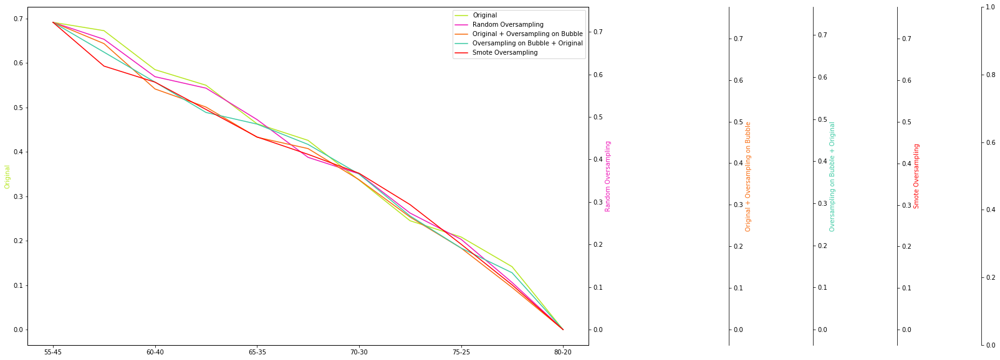

Total_Mini_AccuracyKNN


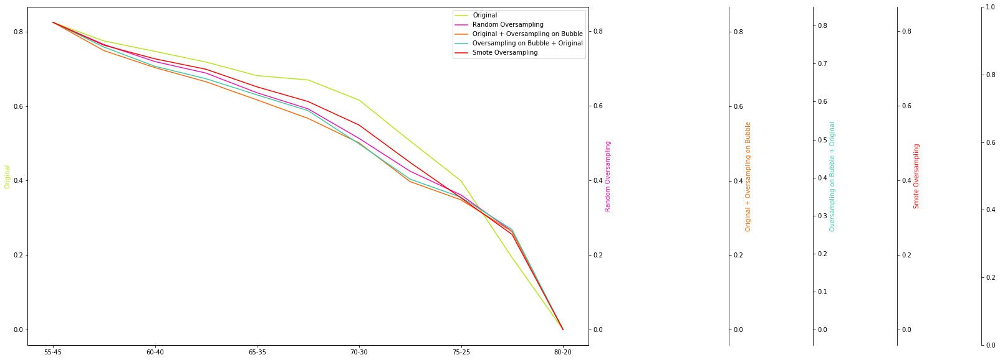

Total_Mini_AccuracySVC


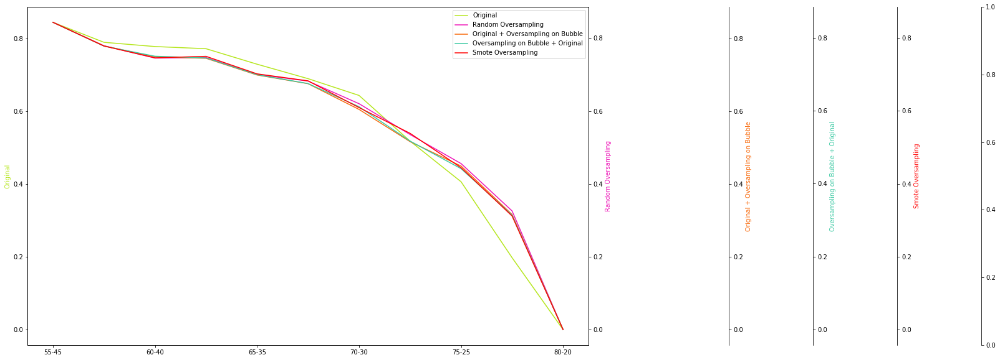

Total_Mini_AccuracyRF


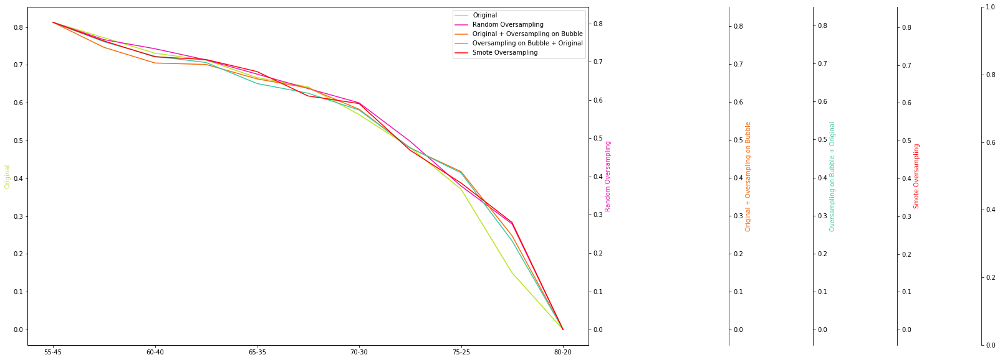

Total_Mini_AccuracyDT


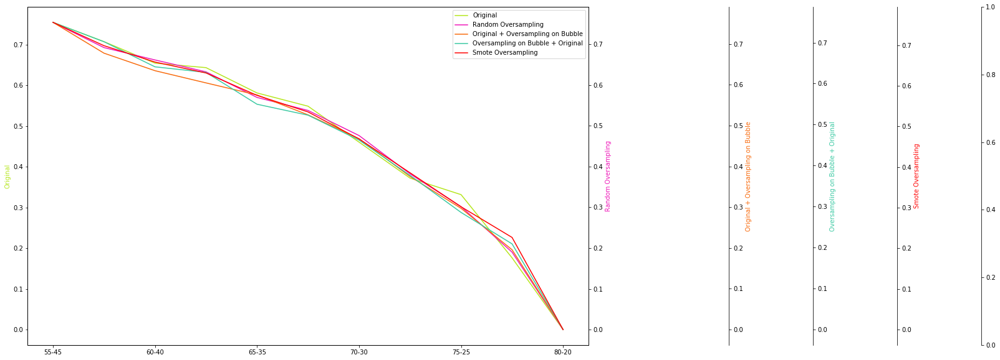

Total_Mini_Precision 0SGD


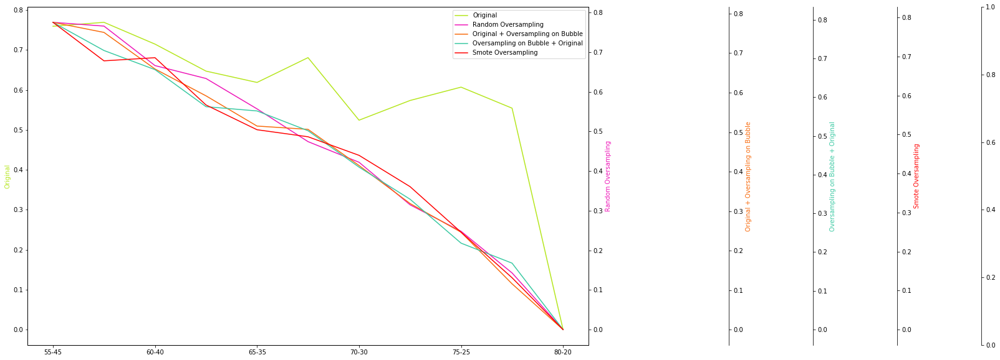

Total_Mini_Precision 0KNN


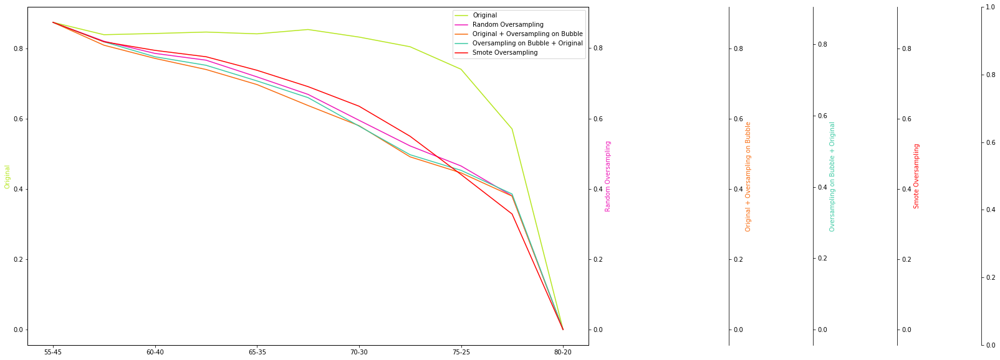

Total_Mini_Precision 0SVC


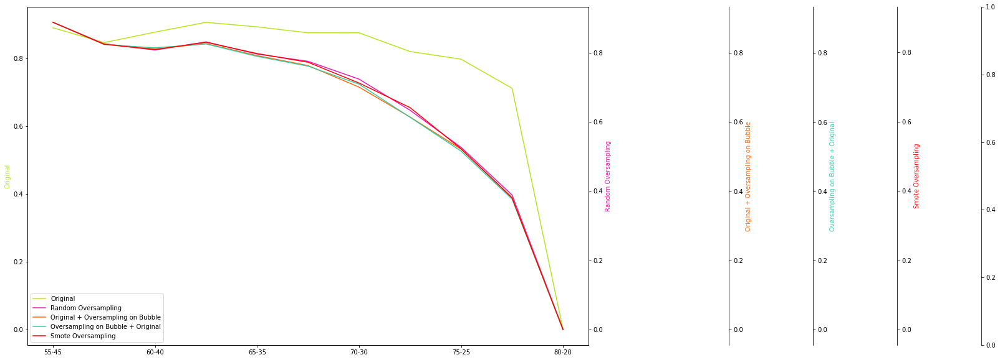

Total_Mini_Precision 0RF


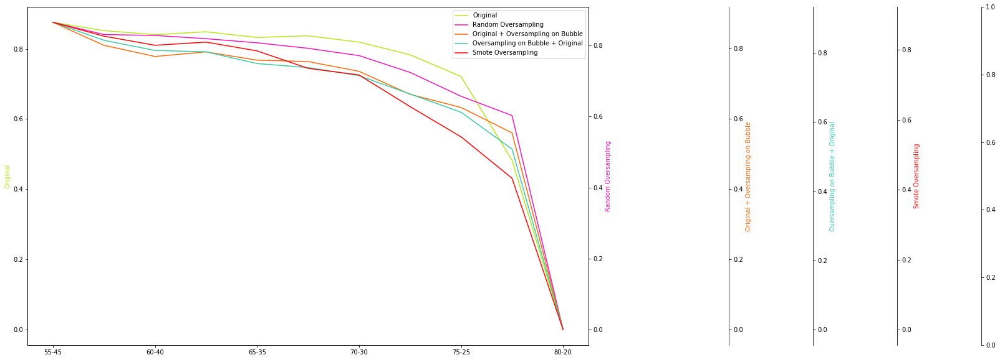

Total_Mini_Precision 0DT


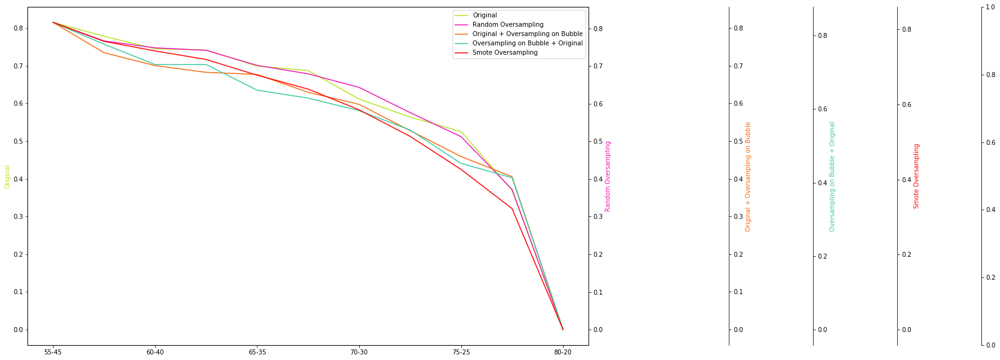

Total_Mini_Precision 1SGD


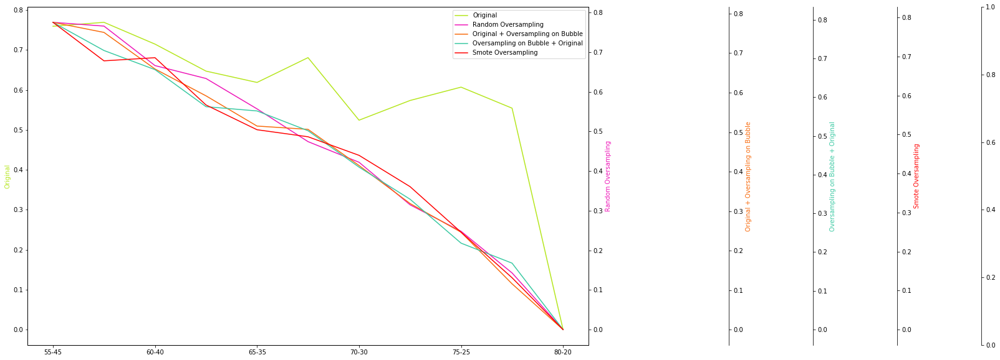

Total_Mini_Precision 1KNN


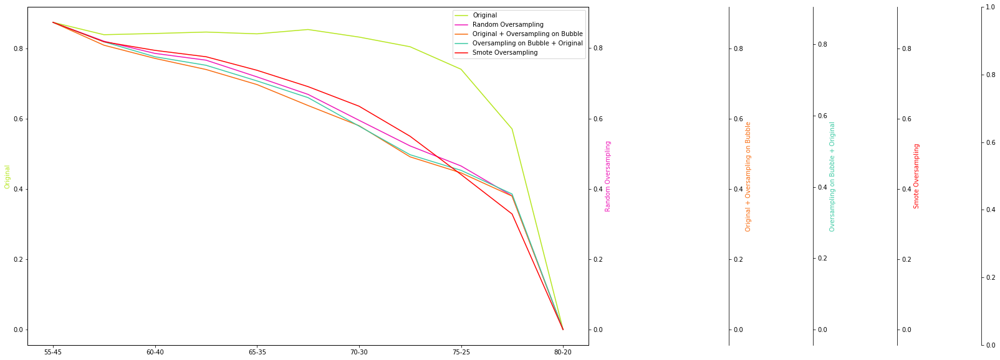

Total_Mini_Precision 1SVC


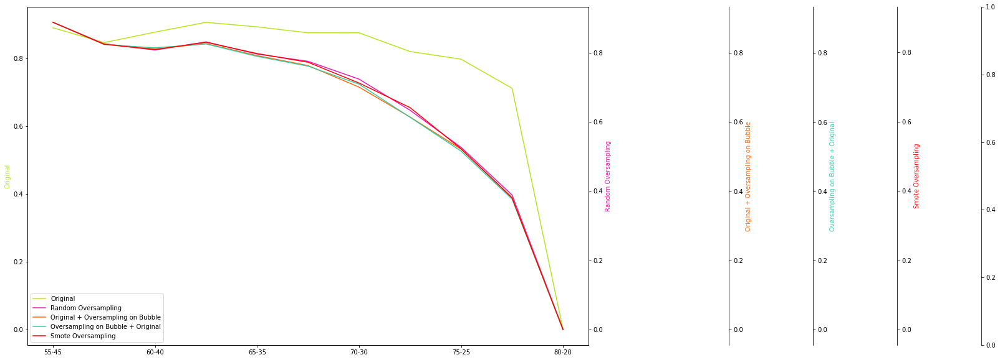

Total_Mini_Precision 1RF


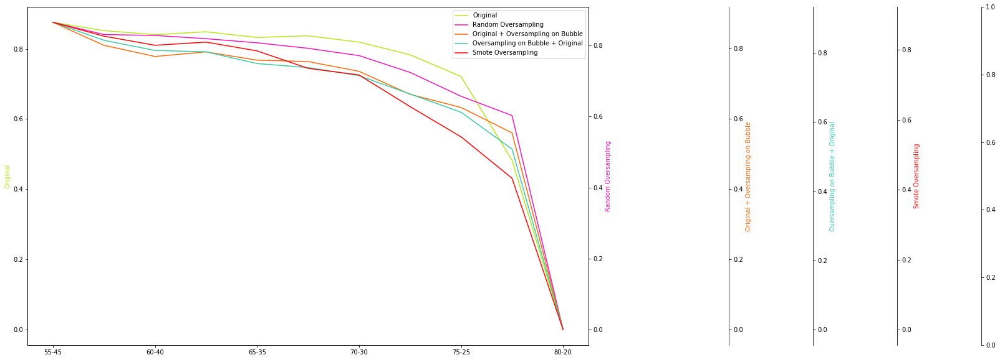

Total_Mini_Precision 1DT


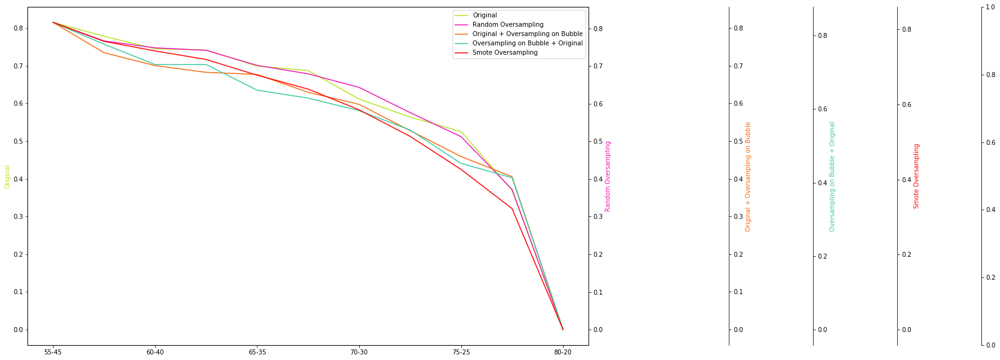

Total_Mini_Recall 0SGD


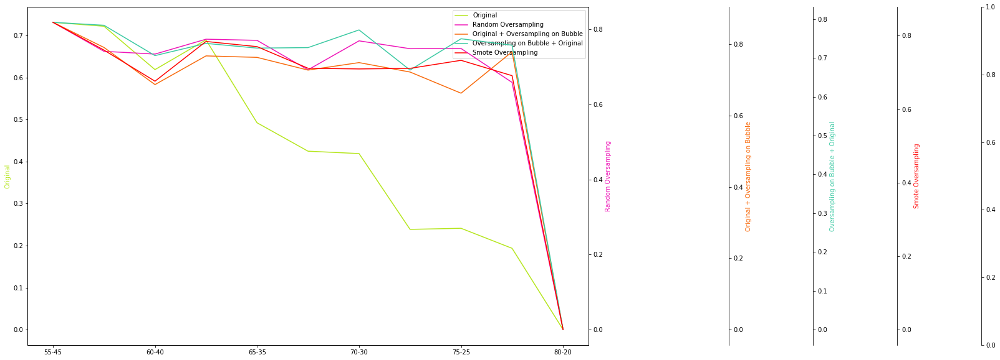

Total_Mini_Recall 0KNN


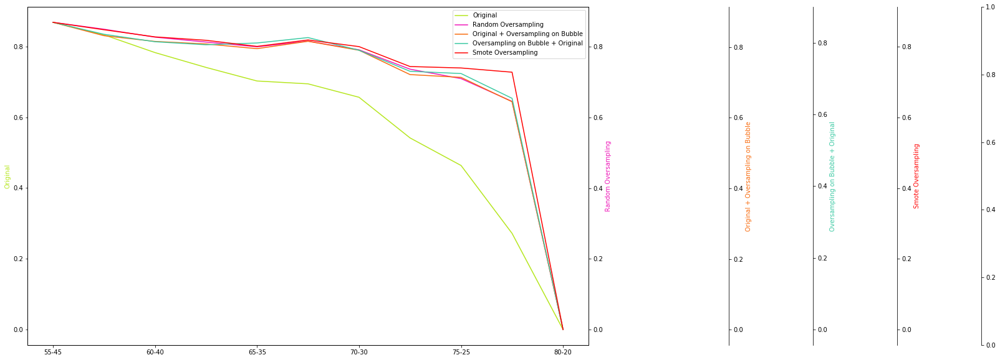

Total_Mini_Recall 0SVC


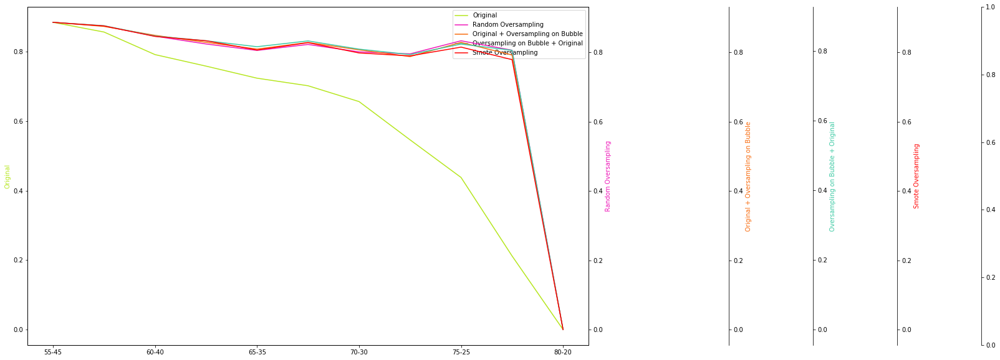

Total_Mini_Recall 0RF


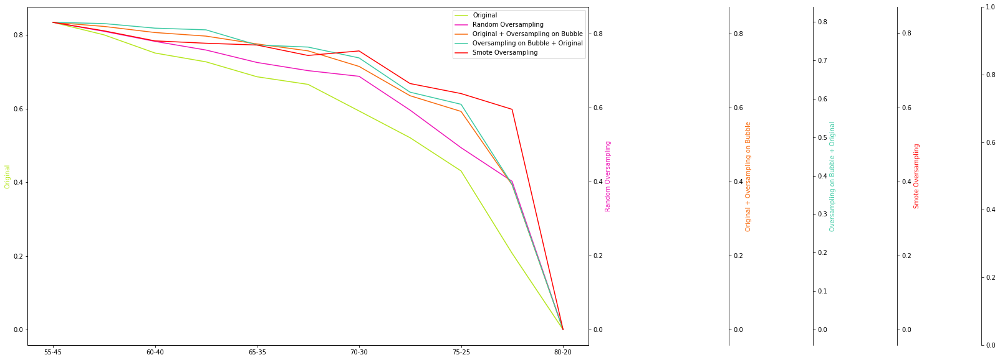

Total_Mini_Recall 0DT


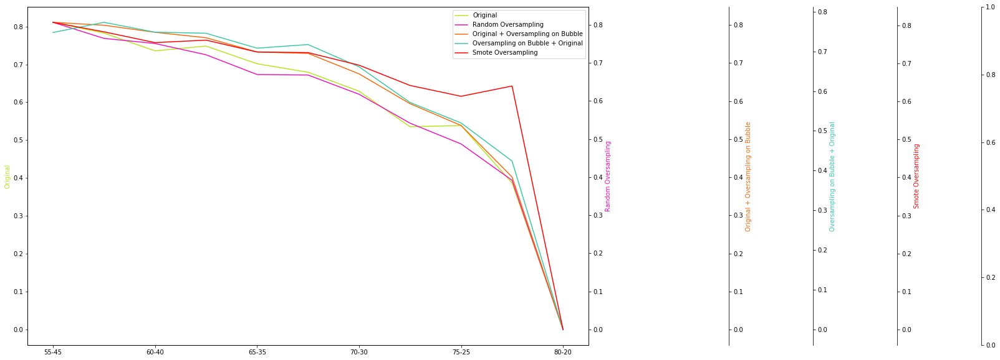

Total_Mini_Recall1SGD


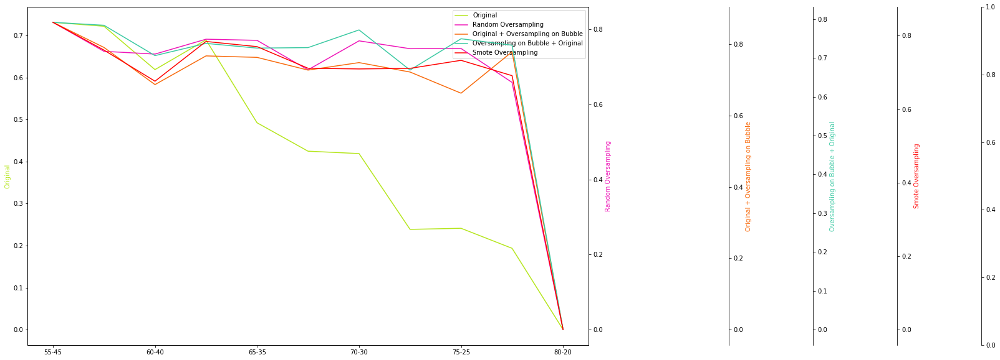

Total_Mini_Recall1KNN


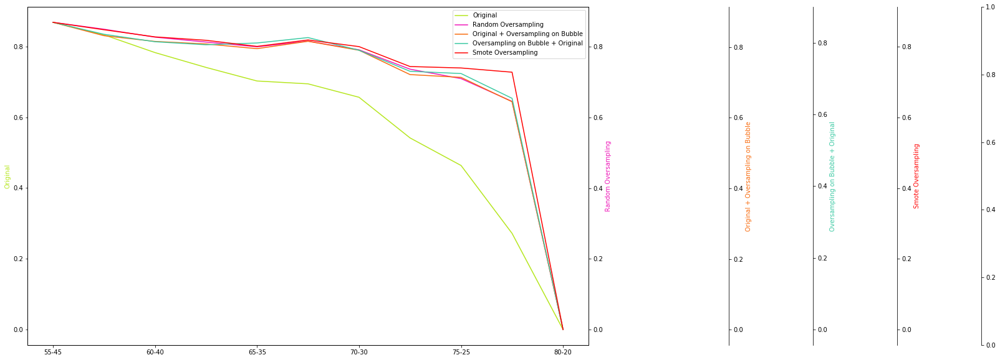

Total_Mini_Recall1SVC


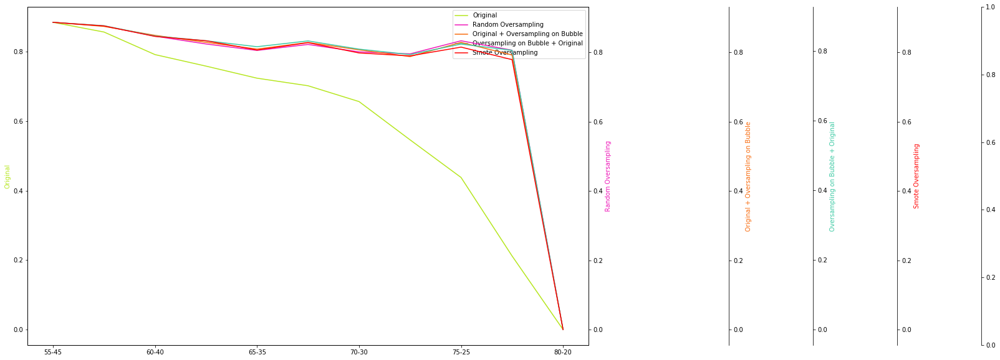

Total_Mini_Recall1RF


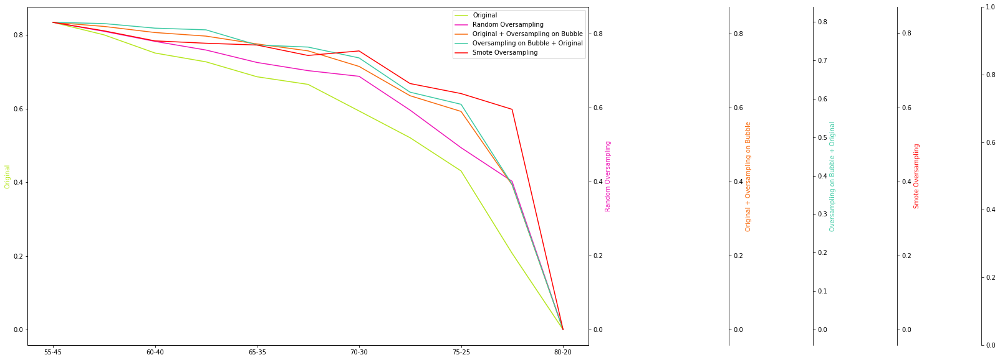

Total_Mini_Recall1DT


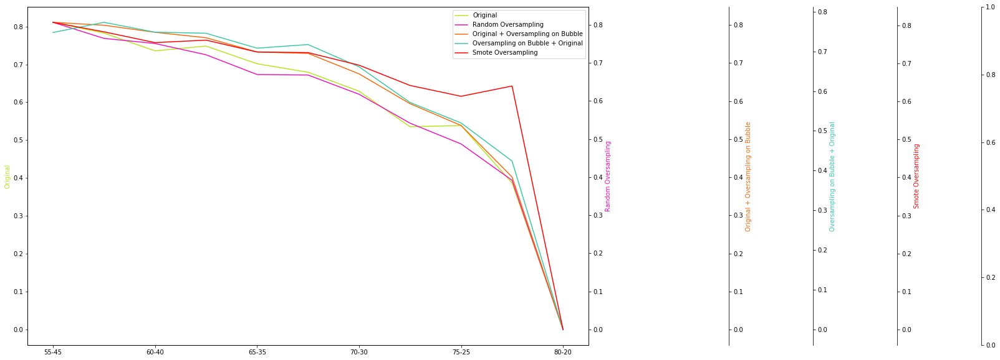

Total_Mini_Balanced_AccuracySGD


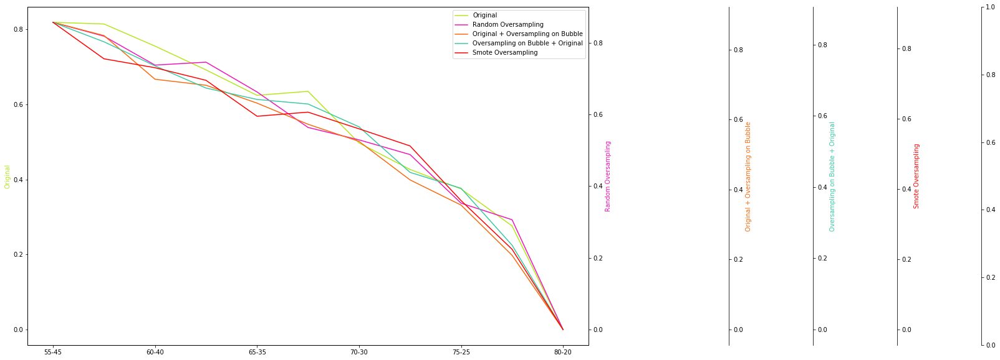

Total_Mini_Balanced_AccuracyKNN


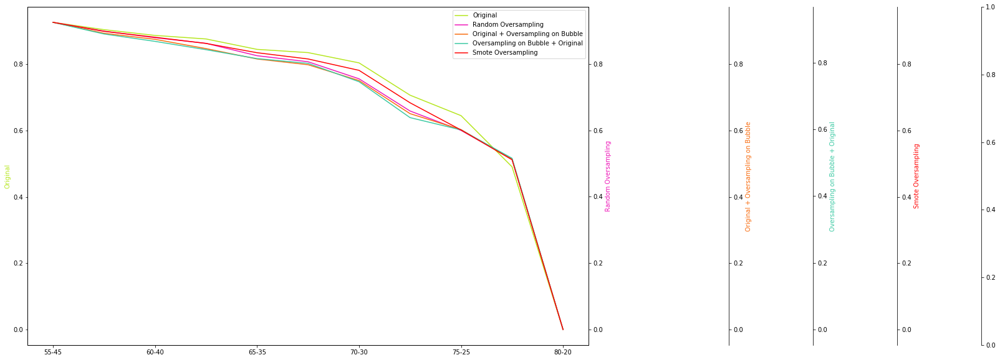

Total_Mini_Balanced_AccuracySVC


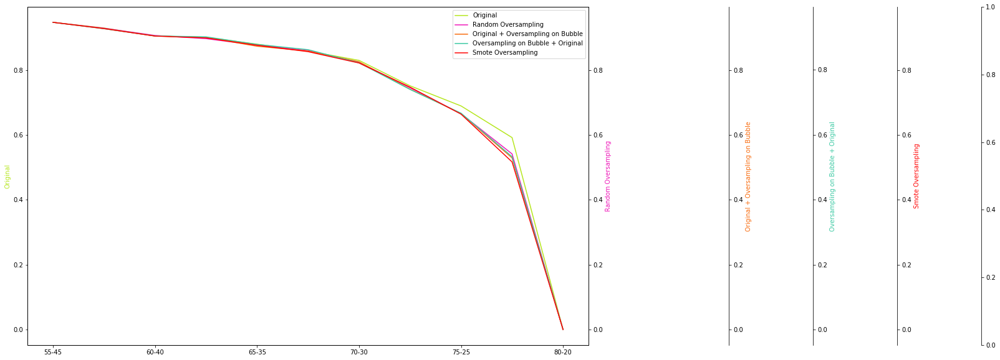

Total_Mini_Balanced_AccuracyRF


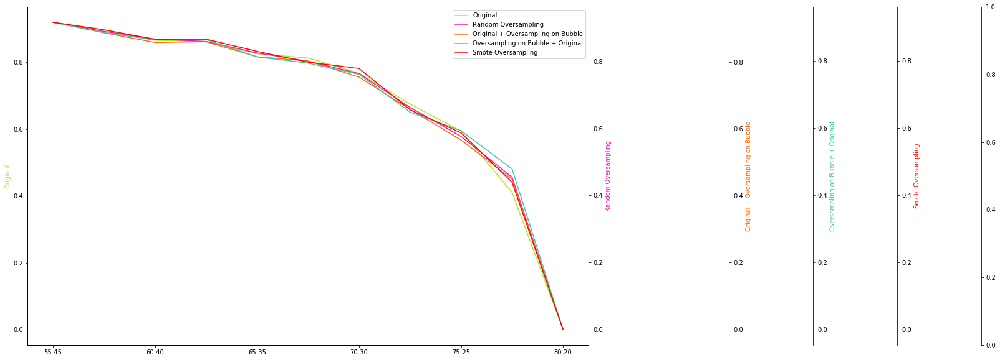

Total_Mini_Balanced_AccuracyDT


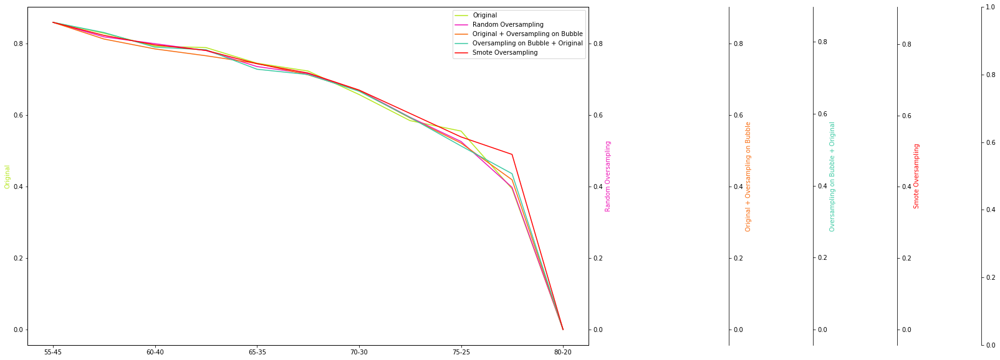

Total_Mini_F1 Score 0SGD


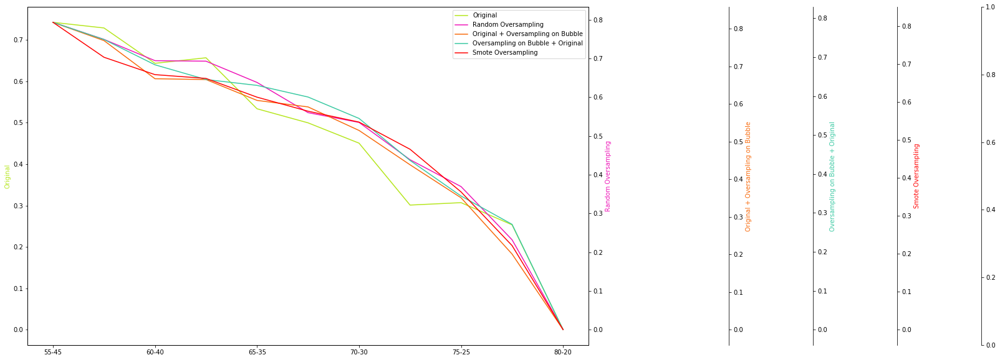

Total_Mini_F1 Score 0KNN


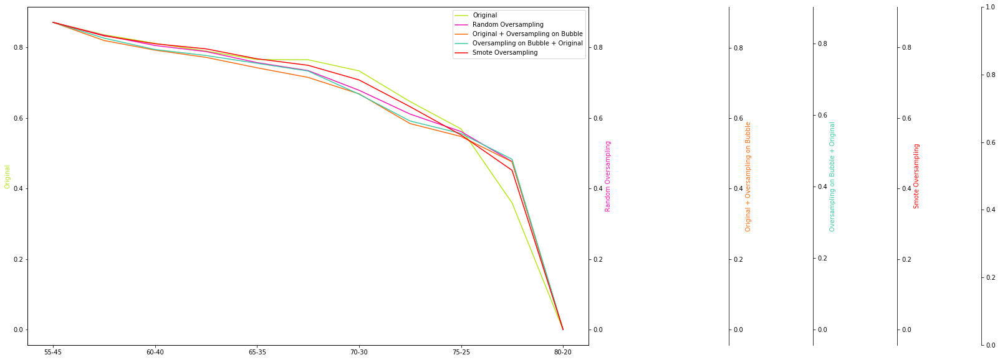

Total_Mini_F1 Score 0SVC


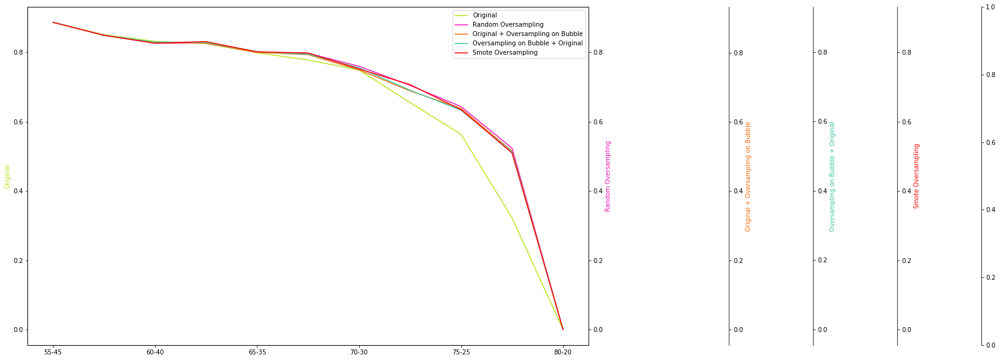

Total_Mini_F1 Score 0RF


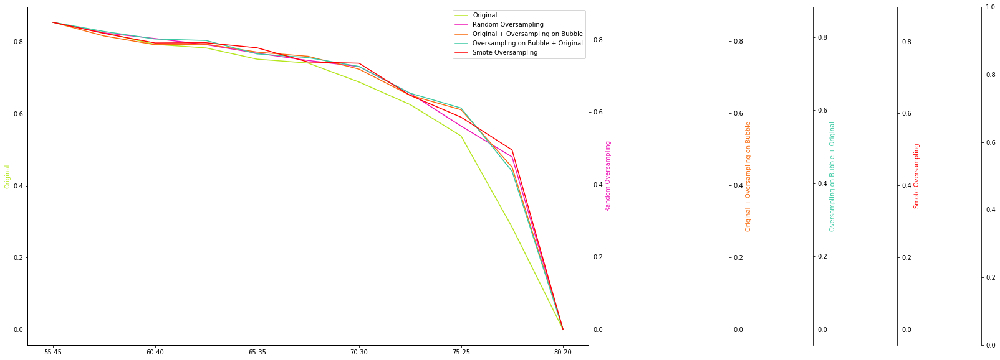

Total_Mini_F1 Score 0DT


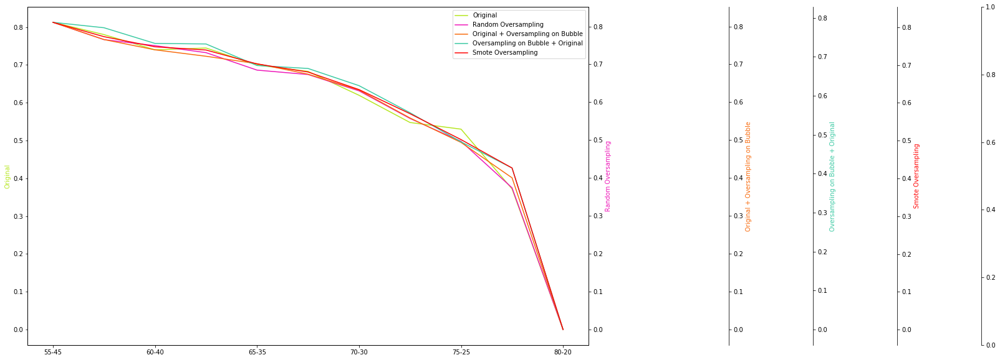

Total_Mini_F1 Score 1SGD


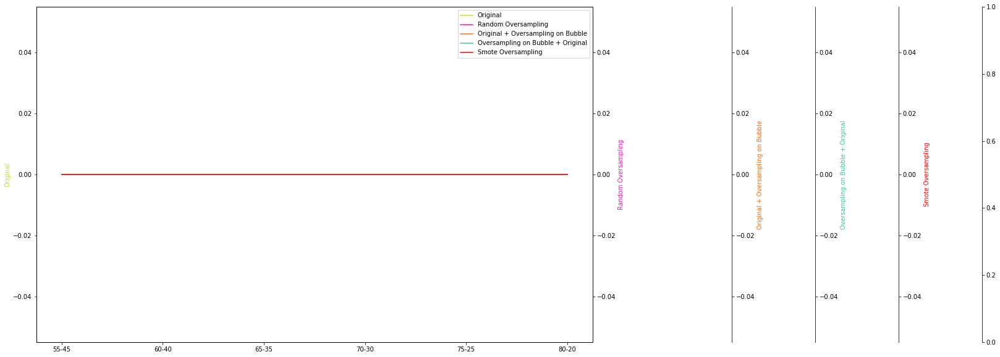

Total_Mini_F1 Score 1KNN


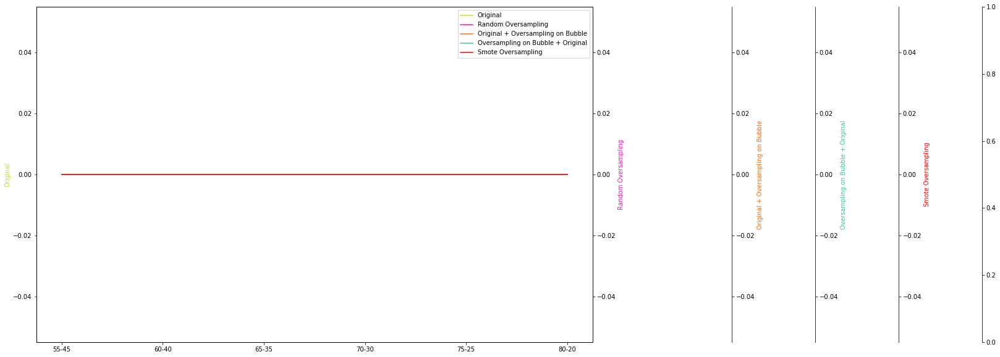

Total_Mini_F1 Score 1SVC


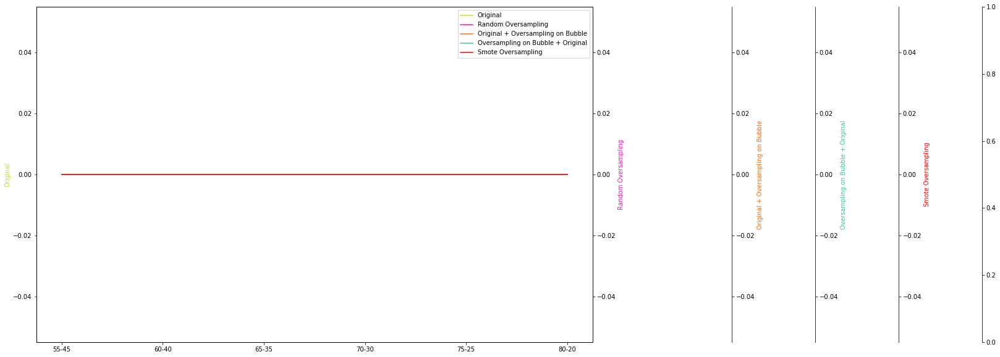

Total_Mini_F1 Score 1RF


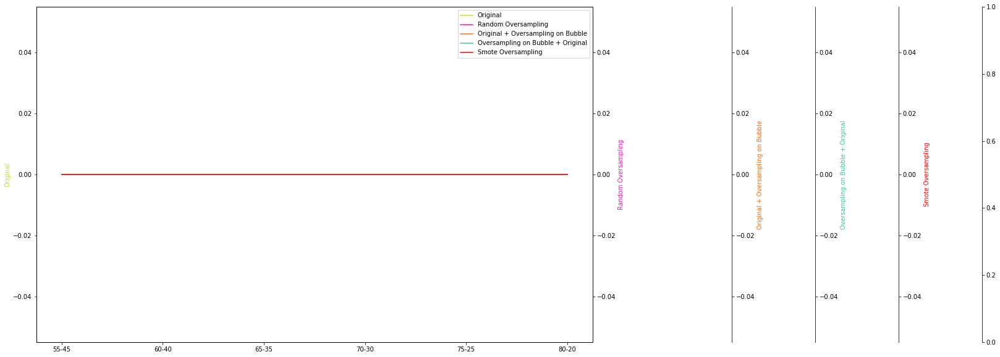

Total_Mini_F1 Score 1DT


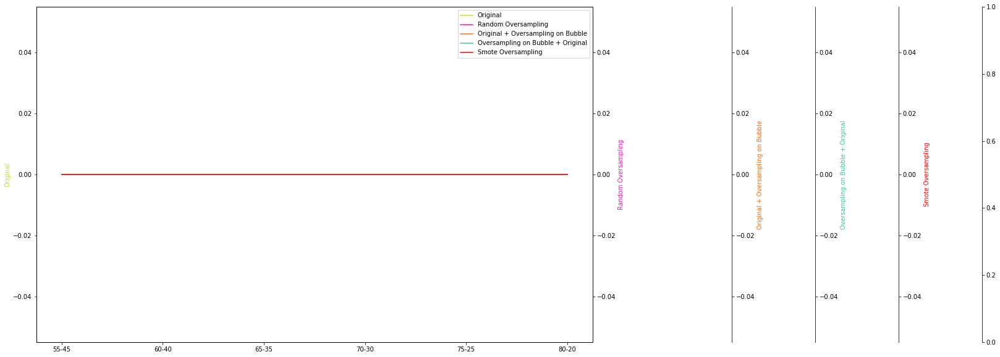

Total_Mini_AUCSGD


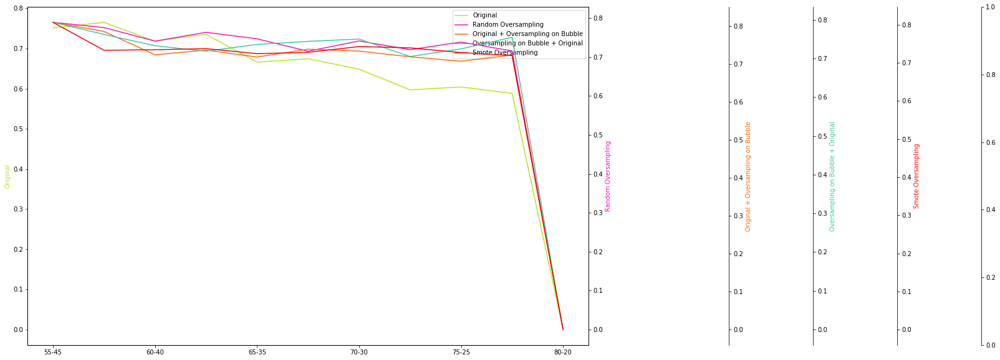

Total_Mini_AUCKNN


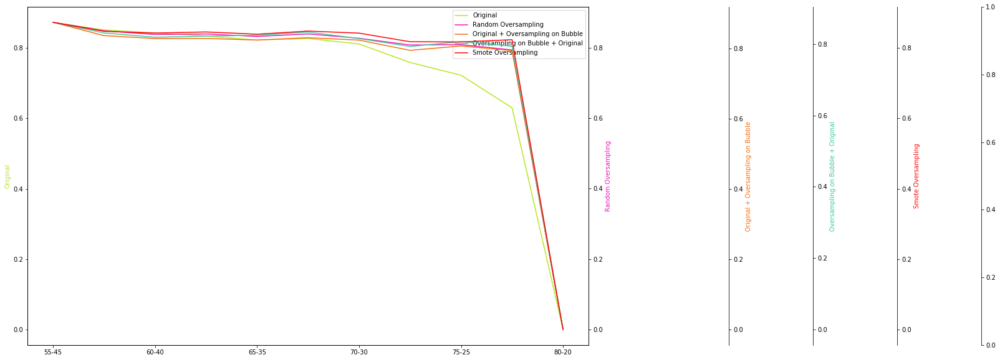

Total_Mini_AUCSVC


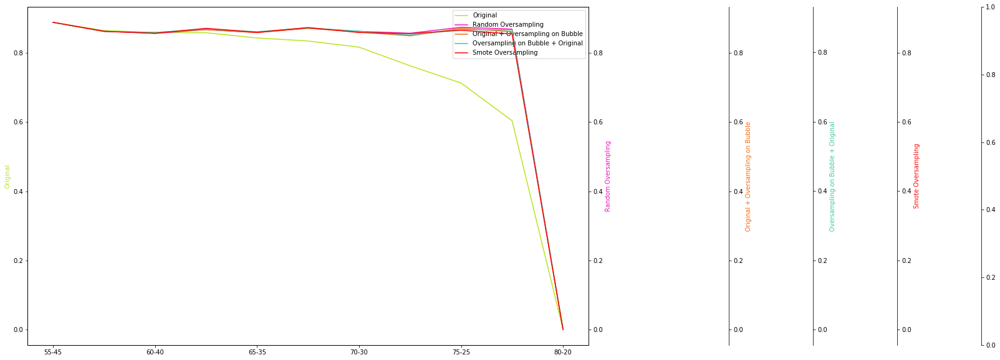

Total_Mini_AUCRF


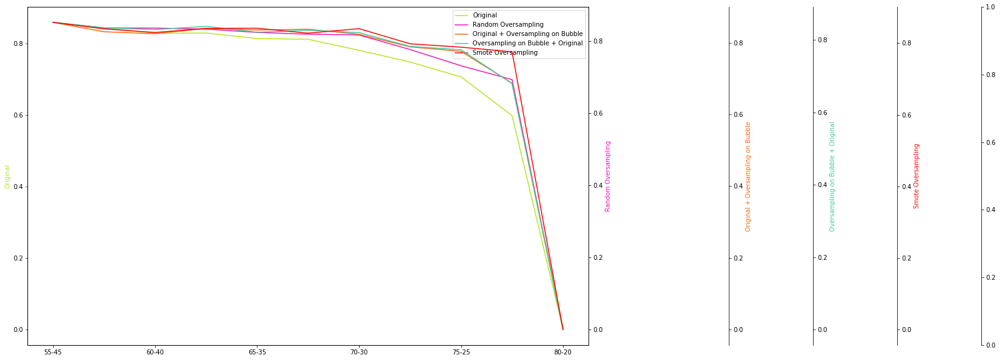

Total_Mini_AUCDT


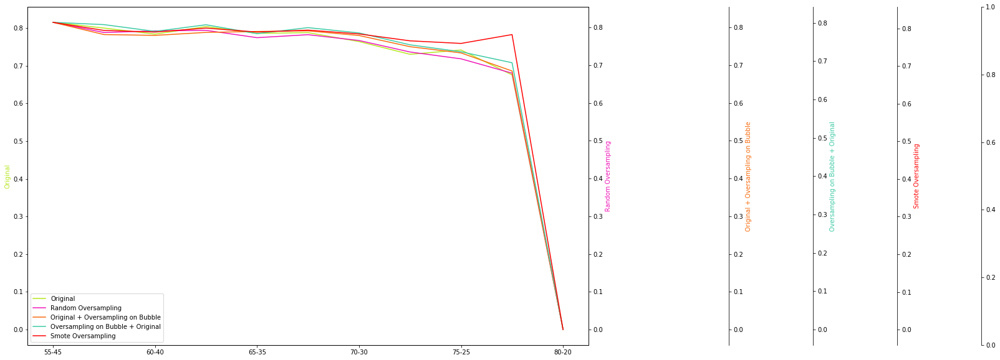

Total_Mini_AUC Probs 0SGD


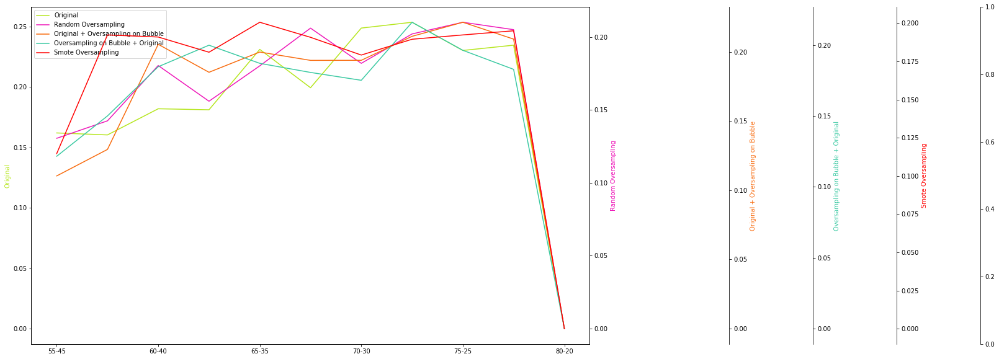

Total_Mini_AUC Probs 0KNN


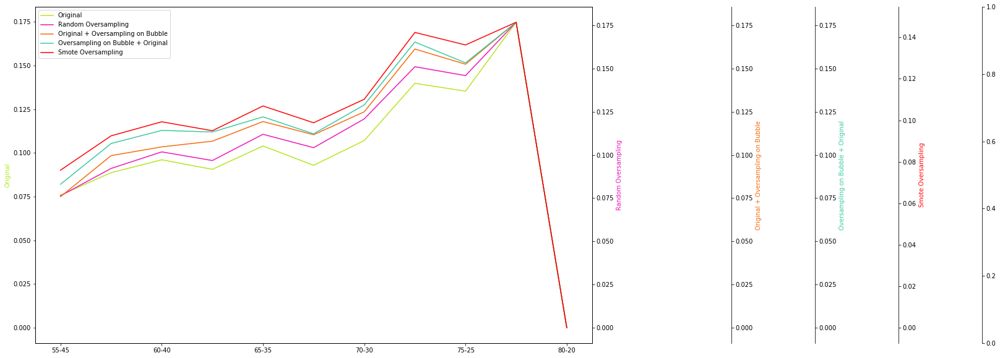

Total_Mini_AUC Probs 0SVC


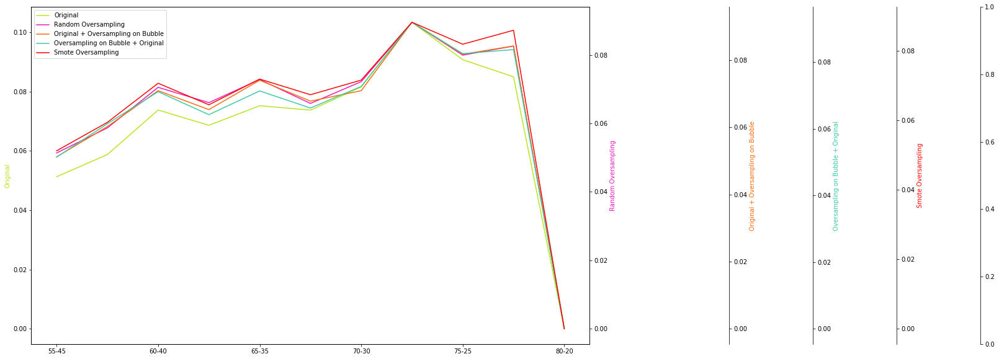

Total_Mini_AUC Probs 0RF


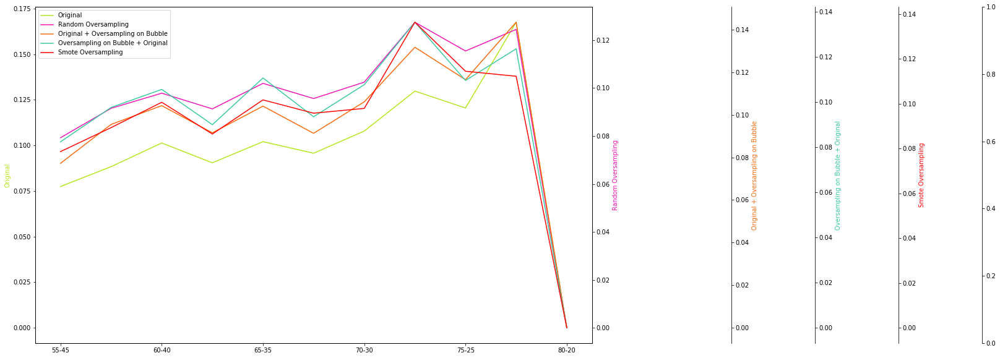

Total_Mini_AUC Probs 0DT


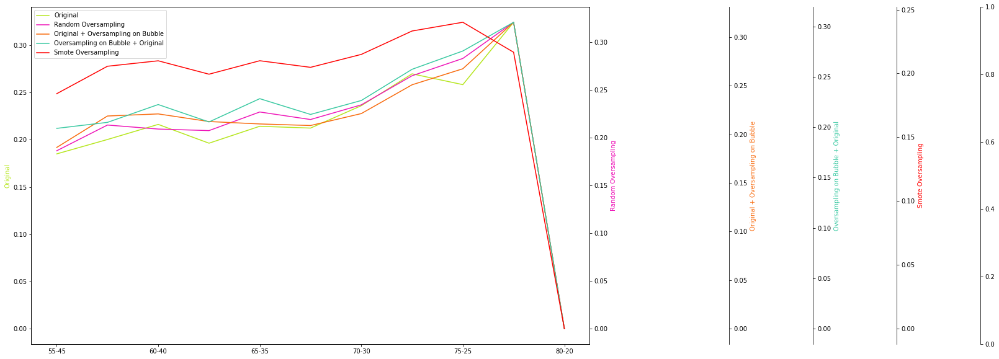

Total_Mini_AUC Probs 1SGD


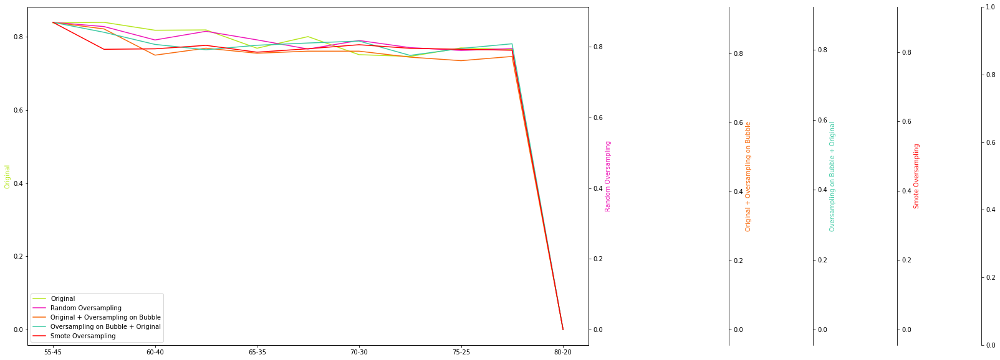

Total_Mini_AUC Probs 1KNN


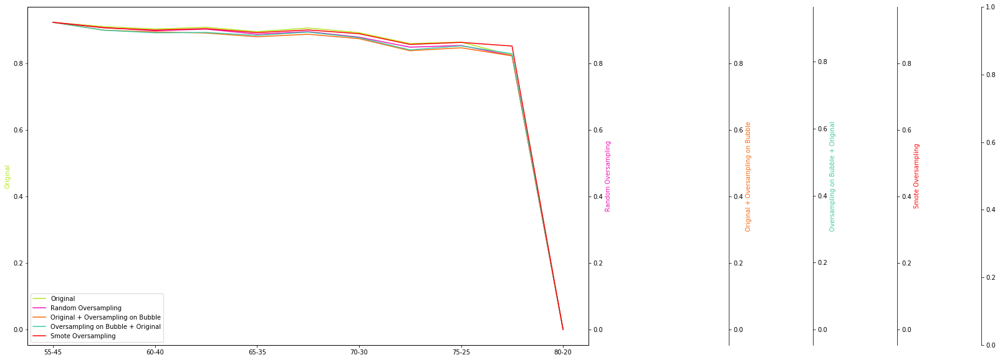

Total_Mini_AUC Probs 1SVC


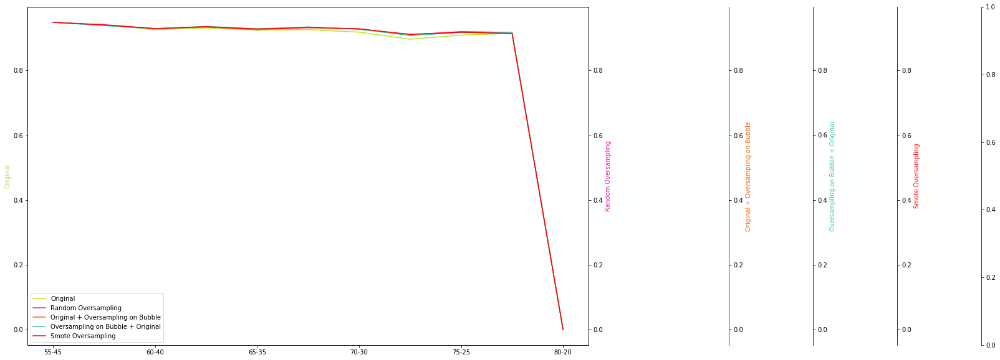

Total_Mini_AUC Probs 1RF


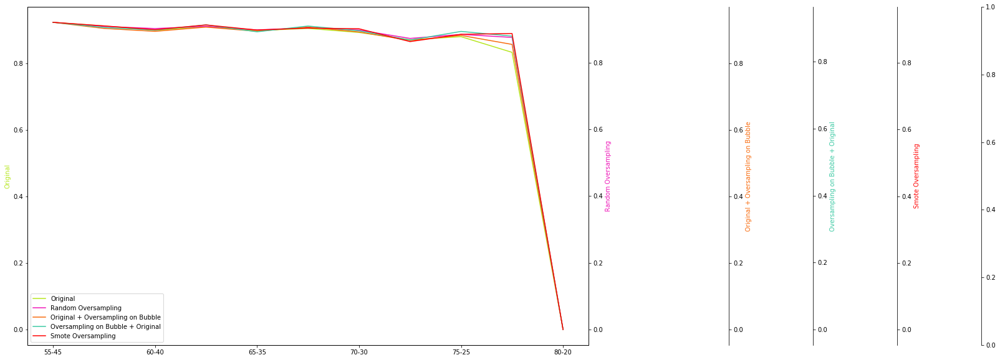

Total_Mini_AUC Probs 1DT


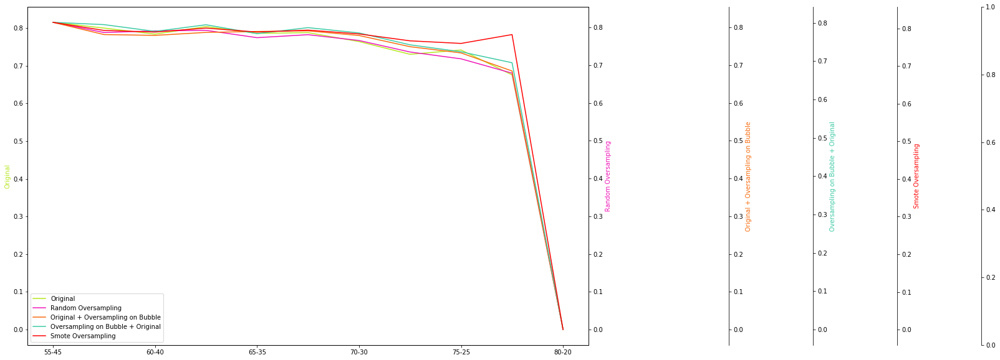

In [12]:
maBulle0 = BuildMyBulle([1,1,1,1,1,1,1], 6, 'normCats_realSnowBubblesTimes15_ray10bis_RealSmote', bulle, bubble_oversample);
maBulle0.instantiate_data();
maBulle0.cross_validate();
maBulle0.visualize_scores()
    

## Tiny

youp
setting
props {}
FEATURE VECTOR
Time taken for creating the feature vectors:  0:00:00
ORDER THE DATA
setting
props {}
Time taken for ordering the data:  0:00:00
SPLIT
Time taken for split:  0:00:00
RANDOM OVERSAMPLING
Random Oversample
Time taken for random oversampling:  0:00:00
BUBBLE OVERSAMPLE
Bubble Oversample
aan het bullen 0 0:00:00
aan het bullen 1 0:00:00
aan het bullen 2 0:00:00
aan het bullen 3 0:00:00
aan het bullen 4 0:00:00
aan het bullen 5 0:00:00
aan het bullen 6 0:00:00
Time taken for random bubble oversampling:  0:00:00
SMOTE OVERSAMPLE
Smote Oversample
Time taken for random SMOTE:  0:00:01
setting
props {}
FEATURE VECTOR
Time taken for creating the feature vectors:  0:00:00
ORDER THE DATA
setting
props {}
Time taken for ordering the data:  0:00:00
SPLIT
Time taken for split:  0:00:00
RANDOM OVERSAMPLING
Random Oversample
Time taken for random oversampling:  0:00:00
BUBBLE OVERSAMPLE
Bubble Oversample
aan het bullen 0 0:00:00
aan het bullen 1 0:00:00
aan het bull

           Average Precision:  0.677079838459 , Precicion 0:  0.712643678161 , Precision 1 0.712643678161 , Recall 1:  0.837837837838 , Recall 0:  0.837837837838 , PR AUC:  0.83737081887 , F1 Score 0:  0.770186335404 , F1 Score1:  0.770186335404 , AUC:  0.754445234708 , AUC Probs 0:  0.160739687055 , AUC Probs 1:  0.839260312945
         4
           Average Precision:  0.70655909641 , Precicion 0:  0.791044776119 , Precision 1 0.791044776119 , Recall 1:  0.716216216216 , Recall 0:  0.716216216216 , PR AUC:  0.827876982818 , F1 Score 0:  0.751773049645 , F1 Score1:  0.751773049645 , AUC:  0.76600284495 , AUC Probs 0:  0.172652916074 , AUC Probs 1:  0.827347083926
         5
           Average Precision:  0.560982800983 , Precicion 0:  0.636363636364 , Precision 1 0.636363636364 , Recall 1:  0.472972972973 , Recall 0:  0.472972972973 , PR AUC:  0.662816987277 , F1 Score 0:  0.542635658915 , F1 Score1:  0.542635658915 , AUC:  0.604907539118 , AUC Probs 0:  0.364153627312 , AUC Probs 1:  

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


4
           Average Precision:  0.64876510657 , Precicion 0:  0.69512195122 , Precision 1 0.69512195122 , Recall 1:  0.77027027027 , Recall 0:  0.77027027027 , PR AUC:  0.852691717791 , F1 Score 0:  0.730769230769 , F1 Score1:  0.730769230769 , AUC:  0.720661450925 , AUC Probs 0:  0.161450924609 , AUC Probs 1:  0.838549075391
         5
           Average Precision:  0.673634572072 , Precicion 0:  0.765625 , Precision 1 0.765625 , Recall 1:  0.662162162162 , Recall 0:  0.662162162162 , PR AUC:  0.828134980878 , F1 Score 0:  0.710144927536 , F1 Score1:  0.710144927536 , AUC:  0.732396870555 , AUC Probs 0:  0.192567567568 , AUC Probs 1:  0.807432432432
         6
           Average Precision:  0.601081081081 , Precicion 0:  0.666666666667 , Precision 1 0.666666666667 , Recall 1:  0.621621621622 , Recall 0:  0.621621621622 , PR AUC:  0.686627211783 , F1 Score 0:  0.643356643357 , F1 Score1:  0.643356643357 , AUC:  0.659495021337 , AUC Probs 0:  0.25746799431 , AUC Probs 1:  0.74270981507

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


 0.942028985507 , Precision 1 0.942028985507 , Recall 1:  0.878378378378 , Recall 0:  0.878378378378 , PR AUC:  0.94032764912 , F1 Score 0:  0.909090909091 , F1 Score1:  0.909090909091 , AUC:  0.912873399716 , AUC Probs 0:  0.0625889046942 , AUC Probs 1:  0.937411095306
         2
           Average Precision:  0.823700623701 , Precicion 0:  0.907692307692 , Precision 1 0.907692307692 , Recall 1:  0.797297297297 , Recall 0:  0.797297297297 , PR AUC:  0.923196208649 , F1 Score 0:  0.848920863309 , F1 Score1:  0.848920863309 , AUC:  0.859174964438 , AUC Probs 0:  0.0851706970128 , AUC Probs 1:  0.914829302987
         3
           Average Precision:  0.828757771856 , Precicion 0:  0.887323943662 , Precision 1 0.887323943662 , Recall 1:  0.851351351351 , Recall 0:  0.851351351351 , PR AUC:  0.938659753355 , F1 Score 0:  0.868965517241 , F1 Score1:  0.868965517241 , AUC:  0.873044096728 , AUC Probs 0:  0.0726351351351 , AUC Probs 1:  0.927364864865
         4
           Average Precision: 

           Average Precision:  0.858177408177 , Precicion 0:  0.884615384615 , Precision 1 0.884615384615 , Recall 1:  0.932432432432 , Recall 0:  0.932432432432 , PR AUC:  0.928114235862 , F1 Score 0:  0.907894736842 , F1 Score1:  0.907894736842 , AUC:  0.9070056899 , AUC Probs 0:  0.0590327169275 , AUC Probs 1:  0.940967283073
         5
           Average Precision:  0.802030323006 , Precicion 0:  0.829268292683 , Precision 1 0.829268292683 , Recall 1:  0.918918918919 , Recall 0:  0.918918918919 , PR AUC:  0.834719703635 , F1 Score 0:  0.871794871795 , F1 Score1:  0.871794871795 , AUC:  0.867354196302 , AUC Probs 0:  0.121443812233 , AUC Probs 1:  0.878556187767
         6
           Average Precision:  0.830968183373 , Precicion 0:  0.860759493671 , Precision 1 0.860759493671 , Recall 1:  0.918918918919 , Recall 0:  0.918918918919 , PR AUC:  0.942626799052 , F1 Score 0:  0.888888888889 , F1 Score1:  0.888888888889 , AUC:  0.887091038407 , AUC Probs 0:  0.0577880512091 , AUC Probs 1

           Average Precision:  0.830968183373 , Precicion 0:  0.860759493671 , Precision 1 0.860759493671 , Recall 1:  0.918918918919 , Recall 0:  0.918918918919 , PR AUC:  0.943248143485 , F1 Score 0:  0.888888888889 , F1 Score1:  0.888888888889 , AUC:  0.887091038407 , AUC Probs 0:  0.0579658605974 , AUC Probs 1:  0.942034139403
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE SMOTE TRAINING SET:  0:00:00
  Time taken to cross validate everything:  0:00:01
GETTING AVERAGE SCORES
original
           0 _ : Average Precision- 0.835692909101 , Precicion 0- 0.879817553314 , Precision 1- 0.879817553314 , Recall 1- 0.888030888031 , Recall 0- 0.888030888031 , PR Aucs- [0.94208482594689202, 0.88331919960751293, 0.91070525834823501, 0.95367830713510926, 0.93154798164547925, 0.84243355707834744, 0.94196707660208201] , F1 Score 0- 0.882790999501 , F1 Score1- [0, 0, 0, 0, 0] , AUC- 0.883865068076 , AUC Probs 0- 0.0666531192847 , AUC Probs 1- [0.93334688071530181, 0, 0, 0, 0]
oversample
   

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: 

           Average Precision:  0.788468468468 , Precicion 0:  0.84 , Precision 1 0.84 , Recall 1:  0.851351351351 , Recall 0:  0.851351351351 , PR AUC:  0.894508235936 , F1 Score 0:  0.845637583893 , F1 Score1:  0.845637583893 , AUC:  0.846728307255 , AUC Probs 0:  0.097972972973 , AUC Probs 1:  0.902027027027
         5
           Average Precision:  0.753340840841 , Precicion 0:  0.819444444444 , Precision 1 0.819444444444 , Recall 1:  0.797297297297 , Recall 0:  0.797297297297 , PR AUC:  0.882587724062 , F1 Score 0:  0.808219178082 , F1 Score1:  0.808219178082 , AUC:  0.813122332859 , AUC Probs 0:  0.112108819346 , AUC Probs 1:  0.887891180654
         6
           Average Precision:  0.821261261261 , Precicion 0:  0.866666666667 , Precision 1 0.866666666667 , Recall 1:  0.878378378378 , Recall 0:  0.878378378378 , PR AUC:  0.911975653908 , F1 Score 0:  0.872483221477 , F1 Score1:  0.872483221477 , AUC:  0.873399715505 , AUC Probs 0:  0.0775248933144 , AUC Probs 1:  0.922475106686
 

           Average Precision:  0.740553410553 , Precicion 0:  0.814285714286 , Precision 1 0.814285714286 , Recall 1:  0.77027027027 , Recall 0:  0.77027027027 , PR AUC:  0.848944658945 , F1 Score 0:  0.791666666667 , F1 Score1:  0.791666666667 , AUC:  0.799608819346 , AUC Probs 0:  0.200391180654 , AUC Probs 1:  0.799608819346
     Time taken TO TRAIN THE ORIGINAL TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE TRAINING SET
         0
           Average Precision:  0.748295400664 , Precicion 0:  0.802631578947 , Precision 1 0.802631578947 , Recall 1:  0.824324324324 , Recall 0:  0.824324324324 , PR AUC:  0.856811284969 , F1 Score 0:  0.813333333333 , F1 Score1:  0.813333333333 , AUC:  0.813477951636 , AUC Probs 0:  0.186522048364 , AUC Probs 1:  0.813477951636
         1
           Average Precision:  0.746036036036 , Precicion 0:  0.833333333333 , Precision 1 0.833333333333 , Recall 1:  0.743243243243 , Recall 0:  0.743243243243 , PR AUC:  0.851621621622 , F1 Score 0:  0.785714285714 , F

           Average Precision:  0.723130630631 , Precicion 0:  0.791666666667 , Precision 1 0.791666666667 , Recall 1:  0.77027027027 , Recall 0:  0.77027027027 , PR AUC:  0.837635135135 , F1 Score 0:  0.780821917808 , F1 Score1:  0.780821917808 , AUC:  0.786450924609 , AUC Probs 0:  0.213549075391 , AUC Probs 1:  0.786450924609
         5
           Average Precision:  0.735495495495 , Precicion 0:  0.777777777778 , Precision 1 0.777777777778 , Recall 1:  0.851351351351 , Recall 0:  0.851351351351 , PR AUC:  0.851231231231 , F1 Score 0:  0.812903225806 , F1 Score1:  0.812903225806 , AUC:  0.807254623044 , AUC Probs 0:  0.192745376956 , AUC Probs 1:  0.807254623044
         6
           Average Precision:  0.759753177835 , Precicion 0:  0.821917808219 , Precision 1 0.821917808219 , Recall 1:  0.810810810811 , Recall 0:  0.810810810811 , PR AUC:  0.863030976182 , F1 Score 0:  0.816326530612 , F1 Score1:  0.816326530612 , AUC:  0.819879089616 , AUC Probs 0:  0.180120910384 , AUC Probs 1: 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


0.736842105263 , F1 Score1:  0.736842105263 , AUC:  0.762733142037 , AUC Probs 0:  0.149479913917 , AUC Probs 1:  0.851327116212
         4
           Average Precision:  0.597510548523 , Precicion 0:  0.645569620253 , Precision 1 0.645569620253 , Recall 1:  0.75 , Recall 0:  0.75 , PR AUC:  0.571571714329 , F1 Score 0:  0.69387755102 , F1 Score1:  0.69387755102 , AUC:  0.704268292683 , AUC Probs 0:  0.287840746055 , AUC Probs 1:  0.712159253945
         5
           Average Precision:  0.644027556969 , Precicion 0:  0.702702702703 , Precision 1 0.702702702703 , Recall 1:  0.764705882353 , Recall 0:  0.764705882353 , PR AUC:  0.801177289947 , F1 Score 0:  0.732394366197 , F1 Score1:  0.732394366197 , AUC:  0.748206599713 , AUC Probs 0:  0.191893830703 , AUC Probs 1:  0.808106169297
         6
           Average Precision:  0.523771626298 , Precicion 0:  0.607843137255 , Precision 1 0.607843137255 , Recall 1:  0.455882352941 , Recall 0:  0.455882352941 , PR AUC:  0.672104421874 , F1 Sco

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.712064353557 , Precicion 0:  0.753246753247 , Precision 1 0.753246753247 , Recall 1:  0.865671641791 , Recall 0:  0.865671641791 , PR AUC:  0.865268015725 , F1 Score 0:  0.805555555556 , F1 Score1:  0.805555555556 , AUC:  0.81837798957 , AUC Probs 0:  0.119852544506 , AUC Probs 1:  0.880147455494
         2
           Average Precision:  0.700947436729 , Precicion 0:  0.768115942029 , Precision 1 0.768115942029 , Recall 1:  0.791044776119 , Recall 0:  0.791044776119 , PR AUC:  0.870932525548 , F1 Score 0:  0.779411764706 , F1 Score1:  0.779411764706 , AUC:  0.799136845891 , AUC Probs 0:  0.131271354073 , AUC Probs 1:  0.868728645927
         3
           Average Precision:  0.738823529412 , Precicion 0:  0.8 , Precision 1 0.8 , Recall 1:  0.823529411765 , Recall 0:  0.823529411765 , PR AUC:  0.889446019593 , F1 Score 0:  0.811594202899 , F1 Score1:  0.811594202899 , AUC:  0.826398852224 , AUC Probs 0:  0.105720946915 , AUC Probs 1:  0.894279053085
     

           Average Precision:  0.766674406605 , Precicion 0:  0.802631578947 , Precision 1 0.802631578947 , Recall 1:  0.897058823529 , Recall 0:  0.897058823529 , PR AUC:  0.846469001771 , F1 Score 0:  0.847222222222 , F1 Score1:  0.847222222222 , AUC:  0.857065997131 , AUC Probs 0:  0.0952295552367 , AUC Probs 1:  0.904770444763
         4
           Average Precision:  0.78862745098 , Precicion 0:  0.833333333333 , Precision 1 0.833333333333 , Recall 1:  0.882352941176 , Recall 0:  0.882352941176 , PR AUC:  0.933955244267 , F1 Score 0:  0.857142857143 , F1 Score1:  0.857142857143 , AUC:  0.868005738881 , AUC Probs 0:  0.0640243902439 , AUC Probs 1:  0.935975609756
         5
           Average Precision:  0.835623885918 , Precicion 0:  0.893939393939 , Precision 1 0.893939393939 , Recall 1:  0.867647058824 , Recall 0:  0.867647058824 , PR AUC:  0.942017377943 , F1 Score 0:  0.880597014925 , F1 Score1:  0.880597014925 , AUC:  0.891140602582 , AUC Probs 0:  0.0460903873745 , AUC Probs

           Average Precision:  0.732745098039 , Precicion 0:  0.833333333333 , Precision 1 0.833333333333 , Recall 1:  0.735294117647 , Recall 0:  0.735294117647 , PR AUC:  0.879519750636 , F1 Score 0:  0.78125 , F1 Score1:  0.78125 , AUC:  0.806671449067 , AUC Probs 0:  0.114149928264 , AUC Probs 1:  0.885850071736
         5
           Average Precision:  0.768645276292 , Precicion 0:  0.890909090909 , Precision 1 0.890909090909 , Recall 1:  0.720588235294 , Recall 0:  0.720588235294 , PR AUC:  0.905619929713 , F1 Score 0:  0.79674796748 , F1 Score1:  0.79674796748 , AUC:  0.823708751793 , AUC Probs 0:  0.0873385939742 , AUC Probs 1:  0.912661406026
         6
           Average Precision:  0.748371696505 , Precicion 0:  0.811594202899 , Precision 1 0.811594202899 , Recall 1:  0.823529411765 , Recall 0:  0.823529411765 , PR AUC:  0.898254667906 , F1 Score 0:  0.817518248175 , F1 Score1:  0.817518248175 , AUC:  0.832496413199 , AUC Probs 0:  0.0896700143472 , AUC Probs 1:  0.910329985

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: 

 0
           Average Precision:  0.652338308458 , Precicion 0:  0.706666666667 , Precision 1 0.706666666667 , Recall 1:  0.791044776119 , Recall 0:  0.791044776119 , PR AUC:  0.73757141835 , F1 Score 0:  0.746478873239 , F1 Score1:  0.746478873239 , AUC:  0.762992267578 , AUC Probs 0:  0.200143859018 , AUC Probs 1:  0.799856140982
         1
           Average Precision:  0.696355721393 , Precicion 0:  0.78125 , Precision 1 0.78125 , Recall 1:  0.746268656716 , Recall 0:  0.746268656716 , PR AUC:  0.856285811336 , F1 Score 0:  0.763358778626 , F1 Score1:  0.763358778626 , AUC:  0.788796978961 , AUC Probs 0:  0.125606905233 , AUC Probs 1:  0.874393094767
         2
           Average Precision:  0.641303008766 , Precicion 0:  0.730158730159 , Precision 1 0.730158730159 , Recall 1:  0.686567164179 , Recall 0:  0.686567164179 , PR AUC:  0.841985077271 , F1 Score 0:  0.707692307692 , F1 Score1:  0.707692307692 , AUC:  0.740873943535 , AUC Probs 0:  0.146286639094 , AUC Probs 1:  0.8537133

         4
           Average Precision:  0.674084413426 , Precicion 0:  0.779661016949 , Precision 1 0.779661016949 , Recall 1:  0.676470588235 , Recall 0:  0.676470588235 , PR AUC:  0.801399135926 , F1 Score 0:  0.724409448819 , F1 Score1:  0.724409448819 , AUC:  0.758967001435 , AUC Probs 0:  0.241032998565 , AUC Probs 1:  0.758967001435
         5
           Average Precision:  0.712979127135 , Precicion 0:  0.806451612903 , Precision 1 0.806451612903 , Recall 1:  0.735294117647 , Recall 0:  0.735294117647 , PR AUC:  0.830872865275 , F1 Score 0:  0.769230769231 , F1 Score1:  0.769230769231 , AUC:  0.794476327116 , AUC Probs 0:  0.205523672884 , AUC Probs 1:  0.794476327116
         6
           Average Precision:  0.632201426025 , Precicion 0:  0.712121212121 , Precision 1 0.712121212121 , Recall 1:  0.691176470588 , Recall 0:  0.691176470588 , PR AUC:  0.771648841355 , F1 Score 0:  0.701492537313 , F1 Score1:  0.701492537313 , AUC:  0.729734576758 , AUC Probs 0:  0.270265423242 , 

           Average Precision:  0.655713738997 , Precicion 0:  0.738461538462 , Precision 1 0.738461538462 , Recall 1:  0.716417910448 , Recall 0:  0.716417910448 , PR AUC:  0.790773057788 , F1 Score 0:  0.727272727273 , F1 Score1:  0.727272727273 , AUC:  0.75579931667 , AUC Probs 0:  0.24420068333 , AUC Probs 1:  0.75579931667
         2
           Average Precision:  0.682835820896 , Precicion 0:  0.783333333333 , Precision 1 0.783333333333 , Recall 1:  0.701492537313 , Recall 0:  0.701492537313 , PR AUC:  0.80907960199 , F1 Score 0:  0.740157480315 , F1 Score1:  0.740157480315 , AUC:  0.772433015645 , AUC Probs 0:  0.227566984355 , AUC Probs 1:  0.772433015645
         3
           Average Precision:  0.637812758906 , Precicion 0:  0.704225352113 , Precision 1 0.704225352113 , Recall 1:  0.735294117647 , Recall 0:  0.735294117647 , PR AUC:  0.77975973488 , F1 Score 0:  0.719424460432 , F1 Score1:  0.719424460432 , AUC:  0.739598278336 , AUC Probs 0:  0.260401721664 , AUC Probs 1:  0.

           Average Precision:  0.566506220207 , Precicion 0:  0.702127659574 , Precision 1 0.702127659574 , Recall 1:  0.540983606557 , Recall 0:  0.540983606557 , PR AUC:  0.682248766446 , F1 Score 0:  0.611111111111 , F1 Score1:  0.611111111111 , AUC:  0.691840117885 , AUC Probs 0:  0.171118069626 , AUC Probs 1:  0.828881930374
     Time taken TO TRAIN THE RANDOM OVERSAMPLING TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE TRAINING SET
         0
           Average Precision:  0.573133413301 , Precicion 0:  0.609756097561 , Precision 1 0.609756097561 , Recall 1:  0.819672131148 , Recall 0:  0.819672131148 , PR AUC:  0.789584564296 , F1 Score 0:  0.699300699301 , F1 Score1:  0.699300699301 , AUC:  0.730060784675 , AUC Probs 0:  0.172867931479 , AUC Probs 1:  0.826487382575
         1
           Average Precision:  0.54599726776 , Precicion 0:  0.5875 , Precision 1 0.5875 , Recall 1:  0.770491803279 , Recall 0:  0.770491803279 , PR AUC:  0.484158557387 , F1 Score 0:  0.666666

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


, AUC:  0.753914164671 , AUC Probs 0:  0.203536562903 , AUC Probs 1:  0.796463437097
         5
           Average Precision:  0.58006428801 , Precicion 0:  0.647058823529 , Precision 1 0.647058823529 , Recall 1:  0.72131147541 , Recall 0:  0.72131147541 , PR AUC:  0.736923694086 , F1 Score 0:  0.682170542636 , F1 Score1:  0.682170542636 , AUC:  0.725824277031 , AUC Probs 0:  0.211456990238 , AUC Probs 1:  0.788543009762
         6
           Average Precision:  0.609234972678 , Precicion 0:  0.6875 , Precision 1 0.6875 , Recall 1:  0.72131147541 , Recall 0:  0.72131147541 , PR AUC:  0.77244841217 , F1 Score 0:  0.704 , F1 Score1:  0.704 , AUC:  0.748296187143 , AUC Probs 0:  0.166881561982 , AUC Probs 1:  0.833118438018
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE SMOTE TRAINING SET:  0:00:00
  Time taken to cross validate everything:  0:00:00
GETTING AVERAGE SCORES
original
           0 _ : Average Precision- 0.574883388731 , Precicion 0- 0.649784461041 , Precision 1- 0.64

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


0.790322580645 , Precision 1 0.790322580645 , Recall 1:  0.803278688525 , Recall 0:  0.803278688525 , PR AUC:  0.864233447737 , F1 Score 0:  0.79674796748 , F1 Score1:  0.79674796748 , AUC:  0.828605636397 , AUC Probs 0:  0.117424940136 , AUC Probs 1:  0.882575059864
         2
           Average Precision:  0.731634376552 , Precicion 0:  0.787878787879 , Precision 1 0.787878787879 , Recall 1:  0.852459016393 , Recall 0:  0.852459016393 , PR AUC:  0.894135095953 , F1 Score 0:  0.818897637795 , F1 Score1:  0.818897637795 , AUC:  0.847577822803 , AUC Probs 0:  0.09357156014 , AUC Probs 1:  0.90642843986
         3
           Average Precision:  0.696885245902 , Precicion 0:  0.783333333333 , Precision 1 0.783333333333 , Recall 1:  0.770491803279 , Recall 0:  0.770491803279 , PR AUC:  0.844569629705 , F1 Score 0:  0.776859504132 , F1 Score1:  0.776859504132 , AUC:  0.812212193774 , AUC Probs 0:  0.129489777123 , AUC Probs 1:  0.870510222877
         4
           Average Precision:  0.6760

           Average Precision:  0.723866770752 , Precicion 0:  0.793650793651 , Precision 1 0.793650793651 , Recall 1:  0.819672131148 , Recall 0:  0.819672131148 , PR AUC:  0.923629274252 , F1 Score 0:  0.806451612903 , F1 Score1:  0.806451612903 , AUC:  0.836802357709 , AUC Probs 0:  0.0629950267084 , AUC Probs 1:  0.937004973292
         2
           Average Precision:  0.798797814208 , Precicion 0:  0.866666666667 , Precision 1 0.866666666667 , Recall 1:  0.852459016393 , Recall 0:  0.852459016393 , PR AUC:  0.875586785918 , F1 Score 0:  0.859504132231 , F1 Score1:  0.859504132231 , AUC:  0.881285687972 , AUC Probs 0:  0.073678393811 , AUC Probs 1:  0.926321606189
         3
           Average Precision:  0.686198282592 , Precicion 0:  0.761904761905 , Precision 1 0.761904761905 , Recall 1:  0.786885245902 , Recall 0:  0.786885245902 , PR AUC:  0.843692455847 , F1 Score 0:  0.774193548387 , F1 Score1:  0.774193548387 , AUC:  0.809172960029 , AUC Probs 0:  0.0937557561245 , AUC Probs

           Average Precision:  0.741967213115 , Precicion 0:  0.8 , Precision 1 0.8 , Recall 1:  0.852459016393 , Recall 0:  0.852459016393 , PR AUC:  0.858770239326 , F1 Score 0:  0.825396825397 , F1 Score1:  0.825396825397 , AUC:  0.853195800332 , AUC Probs 0:  0.0990974396758 , AUC Probs 1:  0.900902560324
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE SMOTE TRAINING SET:  0:00:01
  Time taken to cross validate everything:  0:00:01
GETTING AVERAGE SCORES
original
           0 _ : Average Precision- 0.744450863508 , Precicion 0- 0.826272044002 , Precision 1- 0.826272044002 , Recall 1- 0.805620608899 , Recall 0- 0.805620608899 , PR Aucs- [0.84801953984456513, 0.9210359083769446, 0.89882940608950035, 0.85193649721430809, 0.80636273550034243, 0.87710876937847537, 0.86530459741116272] , F1 Score 0- 0.814685618332 , F1 Score1- [0, 0, 0, 0, 0] , AUC- 0.843420256296 , AUC Probs 0- 0.08938767992 , AUC Probs 1- [0.91061232007999382, 0, 0, 0, 0]
oversample
           1 _ : Average Pre

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: 

 Average Precision:  0.61332492644 , Precicion 0:  0.653846153846 , Precision 1 0.653846153846 , Recall 1:  0.83606557377 , Recall 0:  0.83606557377 , PR AUC:  0.737514007334 , F1 Score 0:  0.73381294964 , F1 Score1:  0.73381294964 , AUC:  0.766347393627 , AUC Probs 0:  0.171854853564 , AUC Probs 1:  0.828145146436
         5
           Average Precision:  0.695868147365 , Precicion 0:  0.774193548387 , Precision 1 0.774193548387 , Recall 1:  0.786885245902 , Recall 0:  0.786885245902 , PR AUC:  0.875544763791 , F1 Score 0:  0.780487804878 , F1 Score1:  0.780487804878 , AUC:  0.814790937558 , AUC Probs 0:  0.104715417204 , AUC Probs 1:  0.895284582796
         6
           Average Precision:  0.676373571783 , Precicion 0:  0.742424242424 , Precision 1 0.742424242424 , Recall 1:  0.803278688525 , Recall 0:  0.803278688525 , PR AUC:  0.84266750317 , F1 Score 0:  0.771653543307 , F1 Score1:  0.771653543307 , AUC:  0.806133726285 , AUC Probs 0:  0.113188432492 , AUC Probs 1:  0.88681156750

           Average Precision:  0.618707127078 , Precicion 0:  0.765957446809 , Precision 1 0.765957446809 , Recall 1:  0.590163934426 , Recall 0:  0.590163934426 , PR AUC:  0.761394023951 , F1 Score 0:  0.666666666667 , F1 Score1:  0.666666666667 , AUC:  0.733284214404 , AUC Probs 0:  0.266715785596 , AUC Probs 1:  0.733284214404
         2
           Average Precision:  0.725256651438 , Precicion 0:  0.803278688525 , Precision 1 0.803278688525 , Recall 1:  0.803278688525 , Recall 0:  0.803278688525 , PR AUC:  0.843278688525 , F1 Score 0:  0.803278688525 , F1 Score1:  0.803278688525 , AUC:  0.834223613925 , AUC Probs 0:  0.165776386075 , AUC Probs 1:  0.834223613925
         3
           Average Precision:  0.660535142265 , Precicion 0:  0.758620689655 , Precision 1 0.758620689655 , Recall 1:  0.72131147541 , Recall 0:  0.72131147541 , PR AUC:  0.796632749199 , F1 Score 0:  0.739495798319 , F1 Score1:  0.739495798319 , AUC:  0.782004052312 , AUC Probs 0:  0.217995947688 , AUC Probs 1: 

     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE AND ORIGINAL TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE SMOTE TRAINING SET
         0
           Average Precision:  0.604070663972 , Precicion 0:  0.657534246575 , Precision 1 0.657534246575 , Recall 1:  0.786885245902 , Recall 0:  0.786885245902 , PR AUC:  0.765543079572 , F1 Score 0:  0.716417910448 , F1 Score1:  0.716417910448 , AUC:  0.752993184749 , AUC Probs 0:  0.247006815251 , AUC Probs 1:  0.752993184749
         1
           Average Precision:  0.608460523836 , Precicion 0:  0.706896551724 , Precision 1 0.706896551724 , Recall 1:  0.672131147541 , Recall 0:  0.672131147541 , PR AUC:  0.756180516299 , F1 Score 0:  0.689075630252 , F1 Score1:  0.689075630252 , AUC:  0.740559955793 , AUC Probs 0:  0.259440044207 , AUC Probs 1:  0.740559955793
         2
           Average Precision:  0.705855056884 , Precicion 0:  0.786885245902 , Precision 1 0.786885245902 , Recall 1:  0.786885245902 , Recall 0:  0.78688524

           Average Precision:  0.490581761006 , Precicion 0:  0.604166666667 , Precision 1 0.604166666667 , Recall 1:  0.547169811321 , Recall 0:  0.547169811321 , PR AUC:  0.689210707375 , F1 Score 0:  0.574257425743 , F1 Score1:  0.574257425743 , AUC:  0.67564676133 , AUC Probs 0:  0.231277961486 , AUC Probs 1:  0.768722038514
         5
           Average Precision:  0.49736780806 , Precicion 0:  0.530864197531 , Precision 1 0.530864197531 , Recall 1:  0.811320754717 , Recall 0:  0.811320754717 , PR AUC:  0.767449434405 , F1 Score 0:  0.641791044776 , F1 Score1:  0.641791044776 , AUC:  0.709784088699 , AUC Probs 0:  0.186734098424 , AUC Probs 1:  0.813265901576
         6
           Average Precision:  0.567920035939 , Precicion 0:  0.660714285714 , Precision 1 0.660714285714 , Recall 1:  0.698113207547 , Recall 0:  0.698113207547 , PR AUC:  0.773694380804 , F1 Score 0:  0.678899082569 , F1 Score1:  0.678899082569 , AUC:  0.751118459444 , AUC Probs 0:  0.144913440965 , AUC Probs 1: 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)



           Average Precision:  0.560387697079 , Precicion 0:  0.602739726027 , Precision 1 0.602739726027 , Recall 1:  0.830188679245 , Recall 0:  0.830188679245 , PR AUC:  0.728584997874 , F1 Score 0:  0.698412698413 , F1 Score1:  0.698412698413 , AUC:  0.76560980354 , AUC Probs 0:  0.166504571095 , AUC Probs 1:  0.833495428905
         6
           Average Precision:  0.478727436086 , Precicion 0:  0.519480519481 , Precision 1 0.519480519481 , Recall 1:  0.754716981132 , Recall 0:  0.754716981132 , PR AUC:  0.642196940861 , F1 Score 0:  0.615384615385 , F1 Score1:  0.615384615385 , AUC:  0.686636841082 , AUC Probs 0:  0.240614666407 , AUC Probs 1:  0.759385333593
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE SMOTE TRAINING SET:  0:00:00
  Time taken to cross validate everything:  0:00:00
GETTING AVERAGE SCORES
original
           0 _ : Average Precision- 0.502254594254 , Precicion 0- 0.575410795148 , Precision 1- 0.575410795148 , Recall 1- 0.619946091644 , Recall 0- 0.6199

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


 0.75 , F1 Score1:  0.75 , AUC:  0.813654930947 , AUC Probs 0:  0.124003112235 , AUC Probs 1:  0.875996887765
         6
           Average Precision:  0.575577830189 , Precicion 0:  0.640625 , Precision 1 0.640625 , Recall 1:  0.77358490566 , Recall 0:  0.77358490566 , PR AUC:  0.763500545874 , F1 Score 0:  0.700854700855 , F1 Score1:  0.700854700855 , AUC:  0.768235751799 , AUC Probs 0:  0.140342345847 , AUC Probs 1:  0.859657654153
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE AND ORIGINAL TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE SMOTE TRAINING SET
         0
           Average Precision:  0.635551743854 , Precicion 0:  0.727272727273 , Precision 1 0.727272727273 , Recall 1:  0.754716981132 , Recall 0:  0.754716981132 , PR AUC:  0.790341179324 , F1 Score 0:  0.740740740741 , F1 Score1:  0.740740740741 , AUC:  0.800038902937 , AUC Probs 0:  0.159502042404 , AUC Probs 1:  0.840497957596
         1
           Average Precision:  0.714339622642 , Precicion 0: 

           Average Precision:  0.647178486229 , Precicion 0:  0.724137931034 , Precision 1 0.724137931034 , Recall 1:  0.792452830189 , Recall 0:  0.792452830189 , PR AUC:  0.755563904654 , F1 Score 0:  0.756756756757 , F1 Score1:  0.756756756757 , AUC:  0.81375218829 , AUC Probs 0:  0.136160280101 , AUC Probs 1:  0.863839719899
         5
           Average Precision:  0.642555148784 , Precicion 0:  0.686567164179 , Precision 1 0.686567164179 , Recall 1:  0.867924528302 , Recall 0:  0.867924528302 , PR AUC:  0.820141729669 , F1 Score 0:  0.766666666667 , F1 Score1:  0.766666666667 , AUC:  0.825714841471 , AUC Probs 0:  0.0863645205213 , AUC Probs 1:  0.913635479479
         6
           Average Precision:  0.650326257862 , Precicion 0:  0.703125 , Precision 1 0.703125 , Recall 1:  0.849056603774 , Recall 0:  0.849056603774 , PR AUC:  0.766779139555 , F1 Score 0:  0.769230769231 , F1 Score1:  0.769230769231 , AUC:  0.826590157557 , AUC Probs 0:  0.107177591908 , AUC Probs 1:  0.8928224

           Average Precision:  0.57910806175 , Precicion 0:  0.727272727273 , Precision 1 0.727272727273 , Recall 1:  0.603773584906 , Recall 0:  0.603773584906 , PR AUC:  0.7589341186 , F1 Score 0:  0.659793814433 , F1 Score1:  0.659793814433 , AUC:  0.74003112235 , AUC Probs 0:  0.177105621474 , AUC Probs 1:  0.822894378526
         1
           Average Precision:  0.707368728975 , Precicion 0:  0.860465116279 , Precision 1 0.860465116279 , Recall 1:  0.698113207547 , Recall 0:  0.698113207547 , PR AUC:  0.826334743219 , F1 Score 0:  0.770833333333 , F1 Score1:  0.770833333333 , AUC:  0.818128768722 , AUC Probs 0:  0.0903520715814 , AUC Probs 1:  0.909647928419
         2
           Average Precision:  0.623826547501 , Precicion 0:  0.815789473684 , Precision 1 0.815789473684 , Recall 1:  0.584905660377 , Recall 0:  0.584905660377 , PR AUC:  0.820059346296 , F1 Score 0:  0.681318681319 , F1 Score1:  0.681318681319 , AUC:  0.756370355962 , AUC Probs 0:  0.123030538806 , AUC Probs 1:  

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: 

 0.667610062893 , Precicion 0:  0.791666666667 , Precision 1 0.791666666667 , Recall 1:  0.716981132075 , Recall 0:  0.716981132075 , PR AUC:  0.805633752505 , F1 Score 0:  0.752475247525 , F1 Score1:  0.752475247525 , AUC:  0.806944174285 , AUC Probs 0:  0.127407119238 , AUC Probs 1:  0.872592880762
         3
           Average Precision:  0.596809003641 , Precicion 0:  0.684210526316 , Precision 1 0.684210526316 , Recall 1:  0.735849056604 , Recall 0:  0.735849056604 , PR AUC:  0.75401107392 , F1 Score 0:  0.709090909091 , F1 Score1:  0.709090909091 , AUC:  0.775141023147 , AUC Probs 0:  0.151818712313 , AUC Probs 1:  0.848181287687
         4
           Average Precision:  0.5482433816 , Precicion 0:  0.697674418605 , Precision 1 0.697674418605 , Recall 1:  0.566037735849 , Recall 0:  0.566037735849 , PR AUC:  0.725621880887 , F1 Score 0:  0.625 , F1 Score1:  0.625 , AUC:  0.716008558646 , AUC Probs 0:  0.179926084419 , AUC Probs 1:  0.820073915581
         5
           Average Pre

           Average Precision:  0.462012578616 , Precicion 0:  0.533333333333 , Precision 1 0.533333333333 , Recall 1:  0.603773584906 , Recall 0:  0.603773584906 , PR AUC:  0.638553459119 , F1 Score 0:  0.566371681416 , F1 Score1:  0.566371681416 , AUC:  0.657556895546 , AUC Probs 0:  0.342443104454 , AUC Probs 1:  0.657556895546
         6
           Average Precision:  0.577987421384 , Precicion 0:  0.666666666667 , Precision 1 0.666666666667 , Recall 1:  0.716981132075 , Recall 0:  0.716981132075 , PR AUC:  0.741823899371 , F1 Score 0:  0.690909090909 , F1 Score1:  0.690909090909 , AUC:  0.760552421708 , AUC Probs 0:  0.239447578292 , AUC Probs 1:  0.760552421708
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.521015782604 , Precicion 0:  0.622641509434 , Precision 1 0.622641509434 , Recall 1:  0.622641509434 , Recall 0:  0.622641509434 , PR 

           Average Precision:  0.30856884058 , Precicion 0:  0.3125 , Precision 1 0.3125 , Recall 1:  0.326086956522 , Recall 0:  0.326086956522 , PR AUC:  0.319908406329 , F1 Score 0:  0.31914893617 , F1 Score1:  0.31914893617 , AUC:  0.504389632107 , AUC Probs 0:  0.472408026756 , AUC Probs 1:  0.530936454849
         1
           Average Precision:  0.432971014493 , Precicion 0:  0.583333333333 , Precision 1 0.583333333333 , Recall 1:  0.45652173913 , Recall 0:  0.45652173913 , PR AUC:  0.573916042614 , F1 Score 0:  0.512195121951 , F1 Score1:  0.512195121951 , AUC:  0.65614548495 , AUC Probs 0:  0.201923076923 , AUC Probs 1:  0.798076923077
         2
           Average Precision:  0.526113306983 , Precicion 0:  0.727272727273 , Precision 1 0.727272727273 , Recall 1:  0.521739130435 , Recall 0:  0.521739130435 , PR AUC:  0.679119916734 , F1 Score 0:  0.607594936709 , F1 Score1:  0.607594936709 , AUC:  0.717600334448 , AUC Probs 0:  0.21864548495 , AUC Probs 1:  0.78135451505
      

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


 , F1 Score 0:  0.638655462185 , F1 Score1:  0.638655462185 , AUC:  0.744774247492 , AUC Probs 0:  0.16889632107 , AUC Probs 1:  0.83110367893
         6
           Average Precision:  0.370287398674 , Precicion 0:  0.423728813559 , Precision 1 0.423728813559 , Recall 1:  0.54347826087 , Recall 0:  0.54347826087 , PR AUC:  0.423539907549 , F1 Score 0:  0.47619047619 , F1 Score1:  0.47619047619 , AUC:  0.608277591973 , AUC Probs 0:  0.326400501672 , AUC Probs 1:  0.672867892977
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.493544137022 , Precicion 0:  0.545454545455 , Precision 1 0.545454545455 , Recall 1:  0.782608695652 , Recall 0:  0.782608695652 , PR AUC:  0.693953659031 , F1 Score 0:  0.642857142857 , F1 Score1:  0.642857142857 , AUC:  0.747073578595 , AUC Probs 0:  0.19983277592 , AUC Probs 1:  0.80016722408
         1
           Average 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


 Average Precision:  0.525072463768 , Precicion 0:  0.611111111111 , Precision 1 0.611111111111 , Recall 1:  0.717391304348 , Recall 0:  0.717391304348 , PR AUC:  0.788134618041 , F1 Score 0:  0.66 , F1 Score1:  0.66 , AUC:  0.757734113712 , AUC Probs 0:  0.149247491639 , AUC Probs 1:  0.850752508361
         4
           Average Precision:  0.547636793848 , Precicion 0:  0.65306122449 , Precision 1 0.65306122449 , Recall 1:  0.695652173913 , Recall 0:  0.695652173913 , PR AUC:  0.741504900741 , F1 Score 0:  0.673684210526 , F1 Score1:  0.673684210526 , AUC:  0.766095317726 , AUC Probs 0:  0.164088628763 , AUC Probs 1:  0.835911371237
         5
           Average Precision:  0.560144927536 , Precicion 0:  0.66 , Precision 1 0.66 , Recall 1:  0.717391304348 , Recall 0:  0.717391304348 , PR AUC:  0.787923045481 , F1 Score 0:  0.6875 , F1 Score1:  0.6875 , AUC:  0.776964882943 , AUC Probs 0:  0.143185618729 , AUC Probs 1:  0.856814381271
         6
           Average Precision:  0.547636

           Average Precision:  0.737802711547 , Precicion 0:  0.967741935484 , Precision 1 0.967741935484 , Recall 1:  0.652173913043 , Recall 0:  0.652173913043 , PR AUC:  0.864243535884 , F1 Score 0:  0.779220779221 , F1 Score1:  0.779220779221 , AUC:  0.821279264214 , AUC Probs 0:  0.126254180602 , AUC Probs 1:  0.873745819398
         1
           Average Precision:  0.63788686302 , Precicion 0:  0.870967741935 , Precision 1 0.870967741935 , Recall 1:  0.586956521739 , Recall 0:  0.586956521739 , PR AUC:  0.759743361171 , F1 Score 0:  0.701298701299 , F1 Score1:  0.701298701299 , AUC:  0.774247491639 , AUC Probs 0:  0.139632107023 , AUC Probs 1:  0.860367892977
         2
           Average Precision:  0.564057971014 , Precicion 0:  0.8 , Precision 1 0.8 , Recall 1:  0.521739130435 , Recall 0:  0.521739130435 , PR AUC:  0.768188144707 , F1 Score 0:  0.631578947368 , F1 Score1:  0.631578947368 , AUC:  0.732023411371 , AUC Probs 0:  0.137959866221 , AUC Probs 1:  0.862040133779
     

           Average Precision:  0.595498721228 , Precicion 0:  0.686274509804 , Precision 1 0.686274509804 , Recall 1:  0.760869565217 , Recall 0:  0.760869565217 , PR AUC:  0.810942210009 , F1 Score 0:  0.721649484536 , F1 Score1:  0.721649484536 , AUC:  0.803511705686 , AUC Probs 0:  0.11224916388 , AUC Probs 1:  0.88775083612
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE AND ORIGINAL TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE SMOTE TRAINING SET
         0
           Average Precision:  0.647852437418 , Precicion 0:  0.709090909091 , Precision 1 0.709090909091 , Recall 1:  0.847826086957 , Recall 0:  0.847826086957 , PR AUC:  0.832652676952 , F1 Score 0:  0.772277227723 , F1 Score1:  0.772277227723 , AUC:  0.846989966555 , AUC Probs 0:  0.101379598662 , AUC Probs 1:  0.898620401338
         1
           Average Precision:  0.653623188406 , Precicion 0:  0.75 , Precision 1 0.75 , Recall 1:  0.782608695652 , Recall 0:  0.782608695652 , PR AUC:  0.753986165069 , 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: 

 0.582608695652 , Precicion 0:  0.68 , Precision 1 0.68 , Recall 1:  0.739130434783 , Recall 0:  0.739130434783 , PR AUC:  0.760025438247 , F1 Score 0:  0.708333333333 , F1 Score1:  0.708333333333 , AUC:  0.792642140468 , AUC Probs 0:  0.14987458194 , AUC Probs 1:  0.85012541806
         2
           Average Precision:  0.594454614798 , Precicion 0:  0.763157894737 , Precision 1 0.763157894737 , Recall 1:  0.630434782609 , Recall 0:  0.630434782609 , PR AUC:  0.643659016446 , F1 Score 0:  0.690476190476 , F1 Score1:  0.690476190476 , AUC:  0.771948160535 , AUC Probs 0:  0.176525919732 , AUC Probs 1:  0.823474080268
         3
           Average Precision:  0.616811594203 , Precicion 0:  0.714285714286 , Precision 1 0.714285714286 , Recall 1:  0.760869565217 , Recall 0:  0.760869565217 , PR AUC:  0.752605648745 , F1 Score 0:  0.736842105263 , F1 Score1:  0.736842105263 , AUC:  0.813127090301 , AUC Probs 0:  0.141617892977 , AUC Probs 1:  0.858382107023
         4
           Average Prec

           Average Precision:  0.47884057971 , Precicion 0:  0.6 , Precision 1 0.6 , Recall 1:  0.586956521739 , Recall 0:  0.586956521739 , PR AUC:  0.656811594203 , F1 Score 0:  0.593406593407 , F1 Score1:  0.593406593407 , AUC:  0.706939799331 , AUC Probs 0:  0.293060200669 , AUC Probs 1:  0.706939799331
         6
           Average Precision:  0.475072463768 , Precicion 0:  0.583333333333 , Precision 1 0.583333333333 , Recall 1:  0.608695652174 , Recall 0:  0.608695652174 , PR AUC:  0.656014492754 , F1 Score 0:  0.595744680851 , F1 Score1:  0.595744680851 , AUC:  0.708193979933 , AUC Probs 0:  0.291806020067 , AUC Probs 1:  0.708193979933
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.533344271261 , Precicion 0:  0.622641509434 , Precision 1 0.622641509434 , Recall 1:  0.717391304348 , Recall 0:  0.717391304348 , PR AUC:  0.713349740224 , 

           Average Precision:  0.551812865497 , Precicion 0:  0.644444444444 , Precision 1 0.644444444444 , Recall 1:  0.763157894737 , Recall 0:  0.763157894737 , PR AUC:  0.779675620055 , F1 Score 0:  0.698795180723 , F1 Score1:  0.698795180723 , AUC:  0.81015037594 , AUC Probs 0:  0.135573308271 , AUC Probs 1:  0.864426691729
         1
           Average Precision:  0.481279669763 , Precicion 0:  0.647058823529 , Precision 1 0.647058823529 , Recall 1:  0.578947368421 , Recall 0:  0.578947368421 , PR AUC:  0.74683151055 , F1 Score 0:  0.611111111111 , F1 Score1:  0.611111111111 , AUC:  0.735902255639 , AUC Probs 0:  0.135808270677 , AUC Probs 1:  0.864191729323
         2
           Average Precision:  0.367850877193 , Precicion 0:  0.875 , Precision 1 0.875 , Recall 1:  0.184210526316 , Recall 0:  0.184210526316 , PR AUC:  0.741936799394 , F1 Score 0:  0.304347826087 , F1 Score1:  0.304347826087 , AUC:  0.587640977444 , AUC Probs 0:  0.115131578947 , AUC Probs 1:  0.884868421053
  

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


 Average Precision:  0.422105263158 , Precicion 0:  0.5 , Precision 1 0.5 , Recall 1:  0.684210526316 , Recall 0:  0.684210526316 , PR AUC:  0.717997250538 , F1 Score 0:  0.577777777778 , F1 Score1:  0.577777777778 , AUC:  0.726033834586 , AUC Probs 0:  0.18515037594 , AUC Probs 1:  0.81484962406
         5
           Average Precision:  0.315467356917 , Precicion 0:  0.360655737705 , Precision 1 0.360655737705 , Recall 1:  0.578947368421 , Recall 0:  0.578947368421 , PR AUC:  0.479346005439 , F1 Score 0:  0.444444444444 , F1 Score1:  0.444444444444 , AUC:  0.615366541353 , AUC Probs 0:  0.317904135338 , AUC Probs 1:  0.682095864662
         6
           Average Precision:  0.388416311048 , Precicion 0:  0.418918918919 , Precision 1 0.418918918919 , Recall 1:  0.815789473684 , Recall 0:  0.815789473684 , PR AUC:  0.557412673058 , F1 Score 0:  0.553571428571 , F1 Score1:  0.553571428571 , AUC:  0.715930451128 , AUC Probs 0:  0.21875 , AUC Probs 1:  0.78125
     Time taken TO TRAIN THE R

           4 _ : Average Precision- 0.428594923803 , Precicion 0- 0.511476155451 , Precision 1- 0.511476155451 , Recall 1- 0.706766917293 , Recall 0- 0.706766917293 , PR Aucs- [0.67217174760285958, 0.71903403507944863, 0.66178017728269289, 0.63505303195991969, 0.47784229200595418, 0.51964278540917008, 0.66592004245028436] , F1 Score 0- 0.579230201774 , F1 Score1- [0, 0, 0, 0, 0] , AUC- 0.727107948443 , AUC Probs 0- 0.195186627282 , AUC Probs 1- [0.85281283566057997, 0.74671052631578938, 0.78537862513426426, 0.78111573576799143, 0.80481337271750797]
  Time taken to get all the average scores:  0:00:00
Summary!!
CROSS VALIDATION
   ORIGINAL TRAINING SET
         0
           Average Precision:  0.558596491228 , Precicion 0:  0.833333333333 , Precision 1 0.833333333333 , Recall 1:  0.526315789474 , Recall 0:  0.526315789474 , PR AUC:  0.787357859532 , F1 Score 0:  0.645161290323 , F1 Score1:  0.645161290323 , AUC:  0.74530075188 , AUC Probs 0:  0.125117481203 , AUC Probs 1:  0.87488251879

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


0.716782813898 , F1 Score 0:  0.675 , F1 Score1:  0.675 , AUC:  0.78829887218 , AUC Probs 0:  0.143092105263 , AUC Probs 1:  0.856907894737
         1
           Average Precision:  0.484306220096 , Precicion 0:  0.590909090909 , Precision 1 0.590909090909 , Recall 1:  0.684210526316 , Recall 0:  0.684210526316 , PR AUC:  0.709882703986 , F1 Score 0:  0.634146341463 , F1 Score1:  0.634146341463 , AUC:  0.761748120301 , AUC Probs 0:  0.17774906015 , AUC Probs 1:  0.82225093985
         2
           Average Precision:  0.625812356979 , Precicion 0:  0.695652173913 , Precision 1 0.695652173913 , Recall 1:  0.842105263158 , Recall 0:  0.842105263158 , PR AUC:  0.786902661506 , F1 Score 0:  0.761904761905 , F1 Score1:  0.761904761905 , AUC:  0.858552631579 , AUC Probs 0:  0.11407424812 , AUC Probs 1:  0.88592575188
         3
           Average Precision:  0.551812865497 , Precicion 0:  0.644444444444 , Precision 1 0.644444444444 , Recall 1:  0.763157894737 , Recall 0:  0.763157894737 , PR 

           Average Precision:  0.646315789474 , Precicion 0:  1.0 , Precision 1 1.0 , Recall 1:  0.526315789474 , Recall 0:  0.526315789474 , PR AUC:  0.852604193624 , F1 Score 0:  0.689655172414 , F1 Score1:  0.689655172414 , AUC:  0.763157894737 , AUC Probs 0:  0.114191729323 , AUC Probs 1:  0.885808270677
         3
           Average Precision:  0.57766590389 , Precicion 0:  0.869565217391 , Precision 1 0.869565217391 , Recall 1:  0.526315789474 , Recall 0:  0.526315789474 , PR AUC:  0.759041647688 , F1 Score 0:  0.655737704918 , F1 Score1:  0.655737704918 , AUC:  0.749765037594 , AUC Probs 0:  0.179041353383 , AUC Probs 1:  0.820958646617
         4
           Average Precision:  0.582086795937 , Precicion 0:  0.947368421053 , Precision 1 0.947368421053 , Recall 1:  0.473684210526 , Recall 0:  0.473684210526 , PR AUC:  0.779428741569 , F1 Score 0:  0.631578947368 , F1 Score1:  0.631578947368 , AUC:  0.732377819549 , AUC Probs 0:  0.143562030075 , AUC Probs 1:  0.856437969925
     

           Average Precision:  0.568379772962 , Precicion 0:  0.627450980392 , Precision 1 0.627450980392 , Recall 1:  0.842105263158 , Recall 0:  0.842105263158 , PR AUC:  0.725658681777 , F1 Score 0:  0.719101123596 , F1 Score1:  0.719101123596 , AUC:  0.836231203008 , AUC Probs 0:  0.130639097744 , AUC Probs 1:  0.869360902256
         2
           Average Precision:  0.562778374508 , Precicion 0:  0.632653061224 , Precision 1 0.632653061224 , Recall 1:  0.815789473684 , Recall 0:  0.815789473684 , PR AUC:  0.828813336963 , F1 Score 0:  0.712643678161 , F1 Score1:  0.712643678161 , AUC:  0.827537593985 , AUC Probs 0:  0.0829417293233 , AUC Probs 1:  0.917058270677
         3
           Average Precision:  0.54253869969 , Precicion 0:  0.607843137255 , Precision 1 0.607843137255 , Recall 1:  0.815789473684 , Recall 0:  0.815789473684 , PR AUC:  0.701519471345 , F1 Score 0:  0.696629213483 , F1 Score1:  0.696629213483 , AUC:  0.818609022556 , AUC Probs 0:  0.149436090226 , AUC Probs 1

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: 

           Average Precision:  0.59182550972 , Precicion 0:  0.72972972973 , Precision 1 0.72972972973 , Recall 1:  0.710526315789 , Recall 0:  0.710526315789 , PR AUC:  0.742276360073 , F1 Score 0:  0.72 , F1 Score1:  0.72 , AUC:  0.810620300752 , AUC Probs 0:  0.136865601504 , AUC Probs 1:  0.863134398496
         3
           Average Precision:  0.469163606691 , Precicion 0:  0.581395348837 , Precision 1 0.581395348837 , Recall 1:  0.657894736842 , Recall 0:  0.657894736842 , PR AUC:  0.723202851648 , F1 Score 0:  0.617283950617 , F1 Score1:  0.617283950617 , AUC:  0.748590225564 , AUC Probs 0:  0.134515977444 , AUC Probs 1:  0.865484022556
         4
           Average Precision:  0.556591478697 , Precicion 0:  0.714285714286 , Precision 1 0.714285714286 , Recall 1:  0.657894736842 , Recall 0:  0.657894736842 , PR AUC:  0.74570823699 , F1 Score 0:  0.684931506849 , F1 Score1:  0.684931506849 , AUC:  0.784304511278 , AUC Probs 0:  0.123472744361 , AUC Probs 1:  0.876527255639
      

           Average Precision:  0.38410311493 , Precicion 0:  0.469387755102 , Precision 1 0.469387755102 , Recall 1:  0.605263157895 , Recall 0:  0.605263157895 , PR AUC:  0.587325456498 , F1 Score 0:  0.528735632184 , F1 Score1:  0.528735632184 , AUC:  0.686560150376 , AUC Probs 0:  0.313439849624 , AUC Probs 1:  0.686560150376
         6
           Average Precision:  0.39649122807 , Precicion 0:  0.48 , Precision 1 0.48 , Recall 1:  0.631578947368 , Recall 0:  0.631578947368 , PR AUC:  0.602456140351 , F1 Score 0:  0.545454545455 , F1 Score1:  0.545454545455 , AUC:  0.699718045113 , AUC Probs 0:  0.300281954887 , AUC Probs 1:  0.699718045113
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.514385964912 , Precicion 0:  0.666666666667 , Precision 1 0.666666666667 , Recall 1:  0.631578947368 , Recall 0:  0.631578947368 , PR AUC:  0.695789473684 ,

         0
           Average Precision:  0.508494623656 , Precicion 0:  0.875 , Precision 1 0.875 , Recall 1:  0.451612903226 , Recall 0:  0.451612903226 , PR AUC:  0.667844324096 , F1 Score 0:  0.595744680851 , F1 Score1:  0.595744680851 , AUC:  0.717403090268 , AUC Probs 0:  0.232583355923 , AUC Probs 1:  0.765790187043
         1
           Average Precision:  0.256559139785 , Precicion 0:  0.4 , Precision 1 0.4 , Recall 1:  0.258064516129 , Recall 0:  0.258064516129 , PR AUC:  0.315343537366 , F1 Score 0:  0.313725490196 , F1 Score1:  0.313725490196 , AUC:  0.578612089997 , AUC Probs 0:  0.359718080781 , AUC Probs 1:  0.637842233668
         2
           Average Precision:  0.46458781362 , Precicion 0:  0.777777777778 , Precision 1 0.777777777778 , Recall 1:  0.451612903226 , Recall 0:  0.451612903226 , PR AUC:  0.674319899993 , F1 Score 0:  0.571428571429 , F1 Score1:  0.571428571429 , AUC:  0.708999728924 , AUC Probs 0:  0.172946597994 , AUC Probs 1:  0.827053402006
         3
 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


0.3055028463 , AUC Probs 1:  0.6944971537
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.265918793131 , Precicion 0:  0.298507462687 , Precision 1 0.298507462687 , Recall 1:  0.645161290323 , Recall 0:  0.645161290323 , PR AUC:  0.39429959015 , F1 Score 0:  0.408163265306 , F1 Score1:  0.408163265306 , AUC:  0.625101653565 , AUC Probs 0:  0.341827053402 , AUC Probs 1:  0.658172946598
         1
           Average Precision:  0.469462365591 , Precicion 0:  0.52 , Precision 1 0.52 , Recall 1:  0.838709677419 , Recall 0:  0.838709677419 , PR AUC:  0.607960497102 , F1 Score 0:  0.641975308642 , F1 Score1:  0.641975308642 , AUC:  0.818514502575 , AUC Probs 0:  0.159392789374 , AUC Probs 1:  0.840607210626
         2
           Average Precision:  0.310137534384 , Precicion 0:  0.395348837209 , Precision 1 0.395348837209 , Recall 1:  0.548387096774 ,

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.405376344086 , Precicion 0:  0.5 , Precision 1 0.5 , Recall 1:  0.677419354839 , Recall 0:  0.677419354839 , PR AUC:  0.599662250414 , F1 Score 0:  0.575342465753 , F1 Score1:  0.575342465753 , AUC:  0.750474383302 , AUC Probs 0:  0.211168338303 , AUC Probs 1:  0.788831661697
         5
           Average Precision:  0.406953405018 , Precicion 0:  0.488888888889 , Precision 1 0.488888888889 , Recall 1:  0.709677419355 , Recall 0:  0.709677419355 , PR AUC:  0.643853046595 , F1 Score 0:  0.578947368421 , F1 Score1:  0.578947368421 , AUC:  0.758200054215 , AUC Probs 0:  0.142179452426 , AUC Probs 1:  0.857820547574
         6
           Average Precision:  0.378593879239 , Precicion 0:  0.487179487179 , Precision 1 0.487179487179 , Recall 1:  0.612903225806 , Recall 0:  0.612903225806 , PR AUC:  0.590469152922 , F1 Score 0:  0.542857142857 , F1 Score1:  0.542857142857 , AUC:  0.722417999458 , AUC Probs 0:  0.246137164543 , AUC Probs 1:  0.753862835457
    

           Average Precision:  0.459569892473 , Precicion 0:  0.533333333333 , Precision 1 0.533333333333 , Recall 1:  0.774193548387 , Recall 0:  0.774193548387 , PR AUC:  0.749048888706 , F1 Score 0:  0.631578947368 , F1 Score1:  0.631578947368 , AUC:  0.798861480076 , AUC Probs 0:  0.159934941719 , AUC Probs 1:  0.840065058281
         1
           Average Precision:  0.527347670251 , Precicion 0:  0.638888888889 , Precision 1 0.638888888889 , Recall 1:  0.741935483871 , Recall 0:  0.741935483871 , PR AUC:  0.799302728876 , F1 Score 0:  0.686567164179 , F1 Score1:  0.686567164179 , AUC:  0.816345893196 , AUC Probs 0:  0.0940634318243 , AUC Probs 1:  0.905936568176
         2
           Average Precision:  0.544032258065 , Precicion 0:  0.625 , Precision 1 0.625 , Recall 1:  0.806451612903 , Recall 0:  0.806451612903 , PR AUC:  0.730209769322 , F1 Score 0:  0.704225352113 , F1 Score1:  0.704225352113 , AUC:  0.840200596368 , AUC Probs 0:  0.104364326376 , AUC Probs 1:  0.895635673624

   ORIGINAL TRAINING SET
         0
           Average Precision:  0.558781362007 , Precicion 0:  0.888888888889 , Precision 1 0.888888888889 , Recall 1:  0.516129032258 , Recall 0:  0.516129032258 , PR AUC:  0.724155872547 , F1 Score 0:  0.65306122449 , F1 Score1:  0.65306122449 , AUC:  0.749661154784 , AUC Probs 0:  0.175657359718 , AUC Probs 1:  0.824342640282
         1
           Average Precision:  0.534838709677 , Precicion 0:  0.933333333333 , Precision 1 0.933333333333 , Recall 1:  0.451612903226 , Recall 0:  0.451612903226 , PR AUC:  0.749660986589 , F1 Score 0:  0.608695652174 , F1 Score1:  0.608695652174 , AUC:  0.721604770941 , AUC Probs 0:  0.146787747357 , AUC Probs 1:  0.853212252643
         2
           Average Precision:  0.611254480287 , Precicion 0:  0.944444444444 , Precision 1 0.944444444444 , Recall 1:  0.548387096774 , Recall 0:  0.548387096774 , PR AUC:  0.760181674025 , F1 Score 0:  0.69387755102 , F1 Score1:  0.69387755102 , AUC:  0.769991867715 , AUC Probs 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: 

           Average Precision:  0.384663978495 , Precicion 0:  0.53125 , Precision 1 0.53125 , Recall 1:  0.548387096774 , Recall 0:  0.548387096774 , PR AUC:  0.610076963718 , F1 Score 0:  0.539682539683 , F1 Score1:  0.539682539683 , AUC:  0.711168338303 , AUC Probs 0:  0.166440769856 , AUC Probs 1:  0.833559230144
         6
           Average Precision:  0.347502986858 , Precicion 0:  0.518518518519 , Precision 1 0.518518518519 , Recall 1:  0.451612903226 , Recall 0:  0.451612903226 , PR AUC:  0.508577347493 , F1 Score 0:  0.48275862069 , F1 Score1:  0.48275862069 , AUC:  0.671184602873 , AUC Probs 0:  0.225670913527 , AUC Probs 1:  0.774329086473
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.522150537634 , Precicion 0:  0.75 , Precision 1 0.75 , Recall 1:  0.58064516129 , Recall 0:  0.58064516129 , PR AUC:  0.728899769346 , F1 Score 0:  0.

           Average Precision:  0.378593879239 , Precicion 0:  0.487179487179 , Precision 1 0.487179487179 , Recall 1:  0.612903225806 , Recall 0:  0.612903225806 , PR AUC:  0.590041356493 , F1 Score 0:  0.542857142857 , F1 Score1:  0.542857142857 , AUC:  0.722417999458 , AUC Probs 0:  0.277582000542 , AUC Probs 1:  0.722417999458
         5
           Average Precision:  0.332373862696 , Precicion 0:  0.435897435897 , Precision 1 0.435897435897 , Recall 1:  0.548387096774 , Recall 0:  0.548387096774 , PR AUC:  0.538808933002 , F1 Score 0:  0.485714285714 , F1 Score1:  0.485714285714 , AUC:  0.681756573597 , AUC Probs 0:  0.318243426403 , AUC Probs 1:  0.681756573597
         6
           Average Precision:  0.329390681004 , Precicion 0:  0.444444444444 , Precision 1 0.444444444444 , Recall 1:  0.516129032258 , Recall 0:  0.516129032258 , PR AUC:  0.530286738351 , F1 Score 0:  0.477611940299 , F1 Score1:  0.477611940299 , AUC:  0.674030902684 , AUC Probs 0:  0.325969097316 , AUC Probs 1

           4 _ : Average Precision- 0.381964101257 , Precicion 0- 0.495311946118 , Precision 1- 0.495311946118 , Recall 1- 0.603686635945 , Recall 0- 0.603686635945 , PR Aucs- [0.61788018433179714, 0.6220430107526882, 0.62397849462365595, 0.53336021505376341, 0.56442514474772543, 0.63483870967741929, 0.53663594470046083] , F1 Score 0- 0.542345615434 , F1 Score1- [0, 0, 0, 0, 0] , AUC- 0.720810905007 , AUC Probs 0- 0.279189094993 , AUC Probs 1- [0.7096580567710955, 0.71815823103434917, 0.69476822987259423, 0.68864965340975104, 0.72081090500716427]
  Time taken to get all the average scores:  0:00:00
Summary!!
CROSS VALIDATION
   ORIGINAL TRAINING SET
         0
           Average Precision:  0.164844720497 , Precicion 0:  0.285714285714 , Precision 1 0.285714285714 , Recall 1:  0.0869565217391 , Recall 0:  0.0869565217391 , PR AUC:  0.333574756486 , F1 Score 0:  0.133333333333 , F1 Score1:  0.133333333333 , AUC:  0.523793221499 , AUC Probs 0:  0.24032865457 , AUC Probs 1:  0.76343717904

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)



         2
           Average Precision:  0.155118230359 , Precicion 0:  0.157894736842 , Precision 1 0.157894736842 , Recall 1:  0.391304347826 , Recall 0:  0.391304347826 , PR AUC:  0.292425408184 , F1 Score 0:  0.225 , F1 Score1:  0.225 , AUC:  0.50667579596 , AUC Probs 0:  0.363231769942 , AUC Probs 1:  0.636768230058
         3
           Average Precision:  0.265998739761 , Precicion 0:  0.326086956522 , Precision 1 0.326086956522 , Recall 1:  0.652173913043 , Recall 0:  0.652173913043 , PR AUC:  0.381069035264 , F1 Score 0:  0.434782608696 , F1 Score1:  0.434782608696 , AUC:  0.704039712427 , AUC Probs 0:  0.277986990757 , AUC Probs 1:  0.722013009243
         4
           Average Precision:  0.283484427999 , Precicion 0:  0.340425531915 , Precision 1 0.340425531915 , Recall 1:  0.695652173913 , Recall 0:  0.695652173913 , PR AUC:  0.643339264048 , F1 Score 0:  0.457142857143 , F1 Score1:  0.457142857143 , AUC:  0.725778842862 , AUC Probs 0:  0.224580623074 , AUC Probs 1:  0.77

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


 0.622458058475 , F1 Score 0:  0.590163934426 , F1 Score1:  0.590163934426 , AUC:  0.812564190346 , AUC Probs 0:  0.16603902773 , AUC Probs 1:  0.83396097227
         1
           Average Precision:  0.282779198636 , Precicion 0:  0.382352941176 , Precision 1 0.382352941176 , Recall 1:  0.565217391304 , Recall 0:  0.565217391304 , PR AUC:  0.525524850256 , F1 Score 0:  0.456140350877 , F1 Score1:  0.456140350877 , AUC:  0.699931530298 , AUC Probs 0:  0.272509414584 , AUC Probs 1:  0.727490585416
         2
           Average Precision:  0.368901355774 , Precicion 0:  0.483870967742 , Precision 1 0.483870967742 , Recall 1:  0.652173913043 , Recall 0:  0.652173913043 , PR AUC:  0.556223390417 , F1 Score 0:  0.555555555556 , F1 Score1:  0.555555555556 , AUC:  0.763094830537 , AUC Probs 0:  0.234166381376 , AUC Probs 1:  0.765833618624
         3
           Average Precision:  0.239420289855 , Precicion 0:  0.333333333333 , Precision 1 0.333333333333 , Recall 1:  0.478260869565 , Recall 0:

           Average Precision:  0.30115942029 , Precicion 0:  0.833333333333 , Precision 1 0.833333333333 , Recall 1:  0.217391304348 , Recall 0:  0.217391304348 , PR AUC:  0.512963351095 , F1 Score 0:  0.344827586207 , F1 Score1:  0.344827586207 , AUC:  0.6047586443 , AUC Probs 0:  0.29681615885 , AUC Probs 1:  0.70318384115
         4
           Average Precision:  0.411014492754 , Precicion 0:  1.0 , Precision 1 1.0 , Recall 1:  0.304347826087 , Recall 0:  0.304347826087 , PR AUC:  0.655846761444 , F1 Score 0:  0.466666666667 , F1 Score1:  0.466666666667 , AUC:  0.652173913043 , AUC Probs 0:  0.214994864772 , AUC Probs 1:  0.785005135228
         5
           Average Precision:  0.445507246377 , Precicion 0:  0.9 , Precision 1 0.9 , Recall 1:  0.391304347826 , Recall 0:  0.391304347826 , PR AUC:  0.80525053273 , F1 Score 0:  0.545454545455 , F1 Score1:  0.545454545455 , AUC:  0.691715166039 , AUC Probs 0:  0.0671003081137 , AUC Probs 1:  0.932899691886
         6
           Average P

           Average Precision:  0.383386034256 , Precicion 0:  0.431818181818 , Precision 1 0.431818181818 , Recall 1:  0.826086956522 , Recall 0:  0.826086956522 , PR AUC:  0.598901240538 , F1 Score 0:  0.567164179104 , F1 Score1:  0.567164179104 , AUC:  0.81461828141 , AUC Probs 0:  0.136597055803 , AUC Probs 1:  0.863402944197
         3
           Average Precision:  0.318234519104 , Precicion 0:  0.424242424242 , Precision 1 0.424242424242 , Recall 1:  0.608695652174 , Recall 0:  0.608695652174 , PR AUC:  0.483172879373 , F1 Score 0:  0.5 , F1 Score1:  0.5 , AUC:  0.729544676481 , AUC Probs 0:  0.245463882232 , AUC Probs 1:  0.754536117768
         4
           Average Precision:  0.32003998001 , Precicion 0:  0.448275862069 , Precision 1 0.448275862069 , Recall 1:  0.565217391304 , Recall 0:  0.565217391304 , PR AUC:  0.568561860876 , F1 Score 0:  0.5 , F1 Score1:  0.5 , AUC:  0.719616569668 , AUC Probs 0:  0.158165011982 , AUC Probs 1:  0.841834988018
         5
           Averag

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: 

 Average Precision:  0.246453089245 , Precicion 0:  0.421052631579 , Precision 1 0.421052631579 , Recall 1:  0.347826086957 , Recall 0:  0.347826086957 , PR AUC:  0.375671442103 , F1 Score 0:  0.380952380952 , F1 Score1:  0.380952380952 , AUC:  0.630605956864 , AUC Probs 0:  0.24888736734 , AUC Probs 1:  0.75111263266
         3
           Average Precision:  0.300494458653 , Precicion 0:  0.529411764706 , Precision 1 0.529411764706 , Recall 1:  0.391304347826 , Recall 0:  0.391304347826 , PR AUC:  0.425640483921 , F1 Score 0:  0.45 , F1 Score1:  0.45 , AUC:  0.664156110921 , AUC Probs 0:  0.324717562479 , AUC Probs 1:  0.675282437521
         4
           Average Precision:  0.364236343367 , Precicion 0:  0.692307692308 , Precision 1 0.692307692308 , Recall 1:  0.391304347826 , Recall 0:  0.391304347826 , PR AUC:  0.52743865083 , F1 Score 0:  0.5 , F1 Score1:  0.5 , AUC:  0.679904142417 , AUC Probs 0:  0.186922286888 , AUC Probs 1:  0.813077713112
         5
           Average Precisi

           Average Precision:  0.26368286445 , Precicion 0:  0.470588235294 , Precision 1 0.470588235294 , Recall 1:  0.347826086957 , Recall 0:  0.347826086957 , PR AUC:  0.459207161125 , F1 Score 0:  0.4 , F1 Score1:  0.4 , AUC:  0.638479972612 , AUC Probs 0:  0.361520027388 , AUC Probs 1:  0.638479972612
         4
           Average Precision:  0.293706004141 , Precicion 0:  0.47619047619 , Precision 1 0.47619047619 , Recall 1:  0.434782608696 , Recall 0:  0.434782608696 , PR AUC:  0.498819875776 , F1 Score 0:  0.454545454545 , F1 Score1:  0.454545454545 , AUC:  0.674084217734 , AUC Probs 0:  0.325915782266 , AUC Probs 1:  0.674084217734
         5
           Average Precision:  0.239420289855 , Precicion 0:  0.333333333333 , Precision 1 0.333333333333 , Recall 1:  0.478260869565 , Recall 0:  0.478260869565 , PR AUC:  0.445797101449 , F1 Score 0:  0.392857142857 , F1 Score1:  0.392857142857 , AUC:  0.652516261554 , AUC Probs 0:  0.347483738446 , AUC Probs 1:  0.652516261554
       

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


, Precicion 0:  0.208333333333 , Precision 1 0.208333333333 , Recall 1:  0.9375 , Recall 0:  0.9375 , PR AUC:  0.207916550776 , F1 Score 0:  0.340909090909 , F1 Score1:  0.340909090909 , AUC:  0.756063432836 , AUC Probs 0:  0.224347014925 , AUC Probs 1:  0.775652985075
         3
           Average Precision:  0.150401234568 , Precicion 0:  0.16049382716 , Precision 1 0.16049382716 , Recall 1:  0.8125 , Recall 0:  0.8125 , PR AUC:  0.484397043599 , F1 Score 0:  0.268041237113 , F1 Score1:  0.268041237113 , AUC:  0.652518656716 , AUC Probs 0:  0.290578358209 , AUC Probs 1:  0.709421641791
         4
           Average Precision:  0.174077380952 , Precicion 0:  0.178571428571 , Precision 1 0.178571428571 , Recall 1:  0.9375 , Recall 0:  0.9375 , PR AUC:  0.365874593503 , F1 Score 0:  0.3 , F1 Score1:  0.3 , AUC:  0.711287313433 , AUC Probs 0:  0.151585820896 , AUC Probs 1:  0.848414179104
         5
           Average Precision:  0.151458333333 , Precicion 0:  0.25 , Precision 1 0.25 , R

           Average Precision:  0.337011494253 , Precicion 0:  0.413793103448 , Precision 1 0.413793103448 , Recall 1:  0.75 , Recall 0:  0.75 , PR AUC:  0.576630668182 , F1 Score 0:  0.533333333333 , F1 Score1:  0.533333333333 , AUC:  0.811567164179 , AUC Probs 0:  0.178871268657 , AUC Probs 1:  0.821128731343
         5
           Average Precision:  0.324090909091 , Precicion 0:  0.454545454545 , Precision 1 0.454545454545 , Recall 1:  0.625 , Recall 0:  0.625 , PR AUC:  0.519220494418 , F1 Score 0:  0.526315789474 , F1 Score1:  0.526315789474 , AUC:  0.767723880597 , AUC Probs 0:  0.168376865672 , AUC Probs 1:  0.831623134328
         6
           Average Precision:  0.187604166667 , Precicion 0:  0.291666666667 , Precision 1 0.291666666667 , Recall 1:  0.4375 , Recall 0:  0.4375 , PR AUC:  0.404035538657 , F1 Score 0:  0.35 , F1 Score1:  0.35 , AUC:  0.655317164179 , AUC Probs 0:  0.26515858209 , AUC Probs 1:  0.73484141791
     Time taken TO TRAIN THE RANDOM OVERSAMPLING TRAINING 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


 0.290322580645 , Recall 1:  0.5625 , Recall 0:  0.5625 , PR AUC:  0.367305461234 , F1 Score 0:  0.382978723404 , F1 Score1:  0.382978723404 , AUC:  0.699160447761 , AUC Probs 0:  0.240671641791 , AUC Probs 1:  0.759328358209
         1
           Average Precision:  0.2840625 , Precicion 0:  0.325 , Precision 1 0.325 , Recall 1:  0.8125 , Recall 0:  0.8125 , PR AUC:  0.526717392601 , F1 Score 0:  0.464285714286 , F1 Score1:  0.464285714286 , AUC:  0.805503731343 , AUC Probs 0:  0.138059701493 , AUC Probs 1:  0.861940298507
         2
           Average Precision:  0.249404761905 , Precicion 0:  0.314285714286 , Precision 1 0.314285714286 , Recall 1:  0.6875 , Recall 0:  0.6875 , PR AUC:  0.59610334767 , F1 Score 0:  0.43137254902 , F1 Score1:  0.43137254902 , AUC:  0.754197761194 , AUC Probs 0:  0.177705223881 , AUC Probs 1:  0.822294776119
         3
           Average Precision:  0.269661458333 , Precicion 0:  0.34375 , Precision 1 0.34375 , Recall 1:  0.6875 , Recall 0:  0.6875 , P

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


 0.723414179104
         6
           Average Precision:  0.227291666667 , Precicion 0:  0.75 , Precision 1 0.75 , Recall 1:  0.1875 , Recall 0:  0.1875 , PR AUC:  0.447996549359 , F1 Score 0:  0.3 , F1 Score1:  0.3 , AUC:  0.590018656716 , AUC Probs 0:  0.30177238806 , AUC Probs 1:  0.69822761194
     Time taken TO TRAIN THE ORIGINAL TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE TRAINING SET
         0
           Average Precision:  0.2625 , Precicion 0:  0.333333333333 , Precision 1 0.333333333333 , Recall 1:  0.6875 , Recall 0:  0.6875 , PR AUC:  0.50721533167 , F1 Score 0:  0.448979591837 , F1 Score1:  0.448979591837 , AUC:  0.761660447761 , AUC Probs 0:  0.180037313433 , AUC Probs 1:  0.819962686567
         1
           Average Precision:  0.287916666667 , Precicion 0:  0.3 , Precision 1 0.3 , Recall 1:  0.9375 , Recall 0:  0.9375 , PR AUC:  0.69406499489 , F1 Score 0:  0.454545454545 , F1 Score1:  0.454545454545 , AUC:  0.838152985075 , AUC Probs 0:  0.0708955223881 , AUC Probs 1:

           Average Precision:  0.136979166667 , Precicion 0:  0.1875 , Precision 1 0.1875 , Recall 1:  0.375 , Recall 0:  0.375 , PR AUC:  0.38083821938 , F1 Score 0:  0.25 , F1 Score1:  0.25 , AUC:  0.590485074627 , AUC Probs 0:  0.306436567164 , AUC Probs 1:  0.693563432836
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE SMOTE TRAINING SET:  0:00:01
  Time taken to cross validate everything:  0:00:02
GETTING AVERAGE SCORES
original
           0 _ : Average Precision- 0.185744047619 , Precicion 0- 0.635714285714 , Precision 1- 0.635714285714 , Recall 1- 0.125 , Recall 0- 0.125 , PR Aucs- [0.47678652960439893, 0.64724108352175647, 0.72142860312829893, 0.65248791340164414, 0.61461956464737988, 0.48520082956338323, 0.44799654935920352] , F1 Score 0- 0.203854875283 , F1 Score1- [0, 0, 0, 0, 0] , AUC- 0.559301705757 , AUC Probs 0- 0.200626332623 , AUC Probs 1- [0.79937366737739868, 0, 0, 0, 0]
oversample
           1 _ : Average Precision- 0.243394097222 , Precicion 0- 0.2834722222

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: 

0.167023809524 , Precicion 0:  0.428571428571 , Precision 1 0.428571428571 , Recall 1:  0.1875 , Recall 0:  0.1875 , PR AUC:  0.375306346879 , F1 Score 0:  0.260869565217 , F1 Score1:  0.260869565217 , AUC:  0.578824626866 , AUC Probs 0:  0.325326492537 , AUC Probs 1:  0.674673507463
     Time taken TO TRAIN THE RANDOM OVERSAMPLING TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE TRAINING SET
         0
           Average Precision:  0.246944444444 , Precicion 0:  0.555555555556 , Precision 1 0.555555555556 , Recall 1:  0.3125 , Recall 0:  0.3125 , PR AUC:  0.327804541096 , F1 Score 0:  0.4 , F1 Score1:  0.4 , AUC:  0.641324626866 , AUC Probs 0:  0.25046641791 , AUC Probs 1:  0.74953358209
         1
           Average Precision:  0.25140625 , Precicion 0:  0.4375 , Precision 1 0.4375 , Recall 1:  0.4375 , Recall 0:  0.4375 , PR AUC:  0.496292162698 , F1 Score 0:  0.4375 , F1 Score1:  0.4375 , AUC:  0.685167910448 , AUC Probs 0:  0.0928171641791 , AUC Probs 1:  0.907182835821


           Average Precision:  0.227380952381 , Precicion 0:  0.428571428571 , Precision 1 0.428571428571 , Recall 1:  0.375 , Recall 0:  0.375 , PR AUC:  0.435119047619 , F1 Score 0:  0.4 , F1 Score1:  0.4 , AUC:  0.657649253731 , AUC Probs 0:  0.342350746269 , AUC Probs 1:  0.657649253731
         1
           Average Precision:  0.24380952381 , Precicion 0:  0.380952380952 , Precision 1 0.380952380952 , Recall 1:  0.5 , Recall 0:  0.5 , PR AUC:  0.467142857143 , F1 Score 0:  0.432432432432 , F1 Score1:  0.432432432432 , AUC:  0.701492537313 , AUC Probs 0:  0.298507462687 , AUC Probs 1:  0.701492537313
         2
           Average Precision:  0.163333333333 , Precicion 0:  0.333333333333 , Precision 1 0.333333333333 , Recall 1:  0.25 , Recall 0:  0.25 , PR AUC:  0.331666666667 , F1 Score 0:  0.285714285714 , F1 Score1:  0.285714285714 , AUC:  0.595149253731 , AUC Probs 0:  0.404850746269 , AUC Probs 1:  0.595149253731
         3
           Average Precision:  0.165245098039 , Precic

           3 _ : Average Precision- 0.206498254241 , Precicion 0- 0.321803603211 , Precision 1- 0.321803603211 , Recall 1- 0.428571428571 , Recall 0- 0.428571428571 , PR Aucs- [0.37872807017543864, 0.53249999999999997, 0.41541666666666666, 0.30161231884057971, 0.44319444444444445, 0.49208333333333332, 0.27611111111111114] , F1 Score 0- 0.366072782746 , F1 Score1- [0, 0, 0, 0, 0] , AUC- 0.660980810235 , AUC Probs 0- 0.339019189765 , AUC Probs 1- [0.65731609808102343, 0.63466151385927516, 0.62919776119402993, 0.66098081023454169, 0]
smote
           4 _ : Average Precision- 0.185519992934 , Precicion 0- 0.278452186682 , Precision 1- 0.278452186682 , Recall 1- 0.455357142857 , Recall 0- 0.455357142857 , PR Aucs- [0.41952380952380952, 0.45975574712643674, 0.32428160919540228, 0.43693627450980393, 0.36369047619047618, 0.38875000000000004, 0.37872807017543864] , F1 Score 0- 0.342706844588 , F1 Score1- [0, 0, 0, 0, 0] , AUC- 0.65625 , AUC Probs 0- 0.34375 , AUC Probs 1- [0.65731609808102343, 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


0.242077464789 , AUC Probs 1:  0.757922535211
         2
           Average Precision:  0.0951515151515 , Precicion 0:  0.109090909091 , Precision 1 0.109090909091 , Recall 1:  0.75 , Recall 0:  0.75 , PR AUC:  0.275534100722 , F1 Score 0:  0.190476190476 , F1 Score1:  0.190476190476 , AUC:  0.702464788732 , AUC Probs 0:  0.235915492958 , AUC Probs 1:  0.764084507042
         3
           Average Precision:  0.0758035714286 , Precicion 0:  0.0892857142857 , Precision 1 0.0892857142857 , Recall 1:  0.625 , Recall 0:  0.625 , PR AUC:  0.202352207666 , F1 Score 0:  0.15625 , F1 Score1:  0.15625 , AUC:  0.632922535211 , AUC Probs 0:  0.330985915493 , AUC Probs 1:  0.669014084507
         4
           Average Precision:  0.0883333333333 , Precicion 0:  0.0933333333333 , Precision 1 0.0933333333333 , Recall 1:  0.875 , Recall 0:  0.875 , PR AUC:  0.583170887955 , F1 Score 0:  0.168674698795 , F1 Score1:  0.168674698795 , AUC:  0.698063380282 , AUC Probs 0:  0.182218309859 , AUC Probs 1:  0.8

           Average Precision:  0.135606060606 , Precicion 0:  0.272727272727 , Precision 1 0.272727272727 , Recall 1:  0.375 , Recall 0:  0.375 , PR AUC:  0.234692513369 , F1 Score 0:  0.315789473684 , F1 Score1:  0.315789473684 , AUC:  0.659330985915 , AUC Probs 0:  0.352112676056 , AUC Probs 1:  0.647887323944
         3
           Average Precision:  0.09 , Precicion 0:  0.2 , Precision 1 0.2 , Recall 1:  0.25 , Recall 0:  0.25 , PR AUC:  0.234805764411 , F1 Score 0:  0.222222222222 , F1 Score1:  0.222222222222 , AUC:  0.596830985915 , AUC Probs 0:  0.362235915493 , AUC Probs 1:  0.637764084507
         4
           Average Precision:  0.0784615384615 , Precicion 0:  0.153846153846 , Precision 1 0.153846153846 , Recall 1:  0.25 , Recall 0:  0.25 , PR AUC:  0.256750801282 , F1 Score 0:  0.190476190476 , F1 Score1:  0.190476190476 , AUC:  0.586267605634 , AUC Probs 0:  0.359595070423 , AUC Probs 1:  0.640404929577
         5
           Average Precision:  0.1025 , Precicion 0:  0.25 ,

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


0.640404929577
         5
           Average Precision:  0.1025 , Precicion 0:  0.25 , Precision 1 0.25 , Recall 1:  0.25 , Recall 0:  0.25 , PR AUC:  0.27 , F1 Score 0:  0.25 , F1 Score1:  0.25 , AUC:  0.603873239437 , AUC Probs 0:  0.418133802817 , AUC Probs 1:  0.581866197183
         6
           Average Precision:  0.145833333333 , Precicion 0:  0.3 , Precision 1 0.3 , Recall 1:  0.375 , Recall 0:  0.375 , PR AUC:  0.41119047619 , F1 Score 0:  0.333333333333 , F1 Score1:  0.333333333333 , AUC:  0.662852112676 , AUC Probs 0:  0.235035211268 , AUC Probs 1:  0.764964788732
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE AND ORIGINAL TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE SMOTE TRAINING SET
         0
           Average Precision:  0.100740740741 , Precicion 0:  0.148148148148 , Precision 1 0.148148148148 , Recall 1:  0.5 , Recall 0:  0.5 , PR AUC:  0.364935749337 , F1 Score 0:  0.228571428571 , F1 Score1:  0.228571428571 , AUC:  0.669014084507 , AUC Probs 0

           Average Precision:  0.217878787879 , Precicion 0:  0.272727272727 , Precision 1 0.272727272727 , Recall 1:  0.75 , Recall 0:  0.75 , PR AUC:  0.208918545076 , F1 Score 0:  0.4 , F1 Score1:  0.4 , AUC:  0.818661971831 , AUC Probs 0:  0.175176056338 , AUC Probs 1:  0.824823943662
         5
           Average Precision:  0.0544791666667 , Precicion 0:  0.0625 , Precision 1 0.0625 , Recall 1:  0.125 , Recall 0:  0.125 , PR AUC:  0.210770468035 , F1 Score 0:  0.0833333333333 , F1 Score1:  0.0833333333333 , AUC:  0.509683098592 , AUC Probs 0:  0.244718309859 , AUC Probs 1:  0.755281690141
         6
           Average Precision:  0.137777777778 , Precicion 0:  0.222222222222 , Precision 1 0.222222222222 , Recall 1:  0.5 , Recall 0:  0.5 , PR AUC:  0.309380441726 , F1 Score 0:  0.307692307692 , F1 Score1:  0.307692307692 , AUC:  0.700704225352 , AUC Probs 0:  0.227112676056 , AUC Probs 1:  0.772887323944
     Time taken TO TRAIN THE RANDOM OVERSAMPLING TRAINING SET:  0:00:00
   RA

           Average Precision:  0.0883333333333 , Precicion 0:  0.333333333333 , Precision 1 0.333333333333 , Recall 1:  0.125 , Recall 0:  0.125 , PR AUC:  0.179562251984 , F1 Score 0:  0.181818181818 , F1 Score1:  0.181818181818 , AUC:  0.555457746479 , AUC Probs 0:  0.268045774648 , AUC Probs 1:  0.731954225352
         2
           Average Precision:  0.0533333333333 , Precicion 0:  0.0 , Precision 1 0.0 , Recall 1:  0.0 , Recall 0:  0.0 , PR AUC:  0.13242965368 , F1 Score 0:  0.0 , F1 Score1:  0.0 , AUC:  0.5 , AUC Probs 0:  0.289172535211 , AUC Probs 1:  0.710827464789
         3
           Average Precision:  0.171666666667 , Precicion 0:  1.0 , Precision 1 1.0 , Recall 1:  0.125 , Recall 0:  0.125 , PR AUC:  0.389895833333 , F1 Score 0:  0.222222222222 , F1 Score1:  0.222222222222 , AUC:  0.5625 , AUC Probs 0:  0.318661971831 , AUC Probs 1:  0.681338028169
         4
           Average Precision:  0.0533333333333 , Precicion 0:  0.0 , Precision 1 0.0 , Recall 1:  0.0 , Recall 0:

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1135: Undef

Average Precision:  0.29 , Precicion 0:  1.0 , Precision 1 1.0 , Recall 1:  0.25 , Recall 0:  0.25 , PR AUC:  0.366369047619 , F1 Score 0:  0.4 , F1 Score1:  0.4 , AUC:  0.625 , AUC Probs 0:  0.384683098592 , AUC Probs 1:  0.615316901408
         3
           Average Precision:  0.0533333333333 , Precicion 0:  0.0 , Precision 1 0.0 , Recall 1:  0.0 , Recall 0:  0.0 , PR AUC:  0.176232638889 , F1 Score 0:  0.0 , F1 Score1:  0.0 , AUC:  0.496478873239 , AUC Probs 0:  0.270686619718 , AUC Probs 1:  0.729313380282
         4
           Average Precision:  0.258333333333 , Precicion 0:  0.6 , Precision 1 0.6 , Recall 1:  0.375 , Recall 0:  0.375 , PR AUC:  0.32183982684 , F1 Score 0:  0.461538461538 , F1 Score1:  0.461538461538 , AUC:  0.680457746479 , AUC Probs 0:  0.180457746479 , AUC Probs 1:  0.819542253521
         5
           Average Precision:  0.171666666667 , Precicion 0:  1.0 , Precision 1 1.0 , Recall 1:  0.125 , Recall 0:  0.125 , PR AUC:  0.336287878788 , F1 Score 0:  0.222222

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMe

           Average Precision:  0.14 , Precicion 0:  0.4 , Precision 1 0.4 , Recall 1:  0.25 , Recall 0:  0.25 , PR AUC:  0.201672912637 , F1 Score 0:  0.307692307692 , F1 Score1:  0.307692307692 , AUC:  0.614436619718 , AUC Probs 0:  0.220070422535 , AUC Probs 1:  0.779929577465
         5
           Average Precision:  0.171666666667 , Precicion 0:  1.0 , Precision 1 1.0 , Recall 1:  0.125 , Recall 0:  0.125 , PR AUC:  0.268950053706 , F1 Score 0:  0.222222222222 , F1 Score1:  0.222222222222 , AUC:  0.5625 , AUC Probs 0:  0.361355633803 , AUC Probs 1:  0.638644366197
         6
           Average Precision:  0.171666666667 , Precicion 0:  1.0 , Precision 1 1.0 , Recall 1:  0.125 , Recall 0:  0.125 , PR AUC:  0.348169642857 , F1 Score 0:  0.222222222222 , F1 Score1:  0.222222222222 , AUC:  0.5625 , AUC Probs 0:  0.283450704225 , AUC Probs 1:  0.716549295775
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGI

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


0.2 , AUC:  0.558978873239 , AUC Probs 0:  0.172535211268 , AUC Probs 1:  0.827464788732
         5
           Average Precision:  0.0533333333333 , Precicion 0:  0.0 , Precision 1 0.0 , Recall 1:  0.0 , Recall 0:  0.0 , PR AUC:  0.250056089744 , F1 Score 0:  0.0 , F1 Score1:  0.0 , AUC:  0.5 , AUC Probs 0:  0.229753521127 , AUC Probs 1:  0.770246478873
         6
           Average Precision:  0.0533333333333 , Precicion 0:  0.0 , Precision 1 0.0 , Recall 1:  0.0 , Recall 0:  0.0 , PR AUC:  0.234053030303 , F1 Score 0:  0.0 , F1 Score1:  0.0 , AUC:  0.5 , AUC Probs 0:  0.284330985915 , AUC Probs 1:  0.715669014085
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE AND ORIGINAL TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE SMOTE TRAINING SET
         0
           Average Precision:  0.16 , Precicion 0:  0.266666666667 , Precision 1 0.266666666667 , Recall 1:  0.5 , Recall 0:  0.5 , PR AUC:  0.401322364452 , F1 Score 0:  0.347826086957 , F1 Score1:  0.347826086957 , AUC

           Average Precision:  0.0757142857143 , Precicion 0:  0.142857142857 , Precision 1 0.142857142857 , Recall 1:  0.25 , Recall 0:  0.25 , PR AUC:  0.216428571429 , F1 Score 0:  0.181818181818 , F1 Score1:  0.181818181818 , AUC:  0.582746478873 , AUC Probs 0:  0.417253521127 , AUC Probs 1:  0.582746478873
         2
           Average Precision:  0.29 , Precicion 0:  1.0 , Precision 1 1.0 , Recall 1:  0.25 , Recall 0:  0.25 , PR AUC:  0.645 , F1 Score 0:  0.4 , F1 Score1:  0.4 , AUC:  0.625 , AUC Probs 0:  0.375 , AUC Probs 1:  0.625
         3
           Average Precision:  0.0716666666667 , Precicion 0:  0.2 , Precision 1 0.2 , Recall 1:  0.125 , Recall 0:  0.125 , PR AUC:  0.185833333333 , F1 Score 0:  0.153846153846 , F1 Score1:  0.153846153846 , AUC:  0.548415492958 , AUC Probs 0:  0.451584507042 , AUC Probs 1:  0.548415492958
         4
           Average Precision:  0.220833333333 , Precicion 0:  0.5 , Precision 1 0.5 , Recall 1:  0.375 , Recall 0:  0.375 , PR AUC:  0.4541

,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.748730,0.738744,0.743584,0.738300,0.747616
Precision 0,0.819918,0.809855,0.813812,0.835827,0.817717
Precision 1,0.819918,0.809855,0.813812,0.835827,0.817717
Recall 0,0.781853,0.776062,0.779923,0.716216,0.785714
Recall 1,0.781853,0.776062,0.779923,0.716216,0.785714
PRAUC,0.854695,0.848196,0.851153,0.846021,0.854573
F1 Score 0,0.798374,0.790823,0.794755,0.770480,0.800187
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.804460,0.796865,0.799736,0.788559,0.806391
AUC Probs 0,0.195540,0.203135,0.200264,0.211441,0.193609


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.837599,0.837599,0.839528,0.806787,0.836118
Precision 0,0.893230,0.893230,0.893561,0.872917,0.891594
Precision 1,0.893230,0.893230,0.893561,0.872917,0.891594
Recall 0,0.861004,0.861004,0.864865,0.826255,0.861004
Recall 1,0.861004,0.861004,0.864865,0.826255,0.861004
PRAUC,0.930279,0.930577,0.930863,0.922749,0.928850
F1 Score 0,0.876216,0.876216,0.878360,0.848330,0.875371
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.879750,0.879750,0.881681,0.853917,0.878810
AUC Probs 0,0.076585,0.076509,0.076255,0.088828,0.077817


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.784676,0.792329,0.791868,0.784815,0.800305
Precision 0,0.867714,0.869197,0.870784,0.892227,0.877477
Precision 1,0.867714,0.869197,0.870784,0.892227,0.877477
Recall 0,0.779923,0.797297,0.795367,0.733591,0.803089
Recall 1,0.779923,0.797297,0.795367,0.733591,0.803089
PRAUC,0.903949,0.906019,0.905775,0.895661,0.911279
F1 Score 0,0.820241,0.830582,0.828513,0.802747,0.836301
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.830751,0.839438,0.838473,0.822622,0.845153
AUC Probs 0,0.092067,0.091496,0.086796,0.100615,0.088117


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.662910,0.682893,0.696663,0.674639,0.661441
Precision 0,0.712287,0.752657,0.778151,0.735559,0.733920
Precision 1,0.712287,0.752657,0.778151,0.735559,0.733920
Recall 0,0.764479,0.716216,0.741313,0.756757,0.694981
Recall 1,0.764479,0.716216,0.741313,0.756757,0.694981
PRAUC,0.786527,0.803929,0.847434,0.814767,0.792915
F1 Score 0,0.731471,0.728922,0.743539,0.738143,0.712220
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.718706,0.743446,0.756935,0.740220,0.721550
AUC Probs 0,0.203185,0.195819,0.157209,0.188554,0.197953


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.835693,0.834349,0.835693,0.830177,0.835276
Precision 0,0.879818,0.878355,0.879818,0.884220,0.878527
Precision 1,0.879818,0.878355,0.879818,0.884220,0.878527
Recall 0,0.888031,0.888031,0.888031,0.864865,0.889961
Recall 1,0.888031,0.888031,0.888031,0.864865,0.889961
PRAUC,0.915105,0.913691,0.913438,0.911356,0.913336
F1 Score 0,0.882791,0.881988,0.882791,0.872654,0.883085
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.883865,0.882925,0.883865,0.876041,0.883890
AUC Probs 0,0.066653,0.066958,0.066907,0.068609,0.067148


SIZE Fifty5
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.656771,0.659288,0.628930,0.672320,0.641970
Precision 0,0.745047,0.745179,0.678471,0.736799,0.716399
Precision 1,0.745047,0.745179,0.678471,0.736799,0.716399
Recall 0,0.689013,0.708265,0.777687,0.773799,0.718707
Recall 1,0.689013,0.708265,0.777687,0.773799,0.718707
PRAUC,0.787030,0.792437,0.778079,0.806251,0.780886
F1 Score 0,0.715738,0.724811,0.724308,0.754171,0.716936
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.747523,0.753707,0.738126,0.772589,0.741485
AUC Probs 0,0.252477,0.246293,0.261874,0.227411,0.258515


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.753347,0.752138,0.730901,0.725844,0.750370
Precision 0,0.816201,0.805826,0.781610,0.780002,0.803515
Precision 1,0.816201,0.805826,0.781610,0.780002,0.803515
Recall 0,0.828829,0.849962,0.847893,0.835037,0.849994
Recall 1,0.828829,0.849962,0.847893,0.835037,0.849994
PRAUC,0.894415,0.895191,0.889463,0.888843,0.892202
F1 Score 0,0.821679,0.826299,0.812569,0.806104,0.825360
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.837329,0.840130,0.826092,0.820535,0.839243
AUC Probs 0,0.095802,0.095200,0.102767,0.106045,0.097311


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.711689,0.708378,0.712271,0.699349,0.721898
Precision 0,0.808571,0.795915,0.776589,0.772671,0.811305
Precision 1,0.808571,0.795915,0.776589,0.772671,0.811305
Recall 0,0.729274,0.746206,0.803305,0.771479,0.752508
Recall 1,0.729274,0.746206,0.803305,0.771479,0.752508
PRAUC,0.846255,0.842678,0.844849,0.839197,0.858238
F1 Score 0,0.765597,0.769695,0.789183,0.770884,0.779729
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.792768,0.794254,0.806358,0.791348,0.803524
AUC Probs 0,0.125827,0.122301,0.129490,0.136544,0.116847


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.598048,0.599822,0.603161,0.638938,0.642971
Precision 0,0.682238,0.653023,0.663632,0.697852,0.709496
Precision 1,0.682238,0.653023,0.663632,0.697852,0.709496
Recall 0,0.665810,0.732221,0.708548,0.736047,0.744356
Recall 1,0.665810,0.732221,0.708548,0.736047,0.744356
PRAUC,0.722837,0.729562,0.730455,0.780987,0.789904
F1 Score 0,0.661342,0.683645,0.680667,0.705075,0.715599
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.693228,0.701644,0.706211,0.738190,0.746522
AUC Probs 0,0.226860,0.223037,0.230166,0.180980,0.188667


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.772398,0.763650,0.759803,0.758113,0.762702
Precision 0,0.819825,0.800196,0.791749,0.790843,0.798173
Precision 1,0.819825,0.800196,0.791749,0.790843,0.798173
Recall 0,0.873228,0.896369,0.906936,0.902672,0.898533
Recall 1,0.873228,0.896369,0.906936,0.902672,0.898533
PRAUC,0.895887,0.889607,0.884211,0.873367,0.885398
F1 Score 0,0.844742,0.844355,0.844525,0.842436,0.844474
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.856968,0.854696,0.854774,0.852641,0.854875
AUC Probs 0,0.079682,0.079477,0.082290,0.087970,0.083186


SIZE Sixty
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.647404,0.623289,0.617829,0.612244,0.638916
Precision 0,0.744974,0.700157,0.682865,0.677715,0.714345
Precision 1,0.744974,0.700157,0.682865,0.677715,0.714345
Recall 0,0.711944,0.733021,0.765808,0.758782,0.754098
Recall 1,0.711944,0.733021,0.765808,0.758782,0.754098
PRAUC,0.787030,0.770875,0.771955,0.767296,0.784221
F1 Score 0,0.725736,0.714906,0.721163,0.714385,0.731791
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.770900,0.758164,0.760111,0.753388,0.772715
AUC Probs 0,0.229100,0.241836,0.239889,0.246612,0.227285


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.733762,0.729586,0.690826,0.695971,0.720821
Precision 0,0.828165,0.794570,0.759054,0.771675,0.786146
Precision 1,0.828165,0.794570,0.759054,0.771675,0.786146
Recall 0,0.775176,0.831382,0.803279,0.791569,0.829040
Recall 1,0.775176,0.831382,0.803279,0.791569,0.829040
PRAUC,0.871187,0.868376,0.851528,0.845688,0.871959
F1 Score 0,0.799827,0.811170,0.780062,0.780094,0.805542
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.831408,0.839447,0.814159,0.814725,0.835868
AUC Probs 0,0.109439,0.113083,0.124911,0.129253,0.108912


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.721816,0.710556,0.678271,0.676549,0.718338
Precision 0,0.844904,0.807650,0.759669,0.764571,0.810449
Precision 1,0.844904,0.807650,0.759669,0.764571,0.810449
Recall 0,0.721311,0.758782,0.775176,0.751756,0.772834
Recall 1,0.721311,0.758782,0.775176,0.751756,0.772834
PRAUC,0.844015,0.833844,0.817210,0.818469,0.842798
F1 Score 0,0.776104,0.780345,0.763805,0.756371,0.789043
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.813304,0.815186,0.799305,0.794819,0.823014
AUC Probs 0,0.117846,0.120083,0.134739,0.134134,0.119622


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.574883,0.567200,0.563817,0.579089,0.563567
Precision 0,0.649784,0.647289,0.627126,0.660564,0.676021
Precision 1,0.649784,0.647289,0.627126,0.660564,0.676021
Recall 0,0.693208,0.655738,0.716628,0.686183,0.637002
Recall 1,0.693208,0.655738,0.716628,0.686183,0.637002
PRAUC,0.689171,0.722102,0.702892,0.708395,0.725459
F1 Score 0,0.665035,0.646130,0.663224,0.660832,0.626857
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.710970,0.705076,0.709036,0.715483,0.697313
AUC Probs 0,0.217693,0.206668,0.219456,0.215496,0.208260


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.744451,0.716320,0.722600,0.713981,0.718467
Precision 0,0.826272,0.772604,0.780789,0.768159,0.770098
Precision 1,0.826272,0.772604,0.780789,0.768159,0.770098
Recall 0,0.805621,0.847775,0.845433,0.850117,0.859485
Recall 1,0.805621,0.847775,0.845433,0.850117,0.859485
PRAUC,0.866942,0.865333,0.852341,0.858936,0.859116
F1 Score 0,0.814686,0.806925,0.810720,0.806296,0.811429
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.843420,0.836408,0.840052,0.835973,0.840657
AUC Probs 0,0.089388,0.088993,0.096361,0.094677,0.090677


SIZE Sixty5
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.522478,0.556212,0.533106,0.529308,0.546723
Precision 0,0.621750,0.658015,0.616429,0.618464,0.636200
Precision 1,0.621750,0.658015,0.616429,0.618464,0.636200
Recall 0,0.619946,0.660377,0.676550,0.663073,0.681941
Recall 1,0.619946,0.660377,0.676550,0.663073,0.681941
PRAUC,0.687991,0.719196,0.703632,0.700292,0.715261
F1 Score 0,0.617653,0.657434,0.643438,0.637851,0.655158
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.704671,0.734460,0.721927,0.718871,0.731987
AUC Probs 0,0.295329,0.265540,0.278073,0.281129,0.268013


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.654853,0.628709,0.608934,0.593798,0.652659
Precision 0,0.811476,0.709833,0.689066,0.675902,0.734276
Precision 1,0.811476,0.709833,0.689066,0.675902,0.734276
Recall 0,0.660377,0.773585,0.757412,0.743935,0.787062
Recall 1,0.660377,0.773585,0.757412,0.743935,0.787062
PRAUC,0.812847,0.811734,0.796101,0.779472,0.818317
F1 Score 0,0.725465,0.739138,0.719282,0.705464,0.758163
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.786742,0.799900,0.784450,0.773293,0.814739
AUC Probs 0,0.130978,0.132645,0.142968,0.152652,0.125156


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.595883,0.630725,0.606909,0.583436,0.626589
Precision 0,0.770772,0.773761,0.730710,0.715268,0.766284
Precision 1,0.770772,0.773761,0.730710,0.715268,0.766284
Recall 0,0.571429,0.660377,0.671159,0.641509,0.660377
Recall 1,0.571429,0.660377,0.671159,0.641509,0.660377
PRAUC,0.790742,0.776430,0.774204,0.752593,0.777937
F1 Score 0,0.654880,0.709766,0.695774,0.670605,0.707280
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.739323,0.776433,0.765624,0.748590,0.772751
AUC Probs 0,0.138897,0.143218,0.144163,0.160697,0.136049


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.502255,0.484536,0.484228,0.496603,0.538332
Precision 0,0.575411,0.563987,0.556548,0.537886,0.612645
Precision 1,0.575411,0.563987,0.556548,0.537886,0.612645
Recall 0,0.619946,0.638814,0.671159,0.735849,0.714286
Recall 1,0.619946,0.638814,0.671159,0.735849,0.714286
PRAUC,0.653012,0.657678,0.630283,0.628620,0.700472
F1 Score 0,0.588341,0.589118,0.593954,0.608819,0.654543
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.683316,0.676550,0.675049,0.686039,0.727541
AUC Probs 0,0.249632,0.239059,0.250785,0.239142,0.207019


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.663762,0.663620,0.646897,0.654278,0.663586
Precision 0,0.822627,0.734575,0.714611,0.721647,0.733164
Precision 1,0.822627,0.734575,0.714611,0.721647,0.733164
Recall 0,0.663073,0.816712,0.811321,0.811321,0.816712
Recall 1,0.663073,0.816712,0.811321,0.811321,0.816712
PRAUC,0.815284,0.789654,0.786132,0.776390,0.791203
F1 Score 0,0.730463,0.771135,0.757259,0.762117,0.770744
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.791036,0.825145,0.815086,0.818768,0.825145
AUC Probs 0,0.118751,0.112124,0.117251,0.124712,0.117042


SIZE Seventy
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.510342,0.514752,0.490478,0.495587,0.511702
Precision 0,0.630790,0.625225,0.582060,0.601241,0.609885
Precision 1,0.630790,0.625225,0.582060,0.601241,0.609885
Recall 0,0.627329,0.642857,0.667702,0.639752,0.670807
Recall 1,0.627329,0.642857,0.667702,0.639752,0.670807
PRAUC,0.686203,0.688803,0.675833,0.675734,0.690822
F1 Score 0,0.628569,0.632126,0.620455,0.618391,0.638512
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.731934,0.734203,0.727395,0.724409,0.740624
AUC Probs 0,0.268066,0.265797,0.272605,0.275591,0.259376


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.616366,0.571927,0.552295,0.555466,0.578458
Precision 0,0.805048,0.660856,0.638579,0.637043,0.678944
Precision 1,0.805048,0.660856,0.638579,0.637043,0.678944
Recall 0,0.614907,0.748447,0.736025,0.748447,0.729814
Recall 1,0.614907,0.748447,0.736025,0.748447,0.729814
PRAUC,0.796797,0.791223,0.773277,0.758008,0.800947
F1 Score 0,0.696749,0.700098,0.682937,0.687508,0.701394
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.774486,0.788372,0.775979,0.780130,0.787297
AUC Probs 0,0.132480,0.138169,0.153652,0.157788,0.127255


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.593636,0.551668,0.586619,0.542131,0.596469
Precision 0,0.789739,0.730031,0.722868,0.696293,0.730801
Precision 1,0.789739,0.730031,0.722868,0.696293,0.730801
Recall 0,0.593168,0.577640,0.673913,0.599379,0.677019
Recall 1,0.593168,0.577640,0.673913,0.599379,0.677019
PRAUC,0.758918,0.738707,0.729933,0.730877,0.765749
F1 Score 0,0.676661,0.644059,0.694052,0.642957,0.702571
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.760870,0.741430,0.777204,0.741997,0.782877
AUC Probs 0,0.141872,0.150323,0.158251,0.160729,0.138960


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.427346,0.429385,0.476618,0.476538,0.486569
Precision 0,0.539886,0.475731,0.559426,0.527147,0.560120
Precision 1,0.539886,0.475731,0.559426,0.527147,0.560120
Recall 0,0.484472,0.748447,0.670807,0.723602,0.720497
Recall 1,0.484472,0.748447,0.670807,0.723602,0.720497
PRAUC,0.560312,0.645561,0.639638,0.663556,0.664012
F1 Score 0,0.498340,0.573757,0.599682,0.606311,0.623874
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.644022,0.683290,0.711091,0.708642,0.730441
AUC Probs 0,0.286461,0.224588,0.215928,0.220586,0.204849


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.641561,0.600004,0.616821,0.606331,0.615451
Precision 0,0.855046,0.678996,0.683272,0.683097,0.689213
Precision 1,0.855046,0.678996,0.683272,0.683097,0.689213
Recall 0,0.605590,0.788820,0.822981,0.795031,0.807453
Recall 1,0.605590,0.788820,0.822981,0.795031,0.807453
PRAUC,0.796709,0.756522,0.757340,0.753806,0.757137
F1 Score 0,0.708373,0.728286,0.745930,0.734170,0.742423
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.780130,0.810619,0.826326,0.815098,0.821996
AUC Probs 0,0.126642,0.121865,0.119326,0.120043,0.120103


SIZE Seventy5
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.458459,0.418288,0.407026,0.435348,0.421778
Precision 0,0.607181,0.557861,0.503234,0.542326,0.523685
Precision 1,0.607181,0.557861,0.503234,0.542326,0.523685
Recall 0,0.578947,0.537594,0.616541,0.627820,0.616541
Recall 1,0.578947,0.537594,0.616541,0.627820,0.616541
PRAUC,0.646398,0.606299,0.608459,0.632215,0.618685
F1 Score 0,0.588646,0.545001,0.552185,0.579685,0.564605
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.723785,0.694817,0.703041,0.722073,0.713245
AUC Probs 0,0.276215,0.305183,0.296959,0.277927,0.286755


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.547206,0.479929,0.482340,0.509610,0.512403
Precision 0,0.812642,0.576672,0.567272,0.605239,0.612276
Precision 1,0.812642,0.576672,0.567272,0.605239,0.612276
Recall 0,0.526316,0.695489,0.721805,0.718045,0.718045
Recall 1,0.526316,0.695489,0.721805,0.718045,0.718045
PRAUC,0.761137,0.714153,0.701103,0.720778,0.733303
F1 Score 0,0.636842,0.629547,0.634559,0.656637,0.659966
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.742112,0.759734,0.767152,0.779303,0.781216
AUC Probs 0,0.143780,0.157828,0.172295,0.163769,0.145945


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.534809,0.545605,0.509931,0.517197,0.504239
Precision 0,0.785911,0.732131,0.642044,0.671366,0.646875
Precision 1,0.785911,0.732131,0.642044,0.671366,0.646875
Recall 0,0.530075,0.612782,0.657895,0.631579,0.631579
Recall 1,0.530075,0.612782,0.657895,0.631579,0.631579
PRAUC,0.716925,0.728690,0.732562,0.712777,0.693125
F1 Score 0,0.629203,0.663744,0.648811,0.647123,0.638849
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.738890,0.766212,0.765810,0.761580,0.757116
AUC Probs 0,0.157861,0.140424,0.148765,0.139433,0.141330


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.469760,0.370440,0.386094,0.430569,0.428595
Precision 0,0.748606,0.437692,0.452719,0.502928,0.511476
Precision 1,0.748606,0.437692,0.452719,0.502928,0.511476
Recall 0,0.458647,0.665414,0.669173,0.710526,0.706767
Recall 1,0.458647,0.665414,0.669173,0.710526,0.706767
PRAUC,0.723957,0.538864,0.614221,0.608810,0.621635
F1 Score 0,0.533114,0.513913,0.534537,0.581501,0.579230
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.698073,0.673906,0.691729,0.728350,0.727108
AUC Probs 0,0.147187,0.253289,0.214621,0.218884,0.195187


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.586731,0.553704,0.547541,0.529212,0.539984
Precision 0,0.882113,0.625964,0.608180,0.598323,0.600658
Precision 1,0.882113,0.625964,0.608180,0.598323,0.600658
Recall 0,0.530075,0.808271,0.830827,0.804511,0.827068
Recall 1,0.530075,0.808271,0.830827,0.804511,0.827068
PRAUC,0.780667,0.748077,0.736725,0.736790,0.741087
F1 Score 0,0.660211,0.703573,0.699562,0.683112,0.694566
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.752282,0.820589,0.821026,0.807868,0.819146
AUC Probs 0,0.141380,0.117716,0.121509,0.118136,0.120166


SIZE Eighty
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.393674,0.418397,0.351931,0.353191,0.381964
Precision 0,0.551014,0.605984,0.465022,0.471745,0.495312
Precision 1,0.551014,0.605984,0.465022,0.471745,0.495312
Recall 0,0.534562,0.529954,0.557604,0.534562,0.603687
Recall 1,0.534562,0.529954,0.557604,0.534562,0.603687
PRAUC,0.590883,0.616541,0.557027,0.551249,0.590452
F1 Score 0,0.538632,0.562075,0.505782,0.499914,0.542346
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.709658,0.718158,0.694768,0.688650,0.720811
AUC Probs 0,0.290342,0.281842,0.305232,0.311350,0.279189


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.484537,0.418402,0.419447,0.408991,0.451181
Precision 0,0.809325,0.518446,0.512238,0.510956,0.550362
Precision 1,0.809325,0.518446,0.512238,0.510956,0.550362
Recall 0,0.456221,0.672811,0.691244,0.663594,0.709677
Recall 1,0.456221,0.672811,0.691244,0.663594,0.709677
PRAUC,0.677600,0.654908,0.651619,0.640791,0.678702
F1 Score 0,0.581644,0.584999,0.587728,0.576105,0.618328
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.713705,0.754173,0.759788,0.748364,0.778008
AUC Probs 0,0.184603,0.186597,0.192696,0.196859,0.164040


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.490939,0.456868,0.446454,0.447282,0.462643
Precision 0,0.802942,0.711287,0.619379,0.632637,0.622317
Precision 1,0.802942,0.711287,0.619379,0.632637,0.622317
Recall 0,0.470046,0.493088,0.576037,0.562212,0.617512
Recall 1,0.470046,0.493088,0.576037,0.562212,0.617512
PRAUC,0.688125,0.658799,0.652784,0.643797,0.653014
F1 Score 0,0.588381,0.579774,0.594280,0.593776,0.613313
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.719417,0.719533,0.741200,0.737889,0.758336
AUC Probs 0,0.163110,0.148085,0.166596,0.161426,0.156275


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.378473,0.386058,0.385237,0.322838,0.332970
Precision 0,0.629418,0.498207,0.461481,0.393412,0.382106
Precision 1,0.629418,0.498207,0.461481,0.393412,0.382106
Recall 0,0.400922,0.622120,0.705069,0.640553,0.700461
Recall 1,0.400922,0.622120,0.705069,0.640553,0.700461
PRAUC,0.534277,0.572203,0.544754,0.451138,0.479205
F1 Score 0,0.470135,0.533462,0.549557,0.465809,0.490897
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.657244,0.715622,0.736688,0.677419,0.697769
AUC Probs 0,0.240445,0.212059,0.225264,0.258103,0.256709


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.496245,0.504231,0.497529,0.472143,0.473806
Precision 0,0.907805,0.588536,0.583121,0.557057,0.548571
Precision 1,0.907805,0.588536,0.583121,0.557057,0.548571
Recall 0,0.410138,0.778802,0.774194,0.760369,0.778802
Recall 1,0.410138,0.778802,0.774194,0.760369,0.778802
PRAUC,0.730194,0.708904,0.706195,0.706598,0.700093
F1 Score 0,0.563461,0.669002,0.663736,0.640002,0.642534
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.699667,0.817972,0.814468,0.799152,0.805367
AUC Probs 0,0.177555,0.123301,0.125392,0.126844,0.123649


SIZE Eighty5
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.317528,0.255926,0.243236,0.305759,0.281353
Precision 0,0.480140,0.400492,0.370191,0.461958,0.390332
Precision 1,0.480140,0.400492,0.370191,0.461958,0.390332
Recall 0,0.478261,0.391304,0.416149,0.484472,0.527950
Recall 1,0.478261,0.391304,0.416149,0.484472,0.527950
PRAUC,0.519200,0.442565,0.437932,0.512739,0.495332
F1 Score 0,0.476461,0.389719,0.386307,0.467086,0.446108
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.690761,0.644471,0.640021,0.691617,0.688610
AUC Probs 0,0.309239,0.355529,0.359979,0.308383,0.311390


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.370179,0.302108,0.315524,0.316194,0.301402
Precision 0,0.774059,0.420098,0.407012,0.408413,0.402894
Precision 1,0.774059,0.420098,0.407012,0.408413,0.402894
Recall 0,0.347826,0.552795,0.621118,0.621118,0.590062
Recall 1,0.347826,0.552795,0.621118,0.621118,0.590062
PRAUC,0.555214,0.557925,0.505034,0.519632,0.559819
F1 Score 0,0.474376,0.473808,0.489577,0.490562,0.477851
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.663789,0.706094,0.727882,0.728444,0.715728
AUC Probs 0,0.238641,0.240426,0.252555,0.249890,0.216829


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.394566,0.334119,0.340354,0.352939,0.340010
Precision 0,0.807664,0.613848,0.552931,0.590046,0.499794
Precision 1,0.807664,0.613848,0.552931,0.590046,0.499794
Recall 0,0.366460,0.391304,0.459627,0.465839,0.534161
Recall 1,0.366460,0.391304,0.459627,0.465839,0.534161
PRAUC,0.551672,0.536471,0.514520,0.531984,0.508434
F1 Score 0,0.495634,0.473392,0.497872,0.510023,0.510950
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.675356,0.672593,0.695505,0.701423,0.717587
AUC Probs 0,0.234924,0.187118,0.202573,0.210520,0.201325


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.235942,0.231264,0.224728,0.249979,0.252151
Precision 0,0.417529,0.254758,0.255359,0.292009,0.308205
Precision 1,0.417529,0.254758,0.255359,0.292009,0.308205
Recall 0,0.304348,0.577640,0.677019,0.645963,0.639752
Recall 1,0.304348,0.577640,0.677019,0.645963,0.639752
PRAUC,0.369752,0.399616,0.347958,0.432170,0.485837
F1 Score 0,0.310335,0.347533,0.365871,0.399438,0.403908
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.608304,0.639214,0.655157,0.678999,0.674206
AUC Probs 0,0.274832,0.291436,0.291143,0.251920,0.251137


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.385502,0.343803,0.332519,0.337938,0.338996
Precision 0,0.868470,0.434318,0.414873,0.419793,0.420666
Precision 1,0.868470,0.434318,0.414873,0.419793,0.420666
Recall 0,0.322981,0.683230,0.683230,0.689441,0.695652
Recall 1,0.322981,0.683230,0.683230,0.689441,0.695652
PRAUC,0.641439,0.582134,0.547065,0.542708,0.565002
F1 Score 0,0.467637,0.525817,0.513276,0.517894,0.520823
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.656991,0.759500,0.753313,0.758106,0.760649
AUC Probs 0,0.191128,0.161271,0.164914,0.158165,0.159437


SIZE Ninety
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.222301,0.194421,0.183579,0.206498,0.185520
Precision 0,0.398699,0.355236,0.290274,0.321804,0.278452
Precision 1,0.398699,0.355236,0.290274,0.321804,0.278452
Recall 0,0.383929,0.348214,0.366071,0.428571,0.455357
Recall 1,0.383929,0.348214,0.366071,0.428571,0.455357
PRAUC,0.424171,0.386487,0.361982,0.405664,0.395952
F1 Score 0,0.387826,0.338506,0.321720,0.366073,0.342707
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.657316,0.634662,0.629198,0.660981,0.656250
AUC Probs 0,0.342684,0.365338,0.370802,0.339019,0.343750


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.240565,0.257462,0.255210,0.254064,0.256819
Precision 0,0.816667,0.349537,0.348455,0.346927,0.332615
Precision 1,0.816667,0.349537,0.348455,0.346927,0.332615
Recall 0,0.205357,0.598214,0.598214,0.598214,0.651786
Recall 1,0.205357,0.598214,0.598214,0.598214,0.651786
PRAUC,0.491837,0.481885,0.484927,0.489617,0.505478
F1 Score 0,0.304226,0.438719,0.438676,0.437277,0.438615
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.597881,0.732476,0.731943,0.731410,0.747535
AUC Probs 0,0.218117,0.219050,0.230644,0.229844,0.197295


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.352645,0.236723,0.268371,0.271023,0.237522
Precision 0,0.829592,0.504470,0.490847,0.493117,0.385666
Precision 1,0.829592,0.504470,0.490847,0.493117,0.385666
Recall 0,0.348214,0.321429,0.419643,0.410714,0.455357
Recall 1,0.348214,0.321429,0.419643,0.410714,0.455357
PRAUC,0.533619,0.407598,0.386860,0.441696,0.425911
F1 Score 0,0.481562,0.389353,0.446476,0.438664,0.413953
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.668777,0.641525,0.683169,0.679771,0.683969
AUC Probs 0,0.198361,0.211920,0.207856,0.226679,0.214785


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.290328,0.208938,0.195081,0.169898,0.215517
Precision 0,0.652893,0.240656,0.234029,0.206847,0.267969
Precision 1,0.652893,0.240656,0.234029,0.206847,0.267969
Recall 0,0.339286,0.732143,0.758929,0.580357,0.669643
Recall 1,0.339286,0.732143,0.758929,0.580357,0.669643
PRAUC,0.519322,0.430739,0.353989,0.326198,0.438535
F1 Score 0,0.406945,0.359732,0.336280,0.287423,0.372263
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.653118,0.726413,0.704624,0.622801,0.712753
AUC Probs 0,0.177472,0.215752,0.238473,0.300573,0.224947


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.185744,0.243394,0.265744,0.281080,0.240806
Precision 0,0.635714,0.283472,0.303052,0.317959,0.278012
Precision 1,0.635714,0.283472,0.303052,0.317959,0.278012
Recall 0,0.125000,0.741071,0.776786,0.812500,0.758929
Recall 1,0.125000,0.741071,0.776786,0.812500,0.758929
PRAUC,0.577966,0.523101,0.525461,0.513771,0.483258
F1 Score 0,0.203855,0.407185,0.431623,0.453989,0.403601
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.559302,0.758062,0.780717,0.800706,0.761660
AUC Probs 0,0.200626,0.161247,0.152119,0.154218,0.166778


SIZE Ninety5
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.154911,0.157687,0.175799,0.125033,0.105440
Precision 0,0.327381,0.423129,0.440136,0.270769,0.173527
Precision 1,0.327381,0.423129,0.440136,0.270769,0.173527
Recall 0,0.285714,0.250000,0.250000,0.232143,0.375000
Recall 1,0.285714,0.250000,0.250000,0.232143,0.375000
PRAUC,0.325595,0.356565,0.365068,0.271932,0.290930
F1 Score 0,0.287686,0.279942,0.294458,0.242063,0.235343
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.625755,0.612425,0.610412,0.599472,0.638204
AUC Probs 0,0.374245,0.387575,0.389588,0.400528,0.361796


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.053333,0.116369,0.116369,0.116369,0.124763
Precision 0,0.000000,0.235847,0.235847,0.235847,0.188377
Precision 1,0.000000,0.235847,0.235847,0.235847,0.188377
Recall 0,0.000000,0.321429,0.321429,0.321429,0.500000
Recall 1,0.000000,0.321429,0.321429,0.321429,0.500000
PRAUC,0.239960,0.319852,0.319852,0.319852,0.358690
F1 Score 0,0.000000,0.270396,0.270396,0.270396,0.272486
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.499497,0.631036,0.631036,0.631036,0.688632
AUC Probs 0,0.335765,0.330106,0.330106,0.330106,0.243272


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.112560,0.195536,0.121429,0.132976,0.140752
Precision 0,0.297619,0.692857,0.438095,0.476190,0.263545
Precision 1,0.297619,0.692857,0.438095,0.476190,0.263545
Recall 0,0.089286,0.196429,0.107143,0.125000,0.410714
Recall 1,0.089286,0.196429,0.107143,0.125000,0.410714
PRAUC,0.250810,0.284332,0.231207,0.295170,0.293769
F1 Score 0,0.129149,0.286569,0.159396,0.191053,0.314163
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.542631,0.595699,0.550050,0.559985,0.671152
AUC Probs 0,0.296529,0.265719,0.280433,0.256602,0.238053


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.089677,0.078066,0.084764,0.105581,0.124915
Precision 0,0.287075,0.093494,0.089887,0.118423,0.144896
Precision 1,0.287075,0.093494,0.089887,0.118423,0.144896
Recall 0,0.142857,0.625000,0.571429,0.785714,0.750000
Recall 1,0.142857,0.625000,0.571429,0.785714,0.750000
PRAUC,0.252778,0.221936,0.255266,0.267479,0.342142
F1 Score 0,0.140424,0.160108,0.154411,0.204667,0.238582
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.554326,0.623365,0.629276,0.723340,0.736167
AUC Probs 0,0.257420,0.292505,0.286092,0.209884,0.212651


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.053333,0.139222,0.139039,0.129009,0.132282
Precision 0,0.000000,0.199452,0.205132,0.194378,0.187318
Precision 1,0.000000,0.199452,0.205132,0.194378,0.187318
Recall 0,0.000000,0.517857,0.535714,0.517857,0.553571
Recall 1,0.000000,0.517857,0.535714,0.517857,0.553571
PRAUC,0.525948,0.252028,0.255996,0.273912,0.294669
F1 Score 0,0.000000,0.285866,0.294282,0.278800,0.277378
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.500000,0.701585,0.710513,0.697057,0.708878
AUC Probs 0,0.178571,0.206992,0.211771,0.210953,0.205609


Total_Tiny_AccuracySGD


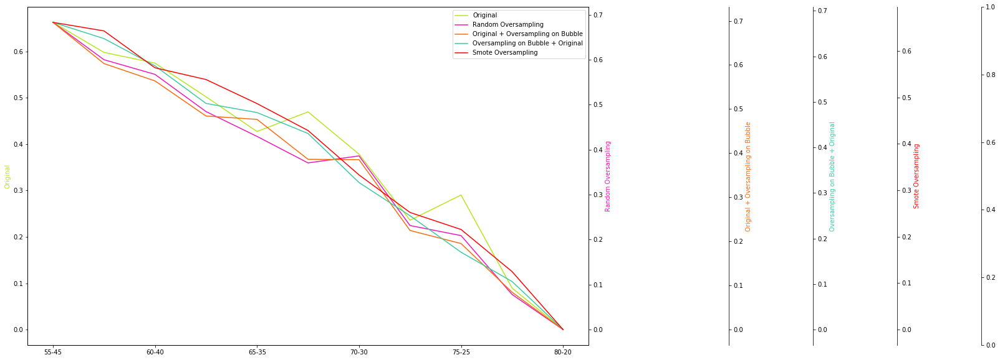

Total_Tiny_AccuracyKNN


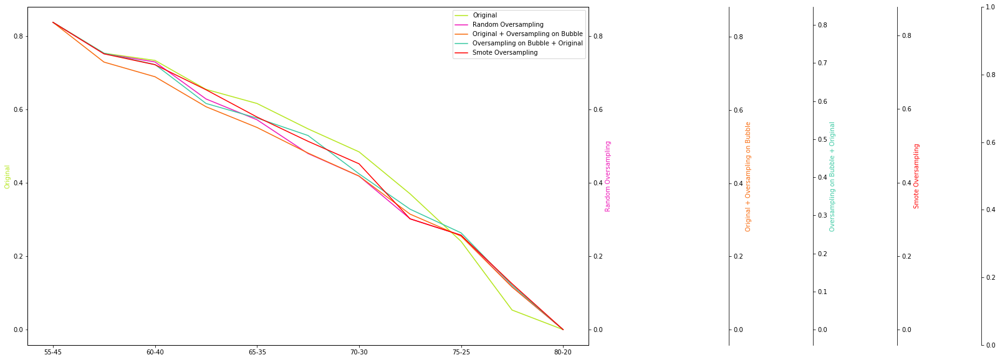

Total_Tiny_AccuracySVC


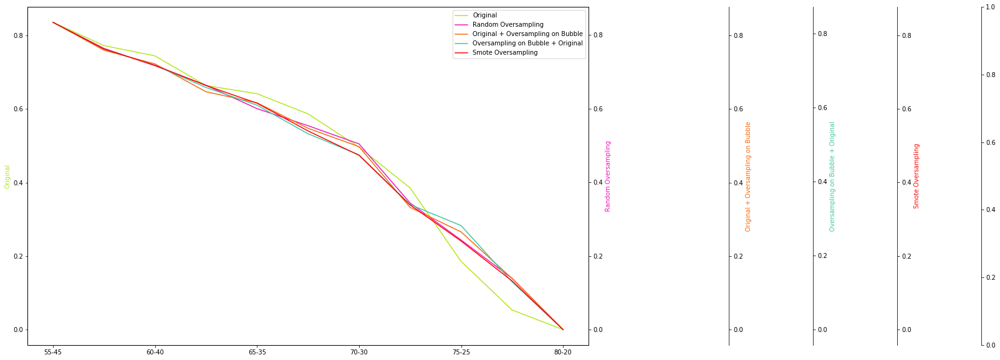

Total_Tiny_AccuracyRF


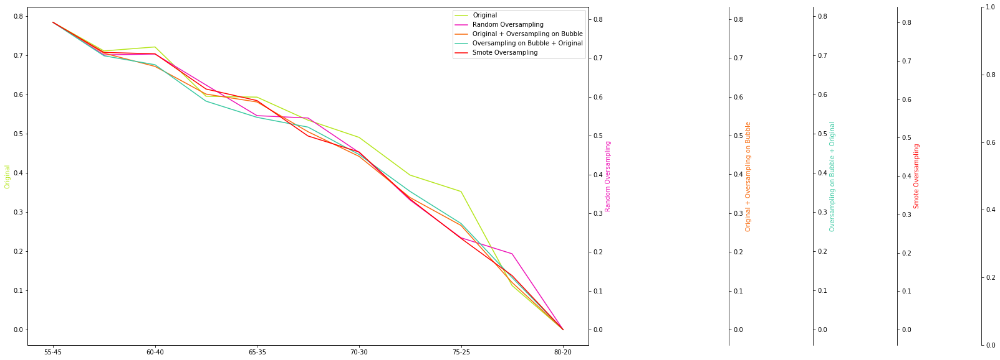

Total_Tiny_AccuracyDT


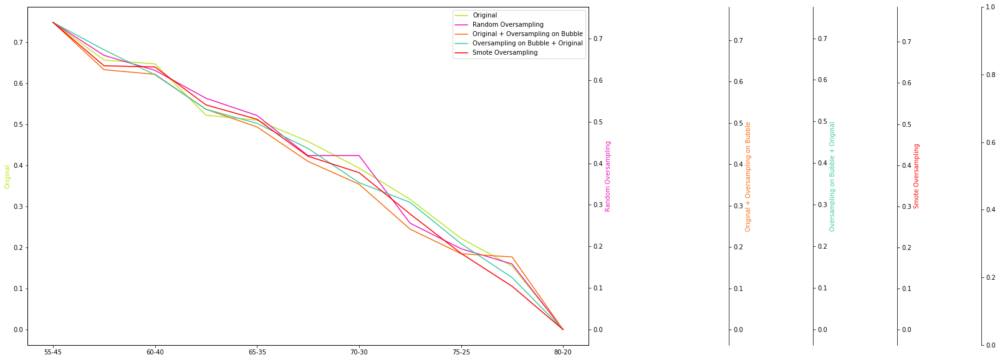

Total_Tiny_Precision 0SGD


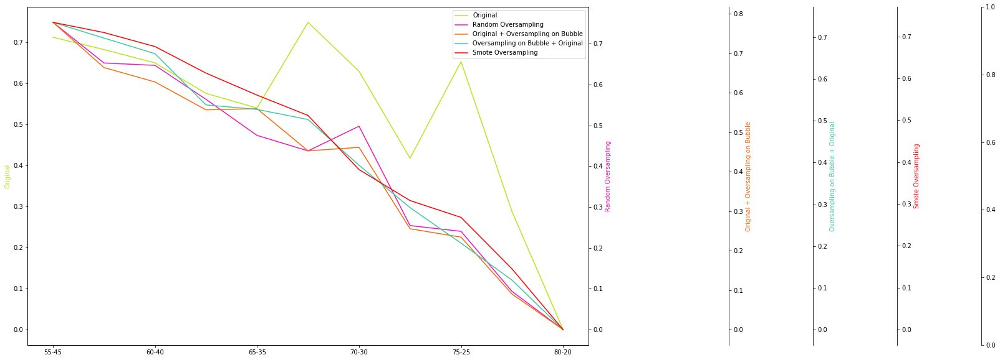

Total_Tiny_Precision 0KNN


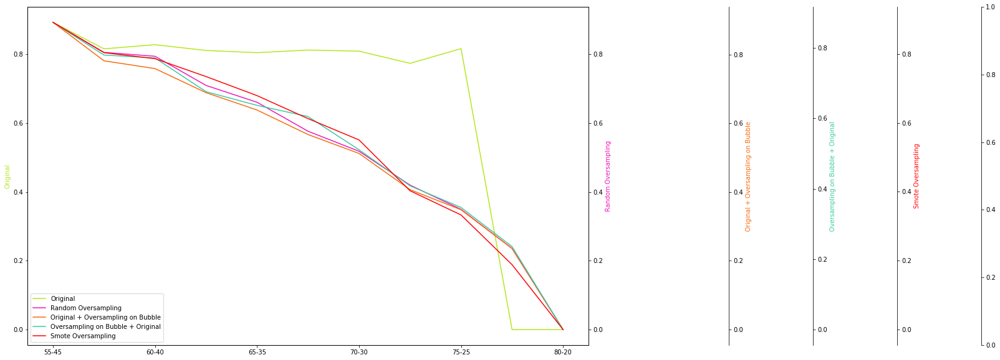

Total_Tiny_Precision 0SVC


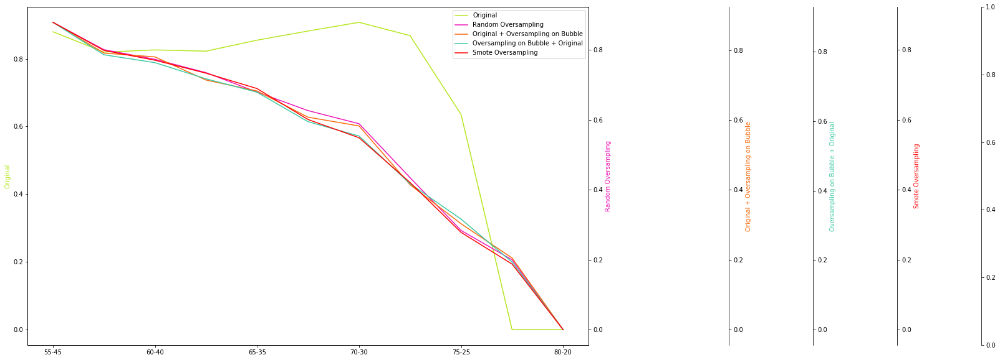

Total_Tiny_Precision 0RF


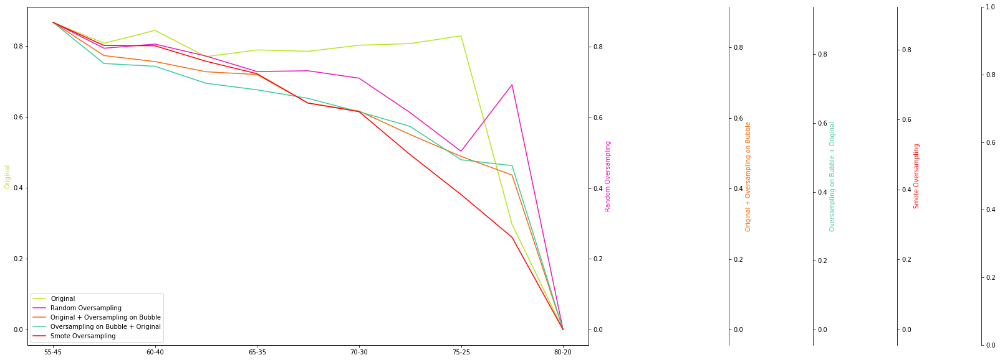

Total_Tiny_Precision 0DT


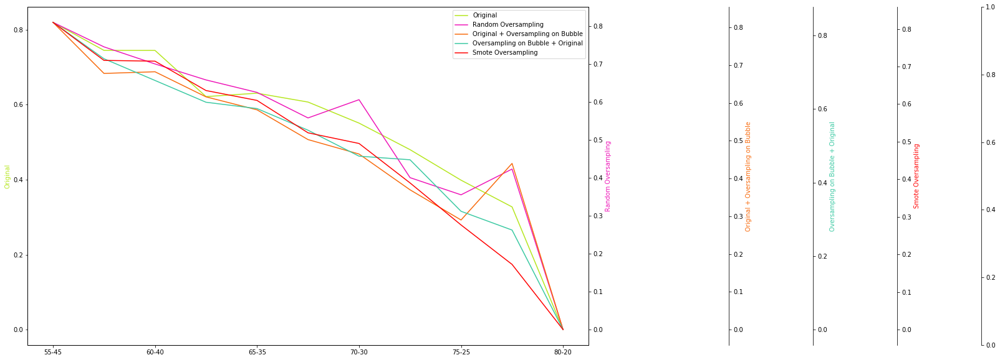

Total_Tiny_Precision 1SGD


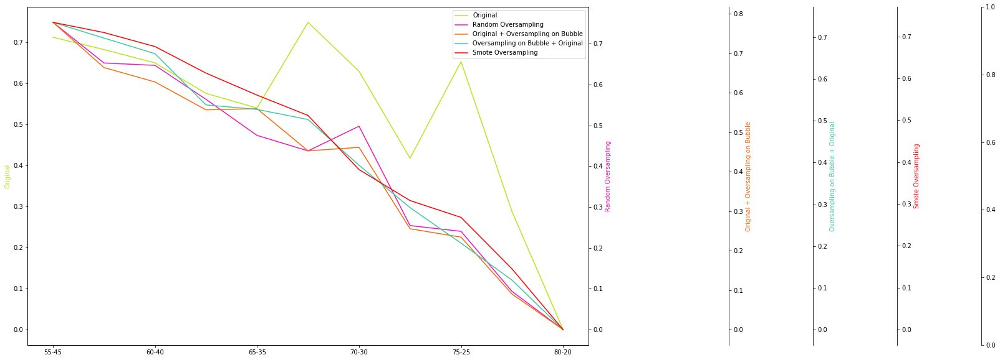

Total_Tiny_Precision 1KNN


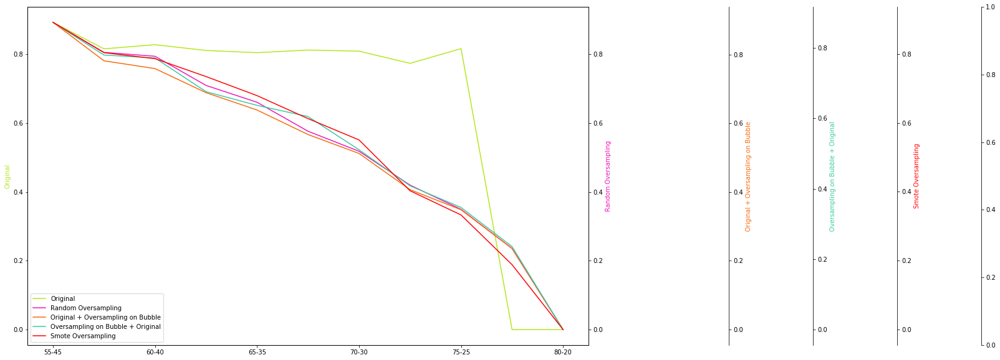

Total_Tiny_Precision 1SVC


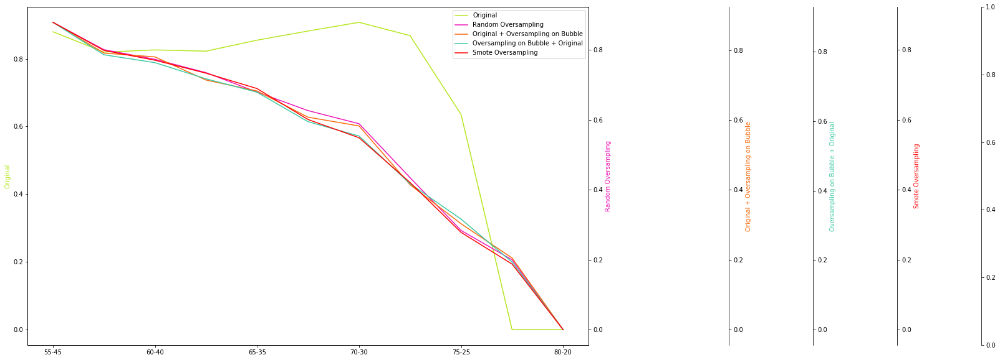

Total_Tiny_Precision 1RF


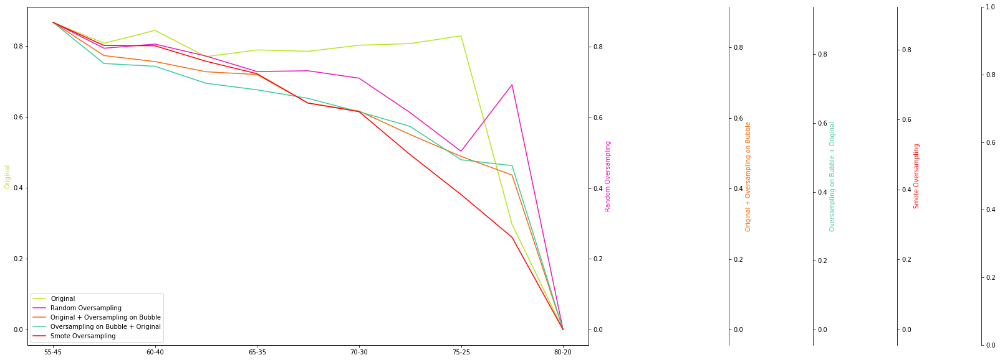

Total_Tiny_Precision 1DT


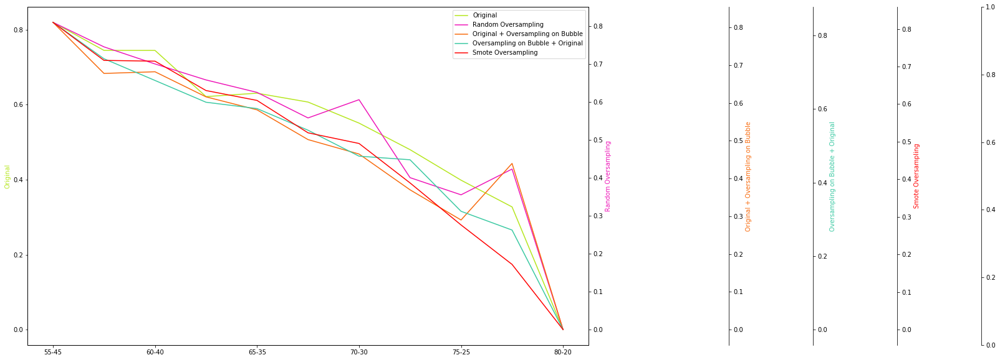

Total_Tiny_Recall 0SGD


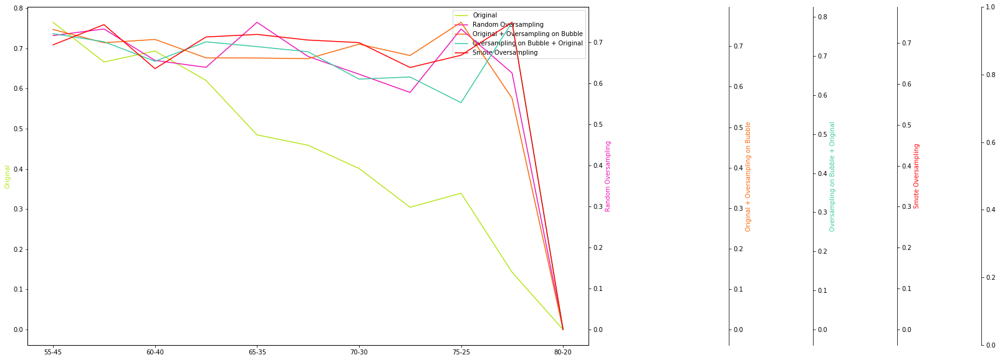

Total_Tiny_Recall 0KNN


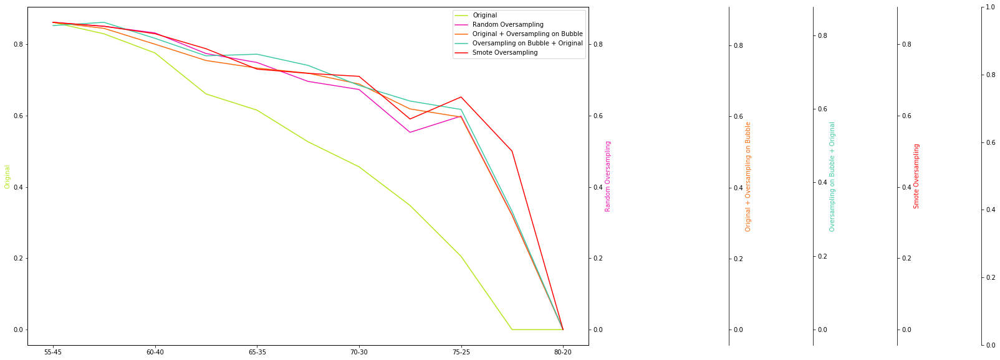

Total_Tiny_Recall 0SVC


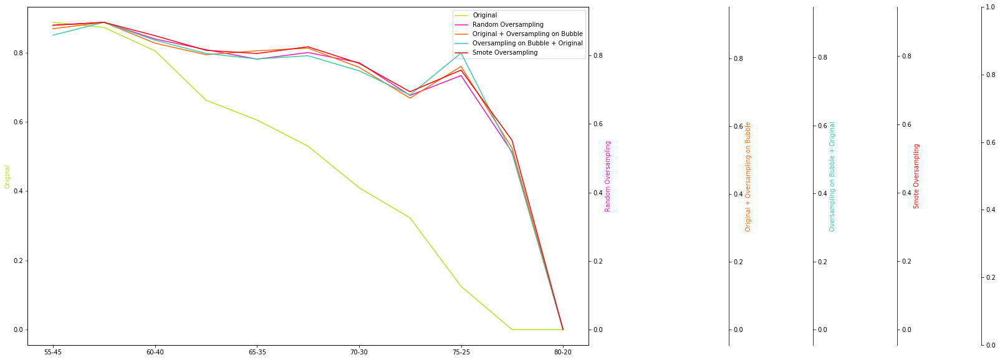

Total_Tiny_Recall 0RF


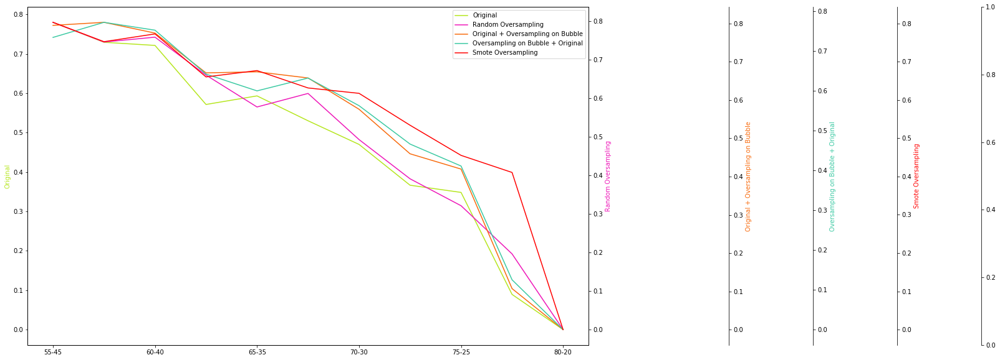

Total_Tiny_Recall 0DT


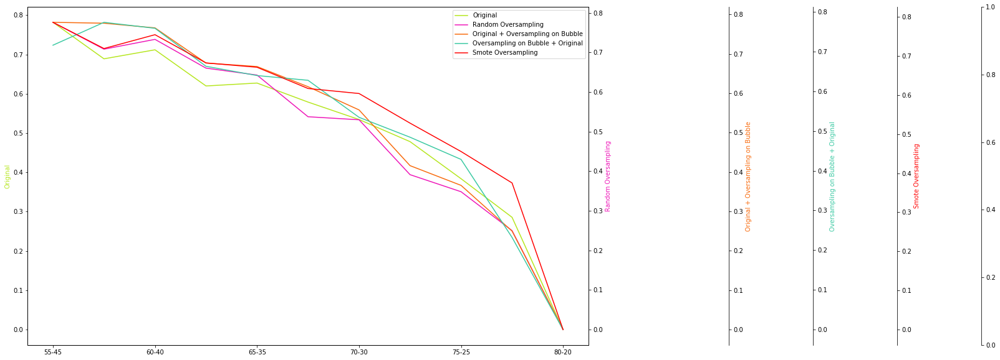

Total_Tiny_Recall1SGD


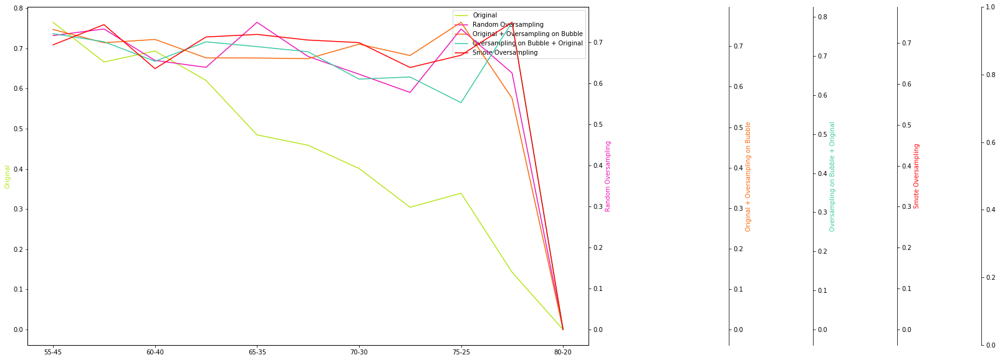

Total_Tiny_Recall1KNN


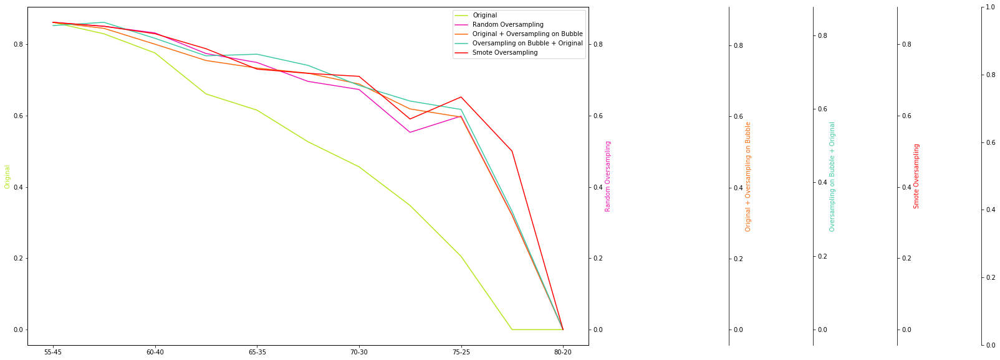

Total_Tiny_Recall1SVC


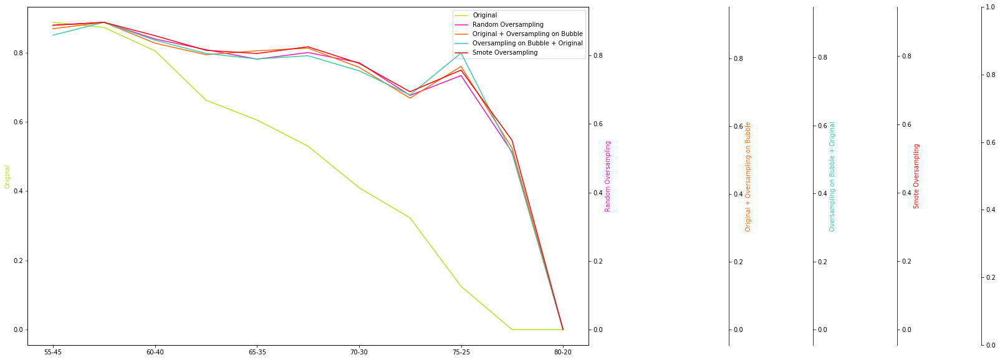

Total_Tiny_Recall1RF


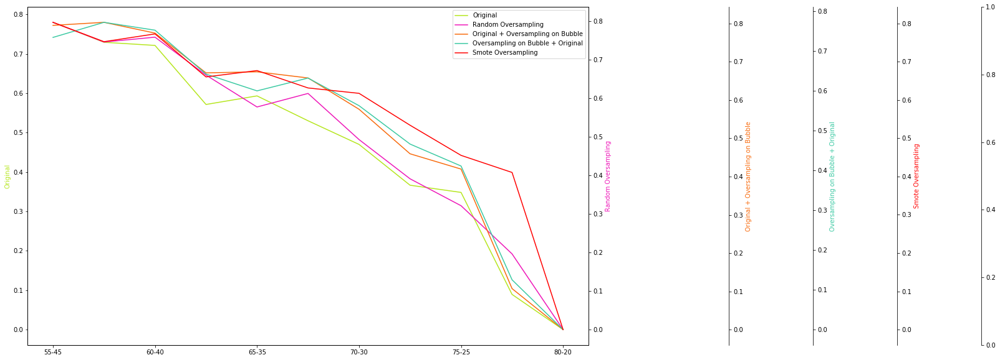

Total_Tiny_Recall1DT


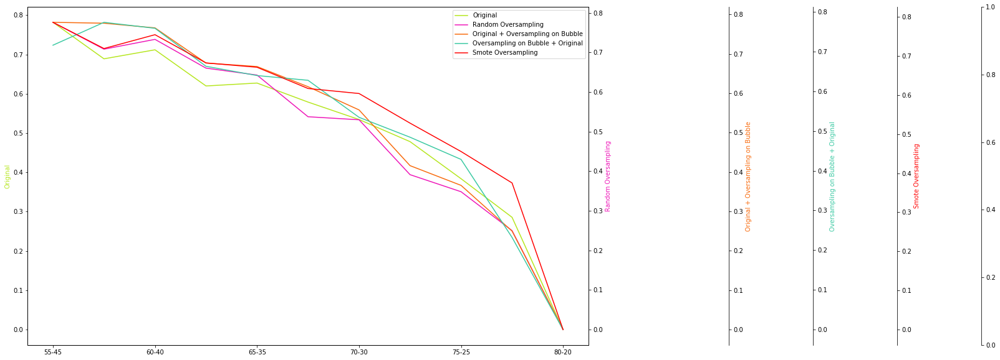

Total_Tiny_Balanced_AccuracySGD


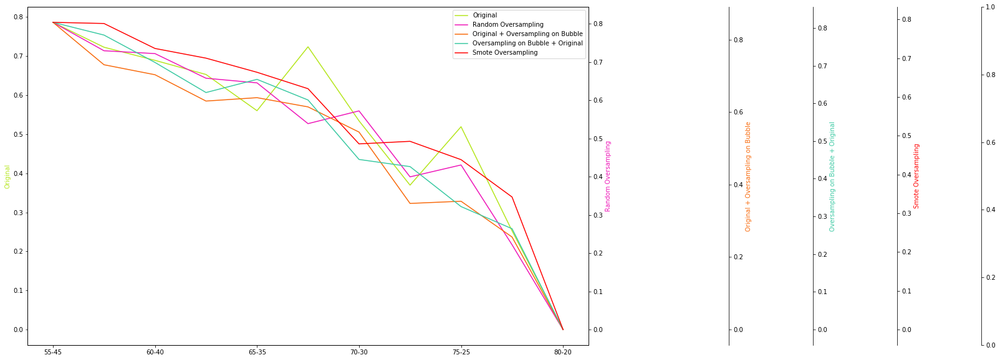

Total_Tiny_Balanced_AccuracyKNN


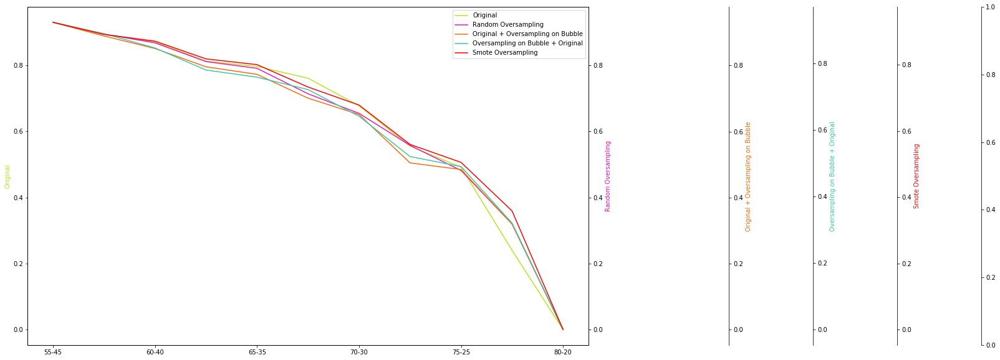

Total_Tiny_Balanced_AccuracySVC


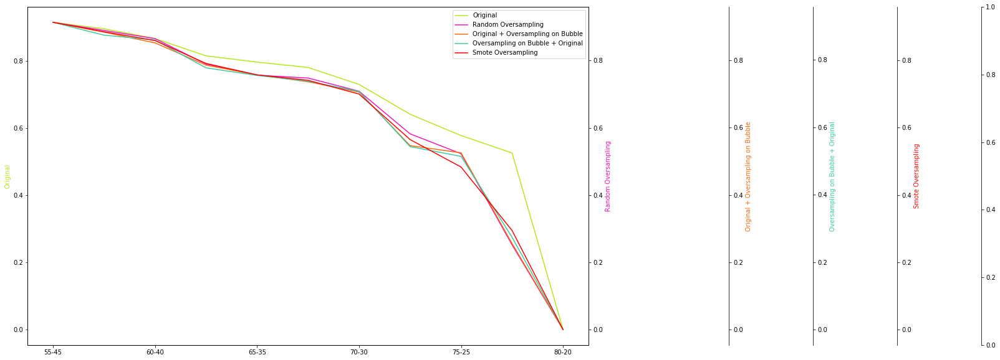

Total_Tiny_Balanced_AccuracyRF


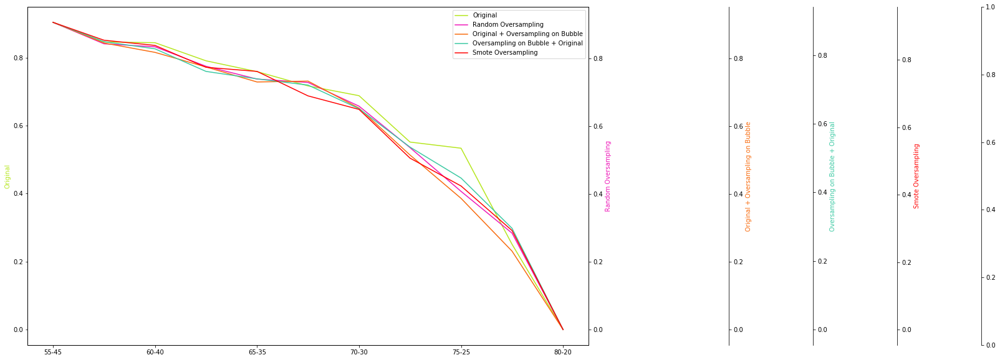

Total_Tiny_Balanced_AccuracyDT


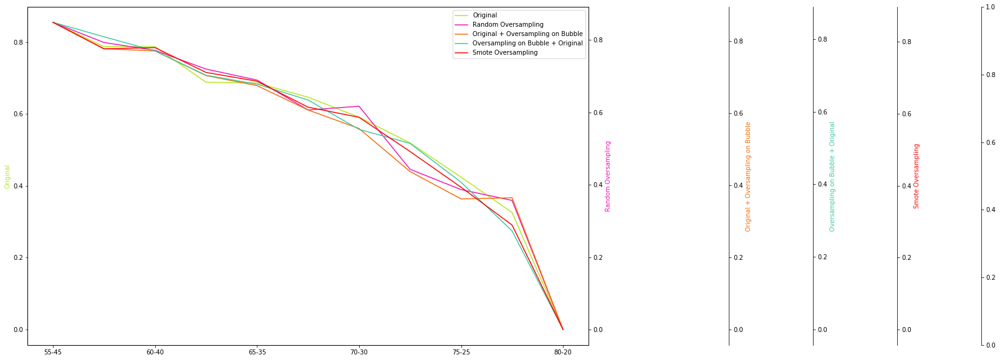

Total_Tiny_F1 Score 0SGD


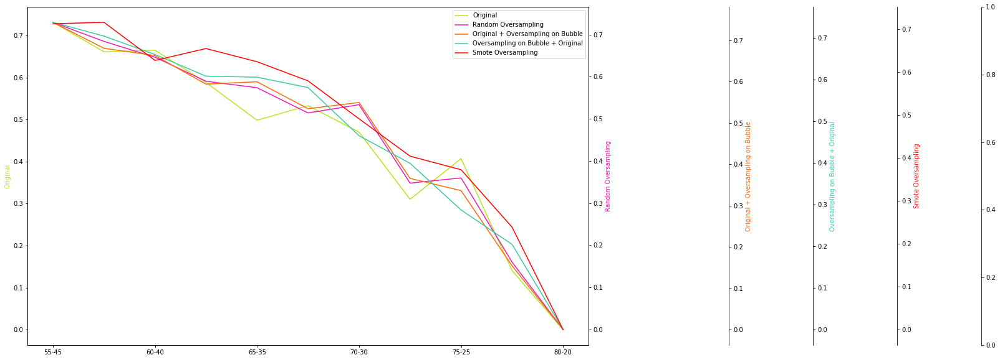

Total_Tiny_F1 Score 0KNN


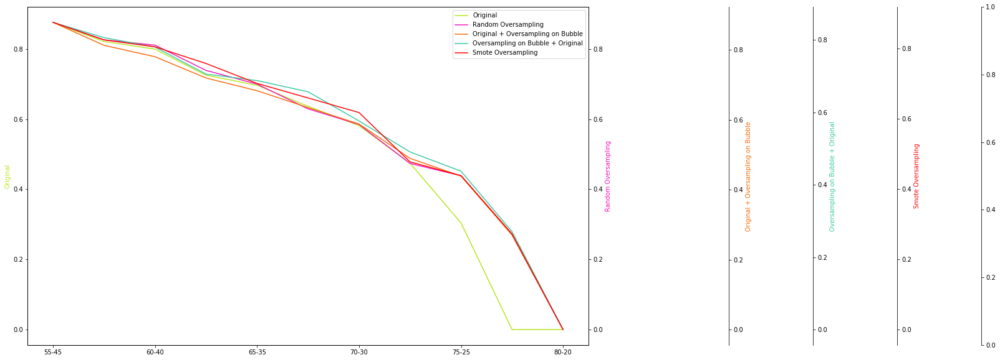

Total_Tiny_F1 Score 0SVC


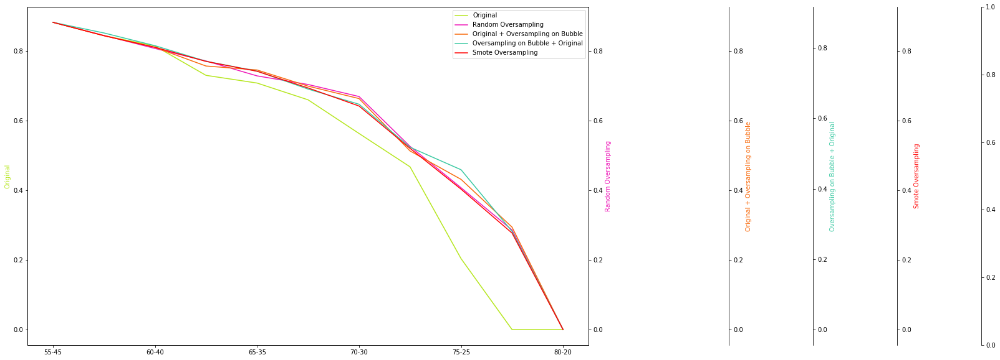

Total_Tiny_F1 Score 0RF


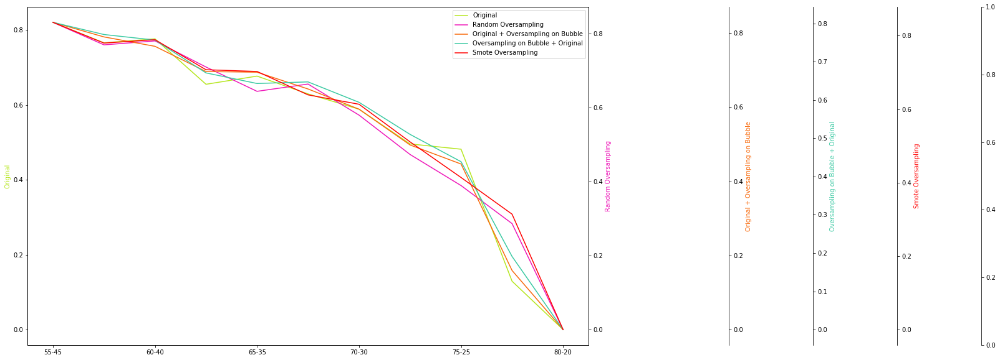

Total_Tiny_F1 Score 0DT


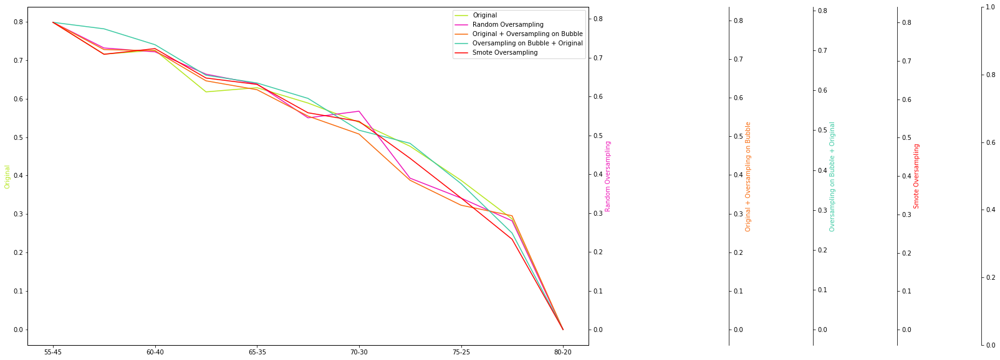

Total_Tiny_F1 Score 1SGD


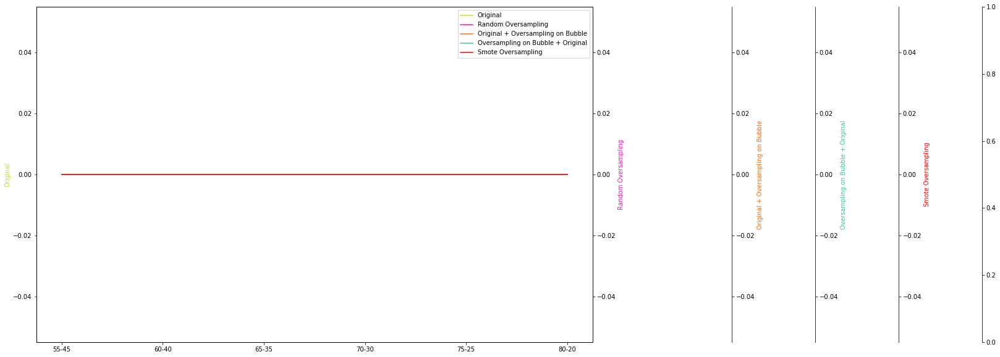

Total_Tiny_F1 Score 1KNN


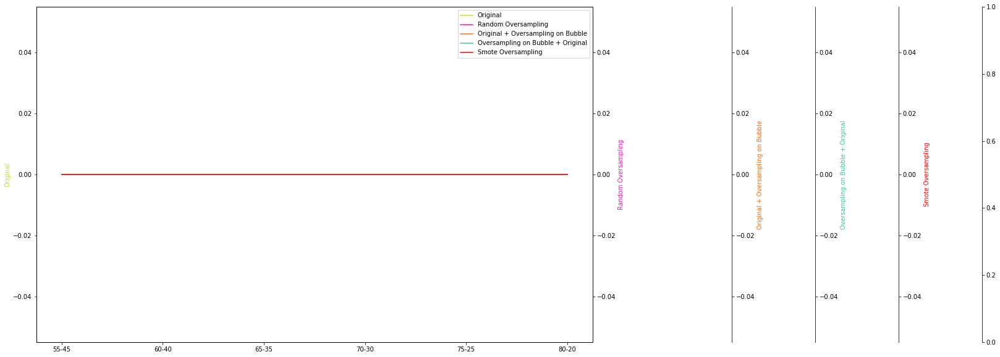

Total_Tiny_F1 Score 1SVC


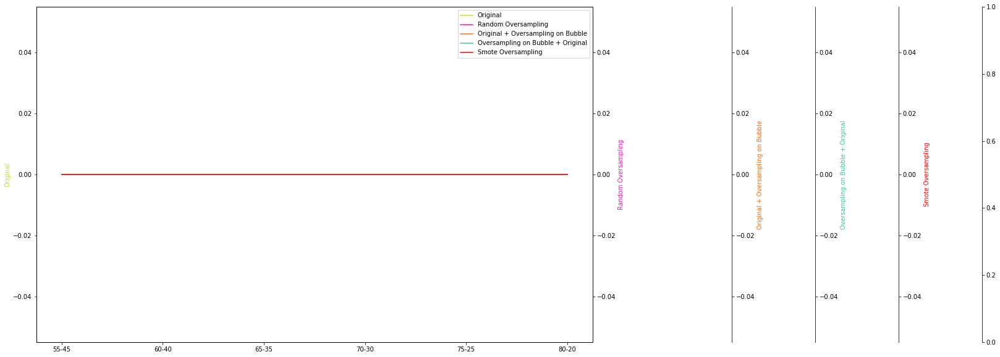

Total_Tiny_F1 Score 1RF


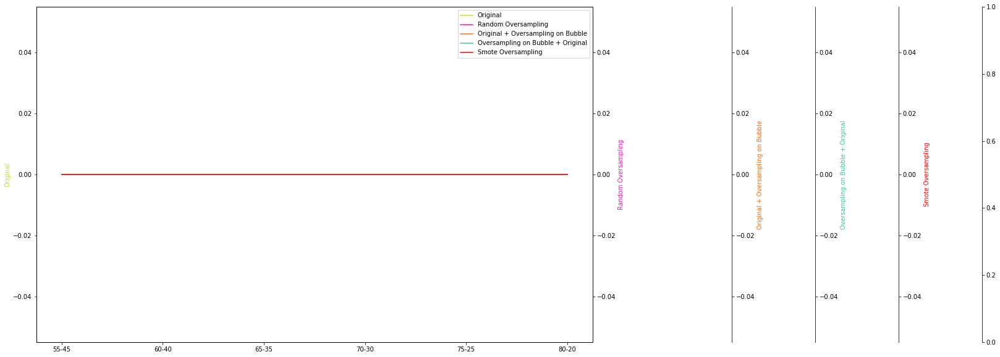

Total_Tiny_F1 Score 1DT


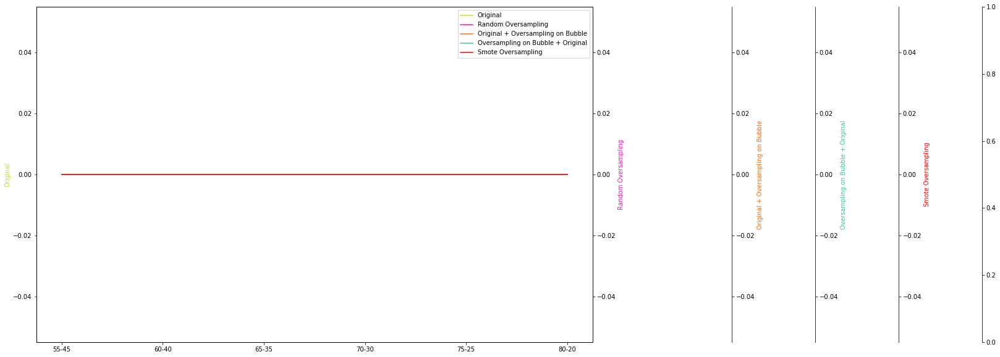

Total_Tiny_AUCSGD


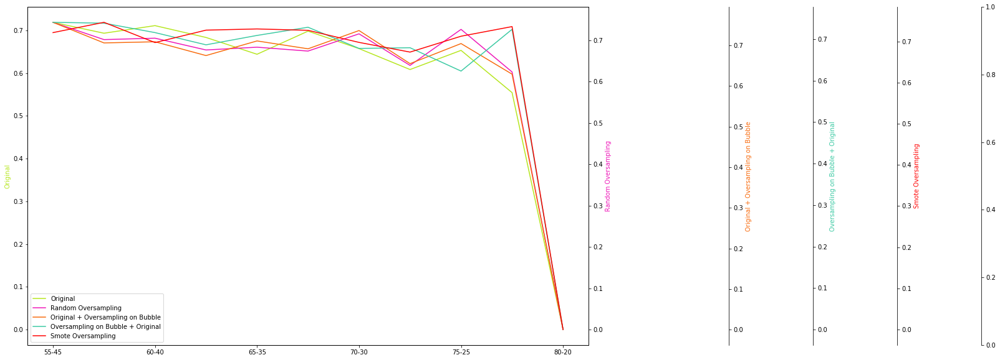

Total_Tiny_AUCKNN


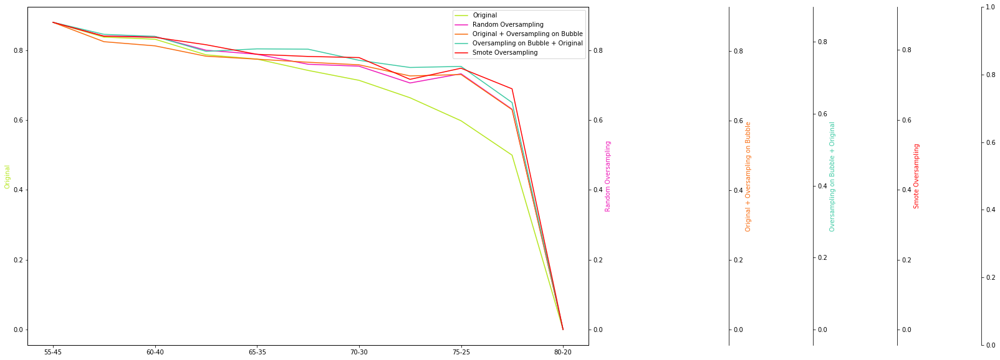

Total_Tiny_AUCSVC


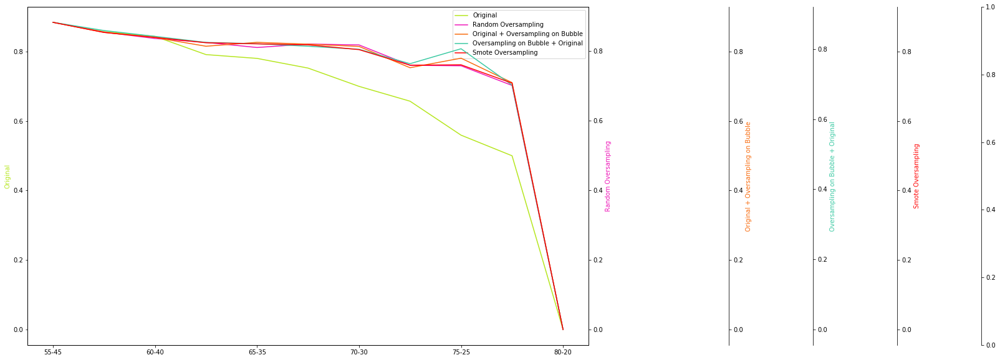

Total_Tiny_AUCRF


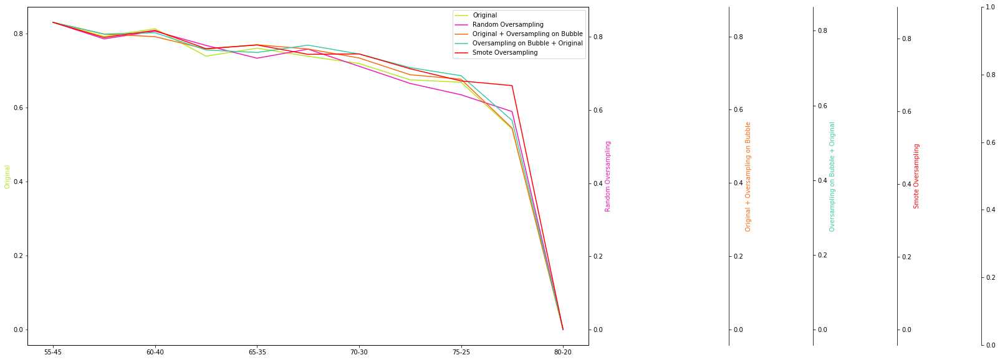

Total_Tiny_AUCDT


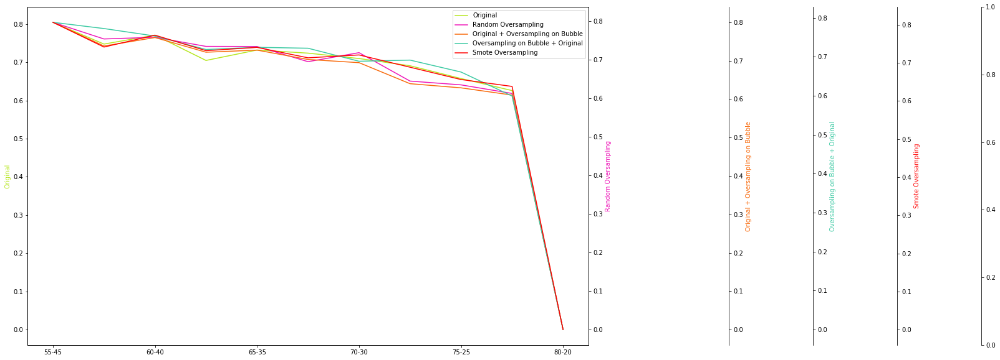

Total_Tiny_AUC Probs 0SGD


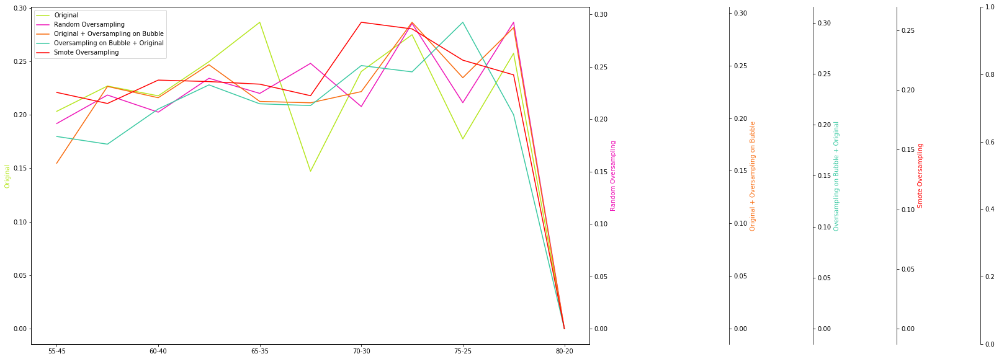

Total_Tiny_AUC Probs 0KNN


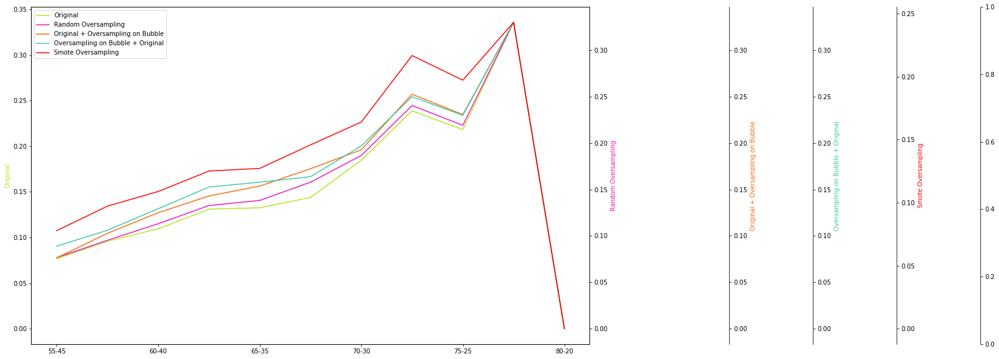

Total_Tiny_AUC Probs 0SVC


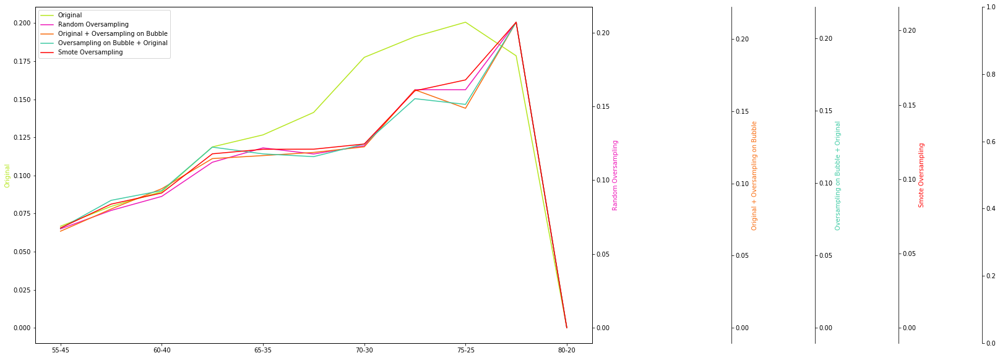

Total_Tiny_AUC Probs 0RF


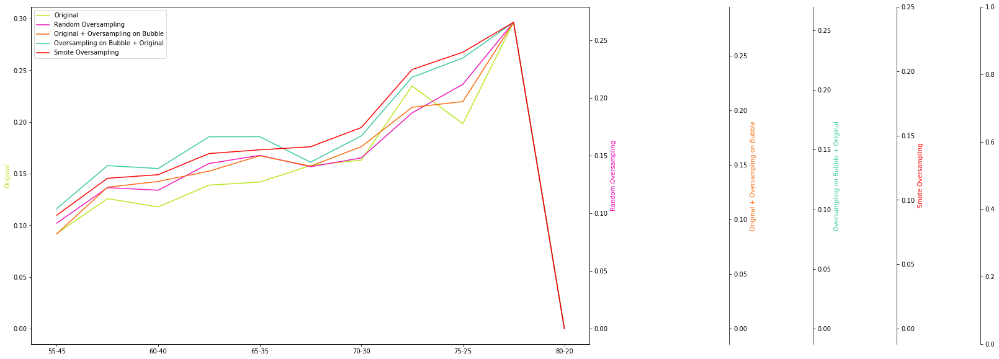

Total_Tiny_AUC Probs 0DT


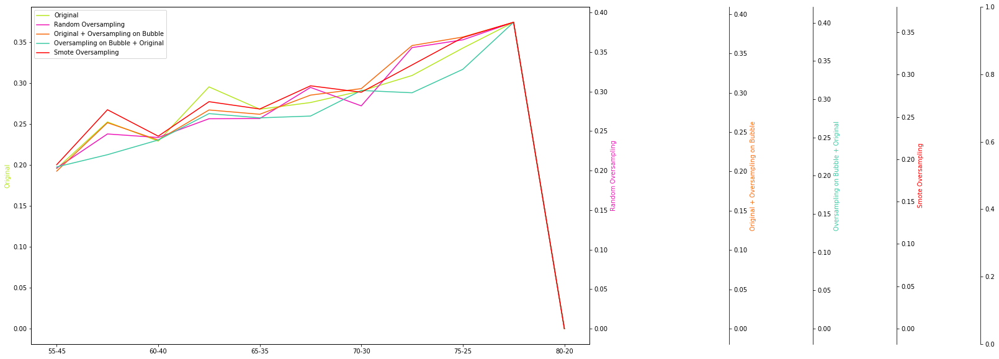

Total_Tiny_AUC Probs 1SGD


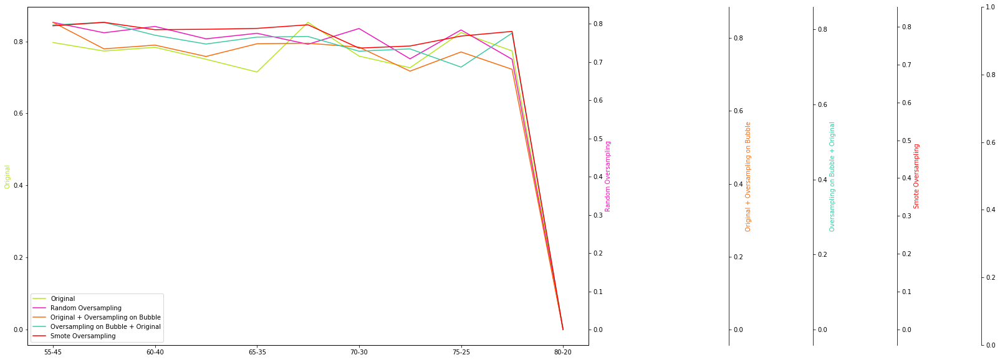

Total_Tiny_AUC Probs 1KNN


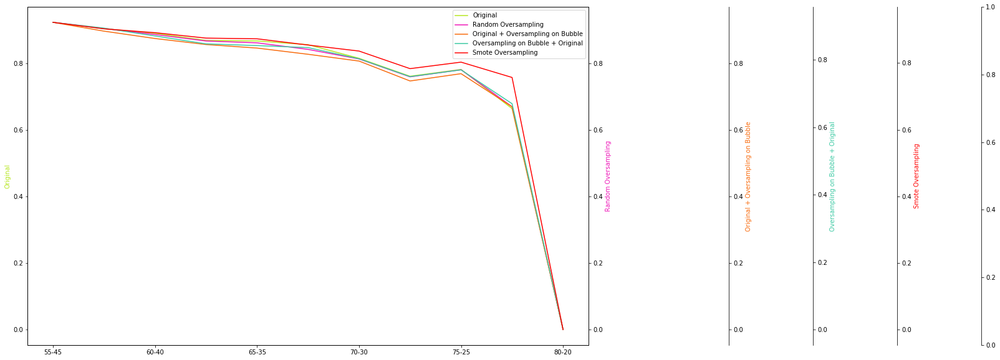

Total_Tiny_AUC Probs 1SVC


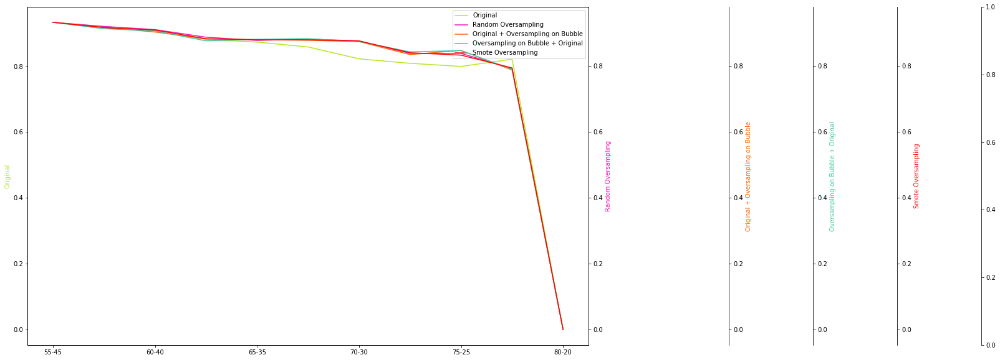

Total_Tiny_AUC Probs 1RF


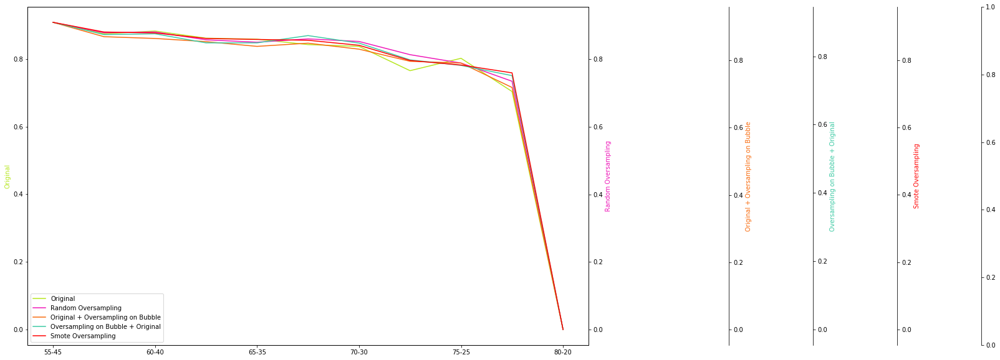

Total_Tiny_AUC Probs 1DT


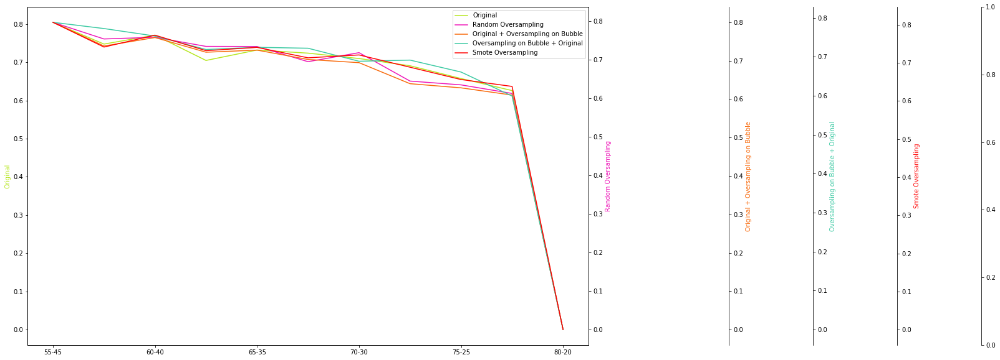

In [13]:
maBulle0 = BuildMyBulle([1,1,1,1,1,1,1], 7, 'normCats_realSnowBubblesTimes15_ray10bis_RealSmote', bulle, bubble_oversample);
maBulle0.instantiate_data();
maBulle0.cross_validate();
maBulle0.visualize_scores()
    
    